Implement a 1D CNN-based classifier to capture temporal dependencies within the eye movement traces

In [5]:
"""
CNN baseline (tuned):
- NaN threshold set to 0.05
- Loss = binary_crossentropy (remove focal loss)
- Slower LR schedule + more patient early stopping
- Participant-wise splits, /960 normalisation, fixed 1500 length, timing
"""

import os, time
from typing import List, Tuple, Dict
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

REQUIRED_COLS = ['abs_lx', 'abs_ly', 'abs_rx', 'abs_ry']

def get_participant_id(filename: str) -> str:
    """Assumes '001_0.csv' -> '001'."""
    return os.path.splitext(filename)[0].split('_')[0]

# Minimal loader (no dynamic features), interpolation-based resampling
import os
import numpy as np
import pandas as pd

REQUIRED_COLS = ['abs_lx','abs_ly','abs_rx','abs_ry']

def _linear_resample(x: np.ndarray, target_len: int) -> np.ndarray:
    """
    Linearly resample a (T, C) sequence to 'target_len' using np.interp.
    This avoids FFT ringing artifacts (better for saccade-like changes).
    """
    T, C = x.shape
    if T == target_len:
        return x
    src = np.linspace(0.0, 1.0, T, dtype=np.float32)
    dst = np.linspace(0.0, 1.0, target_len, dtype=np.float32)
    out = np.empty((target_len, C), dtype=x.dtype)
    for c in range(C):
        out[:, c] = np.interp(dst, src, x[:, c])
    return out

def _robust_scale_per_trace(x: np.ndarray, eps: float = 1e-6) -> np.ndarray:
    """
    Robust per-trace scaling: for each channel, subtract median and divide by IQR.
    Helps remove per-participant positional bias while keeping outlier-robustness.
    """
    x_scaled = x.copy()
    for c in range(x.shape[1]):
        v = x[:, c]
        med = np.median(v)
        q75, q25 = np.percentile(v, 75), np.percentile(v, 25)
        iqr = max(q75 - q25, eps)
        x_scaled[:, c] = (v - med) / iqr
    return x_scaled

def load_pair_experiment(
    csv_dir: str,
    labels: tuple,
    resample_len: int = 1500,
    max_nan_ratio: float = 0.05,
    divide_by_960: bool = True,
    use_robust_scale: bool = True
):
    """
    Load data for (label_a, label_b) with linear interpolation-based resampling.
    Also returns detailed NaN-handling stats for reporting.
    Returns:
      X: (N, resample_len, 4), y: (N,), files: list[str], stats: dict
    """
    X, y, files = [], [], []
    tagA, tagB = f"_{labels[0]}", f"_{labels[1]}"

    # stats containers
    total_seen = 0
    excluded_trials = []
    kept_trials = []
    ffill_total = 0
    bfill_total = 0
    zero_fill_total = 0

    for file in sorted(os.listdir(csv_dir)):
        if not file.endswith(".csv"):
            continue
        if (tagA not in file) and (tagB not in file):
            continue

        total_seen += 1
        path = os.path.join(csv_dir, file)
        df = pd.read_csv(path)

        # Extract 4 gaze channels
        if set(REQUIRED_COLS).issubset(df.columns):
            raw = df[REQUIRED_COLS].astype(np.float32).values
        else:
            # Fallback: assume columns 1..4 are lx,ly,rx,ry
            raw = df.iloc[:, 1:5].astype(np.float32).values

        # trial-level NaN ratio across the 4 gaze channels
        nan_ratio = np.isnan(raw).mean()
        if nan_ratio > max_nan_ratio:
            excluded_trials.append(file)
            continue

        # count NaNs before/after fills
        n_nan0 = int(np.isnan(raw).sum())
        # forward fill
        tmp = pd.DataFrame(raw)
        tmp_ff = tmp.fillna(method='ffill')
        n_nan1 = int(tmp_ff.isna().to_numpy().sum())
        ffill_total += (n_nan0 - n_nan1)

        # backward fill
        tmp_fb = tmp_ff.fillna(method='bfill')
        n_nan2 = int(tmp_fb.isna().to_numpy().sum())
        bfill_total += (n_nan1 - n_nan2)

        # remaining NaNs -> zeros
        zero_fill_total += n_nan2
        raw_filled = tmp_fb.fillna(0.0).to_numpy(dtype=np.float32)

        kept_trials.append(file)

        # Global scaling (as per thesis)
        if divide_by_960:
            raw_filled = raw_filled / 960.0

        # Linear resampling to fixed length
        seq = _linear_resample(raw_filled, resample_len)  # (T, 4)

        # Robust per-trace scaling
        if use_robust_scale:
            seq = _robust_scale_per_trace(seq)

        X.append(seq)
        y.append(0 if tagA in file else 1)
        files.append(file)

    X = np.asarray(X, dtype=np.float32)
    y = np.asarray(y, dtype=np.int64)

    stats = {
        "total_files_seen": total_seen,
        "kept_files": len(kept_trials),
        "excluded_files": len(excluded_trials),
        "excluded_filenames": excluded_trials,
        "ffill_count": int(ffill_total),
        "bfill_count": int(bfill_total),
        "zero_fill_count": int(zero_fill_total),
    }

    print(
        f"[load_pair_experiment] Labels={labels}, kept={len(files)}/{total_seen}, "
        f"shape={X.shape} | drop={stats['excluded_files']} | "
        f"ffill={stats['ffill_count']}, bfill={stats['bfill_count']}, zero={stats['zero_fill_count']}"
    )
    return X, y, files, stats


def split_by_participant_train_val_test(
    X: np.ndarray,
    y: np.ndarray,
    files: List[str],
    val_size: float = 0.2,
    test_size: float = 0.2,
    random_state: int = 42
):
    """Participant-wise split into train/val/test."""
    pids = np.array([get_participant_id(f) for f in files])
    uniq = np.array(sorted(list(set(pids))))

    pid_trainval, pid_test = train_test_split(uniq, test_size=test_size, random_state=random_state, shuffle=True)
    pid_train, pid_val = train_test_split(pid_trainval, test_size=val_size/(1.0-test_size),
                                          random_state=random_state, shuffle=True)

    def mask(ids): return np.isin(pids, ids)
    tr_mask, va_mask, te_mask = mask(pid_train), mask(pid_val), mask(pid_test)

    return X[tr_mask], y[tr_mask], X[va_mask], y[va_mask], X[te_mask], y[te_mask], {
        'train_ids': pid_train.tolist(),
        'val_ids': pid_val.tolist(),
        'test_ids': pid_test.tolist(),
    }

def build_1dcnn_model(input_shape):
    """Slightly stronger baseline CNN."""
    inp = Input(shape=input_shape)
    x = layers.Conv1D(64, 7, padding='same', activation='relu')(inp)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling1D(2)(x)

    x = layers.Conv1D(128, 5, padding='same', activation='relu')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling1D(2)(x)

    x = layers.Conv1D(128, 3, padding='same', activation='relu')(x)
    x = layers.GlobalAveragePooling1D()(x)
    x = layers.Dense(64, activation='relu')(x)
    x = layers.Dropout(0.5)(x)
    out = layers.Dense(1, activation='sigmoid')(x)
    return Model(inp, out)

def compute_class_weight(y_train: np.ndarray):
    """Optional class_weight for slight imbalance; can be None if not needed."""
    n0 = (y_train == 0).sum()
    n1 = (y_train == 1).sum()
    if min(n0, n1) == 0:
        return None
    w0 = (n0 + n1) / (2.0 * n0)
    w1 = (n0 + n1) / (2.0 * n1)
    return {0: float(w0), 1: float(w1)}

def get_optimizer(lr=3e-4):
    """Use legacy Adam on Apple Silicon to avoid slowdown warnings."""
    try:
        # TF >= 2.11 has legacy optimizers
        return tf.keras.optimizers.legacy.Adam(learning_rate=lr)
    except Exception:
        return tf.keras.optimizers.Adam(learning_rate=lr)

def run_experiment(
    csv_dir: str,
    label_pair: Tuple[int, int],
    target_len: int = 1500,
    batch_size: int = 16,     # slightly larger batch
    max_epochs: int = 80,
    lr: float = 3e-4,         # a bit higher LR
    early_patience: int = 15  # more patient
) -> Dict:
    X, y, files, stats = load_pair_experiment(
        csv_dir,
        label_pair,
        resample_len=target_len,
        max_nan_ratio=0.05,
        divide_by_960=True,
        use_robust_scale=True
    )
    
    print(f"[NaN-Stats] pair={label_pair} | "
          f"seen={stats['total_files_seen']}, kept={stats['kept_files']}, excluded={stats['excluded_files']} "
          f"(threshold>5%) | ffill={stats['ffill_count']}, bfill={stats['bfill_count']}, "
          f"zero={stats['zero_fill_count']}")


    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    print(f"[Split] train={len(ytr)}, val={len(yva)}, test={len(yte)}")

    model = build_1dcnn_model((target_len, 4))
    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])

    # Slower LR schedule; don't drop too quickly
    callbacks = [
        tf.keras.callbacks.EarlyStopping(
            monitor='val_loss', patience=early_patience, restore_best_weights=True
        ),
        tf.keras.callbacks.ReduceLROnPlateau(
            monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1
        ),
        tf.keras.callbacks.CSVLogger(f'train_log_{label_pair[0]}_{label_pair[1]}.csv', append=False)
    ]

    class_weight = compute_class_weight(ytr)

    t0 = time.perf_counter()
    history = model.fit(
        Xtr, ytr,
        validation_data=(Xva, yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=1,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()
    print(f"[Time] Pair {label_pair}: training wall-clock {t1 - t0:.2f}s")

    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    report = classification_report(yte, ypred, digits=4)
    print(f"\n[TEST] Pair {label_pair} classification report:\n{report}")

    return {
        'label_pair': label_pair,
        'history': history.history,
        'test_report': report,
        'model': model,
        'id_splits': id_splits
    }

if __name__ == "__main__":
    csv_path = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    res_02 = run_experiment(csv_path, (0, 2), target_len=1500)
    res_13 = run_experiment(csv_path, (1, 3), target_len=1500)


[load_pair_experiment] Labels=(0, 2), kept=91/97, shape=(91, 1500, 4) | drop=6 | ffill=12182, bfill=0, zero=0
[NaN-Stats] pair=(0, 2) | seen=97, kept=91, excluded=6 (threshold>5%) | ffill=12182, bfill=0, zero=0
[Split] train=54, val=20, test=17
Epoch 1/80
4/4 [==============================] - 1s 77ms/step - loss: 0.6904 - accuracy: 0.5556 - val_loss: 0.6903 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 53ms/step - loss: 0.6671 - accuracy: 0.5741 - val_loss: 0.6884 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 48ms/step - loss: 0.5890 - accuracy: 0.6852 - val_loss: 0.6859 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 0s 60ms/step - loss: 0.5714 - accuracy: 0.7407 - val_loss: 0.6825 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 0s 42ms/step - loss: 0.5666 - accuracy: 0.6667 - val_loss: 0.6770 - val_accuracy:

Epoch 51/80
4/4 [==============================] - 0s 36ms/step - loss: 0.1282 - accuracy: 0.9815 - val_loss: 0.6716 - val_accuracy: 0.5000 - lr: 1.5000e-04
Epoch 52/80
3/4 [=====================>........] - ETA: 0s - loss: 0.1934 - accuracy: 0.9167
Epoch 52: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
4/4 [==============================] - 0s 36ms/step - loss: 0.1883 - accuracy: 0.9259 - val_loss: 0.6710 - val_accuracy: 0.5000 - lr: 1.5000e-04
Epoch 53/80
4/4 [==============================] - 0s 37ms/step - loss: 0.1785 - accuracy: 0.9444 - val_loss: 0.6581 - val_accuracy: 0.5000 - lr: 7.5000e-05
Epoch 54/80
4/4 [==============================] - 0s 36ms/step - loss: 0.1679 - accuracy: 0.9630 - val_loss: 0.6504 - val_accuracy: 0.5000 - lr: 7.5000e-05
Epoch 55/80
4/4 [==============================] - 0s 38ms/step - loss: 0.1551 - accuracy: 0.9630 - val_loss: 0.6455 - val_accuracy: 0.5000 - lr: 7.5000e-05
[Time] Pair (0, 2): training wall-clock 11.38s
2/2 [=====

Epoch 43/80
4/4 [==============================] - 0s 40ms/step - loss: 0.2779 - accuracy: 0.9273 - val_loss: 0.6519 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 44/80
4/4 [==============================] - 0s 38ms/step - loss: 0.2873 - accuracy: 0.9273 - val_loss: 0.6510 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 45/80
4/4 [==============================] - 0s 38ms/step - loss: 0.3036 - accuracy: 0.9273 - val_loss: 0.6523 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 46/80
4/4 [==============================] - 0s 36ms/step - loss: 0.2979 - accuracy: 0.9273 - val_loss: 0.6554 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 47/80
4/4 [==============================] - 0s 38ms/step - loss: 0.2719 - accuracy: 0.9091 - val_loss: 0.6579 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 48/80
4/4 [==============================] - 0s 37ms/step - loss: 0.2418 - accuracy: 0.9455 - val_loss: 0.6581 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 49/80
4/4 [==============================] - 0s 34ms

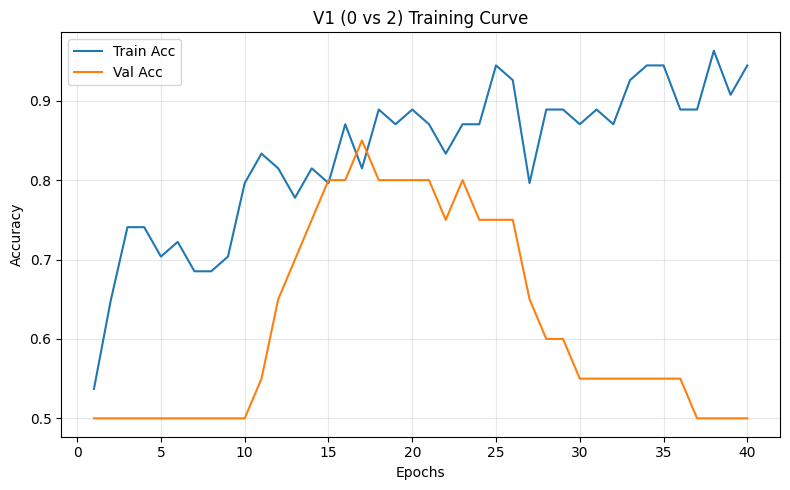

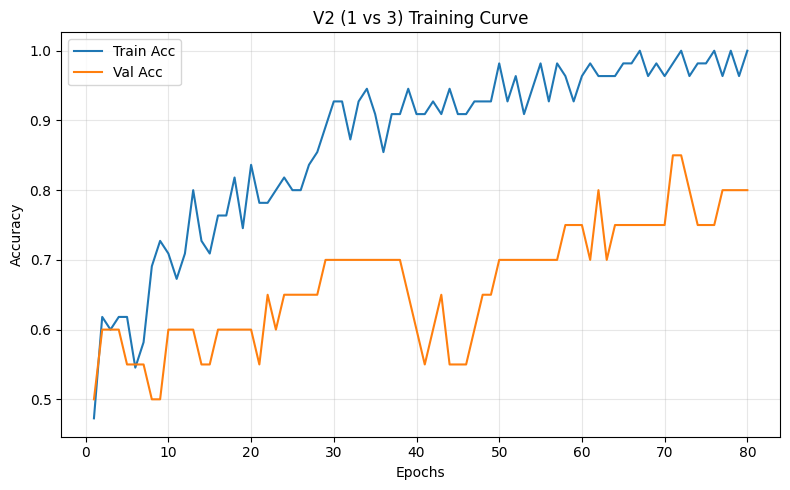

In [3]:
# Plot training curves for both experiments (accuracy over epochs)
import matplotlib.pyplot as plt

def plot_accuracy_curve(history_dict, title, save_path=None):
    """
    Plot training/validation accuracy curves from a Keras History.history dict.
    """
    acc = history_dict.get('accuracy', [])
    val_acc = history_dict.get('val_accuracy', [])
    epochs = range(1, len(acc) + 1)

    plt.figure(figsize=(8, 5))
    plt.plot(epochs, acc, label='Train Acc')
    plt.plot(epochs, val_acc, label='Val Acc')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(title)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    if save_path is not None:
        plt.savefig(save_path, dpi=200)
    plt.show()

# res_02 = run_experiment(csv_path, (0, 2), target_len=1500)
# res_13 = run_experiment(csv_path, (1, 3), target_len=1500)

plot_accuracy_curve(res_02['history'], title='V1 (0 vs 2) Training Curve', save_path='train_curve_v1_acc.png')
plot_accuracy_curve(res_13['history'], title='V2 (1 vs 3) Training Curve', save_path='train_curve_v2_acc.png')


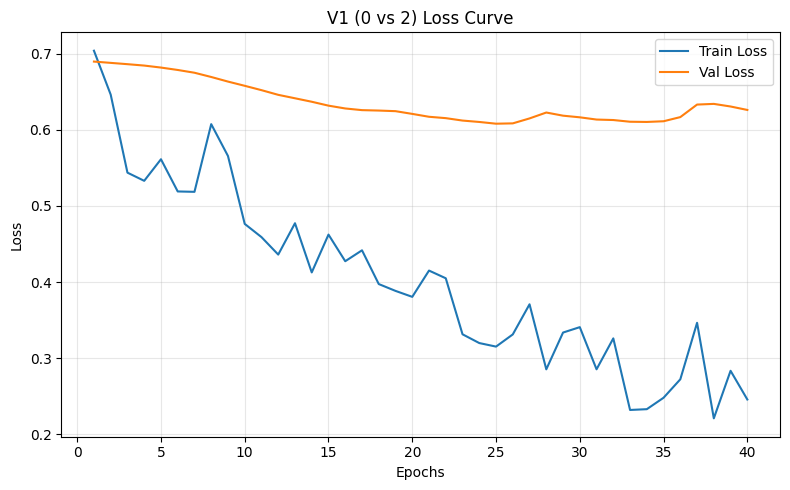

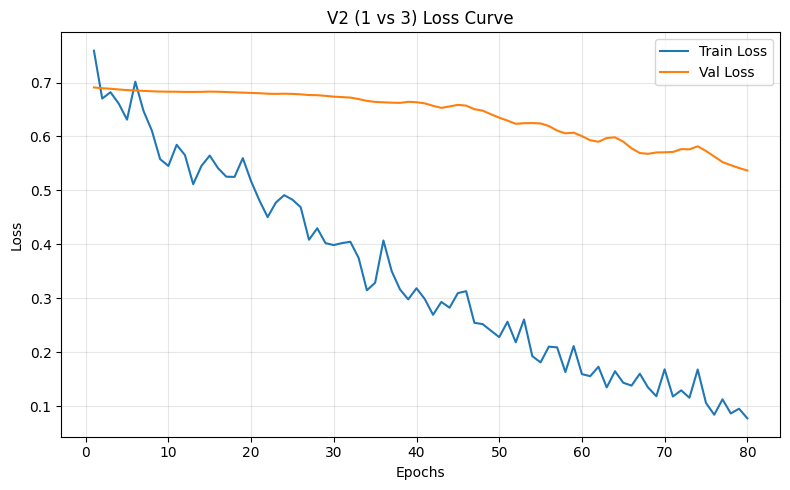

In [4]:
def plot_loss_curve(history_dict, title, save_path=None):
    """
    Plot training/validation loss curves from a Keras History.history dict.
    """
    loss = history_dict.get('loss', [])
    val_loss = history_dict.get('val_loss', [])
    epochs = range(1, len(loss) + 1)

    plt.figure(figsize=(8, 5))
    plt.plot(epochs, loss, label='Train Loss')
    plt.plot(epochs, val_loss, label='Val Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(title)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    if save_path is not None:
        plt.savefig(save_path, dpi=200)
    plt.show()

plot_loss_curve(res_02['history'], title='V1 (0 vs 2) Loss Curve', save_path='train_curve_v1_loss.png')
plot_loss_curve(res_13['history'], title='V2 (1 vs 3) Loss Curve', save_path='train_curve_v2_loss.png')


Complete CNN transfer learning

[load_pair_experiment] Labels=(0, 2), files=92, shape=(92, 1500, 4)
[Pretrain] source=(0, 2)
Epoch 1/60
4/4 [==============================] - 0s 54ms/step - loss: 0.6886 - accuracy: 0.5185 - val_loss: 0.6924 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 0s 32ms/step - loss: 0.6058 - accuracy: 0.7037 - val_loss: 0.6910 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 0s 30ms/step - loss: 0.5542 - accuracy: 0.7778 - val_loss: 0.6878 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 0s 31ms/step - loss: 0.5279 - accuracy: 0.8333 - val_loss: 0.6839 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 0s 33ms/step - loss: 0.5430 - accuracy: 0.7778 - val_loss: 0.6797 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/60
4/4 [==============================] - 0s 34ms/step - loss: 0.4628 - accuracy: 0.8704 - val_loss: 0.6751 - val_accur

Epoch 52/60
4/4 [==============================] - 0s 32ms/step - loss: 0.1784 - accuracy: 0.9444 - val_loss: 0.4959 - val_accuracy: 0.8000 - lr: 1.5000e-04
Epoch 53/60
4/4 [==============================] - 0s 37ms/step - loss: 0.2219 - accuracy: 0.9259 - val_loss: 0.4857 - val_accuracy: 0.8500 - lr: 1.5000e-04
Epoch 54/60
4/4 [==============================] - 0s 33ms/step - loss: 0.1784 - accuracy: 0.9815 - val_loss: 0.4804 - val_accuracy: 0.8500 - lr: 1.5000e-04
Epoch 55/60
4/4 [==============================] - 0s 31ms/step - loss: 0.1586 - accuracy: 0.9815 - val_loss: 0.4763 - val_accuracy: 0.8500 - lr: 1.5000e-04
Epoch 56/60
4/4 [==============================] - 0s 35ms/step - loss: 0.1566 - accuracy: 0.9815 - val_loss: 0.4656 - val_accuracy: 0.8500 - lr: 1.5000e-04
Epoch 57/60
4/4 [==============================] - 0s 35ms/step - loss: 0.1658 - accuracy: 0.9444 - val_loss: 0.4477 - val_accuracy: 0.8500 - lr: 1.5000e-04
Epoch 58/60
4/4 [==============================] - 0s 30ms

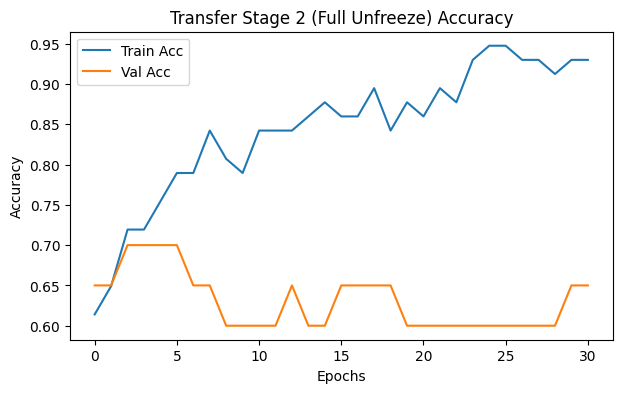

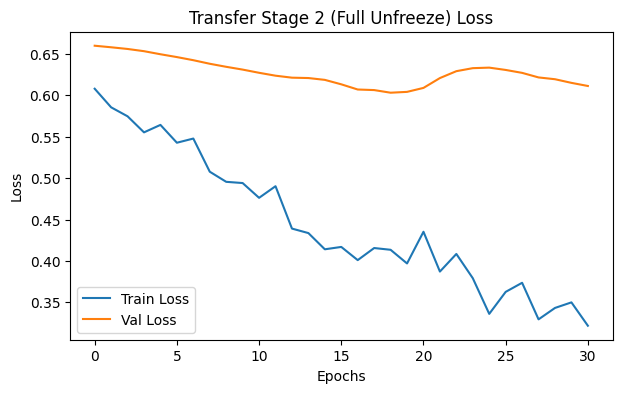

In [10]:
"""
Transfer Learning for 1D-CNN on Eye-Tracking (V1 -> V2)
- Stage 0: Pretrain extractor on source pair (e.g., (0,2))
- Stage 1: Load extractor, freeze all convs, train head only on target pair
- Stage 2: Unfreeze ALL convs, fine-tune at low LR with EarlyStopping
"""

import os, time
from typing import List, Tuple, Dict
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

REQUIRED_COLS = ['abs_lx','abs_ly','abs_rx','abs_ry']

def get_participant_id(filename: str) -> str:
    return os.path.splitext(filename)[0].split('_')[0]

# Loader
def _linear_resample(x: np.ndarray, target_len: int) -> np.ndarray:
    T, C = x.shape
    if T == target_len:
        return x
    src = np.linspace(0.0, 1.0, T, dtype=np.float32)
    dst = np.linspace(0.0, 1.0, target_len, dtype=np.float32)
    out = np.empty((target_len, C), dtype=x.dtype)
    for c in range(C):
        out[:, c] = np.interp(dst, src, x[:, c])
    return out

def _robust_scale_per_trace(x: np.ndarray, eps: float = 1e-6) -> np.ndarray:
    x_scaled = x.copy()
    for c in range(x.shape[1]):
        v = x[:, c]
        med = np.median(v)
        q75, q25 = np.percentile(v, 75), np.percentile(v, 25)
        iqr = max(q75 - q25, eps)
        x_scaled[:, c] = (v - med) / iqr
    return x_scaled

def load_pair_experiment(
    csv_dir: str,
    labels: Tuple[int, int],
    resample_len: int = 1500,
    max_nan_ratio: float = 0.30,
    divide_by_960: bool = True,
    use_robust_scale: bool = True
):
    X, y, files = [], [], []
    tagA, tagB = f"_{labels[0]}", f"_{labels[1]}"

    for file in sorted(os.listdir(csv_dir)):
        if not file.endswith(".csv"):
            continue
        if (tagA not in file) and (tagB not in file):
            continue

        path = os.path.join(csv_dir, file)
        df = pd.read_csv(path)

        if set(REQUIRED_COLS).issubset(df.columns):
            raw = df[REQUIRED_COLS].astype(np.float32).values
        else:
            raw = df.iloc[:, 1:5].astype(np.float32).values

        nan_ratio = np.isnan(raw).mean()
        if nan_ratio > max_nan_ratio:
            continue

        raw = pd.DataFrame(raw).fillna(method='ffill').fillna(method='bfill').fillna(0.0).values
        if divide_by_960:
            raw = raw / 960.0

        seq = _linear_resample(raw, resample_len)
        if use_robust_scale:
            seq = _robust_scale_per_trace(seq)

        X.append(seq)
        y.append(0 if tagA in file else 1)
        files.append(file)

    X = np.asarray(X, dtype=np.float32)
    y = np.asarray(y, dtype=np.int64)
    print(f"[load_pair_experiment] Labels={labels}, files={len(files)}, shape={X.shape}")
    return X, y, files

def split_by_participant_train_val_test(
    X: np.ndarray,
    y: np.ndarray,
    files: List[str],
    val_size: float = 0.2,
    test_size: float = 0.2,
    random_state: int = 42
):
    pids = np.array([get_participant_id(f) for f in files])
    uniq = np.array(sorted(list(set(pids))))

    pid_trainval, pid_test = train_test_split(uniq, test_size=test_size, random_state=random_state, shuffle=True)
    pid_train, pid_val = train_test_split(pid_trainval, test_size=val_size/(1.0-test_size),
                                          random_state=random_state, shuffle=True)

    def mask(ids): return np.isin(pids, ids)
    tr_mask, va_mask, te_mask = mask(pid_train), mask(pid_val), mask(pid_test)

    return X[tr_mask], y[tr_mask], X[va_mask], y[va_mask], X[te_mask], y[te_mask], {
        'train_ids': pid_train.tolist(),
        'val_ids': pid_val.tolist(),
        'test_ids': pid_test.tolist(),
    }

# Model building
def build_extractor(input_shape) -> Model:
    """Feature extractor (Conv blocks) without classification head."""
    inp = Input(shape=input_shape)
    x = layers.Conv1D(64, 7, padding='same', activation='relu', name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)

    x = layers.Conv1D(128, 5, padding='same', activation='relu', name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)

    x = layers.Conv1D(128, 3, padding='same', activation='relu', name='conv3')(x)
    x = layers.BatchNormalization(name='bn3')(x)
    x = layers.GlobalAveragePooling1D(name='gap')(x)
    model = Model(inp, x, name='extractor')
    return model

def build_classifier_from_extractor(extractor: Model, dropout=0.5) -> Model:
    """Attach a small head to extractor output."""
    inp = extractor.input
    x = extractor.output
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(dropout, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='cnn_transfer')

def get_optimizer(lr=3e-4):
    try:
        return tf.keras.optimizers.legacy.Adam(learning_rate=lr)
    except Exception:
        return tf.keras.optimizers.Adam(learning_rate=lr)

def compute_class_weight(y_train: np.ndarray):
    n0 = (y_train == 0).sum()
    n1 = (y_train == 1).sum()
    if min(n0, n1) == 0:
        return None
    w0 = (n0 + n1) / (2.0 * n0)
    w1 = (n0 + n1) / (2.0 * n1)
    return {0: float(w0), 1: float(w1)}

def freeze_all_convs(model: Model, freeze: bool = True):
    """Freeze/unfreeze all layers except Dense head ('fc1', 'drop', 'logit')."""
    for layer in model.layers:
        # Identify head by name prefix
        if layer.name in ['fc1', 'drop', 'logit']:
            layer.trainable = True
        else:
            layer.trainable = (not freeze)

# End-to-end pipeline
def pretrain_extractor_on_source(csv_dir: str, src_pair=(0,2), target_len=1500,
                                 max_epochs=60, batch_size=16, lr=3e-4,
                                 save_path='extractor_src.weights.h5'):
    X, y, files = load_pair_experiment(csv_dir, src_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(X, y, files)

    extractor = build_extractor((target_len, 4))
    model = build_classifier_from_extractor(extractor)

    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=8, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=4, min_lr=1e-5, verbose=1),
    ]
    print(f"[Pretrain] source={src_pair}")
    t0 = time.perf_counter()
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                     epochs=max_epochs, batch_size=batch_size, verbose=1, callbacks=cbs)
    t1 = time.perf_counter()
    print(f"[Time] Pretrain wall-clock: {t1 - t0:.2f}s")

    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    print("[TEST] Pretrain report:\n", classification_report(yte, ypred, digits=4))

    # Save extractor weights only
    extractor.save_weights(save_path)
    print(f"[SAVE] extractor weights -> {save_path}")
    return save_path

def transfer_finetune(csv_dir: str, tgt_pair=(1,3), extractor_weights='extractor_src.weights.h5',
                      target_len=1500, batch_size=16):
    # Load target data
    X, y, files = load_pair_experiment(csv_dir, tgt_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(X, y, files)
    cls_weight = compute_class_weight(ytr)

    # Build model and load extractor
    extractor = build_extractor((target_len, 4))
    extractor.load_weights(extractor_weights)
    model = build_classifier_from_extractor(extractor)

    # Stage 1: head-only training (freeze all convs/BN)
    freeze_all_convs(model, freeze=True)
    model.compile(optimizer=get_optimizer(3e-3),  # larger LR for head-only
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    cbs1 = [
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=7.5e-4, verbose=1)
    ]
    print("[Stage 1] Train classifier head only (extractor frozen).")
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1, callbacks=cbs1,
              class_weight=cls_weight)

    # Stage 2: FULL unfreeze + low LR fine-tuning
    freeze_all_convs(model, freeze=False)  # unfreeze ALL convs
    model.compile(optimizer=get_optimizer(1e-4),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    cbs2 = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=12, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6, verbose=1)
    ]
    print("[Stage 2] Fine-tune ALL layers.")
    t0 = time.perf_counter()
    hist2 = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                      epochs=60, batch_size=batch_size, verbose=1, callbacks=cbs2,
                      class_weight=cls_weight)
    t1 = time.perf_counter()
    print(f"[Time] Fine-tune wall-clock: {t1 - t0:.2f}s")

    # Evaluate
    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    print("\n[TEST] Transfer report:\n", classification_report(yte, ypred, digits=4))
    return model, (Xtr, ytr, Xva, yva, Xte, yte), hist2.history

# Plots
import matplotlib.pyplot as plt

def plot_history_acc_loss(history, title_prefix=""):
    """Plot accuracy and loss curves from a Keras History.history dict."""
    if history is None:
        return
    acc = history.get('accuracy', [])
    val_acc = history.get('val_accuracy', [])
    loss = history.get('loss', [])
    val_loss = history.get('val_loss', [])

    plt.figure(figsize=(7,4))
    plt.plot(acc, label='Train Acc')
    plt.plot(val_acc, label='Val Acc')
    plt.xlabel("Epochs"); plt.ylabel("Accuracy"); plt.title(f"{title_prefix} Accuracy"); plt.legend(); plt.show()

    plt.figure(figsize=(7,4))
    plt.plot(loss, label='Train Loss')
    plt.plot(val_loss, label='Val Loss')
    plt.xlabel("Epochs"); plt.ylabel("Loss"); plt.title(f"{title_prefix} Loss"); plt.legend(); plt.show()

# Run
if __name__ == "__main__":
    csv_path = "/Users/wukehui/Desktop/data science project/project/data/first_trials"

    # Stage 0: pretrain on (0,2), save extractor
    extractor_w = pretrain_extractor_on_source(
        csv_dir=csv_path, src_pair=(0,2), target_len=1500,
        max_epochs=60, batch_size=16, lr=3e-4,
        save_path='extractor_0_2_full.weights.h5'
    )

    # Transfer to (1,3) with head-only -> full unfreeze
    model_t, splits, hist2 = transfer_finetune(
        csv_dir=csv_path, tgt_pair=(1,3),
        extractor_weights=extractor_w, target_len=1500, batch_size=16
    )

    # Here we only plot Stage 2 curves from transfer
    plot_history_acc_loss({'accuracy': hist2.get('accuracy', []),
                           'val_accuracy': hist2.get('val_accuracy', []),
                           'loss': hist2.get('loss', []),
                           'val_loss': hist2.get('val_loss', [])},
                          title_prefix="Transfer Stage 2 (Full Unfreeze)")


[load_pair_experiment] Labels=(1, 3), files=98, shape=(98, 1500, 4)
[Pretrain] source=(1, 3)
Epoch 1/60
4/4 [==============================] - 1s 198ms/step - loss: 0.6776 - accuracy: 0.5614 - auc: 0.5967 - val_loss: 0.6936 - val_accuracy: 0.5000 - val_auc: 0.3650 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 0s 39ms/step - loss: 0.6543 - accuracy: 0.6316 - auc: 0.7383 - val_loss: 0.6916 - val_accuracy: 0.5500 - val_auc: 0.6250 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 0s 50ms/step - loss: 0.6106 - accuracy: 0.7544 - auc: 0.8067 - val_loss: 0.6912 - val_accuracy: 0.5000 - val_auc: 0.6650 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 0s 38ms/step - loss: 0.5934 - accuracy: 0.7544 - auc: 0.8307 - val_loss: 0.6906 - val_accuracy: 0.5000 - val_auc: 0.6250 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 0s 37ms/step - loss: 0.5688 - accuracy: 0.8421 - auc: 0.9304 - val_loss: 0.6909 - val_accuracy: 0.5000 -

4/4 [==============================] - 0s 17ms/step - loss: 0.5049 - accuracy: 0.7778 - auc: 0.8702 - val_loss: 0.6098 - val_accuracy: 0.7500 - val_auc: 0.8500 - lr: 5.0000e-05
Epoch 33/60
4/4 [==============================] - 0s 17ms/step - loss: 0.4851 - accuracy: 0.8519 - auc: 0.8839 - val_loss: 0.6084 - val_accuracy: 0.7500 - val_auc: 0.8500 - lr: 5.0000e-05
Epoch 34/60
4/4 [==============================] - 0s 21ms/step - loss: 0.5128 - accuracy: 0.8333 - auc: 0.8606 - val_loss: 0.6069 - val_accuracy: 0.7500 - val_auc: 0.8450 - lr: 5.0000e-05
Epoch 35/60
4/4 [==============================] - 0s 26ms/step - loss: 0.4989 - accuracy: 0.8333 - auc: 0.8963 - val_loss: 0.6058 - val_accuracy: 0.7500 - val_auc: 0.8550 - lr: 5.0000e-05
Epoch 36/60
4/4 [==============================] - 0s 17ms/step - loss: 0.5579 - accuracy: 0.7963 - auc: 0.8173 - val_loss: 0.6045 - val_accuracy: 0.7500 - val_auc: 0.8550 - lr: 5.0000e-05
Epoch 37/60
4/4 [==============================] - 0s 17ms/step - l

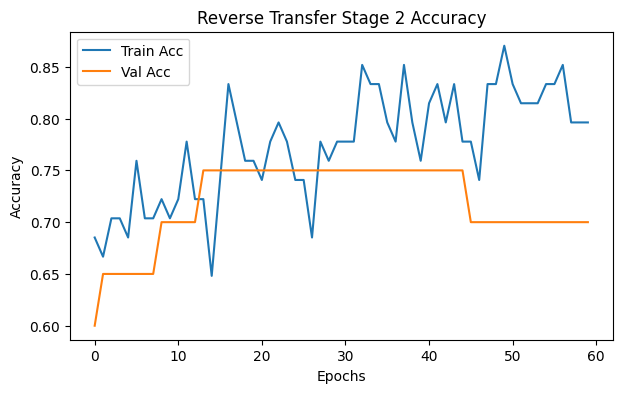

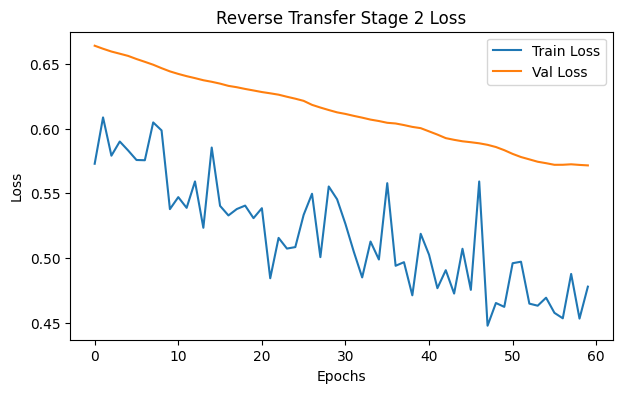

In [15]:
"""
Reverse Transfer Learning for 1D-CNN on Eye-Tracking
- Stage 0: Pretrain extractor on SOURCE pair (e.g., (1,3))
- Stage 1: Load extractor, freeze convs, train head only on TARGET pair
- BN-Adapt: freeze all except BatchNorm to adapt running stats on TARGET
- Stage 2: Unfreeze last conv block only (conv3/bn3/gap) and fine-tune @ low LR
- Eval: auto-tune decision threshold on VAL (balanced accuracy), then test
"""

import os, time
from typing import List, Tuple, Dict
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, f1_score, balanced_accuracy_score

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

REQUIRED_COLS = ['abs_lx','abs_ly','abs_rx','abs_ry']

def get_participant_id(filename: str) -> str:
    return os.path.splitext(filename)[0].split('_')[0]

# Loader
def _linear_resample(x: np.ndarray, target_len: int) -> np.ndarray:
    T, C = x.shape
    if T == target_len:
        return x
    src = np.linspace(0.0, 1.0, T, dtype=np.float32)
    dst = np.linspace(0.0, 1.0, target_len, dtype=np.float32)
    out = np.empty((target_len, C), dtype=x.dtype)
    for c in range(C):
        out[:, c] = np.interp(dst, src, x[:, c])
    return out

def _robust_scale_per_trace(x: np.ndarray, eps: float = 1e-6) -> np.ndarray:
    x_scaled = x.copy()
    for c in range(x.shape[1]):
        v = x[:, c]
        med = np.median(v)
        q75, q25 = np.percentile(v, 75), np.percentile(v, 25)
        iqr = max(q75 - q25, eps)
        x_scaled[:, c] = (v - med) / iqr
    return x_scaled

def load_pair_experiment(
    csv_dir: str,
    labels: Tuple[int, int],
    resample_len: int = 1500,
    max_nan_ratio: float = 0.30,
    divide_by_960: bool = True,
    use_robust_scale: bool = True
):
    X, y, files = [], [], []
    tagA, tagB = f"_{labels[0]}", f"_{labels[1]}"

    for file in sorted(os.listdir(csv_dir)):
        if not file.endswith(".csv"):
            continue
        if (tagA not in file) and (tagB not in file):
            continue

        path = os.path.join(csv_dir, file)
        df = pd.read_csv(path)

        if set(REQUIRED_COLS).issubset(df.columns):
            raw = df[REQUIRED_COLS].astype(np.float32).values
        else:
            raw = df.iloc[:, 1:5].astype(np.float32).values

        nan_ratio = np.isnan(raw).mean()
        if nan_ratio > max_nan_ratio:
            continue

        raw = pd.DataFrame(raw).fillna(method='ffill').fillna(method='bfill').fillna(0.0).values
        if divide_by_960:
            raw = raw / 960.0

        seq = _linear_resample(raw, resample_len)
        if use_robust_scale:
            seq = _robust_scale_per_trace(seq)

        X.append(seq)
        y.append(0 if tagA in file else 1)
        files.append(file)

    X = np.asarray(X, dtype=np.float32)
    y = np.asarray(y, dtype=np.int64)
    print(f"[load_pair_experiment] Labels={labels}, files={len(files)}, shape={X.shape}")
    return X, y, files

def split_by_participant_train_val_test(
    X: np.ndarray,
    y: np.ndarray,
    files: List[str],
    val_size: float = 0.2,
    test_size: float = 0.2,
    random_state: int = 42
):
    pids = np.array([get_participant_id(f) for f in files])
    uniq = np.array(sorted(list(set(pids))))

    pid_trainval, pid_test = train_test_split(uniq, test_size=test_size, random_state=random_state, shuffle=True)
    pid_train, pid_val = train_test_split(pid_trainval, test_size=val_size/(1.0-test_size),
                                          random_state=random_state, shuffle=True)

    def mask(ids): return np.isin(pids, ids)
    tr_mask, va_mask, te_mask = mask(pid_train), mask(pid_val), mask(pid_test)

    return X[tr_mask], y[tr_mask], X[va_mask], y[va_mask], X[te_mask], y[te_mask], {
        'train_ids': pid_train.tolist(),
        'val_ids': pid_val.tolist(),
        'test_ids': pid_test.tolist(),
    }

# Model
def build_extractor(input_shape) -> Model:
    inp = Input(shape=input_shape)
    x = layers.Conv1D(64, 7, padding='same', activation='relu', name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)

    x = layers.Conv1D(128, 5, padding='same', activation='relu', name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)

    x = layers.Conv1D(128, 3, padding='same', activation='relu', name='conv3')(x)
    x = layers.BatchNormalization(name='bn3')(x)
    x = layers.GlobalAveragePooling1D(name='gap')(x)
    model = Model(inp, x, name='extractor')
    return model

def build_classifier_from_extractor(extractor: Model, dropout=0.5) -> Model:
    inp = extractor.input
    x = extractor.output
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(dropout, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='cnn_transfer')

def get_optimizer(lr=3e-4):
    try:
        return tf.keras.optimizers.legacy.Adam(learning_rate=lr)
    except Exception:
        return tf.keras.optimizers.Adam(learning_rate=lr)

def compute_class_weight(y_train: np.ndarray):
    n0 = (y_train == 0).sum()
    n1 = (y_train == 1).sum()
    if min(n0, n1) == 0:
        return None
    w0 = (n0 + n1) / (2.0 * n0)
    w1 = (n0 + n1) / (2.0 * n1)
    return {0: float(w0), 1: float(w1)}

# Freeze helpers
def freeze_all_convs(model: Model, freeze: bool = True):
    for layer in model.layers:
        if layer.name in ['fc1', 'drop', 'logit']:
            layer.trainable = True
        else:
            layer.trainable = (not freeze)

def freeze_except_last_block(model: Model):
    """Unfreeze conv3/bn3/gap + head; freeze earlier convs."""
    for layer in model.layers:
        layer.trainable = False
    for name in ['conv3', 'bn3', 'gap', 'fc1', 'drop', 'logit']:
        try:
            model.get_layer(name).trainable = True
        except ValueError:
            pass

# BN-Adapt & threshold search
def bn_adapt(model, Xtr, ytr, Xva, yva, epochs=2, batch_size=32, lr=1e-5):
    # Freeze all
    for layer in model.layers:
        layer.trainable = False
    # Only BN layers trainable to update running stats
    for layer in model.layers:
        if isinstance(layer, tf.keras.layers.BatchNormalization):
            layer.trainable = True
    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy','AUC'])
    print(f"[BN-Adapt] epochs={epochs}, lr={lr}")
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=epochs, batch_size=batch_size, verbose=1)

def find_best_threshold(y_true, y_prob, metric="balanced_acc"):
    grid = np.linspace(0.1, 0.9, 81)
    best_t, best_m = 0.5, -1.0
    for t in grid:
        yhat = (y_prob >= t).astype(int)
        if metric == "f1":
            m = f1_score(y_true, yhat, average="binary")
        else:
            m = balanced_accuracy_score(y_true, yhat)
        if m > best_m:
            best_m, best_t = m, t
    return float(best_t), float(best_m)

# Pipelines
def pretrain_extractor_on_source(csv_dir: str, src_pair=(1,3), target_len=1500,
                                 max_epochs=60, batch_size=16, lr=3e-4,
                                 save_path='extractor_src.weights.h5'):
    X, y, files = load_pair_experiment(csv_dir, src_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(X, y, files)

    extractor = build_extractor((target_len, 4))
    model = build_classifier_from_extractor(extractor)

    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy','AUC'])
    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=12, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=10, min_lr=3.75e-05, verbose=1),
    ]
    print(f"[Pretrain] source={src_pair}")
    t0 = time.perf_counter()
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1, callbacks=cbs)
    t1 = time.perf_counter()
    print(f"[Time] Pretrain wall-clock: {t1 - t0:.2f}s")

    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    print("[TEST] Pretrain report:\n", classification_report(yte, ypred, digits=4))

    extractor.save_weights(save_path)
    print(f"[SAVE] extractor weights -> {save_path}")
    return save_path

def transfer_finetune(csv_dir: str, tgt_pair=(0,2), extractor_weights='extractor_src.weights.h5',
                      target_len=1500, batch_size=16, head_lr=1.5e-3, ft_lr=5e-5):
    # Load target
    X, y, files = load_pair_experiment(csv_dir, tgt_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, split_ids = split_by_participant_train_val_test(X, y, files)
    cls_weight = compute_class_weight(ytr)

    # Build & load
    extractor = build_extractor((target_len, 4))
    extractor.load_weights(extractor_weights)
    model = build_classifier_from_extractor(extractor)

    # Stage 1: head-only
    for layer in model.layers:
        layer.trainable = False
    for name in ['fc1', 'drop', 'logit']:
        model.get_layer(name).trainable = True
    model.compile(optimizer=get_optimizer(head_lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy','AUC'])
    cbs1 = [
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=4,
                                             min_lr=head_lr/4, verbose=1)
    ]
    print("[Stage 1] Head-only.")
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1, callbacks=cbs1,
              class_weight=cls_weight)

    # BN-Adapt
    bn_adapt(model, Xtr, ytr, Xva, yva, epochs=2, batch_size=batch_size, lr=1e-5)

    # Stage 2: unfreeze last block
    freeze_except_last_block(model)
    model.compile(optimizer=get_optimizer(ft_lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy','AUC'])
    cbs2 = [
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=8,
                                             min_lr=ft_lr/4, verbose=1)
    ]
    print("[Stage 2] Fine-tune last block (conv3) @ LR=5e-5.")
    t0 = time.perf_counter()
    hist2 = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                      epochs=60, batch_size=batch_size, verbose=1, callbacks=cbs2,
                      class_weight=cls_weight)
    t1 = time.perf_counter()
    print(f"[Time] Fine-tune wall-clock: {t1 - t0:.2f}s")

    # Threshold tuning on VAL, then TEST
    yprob_val = model.predict(Xva, batch_size=batch_size).ravel()
    best_t, best_m = find_best_threshold(yva, yprob_val, metric="balanced_acc")
    print(f"[VAL] best_threshold={best_t:.3f}, best_bal_acc={best_m:.4f}")

    yprob_te = model.predict(Xte, batch_size=batch_size).ravel()
    ypred_te = (yprob_te >= best_t).astype(int)
    print("\n[TEST] Transfer report (thr tuned):\n",
          classification_report(yte, ypred_te, digits=4))

    # Make sure to return a triple
    return model, (Xtr, ytr, Xva, yva, Xte, yte, split_ids), hist2.history

# plot
import matplotlib.pyplot as plt
def plot_history_acc_loss(history, title_prefix=""):
    if history is None:
        return
    acc = history.get('accuracy', [])
    val_acc = history.get('val_accuracy', [])
    loss = history.get('loss', [])
    val_loss = history.get('val_loss', [])

    plt.figure(figsize=(7,4))
    plt.plot(acc, label='Train Acc')
    plt.plot(val_acc, label='Val Acc')
    plt.xlabel("Epochs"); plt.ylabel("Accuracy"); plt.title(f"{title_prefix} Accuracy"); plt.legend(); plt.show()

    plt.figure(figsize=(7,4))
    plt.plot(loss, label='Train Loss')
    plt.plot(val_loss, label='Val Loss')
    plt.xlabel("Epochs"); plt.ylabel("Loss"); plt.title(f"{title_prefix} Loss"); plt.legend(); plt.show()

# Run
if __name__ == "__main__":
    csv_path = "/Users/wukehui/Desktop/data science project/project/data/first_trials"

    # Stage 0: pretrain on SOURCE (1,3) -> reverse transfer to (0,2)
    extractor_w = pretrain_extractor_on_source(
        csv_dir=csv_path, src_pair=(1,3), target_len=1500,
        max_epochs=60, batch_size=16, lr=3e-4,
        save_path='extractor_1_3_full.weights.h5'
    )

    # Transfer to TARGET (0,2)
    model_t, splits, hist2 = transfer_finetune(
        csv_dir=csv_path, tgt_pair=(0,2),
        extractor_weights=extractor_w, target_len=1500, batch_size=16,
        head_lr=1.5e-3, ft_lr=5e-5
    )

    # Plot stage-2 curves
    plot_history_acc_loss({'accuracy': hist2.get('accuracy', []),
                           'val_accuracy': hist2.get('val_accuracy', []),
                           'loss': hist2.get('loss', []),
                           'val_loss': hist2.get('val_loss', [])},
                          title_prefix="Reverse Transfer Stage 2")


first trials -> repeats transfer learning

[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
[Split target pids] {'train_ids': ['021', '065', '016', '032', '054', '072', '036', '056', '058', '042'], 'val_ids': ['049', '047', '048', '071', '011'], 'test_ids': ['006', '062', '057', '009', '041', '029']}
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[Pretrain] source=(0, 2)
Epoch 1/60
3/3 [==============================] - 1s 89ms/step - loss: 0.6823 - accuracy: 0.6667 - auc: 0.6265 - val_loss: 0.6916 - val_accuracy: 0.6250 - val_auc: 0.5559 - lr: 3.0000e-04
Epoch 2/60
3/3 [==============================] - 0s 56ms/step - loss: 0.5923 - accuracy: 0.7556 - auc: 0.8389 - val_loss: 0.6863 - val_accuracy: 0.5417 - val_auc: 0.7483 - lr: 3.0000e-04
Epoch 3/60
3/3 [==============================] - 0s 50ms/step - loss: 0.5638 - accuracy: 0.8444 - auc: 0.8429 - val_loss: 0.6848 - val_acc

Epoch 42/60
3/3 [==============================] - 0s 48ms/step - loss: 0.1258 - accuracy: 0.9778 - auc: 1.0000 - val_loss: 0.5683 - val_accuracy: 0.8333 - val_auc: 0.9056 - lr: 3.0000e-04
Epoch 43/60
3/3 [==============================] - 0s 44ms/step - loss: 0.1152 - accuracy: 0.9778 - auc: 1.0000 - val_loss: 0.5568 - val_accuracy: 0.7917 - val_auc: 0.9021 - lr: 3.0000e-04
Epoch 44/60
3/3 [==============================] - 0s 46ms/step - loss: 0.1092 - accuracy: 0.9778 - auc: 1.0000 - val_loss: 0.5434 - val_accuracy: 0.7917 - val_auc: 0.9161 - lr: 3.0000e-04
Epoch 45/60
3/3 [==============================] - 0s 45ms/step - loss: 0.1297 - accuracy: 0.9778 - auc: 0.9941 - val_loss: 0.5387 - val_accuracy: 0.8333 - val_auc: 0.9231 - lr: 3.0000e-04
Epoch 46/60
3/3 [==============================] - 0s 46ms/step - loss: 0.1151 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.5377 - val_accuracy: 0.9167 - val_auc: 0.9406 - lr: 3.0000e-04
Epoch 47/60
3/3 [==============================] - 0s 5

2/2 [==============================] - 0s 95ms/step - loss: 0.4289 - accuracy: 0.8500 - auc: 0.9500 - val_loss: 0.4550 - val_accuracy: 0.8750 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 2/60
2/2 [==============================] - 0s 20ms/step - loss: 0.4886 - accuracy: 0.8500 - auc: 0.8750 - val_loss: 0.4562 - val_accuracy: 0.8750 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 3/60
2/2 [==============================] - 0s 19ms/step - loss: 0.3846 - accuracy: 0.9000 - auc: 0.9400 - val_loss: 0.4563 - val_accuracy: 0.8750 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 4/60
2/2 [==============================] - 0s 22ms/step - loss: 0.4266 - accuracy: 0.8500 - auc: 0.9300 - val_loss: 0.4548 - val_accuracy: 0.8750 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 5/60
2/2 [==============================] - 0s 21ms/step - loss: 0.3524 - accuracy: 0.8500 - auc: 0.9500 - val_loss: 0.4525 - val_accuracy: 0.8750 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 6/60
2/2 [==============================] - 0s 26ms/step - loss: 

Epoch 43/60
2/2 [==============================] - 0s 21ms/step - loss: 0.4089 - accuracy: 0.9500 - auc: 0.9600 - val_loss: 0.4496 - val_accuracy: 0.8750 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 44/60
2/2 [==============================] - 0s 20ms/step - loss: 0.3547 - accuracy: 0.8500 - auc: 0.9800 - val_loss: 0.4490 - val_accuracy: 0.8750 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 45/60
2/2 [==============================] - 0s 24ms/step - loss: 0.3906 - accuracy: 0.9000 - auc: 0.9400 - val_loss: 0.4481 - val_accuracy: 0.8750 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 46/60
2/2 [==============================] - 0s 20ms/step - loss: 0.4433 - accuracy: 0.8000 - auc: 0.8800 - val_loss: 0.4463 - val_accuracy: 0.8750 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 47/60
2/2 [==============================] - 0s 21ms/step - loss: 0.3503 - accuracy: 0.9000 - auc: 0.9900 - val_loss: 0.4448 - val_accuracy: 0.8750 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 48/60
2/2 [==============================] - 0s 2

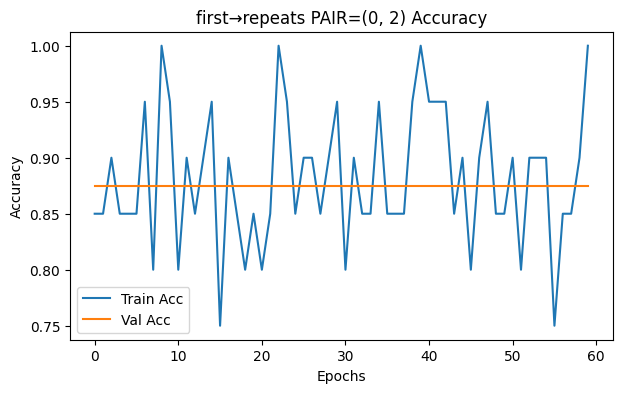

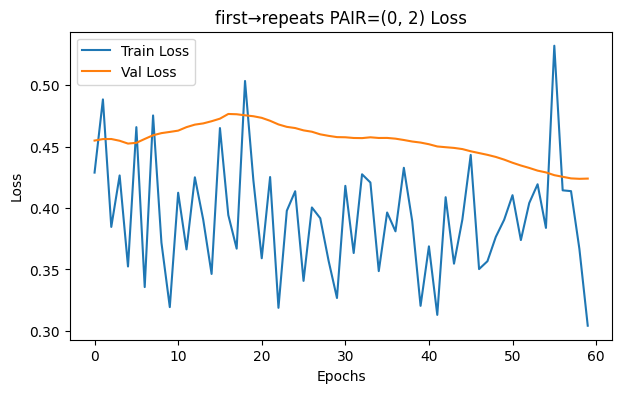

In [24]:
"""
Transfer Learning: first_trials -> repeats (1D-CNN on Eye-Tracking)
Pipeline:
- Stage 0: Pretrain extractor on SOURCE (first_trials)
- Stage 1: Head-only on TARGET (repeats)
- Stage 1.5: BN-Adapt (only BN trainable, very low LR, few epochs)
- Stage 2: Fine-tune last conv block (conv3) on TARGET @ low LR
- Threshold tuning on validation set by balanced accuracy, report test
"""

import os, time
from typing import List, Tuple, Dict, Optional
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, balanced_accuracy_score

# Global seeds
SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

REQUIRED_COLS = ['abs_lx','abs_ly','abs_rx','abs_ry']

# Utils
def get_participant_id(filename: str) -> str:
    # The file name is like "P01_xxx_0.csv" -> "P01"
    return os.path.splitext(filename)[0].split('_')[0]

def _linear_resample(x: np.ndarray, target_len: int) -> np.ndarray:
    T, C = x.shape
    if T == target_len:
        return x
    src = np.linspace(0.0, 1.0, T, dtype=np.float32)
    dst = np.linspace(0.0, 1.0, target_len, dtype=np.float32)
    out = np.empty((target_len, C), dtype=x.dtype)
    for c in range(C):
        out[:, c] = np.interp(dst, src, x[:, c])
    return out

def _robust_scale_per_trace(x: np.ndarray, eps: float = 1e-6) -> np.ndarray:
    x_scaled = x.copy()
    for c in range(x.shape[1]):
        v = x[:, c]
        med = np.median(v)
        q75, q25 = np.percentile(v, 75), np.percentile(v, 25)
        iqr = max(q75 - q25, eps)
        x_scaled[:, c] = (v - med) / iqr
    return x_scaled

def load_pair_experiment(
    csv_dir: str,
    labels: Tuple[int, int],
    resample_len: int = 1500,
    max_nan_ratio: float = 0.30,
    divide_by_960: bool = True,
    use_robust_scale: bool = True
):
    """Read two types of samples from the directory (the file name contains _label), perform linear resampling and robust normalization."""
    X, y, files = [], [], []
    tagA, tagB = f"_{labels[0]}", f"_{labels[1]}"

    for file in sorted(os.listdir(csv_dir)):
        if not file.endswith(".csv"):
            continue
        if (tagA not in file) and (tagB not in file):
            continue

        path = os.path.join(csv_dir, file)
        try:
            df = pd.read_csv(path)
        except Exception:
            continue

        if set(REQUIRED_COLS).issubset(df.columns):
            raw = df[REQUIRED_COLS].astype(np.float32).values
        else:
            raw = df.iloc[:, 1:5].astype(np.float32).values

        if raw.ndim != 2 or raw.shape[1] < 4:
            continue

        nan_ratio = np.isnan(raw).mean()
        if nan_ratio > max_nan_ratio:
            continue

        raw = pd.DataFrame(raw).fillna(method='ffill').fillna(method='bfill').fillna(0.0).values
        if divide_by_960:
            raw = raw / 960.0

        seq = _linear_resample(raw, resample_len)
        if use_robust_scale:
            seq = _robust_scale_per_trace(seq)

        X.append(seq)
        y.append(0 if tagA in file else 1)
        files.append(file)

    X = np.asarray(X, dtype=np.float32)
    y = np.asarray(y, dtype=np.int64)
    print(f"[load_pair_experiment] Dir={os.path.basename(csv_dir)} Labels={labels}, files={len(files)}, shape={X.shape}")
    return X, y, files

def split_by_participant_train_val_test(
    X: np.ndarray,
    y: np.ndarray,
    files: List[str],
    val_size: float = 0.25,
    test_size: float = 0.25,
    random_state: int = 42
):
    """Split train/val/test by subject group on target domain only."""
    pids = np.array([get_participant_id(f) for f in files])
    uniq = np.array(sorted(list(set(pids))))
    pid_trainval, pid_test = train_test_split(
        uniq, test_size=test_size, random_state=random_state, shuffle=True
    )
    pid_train, pid_val = train_test_split(
        pid_trainval, test_size=val_size/(1.0-test_size),
        random_state=random_state, shuffle=True
    )
    def mask(ids): return np.isin(pids, ids)
    tr_mask, va_mask, te_mask = mask(pid_train), mask(pid_val), mask(pid_test)

    return (
        X[tr_mask], y[tr_mask],
        X[va_mask], y[va_mask],
        X[te_mask], y[te_mask],
        {'train_ids': pid_train.tolist(), 'val_ids': pid_val.tolist(), 'test_ids': pid_test.tolist()}
    )

# Model
def build_extractor(input_shape) -> Model:
    inp = Input(shape=input_shape)
    x = layers.Conv1D(64, 7, padding='same', activation='relu', name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)

    x = layers.Conv1D(128, 5, padding='same', activation='relu', name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)

    x = layers.Conv1D(128, 3, padding='same', activation='relu', name='conv3')(x)
    x = layers.BatchNormalization(name='bn3')(x)
    x = layers.GlobalAveragePooling1D(name='gap')(x)
    return Model(inp, x, name='extractor')

def build_classifier_from_extractor(extractor: Model, dropout=0.5) -> Model:
    inp = extractor.input
    x = extractor.output
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(dropout, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='cnn_transfer')

def get_optimizer(lr=3e-4):
    try:
        return tf.keras.optimizers.legacy.Adam(learning_rate=lr)
    except Exception:
        return tf.keras.optimizers.Adam(learning_rate=lr)

def compute_class_weight(y_train: np.ndarray) -> Optional[Dict[int, float]]:
    n0 = int((y_train == 0).sum())
    n1 = int((y_train == 1).sum())
    if min(n0, n1) == 0:
        return None
    w0 = (n0 + n1) / (2.0 * n0)
    w1 = (n0 + n1) / (2.0 * n1)
    return {0: float(w0), 1: float(w1)}

def set_trainable_all(model: Model, flag: bool):
    for l in model.layers:
        l.trainable = flag

def freeze_all_but_head(model: Model):
    """Only make the fully connected heads (fc1/drop/logit) trainable."""
    for l in model.layers:
        l.trainable = (l.name in ['fc1','drop','logit'])

def bn_adapt_only(model: Model):
    """Only BN layers are trainable (for BN-Adapt)."""
    for l in model.layers:
        if isinstance(l, layers.BatchNormalization):
            l.trainable = True
        else:
            l.trainable = False

def finetune_last_block(model: Model):
    """Only unfreeze the last convolution block conv3 + bn3 + the following head."""
    for l in model.layers:
        if l.name in ['conv3','bn3','gap','fc1','drop','logit']:
            l.trainable = True
        else:
            l.trainable = False

# Training stages
def pretrain_extractor_on_source(
    csv_dir: str, src_pair=(0,2), target_len=1500,
    max_epochs=60, batch_size=16, lr=3e-4,
    save_path='extractor_src.weights.h5'
):
    X, y, files = load_pair_experiment(csv_dir, src_pair, resample_len=target_len)
    # The source domain is also divided into val/test groups according to the subjects for easy observation.
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(X, y, files)

    extractor = build_extractor((target_len, 4))
    model = build_classifier_from_extractor(extractor)

    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs = [
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=10, min_lr=3.75e-05, verbose=1),
    ]
    print(f"[Pretrain] source={src_pair}")
    t0 = time.perf_counter()
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1, callbacks=cbs)
    t1 = time.perf_counter()
    print(f"[Time] Pretrain wall-clock: {t1 - t0:.2f}s")

    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    print("[TEST] Pretrain report:\n", classification_report(yte, ypred, digits=4))

    extractor.save_weights(save_path)
    print(f"[SAVE] extractor weights -> {save_path}")
    return save_path

def tune_threshold_bal_acc(y_true: np.ndarray, y_prob: np.ndarray) -> Tuple[float, float]:
    """The optimal threshold is selected based on the balanced accuracy on the validation set."""
    best_thr, best_bal = 0.5, -1.0
    for thr in np.linspace(0.1, 0.9, 33):
        y_pred = (y_prob >= thr).astype(int)
        bal = balanced_accuracy_score(y_true, y_pred)
        if bal > best_bal:
            best_bal, best_thr = bal, float(thr)
    return best_thr, best_bal

def evaluate_with_threshold(model: Model, Xv, yv, Xt, yt, batch_size=16):
    vprob = model.predict(Xv, batch_size=batch_size).ravel()
    thr, bal = tune_threshold_bal_acc(yv, vprob)
    tprob = model.predict(Xt, batch_size=batch_size).ravel()
    tpred = (tprob >= thr).astype(int)
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")
    print("\n[TEST] Transfer report (thr tuned):\n",
          classification_report(yt, tpred, digits=4))
    return thr, bal

def transfer_first_to_repeats(
    src_dir: str, tgt_dir: str, pair=(0,2),
    extractor_weights_path: Optional[str] = None,
    target_len=1500, batch_size=16
):
    # Load data
    # Source domain (first_trials)
    Xs, ys, fs = load_pair_experiment(src_dir, pair, resample_len=target_len)
    # Target domain (repeats)
    Xt, yt, ft = load_pair_experiment(tgt_dir, pair, resample_len=target_len)

    # Target domain is divided by subject
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(
        Xt, yt, ft, val_size=0.25, test_size=0.25, random_state=SEED
    )
    print("[Split target pids]", split_info)

    # Build model / load extractor
    extractor = build_extractor((target_len, 4))

    # If no ready-made weights are passed in, pre-train in the source domain first and save
    if extractor_weights_path is None:
        extractor_weights_path = pretrain_extractor_on_source(
            csv_dir=src_dir, src_pair=pair, target_len=target_len,
            max_epochs=60, batch_size=batch_size, lr=3e-4,
            save_path=f"extractor_first_{pair[0]}_{pair[1]}.weights.h5"
        )
    extractor.load_weights(extractor_weights_path)
    model = build_classifier_from_extractor(extractor)

    # Stage 1: head-only
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    print("[Stage 1] Head-only.")
    cbs1 = [
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-04, verbose=1)
    ]
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1, callbacks=cbs1,
              class_weight=cls_weight)

    # Stage 1.5: BN-Adapt
    print("[BN-Adapt] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: fine-tune last block
    print("[Stage 2] Fine-tune last block (conv3) @ LR=5e-5.")
    finetune_last_block(model)
    model.compile(optimizer=get_optimizer(5e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)
    ]
    t0 = time.perf_counter()
    hist2 = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                      epochs=60, batch_size=batch_size, verbose=1, callbacks=cbs2,
                      class_weight=cls_weight)
    t1 = time.perf_counter()
    print(f"[Time] Fine-tune wall-clock: {t1 - t0:.2f}s")

    # Threshold tune & Test
    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, (Xtr, ytr, Xva, yva, Xte, yte), hist2.history, thr, split_info

# Plot helper
import matplotlib.pyplot as plt
def plot_history_acc_loss(history, title_prefix=""):
    if history is None:
        return
    acc = history.get('accuracy', [])
    val_acc = history.get('val_accuracy', [])
    loss = history.get('loss', [])
    val_loss = history.get('val_loss', [])
    plt.figure(figsize=(7,4))
    plt.plot(acc, label='Train Acc')
    plt.plot(val_acc, label='Val Acc')
    plt.xlabel("Epochs"); plt.ylabel("Accuracy"); plt.title(f"{title_prefix} Accuracy"); plt.legend(); plt.show()

    plt.figure(figsize=(7,4))
    plt.plot(loss, label='Train Loss')
    plt.plot(val_loss, label='Val Loss')
    plt.xlabel("Epochs"); plt.ylabel("Loss"); plt.title(f"{title_prefix} Loss"); plt.legend(); plt.show()

# Main
if __name__ == "__main__":
    SRC_DIR = '/Users/wukehui/Desktop/data science project/project/data/first_trials'
    TGT_DIR = '/Users/wukehui/Desktop/data science project/project/data/repeats'

    # Can be replaced with (1,3)
    PAIR = (0, 2)

    EXTRACTOR_WEIGHTS = None

    model_t, splits, hist2, best_thr, pid_split = transfer_first_to_repeats(
        src_dir=SRC_DIR, tgt_dir=TGT_DIR, pair=PAIR,
        extractor_weights_path=EXTRACTOR_WEIGHTS,
        target_len=1500, batch_size=16
    )

    # Draw a curve
    plot_history_acc_loss({'accuracy': hist2.get('accuracy', []),
                           'val_accuracy': hist2.get('val_accuracy', []),
                           'loss': hist2.get('loss', []),
                           'val_loss': hist2.get('val_loss', [])},
                          title_prefix=f"first→repeats PAIR={PAIR}")


Repeat Trials Generalisation Test for cnn

In [17]:
# Eval helpers for RTG
from sklearn.metrics import classification_report, balanced_accuracy_score, f1_score, roc_auc_score, average_precision_score, confusion_matrix

def predict_prob_on_dir(model: Model, data_dir: str, pair=(0,2), target_len=1500, batch_size=16):
    """Inference only: Make predictions for all samples in data_dir and return y_true, y_prob, and files."""
    X, y, files = load_pair_experiment(data_dir, pair, resample_len=target_len)
    y_prob = model.predict(X, batch_size=batch_size).ravel()
    return y, y_prob, files

def evaluate_fixed_threshold(y_true, y_prob, thr=0.5, label=""):
    y_pred = (y_prob >= thr).astype(int)
    out = {
        "label": label,
        "thr": float(thr),
        "bal_acc": balanced_accuracy_score(y_true, y_pred),
        "macro_f1": f1_score(y_true, y_pred, average='macro'),
        "roc_auc": roc_auc_score(y_true, y_prob) if len(np.unique(y_true))==2 else np.nan,
        "auprc": average_precision_score(y_true, y_prob),
        "confusion": confusion_matrix(y_true, y_pred).tolist(),
        "n": int(len(y_true))
    }
    print("\n[EVAL]", label)
    print(pd.Series(out))
    print(classification_report(y_true, y_pred, digits=4))
    return out



In [20]:
# A) In-domain baselines
def run_in_domain_baseline(data_dir: str, pair=(0,2), target_len=1500, batch_size=16, tag="first"):
    """Train and test in the same domain (subject split), giving the upper bound performance in the domain."""
    # First pre-train the extractor in this domain (to be consistent with the transfer pipeline)
    w_path = pretrain_extractor_on_source(
        csv_dir=data_dir, src_pair=pair, target_len=target_len,
        max_epochs=60, batch_size=batch_size, lr=3e-4,
        save_path=f"extractor_{tag}_{pair[0]}_{pair[1]}.weights.h5"
    )
    # Go through three phases of training using the same domain as the "target domain" (subject division)
    Xt, yt, ft = load_pair_experiment(data_dir, pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(Xt, yt, ft, random_state=SEED)
    extractor = build_extractor((target_len, 4))
    extractor.load_weights(w_path)
    model = build_classifier_from_extractor(extractor)

    # stage 1: head only
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-04, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)

    # stage 1.5: BN-Adapt
    print("[BN-Adapt] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # stage 2: last block
    print("[Stage 2] Fine-tune last block (conv3) @ LR=5e-5.")
    finetune_last_block(model)
    model.compile(optimizer=get_optimizer(5e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    # The threshold is adjusted higher in the validation set of the domain, and then the test set of the domain is tested
    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), thr=thr, split=split_info, hist=hist.history)


In [21]:
# B) Cross-domain zero-shot
def run_zero_shot(src_model: Model, src_thr: float,
                  tgt_dir: str, pair=(0,2), target_len=1500, batch_size=16,
                  label_prefix="B_zero"):
    """Direct inference is performed without training on the target domain. Two threshold evaluations are returned: 0.5 and the source domain threshold."""
    y_true, y_prob, _ = predict_prob_on_dir(src_model, tgt_dir, pair, target_len, batch_size)
    out1 = evaluate_fixed_threshold(y_true, y_prob, thr=0.5, label=f"{label_prefix}@0.5")
    out2 = evaluate_fixed_threshold(y_true, y_prob, thr=src_thr, label=f"{label_prefix}@thr_src")
    return {"@0.5": out1, "@thr_src": out2}


In [22]:
# C) Few-shot adaptation (k-subjects)
def run_kshot_adaptation(src_dir: str, tgt_dir: str, pair=(0,2),
                         k_subjects: int = 10, target_len=1500, batch_size=16, seed=SEED,
                         reuse_extractor_path: Optional[str] = None, label="C_kshot"):
    """
    First pre-train the extractor in src_dir (or reuse the path), select k subjects in tgt_dir for training/validation and the rest for testing.
    """
    # Pretraining/loading extractors
    if reuse_extractor_path is None:
        reuse_extractor_path = pretrain_extractor_on_source(
            csv_dir=src_dir, src_pair=pair, target_len=target_len,
            max_epochs=60, batch_size=batch_size, lr=3e-4,
            save_path=f"extractor_{os.path.basename(src_dir)}_{pair[0]}_{pair[1]}.weights.h5"
        )

    # Load the target domain and subject partitioning (custom k-shot)
    Xt, yt, ft = load_pair_experiment(tgt_dir, pair, resample_len=target_len)
    pids = np.array([get_participant_id(f) for f in ft])
    uniq = np.array(sorted(list(set(pids))))
    rng = np.random.RandomState(seed)
    rng.shuffle(uniq)
    k = min(k_subjects, len(uniq))
    pid_trainval = uniq[:k]
    pid_test     = uniq[k:]
    if len(pid_test) == 0:  # Fault tolerance: If k is too large, leave at least one person to test
        pid_test = uniq[-1:]
        pid_trainval = uniq[:-1]

    # Then separate val inside trainval
    pid_train, pid_val = train_test_split(pid_trainval, test_size=max(1, int(0.2*len(pid_trainval))), random_state=seed)
    def mask(ids): return np.isin(pids, ids)
    Xtr, ytr = Xt[mask(pid_train)], yt[mask(pid_train)]
    Xva, yva = Xt[mask(pid_val)],   yt[mask(pid_val)]
    Xte, yte = Xt[mask(pid_test)],  yt[mask(pid_test)]
    print(f"[K-shot split] train_ids={pid_train.tolist()} val_ids={pid_val.tolist()} test_ids={pid_test.tolist()}")

    # Build the model and load the extractor
    extractor = build_extractor((target_len, 4))
    extractor.load_weights(reuse_extractor_path)
    model = build_classifier_from_extractor(extractor)

    # Stage 1: Head-only
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-04, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)

    # BN-Adapt
    print("[BN-Adapt] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: conv3 fine-tune
    print("[Stage 2] Fine-tune last block (conv3) @ LR=5e-5.")
    finetune_last_block(model)
    model.compile(optimizer=get_optimizer(5e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), thr=thr, hist=hist.history)


In [23]:
# D) Joint training (first + repeats)
def run_joint_training(first_dir: str, repeats_dir: str, pair=(0,2), target_len=1500, batch_size=16):
    """Merge two domains for training; split train/val/test by subject; evaluate the test set separately by domain."""
    Xf, yf, ff = load_pair_experiment(first_dir, pair, resample_len=target_len)
    Xr, yr, fr = load_pair_experiment(repeats_dir, pair, resample_len=target_len)

    # Add a domain prefix to the subject ID to avoid conflicts with the same name
    pf = np.array([ "F_"+get_participant_id(f) for f in ff ])
    pr = np.array([ "R_"+get_participant_id(f) for f in fr ])

    X = np.vstack([Xf, Xr])
    y = np.concatenate([yf, yr])
    files = np.array(ff + fr)
    pids  = np.concatenate([pf, pr])
    domains = np.array(['first']*len(Xf) + ['repeats']*len(Xr))

    # Custom split: Divide by "pid with domain prefix"
    uniq = np.array(sorted(list(set(pids))))
    pid_trainval, pid_test = train_test_split(uniq, test_size=0.25, random_state=SEED, shuffle=True)
    pid_train, pid_val = train_test_split(pid_trainval, test_size=len(pid_trainval)//4 if len(pid_trainval)>4 else 1,
                                          random_state=SEED, shuffle=True)

    def mask(ids): return np.isin(pids, ids)
    tr, va, te = mask(pid_train), mask(pid_val), mask(pid_test)
    Xtr, ytr = X[tr], y[tr]
    Xva, yva = X[va], y[va]
    Xte, yte = X[te], y[te]
    d_te = domains[te]

    # Build & Train
    extractor = build_extractor((target_len, 4))
    model = build_classifier_from_extractor(extractor)

    # First, do a warm-up on the combined training set (here, direct end-to-end training head→BN→conv3)
    # Stage 1
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-04, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)

    # BN-adapt
    print("[BN-Adapt] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2
    print("[Stage 2] Fine-tune last block (conv3) @ LR=5e-5.")
    finetune_last_block(model)
    model.compile(optimizer=get_optimizer(5e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    # Use the combined validation set to adjust the threshold; evaluate on the first / repeats test subsets separately
    vprob = model.predict(Xva, batch_size=batch_size).ravel()
    thr, bal = tune_threshold_bal_acc(yva, vprob)
    tprob = model.predict(Xte, batch_size=batch_size).ravel()
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")

    mask_first = (d_te == 'first')
    mask_rep   = (d_te == 'repeats')
    print("\n[TEST] Joint → first subset")
    evaluate_fixed_threshold(yte[mask_first], tprob[mask_first], thr=thr, label="D_joint→firstTest")
    print("\n[TEST] Joint → repeats subset")
    evaluate_fixed_threshold(yte[mask_rep], tprob[mask_rep], thr=thr, label="D_joint→repeatsTest")
    print("\n[TEST] Joint → all")
    evaluate_fixed_threshold(yte, tprob, thr=thr, label="D_joint→allTest")

    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), test_domain=d_te, thr=thr, hist=hist.history)


In [24]:
# Distribution analysis (stats + PCA/t-SNE)
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from scipy.stats import ks_2samp
import matplotlib.pyplot as plt

def summarize_timeseries(X):  # X: (N, T, C)
    feats = []
    for x in X:
        f = []
        for c in range(x.shape[1]):
            sig = x[:, c]
            f += [
                np.mean(sig), np.std(sig), np.max(sig)-np.min(sig),
                np.mean(np.abs(sig)), np.sum(sig**2)/len(sig)
            ]
        feats.append(f)
    return np.array(feats)

def analyse_first_vs_repeats(first_dir: str, repeats_dir: str, pair=(0,2), target_len=1500):
    Xf, yf, ff = load_pair_experiment(first_dir, pair, resample_len=target_len)
    Xr, yr, fr = load_pair_experiment(repeats_dir, pair, resample_len=target_len)

    Ff = summarize_timeseries(Xf)
    Fr = summarize_timeseries(Xr)
    F  = np.vstack([Ff, Fr])
    dom= np.array(['first']*len(Ff) + ['repeats']*len(Fr))
    y  = np.concatenate([yf, yr])

    # KS dimension-by-dimension test
    ks_ps = []
    for i in range(F.shape[1]):
        stat, p = ks_2samp(Ff[:, i], Fr[:, i])
        ks_ps.append(p)
    ks_ps = np.array(ks_ps)
    print(f"[KS] min p={ks_ps.min():.3e}, median p={np.median(ks_ps):.3e}, share<=0.05={(ks_ps<=0.05).mean():.3f}")

    # PCA
    pca = PCA(n_components=2, random_state=SEED)
    Zp = pca.fit_transform(F)
    plt.figure(figsize=(5,4))
    plt.scatter(Zp[dom=='first',0], Zp[dom=='first',1], s=14, alpha=0.75, label='first')
    plt.scatter(Zp[dom=='repeats',0], Zp[dom=='repeats',1], s=14, alpha=0.75, label='repeats')
    plt.title('PCA: first vs repeats'); plt.legend(); plt.tight_layout(); plt.show()

    # t-SNE (normalise first)
    Fstd = (F - F.mean(0)) / (F.std(0)+1e-8)
    Zt = TSNE(n_components=2, perplexity=30, init='pca', learning_rate='auto',
              random_state=SEED).fit_transform(Fstd)
    plt.figure(figsize=(5,4))
    plt.scatter(Zt[dom=='first',0], Zt[dom=='first',1], s=14, alpha=0.85, label='first')
    plt.scatter(Zt[dom=='repeats',0], Zt[dom=='repeats',1], s=14, alpha=0.85, label='repeats')
    plt.title('t-SNE: first vs repeats'); plt.legend(); plt.tight_layout(); plt.show()

    # Label Coloring
    plt.figure(figsize=(5,4))
    for lab, name in [(0,'class0'),(1,'class1')]:
        m = (y==lab)
        plt.scatter(Zt[m,0], Zt[m,1], s=12, alpha=0.8, label=name)
    plt.title('t-SNE by label'); plt.legend(); plt.tight_layout(); plt.show()



=== A1: in-domain baseline on FIRST ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[Pretrain] source=(0, 2)
Epoch 1/60
3/3 [==============================] - 1s 94ms/step - loss: 0.6367 - accuracy: 0.6444 - auc: 0.6789 - val_loss: 0.6828 - val_accuracy: 0.5417 - val_auc: 0.7028 - lr: 3.0000e-04
Epoch 2/60
3/3 [==============================] - 0s 46ms/step - loss: 0.6057 - accuracy: 0.6667 - auc: 0.7431 - val_loss: 0.6818 - val_accuracy: 0.5417 - val_auc: 0.7692 - lr: 3.0000e-04
Epoch 3/60
3/3 [==============================] - 0s 44ms/step - loss: 0.5573 - accuracy: 0.7778 - auc: 0.8439 - val_loss: 0.6828 - val_accuracy: 0.5417 - val_auc: 0.8322 - lr: 3.0000e-04
Epoch 4/60
3/3 [==============================] - 0s 64ms/step - loss: 0.5320 - accuracy: 0.8667 - auc: 0.8953 - val_loss: 0.6820 - val_accuracy: 0.7917 - val_auc: 0.8881 - lr: 3.0000e-04
Epoch 5/60
3/3 [==============================] - 0s 42ms/step - loss: 0.5423 - accuracy: 0.8222 

Epoch 42/60
3/3 [==============================] - 0s 39ms/step - loss: 0.1724 - accuracy: 0.9556 - auc: 0.9980 - val_loss: 0.9032 - val_accuracy: 0.4583 - val_auc: 0.9196 - lr: 7.5000e-05
Epoch 43/60
3/3 [==============================] - 0s 42ms/step - loss: 0.1884 - accuracy: 0.9333 - auc: 0.9951 - val_loss: 0.9136 - val_accuracy: 0.4583 - val_auc: 0.9196 - lr: 7.5000e-05
Epoch 44/60
3/3 [==============================] - 0s 41ms/step - loss: 0.1857 - accuracy: 0.9111 - auc: 0.9921 - val_loss: 0.9209 - val_accuracy: 0.4583 - val_auc: 0.9336 - lr: 7.5000e-05
Epoch 45/60
3/3 [==============================] - ETA: 0s - loss: 0.1999 - accuracy: 0.9333 - auc: 0.9941
Epoch 45: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.
3/3 [==============================] - 0s 41ms/step - loss: 0.1999 - accuracy: 0.9333 - auc: 0.9941 - val_loss: 0.9286 - val_accuracy: 0.4583 - val_auc: 0.9266 - lr: 7.5000e-05
Epoch 46/60
3/3 [==============================] - 0s 51ms/step - loss:

Epoch 2/2
3/3 [==============================] - 0s 37ms/step - loss: 0.1311 - accuracy: 0.9556 - auc: 0.9980 - val_loss: 0.3448 - val_accuracy: 0.9167 - val_auc: 0.9580
[Stage 2] Fine-tune last block (conv3) @ LR=5e-5.
Epoch 1/60
3/3 [==============================] - 0s 56ms/step - loss: 0.3133 - accuracy: 0.8667 - auc: 0.9387 - val_loss: 0.3448 - val_accuracy: 0.9167 - val_auc: 0.9580 - lr: 5.0000e-05
Epoch 2/60
3/3 [==============================] - 0s 24ms/step - loss: 0.1635 - accuracy: 0.9333 - auc: 0.9901 - val_loss: 0.3408 - val_accuracy: 0.8750 - val_auc: 0.9580 - lr: 5.0000e-05
Epoch 3/60
3/3 [==============================] - 0s 24ms/step - loss: 0.2051 - accuracy: 0.8889 - auc: 0.9822 - val_loss: 0.3378 - val_accuracy: 0.9167 - val_auc: 0.9580 - lr: 5.0000e-05
Epoch 4/60
3/3 [==============================] - 0s 24ms/step - loss: 0.2179 - accuracy: 0.9333 - auc: 0.9852 - val_loss: 0.3360 - val_accuracy: 0.9167 - val_auc: 0.9580 - lr: 5.0000e-05
Epoch 5/60
3/3 [============

2/2 [==============================] - 0s 23ms/step - loss: 0.4044 - accuracy: 0.8000 - auc: 0.8900 - val_loss: 0.6428 - val_accuracy: 0.6250 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 21/60
2/2 [==============================] - 0s 26ms/step - loss: 0.3948 - accuracy: 0.8000 - auc: 0.9300 - val_loss: 0.6394 - val_accuracy: 0.6250 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 22/60
2/2 [==============================] - 0s 25ms/step - loss: 0.4045 - accuracy: 0.9000 - auc: 0.9800 - val_loss: 0.6366 - val_accuracy: 0.6250 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 23/60
2/2 [==============================] - 0s 25ms/step - loss: 0.3330 - accuracy: 0.9500 - auc: 1.0000 - val_loss: 0.6353 - val_accuracy: 0.6250 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 24/60
2/2 [==============================] - 0s 26ms/step - loss: 0.3701 - accuracy: 0.8500 - auc: 0.9600 - val_loss: 0.6367 - val_accuracy: 0.6250 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 25/60
2/2 [==============================] - 0s 30ms/step - l

[Time] Pretrain wall-clock: 4.11s
1/1 [==============================] - 0s 50ms/step
[TEST] Pretrain report:
               precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000         6
           1     0.5000    1.0000    0.6667         6

    accuracy                         0.5000        12
   macro avg     0.2500    0.5000    0.3333        12
weighted avg     0.2500    0.5000    0.3333        12

[SAVE] extractor weights -> extractor_repeats_0_2.weights.h5


/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
Epoch 1/20
2/2 [==============================] - 0s 90ms/step - loss: 0.7294 - accuracy: 0.3500 - auc: 0.3650 - val_loss: 0.7448 - val_accuracy: 0.3750 - val_auc: 0.0625 - lr: 0.0030
Epoch 2/20
2/2 [==============================] - 0s 16ms/step - loss: 0.7343 - accuracy: 0.4500 - auc: 0.4400 - val_loss: 0.7439 - val_accuracy: 0.5000 - val_auc: 0.0625 - lr: 0.0030
Epoch 3/20
2/2 [==============================] - 0s 16ms/step - loss: 0.6920 - accuracy: 0.6000 - auc: 0.6200 - val_loss: 0.7267 - val_accuracy: 0.5000 - val_auc: 0.2188 - lr: 0.0030
Epoch 4/20
2/2 [==============================] - 0s 18ms/step - loss: 0.6937 - accuracy: 0.5000 - auc: 0.5650 - val_loss: 0.7088 - val_accuracy: 0.5000 - val_auc: 0.3125 - lr: 0.0030
Epoch 5/20
2/2 [==============================] - 0s 18ms/step - loss: 0.6529 - accuracy: 0.5500 - auc: 0.8400 - val_loss: 0.6985 - val_accuracy: 0.3750 - val_auc: 0.3438 - lr: 0.0030


[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
6/6 [==============================] - 0s 10ms/step

[EVAL] B2_repeats→first@0.5
label        B2_repeats→first@0.5
thr                           0.5
bal_acc                   0.76087
macro_f1                 0.756731
roc_auc                  0.835066
auprc                    0.817014
confusion     [[29, 17], [5, 41]]
n                              92
dtype: object
              precision    recall  f1-score   support

           0     0.8529    0.6304    0.7250        46
           1     0.7069    0.8913    0.7885        46

    accuracy                         0.7609        92
   macro avg     0.7799    0.7609    0.7567        92
weighted avg     0.7799    0.7609    0.7567        92


[EVAL] B2_repeats→first@thr_src
label        B2_repeats→first@thr_src
thr                              0.45
bal_acc                      0.706522
macro_f1                     0.696147
roc_auc                      0.83506

Epoch 35/60
3/3 [==============================] - 0s 40ms/step - loss: 0.2184 - accuracy: 0.9778 - auc: 1.0000 - val_loss: 0.7994 - val_accuracy: 0.5000 - val_auc: 0.8776 - lr: 1.5000e-04
Epoch 36/60
3/3 [==============================] - 0s 41ms/step - loss: 0.2347 - accuracy: 0.9556 - auc: 0.9960 - val_loss: 0.8051 - val_accuracy: 0.5000 - val_auc: 0.8811 - lr: 1.5000e-04
Epoch 37/60
3/3 [==============================] - ETA: 0s - loss: 0.2659 - accuracy: 0.9556 - auc: 0.9664
Epoch 37: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
3/3 [==============================] - 0s 41ms/step - loss: 0.2659 - accuracy: 0.9556 - auc: 0.9664 - val_loss: 0.8181 - val_accuracy: 0.5000 - val_auc: 0.8776 - lr: 1.5000e-04
Epoch 38/60
3/3 [==============================] - 0s 39ms/step - loss: 0.2011 - accuracy: 0.9778 - auc: 1.0000 - val_loss: 0.8270 - val_accuracy: 0.5000 - val_auc: 0.8776 - lr: 7.5000e-05
Epoch 39/60
3/3 [==============================] - 0s 37ms/step - loss: 

Epoch 12/20
1/1 [==============================] - ETA: 0s - loss: 0.6094 - accuracy: 0.6875 - auc: 0.7031
Epoch 12: ReduceLROnPlateau reducing learning rate to 0.000750000006519258.
1/1 [==============================] - 0s 26ms/step - loss: 0.6094 - accuracy: 0.6875 - auc: 0.7031 - val_loss: 0.7349 - val_accuracy: 0.5000 - val_auc: 0.7500 - lr: 0.0015
Epoch 13/20
1/1 [==============================] - 0s 24ms/step - loss: 0.5223 - accuracy: 0.6875 - auc: 0.8438 - val_loss: 0.7360 - val_accuracy: 0.5000 - val_auc: 0.7500 - lr: 7.5000e-04
Epoch 14/20
1/1 [==============================] - 0s 26ms/step - loss: 0.5763 - accuracy: 0.7500 - auc: 0.8047 - val_loss: 0.7370 - val_accuracy: 0.5000 - val_auc: 0.7500 - lr: 7.5000e-04
Epoch 15/20
1/1 [==============================] - 0s 31ms/step - loss: 0.5690 - accuracy: 0.6250 - auc: 0.8125 - val_loss: 0.7384 - val_accuracy: 0.5000 - val_auc: 0.7500 - lr: 7.5000e-04
Epoch 16/20
1/1 [==============================] - 0s 25ms/step - loss: 0.498

2/2 [==============================] - 0s 27ms/step - loss: 0.5862 - accuracy: 0.6500 - auc: 0.7300 - val_loss: 0.7019 - val_accuracy: 0.2500 - val_auc: 0.2500 - lr: 3.0000e-04
Epoch 10/60
2/2 [==============================] - 0s 36ms/step - loss: 0.5135 - accuracy: 0.8500 - auc: 0.8900 - val_loss: 0.7029 - val_accuracy: 0.2500 - val_auc: 0.2188 - lr: 3.0000e-04
Epoch 11/60
2/2 [==============================] - 0s 35ms/step - loss: 0.5333 - accuracy: 0.8000 - auc: 0.8850 - val_loss: 0.7026 - val_accuracy: 0.2500 - val_auc: 0.3125 - lr: 3.0000e-04
Epoch 12/60
2/2 [==============================] - 0s 27ms/step - loss: 0.5331 - accuracy: 0.7500 - auc: 0.8550 - val_loss: 0.6998 - val_accuracy: 0.3750 - val_auc: 0.3750 - lr: 3.0000e-04
Epoch 13/60
2/2 [==============================] - 0s 25ms/step - loss: 0.4473 - accuracy: 0.9000 - auc: 0.9700 - val_loss: 0.6977 - val_accuracy: 0.3750 - val_auc: 0.4375 - lr: 3.0000e-04
Epoch 14/60
2/2 [==============================] - 0s 28ms/step - l

1/1 [==============================] - 0s 27ms/step - loss: 0.3472 - accuracy: 0.8000 - auc: 0.9464 - val_loss: 0.5322 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 8/60
1/1 [==============================] - 0s 30ms/step - loss: 0.3589 - accuracy: 0.8000 - auc: 0.9464 - val_loss: 0.5314 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 9/60
1/1 [==============================] - 0s 29ms/step - loss: 0.2907 - accuracy: 0.8000 - auc: 0.9464 - val_loss: 0.5307 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 10/60
1/1 [==============================] - 0s 31ms/step - loss: 0.3469 - accuracy: 0.8667 - auc: 0.9464 - val_loss: 0.5300 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 11/60
1/1 [==============================] - 0s 33ms/step - loss: 0.3271 - accuracy: 0.8000 - auc: 0.9464 - val_loss: 0.5294 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 12/60
1/1 [==============================] - 0s 35ms/step - los

Epoch 6/60
5/5 [==============================] - 0s 19ms/step - loss: 0.5183 - accuracy: 0.7568 - auc: 0.8472 - val_loss: 0.6560 - val_accuracy: 0.5600 - val_auc: 0.8686 - lr: 5.0000e-05
Epoch 7/60
5/5 [==============================] - 0s 19ms/step - loss: 0.5098 - accuracy: 0.7973 - auc: 0.8651 - val_loss: 0.6533 - val_accuracy: 0.6000 - val_auc: 0.8718 - lr: 5.0000e-05
Epoch 8/60
5/5 [==============================] - 0s 19ms/step - loss: 0.4713 - accuracy: 0.8108 - auc: 0.8977 - val_loss: 0.6510 - val_accuracy: 0.6000 - val_auc: 0.8686 - lr: 5.0000e-05
Epoch 9/60
5/5 [==============================] - 0s 19ms/step - loss: 0.4862 - accuracy: 0.8108 - auc: 0.8754 - val_loss: 0.6486 - val_accuracy: 0.6400 - val_auc: 0.8686 - lr: 5.0000e-05
Epoch 10/60
5/5 [==============================] - 0s 18ms/step - loss: 0.5104 - accuracy: 0.7568 - auc: 0.8600 - val_loss: 0.6463 - val_accuracy: 0.6400 - val_auc: 0.8718 - lr: 5.0000e-05
Epoch 11/60
5/5 [==============================] - 0s 18ms/

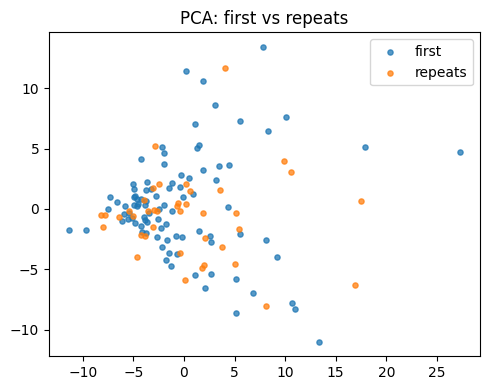

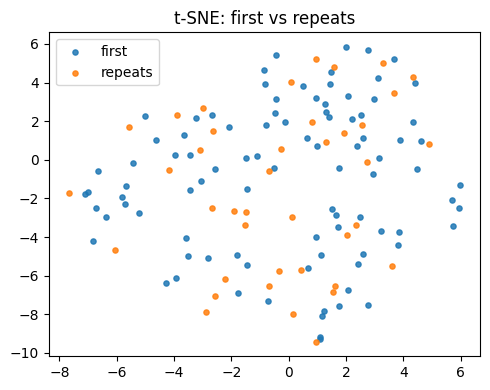

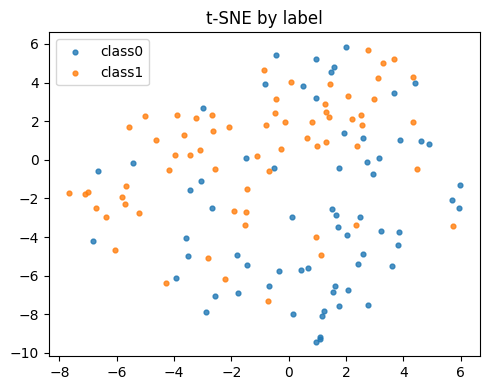

In [25]:
    # Repeat Trial Generalisation Test
    SRC_DIR = '/Users/wukehui/Desktop/data science project/project/data/first_trials'
    TGT_DIR = '/Users/wukehui/Desktop/data science project/project/data/repeats'
    PAIR = (0,2)
    BATCH = 16
    TLEN = 1500

    print("\n=== A1: in-domain baseline on FIRST ===")
    modelA1, resA1 = run_in_domain_baseline(SRC_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH, tag="first")
    thrA1 = resA1["thr"]

    print("\n=== A2: in-domain baseline on REPEATS ===")
    modelA2, resA2 = run_in_domain_baseline(TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH, tag="repeats")
    thrA2 = resA2["thr"]

    print("\n=== B1: zero-shot FIRST → REPEATS ===")
    zsB1 = run_zero_shot(modelA1, thrA1, TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH, label_prefix="B1_first→repeats")

    print("\n=== B2: zero-shot REPEATS → FIRST ===")
    zsB2 = run_zero_shot(modelA2, thrA2, SRC_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH, label_prefix="B2_repeats→first")

    print("\n=== C1: k-shot FIRST → REPEATS (k=10) ===")
    modelC1, resC1 = run_kshot_adaptation(SRC_DIR, TGT_DIR, pair=PAIR, k_subjects=10, target_len=TLEN, batch_size=BATCH,
                                          reuse_extractor_path=None, label="C1_first→repeats_k10")

    print("\n=== C2: k-shot REPEATS → FIRST (k=10) ===")
    modelC2, resC2 = run_kshot_adaptation(TGT_DIR, SRC_DIR, pair=PAIR, k_subjects=10, target_len=TLEN, batch_size=BATCH,
                                          reuse_extractor_path=None, label="C2_repeats→first_k10")

    print("\n=== D: Joint training (FIRST ∪ REPEATS) ===")
    modelD, resD = run_joint_training(SRC_DIR, TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH)

    print("\n=== Distribution analysis ===")
    analyse_first_vs_repeats(SRC_DIR, TGT_DIR, pair=PAIR, target_len=TLEN)


xai for cnn

[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
Epoch 1/80
4/4 [==============================] - 0s 50ms/step - loss: 0.7577 - accuracy: 0.5741 - val_loss: 0.6882 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 33ms/step - loss: 0.6788 - accuracy: 0.5556 - val_loss: 0.6855 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 33ms/step - loss: 0.6221 - accuracy: 0.6481 - val_loss: 0.6832 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 0s 35ms/step - loss: 0.5591 - accuracy: 0.7222 - val_loss: 0.6808 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 0s 33ms/step - loss: 0.5791 - accuracy: 0.7037 - val_loss: 0.6782 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 0s 33ms/step - loss: 0.4618 - accuracy: 0.8333 - val_loss: 0.6757 - val_accuracy: 0.5

Epoch 53/80
4/4 [==============================] - 0s 34ms/step - loss: 0.2034 - accuracy: 0.9074 - val_loss: 0.5577 - val_accuracy: 0.8000 - lr: 3.0000e-04
Epoch 54/80
4/4 [==============================] - 0s 30ms/step - loss: 0.1660 - accuracy: 0.9815 - val_loss: 0.5447 - val_accuracy: 0.8000 - lr: 3.0000e-04
Epoch 55/80
4/4 [==============================] - 0s 33ms/step - loss: 0.1351 - accuracy: 0.9815 - val_loss: 0.5400 - val_accuracy: 0.8500 - lr: 3.0000e-04
Epoch 56/80
4/4 [==============================] - 0s 31ms/step - loss: 0.1560 - accuracy: 0.9630 - val_loss: 0.5349 - val_accuracy: 0.8500 - lr: 3.0000e-04
Epoch 57/80
4/4 [==============================] - 0s 31ms/step - loss: 0.1421 - accuracy: 0.9815 - val_loss: 0.5301 - val_accuracy: 0.8000 - lr: 3.0000e-04
Epoch 58/80
4/4 [==============================] - 0s 30ms/step - loss: 0.1527 - accuracy: 1.0000 - val_loss: 0.5253 - val_accuracy: 0.8000 - lr: 3.0000e-04
Epoch 59/80
4/4 [==============================] - 0s 31ms

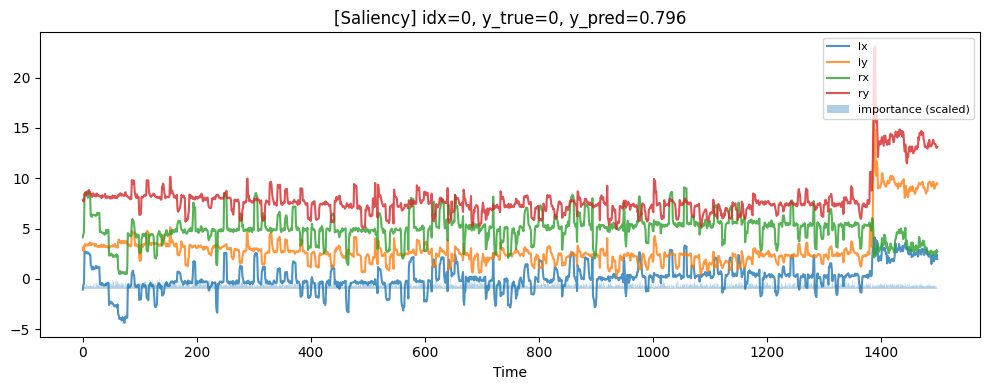

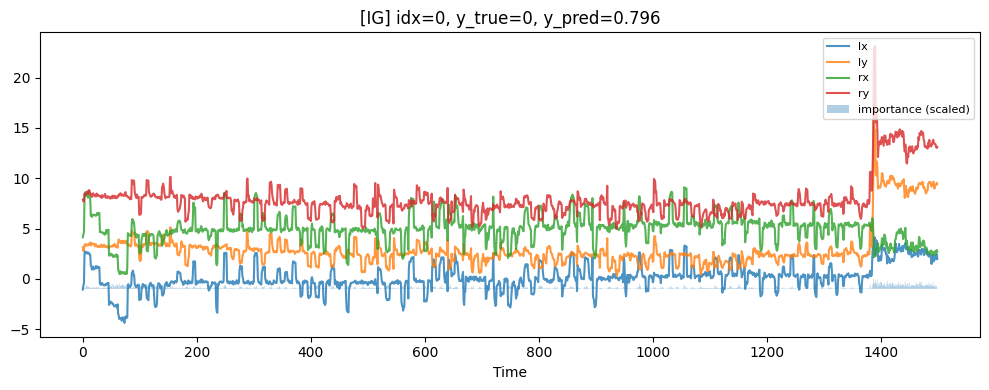

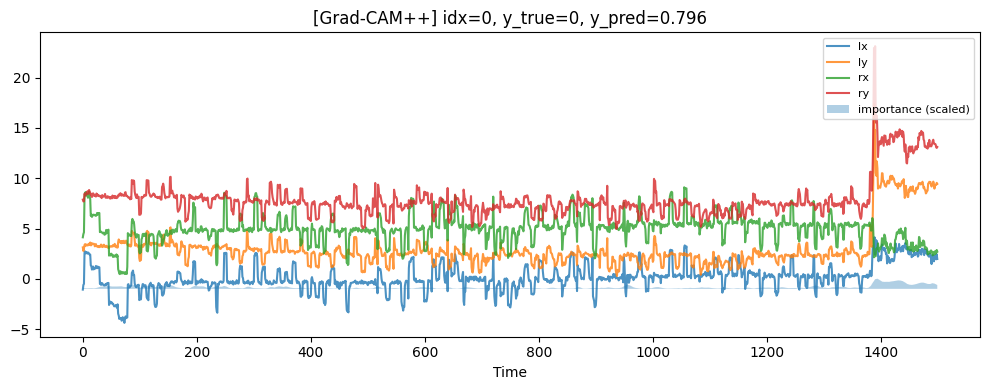

/Users/wukehui/anaconda3/lib/python3.11/site-packages/shap/explainers/_deep/deep_tf.py:94: UserWarning: Your TensorFlow version is newer than 2.4.0 and so graph support has been removed in eager mode and some static graphs may not be supported. See PR #1483 for discussion.
  warnings.warn(
/Users/wukehui/anaconda3/lib/python3.11/site-packages/keras/src/backend.py:452: UserWarning: `tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
  warnings.warn(


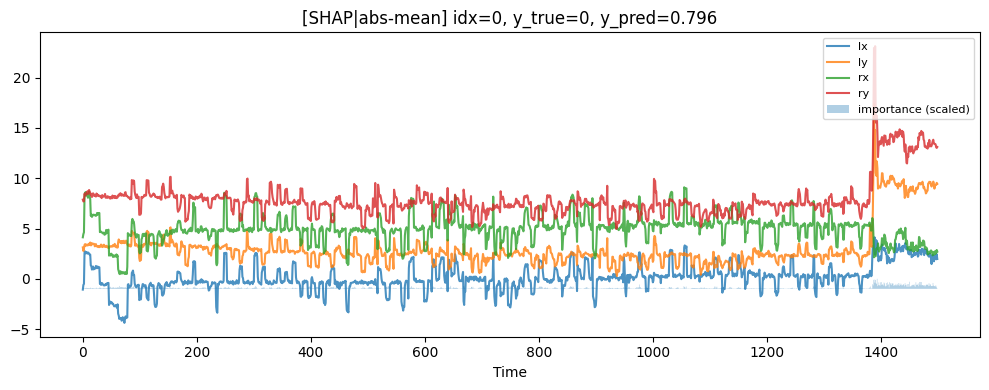

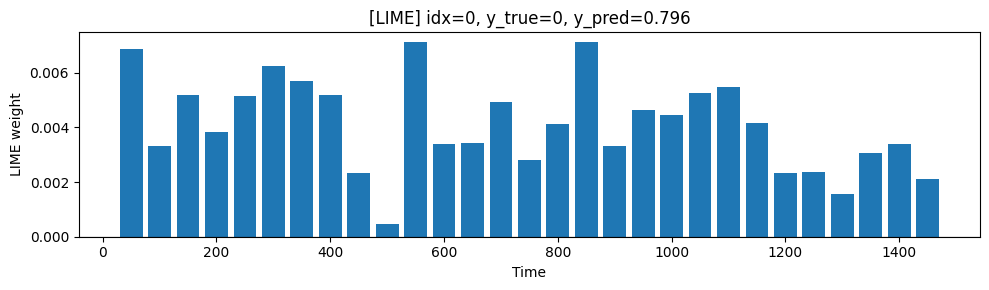

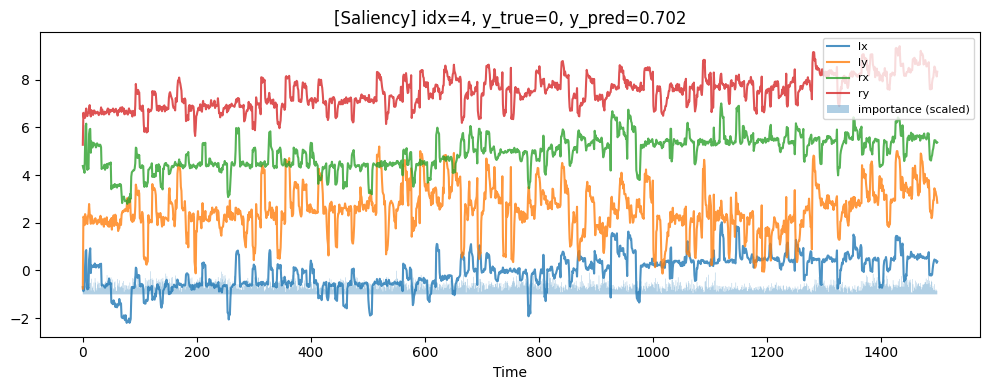

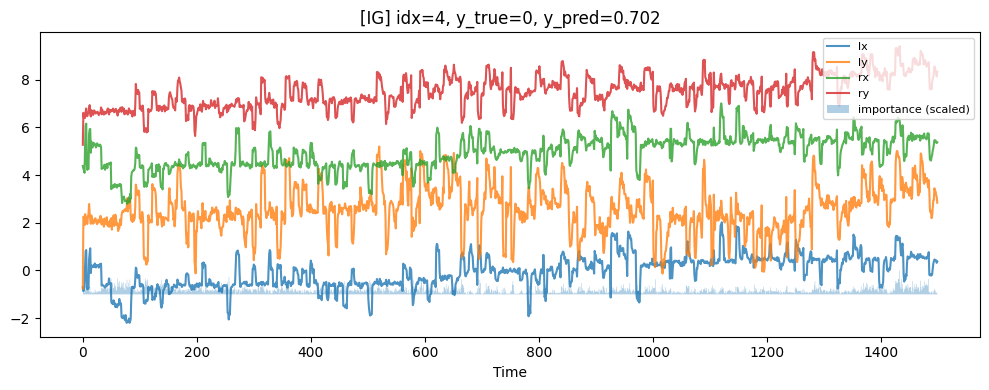

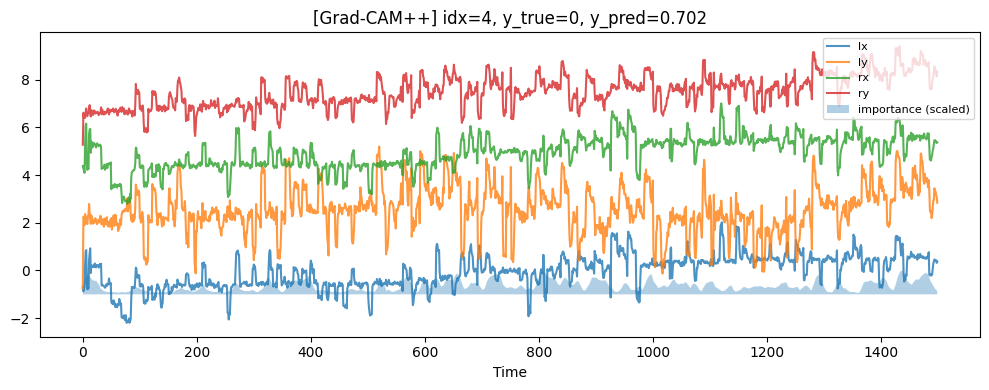

...

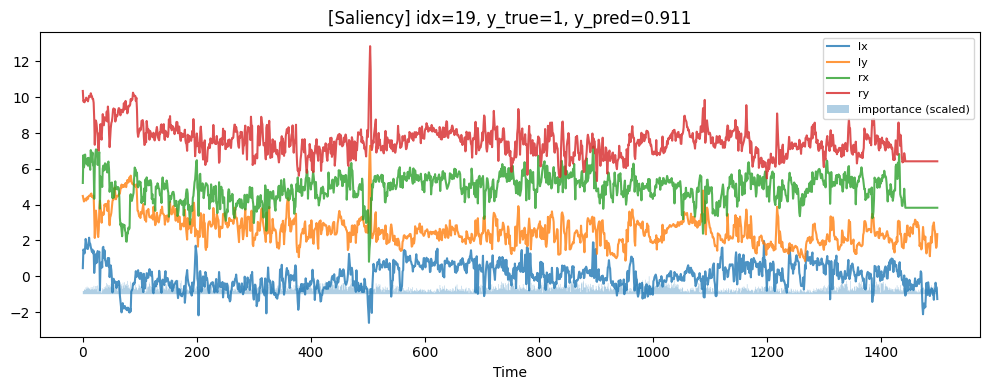

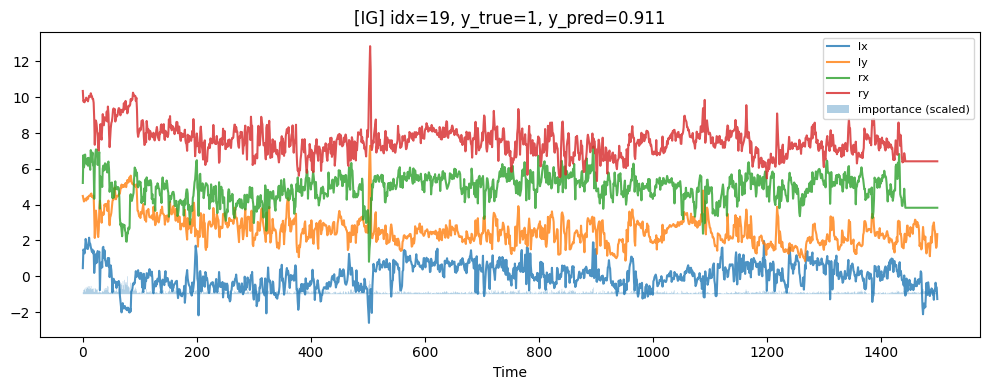

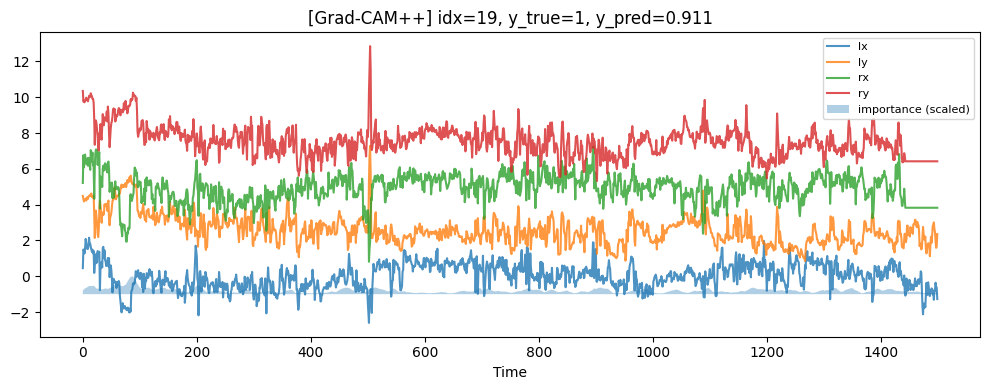

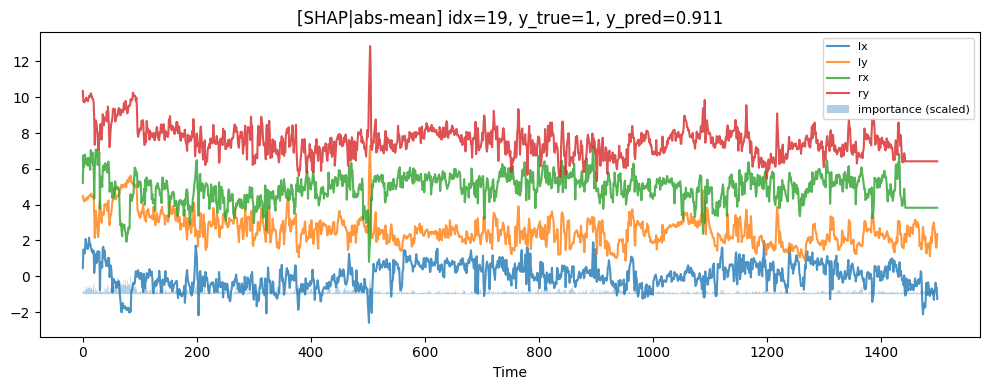

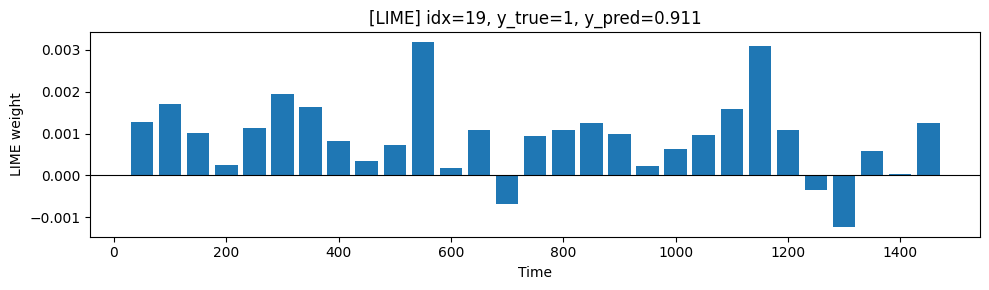

Epoch 1/40
4/4 [==============================] - 4s 777ms/step - loss: 0.7125 - accuracy: 0.4074 - val_loss: 0.6914 - val_accuracy: 0.6500
Epoch 2/40
4/4 [==============================] - 3s 742ms/step - loss: 0.6802 - accuracy: 0.6111 - val_loss: 0.6800 - val_accuracy: 0.5000
Epoch 3/40
4/4 [==============================] - 4s 956ms/step - loss: 0.6680 - accuracy: 0.5926 - val_loss: 0.6716 - val_accuracy: 0.5000
Epoch 4/40
4/4 [==============================] - 3s 765ms/step - loss: 0.6490 - accuracy: 0.6111 - val_loss: 0.6573 - val_accuracy: 0.6500
Epoch 5/40
4/4 [==============================] - 3s 651ms/step - loss: 0.6277 - accuracy: 0.7222 - val_loss: 0.6425 - val_accuracy: 0.7500
Epoch 6/40
4/4 [==============================] - 3s 573ms/step - loss: 0.6140 - accuracy: 0.7593 - val_loss: 0.6334 - val_accuracy: 0.8000
Epoch 7/40
4/4 [==============================] - 3s 597ms/step - loss: 0.5923 - accuracy: 0.7593 - val_loss: 0.6274 - val_accuracy: 0.7500
Epoch 8/40
4/4 [====

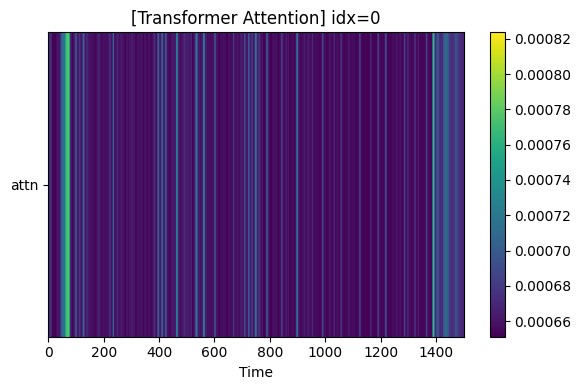

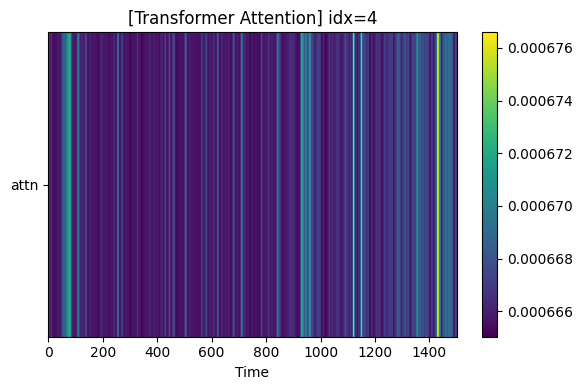

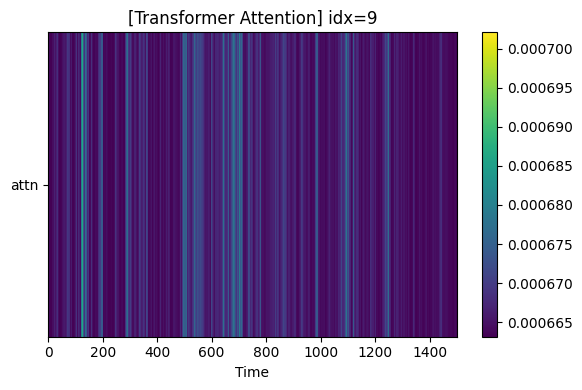

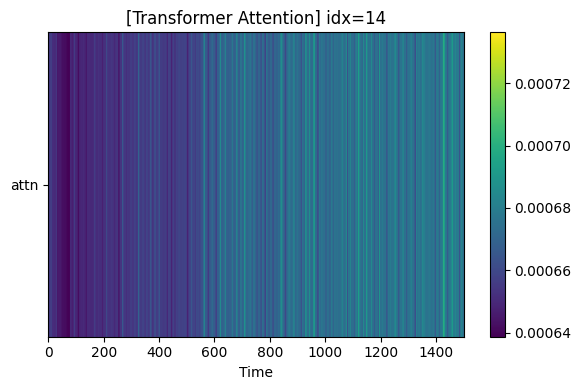

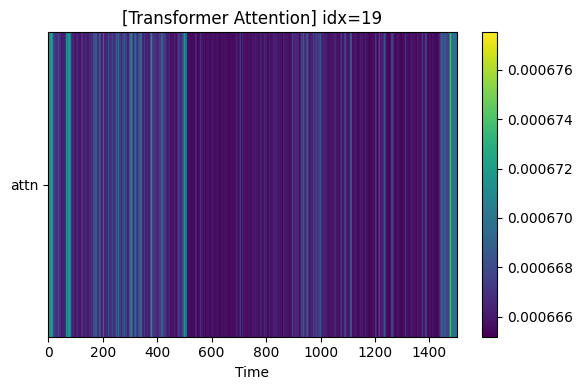

XAI suite finished.


In [40]:
"""
XAI suite for your original 1D-CNN time-series model.
Includes:
  6.2.1 GradCAM++
  6.2.2 SHAP (DeepExplainer fallback to KernelExplainer)
  6.2.3 Integrated Gradients
  6.2.4 Saliency Maps (vanilla gradients)
  6.2.5 LIME for Time Series (window-perturbation version)
  6.2.6 Transformer Attention Weights (optional baseline model)

Requirements:
  - Reuse your existing helpers: load_pair_experiment, split_by_participant_train_val_test,
    _linear_resample, _robust_scale_per_trace, compute_class_weight, get_optimizer
  - TensorFlow/Keras; SHAP optional; LIME 自实现（无第三方依赖）
"""

import os, time, math
from typing import Dict, Tuple, List, Optional
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import Model, Input, layers
import matplotlib.pyplot as plt

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# import (
#   load_pair_experiment, split_by_participant_train_val_test,
#   _linear_resample, _robust_scale_per_trace,
#   compute_class_weight, get_optimizer
# )

# Original CNN baseline (same as existing, just functionalised)
def build_1dcnn_baseline(input_shape) -> Model:
    inp = Input(shape=input_shape)
    x = layers.Conv1D(64, 7, padding='same', activation='relu', name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)

    x = layers.Conv1D(128, 5, padding='same', activation='relu', name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)

    x = layers.Conv1D(128, 3, padding='same', activation='relu', name='conv3')(x)
    x = layers.GlobalAveragePooling1D(name='gap')(x)
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(0.5, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='cnn_baseline')

# Train a CNN and return the model and data segmentation
def train_cnn_for_xai(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15
):
    X, y, files = load_pair_experiment(
        csv_dir, label_pair,
        resample_len=target_len, max_nan_ratio=0.05,
        divide_by_960=True, use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    model = build_1dcnn_baseline((target_len, X.shape[-1]))
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])
    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    class_weight = compute_class_weight(ytr)
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1,
              callbacks=callbacks, class_weight=class_weight)
    return model, (Xtr,ytr,Xva,yva,Xte,yte), files, splits

# 6.2.4 Saliency Maps
def saliency_map(model: Model, x: np.ndarray) -> np.ndarray:
    """
    Vanilla gradient saliency: d y_hat / d x
    x: (T, C) -> returns same shape
    """
    x_tf = tf.convert_to_tensor(x[None, ...])  # add batch
    with tf.GradientTape() as tape:
        tape.watch(x_tf)
        y = model(x_tf, training=False)
    grads = tape.gradient(y, x_tf).numpy()[0]  # (T,C)
    # Take absolute value or normalize for visualization
    return np.abs(grads)

# 6.2.3 Integrated Gradients
def integrated_gradients(model, x: np.ndarray, baseline: Optional[np.ndarray]=None, steps: int = 64) -> np.ndarray:
    """
    Integrated Gradients for 1D time series (vectorized).
    x: (T, C) numpy array
    baseline: (T, C) numpy array; default zeros
    returns: (T, C) numpy array of IG attributions
    """
    if baseline is None:
        baseline = np.zeros_like(x, dtype=np.float32)

    # to tensors
    x_tf = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)          # (1,T,C)
    b_tf = tf.convert_to_tensor(baseline[None, ...], dtype=tf.float32)   # (1,T,C)

    # alphas 1..steps -> shape (steps,1,1) for broadcasting
    alphas = tf.linspace(0.0, 1.0, steps+1)[1:]                          # exclude 0 to avoid baseline dup
    alphas = tf.reshape(alphas, (-1, 1, 1))                               # (steps,1,1)

    # path inputs: baseline + alpha*(x-baseline) -> (steps,T,C)
    path = b_tf + alphas * (x_tf - b_tf)                                  # broadcast (steps,1,1) with (1,T,C)

    with tf.GradientTape() as tape:
        tape.watch(path)
        preds = model(path, training=False)                               # (steps,1)
    grads = tape.gradient(preds, path)                                     # (steps,T,C)

    avg_grads = tf.reduce_mean(grads, axis=0)                              # (T,C)
    ig = (x_tf - b_tf)[0] * avg_grads                                      # (T,C)

    return tf.math.abs(ig).numpy().astype(np.float32)


# 6.2.1 Grad-CAM++ (1D)
def gradcam_plus_plus_1d(model: Model, x: np.ndarray, last_conv_name: str = 'conv3') -> np.ndarray:
    """
    Implements Grad-CAM++ for 1D CNN.
    Returns a 1D heatmap over time (length = T), upsampled to input length if needed.
    """
    # Find the last convolution layer
    conv_layer = model.get_layer(last_conv_name)
    grad_model = Model([model.inputs], [conv_layer.output, model.output])

    x_in = tf.convert_to_tensor(x[None, ...])
    with tf.GradientTape(persistent=True) as tape1:
        with tf.GradientTape(persistent=True) as tape2:
            conv_out, preds = grad_model(x_in, training=False)  # conv_out: (1,T',K)
            y_c = preds[:, 0]  # scalar logit after sigmoid; for the two classifications, just use the output directly
        grads = tape2.gradient(y_c, conv_out)                # ∂y/∂A
    grads2 = tape1.gradient(y_c, conv_out)                   # A redundant layer can be reused, but clarity is preserved here
    del tape2

    # Grad-CAM++ weight calculation (per Chattopadhyay et al. 2018)
    # α_k = sum_i sum_j (∂^2 y / ∂A_ij^2) / (2 * sum_i sum_j (∂^2 y / ∂A_ij^2) + sum_i sum_j A_ij * (∂^3 y / ∂A_ij^3))
    # Use ReLU(grads) and grads's high-order terms for approximation in current affairs
    # A more stable implementation is used here: weight = ReLU(∑_i ∑_t α_k^t * ReLU(grads)_kt)
    conv = conv_out.numpy()[0]      # (T', K)
    grad = grads.numpy()[0]         # (T', K)

    # Calculate pixel-level α^t_k (one-dimensional case)
    w = np.zeros((conv.shape[1],), dtype=np.float32)  # K
    relu_grad = np.maximum(grad, 0.0)

    # Approximate implementation: weight per channel = sum_t ( relu_grad[t,k] * conv[t,k] ) / (sum_t relu_grad[t,k] + eps)
    eps = 1e-8
    for k in range(conv.shape[1]):
        num = np.sum(relu_grad[:, k] * conv[:, k])
        den = np.sum(relu_grad[:, k]) + eps
        w[k] = num / den

    # Linear weighting to get 1D heat map h(t) = ReLU( sum_k w_k * A_k(t) )
    cam = np.dot(conv, w)  # (T',)
    cam = np.maximum(cam, 0.0)

    # Normalisation
    if cam.max() > 0:
        cam = cam / (cam.max() + 1e-8)

    # If T' != input length, linearly interpolate to the input length
    T_in = x.shape[0]
    if cam.shape[0] != T_in:
        src = np.linspace(0, 1, cam.shape[0], dtype=np.float32)
        dst = np.linspace(0, 1, T_in, dtype=np.float32)
        cam = np.interp(dst, src, cam)
    return cam  # (T,)

# 6.2.2 SHAP
def shap_explain(model: Model, X_background: np.ndarray, X_samples: np.ndarray, max_bg: int = 100):
    """
    Return SHAP values, sorted by (n_samples, T, C)
    Prioritize DeepExplainer (requires TFGraph support); fallback to KernelExplainer if failure occurs
    """
    try:
        import shap
        bg = X_background[:max_bg]
        try:
            explainer = shap.DeepExplainer(model, bg)
            sv = explainer.shap_values(X_samples)
            # DeepExplainer for binary gives list of arrays; take sv[0]
            sv = sv[0] if isinstance(sv, list) else sv
            return sv  # (n, T, C)
        except Exception:
            explainer = shap.KernelExplainer(lambda z: model.predict(z, verbose=0), bg)
            sv = explainer.shap_values(X_samples, nsamples=200)
            sv = sv[0] if isinstance(sv, list) else sv
            return sv
    except ImportError:
        print("[WARN] shap not installed; skip SHAP.")
        return None

# 6.2.5 LIME for Time Series (Window Perturbation)
def lime_timeseries_explain(
    model: Model,
    x: np.ndarray,                 # (T,C)
    window: int = 50,
    stride: int = 25,
    n_samples: int = 500,
    fill: float = 0.0
) -> Tuple[np.ndarray, np.ndarray]:
    """
    Simple LIME: Divide the timeline into overlapping windows, randomly close some windows each time with a constant fill, observe the output changes, 
    and use linear regression to fit the window importance (positive = improve prediction, negative = reduce prediction).
    Returns: (win_centers, weights), length equal to the number of windows.
    """
    T, C = x.shape
    # Constructing a window list
    wins = []
    t0 = 0
    while t0 < T:
        t1 = min(t0 + window, T)
        wins.append((t0, t1))
        if t1 == T:
            break
        t0 += stride
    W = len(wins)

    # Reference output
    y0 = float(model.predict(x[None, ...], verbose=0).ravel()[0])

    # Sampling occlusion matrix Z: (n_samples, W), Bernoulli chooses whether to close the window
    rng = np.random.default_rng(SEED)
    Z = rng.integers(0, 2, size=(n_samples, W), endpoint=True)  # 0/1
    y = np.zeros((n_samples,), dtype=np.float32)

    x_fill = np.full_like(x, fill, dtype=np.float32)

    for i in range(n_samples):
        xi = x.copy()
        for wj, flag in enumerate(Z[i]):
            if flag == 1:
                a, b = wins[wj]
                xi[a:b, :] = x_fill[a:b, :]
        y[i] = float(model.predict(xi[None, ...], verbose=0).ravel()[0])

    # Linear regression weights: Approximately y ≈ β0 + Z @ β
    # Add a small regularization to avoid pathology
    lam = 1e-3
    A = Z.astype(np.float32)
    b = (y - y0).astype(np.float32)
    # Solve (A^T A + λI)β = A^T b
    AtA = A.T @ A + lam * np.eye(W, dtype=np.float32)
    Atb = A.T @ b
    beta = np.linalg.solve(AtA, Atb)  # (W,)

    # The center of the window is used for drawing
    centers = np.array([ (a+b)//2 for (a,b) in wins ], dtype=int)
    return centers, beta

# 6.2.6 Transformer Baseline + Attention Visualisation
def build_tiny_transformer(input_shape, n_heads=4, d_model=64, d_ff=128, n_blocks=2, dropout=0.1):
    """
    A minimalist Transformer encoder classifier (temporal attention), mainly used to extract attention weights.
    """
    T, C = input_shape
    inp = Input(shape=(T, C))
    # Linear projection to d_model
    x = layers.Dense(d_model)(inp)

    attn_weights_all = []  # Collecting intermediate attention (for visualisation)

    for b in range(n_blocks):
        # MultiHeadAttention returns (out, attn_scores) and requires a custom layer to get the weights; Keras does not return by default
        # Here we use a custom packaging layer
        mha = layers.MultiHeadAttention(num_heads=n_heads, key_dim=d_model//n_heads, output_shape=d_model)
        attn_out = mha(x, x, return_attention_scores=True)
        x_attn, attn_scores = attn_out  # (batch,T,d_model), (batch,num_heads,T,T)
        attn_weights_all.append(attn_scores)
        x = layers.Add()([x, layers.Dropout(dropout)(x_attn)])
        x = layers.LayerNormalization()(x)
        # FFN
        f = layers.Dense(d_ff, activation='relu')(x)
        f = layers.Dense(d_model)(f)
        x = layers.Add()([x, layers.Dropout(dropout)(f)])
        x = layers.LayerNormalization()(x)

    x = layers.GlobalAveragePooling1D()(x)
    x = layers.Dense(64, activation='relu')(x)
    out = layers.Dense(1, activation='sigmoid')(x)
    model = Model(inp, out)
    # Additionally construct a function that returns attention
    attn_model = Model(inp, attn_weights_all)
    return model, attn_model


# Visualisation Tools
def plot_timeseries_with_heat(
    x: np.ndarray,                  # (T,C)
    heat: np.ndarray,               # (T,) or (T,C) -> will be projected to (T,)
    title: str = "",
    channel_names: List[str] = ('lx','ly','rx','ry')
):
    plt.figure(figsize=(10,4))
    T, C = x.shape
    # Superimpose the curves of each channel (simple visualisation)
    shift = 0.0
    for c in range(C):
        plt.plot(x[:, c] + shift, alpha=0.8, label=channel_names[c] if c < len(channel_names) else f'ch{c}')
        shift += 2.5  # Vertical stagger to avoid overlap
    # Thermal projection
    if heat.ndim == 2:
        heat_1d = np.abs(heat).mean(axis=1)
    else:
        heat_1d = heat
    heat_scaled = heat_1d / (np.max(heat_1d) + 1e-8)
    plt.fill_between(np.arange(T), -1.0, -1.0 + heat_scaled, alpha=0.35, step='pre', label='importance (scaled)')
    plt.title(title)
    plt.xlabel("Time")
    plt.legend(loc='upper right', fontsize=8)
    plt.tight_layout()
    plt.show()

def plot_bar_over_windows(centers: np.ndarray, weights: np.ndarray, title: str):
    plt.figure(figsize=(10,3))
    plt.bar(centers, weights, width=max(1, int(0.8*(centers[1]-centers[0]))) if len(centers)>1 else 5)
    plt.axhline(0, color='k', linewidth=0.8)
    plt.title(title); plt.xlabel("Time"); plt.ylabel("LIME weight")
    plt.tight_layout()
    plt.show()

def plot_attn_matrix(attn, head: int = None, title: str = "Attention"):
    """
    Robust attention visualisation:
      - 1D (T,)  : plot as a heat strip   OR line
      - 2D (T,T) : heatmap
      - 3D (H,T,T): choose head or mean over heads -> (T,T)
      - 2.5D variants like (H,T) : choose head or mean -> (T,)
    """
    A = np.array(attn)
    plt.figure(figsize=(6, 4))

    # 3D: (H, T, T) or (H, T)
    if A.ndim == 3:
        # decide if it's (H,T,T) or (H,T)
        if A.shape[1] == A.shape[2]:
            # (H,T,T)
            if head is not None:
                Ashow = A[head]
            else:
                Ashow = A.mean(axis=0)
            plt.imshow(Ashow, aspect='auto', origin='lower')
            plt.colorbar()
            plt.xlabel("Key time"); plt.ylabel("Query time")
        else:
            # (H,T) -> reduce to (T,)
            Avec = A[head] if head is not None else A.mean(axis=0)
            plt.imshow(Avec[None, :], aspect='auto', origin='lower')
            plt.yticks([0], ['attn'])
            plt.xlabel("Time"); plt.colorbar()

    # 2D: (T,T) heatmap
    elif A.ndim == 2:
        if A.shape[0] == A.shape[1]:
            plt.imshow(A, aspect='auto', origin='lower')
            plt.colorbar()
            plt.xlabel("Key time"); plt.ylabel("Query time")
        else:
            # (T, H) or (H, T) weird case -> collapse to (T,)
            Avec = A.mean(axis=1) if A.shape[0] == max(A.shape) else A.mean(axis=0)
            plt.imshow(Avec[None, :], aspect='auto', origin='lower')
            plt.yticks([0], ['attn'])
            plt.xlabel("Time"); plt.colorbar()

    # 1D: (T,) heat strip
    elif A.ndim == 1:
        # Display with heat strips
        plt.imshow(A[None, :], aspect='auto', origin='lower')
        plt.yticks([0], ['attn'])
        plt.xlabel("Time"); plt.colorbar()
        # Overlay polylines:
        # plt.clf(); plt.plot(A); plt.xlabel("Time"); plt.ylabel("Attention")

    else:
        raise ValueError(f"Unsupported attention shape: {A.shape}")

    plt.title(title)
    plt.tight_layout()
    plt.show()


# One-click XAI experiment entry
def run_xai_suite(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    sample_source: str = 'val',  # 'val' or 'test'
    n_samples: int = 5,
    run_transformer: bool = True
):
    # 1) Train CNN
    model, (Xtr,ytr,Xva,yva,Xte,yte), files, splits = train_cnn_for_xai(
        csv_dir, label_pair, target_len=target_len
    )
    if sample_source == 'val':
        Xs, ys = Xva, yva
    else:
        Xs, ys = Xte, yte

    # 2) Sampling several samples for visualisation
    idxs = np.linspace(0, len(ys)-1, num=min(n_samples, len(ys)), dtype=int)

    # 3) Make a SHAP background
    Xbg = Xtr[: min(100, len(Xtr))]

    for i in idxs:
        x = Xs[i]
        y_true = ys[i]
        y_pred = float(model.predict(x[None,...], verbose=0).ravel()[0])

        # 3.1 Saliency
        sal = saliency_map(model, x)
        plot_timeseries_with_heat(x, sal.mean(axis=1), title=f"[Saliency] idx={i}, y_true={y_true}, y_pred={y_pred:.3f}")

        # 3.2 Integrated Gradients
        ig = integrated_gradients(model, x, baseline=np.zeros_like(x), steps=64)
        plot_timeseries_with_heat(x, ig.mean(axis=1), title=f"[IG] idx={i}, y_true={y_true}, y_pred={y_pred:.3f}")

        # 3.3 Grad-CAM++
        campp = gradcam_plus_plus_1d(model, x, last_conv_name='conv3')
        plot_timeseries_with_heat(x, campp, title=f"[Grad-CAM++] idx={i}, y_true={y_true}, y_pred={y_pred:.3f}")

        # 3.4 SHAP
        sv = shap_explain(model, Xbg, x[None, ...])
        if sv is not None:
            sv_t = np.abs(sv[0]).mean(axis=1)  # (T,)
            plot_timeseries_with_heat(x, sv_t, title=f"[SHAP|abs-mean] idx={i}, y_true={y_true}, y_pred={y_pred:.3f}")

        # 3.5 LIME (window)
        centers, beta = lime_timeseries_explain(model, x, window=100, stride=50, n_samples=600, fill=0.0)
        plot_bar_over_windows(centers, beta, title=f"[LIME] idx={i}, y_true={y_true}, y_pred={y_pred:.3f}")

    # 4) Transformer baseline + attention
    if run_transformer:
        T, C = Xtr.shape[1], Xtr.shape[2]
        tmodel, attn_model = build_tiny_transformer((T, C), n_heads=4, d_model=64, d_ff=128, n_blocks=1, dropout=0.1)
        tmodel.compile(optimizer=get_optimizer(3e-4), loss='binary_crossentropy', metrics=['accuracy'])
        tmodel.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=40, batch_size=16, verbose=1,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=8, restore_best_weights=True)])
        # Visualising attention on the same sample
        for i in idxs:
            x = Xs[i]
            attn_list = attn_model.predict(x[None,...], verbose=0)  # list of (1,heads,T,T)
            # Take the first layer of attention and average across all heads
            A = attn_list[0][0]   # (heads,T,T)
            A_mean = A.mean(axis=0)  # (T,T)
            plot_attn_matrix(A_mean, title=f"[Transformer Attention] idx={i}")

    print("XAI suite finished.")


# usage
if __name__ == "__main__":
    DATA_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"  # or repeats
    PAIR = (0, 2)  # or (1, 3)
    run_xai_suite(
        csv_dir=DATA_DIR,
        label_pair=PAIR,
        target_len=1500,
        sample_source='val',
        n_samples=5,
        run_transformer=True
    )


feature construction for cnn

In [34]:
# Feature construction (time-series + global stats)
import numpy as np
from typing import Tuple

def _moving_average(x: np.ndarray, k: int = 5) -> np.ndarray:
    """Simple sliding average, with the boundaries copied using padding, suitable for smoothing eye movement trajectories in small windows."""
    if k <= 1: 
        return x
    # One-dimensional convolution with same-padding
    pad = k // 2
    xp = np.pad(x, (pad, pad), mode='edge')
    kernel = np.ones(k, dtype=np.float32) / float(k)
    return np.convolve(xp, kernel, mode='valid')

def _diff(x: np.ndarray) -> np.ndarray:
    """The latter item minus the former item, with the leading zero added to ensure the same length."""
    d = np.diff(x, prepend=x[:1])
    return d

def _range(x: np.ndarray) -> float:
    return float(np.max(x) - np.min(x))

def augment_dynamic_channels(X: np.ndarray, smooth_k: int = 5) -> np.ndarray:
    """
    Input: X (N, T, 4) [abs_lx, abs_ly, abs_rx, abs_ry] (robustly scaled)
    Output: X_aug (N, T, C_aug)
      Additional channels:
        a) Velocity:  Left eye vel_L = sqrt((d lx)^2 + (d ly)^2), right eye vel_R similarly
        b) Speed:     For each channel ch ∈ {lx,ly,rx,ry}, first smooth and then do diff to get 4 speed
        c) L-R diff:  |lx - rx|, |ly - ry|, and the modulus of the two-dimensional difference |L-R|_mag
      Final number of channels: original 4 + 2(vel) + 4(speed) + 3(LR diff) = 13
    """
    N, T, C = X.shape
    assert C == 4, "expect 4 channels: [abs_lx, abs_ly, abs_rx, abs_ry]"
    out = []

    for i in range(N):
        seq = X[i]              # (T,4)
        lx, ly, rx, ry = seq[:,0], seq[:,1], seq[:,2], seq[:,3]

        # a) velocity magnitude per eye
        dlx, dly = _diff(lx), _diff(ly)
        drx, dry = _diff(rx), _diff(ry)
        vel_L = np.sqrt(dlx**2 + dly**2)
        vel_R = np.sqrt(drx**2 + dry**2)

        # b) speed: diff(smooth(x)) for each raw channel
        slx = _moving_average(lx, smooth_k)
        sly = _moving_average(ly, smooth_k)
        srx = _moving_average(rx, smooth_k)
        sry = _moving_average(ry, smooth_k)
        sp_lx = _diff(slx)
        sp_ly = _diff(sly)
        sp_rx = _diff(srx)
        sp_ry = _diff(sry)

        # c) left-right difference (per-axis + magnitude)
        d_x = np.abs(lx - rx)
        d_y = np.abs(ly - ry)
        d_mag = np.sqrt(d_x**2 + d_y**2)

        x_aug = np.stack([
            lx, ly, rx, ry,
            vel_L, vel_R,
            sp_lx, sp_ly, sp_rx, sp_ry,
            d_x, d_y, d_mag
        ], axis=1)  # (T, 13)
        out.append(x_aug.astype(np.float32))

    return np.asarray(out, dtype=np.float32)  # (N, T, 13)

def compute_global_stats(X_aug: np.ndarray) -> np.ndarray:
    """
    Compute statistical summaries for each channel: mean, std, range -> (N, C_aug*3)
    """
    N, T, C = X_aug.shape
    means = X_aug.mean(axis=1)                    # (N, C)
    stds  = X_aug.std(axis=1)                     # (N, C)
    rngs  = (X_aug.max(axis=1) - X_aug.min(axis=1))  # (N, C)
    F = np.concatenate([means, stds, rngs], axis=1)  # (N, 3*C)
    # Simple standardisation (column standardisation)
    F = (F - F.mean(axis=0, keepdims=True)) / (F.std(axis=0, keepdims=True) + 1e-8)
    return F.astype(np.float32)


In [35]:
# Hybrid head on top of CNN (fusion with global stats)
from tensorflow.keras import layers, Model, Input

def build_1dcnn_backbone(input_shape):
    """A CNN backbone equivalent to baseline (excluding the final classification head); outputs GAP features."""
    inp = Input(shape=input_shape)
    x = layers.Conv1D(64, 7, padding='same', activation='relu', name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)

    x = layers.Conv1D(128, 5, padding='same', activation='relu', name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)

    x = layers.Conv1D(128, 3, padding='same', activation='relu', name='conv3')(x)
    x = layers.GlobalAveragePooling1D(name='gap')(x)
    return Model(inp, x, name='cnn_backbone')

def build_cnn_hybrid_model(ts_input_shape, n_stats: int, dropout=0.5) -> Model:
    """
    Input 1: Augmented time series (T, C_aug) -> CNN -> GAP
    Input 2: Global statistics (n_stats,) -> Small MLP
    Fusion: Concat -> Dense -> Dropout -> Sigmoid
    """
    # Temporal branch (CNN backbone)
    backbone = build_1dcnn_backbone(ts_input_shape)
    ts_inp = backbone.input
    ts_feat = backbone.output

    # Statistics branch (small MLP)
    st_inp = Input(shape=(n_stats,), name='stat_in')
    s = layers.Dense(64, activation='relu', name='stat_fc1')(st_inp)
    s = layers.Dropout(dropout, name='stat_drop')(s)

    # Fusion
    z = layers.Concatenate(name='fusion')([ts_feat, s])
    z = layers.Dense(64, activation='relu', name='fc')(z)
    z = layers.Dropout(dropout, name='drop')(z)
    out = layers.Dense(1, activation='sigmoid', name='logit')(z)
    return Model([ts_inp, st_inp], out, name='cnn_hybrid')


In [36]:
# Runner with feature construction (drop-in)
from sklearn.metrics import classification_report

def run_experiment_with_features(
    csv_dir: str,
    label_pair: Tuple[int, int],
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    smooth_k: int = 5
):
    # Reuse existing loading & preprocessing
    X, y, files = load_pair_experiment(
        csv_dir, label_pair, resample_len=target_len,
        max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True
    )
    # Feature enhancement (cutting first and then calculating can reduce useless calculations)
    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )

    # Structural time series enhancement and statistical features
    Xtr_aug = augment_dynamic_channels(Xtr, smooth_k=smooth_k)
    Xva_aug = augment_dynamic_channels(Xva, smooth_k=smooth_k)
    Xte_aug = augment_dynamic_channels(Xte, smooth_k=smooth_k)

    Ftr = compute_global_stats(Xtr_aug)   # (N, 3*C_aug)
    Fva = compute_global_stats(Xva_aug)
    Fte = compute_global_stats(Xte_aug)

    # Model
    model = build_cnn_hybrid_model(
        ts_input_shape=(target_len, Xtr_aug.shape[-1]),
        n_stats=Ftr.shape[1],
        dropout=0.5
    )
    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])

    callbacks = [
        tf.keras.callbacks.EarlyStopping(
            monitor='val_loss', patience=early_patience, restore_best_weights=True
        ),
        tf.keras.callbacks.ReduceLROnPlateau(
            monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1
        ),
        tf.keras.callbacks.CSVLogger(f'train_log_feat_{label_pair[0]}_{label_pair[1]}.csv', append=False)
    ]

    class_weight = compute_class_weight(ytr)

    t0 = time.perf_counter()
    history = model.fit(
        [Xtr_aug, Ftr], ytr,
        validation_data=([Xva_aug, Fva], yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=1,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()
    print(f"[Time] Pair {label_pair} (+features): training wall-clock {t1 - t0:.2f}s")

    yprob = model.predict([Xte_aug, Fte], batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    report = classification_report(yte, ypred, digits=4)
    print(f"\n[TEST] Pair {label_pair} (+features) classification report:\n{report}")

    return {
        'label_pair': label_pair,
        'history': history.history,
        'test_report': report,
        'model': model,
        'id_splits': id_splits,
        'C_aug': Xtr_aug.shape[-1]
    }


In [30]:
if __name__ == "__main__":
    csv_path = "/Users/wukehui/Desktop/data science project/project/data/first_trials"

    # baseline (remain unchanged)
    res_02 = run_experiment(csv_path, (0, 2), target_len=1500)
    res_13 = run_experiment(csv_path, (1, 3), target_len=1500)

    # Feature-added versions (A/B comparison)
    feat_02 = run_experiment_with_features(csv_path, (0, 2), target_len=1500, smooth_k=5)
    feat_13 = run_experiment_with_features(csv_path, (1, 3), target_len=1500, smooth_k=5)


[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Split] train=54, val=20, test=17
Epoch 1/80
4/4 [==============================] - 0s 52ms/step - loss: 0.7187 - accuracy: 0.5185 - val_loss: 0.6905 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 38ms/step - loss: 0.6408 - accuracy: 0.5741 - val_loss: 0.6889 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 33ms/step - loss: 0.5997 - accuracy: 0.6481 - val_loss: 0.6872 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 0s 33ms/step - loss: 0.5313 - accuracy: 0.7963 - val_loss: 0.6854 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 0s 33ms/step - loss: 0.5261 - accuracy: 0.6852 - val_loss: 0.6823 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 0s 33ms/step - loss: 0.6148 - accuracy: 0.6111 - va

3/4 [=====================>........] - ETA: 0s - loss: 0.5088 - accuracy: 0.7500
Epoch 20: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.
4/4 [==============================] - 0s 31ms/step - loss: 0.5091 - accuracy: 0.7636 - val_loss: 0.6887 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 21/80
4/4 [==============================] - 0s 32ms/step - loss: 0.5035 - accuracy: 0.8000 - val_loss: 0.6894 - val_accuracy: 0.5000 - lr: 1.5000e-04
Epoch 22/80
4/4 [==============================] - 0s 35ms/step - loss: 0.4576 - accuracy: 0.8909 - val_loss: 0.6901 - val_accuracy: 0.5000 - lr: 1.5000e-04
Epoch 23/80
4/4 [==============================] - 0s 31ms/step - loss: 0.4815 - accuracy: 0.8182 - val_loss: 0.6908 - val_accuracy: 0.5000 - lr: 1.5000e-04
Epoch 24/80
4/4 [==============================] - 0s 33ms/step - loss: 0.4575 - accuracy: 0.8182 - val_loss: 0.6914 - val_accuracy: 0.5000 - lr: 1.5000e-04
Epoch 25/80
4/4 [==============================] - 0s 32ms/step - los

[Time] Pair (0, 2) (+features): training wall-clock 5.31s
2/2 [==============================] - 0s 2ms/step

[TEST] Pair (0, 2) (+features) classification report:
              precision    recall  f1-score   support

           0     0.8333    0.7143    0.7692         7
           1     0.8182    0.9000    0.8571        10

    accuracy                         0.8235        17
   macro avg     0.8258    0.8071    0.8132        17
weighted avg     0.8244    0.8235    0.8209        17

[load_pair_experiment] Dir=first_trials Labels=(1, 3), files=96, shape=(96, 1500, 4)
Epoch 1/80
4/4 [==============================] - 0s 59ms/step - loss: 0.8866 - accuracy: 0.4909 - val_loss: 0.6769 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 45ms/step - loss: 0.8480 - accuracy: 0.5455 - val_loss: 0.6791 - val_accuracy: 0.5500 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 34ms/step - loss: 0.6849 - accuracy: 0.6545 - val_loss: 0.6

Feature Importance in Non/Antisaccadic Areas for cnn

In [31]:
# Saccade detection (velocity-threshold + min duration)
import numpy as np
import pandas as pd
from typing import List, Tuple, Dict, Optional

def _smooth_1d(x: np.ndarray, k: int = 5) -> np.ndarray:
    if k <= 1: return x
    pad = k // 2
    xp = np.pad(x, (pad, pad), mode='edge')
    ker = np.ones(k, dtype=np.float32) / float(k)
    return np.convolve(xp, ker, mode='valid')

def _diff1(x: np.ndarray) -> np.ndarray:
    return np.diff(x, prepend=x[:1])

def compute_eye_velocities(seq: np.ndarray, smooth_k: int = 5) -> Dict[str, np.ndarray]:
    """
    seq: (T,4) -> lx,ly,rx,ry
    Return:
      vel_L, vel_R: individual eye displacement velocity model
      vel_binoc: binocular center velocity (average left and right eye coordinates and then calculate the difference)
    """
    lx, ly, rx, ry = seq[:,0], seq[:,1], seq[:,2], seq[:,3]
    if smooth_k > 1:
        lx, ly, rx, ry = _smooth_1d(lx, smooth_k), _smooth_1d(ly, smooth_k), _smooth_1d(rx, smooth_k), _smooth_1d(ry, smooth_k)
    dlx, dly = _diff1(lx), _diff1(ly)
    drx, dry = _diff1(rx), _diff1(ry)
    vel_L = np.sqrt(dlx**2 + dly**2)
    vel_R = np.sqrt(drx**2 + dry**2)
    cx, cy = 0.5*(lx+rx), 0.5*(ly+ry)
    dcx, dcy = _diff1(cx), _diff1(cy)
    vel_binoc = np.sqrt(dcx**2 + dcy**2)
    return {'vel_L': vel_L.astype(np.float32),
            'vel_R': vel_R.astype(np.float32),
            'vel_binoc': vel_binoc.astype(np.float32)}

def detect_saccades_from_velocity(vel: np.ndarray, thr: float, min_len: int = 8) -> Tuple[np.ndarray, List[Tuple[int,int]]]:
    """
    Detect saccade segments based on the threshold + minimum length rule of the velocity sequence vel (T,).
      thr: Speed threshold (based on your normalized/resampling dimensions)
      min_len: The minimum number of samples (~duration) that must be continuously greater than the threshold. It is recommended to adjust the parameter between 6 and 12.
    Return:
      sacc_mask: (T,) bool，True indicates that the moment is within the saccade
      segments: list of (start, end) index (including endpoint)
    """
    T = vel.shape[0]
    above = vel >= thr
    segs = []
    i = 0
    while i < T:
        if above[i]:
            j = i
            while j+1 < T and above[j+1]:
                j += 1
            if (j - i + 1) >= min_len:
                segs.append((i, j))
            i = j + 1
        else:
            i += 1
    sacc_mask = np.zeros(T, dtype=bool)
    for s, e in segs:
        sacc_mask[s:e+1] = True
    return sacc_mask, segs


In [32]:
# Per-trial saccade summary features
def _segment_amplitude(seq_xy: np.ndarray, seg: Tuple[int,int]) -> float:
    """Amplitude: Euclidean distance between the start and end points of the segment (using the binocular center)."""
    s, e = seg
    p0 = seq_xy[s]; p1 = seq_xy[e]
    return float(np.linalg.norm(p1 - p0))

def extract_saccade_summaries(seq: np.ndarray,
                              vel: np.ndarray,
                              sacc_segments: List[Tuple[int,int]]) -> Dict[str, float]:
    """
    seq: (T,4)  -> Calculate amplitude using binocular (average left and right)
    vel: (T,)   -> For peak speed
    """
    if len(sacc_segments) == 0:
        return {
            'n_sacc': 0, 'mean_dur': 0.0, 'median_dur': 0.0,
            'mean_amp': 0.0, 'median_amp': 0.0,
            'mean_peakv': 0.0, 'median_peakv': 0.0,
            'mean_isi': 0.0, 'median_isi': 0.0,
        }
    lx, ly, rx, ry = seq[:,0], seq[:,1], seq[:,2], seq[:,3]
    cx, cy = 0.5*(lx+rx), 0.5*(ly+ry)
    xy = np.stack([cx, cy], axis=1)

    durs, amps, pks = [], [], []
    for (s, e) in sacc_segments:
        durs.append(e - s + 1)
        amps.append(_segment_amplitude(xy, (s, e)))
        pks.append(float(np.max(vel[s:e+1])))

    # inter-saccade interval (ISI)
    seg_starts = [s for s,_ in sacc_segments]
    seg_starts = np.array(sorted(seg_starts), dtype=int)
    isi = np.diff(seg_starts) if len(seg_starts) > 1 else np.array([], dtype=int)

    def _m(x): return float(np.mean(x)) if len(x)>0 else 0.0
    def _med(x): return float(np.median(x)) if len(x)>0 else 0.0

    return {
        'n_sacc': int(len(sacc_segments)),
        'mean_dur': _m(durs), 'median_dur': _med(durs),
        'mean_amp': _m(amps), 'median_amp': _med(amps),
        'mean_peakv': _m(pks), 'median_peakv': _med(pks),
        'mean_isi': _m(isi), 'median_isi': _med(isi),
    }


In [33]:
# End-to-end saccade analysis for a folder
from scipy.stats import mannwhitneyu

def run_saccade_analysis(
    csv_dir: str,
    label_pair: Tuple[int,int],
    target_len: int = 1500,
    vel_thr: float = 0.03,   # ← The threshold needs to be fine-tuned according to the data: 0.02~0.06 is common
    min_len: int = 8,
    smooth_k: int = 5
) -> pd.DataFrame:
    """
    Read the directory -> Preprocess (reuse your load_pair_experiment) -> Perform saccade detection on each trial -> Output trial-level feature table
    Note: Duration is expressed in "number of samples"; if you know the sampling frequency fs, you can convert the duration/ISI by multiplying it by (1000/fs) to milliseconds.
    """
    X, y, files = load_pair_experiment(
        csv_dir, label_pair, resample_len=target_len,
        max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True
    )
    rows = []
    for i in range(len(files)):
        seq = X[i]  # (T,4)
        vels = compute_eye_velocities(seq, smooth_k=smooth_k)
        # Here we use binocular velocity as the threshold (can also be changed to max(vel_L, vel_R))
        s_mask, segs = detect_saccades_from_velocity(vels['vel_binoc'], thr=vel_thr, min_len=min_len)
        summ = extract_saccade_summaries(seq, vels['vel_binoc'], segs)
        rows.append({
            'file': files[i], 'label': int(y[i]),
            **summ,
            'sacc_time_ratio': float(np.mean(s_mask))  # Proportion of time in the saccade
        })
    df = pd.DataFrame(rows)
    print(f"[Saccade] trials={len(df)}, columns={list(df.columns)}")

    # Simple significance test (between two labels)
    for col in ['n_sacc','mean_amp','mean_peakv','mean_dur','sacc_time_ratio']:
        g0 = df[df['label']==0][col].values
        g1 = df[df['label']==1][col].values
        if len(g0)>0 and len(g1)>0:
            stat, p = mannwhitneyu(g0, g1, alternative='two-sided')
            print(f"[U-test] {col}: label0 vs label1 -> U={stat:.1f}, p={p:.4g}, "
                  f"mean0={np.mean(g0):.3f}, mean1={np.mean(g1):.3f}")
    return df


In [11]:
# 1) Saccade detection (velocity + min duration)
def detect_saccades_mask(x: np.ndarray,
                         vel_thr: float = 0.8,
                         min_frames: int = 8,
                         smooth_win: int = 7) -> np.ndarray:
    """
    x: (T,4) -> [lx,ly,rx,ry] (Linearly resampled & normalized & robustly scaled)
    Returns: sacc_mask (T,) bool, indicating whether the moment is within a saccade
    Speed: Use binocular average speed, first do simple smoothing on the position, then difference
    """
    T = x.shape[0]
    # Simple smooth
    if smooth_win > 1:
        import scipy.signal as ss
        xf = np.stack([ss.medfilt(x[:,c], kernel_size=smooth_win) for c in range(x.shape[1])], axis=1)
    else:
        xf = x

    # binocular pos & velocity
    L = xf[:, :2]  # (lx,ly)
    R = xf[:, 2:]  # (rx,ry)
    P = 0.5*(L+R)  # binocular
    V = np.sqrt(np.sum(np.diff(P, axis=0, prepend=P[[0],:])**2, axis=1))  # (T,)

    # Initial threshold binarization
    mask = (V >= vel_thr)

    # Merge short segments: ensure each consecutive segment >= min_frames
    sacc_mask = np.zeros(T, dtype=bool)
    i = 0
    while i < T:
        if not mask[i]:
            i += 1
            continue
        j = i
        while j < T and mask[j]:
            j += 1
        if (j - i) >= min_frames:
            sacc_mask[i:j] = True
        i = j
    return sacc_mask

# 2) XAI -> (T,) timing importance
def saliency_importance(model, x: np.ndarray) -> np.ndarray:
    """Vanilla saliency: |d y / d x|, take the mean of the channels -> (T,)"""
    xt = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)
    with tf.GradientTape() as tape:
        tape.watch(xt)
        y = model(xt, training=False)  # (1,1)
    grads = tape.gradient(y, xt).numpy()[0]  # (T,C)
    imp = np.abs(grads).mean(axis=1)
    imp = np.maximum(imp, 0)
    s = imp.sum()
    return imp / (s + 1e-8)

def integrated_gradients_importance(model, x: np.ndarray, steps: int = 64) -> np.ndarray:
    """IG for channel mean -> (T,)；baseline=0"""
    baseline = np.zeros_like(x, dtype=np.float32)
    xs = np.array([baseline + (i/steps)*(x - baseline) for i in range(1, steps+1)], dtype=np.float32)  # (steps,T,C)
    xt = tf.convert_to_tensor(xs, dtype=tf.float32)
    with tf.GradientTape() as tape:
        tape.watch(xt)
        y = model(xt, training=False)  # (steps,1)
    grads = tape.gradient(y, xt).numpy()  # (steps,T,C)
    avg_grads = grads.mean(axis=0)        # (T,C)
    ig = ((x - baseline) * avg_grads).mean(axis=1)  # (T,)
    ig = np.maximum(ig, 0)
    return ig / (ig.sum() + 1e-8)

def gradcampp_importance(model, x: np.ndarray, conv_layer_name: str | None = None) -> np.ndarray:
    import numpy as np
    import tensorflow as tf
    from tensorflow.keras import layers

    # 1) Automatically locate the target convolution layer
    if conv_layer_name is None:
        target_layer = None
        for l in reversed(model.layers):
            if isinstance(l, layers.Conv1D):
                target_layer = l
                break
        if target_layer is None:
            raise ValueError("No Conv1D layer found for Grad-CAM++. Please name or pass one.")
    else:
        target_layer = model.get_layer(conv_layer_name)

    # 2) Building sub-models
    grad_model = tf.keras.Model([model.inputs], [target_layer.output, model.output])

    # 3) Forward + first/second order gradient (simplified version of GC++)
    xt = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)
    with tf.GradientTape(persistent=True) as t1:
        with tf.GradientTape(persistent=True) as t2:
            conv_out, y = grad_model(xt, training=False)     # conv_out: (1, T', F)
            y_c = y[:, 0]                                    # (1,)
        grads = t2.gradient(y_c, conv_out)                   # (1, T', F)  first level
    grads2 = t1.gradient(y_c, conv_out)                      # (1, T', F)  approximate second order
    del t1, t2

    conv = conv_out.numpy()[0]       # (T', F)
    g    = grads.numpy()[0]          # (T', F)
    g2   = grads2.numpy()[0]         # (T', F)

    # 4) GC++ weights (stabilised approximation)
    alpha_num = g**2
    alpha_den = 2.0 * g**2 + conv * g2
    alpha = np.divide(alpha_num, np.maximum(alpha_den, 1e-8))
    weights = (alpha * np.maximum(g, 0.0)).sum(axis=0)       # (F,)

    cam = np.maximum((conv * weights).sum(axis=1), 0.0)      # (T',)

    # 5) Upsample back to the original length T
    T = x.shape[0]
    if cam.shape[0] != T:
        tprime = np.arange(cam.shape[0], dtype=np.float32)
        tt = np.linspace(0, cam.shape[0]-1, num=T, dtype=np.float32)
        cam = np.interp(tt, tprime, cam)

    cam = np.maximum(cam, 0.0)
    cam = cam / (cam.sum() + 1e-8)
    return cam


# Existing functions (retain as is)
def compare_importance_on_saccades(importances: np.ndarray, sacc_mask: np.ndarray) -> Dict[str, float]:
    imp_s = importances[sacc_mask]
    imp_n = importances[~sacc_mask]
    return {
        'mean_imp_sacc': float(np.mean(imp_s)) if imp_s.size else 0.0,
        'mean_imp_non':  float(np.mean(imp_n)) if imp_n.size else 0.0,
        'frac_imp_on_sacc': float(np.sum(importances * sacc_mask) / (np.sum(importances)+1e-8))
    }

# 4) Single sample: from model->XAI->sacc statistics
def xai_vs_saccade_for_sample(model, x: np.ndarray,
                              xai: str = 'saliency',
                              vel_thr=0.8, min_frames=8) -> Dict[str, float]:
    if xai == 'saliency':
        imp = saliency_importance(model, x)
    elif xai == 'ig':
        imp = integrated_gradients_importance(model, x, steps=64)
    elif xai == 'gradcampp':
        imp = gradcampp_importance(model, x, conv_layer_name=None)
    else:
        raise ValueError(f"Unknown xai='{xai}'")
    sacc_mask = detect_saccades_mask(x, vel_thr=vel_thr, min_frames=min_frames)
    stats = compare_importance_on_saccades(imp, sacc_mask)
    stats['xai'] = xai
    stats['vel_thr'] = vel_thr
    stats['min_frames'] = min_frames
    return stats

# 5) Dataset level: aggregation & significance testing & visualisation
def run_xai_saccade_analysis(model, X: np.ndarray, y: np.ndarray,
                             xai_methods=('saliency','ig','gradcampp'),
                             vel_thr=0.8, min_frames=8, max_n=200):
    """
    For a dataset (up to max_n entries), do:
      - Each: XAI -> importance(T,)；sacc_mask(T,)
      - Statistics frac_imp_on_sacc
      - Output group mean/median/significance (U test) + visual box plot
    """
    import random
    import matplotlib.pyplot as plt
    from scipy.stats import mannwhitneyu

    idxs = list(range(len(y)))
    random.Random(42).shuffle(idxs)
    idxs = idxs[:min(max_n, len(idxs))]

    results = []  # Each {xai, frac_imp_on_sacc, label}
    for xai in xai_methods:
        for i in idxs:
            stats = xai_vs_saccade_for_sample(model, X[i], xai=xai, vel_thr=vel_thr, min_frames=min_frames)
            results.append({'xai': xai, 'frac_imp_on_sacc': stats['frac_imp_on_sacc'], 'label': int(y[i])})

    # Aggregation and Significance
    import pandas as pd
    df = pd.DataFrame(results)
    out = {}
    for xai in xai_methods:
        d0 = df[(df['xai']==xai) & (df['label']==0)]['frac_imp_on_sacc'].values
        d1 = df[(df['xai']==xai) & (df['label']==1)]['frac_imp_on_sacc'].values
        if len(d0) and len(d1):
            U, p = mannwhitneyu(d0, d1, alternative='two-sided')
        else:
            U, p = np.nan, np.nan
        out[xai] = {
            'mean0': float(np.mean(d0)) if len(d0) else np.nan,
            'mean1': float(np.mean(d1)) if len(d1) else np.nan,
            'median0': float(np.median(d0)) if len(d0) else np.nan,
            'median1': float(np.median(d1)) if len(d1) else np.nan,
            'U': float(U), 'p': float(p), 'n0': int(len(d0)), 'n1': int(len(d1))
        }
        print(f"[XAI={xai}] frac_imp_on_sacc  label0 vs label1 -> "
              f"U={U:.1f}, p={p:.3e}, mean0={out[xai]['mean0']:.3f}, mean1={out[xai]['mean1']:.3f}")

        # Boxplot
        plt.figure(figsize=(5,4))
        data = [d0, d1]
        plt.boxplot(data, labels=['label0','label1'])
        plt.title(f"{xai}: fraction of importance on saccades")
        plt.ylabel("Frac importance on sacc")
        plt.grid(alpha=0.3)
        plt.tight_layout()
        plt.show()

    return df, out


[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Split] train=54, val=20, test=17
Epoch 1/80
4/4 [==============================] - 1s 52ms/step - loss: 0.6650 - accuracy: 0.6667 - val_loss: 0.6862 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 34ms/step - loss: 0.7450 - accuracy: 0.4444 - val_loss: 0.6848 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 35ms/step - loss: 0.6178 - accuracy: 0.6667 - val_loss: 0.6838 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 0s 34ms/step - loss: 0.5309 - accuracy: 0.7407 - val_loss: 0.6839 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 0s 33ms/step - loss: 0.5874 - accuracy: 0.7037 - val_loss: 0.6821 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 0s 34ms/step - loss: 0.6006 - accuracy: 0.6852 - va

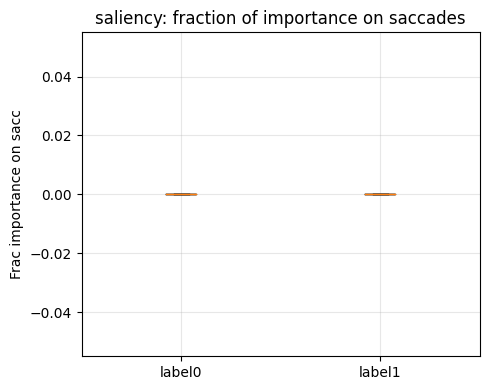

[XAI=ig] frac_imp_on_sacc  label0 vs label1 -> U=1058.0, p=1.000e+00, mean0=0.000, mean1=0.000


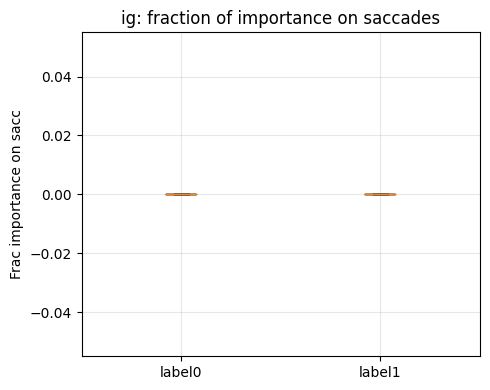

[XAI=gradcampp] frac_imp_on_sacc  label0 vs label1 -> U=1058.0, p=1.000e+00, mean0=0.000, mean1=0.000


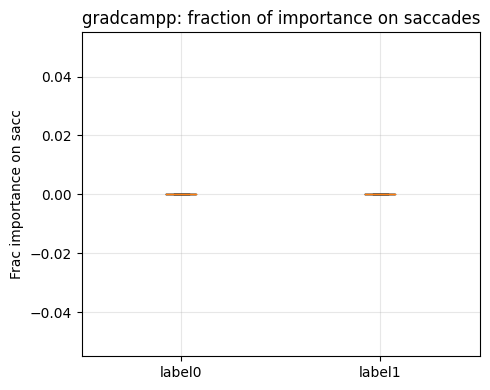

In [47]:
# Load data of first_trials (0,2) + train CNN
csv_dir = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
PAIR = (0, 2)
res = run_experiment(csv_dir, PAIR, target_len=1500)
model = res['model']

# Load it again to keep the preprocessing consistent with the model input
X, y, files = load_pair_experiment(csv_dir, PAIR, resample_len=1500)
# Randomly select 200 items for overall analysis
df_imp, summary = run_xai_saccade_analysis(
    model, X, y,
    xai_methods=('saliency','ig','gradcampp'),
    vel_thr=0.8, min_frames=8, max_n=200
)


In [35]:
if __name__ == "__main__":
    FIRST_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (0, 2)  # or (1,3)

    # Run it again with first and then with repeats to compare the statistical differences:
    df_first  = run_saccade_analysis(FIRST_DIR,  PAIR, target_len=1500, vel_thr=0.03, min_len=8, smooth_k=5)
    df_repeat = run_saccade_analysis(REPEAT_DIR, PAIR, target_len=1500, vel_thr=0.03, min_len=8, smooth_k=5)

    # Saving results facilitates subsequent plotting (boxplots/violin plots) and reproducing experiments
    df_first.to_csv(f"sacc_stats_first_{PAIR[0]}_{PAIR[1]}.csv", index=False)
    df_repeat.to_csv(f"sacc_stats_repeats_{PAIR[0]}_{PAIR[1]}.csv", index=False)


[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Saccade] trials=91, columns=['file', 'label', 'n_sacc', 'mean_dur', 'median_dur', 'mean_amp', 'median_amp', 'mean_peakv', 'median_peakv', 'mean_isi', 'median_isi', 'sacc_time_ratio']
[U-test] n_sacc: label0 vs label1 -> U=1565.5, p=2.548e-05, mean0=54.600, mean1=43.696
[U-test] mean_amp: label0 vs label1 -> U=696.0, p=0.007209, mean0=0.863, mean1=1.013
[U-test] mean_peakv: label0 vs label1 -> U=1272.0, p=0.06047, mean0=0.528, mean1=0.458
[U-test] mean_dur: label0 vs label1 -> U=556.0, p=0.0001457, mean0=22.481, mean1=30.405
[U-test] sacc_time_ratio: label0 vs label1 -> U=672.0, p=0.004007, mean0=0.777, mean1=0.839
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
[Saccade] trials=40, columns=['file', 'label', 'n_sacc', 'mean_dur', 'median_dur', 'mean_amp', 'median_amp', 'mean_peakv', 'median_peakv', 'mean_isi', 'median_isi', 'sacc_time_ratio']
[U-test] n_sacc: label0 vs l

Load-level Pattern Differences + Sliding Window Feature Dynamics for cnn

In [6]:
"""
Full Trace Length + Sliding Window Dynamics on Eye-Tracking
- Reuse the data loading style in the current baseline (linear resampling + median/IQR robust normalization)
- Analyse:
  1) Total trajectory length: distribution, significance testing, classification by length alone (subject grouping)
  2) Sliding window features: mean velocity / mean acceleration / range / saccade frequency
     - Perform a Mann–Whitney U test within the window and draw the mean curve + significant segment between labels

Output:
- Save the graph and CSV file under ./outputs/<dataset_name>
"""

import os, time, json
from typing import List, Tuple, Dict, Optional
import numpy as np
import pandas as pd
from scipy.stats import mannwhitneyu
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score, roc_auc_score, classification_report
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

# Global configs
SEED = 42
np.random.seed(SEED)
REQUIRED_COLS = ['abs_lx','abs_ly','abs_rx','abs_ry']
os.makedirs("outputs", exist_ok=True)

# Utils
def get_participant_id(filename: str) -> str:
    # Compatible with "021_0.csv" or "P021_xxx_0.csv"
    return os.path.splitext(filename)[0].split('_')[0]

def _linear_resample(x: np.ndarray, target_len: int) -> np.ndarray:
    T, C = x.shape
    if T == target_len:
        return x
    src = np.linspace(0.0, 1.0, T, dtype=np.float32)
    dst = np.linspace(0.0, 1.0, target_len, dtype=np.float32)
    out = np.empty((target_len, C), dtype=x.dtype)
    for c in range(C):
        out[:, c] = np.interp(dst, src, x[:, c])
    return out

def _robust_scale_per_trace(x: np.ndarray, eps: float = 1e-6) -> np.ndarray:
    x_scaled = x.copy()
    for c in range(x.shape[1]):
        v = x[:, c]
        med = np.median(v)
        q75, q25 = np.percentile(v, 75), np.percentile(v, 25)
        iqr = max(q75 - q25, eps)
        x_scaled[:, c] = (v - med) / iqr
    return x_scaled

def load_pair_experiment(
    csv_dir: str,
    labels: Tuple[int, int],
    resample_len: int = 1500,
    max_nan_ratio: float = 0.30,
    divide_by_960: bool = True,
    use_robust_scale: bool = True
):
    """Reading method consistent with existing scripts (linear resampling + robust scaling)"""
    X, y, files = [], [], []
    tagA, tagB = f"_{labels[0]}", f"_{labels[1]}"
    for file in sorted(os.listdir(csv_dir)):
        if not file.endswith(".csv"):
            continue
        if (tagA not in file) and (tagB not in file):
            continue
        path = os.path.join(csv_dir, file)
        try:
            df = pd.read_csv(path)
        except Exception:
            continue

        if set(REQUIRED_COLS).issubset(df.columns):
            raw = df[REQUIRED_COLS].astype(np.float32).values
        else:
            raw = df.iloc[:, 1:5].astype(np.float32).values

        if raw.ndim != 2 or raw.shape[1] < 4:
            continue

        nan_ratio = np.isnan(raw).mean()
        if nan_ratio > max_nan_ratio:
            continue

        raw = pd.DataFrame(raw).fillna(method='ffill').fillna(method='bfill').fillna(0.0).values
        if divide_by_960:
            raw = raw / 960.0

        seq = _linear_resample(raw, resample_len)  # (T,4)
        if use_robust_scale:
            seq = _robust_scale_per_trace(seq)

        X.append(seq)
        y.append(0 if tagA in file else 1)
        files.append(file)

    X = np.asarray(X, dtype=np.float32)
    y = np.asarray(y, dtype=np.int64)
    print(f"[load_pair_experiment] Dir={os.path.basename(csv_dir)} Labels={labels}, files={len(files)}, shape={X.shape}")
    return X, y, files

def split_by_participant_train_val_test(
    X: np.ndarray, y: np.ndarray, files: List[str],
    val_size: float = 0.2, test_size: float = 0.2, random_state: int = 42
):
    """Subject grouping is consistent with the existing pipeline"""
    pids = np.array([get_participant_id(f) for f in files])
    uniq = np.array(sorted(list(set(pids))))
    pid_trainval, pid_test = train_test_split(uniq, test_size=test_size, random_state=random_state, shuffle=True)
    pid_train, pid_val = train_test_split(pid_trainval, test_size=val_size/(1.0-test_size),
                                          random_state=random_state, shuffle=True)
    def mask(ids): return np.isin(pids, ids)
    tr, va, te = mask(pid_train), mask(pid_val), mask(pid_test)
    return X[tr], y[tr], X[va], y[va], X[te], y[te], {
        'train_ids': pid_train.tolist(), 'val_ids': pid_val.tolist(), 'test_ids': pid_test.tolist()
    }

# Core analytics
def trajectory_length(seq_xy: np.ndarray) -> float:
    """
    Calculate the length of a single trial trajectory: average (left, right) displacement accumulation
    seq_xy: (T,4) -> [lx,ly,rx,ry]
    """
    lx, ly, rx, ry = seq_xy[:,0], seq_xy[:,1], seq_xy[:,2], seq_xy[:,3]
    # Left and right length
    dl = np.sqrt(np.diff(lx)**2 + np.diff(ly)**2).sum()
    dr = np.sqrt(np.diff(rx)**2 + np.diff(ry)**2).sum()
    return float((dl + dr) / 2.0)

def compute_lengths(X: np.ndarray) -> np.ndarray:
    return np.array([trajectory_length(x) for x in X], dtype=np.float32)

def velocity_trace(seq_xy: np.ndarray) -> np.ndarray:
    """Frame speed (left and right average)"""
    lx, ly, rx, ry = seq_xy[:,0], seq_xy[:,1], seq_xy[:,2], seq_xy[:,3]
    vl = np.sqrt(np.diff(lx)**2 + np.diff(ly)**2)
    vr = np.sqrt(np.diff(rx)**2 + np.diff(ry)**2)
    v = (vl + vr)/2.0
    return v

def acceleration_from_velocity(v: np.ndarray) -> np.ndarray:
    """First-order difference of velocity (absolute value)"""
    if len(v) < 2: return np.zeros_like(v)
    a = np.abs(np.diff(v))
    return a

def window_slices(T: int, win: int, stride: int):
    idx = []
    s = 0
    while s + win <= T:
        idx.append((s, s+win))
        s += stride
    if not idx:
        idx.append((0, T))
    return idx

def window_features(seq_xy: np.ndarray, win=100, stride=50, sacc_thr=None) -> Dict[str, np.ndarray]:
    """
    Each window extracts:
      - mean_v: average speed
      - mean_a: average acceleration (average of the absolute values of velocity differences)
      - rng: position range (average of max-min values of each channel)
      - sacc_freq: the ratio (or number) of frames whose speed exceeds the threshold
    sacc_thr: if None -> use the p90 adaptive threshold of the speed within the trial
    """
    T = seq_xy.shape[0]
    vx = velocity_trace(seq_xy)
    ax = acceleration_from_velocity(vx)

    if sacc_thr is None:
        sacc_thr = np.percentile(vx, 90.0)  # Adaptive Threshold

    slices = window_slices(T-1, win, stride)  # The length of v is T-1
    mean_v, mean_a, rng, sacc_freq = [], [], [], []
    for (i, j) in slices:
        v_win = vx[i:j]
        a_win = ax[i:j-1] if (j-i)>=2 else np.array([0.0])
        sub = seq_xy[i:(i+win), :] if (i+win)<=T else seq_xy[i:T, :]

        # Velocity/acceleration mean
        mean_v.append(float(np.mean(v_win) if len(v_win)>0 else 0.0))
        mean_a.append(float(np.mean(a_win) if len(a_win)>0 else 0.0))

        # Position range (calculate the range of four channels and then average)
        ranges = sub.max(axis=0) - sub.min(axis=0)
        rng.append(float(np.mean(ranges)))

        # Saccade frequency (speed threshold method): the proportion of v>thr in the window
        sacc_freq.append(float(np.mean(v_win > sacc_thr)) if len(v_win)>0 else 0.0)

    return {
        'mean_v': np.array(mean_v, dtype=np.float32),
        'mean_a': np.array(mean_a, dtype=np.float32),
        'rng': np.array(rng, dtype=np.float32),
        'sacc_freq': np.array(sacc_freq, dtype=np.float32),
        'windows': np.array(slices, dtype=np.int32)
    }

def group_window_dynamics(X: np.ndarray, y: np.ndarray, win=100, stride=50) -> Dict:
    """
    For a set of trials, calculate sliding window features for each trial, then align them by label (truncating to the shortest window length), 
    and output the mean curve, SE, and window-by-window Mann-Whitney U test p-value for both classes.
    """
    feats0, feats1 = [], []
    for i in range(len(X)):
        feats = window_features(X[i], win=win, stride=stride, sacc_thr=None)
        feats['label'] = y[i]
        if y[i] == 0:
            feats0.append(feats)
        else:
            feats1.append(feats)

    if len(feats0)==0 or len(feats1)==0:
        raise ValueError("There are not enough samples of the two types to make dynamic comparisons")

    # Align to the same number of windows (take the shortest)
    K0 = min(len(f['mean_v']) for f in feats0)
    K1 = min(len(f['mean_v']) for f in feats1)
    K = min(K0, K1)

    def stack_and_trim(feats_list, key):
        arr = np.stack([f[key][:K] for f in feats_list], axis=0)  # (N, K)
        return arr

    out = {}
    for key in ['mean_v','mean_a','rng','sacc_freq']:
        A0 = stack_and_trim(feats0, key)
        A1 = stack_and_trim(feats1, key)
        mean0, mean1 = A0.mean(0), A1.mean(0)
        se0, se1 = A0.std(0)/np.sqrt(A0.shape[0]), A1.std(0)/np.sqrt(A1.shape[0])

        pvals = []
        for k in range(K):
            u, p = mannwhitneyu(A0[:,k], A1[:,k], alternative='two-sided')
            pvals.append(p)
        out[key] = {
            'mean0': mean0, 'mean1': mean1,
            'se0': se0, 'se1': se1,
            'pvals': np.array(pvals)
        }
    out['K'] = K
    out['win'] = win
    out['stride'] = stride
    return out

# Plots
def plot_box_violin_lengths(lengths: np.ndarray, y: np.ndarray, title: str, save_path: str):
    import matplotlib.pyplot as plt
    data0, data1 = lengths[y==0], lengths[y==1]
    fig, ax = plt.subplots(1,2, figsize=(10,4), sharey=True)
    ax[0].boxplot([data0, data1], labels=['label0','label1'])
    ax[0].set_title('Boxplot')
    ax[0].set_ylabel('Trajectory length')

    parts = ax[1].violinplot([data0, data1], showmeans=True, showmedians=True)
    ax[1].set_xticks([1,2])
    ax[1].set_xticklabels(['label0','label1'])
    ax[1].set_title('Violin')
    fig.suptitle(title)
    plt.tight_layout()
    fig.savefig(save_path, dpi=200)
    plt.close(fig)

def plot_window_curves(dyn: Dict, title: str, save_path: str, alpha=0.05):
    K, win, stride = dyn['K'], dyn['win'], dyn['stride']
    tgrid = np.arange(K) * stride + win//2  # Approximate the time axis using the window center
    keys = ['mean_v','mean_a','rng','sacc_freq']
    fig, axes = plt.subplots(len(keys), 1, figsize=(10, 2.8*len(keys)), sharex=True)
    if len(keys)==1:
        axes = [axes]
    for ax, key in zip(axes, keys):
        d = dyn[key]
        ax.plot(tgrid, d['mean0'], label='label0')
        ax.fill_between(tgrid, d['mean0']-d['se0'], d['mean0']+d['se0'], alpha=0.25)
        ax.plot(tgrid, d['mean1'], label='label1')
        ax.fill_between(tgrid, d['mean1']-d['se1'], d['mean1']+d['se1'], alpha=0.25)
        # Significance marking (windows with p < alpha are marked with a small horizontal line at the bottom)
        sig = d['pvals'] < alpha
        if sig.any():
            ymin = min(d['mean0'].min(), d['mean1'].min())
            ax.scatter(tgrid[sig], np.full(sig.sum(), ymin), marker='|', s=60, label='p<%.2f'%alpha)
        ax.set_ylabel(key)
        ax.grid(alpha=0.2)
    axes[-1].set_xlabel('time (frame)')
    axes[0].legend()
    fig.suptitle(title)
    plt.tight_layout()
    fig.savefig(save_path, dpi=200)
    plt.close(fig)

# End-to-end run
def analyze_dataset(
    name: str, csv_dir: str, label_pair=(0,2),
    target_len=1500, out_dir="outputs",
    win=100, stride=50
):
    os.makedirs(os.path.join(out_dir, name), exist_ok=True)

    # 1) Load
    X, y, files = load_pair_experiment(csv_dir, label_pair, resample_len=target_len,
                                       max_nan_ratio=0.30, divide_by_960=True, use_robust_scale=True)

    # 2) Full track length
    L = compute_lengths(X)  # (N,)
    df_len = pd.DataFrame({'file': files, 'pid':[get_participant_id(f) for f in files],
                           'label': y, 'length': L})
    df_len.to_csv(os.path.join(out_dir, name, f"{name}_lengths.csv"), index=False)

    # Significance test
    L0, L1 = L[y==0], L[y==1]
    u, p = mannwhitneyu(L0, L1, alternative='two-sided')
    stats = {
        'n0': int(len(L0)), 'n1': int(len(L1)),
        'mean0': float(L0.mean()), 'mean1': float(L1.mean()),
        'std0': float(L0.std()), 'std1': float(L1.std()),
        'U': float(u), 'p': float(p)
    }
    with open(os.path.join(out_dir, name, f"{name}_length_stats.json"), "w") as f:
        json.dump(stats, f, indent=2)
    print(f"[{name}] Length MW-U: U={u:.1f}, p={p:.3e}, mean0={L0.mean():.3f}, mean1={L1.mean():.3f}")

    # Boxplot/Violinplot
    plot_box_violin_lengths(L, y, title=f"{name} Trajectory Length", 
                            save_path=os.path.join(out_dir, name, f"{name}_length_box_violin.png"))

    # 3) Classification by length only (subject grouping)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(
        L.reshape(-1,1), y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    clf = make_pipeline(StandardScaler(), LogisticRegression(random_state=SEED, max_iter=1000))
    clf.fit(np.vstack([Xtr, Xva]), np.hstack([ytr, yva]))  # Fit with train+val and then evaluate on test
    prob = clf.predict_proba(Xte)[:,1]
    pred = (prob >= 0.5).astype(int)
    acc = accuracy_score(yte, pred)
    try:
        auc = roc_auc_score(yte, prob)
    except ValueError:
        auc = float('nan')
    print(f"[{name}] Length-only classifier: Acc={acc:.3f}, ROC-AUC={auc:.3f}")
    with open(os.path.join(out_dir, name, f"{name}_length_cls.json"), "w") as f:
        json.dump({'accuracy': float(acc), 'roc_auc': float(auc), 'split': split_info}, f, indent=2)

    # 4) Sliding window feature dynamics (window-by-window statistics + significance)
    dyn = group_window_dynamics(X, y, win=win, stride=stride)
    # Save window-by-window p-values
    pv = {k: dyn[k]['pvals'].tolist() for k in ['mean_v','mean_a','rng','sacc_freq']}
    with open(os.path.join(out_dir, name, f"{name}_window_pvals.json"), "w") as f:
        json.dump({'K': dyn['K'], 'win': dyn['win'], 'stride': dyn['stride'], 'pvals': pv}, f, indent=2)

    # Plot
    plot_window_curves(dyn, title=f"{name} sliding-window dynamics (win={win}, stride={stride})",
                       save_path=os.path.join(out_dir, name, f"{name}_window_dynamics.png"))

    return {
        'length_stats': stats,
        'length_cls': {'accuracy': float(acc), 'roc_auc': float(auc)},
        'splits': split_info
    }

# Main
if __name__ == "__main__":
    FIRST_DIR  = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (0, 2)     # or (1, 3)
    TARGET_LEN = 1500

    # Sliding window parameters (adjustable)
    WIN = 100
    STRIDE = 50

    print("=== Analyze FIRST ===")
    res_first = analyze_dataset("first_trials", FIRST_DIR, label_pair=PAIR, target_len=TARGET_LEN,
                                out_dir="outputs", win=WIN, stride=STRIDE)

    print("=== Analyze REPEATS ===")
    res_repeats = analyze_dataset("repeats", REPEAT_DIR, label_pair=PAIR, target_len=TARGET_LEN,
                                  out_dir="outputs", win=WIN, stride=STRIDE)

    # If need to combine the overall conclusions, we can compare the two JSON/CSV files here
    print("\nSummary:")
    print("FIRST length-only:", res_first['length_cls'])
    print("REPEATS length-only:", res_repeats['length_cls'])


=== Analyze FIRST ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[first_trials] Length MW-U: U=1177.0, p=3.548e-01, mean0=761.688, mean1=725.137
[first_trials] Length-only classifier: Acc=0.389, ROC-AUC=0.500
=== Analyze REPEATS ===
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
[repeats] Length MW-U: U=218.0, p=6.359e-01, mean0=892.691, mean1=850.462
[repeats] Length-only classifier: Acc=0.700, ROC-AUC=0.760

Summary:
FIRST length-only: {'accuracy': 0.3888888888888889, 'roc_auc': 0.5}
REPEATS length-only: {'accuracy': 0.7, 'roc_auc': 0.76}


Ablation Experiments for cnn

In [7]:
"""
Ablation Experiments (8.3):
- 8.3.1 Eye Channel Ablation: Left Only / Right Only / Combined
- 8.3.2 Temporal Segment Ablation: Start / Middle / End
- 8.3.3 Coordinate Direction Ablation: X only / Y only

Integration notes:
- Reuse existing: _linear_resample, _robust_scale_per_trace, load_pair_experiment,
  split_by_participant_train_val_test, compute_class_weight, get_optimizer
- Do cropping (channel/time slice) before entering the model, and resample back to target_len after the time slice to keep the input size consistent
- When building the model, the input_shape is automatically set according to the number of channels after cropping.
"""

import os, time, json
from typing import Tuple, List, Dict, Optional
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, classification_report

# import：
#   - _linear_resample(x, target_len)
#   - _robust_scale_per_trace(x)
#   - load_pair_experiment(csv_dir, labels, resample_len, max_nan_ratio, divide_by_960, use_robust_scale)
#   - split_by_participant_train_val_test(X, y, files, val_size, test_size, random_state)
#   - compute_class_weight(y_train)
#   - get_optimizer(lr)

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# General model (automatically sets input size based on number of channels)
def build_1dcnn_model_nchan(target_len: int, n_channels: int) -> Model:
    inp = Input(shape=(target_len, n_channels))
    x = layers.Conv1D(64, 7, padding='same', activation='relu')(inp)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling1D(2)(x)

    x = layers.Conv1D(128, 5, padding='same', activation='relu')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling1D(2)(x)

    x = layers.Conv1D(128, 3, padding='same', activation='relu')(x)
    x = layers.GlobalAveragePooling1D()(x)
    x = layers.Dense(64, activation='relu')(x)
    x = layers.Dropout(0.5)(x)
    out = layers.Dense(1, activation='sigmoid')(x)
    return Model(inp, out)

# Crop tool
# Channel index convention: 0: lx, 1: ly, 2: rx, 3: ry
IDX = {'lx':0, 'ly':1, 'rx':2, 'ry':3}

def select_channels(X: np.ndarray, mode: str) -> np.ndarray:
    """
    mode in {'left','right','both','x','y'}:
      - left  -> [lx, ly]
      - right -> [rx, ry]
      - both  -> [lx, ly, rx, ry] (as is)
      - x     -> [lx, rx]
      - y     -> [ly, ry]
    """
    if mode == 'left':
        keep = [IDX['lx'], IDX['ly']]
    elif mode == 'right':
        keep = [IDX['rx'], IDX['ry']]
    elif mode == 'both':
        keep = [IDX['lx'], IDX['ly'], IDX['rx'], IDX['ry']]
    elif mode == 'x':
        keep = [IDX['lx'], IDX['rx']]
    elif mode == 'y':
        keep = [IDX['ly'], IDX['ry']]
    else:
        raise ValueError(f"Unknown channel mode: {mode}")
    return X[:, :, keep]

def slice_temporal_segment(X: np.ndarray, seg: str, resample_back_len: Optional[int] = None) -> np.ndarray:
    """
    Slice (N,T,C) into 1/3 slices in the time dimension:
      seg in {'full','start','middle','end'}
    If resample_back_len is given, the sliced sequence is linearly resampled back to this length (keeping the model input consistent).
    """
    if seg == 'full':
        return X
    N, T, C = X.shape
    one_third = T // 3
    if seg == 'start':
        Xs = X[:, :one_third, :]
    elif seg == 'middle':
        Xs = X[:, one_third:2*one_third, :]
    elif seg == 'end':
        Xs = X[:, 2*one_third:, :]
    else:
        raise ValueError(f"Unknown temporal segment: {seg}")

    if (resample_back_len is None) or (Xs.shape[1] == resample_back_len):
        return Xs

    # Linearly resample each sample and channel back to resample_back_len
    out = np.empty((N, resample_back_len, C), dtype=X.dtype)
    for i in range(N):
        out[i] = _linear_resample(Xs[i], resample_back_len)
    return out

# Training and evaluation
def train_eval_once(
    X: np.ndarray, y: np.ndarray, files: List[str],
    target_len: int = 1500,
    lr: float = 3e-4,
    batch_size: int = 16,
    max_epochs: int = 80,
    early_patience: int = 15
) -> Dict:
    """
    Independently divide the subjects -> training -> testing, and return various indicators
    """
    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    n_channels = X.shape[-1]
    model = build_1dcnn_model_nchan(target_len, n_channels)
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])

    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    class_weight = compute_class_weight(ytr)

    t0 = time.perf_counter()
    hist = model.fit(
        Xtr, ytr,
        validation_data=(Xva, yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=0,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()

    # Test
    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob >= 0.5).astype(int)
    acc = accuracy_score(yte, ypred)
    macro_f1 = f1_score(yte, ypred, average='macro')
    try:
        roc_auc = roc_auc_score(yte, yprob)
    except Exception:
        roc_auc = np.nan
    report = classification_report(yte, ypred, digits=4)
    return {
        'acc': acc, 'macro_f1': macro_f1, 'roc_auc': roc_auc,
        'report': report, 'history': hist.history, 'time_sec': t1 - t0,
        'splits': id_splits
    }

# 8.3.1 Eye Channel Ablation
def run_eye_channel_ablation(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    base_loader_kwargs: Optional[Dict] = None
) -> pd.DataFrame:
    """
    modes = ['left','right','both']
    """
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)

    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)
    rows = []
    for mode in ['left', 'right', 'both']:
        Xc = select_channels(X, mode)
        res = train_eval_once(Xc, y, files, target_len=target_len)
        rows.append(dict(
            ablation='EyeChannel', setting=mode,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'],
            time_sec=res['time_sec']
        ))
        print(f"[EyeChannel] {mode}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# 8.3.2 Temporal Segment Ablation
def run_temporal_segment_ablation(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    base_loader_kwargs: Optional[Dict] = None
) -> pd.DataFrame:
    """
    segs = ['start','middle','end'] (Based on a sequence that has been resampled to target_len, cut it into 1/3 and then resample it back to target_len)
    """
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)
    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)

    rows = []
    for seg in ['start', 'middle', 'end']:
        Xt = slice_temporal_segment(X, seg=seg, resample_back_len=target_len)
        res = train_eval_once(Xt, y, files, target_len=target_len)
        rows.append(dict(
            ablation='Temporal', setting=seg,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'],
            time_sec=res['time_sec']
        ))
        print(f"[Temporal] {seg}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

#  8.3.3 Coordinate Direction Ablation
def run_coord_direction_ablation(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    base_loader_kwargs: Optional[Dict] = None
) -> pd.DataFrame:
    """
    dirs = ['x','y']  (x: horizontal only lx,rx; y: vertical only ly,ry)
    """
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)
    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)

    rows = []
    for d in ['x', 'y']:
        Xc = select_channels(X, d)
        res = train_eval_once(Xc, y, files, target_len=target_len)
        rows.append(dict(
            ablation='Coord', setting=d,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'],
            time_sec=res['time_sec']
        ))
        print(f"[Coord] {d}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# One-button control
def run_all_ablation(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    save_prefix: Optional[str] = None
) -> Dict[str, pd.DataFrame]:
    res_eye = run_eye_channel_ablation(csv_dir, label_pair, target_len)
    res_tmp = run_temporal_segment_ablation(csv_dir, label_pair, target_len)
    res_dir = run_coord_direction_ablation(csv_dir, label_pair, target_len)

    results = {'EyeChannel': res_eye, 'Temporal': res_tmp, 'Coord': res_dir}
    if save_prefix:
        for k, df in results.items():
            df.to_csv(f"{save_prefix}_{k}.csv", index=False)
        with open(f"{save_prefix}_meta.json", "w") as f:
            json.dump({'label_pair': label_pair, 'target_len': target_len}, f, indent=2)
    return results

if __name__ == "__main__":
    FIRST_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"

    PAIR = (0, 2)  # or (1, 3)

    print("=== 8.3 Ablation on FIRST_TRIALS ===")
    res_first = run_all_ablation(FIRST_DIR, label_pair=PAIR, target_len=1500, save_prefix=f"ablation_first_{PAIR[0]}_{PAIR[1]}")

    print("\n=== 8.3 Ablation on REPEATS ===")
    res_repeats = run_all_ablation(REPEAT_DIR, label_pair=PAIR, target_len=1500, save_prefix=f"ablation_repeats_{PAIR[0]}_{PAIR[1]}")

    # Summary Print
    for name, df in res_first.items():
        print(f"\n[FIRST] {name}\n", df.sort_values('acc', ascending=False))
    for name, df in res_repeats.items():
        print(f"\n[REPEATS] {name}\n", df.sort_values('acc', ascending=False))


=== 8.3 Ablation on FIRST_TRIALS ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)

Epoch 51: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.
2/2 [==============================] - 0s 4ms/step
[EyeChannel] left: Acc=0.882, F1=0.882, AUC=1.000
              precision    recall  f1-score   support

           0     0.7778    1.0000    0.8750         7
           1     1.0000    0.8000    0.8889        10

    accuracy                         0.8824        17
   macro avg     0.8889    0.9000    0.8819        17
weighted avg     0.9085    0.8824    0.8832        17


Epoch 21: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 27: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 4ms/step
[EyeChannel] right: Acc=0.882, F1=0.879, AUC=0.971
              precision    recall  f1-score   support

           0     0.8571    0.8571    0.8571         7
     

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 65: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.
1/1 [==============================] - 0s 35ms/step
[EyeChannel] both: Acc=0.800, F1=0.792, AUC=1.000
              precision    recall  f1-score   support

           0     1.0000    0.6000    0.7500         5
           1     0.7143    1.0000    0.8333         5

    accuracy                         0.8000        10
   macro avg     0.8571    0.8000    0.7917        10
weighted avg     0.8571    0.8000    0.7917        10

[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)

Epoch 49: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 55: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 42ms/step
[Temporal] start: Acc=0.800, F1=0.792, AUC=1.000
              precision    recall  f1-score   support

           0     0.7143    1.0000    0.8333         5
           1     1.0000    0.6000    0.7500    

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 9: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 34: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.

Epoch 67: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.
1/1 [==============================] - 0s 38ms/step
[Coord] y: Acc=0.600, F1=0.524, AUC=0.920
              precision    recall  f1-score   support

           0     1.0000    0.2000    0.3333         5
           1     0.5556    1.0000    0.7143         5

    accuracy                         0.6000        10
   macro avg     0.7778    0.6000    0.5238        10
weighted avg     0.7778    0.6000    0.5238        10


[FIRST] EyeChannel
      ablation setting       acc  macro_f1   roc_auc   time_sec
0  EyeChannel    left  0.882353  0.881944  1.000000  10.796862
1  EyeChannel   right  0.882353  0.878571  0.971429  11.628950
2  EyeChannel    both  0.823529  0.798419  0.985714   4.055596

[FIRST] Temporal
    ablation setting       acc  macro_f1   roc_auc  ti

In [8]:
if __name__ == "__main__":
    FIRST_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"

    PAIR = (1, 3)

    print("=== 8.3 Ablation on FIRST_TRIALS ===")
    res_first = run_all_ablation(FIRST_DIR, label_pair=PAIR, target_len=1500, save_prefix=f"ablation_first_{PAIR[0]}_{PAIR[1]}")

    print("\n=== 8.3 Ablation on REPEATS ===")
    res_repeats = run_all_ablation(REPEAT_DIR, label_pair=PAIR, target_len=1500, save_prefix=f"ablation_repeats_{PAIR[0]}_{PAIR[1]}")

    # Summary Print
    for name, df in res_first.items():
        print(f"\n[FIRST] {name}\n", df.sort_values('acc', ascending=False))
    for name, df in res_repeats.items():
        print(f"\n[REPEATS] {name}\n", df.sort_values('acc', ascending=False))

=== 8.3 Ablation on FIRST_TRIALS ===
[load_pair_experiment] Dir=first_trials Labels=(1, 3), files=96, shape=(96, 1500, 4)

Epoch 25: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 31: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 6ms/step
[EyeChannel] left: Acc=0.476, F1=0.323, AUC=0.845
              precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000        11
           1     0.4762    1.0000    0.6452        10

    accuracy                         0.4762        21
   macro avg     0.2381    0.5000    0.3226        21
weighted avg     0.2268    0.4762    0.3072        21



/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 7: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 13: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.

Epoch 19: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.
2/2 [==============================] - 0s 5ms/step
[EyeChannel] right: Acc=0.714, F1=0.697, AUC=0.591
              precision    recall  f1-score   support

           0     0.6667    0.9091    0.7692        11
           1     0.8333    0.5000    0.6250        10

    accuracy                         0.7143        21
   macro avg     0.7500    0.7045    0.6971        21
weighted avg     0.7460    0.7143    0.7005        21


Epoch 15: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 21: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.

Epoch 32: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.
2/2 [==============================] - 0s 16ms/step
[EyeChannel] both: Acc=0.714, F1=0.697, AUC=0.873


/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 10: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 16: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 6ms/step
[Coord] y: Acc=0.619, F1=0.596, AUC=0.718
              precision    recall  f1-score   support

           0     0.6000    0.8182    0.6923        11
           1     0.6667    0.4000    0.5000        10

    accuracy                         0.6190        21
   macro avg     0.6333    0.6091    0.5962        21
weighted avg     0.6317    0.6190    0.6007        21


=== 8.3 Ablation on REPEATS ===
[load_pair_experiment] Dir=repeats Labels=(1, 3), files=39, shape=(39, 1500, 4)

Epoch 9: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 73: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 34ms/step
[EyeChannel] left: Acc=0.889, F1=0.889, AUC=1.000
              precision    recall  f1-score   support


/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[load_pair_experiment] Dir=repeats Labels=(1, 3), files=39, shape=(39, 1500, 4)

Epoch 7: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 13: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 35ms/step
[Temporal] start: Acc=0.667, F1=0.667, AUC=0.700
              precision    recall  f1-score   support

           0     0.7500    0.6000    0.6667         5
           1     0.6000    0.7500    0.6667         4

    accuracy                         0.6667         9
   macro avg     0.6750    0.6750    0.6667         9
weighted avg     0.6833    0.6667    0.6667         9


Epoch 35: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 41: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 36ms/step
[Temporal] middle: Acc=0.778, F1=0.775, AUC=0.950
              precision    recall  f1-score   support

           0     0.8000 

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[load_pair_experiment] Dir=repeats Labels=(1, 3), files=39, shape=(39, 1500, 4)

Epoch 11: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 17: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 35ms/step
[Coord] x: Acc=0.444, F1=0.308, AUC=0.750
              precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000         5
           1     0.4444    1.0000    0.6154         4

    accuracy                         0.4444         9
   macro avg     0.2222    0.5000    0.3077         9
weighted avg     0.1975    0.4444    0.2735         9



/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 10: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 16: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.

Epoch 28: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.

Epoch 34: ReduceLROnPlateau reducing learning rate to 1.8750000890577212e-05.
1/1 [==============================] - 0s 36ms/step
[Coord] y: Acc=0.444, F1=0.308, AUC=0.900
              precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000         5
           1     0.4444    1.0000    0.6154         4

    accuracy                         0.4444         9
   macro avg     0.2222    0.5000    0.3077         9
weighted avg     0.1975    0.4444    0.2735         9


[FIRST] EyeChannel
      ablation setting       acc  macro_f1   roc_auc  time_sec
1  EyeChannel   right  0.714286  0.697115  0.590909  4.591830
2  EyeChannel    both  0.714286  0.697115  0.872727  9.818916
0  EyeChannel    left  0.476190  0.322581  0.845455  4.347

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


cnn+bilstm

[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Split] train=54, val=20, test=17
Epoch 1/80
2/4 [==============>...............] - ETA: 0s - loss: 0.7469 - accuracy: 0.6250

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 0s 78ms/step - loss: 0.7571 - accuracy: 0.5556 - val_loss: 0.6900 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 78ms/step - loss: 0.6884 - accuracy: 0.5741 - val_loss: 0.6888 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 69ms/step - loss: 0.6380 - accuracy: 0.6111 - val_loss: 0.6870 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 0s 69ms/step - loss: 0.5673 - accuracy: 0.6667 - val_loss: 0.6846 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 0s 71ms/step - loss: 0.5967 - accuracy: 0.6111 - val_loss: 0.6809 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 0s 64ms/step - loss: 0.5275 - accuracy: 0.7963 - val_loss: 0.6775 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 7/80
4/4 [==============================] - 0s 61ms/step - loss: 0.53

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 3s 746ms/step - loss: 0.7079 - accuracy: 0.4815 - val_loss: 0.7104 - val_accuracy: 0.3500 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 3s 875ms/step - loss: 0.6127 - accuracy: 0.7593 - val_loss: 0.7012 - val_accuracy: 0.5500 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 3s 723ms/step - loss: 0.5250 - accuracy: 0.8148 - val_loss: 0.6866 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 3s 788ms/step - loss: 0.4471 - accuracy: 0.9074 - val_loss: 0.6715 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 3s 744ms/step - loss: 0.4003 - accuracy: 0.8889 - val_loss: 0.6576 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 3s 735ms/step - loss: 0.3725 - accuracy: 0.8889 - val_loss: 0.6452 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 7/80
4/4 [==============================] - 3s 756ms/step - los

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 0s 82ms/step - loss: 0.8157 - accuracy: 0.4727 - val_loss: 0.6947 - val_accuracy: 0.3000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 64ms/step - loss: 0.7014 - accuracy: 0.5091 - val_loss: 0.6934 - val_accuracy: 0.5500 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 63ms/step - loss: 0.6903 - accuracy: 0.5818 - val_loss: 0.6926 - val_accuracy: 0.5500 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 0s 62ms/step - loss: 0.6628 - accuracy: 0.6182 - val_loss: 0.6919 - val_accuracy: 0.5500 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 0s 66ms/step - loss: 0.6615 - accuracy: 0.6000 - val_loss: 0.6913 - val_accuracy: 0.5500 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 0s 68ms/step - loss: 0.6896 - accuracy: 0.5273 - val_loss: 0.6906 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 7/80
4/4 [==============================] - 0s 61ms/step - loss: 0.66

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 3s 745ms/step - loss: 0.6563 - accuracy: 0.5818 - val_loss: 0.6980 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 3s 709ms/step - loss: 0.5908 - accuracy: 0.7818 - val_loss: 0.6764 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 3s 726ms/step - loss: 0.5346 - accuracy: 0.8000 - val_loss: 0.6578 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 3s 704ms/step - loss: 0.4511 - accuracy: 0.8727 - val_loss: 0.6354 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 3s 746ms/step - loss: 0.4367 - accuracy: 0.8364 - val_loss: 0.6136 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 3s 746ms/step - loss: 0.4061 - accuracy: 0.8545 - val_loss: 0.5943 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 7/80
4/4 [==============================] - 3s 702ms/step - los

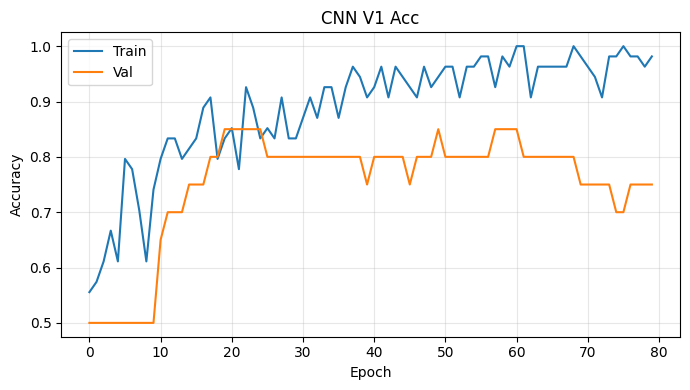

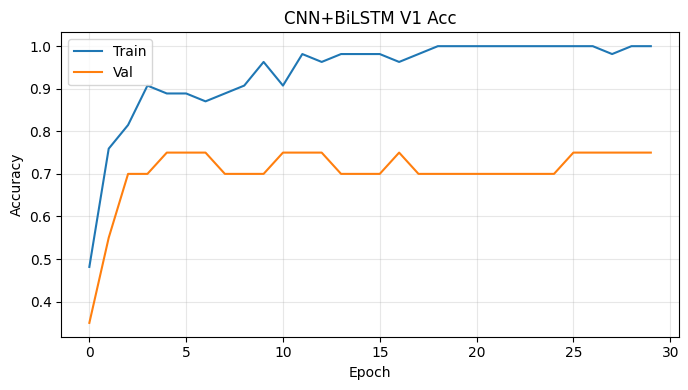

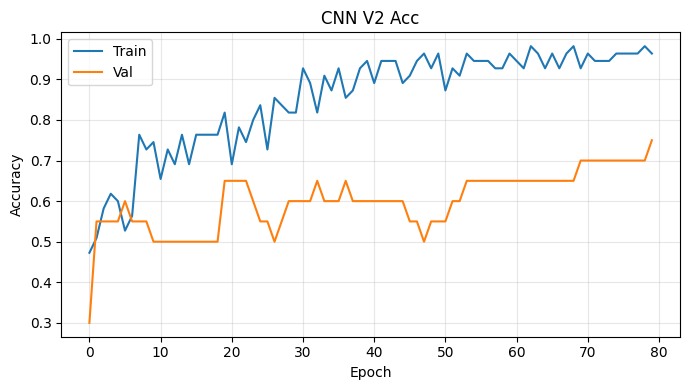

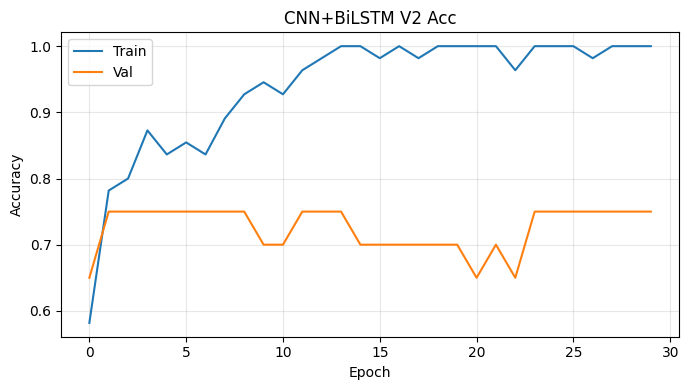

In [13]:
# CNN + BiLSTM (plug-in to current pipeline)

from tensorflow.keras import regularizers

def build_cnn_bilstm_model(input_shape,
                           l2=1e-4,
                           dropout=0.5,
                           lstm_units=64) -> Model:
    """
    Structure: Conv1D(64,k=7)->BN->MaxPool(2)
        + Conv1D(128,k=5)->BN->MaxPool(2)
        + Conv1D(128,k=3)->BN
        + BiLSTM(64)
        + Dense(64)->Dropout->Sigmoid
    Keep the same input size as your baseline (T=1500, C=4).
    """
    inp = Input(shape=input_shape, name='input_ts')

    x = layers.Conv1D(64, 7, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x)
    x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)         # T -> T/2

    x = layers.Conv1D(128, 5, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x)
    x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)         # T/2 -> T/4

    x = layers.Conv1D(128, 3, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv3')(x)
    x = layers.BatchNormalization(name='bn3')(x)
    x = layers.ReLU(name='conv3_relu')(x)

    # Sequence encoding (preserving the time sequence and passing it to BiLSTM)
    x = layers.Bidirectional(layers.LSTM(lstm_units, return_sequences=False,
                                         name='bilstm'))(x)
    x = layers.Dropout(dropout, name='drop')(x)
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='cnn_bilstm')


def run_experiment_cnn_bilstm(
    csv_dir: str,
    label_pair: Tuple[int, int],
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    l2: float = 1e-4,
    dropout: float = 0.5,
    lstm_units: int = 64
) -> Dict:
    """
    The signature/return structure is the same as run_experiment ; the only difference is that the model is changed to CNN+BiLSTM.
    """
    # Data loading and segmentation (using tools)
    X, y, files = load_pair_experiment(
        csv_dir,
        label_pair,
        resample_len=target_len,
        max_nan_ratio=0.05,
        divide_by_960=True,
        use_robust_scale=True
    )

    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    print(f"[Split] train={len(ytr)}, val={len(yva)}, test={len(yte)}")

    # Model
    model = build_cnn_bilstm_model((target_len, 4), l2=l2, dropout=dropout, lstm_units=lstm_units)
    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',   # Consistent with baseline
                  metrics=['accuracy'])
    model.summary()

    # Training strategy (callback/weights consistent with baseline)
    callbacks = [
        tf.keras.callbacks.EarlyStopping(
            monitor='val_loss', patience=early_patience, restore_best_weights=True
        ),
        tf.keras.callbacks.ReduceLROnPlateau(
            monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1
        ),
        tf.keras.callbacks.CSVLogger(f'train_log_bilstm_{label_pair[0]}_{label_pair[1]}.csv', append=False)
    ]
    class_weight = compute_class_weight(ytr)

    # Train
    t0 = time.perf_counter()
    history = model.fit(
        Xtr, ytr,
        validation_data=(Xva, yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=1,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()
    print(f"[Time][BiLSTM] Pair {label_pair}: training wall-clock {t1 - t0:.2f}s")

    # Test
    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    report = classification_report(yte, ypred, digits=4)
    print(f"\n[TEST][BiLSTM] Pair {label_pair} classification report:\n{report}")

    return {
        'label_pair': label_pair,
        'history': history.history,
        'test_report': report,
        'model': model,
        'id_splits': id_splits
    }


# Run CNN baseline and CNN+BiLSTM in parallel
if __name__ == "__main__":
    csv_path = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    # V1
    res_02_cnn     = run_experiment(csv_path, (0, 2), target_len=1500)
    res_02_bilstm  = run_experiment_cnn_bilstm(csv_path, (0, 2), target_len=1500)

    # V2
    res_13_cnn     = run_experiment(csv_path, (1, 3), target_len=1500)
    res_13_bilstm  = run_experiment_cnn_bilstm(csv_path, (1, 3), target_len=1500)

    # Draw a comparison (Acc/Loss)
    import matplotlib.pyplot as plt

    def plot_curve(hdict, title, key='accuracy'):
        plt.figure(figsize=(7,4))
        plt.plot(hdict.get(key, []), label='Train')
        plt.plot(hdict.get('val_'+key, []), label='Val')
        plt.xlabel('Epoch'); plt.ylabel(key.title()); plt.title(title); plt.legend(); plt.grid(alpha=0.3); plt.tight_layout(); plt.show()

    plot_curve(res_02_cnn['history'],    'CNN V1 Acc', 'accuracy')
    plot_curve(res_02_bilstm['history'], 'CNN+BiLSTM V1 Acc', 'accuracy')
    plot_curve(res_13_cnn['history'],    'CNN V2 Acc', 'accuracy')
    plot_curve(res_13_bilstm['history'], 'CNN+BiLSTM V2 Acc', 'accuracy')


transfer learning for cnn+bilstm

In [49]:
# Transfer Learning for CNN+BiLSTM (V1 -> V2, same API as CNN TL)

import os, time
from typing import List, Tuple, Dict, Optional
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, Model, Input, regularizers
from sklearn.metrics import classification_report

# Reuse: get_participant_id / _linear_resample / _robust_scale_per_trace / load_pair_experiment /
#     split_by_participant_train_val_test / get_optimizer / compute_class_weight 


# Model: extractor (Conv+BiLSTM) + small dense head
def build_extractor_cnn_bilstm(input_shape, l2=1e-4, lstm_units=64) -> Model:
    """
    Extractor = Conv blocks (+BN+Pool) + BiLSTM -> feature vector
    The naming is consistent with CNN, retaining conv1/2/3, bn1/2/3, bilstm for easy GradCAM / local unfreezing
    """
    inp = Input(shape=input_shape, name='input_ts')
    x = layers.Conv1D(64, 7, padding='same', activation=None, use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x)
    x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)

    x = layers.Conv1D(128, 5, padding='same', activation=None, use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x)
    x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)

    x = layers.Conv1D(128, 3, padding='same', activation=None, use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv3')(x)
    x = layers.BatchNormalization(name='bn3')(x)
    x = layers.ReLU(name='conv3_relu')(x)

    x = layers.Bidirectional(layers.LSTM(lstm_units, return_sequences=False), name='bilstm')(x)
    return Model(inp, x, name='extractor_bilstm')

def build_classifier_from_extractor_bilstm(extractor: Model, dropout=0.5) -> Model:
    inp = extractor.input
    x = extractor.output
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(dropout, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='cnn_bilstm_transfer')

# Freezing helpers
def freeze_all_but_head(model: Model):
    """Only train the Dense head (fc1/drop/logit)."""
    for l in model.layers:
        l.trainable = (l.name in ['fc1','drop','logit'])

def bn_adapt_only(model: Model):
    """Only BatchNorm layers are trainable (BatchNorm adaptation)."""
    for l in model.layers:
        if isinstance(l, layers.BatchNormalization):
            l.trainable = True
        else:
            l.trainable = False

def finetune_last_block_and_bilstm(model: Model):
    """Unfreeze conv3 + bn3 + bilstm + head; keep the rest frozen."""
    for l in model.layers:
        l.trainable = (l.name in ['conv3','bn3','bilstm','fc1','drop','logit'])

def unfreeze_all(model: Model):
    for l in model.layers:
        l.trainable = True

# Stage 0: Pretrain on source pair (e.g., (0,2))
def pretrain_extractor_on_source_bilstm(csv_dir: str, src_pair=(0,2), target_len=1500,
                                        max_epochs=60, batch_size=16, lr=3e-4,
                                        l2=1e-4, lstm_units=64,
                                        save_path='extractor_bilstm_src.weights.h5'):
    X, y, files = load_pair_experiment(csv_dir, src_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(X, y, files)

    extractor = build_extractor_cnn_bilstm((target_len, 4), l2=l2, lstm_units=lstm_units)
    model = build_classifier_from_extractor_bilstm(extractor, dropout=0.5)

    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])

    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    print(f"[Pretrain BiLSTM] source={src_pair}")
    t0 = time.perf_counter()
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1, callbacks=cbs)
    t1 = time.perf_counter()
    print(f"[Time] Pretrain wall-clock: {t1 - t0:.2f}s")

    # quick test
    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    print("[TEST] Pretrain report:\n", classification_report(yte, ypred, digits=4))

    extractor.save_weights(save_path)
    print(f"[SAVE] extractor (CNN+BiLSTM) weights -> {save_path}")
    return save_path

# Transfer: head-only -> BN-adapt -> conv3+bilstm finetune (optionally unfreeze all)
def transfer_finetune_bilstm(csv_dir: str, tgt_pair=(1,3),
                             extractor_weights='extractor_bilstm_src.weights.h5',
                             target_len=1500, batch_size=16,
                             l2=1e-4, lstm_units=64,
                             do_full_unfreeze: bool = False):
    # Load target data
    X, y, files = load_pair_experiment(csv_dir, tgt_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(X, y, files)
    cls_weight = compute_class_weight(ytr)

    # Build model & load extractor weights
    extractor = build_extractor_cnn_bilstm((target_len, 4), l2=l2, lstm_units=lstm_units)
    extractor.load_weights(extractor_weights)
    model = build_classifier_from_extractor_bilstm(extractor, dropout=0.5)

    # Stage 1: head-only
    print("[Stage 1][BiLSTM] Head-only (freeze extractor)")
    freeze_all_but_head(model)
    model.compile(optimizer=get_optimizer(3e-3),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=4, min_lr=7.5e-4, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1, callbacks=cbs1,
              class_weight=cls_weight)

    # Stage 1.5: BN-Adapt（2~3 epochs, very small LR）
    print("[Stage 1.5][BiLSTM] BN-Adapt (only BN trainable)")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=3, batch_size=batch_size, verbose=1)

    # Stage 2: conv3 + Bilstm fine-tuning
    print("[Stage 2][BiLSTM] Fine-tune conv3+bn3+bilstm (+head) @ low LR")
    finetune_last_block_and_bilstm(model)
    model.compile(optimizer=get_optimizer(5e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=12, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=8, min_lr=1e-5, verbose=1),
    ]
    t0 = time.perf_counter()
    hist2 = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                      epochs=60, batch_size=batch_size, verbose=1, callbacks=cbs2,
                      class_weight=cls_weight)
    t1 = time.perf_counter()
    print(f"[Time] Fine-tune wall-clock: {t1 - t0:.2f}s")

    # Stage 3: unfreeze completely and then fine-tune for a few rounds with small steps
    if do_full_unfreeze:
        print("[Stage 3][BiLSTM] Unfreeze ALL layers @ very low LR")
        unfreeze_all(model)
        model.compile(optimizer=get_optimizer(2e-5),
                      loss='binary_crossentropy',
                      metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
        model.fit(Xtr, ytr, validation_data=(Xva, yva),
                  epochs=12, batch_size=batch_size, verbose=1,
                  callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)],
                  class_weight=cls_weight)

    # Evaluate on test
    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    print("\n[TEST][BiLSTM Transfer] report:\n", classification_report(yte, ypred, digits=4))

    return model, (Xtr, ytr, Xva, yva, Xte, yte), hist2.history

# Run
if __name__ == "__main__":
    SRC_TGT_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    # Stage 0: first pre-train the extractor (Conv+BiLSTM) in (0,2)
    extractor_w = pretrain_extractor_on_source_bilstm(
        csv_dir=SRC_TGT_DIR, src_pair=(0,2), target_len=1500,
        max_epochs=60, batch_size=16, lr=3e-4,
        l2=1e-4, lstm_units=64,
        save_path='extractor_bilstm_0_2.weights.h5'
    )
    # Migrate to (1,3): head-only → BN-Adapt → conv3+bilstm fine-tuning (optional full unfreeze)
    model_t, splits, hist2 = transfer_finetune_bilstm(
        csv_dir=SRC_TGT_DIR, tgt_pair=(1,3),
        extractor_weights=extractor_w, target_len=1500, batch_size=16,
        l2=1e-4, lstm_units=64,
        do_full_unfreeze=False
    )


[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[Pretrain BiLSTM] source=(0, 2)
Epoch 1/60
4/4 [==============================] - 2s 182ms/step - loss: 0.6589 - accuracy: 0.6296 - auc: 0.7473 - val_loss: 0.7077 - val_accuracy: 0.5500 - val_auc: 0.6350 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 0s 100ms/step - loss: 0.5562 - accuracy: 0.7778 - auc: 0.8468 - val_loss: 0.6956 - val_accuracy: 0.6500 - val_auc: 0.7100 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 0s 116ms/step - loss: 0.4812 - accuracy: 0.8148 - auc: 0.9141 - val_loss: 0.6839 - val_accuracy: 0.6500 - val_auc: 0.7250 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 0s 108ms/step - loss: 0.5152 - accuracy: 0.8148 - auc: 0.8571 - val_loss: 0.6709 - val_accuracy: 0.7000 - val_auc: 0.7250 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 1s 152ms/step - loss: 0.3434 - accuracy: 0.9074 - auc: 0.9746 - val_loss: 0.6

Epoch 22/60
4/4 [==============================] - 0s 105ms/step - loss: 0.1624 - accuracy: 0.9649 - auc: 0.9975 - val_loss: 0.4923 - val_accuracy: 0.7500 - val_auc: 0.8800 - lr: 2.5000e-05
Epoch 23/60
4/4 [==============================] - 0s 109ms/step - loss: 0.1840 - accuracy: 0.9298 - auc: 0.9901 - val_loss: 0.4911 - val_accuracy: 0.8000 - val_auc: 0.8800 - lr: 2.5000e-05
Epoch 24/60
4/4 [==============================] - 0s 113ms/step - loss: 0.1999 - accuracy: 0.9298 - auc: 0.9852 - val_loss: 0.4905 - val_accuracy: 0.7500 - val_auc: 0.8800 - lr: 2.5000e-05
Epoch 25/60
4/4 [==============================] - 0s 109ms/step - loss: 0.1738 - accuracy: 0.9298 - auc: 0.9951 - val_loss: 0.4904 - val_accuracy: 0.7500 - val_auc: 0.8800 - lr: 2.5000e-05
[Time] Fine-tune wall-clock: 14.56s
2/2 [==============================] - 0s 18ms/step

[TEST][BiLSTM Transfer] report:
               precision    recall  f1-score   support

           0     0.9000    0.8182    0.8571        11
         

first→repeats transfer learning

In [50]:
# CNN+BiLSTM: first → repeats transfer
import time
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, Model, Input, regularizers
from sklearn.metrics import classification_report, balanced_accuracy_score

# Existing tools：get_participant_id / _linear_resample / _robust_scale_per_trace /
# load_pair_experiment / split_by_participant_train_val_test / compute_class_weight / get_optimizer

# BiLSTM extractor + head
def build_extractor_cnn_bilstm(input_shape, l2=1e-4, lstm_units=64) -> Model:
    inp = Input(shape=input_shape, name='input_ts')
    x = layers.Conv1D(64, 7, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x); x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)

    x = layers.Conv1D(128, 5, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x); x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)

    x = layers.Conv1D(128, 3, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv3')(x)
    x = layers.BatchNormalization(name='bn3')(x); x = layers.ReLU(name='conv3_relu')(x)

    x = layers.Bidirectional(layers.LSTM(lstm_units, return_sequences=False), name='bilstm')(x)
    return Model(inp, x, name='extractor_bilstm')

def build_classifier_from_extractor_bilstm(extractor: Model, dropout=0.5) -> Model:
    inp = extractor.input
    x = extractor.output
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(dropout, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='cnn_bilstm_transfer')

# Freezing helpers
def freeze_all_but_head(model: Model):
    for l in model.layers:
        l.trainable = (l.name in ['fc1','drop','logit'])

def bn_adapt_only(model: Model):
    for l in model.layers:
        if isinstance(l, layers.BatchNormalization):
            l.trainable = True
        else:
            l.trainable = False

def finetune_last_block_and_bilstm(model: Model):
    for l in model.layers:
        l.trainable = (l.name in ['conv3','bn3','bilstm','fc1','drop','logit'])

# Threshold tuning
def tune_threshold_bal_acc(y_true: np.ndarray, y_prob: np.ndarray):
    best_thr, best_bal = 0.5, -1.0
    for thr in np.linspace(0.1, 0.9, 33):
        y_pred = (y_prob >= thr).astype(int)
        bal = balanced_accuracy_score(y_true, y_pred)
        if bal > best_bal:
            best_bal, best_thr = bal, float(thr)
    return best_thr, best_bal

def evaluate_with_threshold(model: Model, Xv, yv, Xt, yt, batch_size=16):
    vprob = model.predict(Xv, batch_size=batch_size).ravel()
    thr, bal = tune_threshold_bal_acc(yv, vprob)
    tprob = model.predict(Xt, batch_size=batch_size).ravel()
    tpred = (tprob >= thr).astype(int)
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")
    print("\n[TEST] Transfer report (thr tuned):\n",
          classification_report(yt, tpred, digits=4))
    return thr, bal

# Stage 0: pretrain on FIRST
def pretrain_extractor_on_first_bilstm(
    src_dir: str, src_pair=(0,2), target_len=1500,
    max_epochs=60, batch_size=16, lr=3e-4,
    l2=1e-4, lstm_units=64,
    save_path='extractor_bilstm_first.weights.h5'
):
    Xs, ys, fs = load_pair_experiment(src_dir, src_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(Xs, ys, fs)

    extractor = build_extractor_cnn_bilstm((target_len, 4), l2=l2, lstm_units=lstm_units)
    model = build_classifier_from_extractor_bilstm(extractor, dropout=0.5)
    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])

    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    print(f"[Pretrain BiLSTM] source={src_pair}")
    t0 = time.perf_counter()
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1, callbacks=cbs)
    t1 = time.perf_counter()
    print(f"[Time] Pretrain wall-clock: {t1 - t0:.2f}s")

    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    print("[TEST] Pretrain report:\n", classification_report(yte, ypred, digits=4))

    extractor.save_weights(save_path)
    print(f"[SAVE] extractor (CNN+BiLSTM) weights -> {save_path}")
    return save_path

# Transfer: FIRST → REPEATS
def transfer_first_to_repeats_bilstm(
    src_dir: str, tgt_dir: str, pair=(0,2),
    extractor_weights_path: str | None = None,
    target_len=1500, batch_size=16,
    l2=1e-4, lstm_units=64
):
    # Load data
    Xs, ys, fs = load_pair_experiment(src_dir, pair, resample_len=target_len)   # first_trials
    Xt, yt, ft = load_pair_experiment(tgt_dir, pair, resample_len=target_len)   # repeats

    # The target domain is divided into groups according to the subjects
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(
        Xt, yt, ft, val_size=0.25, test_size=0.25, random_state=SEED
    )
    print("[Split target pids]", split_info)
    cls_weight = compute_class_weight(ytr)

    # Build/Load Extractor
    extractor = build_extractor_cnn_bilstm((target_len, 4), l2=l2, lstm_units=lstm_units)
    if extractor_weights_path is None:
        extractor_weights_path = pretrain_extractor_on_first_bilstm(
            src_dir=src_dir, src_pair=pair, target_len=target_len,
            max_epochs=60, batch_size=batch_size, lr=3e-4,
            l2=l2, lstm_units=lstm_units,
            save_path=f"extractor_bilstm_first_{pair[0]}_{pair[1]}.weights.h5"
        )
    extractor.load_weights(extractor_weights_path)
    model = build_classifier_from_extractor_bilstm(extractor, dropout=0.5)

    # Stage 1: Head training only
    print("[Stage 1][BiLSTM] Head-only.")
    freeze_all_but_head(model)
    model.compile(optimizer=get_optimizer(3e-3),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-4, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1, callbacks=cbs1,
              class_weight=cls_weight)

    # Stage 1.5: BN-Adapt
    print("[Stage 1.5][BiLSTM] BN-Adapt (only BN, very low LR)")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: Unfreeze conv3+bn3+bilstm+head
    print("[Stage 2][BiLSTM] Fine-tune conv3+bn3+bilstm @ LR=5e-5")
    finetune_last_block_and_bilstm(model)
    model.compile(optimizer=get_optimizer(5e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)]
    t0 = time.perf_counter()
    hist2 = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                      epochs=60, batch_size=batch_size, verbose=1, callbacks=cbs2,
                      class_weight=cls_weight)
    t1 = time.perf_counter()
    print(f"[Time] Fine-tune wall-clock: {t1 - t0:.2f}s")

    # Threshold fine-tuning & testing
    best_thr, _ = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, (Xtr, ytr, Xva, yva, Xte, yte), hist2.history, best_thr, split_info


if __name__ == "__main__":
    SRC_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    TGT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (0, 2)
    EXTRACTOR_WEIGHTS = None  # or "extractor_bilstm_first_0_2.weights.h5"

    model_t, splits, hist2, best_thr, pid_split = transfer_first_to_repeats_bilstm(
        src_dir=SRC_DIR, tgt_dir=TGT_DIR, pair=PAIR,
        extractor_weights_path=EXTRACTOR_WEIGHTS,
        target_len=1500, batch_size=16,
        l2=1e-4, lstm_units=64
    )


[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
[Split target pids] {'train_ids': ['021', '065', '016', '032', '054', '072', '036', '056', '058', '042'], 'val_ids': ['049', '047', '048', '071', '011'], 'test_ids': ['006', '062', '057', '009', '041', '029']}
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[Pretrain BiLSTM] source=(0, 2)
Epoch 1/60
4/4 [==============================] - 2s 232ms/step - loss: 0.7214 - accuracy: 0.6111 - auc: 0.5845 - val_loss: 0.7029 - val_accuracy: 0.5000 - val_auc: 0.7150 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 0s 104ms/step - loss: 0.5560 - accuracy: 0.7222 - auc: 0.8915 - val_loss: 0.6826 - val_accuracy: 0.6000 - val_auc: 0.7700 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 0s 102ms/step - loss: 0.4788 - accuracy: 0.8148 - auc: 0.9402 - val_loss: 0.6599

2/2 [==============================] - 0s 78ms/step - loss: 0.1175 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.1536 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 35/60
2/2 [==============================] - 0s 88ms/step - loss: 0.1187 - accuracy: 0.9500 - auc: 1.0000 - val_loss: 0.1527 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 36/60
2/2 [==============================] - 0s 75ms/step - loss: 0.0877 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.1519 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 37/60
2/2 [==============================] - 0s 95ms/step - loss: 0.1025 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.1512 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 38/60
2/2 [==============================] - 0s 80ms/step - loss: 0.0828 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.1503 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 39/60
2/2 [==============================] - 0s 77ms/step - l

Repeat Trial Generalisation Test for cnn+bilstm

In [51]:
# RTG eval helpers — CNN+BiLSTM version
# Need：numpy, pandas, sklearn, tensorflow
# Reuse existing ones: load_pair_experiment / split_by_participant_train_val_test /
#     get_participant_id / compute_class_weight / get_optimizer

import os, time
import numpy as np
import pandas as pd
import tensorflow as tf
from typing import Optional, Tuple, Dict
from tensorflow.keras import layers, Model, Input, regularizers
from sklearn.model_selection import train_test_split
from sklearn.metrics import (classification_report, balanced_accuracy_score,
                             f1_score, roc_auc_score, average_precision_score,
                             confusion_matrix)

SEED = 42

# BiLSTM extractor + head
def build_extractor_cnn_bilstm(input_shape, l2=1e-4, lstm_units=64) -> Model:
    inp = Input(shape=input_shape, name='input_ts')
    x = layers.Conv1D(64, 7, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x); x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)

    x = layers.Conv1D(128, 5, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x); x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)

    x = layers.Conv1D(128, 3, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv3')(x)
    x = layers.BatchNormalization(name='bn3')(x); x = layers.ReLU(name='conv3_relu')(x)

    x = layers.Bidirectional(layers.LSTM(lstm_units, return_sequences=False), name='bilstm')(x)
    return Model(inp, x, name='extractor_bilstm')

def build_classifier_from_extractor_bilstm(extractor: Model, dropout=0.5) -> Model:
    inp = extractor.input
    x = extractor.output
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(dropout, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='cnn_bilstm_transfer')

# Freezing helpers
def freeze_all_but_head(model: Model):
    for l in model.layers:
        l.trainable = (l.name in ['fc1','drop','logit'])

def bn_adapt_only(model: Model):
    for l in model.layers:
        if isinstance(l, layers.BatchNormalization):
            l.trainable = True
        else:
            l.trainable = False

def finetune_last_block_and_bilstm(model: Model):
    for l in model.layers:
        l.trainable = (l.name in ['conv3','bn3','bilstm','fc1','drop','logit'])

# Threshold helpers
def tune_threshold_bal_acc(y_true: np.ndarray, y_prob: np.ndarray) -> Tuple[float,float]:
    best_thr, best_bal = 0.5, -1.0
    for thr in np.linspace(0.1, 0.9, 33):
        y_pred = (y_prob >= thr).astype(int)
        bal = balanced_accuracy_score(y_true, y_pred)
        if bal > best_bal:
            best_bal, best_thr = bal, float(thr)
    return best_thr, best_bal

def evaluate_with_threshold(model: Model, Xv, yv, Xt, yt, batch_size=16):
    vprob = model.predict(Xv, batch_size=batch_size).ravel()
    thr, bal = tune_threshold_bal_acc(yv, vprob)
    tprob = model.predict(Xt, batch_size=batch_size).ravel()
    tpred = (tprob >= thr).astype(int)
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")
    print("\n[TEST] Transfer report (thr tuned):\n",
          classification_report(yt, tpred, digits=4))
    return thr, bal

# Eval helpers
def predict_prob_on_dir(model: Model, data_dir: str, pair=(0,2), target_len=1500, batch_size=16):
    X, y, files = load_pair_experiment(data_dir, pair, resample_len=target_len)
    y_prob = model.predict(X, batch_size=batch_size).ravel()
    return y, y_prob, files

def evaluate_fixed_threshold(y_true, y_prob, thr=0.5, label=""):
    y_pred = (y_prob >= thr).astype(int)
    out = {
        "label": label,
        "thr": float(thr),
        "bal_acc": balanced_accuracy_score(y_true, y_pred),
        "macro_f1": f1_score(y_true, y_pred, average='macro'),
        "roc_auc": roc_auc_score(y_true, y_prob) if len(np.unique(y_true))==2 else np.nan,
        "auprc": average_precision_score(y_true, y_prob),
        "confusion": confusion_matrix(y_true, y_pred).tolist(),
        "n": int(len(y_true))
    }
    print("\n[EVAL]", label)
    print(pd.Series(out))
    print(classification_report(y_true, y_pred, digits=4))
    return out

# Pretrain (in-domain extractor)
def pretrain_extractor_on_source_bilstm(csv_dir: str, src_pair=(0,2), target_len=1500,
                                        max_epochs=60, batch_size=16, lr=3e-4,
                                        l2=1e-4, lstm_units=64,
                                        save_path='extractor_bilstm_src.weights.h5'):
    X, y, files = load_pair_experiment(csv_dir, src_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(X, y, files)

    extractor = build_extractor_cnn_bilstm((target_len, 4), l2=l2, lstm_units=lstm_units)
    model = build_classifier_from_extractor_bilstm(extractor)

    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    print(f"[Pretrain BiLSTM] source={src_pair}")
    t0 = time.perf_counter()
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1, callbacks=cbs)
    t1 = time.perf_counter()
    print(f"[Time] Pretrain wall-clock: {t1 - t0:.2f}s")

    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    print("[TEST] Pretrain report:\n", classification_report(yte, ypred, digits=4))
    extractor.save_weights(save_path)
    print(f"[SAVE] extractor (BiLSTM) -> {save_path}")
    return save_path

# A) In-domain baselines
def run_in_domain_baseline_bilstm(data_dir: str, pair=(0,2), target_len=1500, batch_size=16,
                                  tag="first", l2=1e-4, lstm_units=64):
    w_path = pretrain_extractor_on_source_bilstm(
        csv_dir=data_dir, src_pair=pair, target_len=target_len,
        max_epochs=60, batch_size=batch_size, lr=3e-4,
        l2=l2, lstm_units=lstm_units,
        save_path=f"extractor_bilstm_{tag}_{pair[0]}_{pair[1]}.weights.h5"
    )
    Xt, yt, ft = load_pair_experiment(data_dir, pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(Xt, yt, ft, random_state=SEED)

    extractor = build_extractor_cnn_bilstm((target_len, 4), l2=l2, lstm_units=lstm_units)
    extractor.load_weights(w_path)
    model = build_classifier_from_extractor_bilstm(extractor)

    # Stage 1: head-only
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-4, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)

    # BN-Adapt
    print("[BN-Adapt][BiLSTM] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: conv3+bilstm
    print("[Stage 2][BiLSTM] Fine-tune conv3+bn3+bilstm @ LR=5e-5.")
    finetune_last_block_and_bilstm(model)
    model.compile(optimizer=get_optimizer(5e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), thr=thr, split=split_info, hist=hist.history)

# B) Zero-shot
def run_zero_shot_bilstm(src_model: Model, src_thr: float,
                         tgt_dir: str, pair=(0,2), target_len=1500, batch_size=16,
                         label_prefix="B_zero_BiLSTM"):
    y_true, y_prob, _ = predict_prob_on_dir(src_model, tgt_dir, pair, target_len, batch_size)
    out1 = evaluate_fixed_threshold(y_true, y_prob, thr=0.5, label=f"{label_prefix}@0.5")
    out2 = evaluate_fixed_threshold(y_true, y_prob, thr=src_thr, label=f"{label_prefix}@thr_src")
    return {"@0.5": out1, "@thr_src": out2}

# C) Few-shot adaptation
def run_kshot_adaptation_bilstm(src_dir: str, tgt_dir: str, pair=(0,2),
                                k_subjects: int = 10, target_len=1500, batch_size=16, seed=SEED,
                                reuse_extractor_path: Optional[str] = None, l2=1e-4, lstm_units=64,
                                label="C_kshot_BiLSTM"):
    # Pretrain/load extractors
    if reuse_extractor_path is None:
        reuse_extractor_path = pretrain_extractor_on_source_bilstm(
            csv_dir=src_dir, src_pair=pair, target_len=target_len,
            max_epochs=60, batch_size=batch_size, lr=3e-4,
            l2=l2, lstm_units=lstm_units,
            save_path=f"extractor_bilstm_{os.path.basename(src_dir)}_{pair[0]}_{pair[1]}.weights.h5"
        )

    # Target domain partition k-shot
    Xt, yt, ft = load_pair_experiment(tgt_dir, pair, resample_len=target_len)
    pids = np.array([get_participant_id(f) for f in ft])
    uniq = np.array(sorted(list(set(pids))))
    rng = np.random.RandomState(seed)
    rng.shuffle(uniq)
    k = min(k_subjects, len(uniq))
    pid_trainval = uniq[:k]
    pid_test     = uniq[k:]
    if len(pid_test) == 0:
        pid_test = uniq[-1:]
        pid_trainval = uniq[:-1]
    pid_train, pid_val = train_test_split(
        pid_trainval, test_size=max(1, int(0.2*len(pid_trainval))), random_state=seed
    )
    def mask(ids): return np.isin(pids, ids)
    Xtr, ytr = Xt[mask(pid_train)], yt[mask(pid_train)]
    Xva, yva = Xt[mask(pid_val)],   yt[mask(pid_val)]
    Xte, yte = Xt[mask(pid_test)],  yt[mask(pid_test)]
    print(f"[K-shot split][BiLSTM] train_ids={pid_train.tolist()} val_ids={pid_val.tolist()} test_ids={pid_test.tolist()}")

    # Build the model and load the extractor
    extractor = build_extractor_cnn_bilstm((target_len, 4), l2=l2, lstm_units=lstm_units)
    extractor.load_weights(reuse_extractor_path)
    model = build_classifier_from_extractor_bilstm(extractor)

    # Stage 1: Head-only
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-4, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)

    # BN-Adapt
    print("[BN-Adapt][BiLSTM] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: conv3+bilstm
    print("[Stage 2][BiLSTM] Fine-tune conv3+bn3+bilstm @ LR=5e-5.")
    finetune_last_block_and_bilstm(model)
    model.compile(optimizer=get_optimizer(5e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), thr=thr, hist=hist.history)

# D) Joint training (first ∪ repeats)
def run_joint_training_bilstm(first_dir: str, repeats_dir: str, pair=(0,2),
                              target_len=1500, batch_size=16, l2=1e-4, lstm_units=64):
    Xf, yf, ff = load_pair_experiment(first_dir, pair, resample_len=target_len)
    Xr, yr, fr = load_pair_experiment(repeats_dir, pair, resample_len=target_len)

    pf = np.array([ "F_"+get_participant_id(f) for f in ff ])
    pr = np.array([ "R_"+get_participant_id(f) for f in fr ])

    X = np.vstack([Xf, Xr])
    y = np.concatenate([yf, yr])
    pids  = np.concatenate([pf, pr])
    domains = np.array(['first']*len(Xf) + ['repeats']*len(Xr))

    uniq = np.array(sorted(list(set(pids))))
    pid_trainval, pid_test = train_test_split(uniq, test_size=0.25, random_state=SEED, shuffle=True)
    pid_train, pid_val = train_test_split(pid_trainval, test_size=len(pid_trainval)//4 if len(pid_trainval)>4 else 1,
                                          random_state=SEED, shuffle=True)
    def mask(ids): return np.isin(pids, ids)
    tr, va, te = mask(pid_train), mask(pid_val), mask(pid_test)
    Xtr, ytr = X[tr], y[tr]
    Xva, yva = X[va], y[va]
    Xte, yte = X[te], y[te]
    d_te = domains[te]

    extractor = build_extractor_cnn_bilstm((target_len, 4), l2=l2, lstm_units=lstm_units)
    model = build_classifier_from_extractor_bilstm(extractor)

    # Stage 1
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-4, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)

    # BN-Adapt
    print("[BN-Adapt][BiLSTM] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2
    print("[Stage 2][BiLSTM] Fine-tune conv3+bn3+bilstm @ LR=5e-5.")
    finetune_last_block_and_bilstm(model)
    model.compile(optimizer=get_optimizer(5e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    # Use the combined validation set to adjust the threshold; evaluate the first / repeats subsets separately
    vprob = model.predict(Xva, batch_size=batch_size).ravel()
    thr, bal = tune_threshold_bal_acc(yva, vprob)
    tprob = model.predict(Xte, batch_size=batch_size).ravel()
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")

    mask_first = (d_te == 'first')
    mask_rep   = (d_te == 'repeats')
    print("\n[TEST] Joint(BiLSTM) → first subset")
    evaluate_fixed_threshold(yte[mask_first], tprob[mask_first], thr=thr, label="D_joint_BiLSTM→firstTest")
    print("\n[TEST] Joint(BiLSTM) → repeats subset")
    evaluate_fixed_threshold(yte[mask_rep], tprob[mask_rep], thr=thr, label="D_joint_BiLSTM→repeatsTest")
    print("\n[TEST] Joint(BiLSTM) → all")
    evaluate_fixed_threshold(yte, tprob, thr=thr, label="D_joint_BiLSTM→allTest")

    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), test_domain=d_te, thr=thr, hist=hist.history)

# Run RTG (BiLSTM) with one click
def run_rtg_bilstm_suite(SRC_DIR, TGT_DIR, pair=(0,2), target_len=1500, batch=16, l2=1e-4, lstm_units=64):
    print("\n=== A1: in-domain baseline on FIRST (BiLSTM) ===")
    modelA1, resA1 = run_in_domain_baseline_bilstm(SRC_DIR, pair=pair, target_len=target_len,
                                                   batch_size=batch, tag="first", l2=l2, lstm_units=lstm_units)
    thrA1 = resA1["thr"]

    print("\n=== A2: in-domain baseline on REPEATS (BiLSTM) ===")
    modelA2, resA2 = run_in_domain_baseline_bilstm(TGT_DIR, pair=pair, target_len=target_len,
                                                   batch_size=batch, tag="repeats", l2=l2, lstm_units=lstm_units)
    thrA2 = resA2["thr"]

    print("\n=== B1: zero-shot FIRST → REPEATS (BiLSTM) ===")
    _ = run_zero_shot_bilstm(modelA1, thrA1, TGT_DIR, pair=pair, target_len=target_len, batch_size=batch,
                             label_prefix="B1_first→repeats_BiLSTM")

    print("\n=== B2: zero-shot REPEATS → FIRST (BiLSTM) ===")
    _ = run_zero_shot_bilstm(modelA2, thrA2, SRC_DIR, pair=pair, target_len=target_len, batch_size=batch,
                             label_prefix="B2_repeats→first_BiLSTM")

    print("\n=== C1: k-shot FIRST → REPEATS (k=10, BiLSTM) ===")
    _modelC1, _resC1 = run_kshot_adaptation_bilstm(SRC_DIR, TGT_DIR, pair=pair, k_subjects=10,
                                                   target_len=target_len, batch_size=batch, l2=l2, lstm_units=lstm_units,
                                                   reuse_extractor_path=None, label="C1_first→repeats_k10_BiLSTM")

    print("\n=== C2: k-shot REPEATS → FIRST (k=10, BiLSTM) ===")
    _modelC2, _resC2 = run_kshot_adaptation_bilstm(TGT_DIR, SRC_DIR, pair=pair, k_subjects=10,
                                                   target_len=target_len, batch_size=batch, l2=l2, lstm_units=lstm_units,
                                                   reuse_extractor_path=None, label="C2_repeats→first_k10_BiLSTM")

    print("\n=== D: Joint training (FIRST ∪ REPEATS, BiLSTM) ===")
    _modelD, _resD = run_joint_training_bilstm(SRC_DIR, TGT_DIR, pair=pair, target_len=target_len,
                                               batch_size=batch, l2=l2, lstm_units=lstm_units)

# Run
if __name__ == "__main__":
    SRC_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    TGT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    run_rtg_bilstm_suite(SRC_DIR, TGT_DIR, pair=(0,2), target_len=1500, batch=16, l2=1e-4, lstm_units=64)



=== A1: in-domain baseline on FIRST (BiLSTM) ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[Pretrain BiLSTM] source=(0, 2)
Epoch 1/60
4/4 [==============================] - 3s 184ms/step - loss: 0.7648 - accuracy: 0.4815 - auc: 0.5117 - val_loss: 0.6915 - val_accuracy: 0.4500 - val_auc: 0.7600 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 0s 108ms/step - loss: 0.5683 - accuracy: 0.7778 - auc: 0.9183 - val_loss: 0.6748 - val_accuracy: 0.7500 - val_auc: 0.7950 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 0s 104ms/step - loss: 0.5098 - accuracy: 0.8333 - auc: 0.9293 - val_loss: 0.6593 - val_accuracy: 0.8000 - val_auc: 0.7900 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 0s 109ms/step - loss: 0.4685 - accuracy: 0.8704 - auc: 0.9238 - val_loss: 0.6459 - val_accuracy: 0.7500 - val_auc: 0.8000 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 0s 101ms/step - loss: 0.411

Epoch 17/20
4/4 [==============================] - 0s 39ms/step - loss: 0.3013 - accuracy: 0.8889 - auc: 0.9423 - val_loss: 0.8461 - val_accuracy: 0.7000 - val_auc: 0.7550 - lr: 7.5000e-04
Epoch 18/20
4/4 [==============================] - 0s 39ms/step - loss: 0.3008 - accuracy: 0.9259 - auc: 0.9444 - val_loss: 0.8477 - val_accuracy: 0.7000 - val_auc: 0.7550 - lr: 7.5000e-04
Epoch 19/20
4/4 [==============================] - 0s 38ms/step - loss: 0.3341 - accuracy: 0.8889 - auc: 0.9334 - val_loss: 0.8493 - val_accuracy: 0.7000 - val_auc: 0.7600 - lr: 7.5000e-04
Epoch 20/20
4/4 [==============================] - 0s 39ms/step - loss: 0.2857 - accuracy: 0.9259 - auc: 0.9499 - val_loss: 0.8501 - val_accuracy: 0.7000 - val_auc: 0.7600 - lr: 7.5000e-04
[BN-Adapt][BiLSTM] epochs=2, lr=1e-05
Epoch 1/2
4/4 [==============================] - 2s 169ms/step - loss: 0.1601 - accuracy: 0.9444 - auc: 0.9890 - val_loss: 0.8587 - val_accuracy: 0.7000 - val_auc: 0.7500
Epoch 2/2
4/4 [====================

2/2 [==============================] - 0s 92ms/step - loss: 0.1740 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.5032 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 16/60
2/2 [==============================] - 0s 93ms/step - loss: 0.1786 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.5028 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 17/60
2/2 [==============================] - 0s 89ms/step - loss: 0.1513 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.5030 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 18/60
2/2 [==============================] - 0s 101ms/step - loss: 0.1253 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.5007 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 19/60
2/2 [==============================] - 0s 96ms/step - loss: 0.1200 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.5007 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 20/60
2/2 [==============================] - 0s 108ms/step -

Epoch 2/60
2/2 [==============================] - 0s 83ms/step - loss: 0.1024 - accuracy: 0.9545 - auc: 1.0000 - val_loss: 0.6878 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 3/60
2/2 [==============================] - 0s 87ms/step - loss: 0.0378 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.6621 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 4/60
2/2 [==============================] - 0s 83ms/step - loss: 0.0404 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.6423 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 5/60
2/2 [==============================] - 0s 81ms/step - loss: 0.0306 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.6277 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 6/60
2/2 [==============================] - 0s 85ms/step - loss: 0.0293 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.6181 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 7/60
2/2 [==============================] - 0s 86ms/st

Epoch 44/60
2/2 [==============================] - 0s 81ms/step - loss: 0.0299 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.7516 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 45/60
2/2 [==============================] - 0s 82ms/step - loss: 0.0257 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.7543 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 46/60
2/2 [==============================] - 0s 81ms/step - loss: 0.0290 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.7575 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 47/60
2/2 [==============================] - 0s 82ms/step - loss: 0.0252 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.7602 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 48/60
2/2 [==============================] - 0s 119ms/step - loss: 0.0275 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.7630 - val_accuracy: 0.7500 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 49/60
2/2 [==============================] - 0s 

Epoch 6/60
4/4 [==============================] - 0s 109ms/step - loss: 0.3141 - accuracy: 0.8889 - auc: 0.9574 - val_loss: 0.6051 - val_accuracy: 0.7500 - val_auc: 0.8050 - lr: 3.0000e-04
Epoch 7/60
4/4 [==============================] - 1s 133ms/step - loss: 0.2801 - accuracy: 0.8889 - auc: 0.9609 - val_loss: 0.5987 - val_accuracy: 0.7500 - val_auc: 0.8100 - lr: 3.0000e-04
Epoch 8/60
4/4 [==============================] - 0s 119ms/step - loss: 0.2525 - accuracy: 0.9074 - auc: 0.9863 - val_loss: 0.5952 - val_accuracy: 0.7000 - val_auc: 0.8100 - lr: 3.0000e-04
Epoch 9/60
4/4 [==============================] - 0s 109ms/step - loss: 0.2250 - accuracy: 0.9259 - auc: 0.9828 - val_loss: 0.5899 - val_accuracy: 0.7000 - val_auc: 0.8050 - lr: 3.0000e-04
Epoch 10/60
4/4 [==============================] - 0s 113ms/step - loss: 0.2351 - accuracy: 0.9259 - auc: 0.9794 - val_loss: 0.5856 - val_accuracy: 0.7500 - val_auc: 0.8000 - lr: 3.0000e-04
Epoch 11/60
4/4 [==============================] - 0s 

1/1 [==============================] - 0s 95ms/step - loss: 0.0647 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.2799 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 34/60
1/1 [==============================] - 0s 95ms/step - loss: 0.0920 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.2801 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 35/60
1/1 [==============================] - 0s 117ms/step - loss: 0.0876 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.2803 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 36/60
1/1 [==============================] - 0s 101ms/step - loss: 0.0932 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.2806 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 37/60
1/1 [==============================] - 0s 95ms/step - loss: 0.0963 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.2809 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 1.2500e-05
Epoch 38/60
1/1 [==============================] - 0s 105ms/step 

Epoch 12/60
2/2 [==============================] - 0s 101ms/step - loss: 0.1388 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.5749 - val_accuracy: 0.7500 - val_auc: 0.9375 - lr: 3.0000e-04
Epoch 13/60
2/2 [==============================] - 0s 89ms/step - loss: 0.1529 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.5674 - val_accuracy: 0.7500 - val_auc: 0.9375 - lr: 3.0000e-04
Epoch 14/60
2/2 [==============================] - 0s 98ms/step - loss: 0.1587 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.5631 - val_accuracy: 0.7500 - val_auc: 0.9375 - lr: 3.0000e-04
Epoch 15/60
2/2 [==============================] - 0s 91ms/step - loss: 0.1458 - accuracy: 0.9545 - auc: 1.0000 - val_loss: 0.5613 - val_accuracy: 0.7500 - val_auc: 0.9375 - lr: 3.0000e-04
Epoch 16/60
2/2 [==============================] - 0s 88ms/step - loss: 0.1576 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.5622 - val_accuracy: 0.7500 - val_auc: 0.9375 - lr: 3.0000e-04
Epoch 17/60
2/2 [==============================] - 0s 

Epoch 42/60
1/1 [==============================] - 0s 127ms/step - loss: 0.3843 - accuracy: 0.8667 - auc: 0.9643 - val_loss: 0.6798 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 1.0000e-05
Epoch 43/60
1/1 [==============================] - 0s 105ms/step - loss: 0.3521 - accuracy: 0.8667 - auc: 0.9643 - val_loss: 0.6812 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 1.0000e-05
Epoch 44/60
1/1 [==============================] - 0s 99ms/step - loss: 0.2494 - accuracy: 0.8667 - auc: 0.9821 - val_loss: 0.6827 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 1.0000e-05
Epoch 45/60
1/1 [==============================] - 0s 104ms/step - loss: 0.2593 - accuracy: 0.9333 - auc: 0.9821 - val_loss: 0.6840 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 1.0000e-05
Epoch 46/60
1/1 [==============================] - 0s 115ms/step - loss: 0.3009 - accuracy: 0.8667 - auc: 0.9643 - val_loss: 0.6854 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 1.0000e-05
Epoch 47/60
1/1 [==============================] - 

[BN-Adapt][BiLSTM] epochs=2, lr=1e-05
Epoch 1/2
5/5 [==============================] - 2s 143ms/step - loss: 0.4267 - accuracy: 0.8649 - auc: 0.9371 - val_loss: 0.5408 - val_accuracy: 0.7200 - val_auc: 0.8365
Epoch 2/2
5/5 [==============================] - 0s 96ms/step - loss: 0.3666 - accuracy: 0.8784 - auc: 0.9393 - val_loss: 0.5390 - val_accuracy: 0.7600 - val_auc: 0.8397
[Stage 2][BiLSTM] Fine-tune conv3+bn3+bilstm @ LR=5e-5.
Epoch 1/60
5/5 [==============================] - 2s 154ms/step - loss: 0.4585 - accuracy: 0.8514 - auc: 0.9130 - val_loss: 0.5486 - val_accuracy: 0.7600 - val_auc: 0.8333 - lr: 5.0000e-05
Epoch 2/60
5/5 [==============================] - 0s 86ms/step - loss: 0.3763 - accuracy: 0.8514 - auc: 0.9313 - val_loss: 0.5573 - val_accuracy: 0.7200 - val_auc: 0.8045 - lr: 5.0000e-05
Epoch 3/60
5/5 [==============================] - 0s 97ms/step - loss: 0.3563 - accuracy: 0.8784 - auc: 0.9390 - val_loss: 0.5707 - val_accuracy: 0.6800 - val_auc: 0.8013 - lr: 5.0000e-05


cnn+bilstm: xai

[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
Epoch 1/60


/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 3s 753ms/step - loss: 0.6718 - accuracy: 0.5741 - val_loss: 0.7043 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 3s 775ms/step - loss: 0.5316 - accuracy: 0.8889 - val_loss: 0.6789 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 3s 790ms/step - loss: 0.4993 - accuracy: 0.8704 - val_loss: 0.6576 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 3s 743ms/step - loss: 0.4286 - accuracy: 0.8704 - val_loss: 0.6389 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 3s 759ms/step - loss: 0.3921 - accuracy: 0.8704 - val_loss: 0.6228 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 6/60
4/4 [==============================] - 3s 738ms/step - loss: 0.3502 - accuracy: 0.9074 - val_loss: 0.6086 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 7/60
4/4 [==============================] - 3s 698ms/step - los

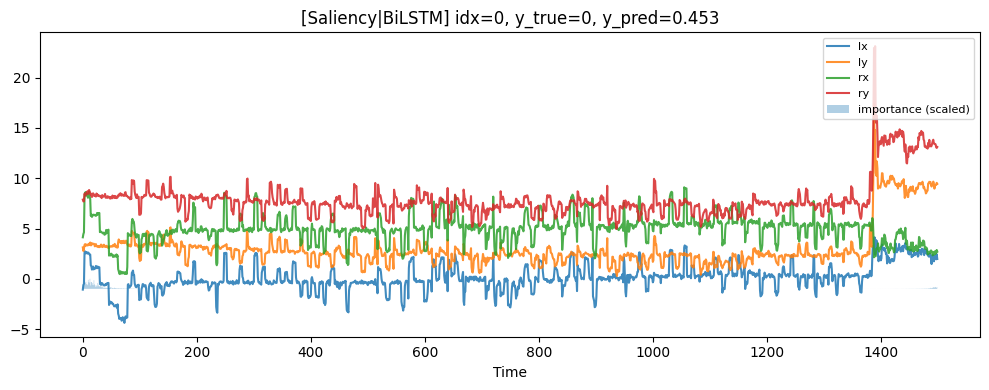

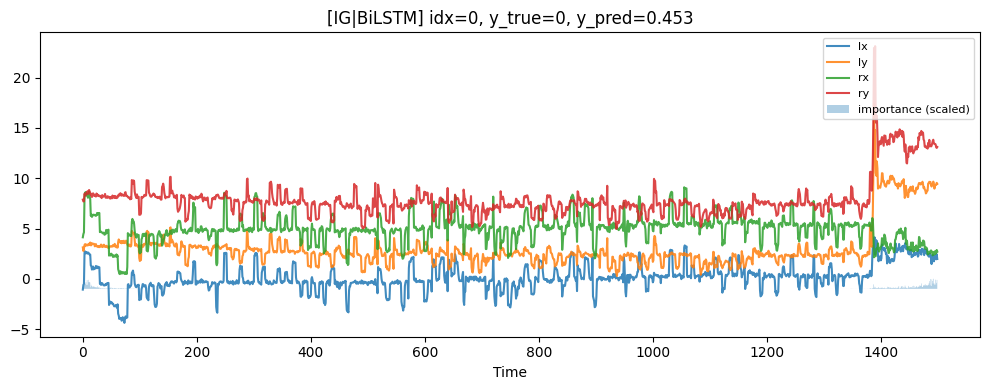

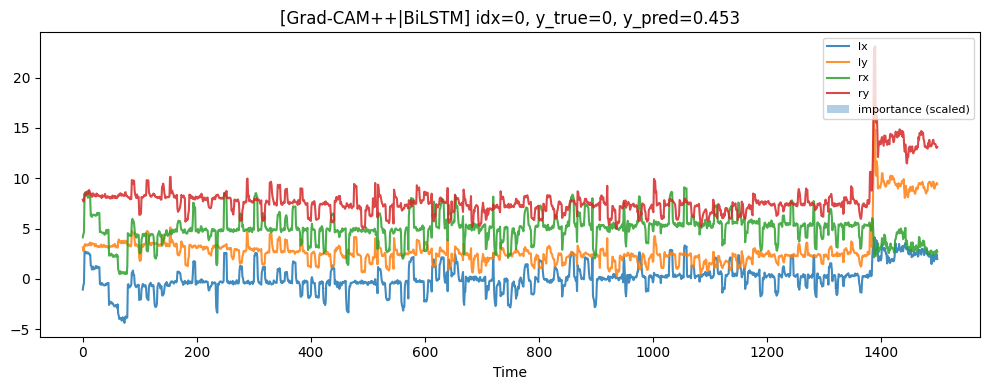

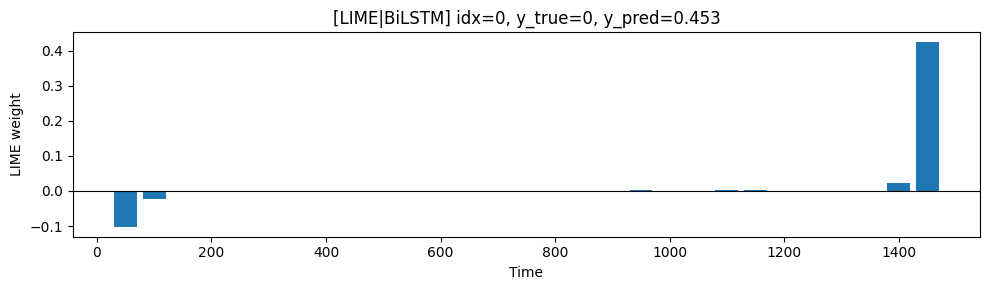

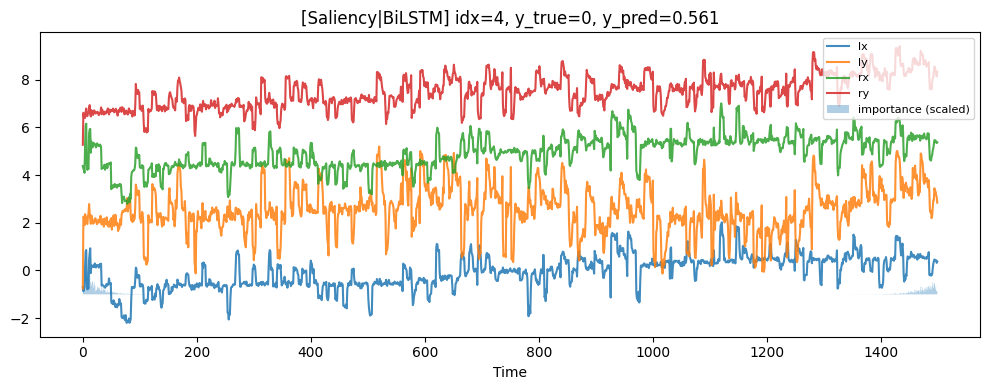

...

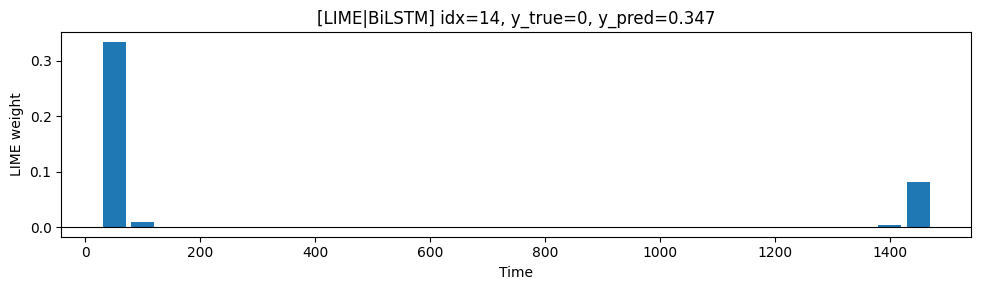

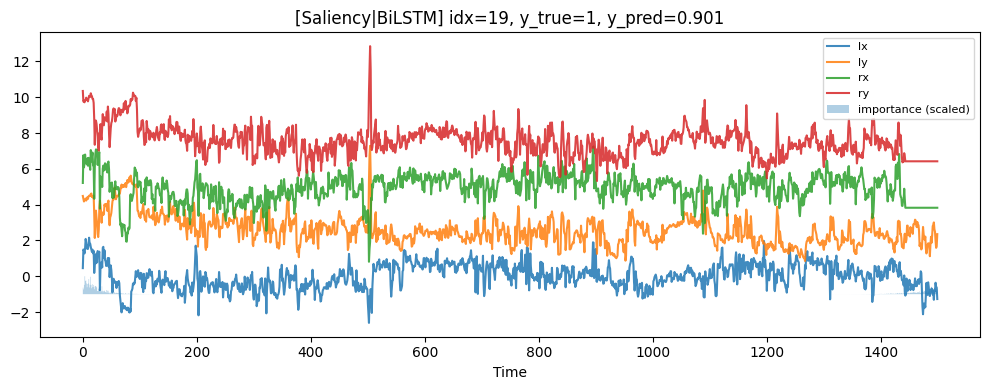

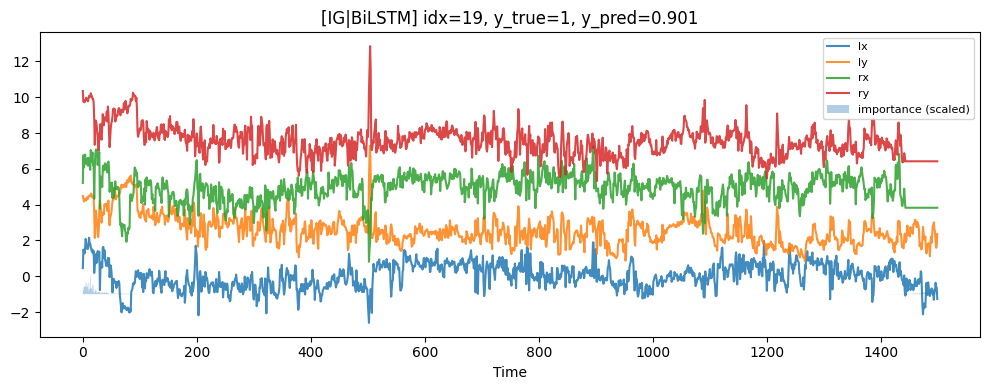

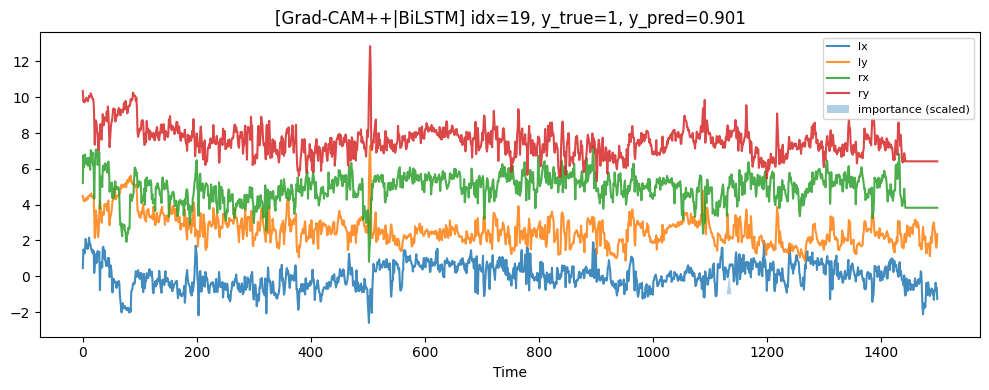

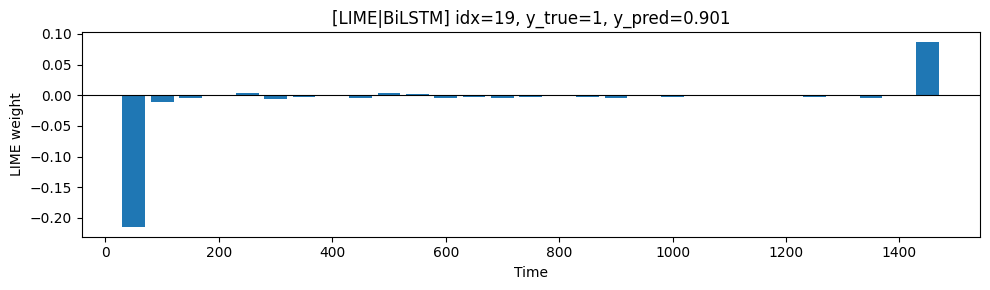

Epoch 1/40
4/4 [==============================] - 5s 1s/step - loss: 0.6996 - accuracy: 0.4815 - val_loss: 0.6971 - val_accuracy: 0.5500
Epoch 2/40
4/4 [==============================] - 3s 705ms/step - loss: 0.6747 - accuracy: 0.6667 - val_loss: 0.6875 - val_accuracy: 0.4500
Epoch 3/40
4/4 [==============================] - 4s 1s/step - loss: 0.6683 - accuracy: 0.5926 - val_loss: 0.6842 - val_accuracy: 0.4500
Epoch 4/40
4/4 [==============================] - 3s 690ms/step - loss: 0.6560 - accuracy: 0.6667 - val_loss: 0.6787 - val_accuracy: 0.4500
Epoch 5/40
4/4 [==============================] - 3s 691ms/step - loss: 0.6441 - accuracy: 0.6852 - val_loss: 0.6700 - val_accuracy: 0.6500
Epoch 6/40
4/4 [==============================] - 4s 1s/step - loss: 0.6349 - accuracy: 0.6852 - val_loss: 0.6624 - val_accuracy: 0.7500
Epoch 7/40
4/4 [==============================] - 3s 669ms/step - loss: 0.6191 - accuracy: 0.7037 - val_loss: 0.6592 - val_accuracy: 0.8000
Epoch 8/40
4/4 [=============

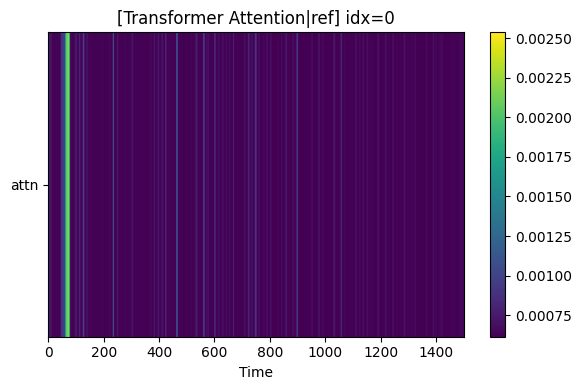

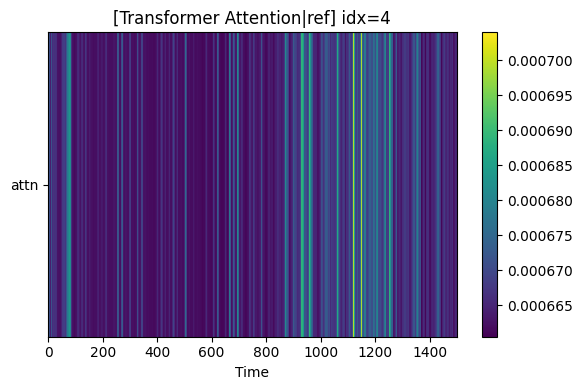

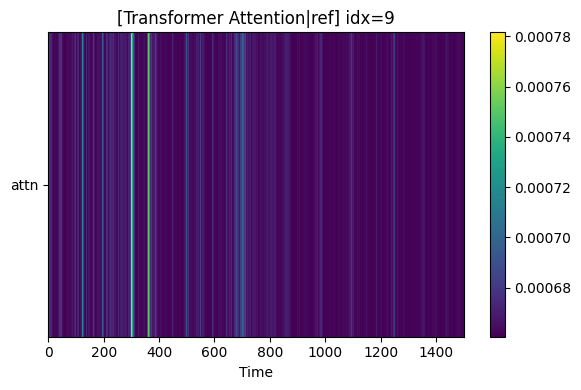

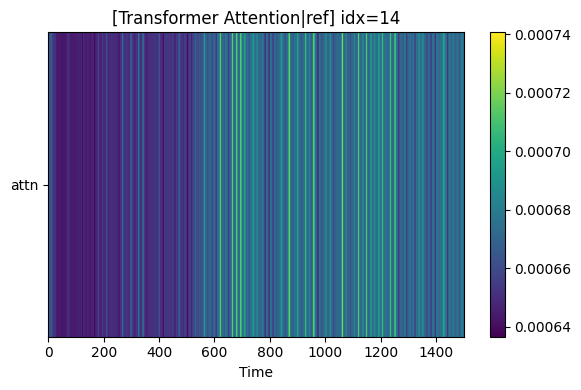

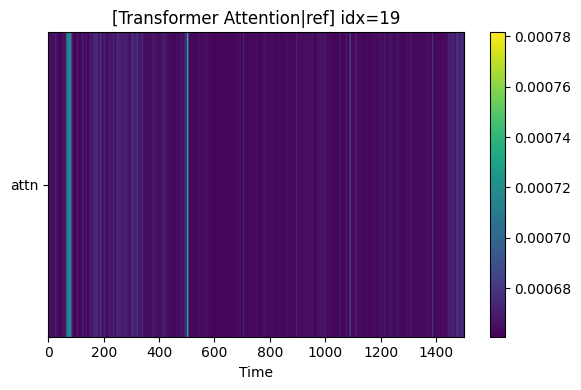

XAI suite (BiLSTM) finished.


In [3]:
"""
XAI suite for CNN+BiLSTM time-series model (standalone).
Includes:
  6.2.1 GradCAM++
  6.2.2 SHAP (external KernelExplainer subprocess; optional)
  6.2.3 Integrated Gradients
  6.2.4 Saliency Maps
  6.2.5 LIME for Time Series (window perturbation)
  6.2.6 (Optional) Tiny Transformer attention for reference

Key fix:
  - Force Eager execution + run_eagerly=True to avoid 'shap_*' gradient registry errors.

Edit and run the __main__ section at the bottom.
"""

import os, sys, time, tempfile, pathlib, shutil, subprocess, argparse, json
from typing import Dict, Tuple, List, Optional

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow.keras import Model, Input, layers, regularizers

# Global reproducibility
SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# CRITICAL FIX: Force eager mode to avoid shap_* gradient registry lookups
tf.config.run_functions_eagerly(True)


# Data utilities

REQUIRED_COLS = ['abs_lx','abs_ly','abs_rx','abs_ry']

def get_participant_id(filename: str) -> str:
    """Assumes '001_0.csv' -> '001'."""
    return os.path.splitext(filename)[0].split('_')[0]

def _linear_resample(x: np.ndarray, target_len: int) -> np.ndarray:
    """Linearly resample (T,C) to target_len to avoid ringing."""
    T, C = x.shape
    if T == target_len:
        return x
    src = np.linspace(0.0, 1.0, T, dtype=np.float32)
    dst = np.linspace(0.0, 1.0, target_len, dtype=np.float32)
    out = np.empty((target_len, C), dtype=x.dtype)
    for c in range(C):
        out[:, c] = np.interp(dst, src, x[:, c])
    return out

def _robust_scale_per_trace(x: np.ndarray, eps: float = 1e-6) -> np.ndarray:
    """Median/IQR scaling per channel."""
    x_scaled = x.copy()
    for c in range(x.shape[1]):
        v = x[:, c]
        med = np.median(v)
        q75, q25 = np.percentile(v, 75), np.percentile(v, 25)
        iqr = max(q75 - q25, eps)
        x_scaled[:, c] = (v - med) / iqr
    return x_scaled

def load_pair_experiment(
    csv_dir: str,
    labels: Tuple[int, int],
    resample_len: int = 1500,
    max_nan_ratio: float = 0.05,
    divide_by_960: bool = True,
    use_robust_scale: bool = True
):
    """
    Load data for (label_a, label_b) with linear interpolation-based resampling.
    Returns:
      X: (N, resample_len, 4), y: (N,), files: list[str]
    """
    X, y, files = [], [], []
    tagA, tagB = f"_{labels[0]}", f"_{labels[1]}"

    for file in sorted(os.listdir(csv_dir)):
        if not file.endswith(".csv"):
            continue
        if (tagA not in file) and (tagB not in file):
            continue

        path = os.path.join(csv_dir, file)
        df = pd.read_csv(path)

        if set(REQUIRED_COLS).issubset(df.columns):
            raw = df[REQUIRED_COLS].astype(np.float32).values
        else:
            raw = df.iloc[:, 1:5].astype(np.float32).values

        nan_ratio = np.isnan(raw).mean()
        if nan_ratio > max_nan_ratio:
            continue

        raw = pd.DataFrame(raw).fillna(method='ffill').fillna(method='bfill').fillna(0.0).values
        if divide_by_960:
            raw = raw / 960.0

        seq = _linear_resample(raw, resample_len)
        if use_robust_scale:
            seq = _robust_scale_per_trace(seq)

        X.append(seq)
        y.append(0 if tagA in file else 1)
        files.append(file)

    X = np.asarray(X, dtype=np.float32)
    y = np.asarray(y, dtype=np.int64)
    print(f"[load_pair_experiment] Labels={labels}, files={len(files)}, shape={X.shape}")
    return X, y, files

def split_by_participant_train_val_test(
    X: np.ndarray,
    y: np.ndarray,
    files: List[str],
    val_size: float = 0.2,
    test_size: float = 0.2,
    random_state: int = SEED
):
    """Participant-wise split into train/val/test."""
    pids = np.array([get_participant_id(f) for f in files])
    uniq = np.array(sorted(list(set(pids))))

    from sklearn.model_selection import train_test_split
    pid_trainval, pid_test = train_test_split(uniq, test_size=test_size, random_state=random_state, shuffle=True)
    pid_train, pid_val = train_test_split(pid_trainval, test_size=val_size/(1.0-test_size),
                                          random_state=random_state, shuffle=True)

    def mask(ids): return np.isin(pids, ids)
    tr_mask, va_mask, te_mask = mask(pid_train), mask(pid_val), mask(pid_test)

    return X[tr_mask], y[tr_mask], X[va_mask], y[va_mask], X[te_mask], y[te_mask], {
        'train_ids': pid_train.tolist(),
        'val_ids': pid_val.tolist(),
        'test_ids': pid_test.tolist(),
    }

def compute_class_weight(y_train: np.ndarray):
    """Optional class_weight for slight imbalance; can be None if not needed."""
    n0 = (y_train == 0).sum()
    n1 = (y_train == 1).sum()
    if min(n0, n1) == 0:
        return None
    w0 = (n0 + n1) / (2.0 * n0)
    w1 = (n0 + n1) / (2.0 * n1)
    return {0: float(w0), 1: float(w1)}

def get_optimizer(lr=3e-4):
    """Use legacy Adam if available to avoid M1 warnings."""
    try:
        return tf.keras.optimizers.legacy.Adam(learning_rate=lr)
    except Exception:
        return tf.keras.optimizers.Adam(learning_rate=lr)


# Model: CNN + BiLSTM

def build_cnn_bilstm(input_shape, l2=1e-4, lstm_units=64) -> Model:
    inp = Input(shape=input_shape, name='input_ts')
    x = layers.Conv1D(64, 7, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x); x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)

    x = layers.Conv1D(128, 5, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x); x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)

    x = layers.Conv1D(128, 3, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv3')(x)
    x = layers.BatchNormalization(name='bn3')(x); x = layers.ReLU(name='conv3_relu')(x)

    x = layers.Bidirectional(layers.LSTM(lstm_units, return_sequences=False), name='bilstm')(x)
    x = layers.Dropout(0.5, name='drop')(x)
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='cnn_bilstm')

def train_bilstm_for_xai(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 60,
    lr: float = 3e-4,
    early_patience: int = 12,
    l2: float = 1e-4,
    lstm_units: int = 64
):
    # Hard reset any shap leftovers (safety)
    for k in list(sys.modules.keys()):
        if k.startswith("shap"):
            sys.modules.pop(k, None)
    tf.keras.backend.clear_session()
    tf.config.run_functions_eagerly(True)

    X, y, files = load_pair_experiment(
        csv_dir, label_pair,
        resample_len=target_len, max_nan_ratio=0.05,
        divide_by_960=True, use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    model = build_cnn_bilstm((target_len, X.shape[-1]), l2=l2, lstm_units=lstm_units)
    model.compile(
        optimizer=get_optimizer(lr),
        loss='binary_crossentropy',
        metrics=['accuracy'],
        run_eagerly=True  # important
    )
    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    class_weight = compute_class_weight(ytr)
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1,
              callbacks=callbacks, class_weight=class_weight)
    return model, (Xtr,ytr,Xva,yva,Xte,yte), files, splits


# XAI: Saliency / IG


def saliency_map(model: Model, x: np.ndarray) -> np.ndarray:
    x_tf = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)
    with tf.GradientTape() as tape:
        tape.watch(x_tf)
        y = model(x_tf, training=False)
    grads = tape.gradient(y, x_tf)  # (1,T,C)
    grads = tf.math.abs(grads)[0].numpy()
    return grads  # (T,C)

def integrated_gradients(model, x: np.ndarray, baseline: Optional[np.ndarray]=None, steps: int = 64) -> np.ndarray:
    if baseline is None:
        baseline = np.zeros_like(x, dtype=np.float32)
    x_tf = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)          # (1,T,C)
    b_tf = tf.convert_to_tensor(baseline[None, ...], dtype=tf.float32)   # (1,T,C)
    alphas = tf.linspace(0.0, 1.0, steps+1)[1:]
    alphas = tf.reshape(alphas, (-1, 1, 1))                               # (steps,1,1)
    path = b_tf + alphas * (x_tf - b_tf)                                  # (steps,T,C)
    with tf.GradientTape() as tape:
        tape.watch(path)
        preds = model(path, training=False)                               # (steps,1)
    grads = tape.gradient(preds, path)                                    # (steps,T,C)
    avg_grads = tf.reduce_mean(grads, axis=0)                              # (T,C)
    ig = tf.math.abs((x_tf - b_tf)[0] * avg_grads).numpy().astype(np.float32)
    return ig  # (T,C)


# XAI: Grad-CAM++

def gradcam_plus_plus_1d_bilstm(model: Model, x: np.ndarray, target_layer_name: Optional[str]=None) -> np.ndarray:
    # auto-detect last Conv1D
    target = None
    if target_layer_name is not None:
        target = model.get_layer(target_layer_name)
    else:
        for l in reversed(model.layers):
            if isinstance(l, layers.Conv1D):
                target = l; break
        if target is None:
            raise ValueError("No Conv1D layer found for Grad-CAM++ in this model.")
    grad_model = tf.keras.Model([model.inputs], [target.output, model.output])

    xt = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)
    with tf.GradientTape(persistent=True) as t1:
        with tf.GradientTape(persistent=True) as t2:
            conv_out, y = grad_model(xt, training=False)          # (1,T',K), (1,1)
            y_c = y[:, 0]
        g1 = t2.gradient(y_c, conv_out)                           # ∂y/∂A
    g2 = t1.gradient(y_c, conv_out)                               # near 2nd order
    del t2

    A  = conv_out.numpy()[0]        # (T',K)
    G1 = g1.numpy()[0]              # (T',K)
    G2 = g2.numpy()[0]              # (T',K)

    eps = 1e-8
    alpha = (G1**2) / np.maximum(2.0*(G1**2) + A*G2, eps)         # (T',K)
    weights = np.sum(alpha * np.maximum(G1, 0.0), axis=0)         # (K,)
    cam = np.maximum(np.dot(A, weights), 0.0)                     # (T',)

    if cam.max() > 0: cam = cam / (cam.max() + 1e-8)
    T_in = x.shape[0]
    if cam.shape[0] != T_in:
        tprime = np.arange(cam.shape[0], dtype=np.float32)
        tt = np.linspace(0, cam.shape[0]-1, num=T_in, dtype=np.float32)
        cam = np.interp(tt, tprime, cam)
    return cam.astype(np.float32)  # (T,)


# XAI: LIME (window)

def lime_timeseries_explain(model: Model, x: np.ndarray, window=100, stride=50, n_samples=600, fill=0.0):
    T, C = x.shape
    wins = []
    t0 = 0
    while t0 < T:
        t1 = min(t0 + window, T)
        wins.append((t0, t1))
        if t1 == T: break
        t0 += stride
    W = len(wins)

    y0 = float(model.predict(x[None, ...], verbose=0).ravel()[0])
    rng = np.random.default_rng(SEED)
    Z = rng.integers(0, 2, size=(n_samples, W))
    y = np.zeros((n_samples,), dtype=np.float32)
    x_fill = np.full_like(x, fill, dtype=np.float32)

    for i in range(n_samples):
        xi = x.copy()
        for j, flag in enumerate(Z[i]):
            if flag == 1:
                a, b = wins[j]; xi[a:b, :] = x_fill[a:b, :]
        y[i] = float(model.predict(xi[None, ...], verbose=0).ravel()[0])

    lam = 1e-3
    A = Z.astype(np.float32)
    b = (y - y0).astype(np.float32)
    AtA = A.T @ A + lam * np.eye(W, dtype=np.float32)
    Atb = A.T @ b
    beta = np.linalg.solve(AtA, Atb)  # (W,)
    centers = np.array([(a+b)//2 for (a,b) in wins], dtype=int)
    return centers, beta


# Optional: Tiny Transformer for attention viz

def build_tiny_transformer(input_shape, n_heads=4, d_model=64, d_ff=128, n_blocks=1, dropout=0.1):
    T, C = input_shape
    inp = Input(shape=(T, C))
    x = layers.Dense(d_model)(inp)
    attn_weights_all = []
    for _ in range(n_blocks):
        mha = layers.MultiHeadAttention(num_heads=n_heads, key_dim=d_model//n_heads, output_shape=d_model)
        x_attn, attn_scores = mha(x, x, return_attention_scores=True)
        attn_weights_all.append(attn_scores)      # (B, heads, T, T)
        x = layers.Add()([x, layers.Dropout(dropout)(x_attn)])
        x = layers.LayerNormalization()(x)
        f = layers.Dense(d_ff, activation='relu')(x)
        f = layers.Dense(d_model)(f)
        x = layers.Add()([x, layers.Dropout(dropout)(f)])
        x = layers.LayerNormalization()(x)
    x = layers.GlobalAveragePooling1D()(x)
    x = layers.Dense(64, activation='relu')(x)
    out = layers.Dense(1, activation='sigmoid')(x)
    model = Model(inp, out)
    attn_model = Model(inp, attn_weights_all)
    return model, attn_model


# Plots

def plot_timeseries_with_heat(x: np.ndarray, heat: np.ndarray, title: str = "", channel_names=('lx','ly','rx','ry')):
    plt.figure(figsize=(10,4))
    T, C = x.shape
    shift = 0.0
    for c in range(C):
        plt.plot(x[:, c] + shift, alpha=0.85, label=channel_names[c] if c < len(channel_names) else f'ch{c}')
        shift += 2.5
    if heat.ndim == 2:
        heat_1d = np.abs(heat).mean(axis=1)
    else:
        heat_1d = heat
    heat_scaled = heat_1d / (np.max(heat_1d) + 1e-8)
    plt.fill_between(np.arange(T), -1.0, -1.0 + heat_scaled, alpha=0.35, step='pre', label='importance (scaled)')
    plt.title(title); plt.xlabel("Time"); plt.legend(loc='upper right', fontsize=8)
    plt.tight_layout(); plt.show()

def plot_bar_over_windows(centers: np.ndarray, weights: np.ndarray, title: str):
    plt.figure(figsize=(10,3))
    width = max(1, int(0.8*(centers[1]-centers[0]))) if len(centers)>1 else 5
    plt.bar(centers, weights, width=width)
    plt.axhline(0, color='k', linewidth=0.8)
    plt.title(title); plt.xlabel("Time"); plt.ylabel("LIME weight")
    plt.tight_layout(); plt.show()

def plot_attn_matrix(attn, head: int = None, title: str = "Attention"):
    A = np.array(attn)
    plt.figure(figsize=(6, 4))
    if A.ndim == 3:               # (H, T, T) or (H, T)
        if A.shape[1] == A.shape[2]:
            Ashow = A[head] if head is not None else A.mean(axis=0)
            plt.imshow(Ashow, aspect='auto', origin='lower'); plt.colorbar()
            plt.xlabel("Key time"); plt.ylabel("Query time")
        else:
            Avec = A[head] if head is not None else A.mean(axis=0)
            plt.imshow(Avec[None, :], aspect='auto', origin='lower'); plt.colorbar()
            plt.yticks([0], ['attn']); plt.xlabel("Time")
    elif A.ndim == 2:
        if A.shape[0] == A.shape[1]:
            plt.imshow(A, aspect='auto', origin='lower'); plt.colorbar()
            plt.xlabel("Key time"); plt.ylabel("Query time")
        else:
            Avec = A.mean(axis=0)
            plt.imshow(Avec[None, :], aspect='auto', origin='lower'); plt.colorbar()
            plt.yticks([0], ['attn']); plt.xlabel("Time")
    elif A.ndim == 1:
        plt.imshow(A[None, :], aspect='auto', origin='lower'); plt.colorbar()
        plt.yticks([0], ['attn']); plt.xlabel("Time")
    else:
        raise ValueError(f"Unsupported attention shape: {A.shape}")
    plt.title(title); plt.tight_layout(); plt.show()


# External KernelSHAP worker code (as string)

SHAP_WORKER_CODE = r"""
import os, sys, argparse, numpy as np
import tensorflow as tf

def main():
    p = argparse.ArgumentParser()
    p.add_argument('--model', required=True)
    p.add_argument('--xbg', required=True)
    p.add_argument('--xbatch', required=True)
    p.add_argument('--out', required=True)
    p.add_argument('--nsamples', type=int, default=120)
    args = p.parse_args()

    # Lazy import shap here to keep main proc clean
    import shap

    tf.config.run_functions_eagerly(True)
    model = tf.keras.models.load_model(args.model, compile=False)

    Xbg = np.load(args.xbg).astype(np.float32)   # (Nb,T,C)
    Xbt = np.load(args.xbatch).astype(np.float32)  # (Ns,T,C)
    Nb, T, C = Xbg.shape
    Ns = Xbt.shape[0]

    bg_flat = Xbg.reshape(Nb, T*C)
    xs_flat = Xbt.reshape(Ns, T*C)

    def pred_flat(z_flat):
        z = z_flat.reshape((-1, T, C)).astype(np.float32)
        return model.predict(z, verbose=0).reshape(-1, 1)

    explainer = shap.KernelExplainer(pred_flat, bg_flat)
    sv_flat = explainer.shap_values(xs_flat, nsamples=args.nsamples)
    sv_flat = sv_flat[0] if isinstance(sv_flat, list) else sv_flat
    sv = sv_flat.reshape(Ns, T, C).astype(np.float32)
    np.save(args.out, sv)

if __name__ == '__main__':
    main()
"""

def run_kernel_shap_external(model: tf.keras.Model,
                             X_background: np.ndarray,   # (N_bg,T,C)
                             X_batch: np.ndarray,        # (N_s,T,C)
                             nsamples: int = 120,
                             workdir: Optional[str] = None) -> Optional[np.ndarray]:
    """
    Run KernelExplainer in a clean subprocess to avoid shap_* gradient pollution.
    Returns sv: (N_s, T, C); or None on failure.
    """
    cleanup = False
    if workdir is None:
        workdir = tempfile.mkdtemp(prefix="shap_ext_")
        cleanup = True
    workdir = pathlib.Path(workdir)

    model_path = workdir / "bilstm_cnn.h5"
    xbg_path   = workdir / "x_bg.npy"
    xbat_path  = workdir / "x_batch.npy"
    out_path   = workdir / "shap_values.npy"
    worker_py  = workdir / "shap_worker.py"

    # Save model and arrays
    model.save(str(model_path))
    np.save(str(xbg_path), X_background.astype(np.float32))
    np.save(str(xbat_path), X_batch.astype(np.float32))
    worker_py.write_text(SHAP_WORKER_CODE, encoding="utf-8")

    cmd = [sys.executable, str(worker_py),
           "--model", str(model_path),
           "--xbg", str(xbg_path),
           "--xbatch", str(xbat_path),
           "--out", str(out_path),
           "--nsamples", str(int(nsamples))]
    try:
        cp = subprocess.run(cmd, check=True, capture_output=True, text=True)
        sv = np.load(str(out_path))
        return sv
    except subprocess.CalledProcessError as e:
        print("[SHAP-External] Subprocess failed:", e)
        print("STDOUT:\n", e.stdout)
        print("STDERR:\n", e.stderr)
        return None
    finally:
        if cleanup:
            shutil.rmtree(workdir, ignore_errors=True)


# One-click XAI runner

def run_xai_suite_bilstm(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    sample_source: str = 'val',  # 'val' or 'test'
    n_samples: int = 5,
    run_transformer: bool = True,
    l2: float = 1e-4,
    lstm_units: int = 64,
    enable_shap: bool = False,       # default OFF; use external subprocess when ON
    shap_nsamples: int = 120
):
    # Train the model
    model, (Xtr,ytr,Xva,yva,Xte,yte), files, splits = train_bilstm_for_xai(
        csv_dir, label_pair, target_len=target_len, l2=l2, lstm_units=lstm_units
    )
    Xs, ys = (Xva, yva) if sample_source == 'val' else (Xte, yte)
    idxs = np.linspace(0, len(ys)-1, num=min(n_samples, len(ys)), dtype=int)

    # 4 non-SHAP methods
    for i in idxs:
        x = Xs[i]; y_true = int(ys[i])
        y_pred = float(model.predict(x[None,...], verbose=0).ravel()[0])

        # Saliency
        sal = saliency_map(model, x)
        plot_timeseries_with_heat(x, sal.mean(axis=1), title=f"[Saliency|BiLSTM] idx={i}, y_true={y_true}, y_pred={y_pred:.3f}")

        # IG
        ig = integrated_gradients(model, x, baseline=np.zeros_like(x), steps=64)
        plot_timeseries_with_heat(x, ig.mean(axis=1), title=f"[IG|BiLSTM] idx={i}, y_true={y_true}, y_pred={y_pred:.3f}")

        # Grad-CAM++
        campp = gradcam_plus_plus_1d_bilstm(model, x, target_layer_name=None)
        plot_timeseries_with_heat(x, campp, title=f"[Grad-CAM++|BiLSTM] idx={i}, y_true={y_true}, y_pred={y_pred:.3f}")

        # LIME
        centers, beta = lime_timeseries_explain(model, x, window=100, stride=50, n_samples=600, fill=0.0)
        plot_bar_over_windows(centers, beta, title=f"[LIME|BiLSTM] idx={i}, y_true={y_true}, y_pred={y_pred:.3f}")

    # Optional: SHAP via external process
    if enable_shap:
        print("[INFO] Running SHAP (KernelExplainer) in external subprocess...")
        Xbg = Xtr[: min(40, len(Xtr))]
        Xbatch = Xs[idxs]
        sv_batch = run_kernel_shap_external(model, Xbg, Xbatch, nsamples=shap_nsamples)
        if sv_batch is not None:
            for k, i in enumerate(idxs):
                x = Xs[i]
                y_pred = float(model.predict(x[None,...], verbose=0).ravel()[0])
                sv_t = np.abs(sv_batch[k]).mean(axis=1)  # (T,)
                plot_timeseries_with_heat(x, sv_t, title=f"[SHAP|Kernel|BiLSTM] idx={i}, y_true={int(ys[i])}, y_pred={y_pred:.3f}")
        else:
            print("[WARN] External SHAP failed; skipping SHAP plots.")

    # Optional: Transformer attention reference
    if run_transformer:
        T, C = Xtr.shape[1], Xtr.shape[2]
        tmodel, attn_model = build_tiny_transformer((T, C), n_heads=4, d_model=64, d_ff=128, n_blocks=1, dropout=0.1)
        tmodel.compile(optimizer=get_optimizer(3e-4), loss='binary_crossentropy', metrics=['accuracy'], run_eagerly=True)
        tmodel.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=40, batch_size=16, verbose=1,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=8, restore_best_weights=True)])
        for i in idxs:
            x = Xs[i]
            attn_list = attn_model.predict(x[None,...], verbose=0)  # list of (1,heads,T,T)
            A = attn_list[0][0]   # (heads,T,T)
            A_mean = A.mean(axis=0)
            plot_attn_matrix(A_mean, title=f"[Transformer Attention|ref] idx={i}")

    print("XAI suite (BiLSTM) finished.")


# __main__

if __name__ == "__main__":
    DATA_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"  # or repeats
    PAIR = (0, 2)

    run_xai_suite_bilstm(
        csv_dir=DATA_DIR,
        label_pair=PAIR,
        target_len=1500,
        sample_source='val',    # 'val' or 'test'
        n_samples=5,
        run_transformer=True,
        l2=1e-4,
        lstm_units=64,
        enable_shap=False,      # keep False to avoid external SHAP unless needed
        shap_nsamples=120
    )


[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
Epoch 1/60


/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 3s 723ms/step - loss: 0.6656 - accuracy: 0.6852 - val_loss: 0.7020 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 3s 747ms/step - loss: 0.5549 - accuracy: 0.7963 - val_loss: 0.6779 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 3s 741ms/step - loss: 0.4720 - accuracy: 0.8148 - val_loss: 0.6549 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 3s 761ms/step - loss: 0.3950 - accuracy: 0.8704 - val_loss: 0.6361 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 3s 746ms/step - loss: 0.3889 - accuracy: 0.8889 - val_loss: 0.6207 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 6/60
4/4 [==============================] - 3s 703ms/step - loss: 0.2982 - accuracy: 0.9259 - val_loss: 0.6087 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 7/60
4/4 [==============================] - 3s 719ms/step - los

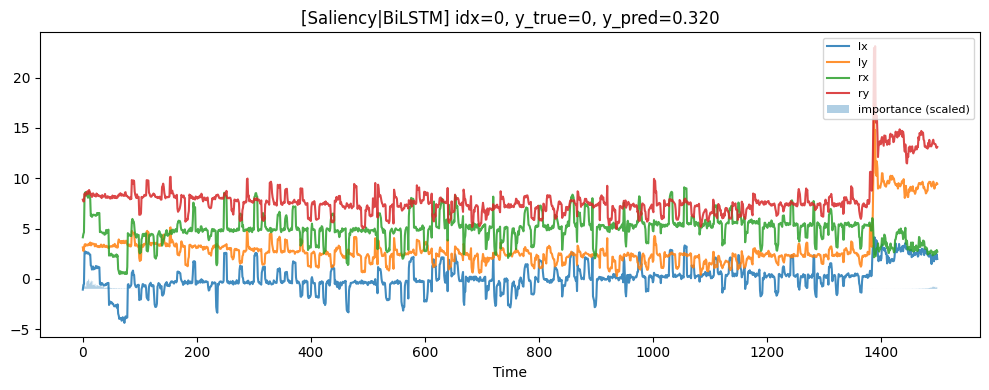

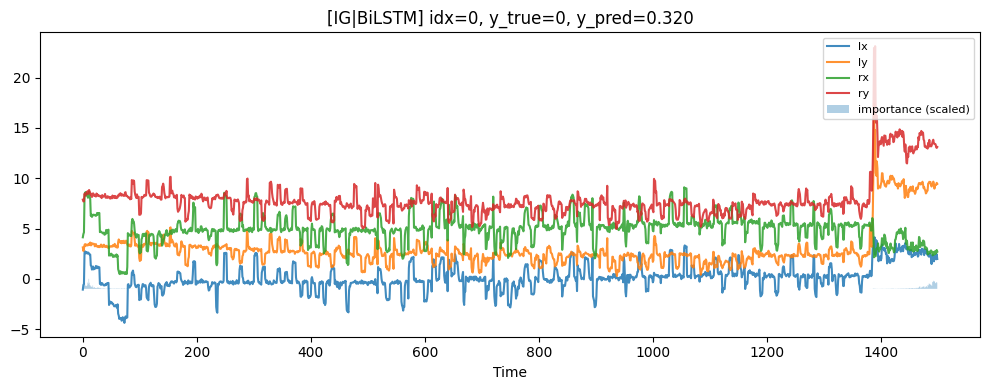

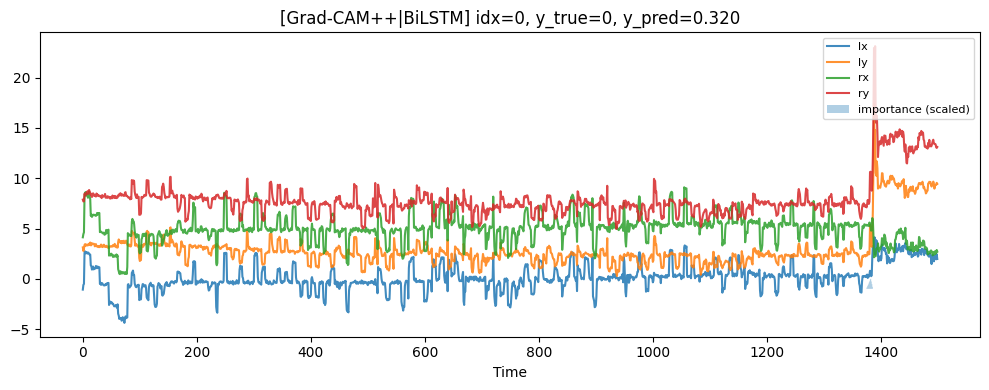

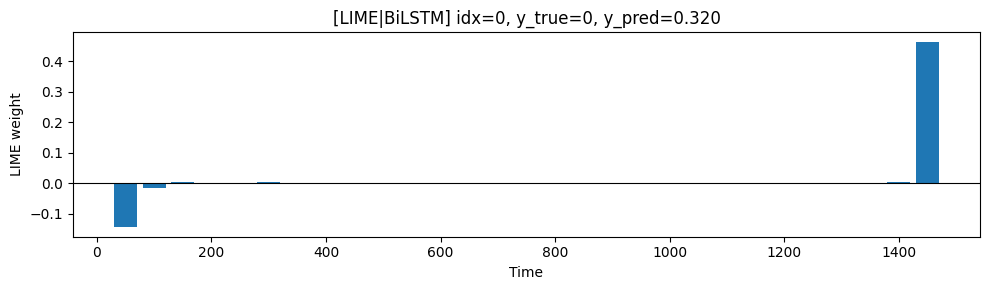

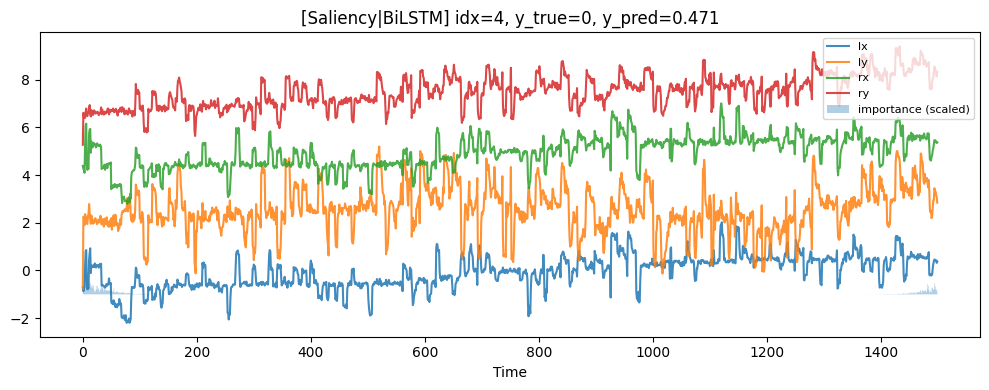

...

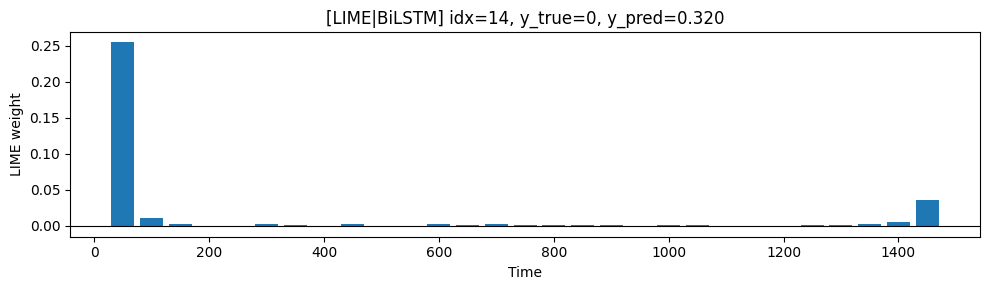

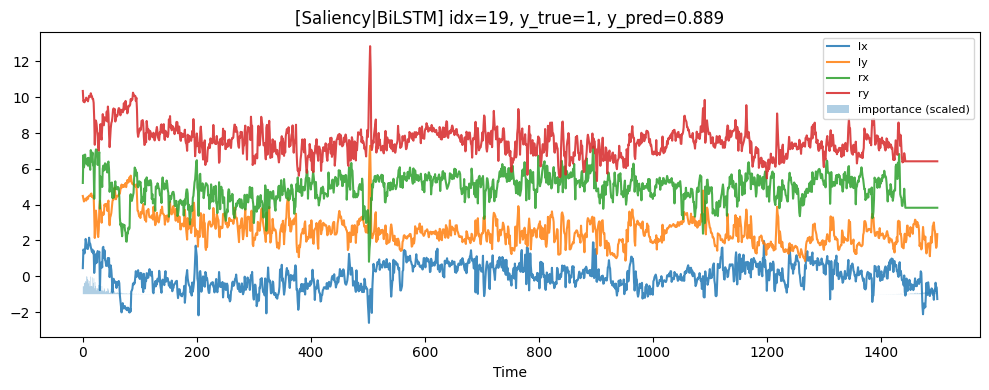

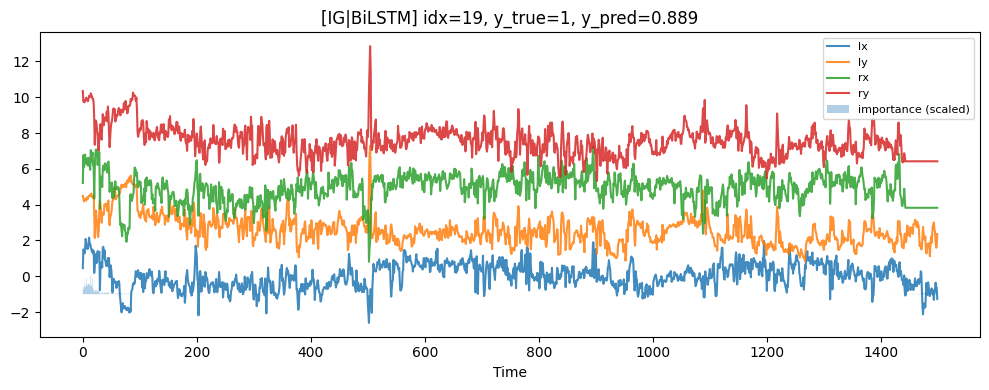

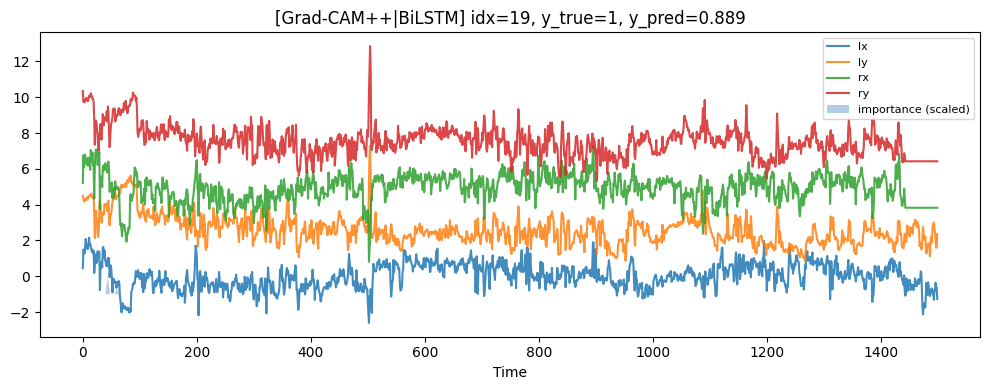

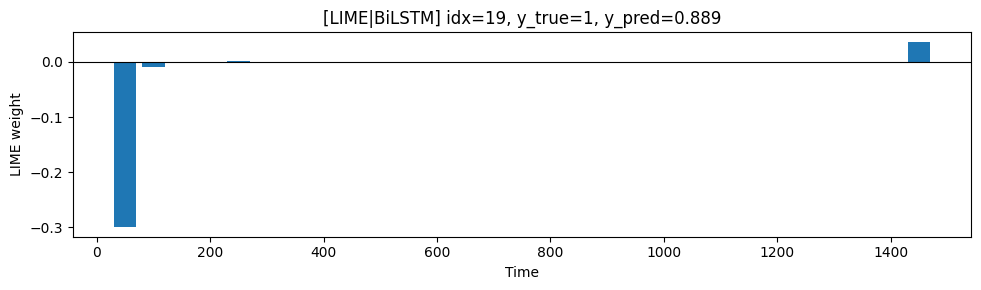

[INFO] Running SHAP (KernelExplainer) in external subprocess...


/Users/wukehui/anaconda3/lib/python3.11/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


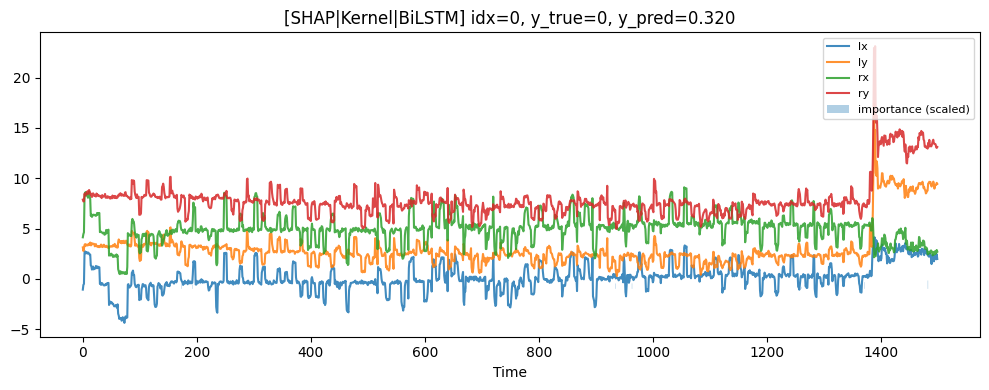

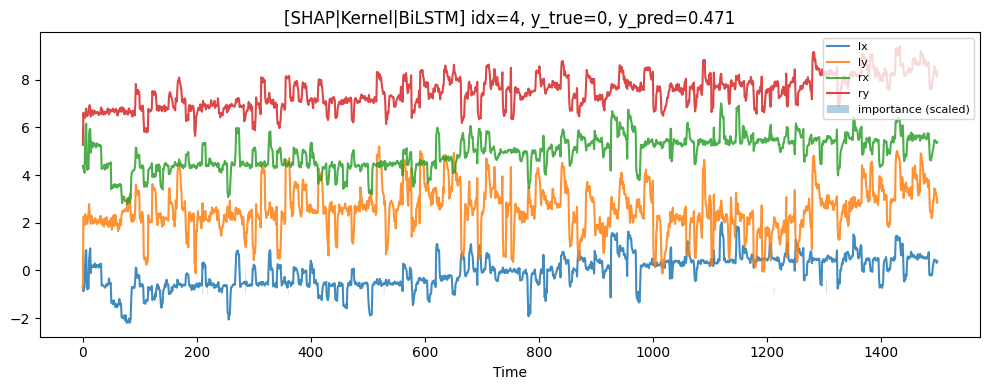

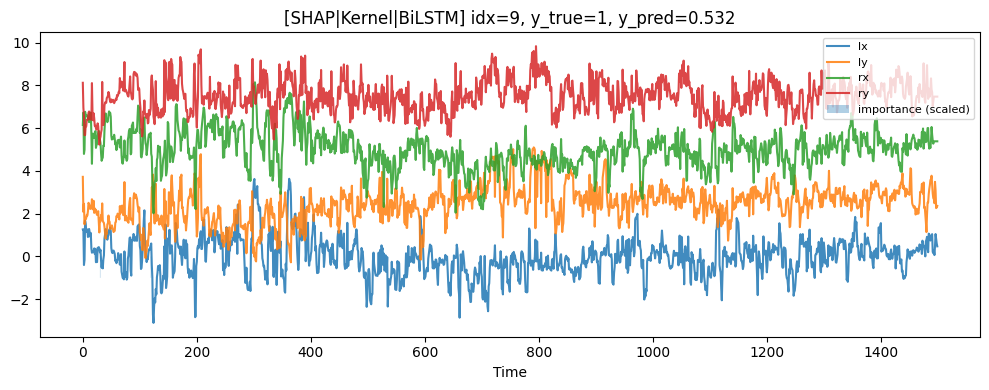

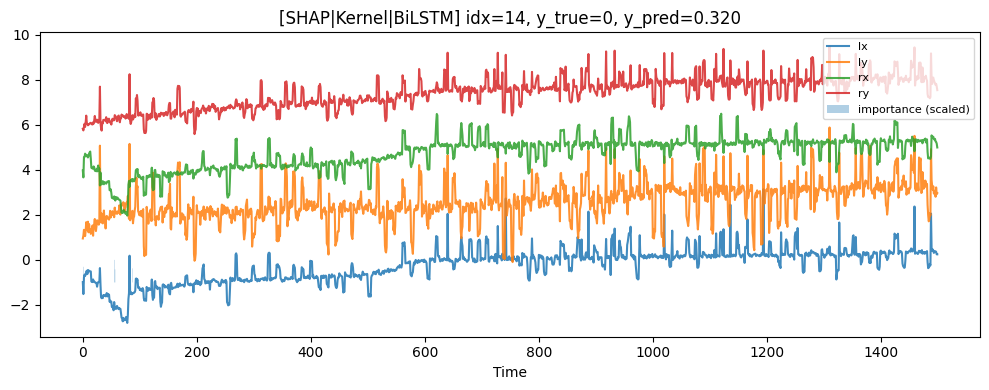

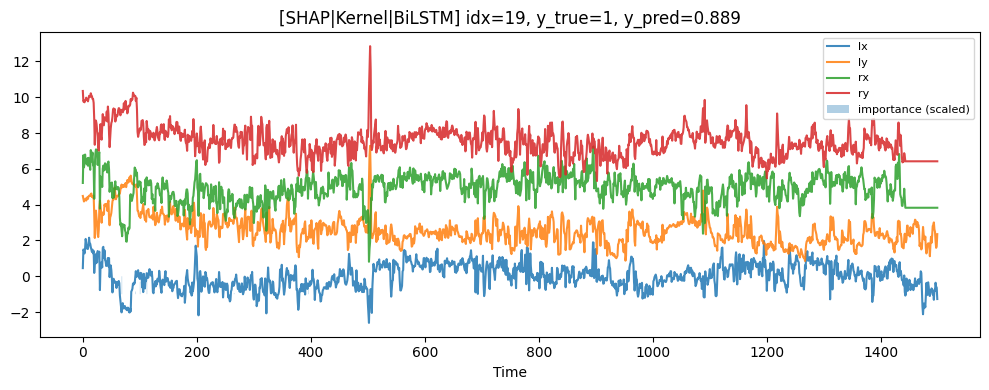

Epoch 1/40
4/4 [==============================] - 5s 1s/step - loss: 0.6885 - accuracy: 0.5741 - val_loss: 0.6730 - val_accuracy: 0.7500
Epoch 2/40
4/4 [==============================] - 4s 1s/step - loss: 0.6738 - accuracy: 0.6481 - val_loss: 0.6678 - val_accuracy: 0.5500
Epoch 3/40
4/4 [==============================] - 4s 1s/step - loss: 0.6663 - accuracy: 0.7037 - val_loss: 0.6612 - val_accuracy: 0.6000
Epoch 4/40
4/4 [==============================] - 4s 1s/step - loss: 0.6535 - accuracy: 0.7037 - val_loss: 0.6536 - val_accuracy: 0.8000
Epoch 5/40
4/4 [==============================] - 4s 984ms/step - loss: 0.6438 - accuracy: 0.7407 - val_loss: 0.6454 - val_accuracy: 0.8000
Epoch 6/40
4/4 [==============================] - 4s 1s/step - loss: 0.6370 - accuracy: 0.7593 - val_loss: 0.6371 - val_accuracy: 0.8000
Epoch 7/40
4/4 [==============================] - 4s 993ms/step - loss: 0.6240 - accuracy: 0.7407 - val_loss: 0.6318 - val_accuracy: 0.8000
Epoch 8/40
4/4 [===================

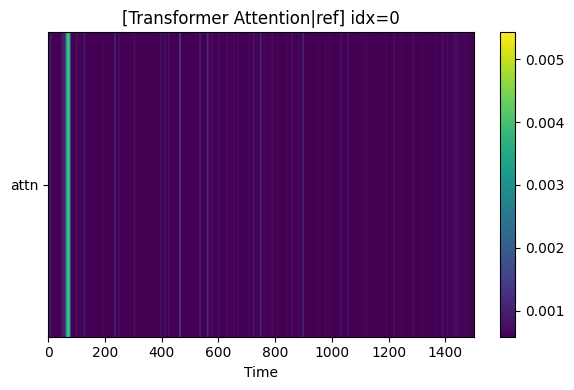

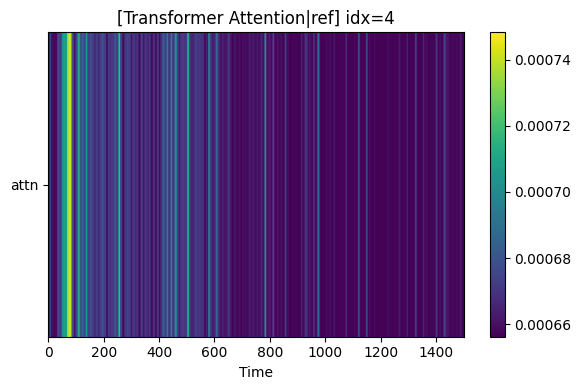

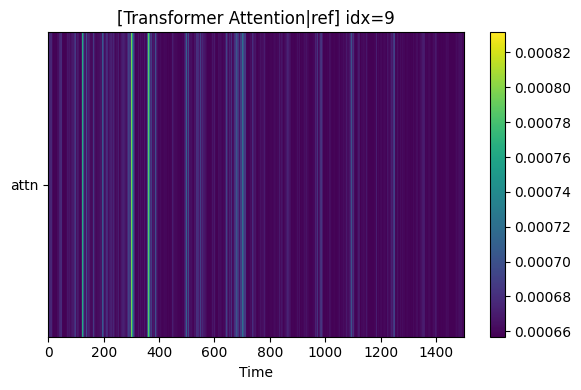

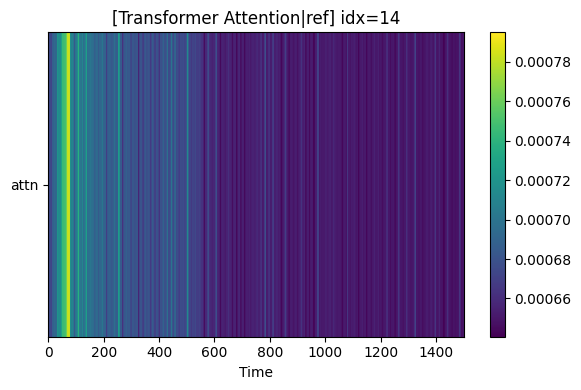

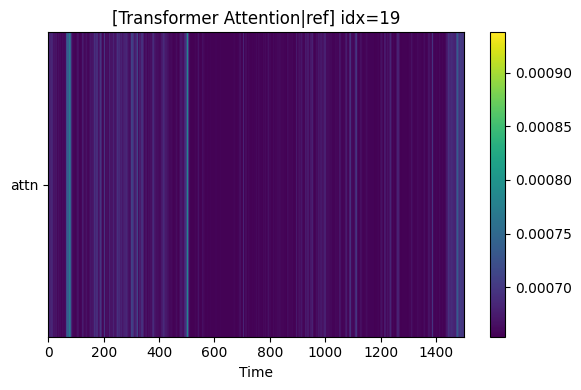

XAI suite (BiLSTM) finished.


In [5]:
run_xai_suite_bilstm(
    csv_dir='/Users/wukehui/Desktop/data science project/project/data/first_trials',
    label_pair=(0,2),
    target_len=1500,
    sample_source='val',
    n_samples=5,
    run_transformer=True,
    l2=1e-4,
    lstm_units=64,
    enable_shap=True,
    shap_nsamples=120
)


cnn+bilstm: feature construction

In [6]:
# Feature construction (same as before)
import numpy as np
from typing import Tuple
import time
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.metrics import classification_report

def _moving_average(x: np.ndarray, k: int = 5) -> np.ndarray:
    if k <= 1: 
        return x
    pad = k // 2
    xp = np.pad(x, (pad, pad), mode='edge')
    kernel = np.ones(k, dtype=np.float32) / float(k)
    return np.convolve(xp, kernel, mode='valid')

def _diff(x: np.ndarray) -> np.ndarray:
    return np.diff(x, prepend=x[:1])

def _range(x: np.ndarray) -> float:
    return float(np.max(x) - np.min(x))

def augment_dynamic_channels(X: np.ndarray, smooth_k: int = 5) -> np.ndarray:
    """
    Input: X (N, T, 4) [abs_lx, abs_ly, abs_rx, abs_ry] (robustly scaled)
    Output:  X_aug (N, T, C_aug)；C_aug=13
    """
    N, T, C = X.shape
    assert C == 4, "expect 4 channels: [abs_lx, abs_ly, abs_rx, abs_ry]"
    out = []

    for i in range(N):
        seq = X[i]              # (T,4)
        lx, ly, rx, ry = seq[:,0], seq[:,1], seq[:,2], seq[:,3]

        # a) velocity magnitude per eye
        dlx, dly = _diff(lx), _diff(ly)
        drx, dry = _diff(rx), _diff(ry)
        vel_L = np.sqrt(dlx**2 + dly**2)
        vel_R = np.sqrt(drx**2 + dry**2)

        # b) speed: diff(smooth(x)) for each raw channel
        slx = _moving_average(lx, smooth_k)
        sly = _moving_average(ly, smooth_k)
        srx = _moving_average(rx, smooth_k)
        sry = _moving_average(ry, smooth_k)
        sp_lx = _diff(slx)
        sp_ly = _diff(sly)
        sp_rx = _diff(srx)
        sp_ry = _diff(sry)

        # c) left-right difference (per-axis + magnitude)
        d_x = np.abs(lx - rx)
        d_y = np.abs(ly - ry)
        d_mag = np.sqrt(d_x**2 + d_y**2)

        x_aug = np.stack([
            lx, ly, rx, ry,
            vel_L, vel_R,
            sp_lx, sp_ly, sp_rx, sp_ry,
            d_x, d_y, d_mag
        ], axis=1)  # (T, 13)
        out.append(x_aug.astype(np.float32))

    return np.asarray(out, dtype=np.float32)  # (N, T, 13)

def compute_global_stats(X_aug: np.ndarray) -> np.ndarray:
    """
    Compute statistical summaries for each channel: mean, std, range -> (N, C_aug*3)
    """
    N, T, C = X_aug.shape
    means = X_aug.mean(axis=1)                    # (N, C)
    stds  = X_aug.std(axis=1)                     # (N, C)
    rngs  = (X_aug.max(axis=1) - X_aug.min(axis=1))  # (N, C)
    F = np.concatenate([means, stds, rngs], axis=1)  # (N, 3*C)
    F = (F - F.mean(axis=0, keepdims=True)) / (F.std(axis=0, keepdims=True) + 1e-8)
    return F.astype(np.float32)

# CNN+BiLSTM backbone (sequence branch)
from tensorflow.keras import regularizers

def build_cnn_bilstm_backbone(
    input_shape,            # (T, C_aug)
    l2: float = 1e-4,
    lstm_units: int = 64,
    pooling: str = "gap"    # "gap" | "last" | "attn"
) -> Model:
    """
    Conv1D×3 -> BiLSTM -> pooling -> seq feature vector
    pooling:
      - "gap": GlobalAveragePooling1D over time (default robust)
      - "last": Directly take the last step output of BiLSTM
      - "attn": Simple attention pooling (learnable weights)
    """
    inp = Input(shape=input_shape, name='ts_in')

    x = layers.Conv1D(64, 7, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x); x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)

    x = layers.Conv1D(128, 5, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x); x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)

    x = layers.Conv1D(128, 3, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv3')(x)
    x = layers.BatchNormalization(name='bn3')(x); x = layers.ReLU(name='conv3_relu')(x)

    # BiLSTM：Here we use return_sequences=True and then do pooling
    x = layers.Bidirectional(layers.LSTM(lstm_units, return_sequences=True), name='bilstm')(x)

    if pooling == "gap":
        feat = layers.GlobalAveragePooling1D(name='ts_gap')(x)
    elif pooling == "last":
        feat = layers.Lambda(lambda t: t[:, -1, :], name='ts_last')(x)
    elif pooling == "attn":
        # Simple attention pooling：score = softmax(W*h_t)；feat = Σ α_t h_t
        score = layers.Dense(1, use_bias=False, name='attn_score')(x)         # (B,T,1)
        alpha = layers.Softmax(axis=1, name='attn_alpha')(score)              # (B,T,1)
        feat = layers.Lambda(lambda z: tf.reduce_sum(z[0]*z[1], axis=1),
                             name='attn_pool')([x, alpha])                    # (B,2*lstm_units)
    else:
        raise ValueError("pooling must be 'gap'|'last'|'attn'")

    return Model(inp, feat, name='cnn_bilstm_backbone')

# Hybrid model (CNN+BiLSTM seq branch + stats branch)
def build_cnn_bilstm_hybrid_model(
    ts_input_shape,
    n_stats: int,
    l2: float = 1e-4,
    lstm_units: int = 64,
    dropout: float = 0.5,
    pooling: str = "gap"
) -> Model:
    # Timing Branch
    backbone = build_cnn_bilstm_backbone(ts_input_shape, l2=l2, lstm_units=lstm_units, pooling=pooling)
    ts_inp = backbone.input
    ts_feat = backbone.output

    # Statistics Branch
    st_inp = Input(shape=(n_stats,), name='stat_in')
    s = layers.Dense(64, activation='relu', name='stat_fc1')(st_inp)
    s = layers.Dropout(dropout, name='stat_drop')(s)

    # Fusion
    z = layers.Concatenate(name='fusion')([ts_feat, s])
    z = layers.Dense(64, activation='relu', name='fc')(z)
    z = layers.Dropout(dropout, name='drop')(z)
    out = layers.Dense(1, activation='sigmoid', name='logit')(z)
    return Model([ts_inp, st_inp], out, name='cnn_bilstm_hybrid')

# Runner (drop-in, same API)
def run_experiment_with_features_bilstm(
    csv_dir: str,
    label_pair: Tuple[int, int],
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    smooth_k: int = 5,
    l2: float = 1e-4,
    lstm_units: int = 64,
    pooling: str = "gap"   # "gap" | "last" | "attn"
):
    # 1) Load & By Subject
    X, y, files = load_pair_experiment(
        csv_dir, label_pair, resample_len=target_len,
        max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )

    # 2) Dynamic Channel Enhancement + Statistics
    Xtr_aug = augment_dynamic_channels(Xtr, smooth_k=smooth_k)
    Xva_aug = augment_dynamic_channels(Xva, smooth_k=smooth_k)
    Xte_aug = augment_dynamic_channels(Xte, smooth_k=smooth_k)

    Ftr = compute_global_stats(Xtr_aug)
    Fva = compute_global_stats(Xva_aug)
    Fte = compute_global_stats(Xte_aug)

    # 3) Model (CNN+BiLSTM temporal branch)
    model = build_cnn_bilstm_hybrid_model(
        ts_input_shape=(target_len, Xtr_aug.shape[-1]),
        n_stats=Ftr.shape[1],
        l2=l2,
        lstm_units=lstm_units,
        dropout=0.5,
        pooling=pooling
    )
    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])

    callbacks = [
        tf.keras.callbacks.EarlyStopping(
            monitor='val_loss', patience=early_patience, restore_best_weights=True
        ),
        tf.keras.callbacks.ReduceLROnPlateau(
            monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1
        ),
        tf.keras.callbacks.CSVLogger(f'train_log_feat_bilstm_{label_pair[0]}_{label_pair[1]}.csv', append=False)
    ]
    class_weight = compute_class_weight(ytr)

    # 4) Train
    t0 = time.perf_counter()
    history = model.fit(
        [Xtr_aug, Ftr], ytr,
        validation_data=([Xva_aug, Fva], yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=1,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()
    print(f"[Time] Pair {label_pair} (+features, BiLSTM): training wall-clock {t1 - t0:.2f}s")

    # 5) Test Evaluation
    yprob = model.predict([Xte_aug, Fte], batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    report = classification_report(yte, ypred, digits=4)
    print(f"\n[TEST] Pair {label_pair} (+features, BiLSTM) classification report:\n{report}")

    return {
        'label_pair': label_pair,
        'history': history.history,
        'test_report': report,
        'model': model,
        'id_splits': id_splits,
        'C_aug': int(Xtr_aug.shape[-1]),
        'n_stats': int(Ftr.shape[1])
    }


In [7]:
feat_bilstm_02 = run_experiment_with_features_bilstm(
    csv_dir="/Users/wukehui/Desktop/data science project/project/data/first_trials",
    label_pair=(0,2),
    target_len=1500,
    batch_size=16,
    max_epochs=80,
    lr=3e-4,
    early_patience=15,
    smooth_k=5,
    l2=1e-4,
    lstm_units=64,
    pooling="gap"   # or "attn" / "last"
)


[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
Epoch 1/80


/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 4s 928ms/step - loss: 0.8826 - accuracy: 0.4444 - val_loss: 0.7660 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 3s 766ms/step - loss: 0.7463 - accuracy: 0.5926 - val_loss: 0.7603 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 3s 782ms/step - loss: 0.6323 - accuracy: 0.6852 - val_loss: 0.7554 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 3s 782ms/step - loss: 0.6493 - accuracy: 0.7037 - val_loss: 0.7478 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 3s 831ms/step - loss: 0.6262 - accuracy: 0.6296 - val_loss: 0.7412 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 3s 724ms/step - loss: 0.6782 - accuracy: 0.6296 - val_loss: 0.7352 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 7/80
4/4 [==============================] - 3s 743ms/step - los

cnn+bilstm: Feature Importance in Non/Antisaccadic Areas

In [8]:
"""
Feature Importance in Non/Antisaccadic Areas for CNN+BiLSTM

Functions:
1) Detect saccade segments based on binocular velocity (threshold + minimum duration)
2) Calculate temporal importance (T,): Saliency / Integrated Gradients / Grad-CAM++
3) Statistical significance for: the proportion of non-saccades, saccades, and directional saccades (left/right or up/down)
4) Perform significance tests and boxplots based on dataset dimensions

Note:
- Grad-CAM++ automatically finds the last Conv1D layer in the model (i.e., the convolutional layer before the LSTM).
- Can pass in a CNN+BiLSTM model (or train one using build_cnn_bilstm() in this file).
"""

import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
from typing import List, Tuple, Dict, Optional
from sklearn.metrics import classification_report
from scipy.stats import mannwhitneyu
from tensorflow.keras import layers, regularizers, Model, Input

# 0) CNN+BiLSTM model (same as above)
def build_cnn_bilstm(input_shape, l2=1e-4, lstm_units=64) -> Model:
    inp = Input(shape=input_shape, name='input_ts')
    x = layers.Conv1D(64, 7, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x); x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)

    x = layers.Conv1D(128, 5, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x); x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)

    x = layers.Conv1D(128, 3, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv3')(x)
    x = layers.BatchNormalization(name='bn3')(x); x = layers.ReLU(name='conv3_relu')(x)

    x = layers.Bidirectional(layers.LSTM(lstm_units, return_sequences=False), name='bilstm')(x)
    x = layers.Dropout(0.5, name='drop')(x)
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='cnn_bilstm')

# Saccade detection (same as before, slightly encapsulated)
def _smooth_1d(x: np.ndarray, k: int = 5) -> np.ndarray:
    if k <= 1: return x
    pad = k // 2
    xp = np.pad(x, (pad, pad), mode='edge')
    ker = np.ones(k, dtype=np.float32) / float(k)
    return np.convolve(xp, ker, mode='valid')

def _diff1(x: np.ndarray) -> np.ndarray:
    return np.diff(x, prepend=x[:1])

def compute_eye_velocities(seq: np.ndarray, smooth_k: int = 5) -> Dict[str, np.ndarray]:
    """seq: (T,4)->lx,ly,rx,ry；returns vel_L, vel_R, vel_binoc (position smoothed and then differencing)"""
    lx, ly, rx, ry = seq[:,0], seq[:,1], seq[:,2], seq[:,3]
    if smooth_k > 1:
        lx, ly, rx, ry = _smooth_1d(lx, smooth_k), _smooth_1d(ly, smooth_k), _smooth_1d(rx, smooth_k), _smooth_1d(ry, smooth_k)
    dlx, dly = _diff1(lx), _diff1(ly)
    drx, dry = _diff1(rx), _diff1(ry)
    vel_L = np.sqrt(dlx**2 + dly**2)
    vel_R = np.sqrt(drx**2 + dry**2)
    cx, cy = 0.5*(lx+rx), 0.5*(ly+ry)
    dcx, dcy = _diff1(cx), _diff1(cy)
    vel_binoc = np.sqrt(dcx**2 + dcy**2)
    return {'vel_L': vel_L.astype(np.float32),
            'vel_R': vel_R.astype(np.float32),
            'vel_binoc': vel_binoc.astype(np.float32)}

def detect_saccades_from_velocity(vel: np.ndarray, thr: float, min_len: int = 8) -> Tuple[np.ndarray, List[Tuple[int,int]]]:
    """Speed threshold + minimum length, return mask(T,) and segment list [(s,e)] (including endpoints)"""
    T = vel.shape[0]
    above = vel >= thr
    segs = []
    i = 0
    while i < T:
        if above[i]:
            j = i
            while j+1 < T and above[j+1]:
                j += 1
            if (j - i + 1) >= min_len:
                segs.append((i, j))
            i = j + 1
        else:
            i += 1
    sacc_mask = np.zeros(T, dtype=bool)
    for s, e in segs:
        sacc_mask[s:e+1] = True
    return sacc_mask, segs

def detect_saccades_mask(x: np.ndarray,
                         vel_thr: float = 0.8,
                         min_frames: int = 8,
                         smooth_win: int = 7) -> np.ndarray:
    """A more compact version: directly return mask(T,)"""
    T = x.shape[0]
    if smooth_win > 1:
        # Median filter smoothing (can be replaced by _smooth_1d)
        xf = np.stack([_smooth_1d(x[:,c], smooth_win) for c in range(x.shape[1])], axis=1)
    else:
        xf = x
    L, R = xf[:, :2], xf[:, 2:]
    P = 0.5*(L+R)
    V = np.sqrt(np.sum(np.diff(P, axis=0, prepend=P[[0],:])**2, axis=1))
    mask0 = (V >= vel_thr)

    sacc_mask = np.zeros(T, dtype=bool)
    i = 0
    while i < T:
        if not mask0[i]:
            i += 1; continue
        j = i
        while j < T and mask0[j]:
            j += 1
        if (j - i) >= min_frames:
            sacc_mask[i:j] = True
        i = j
    return sacc_mask

# 2) Divide the saccade by direction (left/right/up/down) to facilitate "anti" statistics
def split_saccades_by_direction(seq: np.ndarray,
                                segs: List[Tuple[int,int]],
                                axis: str = 'x') -> Tuple[np.ndarray, np.ndarray]:
    """
    Input: seq (T,4), segs=[(s,e),...]
    Output: Two masks(T,) — positive (+) and negative (-)
    Rules: Use binocular coordinates for displacement direction:
      axis='x' -> delta(cx) = cx[e]-cx[s]
      axis='y' -> delta(cy) = cy[e]-cy[s]
    > 0 is classified as positive, < 0 is classified as negative (= "anti" direction); = 0 is ignored.
    """
    T = seq.shape[0]
    pos_mask = np.zeros(T, dtype=bool)
    neg_mask = np.zeros(T, dtype=bool)
    cx, cy = 0.5*(seq[:,0]+seq[:,2]), 0.5*(seq[:,1]+seq[:,3])
    for (s, e) in segs:
        if axis == 'x':
            d = cx[e] - cx[s]
        else:
            d = cy[e] - cy[s]
        if d > 0:
            pos_mask[s:e+1] = True
        elif d < 0:
            neg_mask[s:e+1] = True
    return pos_mask, neg_mask

# 3) XAI：Saliency / Integrated Gradients / Grad-CAM++
def saliency_importance(model, x: np.ndarray) -> np.ndarray:
    xt = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)
    with tf.GradientTape() as tape:
        tape.watch(xt)
        y = model(xt, training=False)
    grads = tape.gradient(y, xt).numpy()[0]  # (T,C)
    imp = np.abs(grads).mean(axis=1)
    imp = np.maximum(imp, 0)
    return imp / (imp.sum() + 1e-8)

def integrated_gradients_importance(model, x: np.ndarray, steps: int = 64) -> np.ndarray:
    baseline = np.zeros_like(x, dtype=np.float32)
    xs = np.array([baseline + (i/steps)*(x - baseline) for i in range(1, steps+1)], dtype=np.float32)  # (steps,T,C)
    xt = tf.convert_to_tensor(xs, dtype=tf.float32)
    with tf.GradientTape() as tape:
        tape.watch(xt)
        y = model(xt, training=False)  # (steps,1)
    grads = tape.gradient(y, xt).numpy()  # (steps,T,C)
    avg_grads = grads.mean(axis=0)
    ig = ((x - baseline) * avg_grads).mean(axis=1)  # (T,)
    ig = np.maximum(ig, 0)
    return ig / (ig.sum() + 1e-8)

def gradcampp_importance(model, x: np.ndarray, conv_layer_name: Optional[str] = None) -> np.ndarray:
    # Automatically find the last Conv1D (i.e. before LSTM)
    if conv_layer_name is None:
        target_layer = None
        for l in reversed(model.layers):
            if isinstance(l, layers.Conv1D):
                target_layer = l; break
        if target_layer is None:
            raise ValueError("No Conv1D layer found for Grad-CAM++.")
    else:
        target_layer = model.get_layer(conv_layer_name)

    grad_model = tf.keras.Model([model.inputs], [target_layer.output, model.output])
    xt = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)
    with tf.GradientTape(persistent=True) as t1:
        with tf.GradientTape(persistent=True) as t2:
            conv_out, y = grad_model(xt, training=False)     # (1,T',F), (1,1)
            y_c = y[:, 0]
        g1 = t2.gradient(y_c, conv_out)                     # (1,T',F)
    g2 = t1.gradient(y_c, conv_out)                         # (1,T',F)
    del t2

    A  = conv_out.numpy()[0]        # (T',F)
    G1 = g1.numpy()[0]              # (T',F)
    G2 = g2.numpy()[0]              # (T',F)

    eps = 1e-8
    alpha = (G1**2) / np.maximum(2.0*(G1**2) + A*G2, eps)
    weights = np.sum(alpha * np.maximum(G1, 0.0), axis=0)   # (F,)
    cam = np.maximum(np.dot(A, weights), 0.0)               # (T',)

    # Upsample to input length
    T = x.shape[0]
    if cam.shape[0] != T:
        tprime = np.arange(cam.shape[0], dtype=np.float32)
        tt = np.linspace(0, cam.shape[0]-1, num=T, dtype=np.float32)
        cam = np.interp(tt, tprime, cam)
    cam = np.maximum(cam, 0.0)
    return cam / (cam.sum() + 1e-8)

# 4) Importance ratio/mean statistics in different regions
def compare_importance_in_regions(imp: np.ndarray,
                                  masks: Dict[str, np.ndarray]) -> Dict[str, float]:
    """
    imp: (T,) importance (normalized to sum to 1)
    masks: any subset of {'sacc':(T,), 'non':(T,), 'pos':(T,), 'neg':(T,)}
    Returns: the importance ratio of each region (sum(imp*mask))
    """
    out = {}
    total = float(np.sum(imp) + 1e-8)
    T = len(imp)
    for k, m in masks.items():
        if m is None: 
            continue
        m = m.astype(bool)
        if len(m) != T:
            raise ValueError(f"mask '{k}' length mismatch.")
        out[f"frac_imp_{k}"] = float(np.sum(imp * m) / total)
        # Also give a mean reference (not necessary to see)
        if m.any():
            out[f"mean_imp_{k}"] = float(np.mean(imp[m]))
        else:
            out[f"mean_imp_{k}"] = 0.0
    return out

# 5) Single sample: XAI + saccade + directional partitioning
def xai_vs_saccade_for_sample_bilstm(model,
                                     x: np.ndarray,
                                     xai: str = 'saliency',
                                     vel_thr: float = 0.8,
                                     min_frames: int = 8,
                                     dir_axis: str = 'x'  # 'x' or 'y'
                                     ) -> Dict[str, float]:
    # XAI
    if xai == 'saliency':
        imp = saliency_importance(model, x)
    elif xai == 'ig':
        imp = integrated_gradients_importance(model, x, steps=64)
    elif xai == 'gradcampp':
        imp = gradcampp_importance(model, x, conv_layer_name=None)
    else:
        raise ValueError(f"Unknown xai='{xai}'")

    # saccade segment
    vels = compute_eye_velocities(x, smooth_k=5)
    s_mask, segs = detect_saccades_from_velocity(vels['vel_binoc'], thr=vel_thr, min_len=min_frames)
    non_mask = ~s_mask

    # Directional binning (for "anti" statistics) - binocular displacement in x or y
    pos_mask, neg_mask = split_saccades_by_direction(x, segs, axis=dir_axis)

    masks = {'sacc': s_mask, 'non': non_mask, 'pos': pos_mask, 'neg': neg_mask}
    out = compare_importance_in_regions(imp, masks)
    out.update({'xai': xai, 'vel_thr': vel_thr, 'min_frames': min_frames, 'dir_axis': dir_axis})
    return out

# 6) Dataset Level: Aggregation & Significance Testing & Visualisation
def run_xai_saccade_analysis_bilstm(model,
                                    X: np.ndarray, y: np.ndarray,
                                    xai_methods=('saliency','ig','gradcampp'),
                                    vel_thr=0.8, min_frames=8,
                                    dir_axis='x',
                                    max_n=200, seed=42):
    """
    Sample by sample:
      - Compute imp(T,)
      - sacc mask + direction mask (pos/neg)
      - Statistics frac_imp_non / frac_imp_sacc / frac_imp_pos / frac_imp_neg
    Then do a U test on label0 vs label1 and draw a box plot
    """
    rng = np.random.RandomState(seed)
    idxs = rng.choice(len(y), size=min(max_n, len(y)), replace=False)

    rows = []
    for xai in xai_methods:
        for i in idxs:
            stats = xai_vs_saccade_for_sample_bilstm(model, X[i], xai=xai,
                                                     vel_thr=vel_thr, min_frames=min_frames,
                                                     dir_axis=dir_axis)
            rows.append({'xai': xai, 'label': int(y[i]), **stats})

    df = pd.DataFrame(rows)
    print(f"[INFO] collected {len(df)} rows for XAI-saccade analysis.")

    # Significance Tests & Boxplots
    def _test_plot(metric: str, title: str):
        d0 = df[df['label']==0][metric].values
        d1 = df[df['label']==1][metric].values
        if len(d0) and len(d1):
            U, p = mannwhitneyu(d0, d1, alternative='two-sided')
            print(f"[U-test] {metric}: label0 vs label1 -> U={U:.1f}, p={p:.3e}, "
                  f"mean0={np.mean(d0):.3f}, mean1={np.mean(d1):.3f}")
        else:
            U, p = np.nan, np.nan
            print(f"[U-test] {metric}: insufficient data.")
        # Boxplot
        plt.figure(figsize=(5.2,4))
        plt.boxplot([d0, d1], labels=['label0','label1'])
        plt.title(title); plt.ylabel(metric); plt.grid(alpha=0.3); plt.tight_layout(); plt.show()
        return dict(U=float(U), p=float(p),
                    mean0=float(np.mean(d0)) if len(d0) else np.nan,
                    mean1=float(np.mean(d1)) if len(d1) else np.nan,
                    n0=int(len(d0)), n1=int(len(d1)))

    summary = {}
    for xai in xai_methods:
        for metric, nice in [
            (f'frac_imp_non',  f'{xai} · fraction on non‑sacc'),
            (f'frac_imp_sacc', f'{xai} · fraction on sacc'),
            (f'frac_imp_pos',  f'{xai} · fraction on +dir sacc'),
            (f'frac_imp_neg',  f'{xai} · fraction on −dir (anti) sacc')
        ]:
            sub = df[df['xai']==xai]
            if len(sub)==0: continue
            res = _test_plot(metric, nice)
            summary[f'{xai}:{metric}'] = res

    return df, summary

# 7) Quick Start: Train/Load a BiLSTM and Running Analysis
def train_bilstm_and_analyse(csv_dir: str,
                             pair=(0,2),
                             target_len=1500,
                             batch_size=16,
                             max_epochs=60,
                             lr=3e-4,
                             early_patience=12,
                             l2=1e-4, lstm_units=64,
                             vel_thr=0.8, min_frames=8, dir_axis='x',
                             max_n=200):
    # Data
    X, y, files = load_pair_experiment(
        csv_dir, pair, resample_len=target_len,
        max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    # Train
    model = build_cnn_bilstm((target_len, X.shape[-1]), l2=l2, lstm_units=lstm_units)
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])
    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    class_weight = compute_class_weight(ytr)
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1,
              callbacks=cbs, class_weight=class_weight)

    # Verification/test reports
    for split_name, (Xa, ya) in [('val',(Xva,yva)), ('test',(Xte,yte))]:
        yp = (model.predict(Xa, batch_size=batch_size).ravel() >= 0.5).astype(int)
        print(f"\n[{split_name.upper()}] report:\n", classification_report(ya, yp, digits=4))

    # XAI-saccade analysis (either validation set or test set; here we use Xte)
    df_out, summary = run_xai_saccade_analysis_bilstm(
        model, Xte, yte,
        xai_methods=('saliency','ig','gradcampp'),
        vel_thr=vel_thr, min_frames=min_frames, dir_axis=dir_axis, max_n=max_n
    )
    return model, (Xtr,ytr,Xva,yva,Xte,yte), df_out, summary


[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Split] train=54, val=20, test=17
Model: "cnn_bilstm"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_ts (InputLayer)       [(None, 1500, 4)]         0         
                                                                 
 conv1 (Conv1D)              (None, 1500, 64)          1792      
                                                                 
 bn1 (BatchNormalization)    (None, 1500, 64)          256       
                                                                 
 re_lu_8 (ReLU)              (None, 1500, 64)          0         
                                                                 
 pool1 (MaxPooling1D)        (None, 750, 64)           0         
                                                                 
 conv2 (Conv1D)              (None, 750, 128)          40960     
                    

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 3s 820ms/step - loss: 0.6819 - accuracy: 0.6296 - val_loss: 0.7039 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 3s 697ms/step - loss: 0.5543 - accuracy: 0.8148 - val_loss: 0.6901 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 3s 760ms/step - loss: 0.4734 - accuracy: 0.8519 - val_loss: 0.6730 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 3s 771ms/step - loss: 0.4173 - accuracy: 0.8889 - val_loss: 0.6555 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 3s 705ms/step - loss: 0.3841 - accuracy: 0.8519 - val_loss: 0.6376 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 3s 739ms/step - loss: 0.3563 - accuracy: 0.8889 - val_loss: 0.6228 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 7/80
4/4 [==============================] - 3s 730ms/step - los

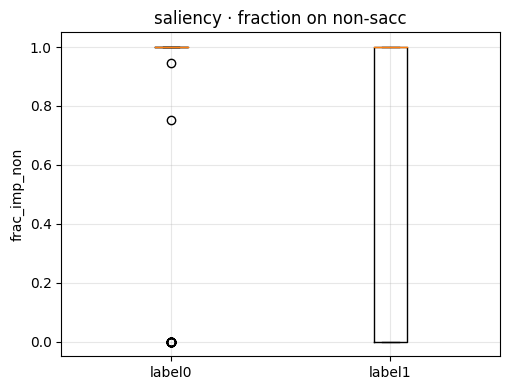

[U-test] frac_imp_sacc: label0 vs label1 -> U=9781.5, p=8.803e-02, mean0=0.002, mean1=0.005


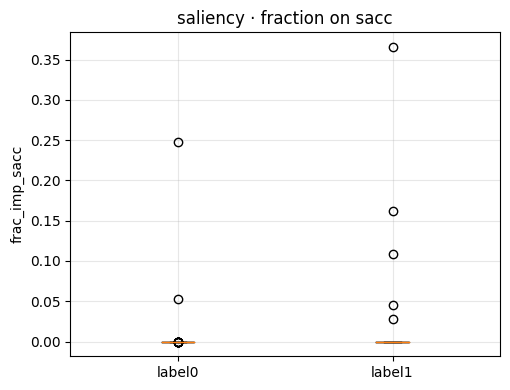

[U-test] frac_imp_pos: label0 vs label1 -> U=9652.5, p=1.294e-01, mean0=0.000, mean1=0.002


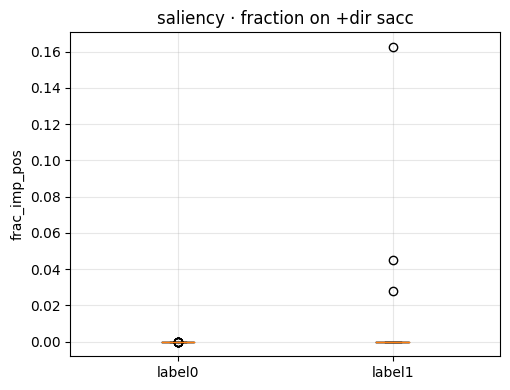

[U-test] frac_imp_neg: label0 vs label1 -> U=9725.0, p=5.370e-02, mean0=0.002, mean1=0.003


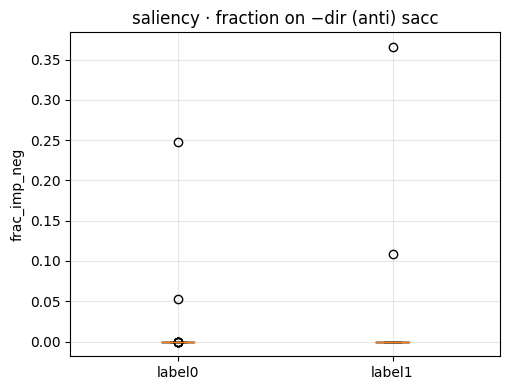

[U-test] frac_imp_non: label0 vs label1 -> U=9337.0, p=9.734e-01, mean0=0.790, mean1=0.712


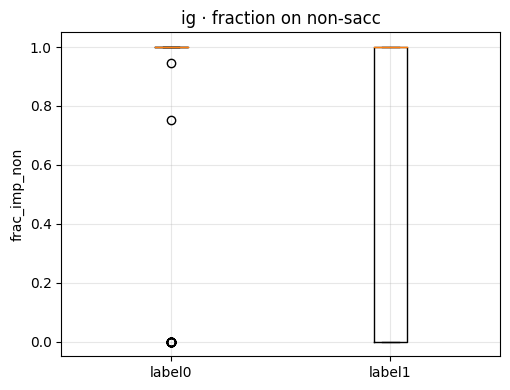

[U-test] frac_imp_sacc: label0 vs label1 -> U=9781.5, p=8.803e-02, mean0=0.002, mean1=0.005


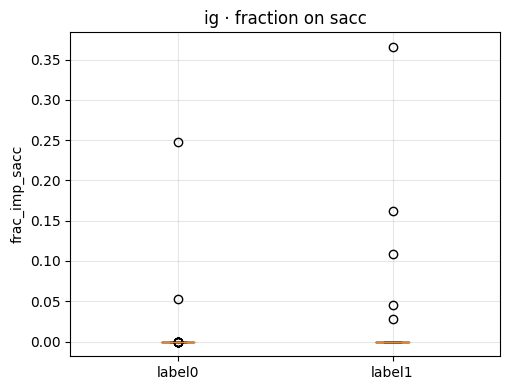

[U-test] frac_imp_pos: label0 vs label1 -> U=9652.5, p=1.294e-01, mean0=0.000, mean1=0.002


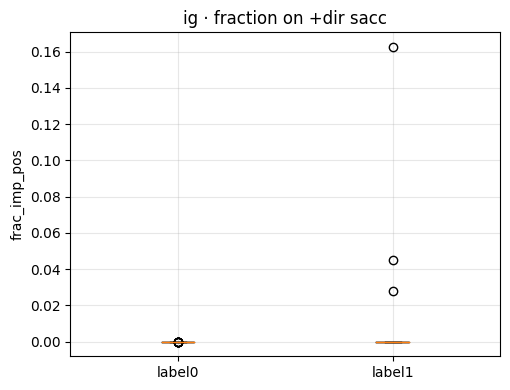

[U-test] frac_imp_neg: label0 vs label1 -> U=9725.0, p=5.370e-02, mean0=0.002, mean1=0.003


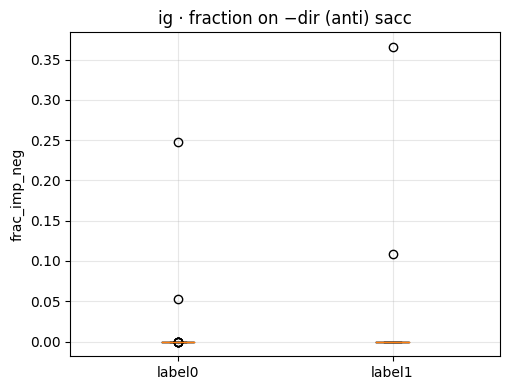

[U-test] frac_imp_non: label0 vs label1 -> U=9337.0, p=9.734e-01, mean0=0.790, mean1=0.712


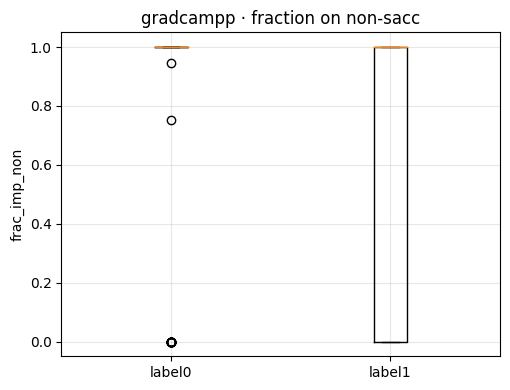

[U-test] frac_imp_sacc: label0 vs label1 -> U=9781.5, p=8.803e-02, mean0=0.002, mean1=0.005


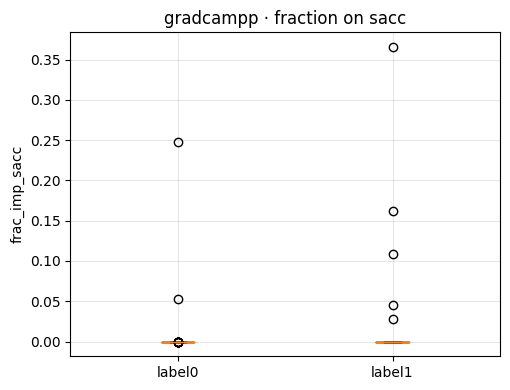

[U-test] frac_imp_pos: label0 vs label1 -> U=9652.5, p=1.294e-01, mean0=0.000, mean1=0.002


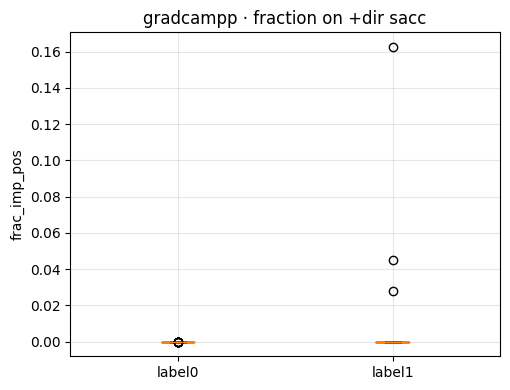

[U-test] frac_imp_neg: label0 vs label1 -> U=9725.0, p=5.370e-02, mean0=0.002, mean1=0.003


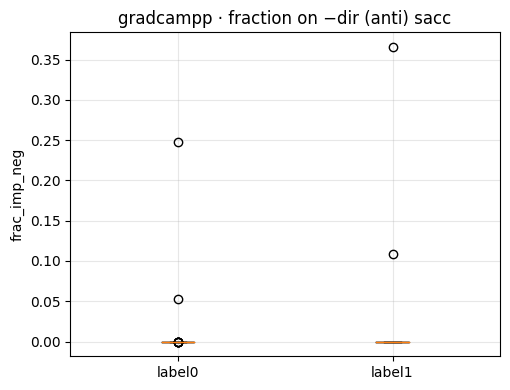

In [14]:
# Training (or loading) CNN+BiLSTM
pair = (0, 2)
target_len = 1500
csv_dir = "/Users/wukehui/Desktop/data science project/project/data/first_trials"

res_bilstm = run_experiment_cnn_bilstm(
    csv_dir=csv_dir,
    label_pair=pair,
    target_len=target_len,
    batch_size=16,
    max_epochs=80,
    lr=3e-4,
    early_patience=15,
    l2=1e-4,
    dropout=0.5,
    lstm_units=64
)
model = res_bilstm["model"]

# Reload the data with the same preprocessing (same as training)
X, y, files = load_pair_experiment(
    csv_dir, pair,
    resample_len=target_len,
    max_nan_ratio=0.05,
    divide_by_960=True,
    use_robust_scale=True
)

# Run XAI × Saccade analysis
df_imp, summary = run_xai_saccade_analysis_bilstm(
    model, X, y,
    xai_methods=('saliency','ig','gradcampp'),
    vel_thr=0.8,     # Speed threshold: fine-tuning by scale
    min_frames=8,    # Minimum saccade duration (number of frames)
    dir_axis='x',    # or 'y', determines whether "positive/negative" (anti) is divided horizontally/vertically
    max_n=200        # The maximum number of samples to be sampled for analysis
)


cnn+bilstm: Load-level Pattern Differences + Sliding Window Feature Dynamics

In [15]:
"""
CNN+BiLSTM: Load-level Pattern Differences + Sliding Window Feature Dynamics
- Full-length/sliding-window statistics consistent with previous CNN versions
- Additional: Model-driven sliding-window importance curves (Saliency, IG, or Grad-CAM++ optional)

Output:
- Graphs and CSV files saved in ./outputs/<dataset_name>
"""

import os, json, time
from typing import List, Tuple, Dict, Optional
import numpy as np
import pandas as pd
from scipy.stats import mannwhitneyu
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score, roc_auc_score
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import Model, Input, layers

# Existing tools (must be available in the same namespace)
# - load_pair_experiment
# - split_by_participant_train_val_test
# - get_optimizer, compute_class_weight
# - build_cnn_bilstm_model or a trained model

SEED = 42
np.random.seed(SEED); tf.random.set_seed(SEED)
os.makedirs("outputs", exist_ok=True)

# Utils
REQUIRED_COLS = ['abs_lx','abs_ly','abs_rx','abs_ry']

def get_participant_id(filename: str) -> str:
    return os.path.splitext(filename)[0].split('_')[0]

# Core analytics (same as CNN version)
def trajectory_length(seq_xy: np.ndarray) -> float:
    lx, ly, rx, ry = seq_xy[:,0], seq_xy[:,1], seq_xy[:,2], seq_xy[:,3]
    dl = np.sqrt(np.diff(lx)**2 + np.diff(ly)**2).sum()
    dr = np.sqrt(np.diff(rx)**2 + np.diff(ry)**2).sum()
    return float((dl + dr) / 2.0)

def compute_lengths(X: np.ndarray) -> np.ndarray:
    return np.array([trajectory_length(x) for x in X], dtype=np.float32)

def velocity_trace(seq_xy: np.ndarray) -> np.ndarray:
    lx, ly, rx, ry = seq_xy[:,0], seq_xy[:,1], seq_xy[:,2], seq_xy[:,3]
    vl = np.sqrt(np.diff(lx)**2 + np.diff(ly)**2)
    vr = np.sqrt(np.diff(rx)**2 + np.diff(ry)**2)
    return (vl + vr)/2.0

def acceleration_from_velocity(v: np.ndarray) -> np.ndarray:
    if len(v) < 2: return np.zeros_like(v)
    return np.abs(np.diff(v))

def window_slices(T: int, win: int, stride: int):
    idx = []; s = 0
    while s + win <= T:
        idx.append((s, s+win))
        s += stride
    if not idx: idx.append((0, T))
    return idx

def window_features(seq_xy: np.ndarray, win=100, stride=50, sacc_thr=None) -> Dict[str, np.ndarray]:
    T = seq_xy.shape[0]
    v = velocity_trace(seq_xy)             # len T-1
    a = acceleration_from_velocity(v)      # len T-2

    if sacc_thr is None:
        sacc_thr = np.percentile(v, 90.0)

    slices = window_slices(T-1, win, stride)  # Use v's time axis (T-1)
    mean_v, mean_a, rng, sacc_freq = [], [], [], []
    for (i, j) in slices:
        v_win = v[i:j]
        a_win = a[i:j-1] if (j-i)>=2 else np.array([0.0])
        sub = seq_xy[i:(i+win), :] if (i+win)<=T else seq_xy[i:T, :]

        mean_v.append(float(v_win.mean()) if len(v_win)>0 else 0.0)
        mean_a.append(float(a_win.mean()) if len(a_win)>0 else 0.0)

        ranges = sub.max(axis=0) - sub.min(axis=0)
        rng.append(float(np.mean(ranges)))

        sacc_freq.append(float(np.mean(v_win > sacc_thr)) if len(v_win)>0 else 0.0)

    return {
        'mean_v': np.array(mean_v, dtype=np.float32),
        'mean_a': np.array(mean_a, dtype=np.float32),
        'rng': np.array(rng, dtype=np.float32),
        'sacc_freq': np.array(sacc_freq, dtype=np.float32),
        'windows': np.array(slices, dtype=np.int32)
    }

def group_window_dynamics(X: np.ndarray, y: np.ndarray, win=100, stride=50) -> Dict:
    feats0, feats1 = [], []
    for i in range(len(X)):
        feats = window_features(X[i], win=win, stride=stride, sacc_thr=None)
        (feats0 if y[i]==0 else feats1).append(feats)
    if len(feats0)==0 or len(feats1)==0:
        raise ValueError("There are not enough samples of the two categories to make dynamic comparisons")

    K = min(min(len(f['mean_v']) for f in feats0),
            min(len(f['mean_v']) for f in feats1))

    def stack(feats_list, key):
        return np.stack([f[key][:K] for f in feats_list], axis=0)  # (N,K)

    out = {}
    for key in ['mean_v','mean_a','rng','sacc_freq']:
        A0, A1 = stack(feats0, key), stack(feats1, key)
        mean0, mean1 = A0.mean(0), A1.mean(0)
        se0, se1 = A0.std(0)/np.sqrt(A0.shape[0]), A1.std(0)/np.sqrt(A1.shape[0])
        pvals = np.array([mannwhitneyu(A0[:,k], A1[:,k], alternative='two-sided')[1] for k in range(K)], dtype=np.float32)
        out[key] = {'mean0':mean0, 'mean1':mean1, 'se0':se0, 'se1':se1, 'pvals':pvals}
    out['K'], out['win'], out['stride'] = K, win, stride
    return out

# Model-driven: Input time domain XAI -> Sliding window importance
def saliency_importance(model: tf.keras.Model, x: np.ndarray) -> np.ndarray:
    xt = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)
    with tf.GradientTape() as tape:
        tape.watch(xt)
        y = model(xt, training=False)
    g = tape.gradient(y, xt).numpy()[0]    # (T,C)
    imp = np.abs(g).mean(axis=1)           # (T,)
    s = imp.sum()
    return imp/(s+1e-8)

def integrated_gradients_importance(model: tf.keras.Model, x: np.ndarray, steps: int = 64) -> np.ndarray:
    baseline = np.zeros_like(x, dtype=np.float32)
    xs = np.array([baseline + (i/steps)*(x-baseline) for i in range(1, steps+1)], dtype=np.float32)  # (S,T,C)
    xt = tf.convert_to_tensor(xs, dtype=tf.float32)
    with tf.GradientTape() as tape:
        tape.watch(xt)
        y = model(xt, training=False)  # (S,1)
    grads = tape.gradient(y, xt).numpy()      # (S,T,C)
    avg_grads = grads.mean(axis=0)            # (T,C)
    ig = ((x-baseline) * avg_grads).mean(axis=1)  # (T,)
    ig = np.maximum(ig, 0)
    return ig/(ig.sum()+1e-8)

def gradcampp_importance(model: tf.keras.Model, x: np.ndarray, conv_layer_name: Optional[str]=None) -> np.ndarray:
    # Automatically find the last Conv1D
    if conv_layer_name is None:
        target = None
        for l in reversed(model.layers):
            if isinstance(l, layers.Conv1D):
                target = l; break
        if target is None:
            raise ValueError("No Conv1D layer found for Grad-CAM++.")
    else:
        target = model.get_layer(conv_layer_name)

    grad_model = tf.keras.Model([model.inputs], [target.output, model.output])
    xt = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)
    with tf.GradientTape(persistent=True) as t1:
        with tf.GradientTape(persistent=True) as t2:
            conv_out, y = grad_model(xt, training=False)
            y_c = y[:, 0]
        g1 = t2.gradient(y_c, conv_out)    # ∂y/∂A
    g2 = t1.gradient(y_c, conv_out)        # Approximate second order
    conv = conv_out.numpy()[0]             # (T',F)
    G1 = g1.numpy()[0]; G2 = g2.numpy()[0]

    eps = 1e-8
    alpha = (G1**2) / np.maximum(2.0*(G1**2) + conv*G2, eps)   # (T',F)
    w = (alpha * np.maximum(G1, 0.0)).sum(axis=0)              # (F,)
    cam = np.maximum((conv*w).sum(axis=1), 0.0)                # (T',)

    # Upsample back to input length T
    T_in = x.shape[0]
    if cam.shape[0] != T_in:
        tprime = np.arange(cam.shape[0], dtype=np.float32)
        tt = np.linspace(0, cam.shape[0]-1, num=T_in, dtype=np.float32)
        cam = np.interp(tt, tprime, cam)

    cam = np.maximum(cam, 0.0)
    return cam/(cam.sum()+1e-8)

def window_importance_curve(imp: np.ndarray, win=100, stride=50) -> np.ndarray:
    """Take the importance sequence of (T,) and calculate the average value by sliding window -> (K,)"""
    T = len(imp)
    slices = window_slices(T, win, stride)  # Note that the input time axis is used here
    vals = [float(imp[i:j].mean()) if (j-i)>0 else 0.0 for (i,j) in slices]
    return np.array(vals, dtype=np.float32)

def group_window_importance_with_model(model: tf.keras.Model, X: np.ndarray, y: np.ndarray,
                                       xai: str = 'saliency', win=100, stride=50) -> Dict:
    """
    For a set of trials:
      1) First get the input domain importance of each imp(T,)
      2) Then the sliding window average is imp_win(K,)
      3) Take mean/SE by label + window-by-window U-test
    """
    imp_list0, imp_list1 = [], []
    for i in range(len(X)):
        if xai == 'saliency':
            imp = saliency_importance(model, X[i])
        elif xai == 'ig':
            imp = integrated_gradients_importance(model, X[i], steps=64)
        elif xai == 'gradcampp':
            imp = gradcampp_importance(model, X[i], conv_layer_name=None)
        else:
            raise ValueError("xai should be in {'saliency','ig','gradcampp'}")
        imp_win = window_importance_curve(imp, win=win, stride=stride)
        (imp_list0 if y[i]==0 else imp_list1).append(imp_win)

    if len(imp_list0)==0 or len(imp_list1)==0:
        raise ValueError("Insufficient samples of both categories to perform model-driven dynamic comparison")

    K = min(min(len(a) for a in imp_list0), min(len(a) for a in imp_list1))
    A0 = np.stack([a[:K] for a in imp_list0], axis=0)
    A1 = np.stack([a[:K] for a in imp_list1], axis=0)

    mean0, mean1 = A0.mean(0), A1.mean(0)
    se0, se1 = A0.std(0)/np.sqrt(A0.shape[0]), A1.std(0)/np.sqrt(A1.shape[0])
    pvals = np.array([mannwhitneyu(A0[:,k], A1[:,k], alternative='two-sided')[1] for k in range(K)], dtype=np.float32)
    return {'mean0':mean0, 'mean1':mean1, 'se0':se0, 'se1':se1, 'pvals':pvals, 'K':K, 'win':win, 'stride':stride}

# Plot helpers
def plot_box_violin_lengths(lengths: np.ndarray, y: np.ndarray, title: str, save_path: str):
    data0, data1 = lengths[y==0], lengths[y==1]
    fig, ax = plt.subplots(1,2, figsize=(10,4), sharey=True)
    ax[0].boxplot([data0, data1], labels=['label0','label1']); ax[0].set_title('Boxplot')
    ax[0].set_ylabel('Trajectory length')
    parts = ax[1].violinplot([data0, data1], showmeans=True, showmedians=True)
    ax[1].set_xticks([1,2]); ax[1].set_xticklabels(['label0','label1']); ax[1].set_title('Violin')
    fig.suptitle(title); plt.tight_layout(); fig.savefig(save_path, dpi=200); plt.close(fig)

def plot_window_curves(dyn: Dict, title: str, save_path: str, alpha=0.05):
    K, win, stride = dyn['K'], dyn['win'], dyn['stride']
    tgrid = np.arange(K) * stride + win//2
    keys = ['mean_v','mean_a','rng','sacc_freq']
    fig, axes = plt.subplots(len(keys), 1, figsize=(10, 2.8*len(keys)), sharex=True)
    if len(keys)==1: axes = [axes]
    for ax, key in zip(axes, keys):
        d = dyn[key]
        ax.plot(tgrid, d['mean0'], label='label0'); ax.fill_between(tgrid, d['mean0']-d['se0'], d['mean0']+d['se0'], alpha=0.25)
        ax.plot(tgrid, d['mean1'], label='label1'); ax.fill_between(tgrid, d['mean1']-d['se1'], d['mean1']+d['se1'], alpha=0.25)
        sig = d['pvals'] < alpha
        if sig.any():
            ymin = min(d['mean0'].min(), d['mean1'].min())
            ax.scatter(tgrid[sig], np.full(sig.sum(), ymin), marker='|', s=60, label='p<%.2f'%alpha)
        ax.set_ylabel(key); ax.grid(alpha=0.2)
    axes[-1].set_xlabel('time (frame)'); axes[0].legend()
    fig.suptitle(title); plt.tight_layout(); fig.savefig(save_path, dpi=200); plt.close(fig)

def plot_model_window_importance(d: Dict, title: str, save_path: str, alpha=0.05):
    K, win, stride = d['K'], d['win'], d['stride']
    tgrid = np.arange(K) * stride + win//2
    fig, ax = plt.subplots(1,1, figsize=(10,3.0))
    ax.plot(tgrid, d['mean0'], label='label0'); ax.fill_between(tgrid, d['mean0']-d['se0'], d['mean0']+d['se0'], alpha=0.25)
    ax.plot(tgrid, d['mean1'], label='label1'); ax.fill_between(tgrid, d['mean1']-d['se1'], d['mean1']+d['se1'], alpha=0.25)
    sig = d['pvals'] < alpha
    if sig.any():
        ymin = min(d['mean0'].min(), d['mean1'].min())
        ax.scatter(tgrid[sig], np.full(sig.sum(), ymin), marker='|', s=60, label='p<%.2f'%alpha)
    ax.set_ylabel('win-avg XAI importance'); ax.set_xlabel('time (frame)'); ax.grid(alpha=0.2); ax.legend()
    ax.set_title(title); plt.tight_layout(); fig.savefig(save_path, dpi=200); plt.close(fig)

# End-to-end run
def analyze_dataset_with_bilstm_model(
    name: str,
    csv_dir: str,
    label_pair=(0,2),
    target_len=1500,
    out_dir="outputs",
    win=100, stride=50,
    model: Optional[tf.keras.Model] = None,
    xai_choices: Tuple[str,...] = ('saliency','ig')  # 'gradcampp' is also available
):
    os.makedirs(os.path.join(out_dir, name), exist_ok=True)

    # 1) Load
    X, y, files = load_pair_experiment(csv_dir, label_pair, resample_len=target_len,
                                       max_nan_ratio=0.30, divide_by_960=True, use_robust_scale=True)

    # 2) Full track length
    L = compute_lengths(X)
    df_len = pd.DataFrame({'file': files, 'pid':[get_participant_id(f) for f in files],
                           'label': y, 'length': L})
    df_len.to_csv(os.path.join(out_dir, name, f"{name}_lengths.csv"), index=False)

    L0, L1 = L[y==0], L[y==1]
    u, p = mannwhitneyu(L0, L1, alternative='two-sided')
    stats = {'n0': int(len(L0)), 'n1': int(len(L1)),
             'mean0': float(L0.mean()), 'mean1': float(L1.mean()),
             'std0': float(L0.std()), 'std1': float(L1.std()),
             'U': float(u), 'p': float(p)}
    with open(os.path.join(out_dir, name, f"{name}_length_stats.json"), "w") as f:
        json.dump(stats, f, indent=2)
    print(f"[{name}] Length MW-U: U={u:.1f}, p={p:.3e}, mean0={L0.mean():.3f}, mean1={L1.mean():.3f}")

    plot_box_violin_lengths(L, y, title=f"{name} Trajectory Length",
                            save_path=os.path.join(out_dir, name, f"{name}_length_box_violin.png"))

    # 3) Length binary classification (subject grouping)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(
        L.reshape(-1,1), y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    clf = make_pipeline(StandardScaler(), LogisticRegression(random_state=SEED, max_iter=1000))
    clf.fit(np.vstack([Xtr, Xva]), np.hstack([ytr, yva]))
    prob = clf.predict_proba(Xte)[:,1]; pred = (prob>=0.5).astype(int)
    acc = accuracy_score(yte, pred)
    try: auc = roc_auc_score(yte, prob)
    except ValueError: auc = float('nan')
    with open(os.path.join(out_dir, name, f"{name}_length_cls.json"), "w") as f:
        json.dump({'accuracy': float(acc), 'roc_auc': float(auc), 'split': split_info}, f, indent=2)
    print(f"[{name}] Length-only classifier: Acc={acc:.3f}, ROC-AUC={auc:.3f}")

    # 4) Traditional sliding window feature dynamics
    dyn = group_window_dynamics(X, y, win=win, stride=stride)
    pv = {k: dyn[k]['pvals'].tolist() for k in ['mean_v','mean_a','rng','sacc_freq']}
    with open(os.path.join(out_dir, name, f"{name}_window_pvals.json"), "w") as f:
        json.dump({'K': dyn['K'], 'win': dyn['win'], 'stride': dyn['stride'], 'pvals': pv}, f, indent=2)
    plot_window_curves(dyn, title=f"{name} sliding-window dynamics (win={win}, stride={stride})",
                       save_path=os.path.join(out_dir, name, f"{name}_window_dynamics.png"))

    # 5) Model-driven sliding window "importance" dynamics
    if model is not None:
        for xai in xai_choices:
            d = group_window_importance_with_model(model, X, y, xai=xai, win=win, stride=stride)
            with open(os.path.join(out_dir, name, f"{name}_model_winimp_{xai}.json"), "w") as f:
                json.dump({'K': d['K'], 'win': d['win'], 'stride': d['stride'],
                           'mean0': d['mean0'].tolist(), 'mean1': d['mean1'].tolist(),
                           'se0': d['se0'].tolist(), 'se1': d['se1'].tolist(),
                           'pvals': d['pvals'].tolist()}, f, indent=2)
            plot_model_window_importance(d, title=f"{name} win-avg XAI ({xai})",
                                         save_path=os.path.join(out_dir, name, f"{name}_model_winimp_{xai}.png"))

    return {'length_stats': stats, 'length_cls': {'accuracy': float(acc), 'roc_auc': float(auc)}, 'splits': split_info}

# Main
if __name__ == "__main__":
    FIRST_DIR  = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (0, 2)
    TARGET_LEN = 1500
    WIN, STRIDE = 100, 50

    # Train one from first_trials and use it to do model-driven sliding window analysis on first and repeats
    from tensorflow.keras import regularizers
    def build_cnn_bilstm_model(input_shape, l2=1e-4, dropout=0.5, lstm_units=64) -> Model:
        inp = Input(shape=input_shape, name='input_ts')
        x = layers.Conv1D(64, 7, padding='same', use_bias=False,
                          kernel_regularizer=regularizers.l2(l2), name='conv1')(inp)
        x = layers.BatchNormalization(name='bn1')(x); x = layers.ReLU()(x)
        x = layers.MaxPooling1D(2, name='pool1')(x)
        x = layers.Conv1D(128, 5, padding='same', use_bias=False,
                          kernel_regularizer=regularizers.l2(l2), name='conv2')(x)
        x = layers.BatchNormalization(name='bn2')(x); x = layers.ReLU()(x)
        x = layers.MaxPooling1D(2, name='pool2')(x)
        x = layers.Conv1D(128, 3, padding='same', use_bias=False,
                          kernel_regularizer=regularizers.l2(l2), name='conv3')(x)
        x = layers.BatchNormalization(name='bn3')(x); x = layers.ReLU(name='conv3_relu')(x)
        x = layers.Bidirectional(layers.LSTM(64, return_sequences=False), name='bilstm')(x)
        x = layers.Dropout(dropout, name='drop')(x)
        x = layers.Dense(64, activation='relu', name='fc1')(x)
        out = layers.Dense(1, activation='sigmoid', name='logit')(x)
        return Model(inp, out, name='cnn_bilstm')

    # Train
    Xtrain, ytrain, files_tr = None, None, None
    X_all, y_all, files_all = load_pair_experiment(FIRST_DIR, PAIR, resample_len=TARGET_LEN,
                                                   max_nan_ratio=0.30, divide_by_960=True, use_robust_scale=True)
    # Simple division by subject
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(X_all, y_all, files_all, val_size=0.2, test_size=0.2, random_state=SEED)
    model = build_cnn_bilstm_model((TARGET_LEN, 4), l2=1e-4, dropout=0.5, lstm_units=64)
    model.compile(optimizer=tf.keras.optimizers.Adam(3e-4), loss='binary_crossentropy', metrics=['accuracy'])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=40, batch_size=16, verbose=1,
              callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=8, restore_best_weights=True)])

    print("=== Analyze FIRST (with model) ===")
    res_first = analyze_dataset_with_bilstm_model(
        name="first_trials", csv_dir=FIRST_DIR, label_pair=PAIR, target_len=TARGET_LEN,
        out_dir="outputs", win=WIN, stride=STRIDE, model=model, xai_choices=('saliency','ig')
    )

    print("=== Analyze REPEATS (with same model) ===")
    res_repeats = analyze_dataset_with_bilstm_model(
        name="repeats", csv_dir=REPEAT_DIR, label_pair=PAIR, target_len=TARGET_LEN,
        out_dir="outputs", win=WIN, stride=STRIDE, model=model, xai_choices=('saliency','ig')
    )

    print("\nSummary:")
    print("FIRST length-only:", res_first['length_cls'])
    print("REPEATS length-only:", res_repeats['length_cls'])


[load_pair_experiment] Labels=(0, 2), files=92, shape=(92, 1500, 4)
Epoch 1/40


/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 3s 739ms/step - loss: 0.7378 - accuracy: 0.5000 - val_loss: 0.7057 - val_accuracy: 0.6500
Epoch 2/40
4/4 [==============================] - 3s 754ms/step - loss: 0.5961 - accuracy: 0.7593 - val_loss: 0.6867 - val_accuracy: 0.6500
Epoch 3/40
4/4 [==============================] - 3s 886ms/step - loss: 0.5171 - accuracy: 0.8333 - val_loss: 0.6657 - val_accuracy: 0.7000
Epoch 4/40
4/4 [==============================] - 3s 782ms/step - loss: 0.4383 - accuracy: 0.8704 - val_loss: 0.6445 - val_accuracy: 0.7500
Epoch 5/40
4/4 [==============================] - 3s 793ms/step - loss: 0.3984 - accuracy: 0.9074 - val_loss: 0.6246 - val_accuracy: 0.7500
Epoch 6/40
4/4 [==============================] - 3s 825ms/step - loss: 0.3258 - accuracy: 0.9074 - val_loss: 0.6063 - val_accuracy: 0.7000
Epoch 7/40
4/4 [==============================] - 3s 700ms/step - loss: 0.3018 - accuracy: 0.9074 - val_loss: 0.5942 - val_accuracy: 0.7000
Epoch 8/40
4/4 [===============

cnn+bilstm: Ablation Experiments

In [16]:
"""
Ablation Experiments for CNN+BiLSTM
- 8.3.1 Eye Channel Ablation: Left Only / Right Only / Both
- 8.3.2 Temporal Segment Ablation: Start / Middle / End
- 8.3.3 Coordinate Direction Ablation: X only / Y only

The interface is the same as the previous CNN version, but the model is changed to CNN+BiLSTM, and the number of channels can be adapted.
"""

import os, time, json
from typing import Tuple, List, Dict, Optional
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, Model, Input, regularizers
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, classification_report

# Functions that should already exist in the existing script (directly called here)
# - _linear_resample(x, target_len)
# - load_pair_experiment(csv_dir, labels, resample_len, max_nan_ratio, divide_by_960, use_robust_scale)
# - split_by_participant_train_val_test(X, y, files, val_size, test_size, random_state)
# - compute_class_weight(y_train)
# - get_optimizer(lr)

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# CNN+BiLSTM (supports variable number of channels)
def build_cnn_bilstm_model_nchan(target_len: int,
                                 n_channels: int,
                                 l2: float = 1e-4,
                                 lstm_units: int = 64,
                                 dropout: float = 0.5) -> Model:
    """
    Input: (target_len, n_channels)
    Structure: Conv1D(64,7)->BN->ReLU->Pool2
        + Conv1D(128,5)->BN->ReLU->Pool2
        + Conv1D(128,3)->BN->ReLU
        + BiLSTM(lstm_units)
        + Dense(64)->Dropout->Sigmoid
    """
    inp = Input(shape=(target_len, n_channels), name='input_ts')

    x = layers.Conv1D(64, 7, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x)
    x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)

    x = layers.Conv1D(128, 5, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x)
    x = layers.ReLU()(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)

    x = layers.Conv1D(128, 3, padding='same', use_bias=False,
                      kernel_regularizer=regularizers.l2(l2), name='conv3')(x)
    x = layers.BatchNormalization(name='bn3')(x)
    x = layers.ReLU(name='conv3_relu')(x)

    x = layers.Bidirectional(layers.LSTM(lstm_units, return_sequences=False), name='bilstm')(x)
    x = layers.Dropout(dropout, name='drop')(x)
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name=f'cnn_bilstm_{n_channels}ch')

# Crop tool
# Channel index: 0: lx, 1: ly, 2: rx, 3: ry
IDX = {'lx':0, 'ly':1, 'rx':2, 'ry':3}

def select_channels(X: np.ndarray, mode: str) -> np.ndarray:
    """
    mode in {'left','right','both','x','y'}:
      left  -> [lx, ly]
      right -> [rx, ry]
      both  -> [lx, ly, rx, ry]
      x     -> [lx, rx]
      y     -> [ly, ry]
    """
    if mode == 'left':
        keep = [IDX['lx'], IDX['ly']]
    elif mode == 'right':
        keep = [IDX['rx'], IDX['ry']]
    elif mode == 'both':
        keep = [IDX['lx'], IDX['ly'], IDX['rx'], IDX['ry']]
    elif mode == 'x':
        keep = [IDX['lx'], IDX['rx']]
    elif mode == 'y':
        keep = [IDX['ly'], IDX['ry']]
    else:
        raise ValueError(f"Unknown channel mode: {mode}")
    return X[:, :, keep]

def slice_temporal_segment(X: np.ndarray, seg: str, resample_back_len: Optional[int] = None) -> np.ndarray:
    """
    Slice (N,T,C) into 1/3 slices in the time dimension:
      seg in {'full','start','middle','end'}
    If resample_back_len is given, the sliced sequence is linearly resampled back to this length (keeping the model input consistent).
    """
    if seg == 'full':
        return X
    N, T, C = X.shape
    one_third = T // 3
    if seg == 'start':
        Xs = X[:, :one_third, :]
    elif seg == 'middle':
        Xs = X[:, one_third:2*one_third, :]
    elif seg == 'end':
        Xs = X[:, 2*one_third:, :]
    else:
        raise ValueError(f"Unknown temporal segment: {seg}")

    if (resample_back_len is None) or (Xs.shape[1] == resample_back_len):
        return Xs

    out = np.empty((N, resample_back_len, C), dtype=X.dtype)
    for i in range(N):
        out[i] = _linear_resample(Xs[i], resample_back_len)  # Reuse linear resampling
    return out

# Training and evaluation (changing to BiLSTM model)
def train_eval_once(
    X: np.ndarray, y: np.ndarray, files: List[str],
    target_len: int = 1500,
    lr: float = 3e-4,
    batch_size: int = 16,
    max_epochs: int = 80,
    early_patience: int = 15,
    l2: float = 1e-4,
    lstm_units: int = 64,
    dropout: float = 0.5
) -> Dict:
    """
    Independently divide the subjects -> train CNN+BiLSTM -> test, return the index
    """
    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    n_channels = X.shape[-1]
    model = build_cnn_bilstm_model_nchan(target_len, n_channels, l2=l2, lstm_units=lstm_units, dropout=dropout)
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])

    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    class_weight = compute_class_weight(ytr)

    t0 = time.perf_counter()
    hist = model.fit(
        Xtr, ytr,
        validation_data=(Xva, yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=0,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()

    yprob = model.predict(Xte, batch_size=batch_size, verbose=0).ravel()
    ypred = (yprob >= 0.5).astype(int)
    acc = accuracy_score(yte, ypred)
    macro_f1 = f1_score(yte, ypred, average='macro')
    try:
        roc_auc = roc_auc_score(yte, yprob)
    except Exception:
        roc_auc = np.nan
    report = classification_report(yte, ypred, digits=4)
    return {
        'acc': acc, 'macro_f1': macro_f1, 'roc_auc': roc_auc,
        'report': report, 'history': hist.history, 'time_sec': t1 - t0,
        'splits': id_splits
    }

# 8.3.1 Eye Channel Ablation
def run_eye_channel_ablation(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    base_loader_kwargs: Optional[Dict] = None,
    **train_kwargs
) -> pd.DataFrame:
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05,
                                  divide_by_960=True, use_robust_scale=True)

    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)
    rows = []
    for mode in ['left', 'right', 'both']:
        Xc = select_channels(X, mode)
        res = train_eval_once(Xc, y, files, target_len=target_len, **train_kwargs)
        rows.append(dict(
            ablation='EyeChannel', setting=mode,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'],
            time_sec=res['time_sec']
        ))
        print(f"[EyeChannel|BiLSTM] {mode}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# 8.3.2 Temporal Segment Ablation
def run_temporal_segment_ablation(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    base_loader_kwargs: Optional[Dict] = None,
    **train_kwargs
) -> pd.DataFrame:
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05,
                                  divide_by_960=True, use_robust_scale=True)
    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)

    rows = []
    for seg in ['start', 'middle', 'end']:
        Xt = slice_temporal_segment(X, seg=seg, resample_back_len=target_len)
        res = train_eval_once(Xt, y, files, target_len=target_len, **train_kwargs)
        rows.append(dict(
            ablation='Temporal', setting=seg,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'],
            time_sec=res['time_sec']
        ))
        print(f"[Temporal|BiLSTM] {seg}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# 8.3.3 Coordinate Direction Ablation
def run_coord_direction_ablation(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    base_loader_kwargs: Optional[Dict] = None,
    **train_kwargs
) -> pd.DataFrame:
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05,
                                  divide_by_960=True, use_robust_scale=True)
    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)

    rows = []
    for d in ['x', 'y']:
        Xc = select_channels(X, d)
        res = train_eval_once(Xc, y, files, target_len=target_len, **train_kwargs)
        rows.append(dict(
            ablation='Coord', setting=d,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'],
            time_sec=res['time_sec']
        ))
        print(f"[Coord|BiLSTM] {d}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# One-button control
def run_all_ablation_bilstm(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    save_prefix: Optional[str] = None,
    # Model hyperparameters (can be changed as needed)
    l2: float = 1e-4,
    lstm_units: int = 64,
    dropout: float = 0.5,
    lr: float = 3e-4,
    batch_size: int = 16,
    max_epochs: int = 80,
    early_patience: int = 15
) -> Dict[str, pd.DataFrame]:
    train_kwargs = dict(l2=l2, lstm_units=lstm_units, dropout=dropout,
                        lr=lr, batch_size=batch_size, max_epochs=max_epochs,
                        early_patience=early_patience)

    res_eye = run_eye_channel_ablation(csv_dir, label_pair, target_len, **train_kwargs)
    res_tmp = run_temporal_segment_ablation(csv_dir, label_pair, target_len, **train_kwargs)
    res_dir = run_coord_direction_ablation(csv_dir, label_pair, target_len, **train_kwargs)

    results = {'EyeChannel': res_eye, 'Temporal': res_tmp, 'Coord': res_dir}
    if save_prefix:
        for k, df in results.items():
            df.to_csv(f"{save_prefix}_{k}.csv", index=False)
        with open(f"{save_prefix}_meta.json", "w") as f:
            json.dump({'label_pair': label_pair, 'target_len': target_len,
                       'l2': l2, 'lstm_units': lstm_units, 'dropout': dropout,
                       'lr': lr, 'batch_size': batch_size, 'max_epochs': max_epochs,
                       'early_patience': early_patience}, f, indent=2)
    return results

if __name__ == "__main__":
    FIRST_DIR  = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (0, 2)

    print("=== 8.3 Ablation (CNN+BiLSTM) on FIRST_TRIALS ===")
    res_first = run_all_ablation_bilstm(FIRST_DIR, label_pair=PAIR, target_len=1500,
                                        save_prefix=f"ablation_bilstm_first_{PAIR[0]}_{PAIR[1]}")

    print("\n=== 8.3 Ablation (CNN+BiLSTM) on REPEATS ===")
    res_repeats = run_all_ablation_bilstm(REPEAT_DIR, label_pair=PAIR, target_len=1500,
                                          save_prefix=f"ablation_bilstm_repeats_{PAIR[0]}_{PAIR[1]}")

    # Simple summary printing
    for name, df in res_first.items():
        print(f"\n[FIRST|BiLSTM] {name}\n", df.sort_values('acc', ascending=False))
    for name, df in res_repeats.items():
        print(f"\n[REPEATS|BiLSTM] {name}\n", df.sort_values('acc', ascending=False))


=== 8.3 Ablation (CNN+BiLSTM) on FIRST_TRIALS ===
[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)


/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 20: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 26: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[EyeChannel|BiLSTM] left: Acc=0.882, F1=0.879, AUC=0.986
              precision    recall  f1-score   support

           0     0.8571    0.8571    0.8571         7
           1     0.9000    0.9000    0.9000        10

    accuracy                         0.8824        17
   macro avg     0.8786    0.8786    0.8786        17
weighted avg     0.8824    0.8824    0.8824        17



/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 29: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 37: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.

Epoch 43: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.
[EyeChannel|BiLSTM] right: Acc=0.882, F1=0.871, AUC=1.000
              precision    recall  f1-score   support

           0     1.0000    0.7143    0.8333         7
           1     0.8333    1.0000    0.9091        10

    accuracy                         0.8824        17
   macro avg     0.9167    0.8571    0.8712        17
weighted avg     0.9020    0.8824    0.8779        17



/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 16: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 22: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[EyeChannel|BiLSTM] both: Acc=0.882, F1=0.882, AUC=1.000
              precision    recall  f1-score   support

           0     0.7778    1.0000    0.8750         7
           1     1.0000    0.8000    0.8889        10

    accuracy                         0.8824        17
   macro avg     0.8889    0.9000    0.8819        17
weighted avg     0.9085    0.8824    0.8832        17

[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)


/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 20: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 26: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[Temporal|BiLSTM] start: Acc=0.882, F1=0.882, AUC=0.971
              precision    recall  f1-score   support

           0     0.7778    1.0000    0.8750         7
           1     1.0000    0.8000    0.8889        10

    accuracy                         0.8824        17
   macro avg     0.8889    0.9000    0.8819        17
weighted avg     0.9085    0.8824    0.8832        17



/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 9: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 15: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[Temporal|BiLSTM] middle: Acc=0.412, F1=0.393, AUC=0.514
              precision    recall  f1-score   support

           0     0.3846    0.7143    0.5000         7
           1     0.5000    0.2000    0.2857        10

    accuracy                         0.4118        17
   macro avg     0.4423    0.4571    0.3929        17
weighted avg     0.4525    0.4118    0.3739        17



/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 9: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 15: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[Temporal|BiLSTM] end: Acc=0.529, F1=0.485, AUC=0.714
              precision    recall  f1-score   support

           0     0.4667    1.0000    0.6364         7
           1     1.0000    0.2000    0.3333        10

    accuracy                         0.5294        17
   macro avg     0.7333    0.6000    0.4848        17
weighted avg     0.7804    0.5294    0.4581        17

[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)


/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 13: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 19: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[Coord|BiLSTM] x: Acc=0.588, F1=0.564, AUC=0.600
              precision    recall  f1-score   support

           0     0.5000    0.4286    0.4615         7
           1     0.6364    0.7000    0.6667        10

    accuracy                         0.5882        17
   macro avg     0.5682    0.5643    0.5641        17
weighted avg     0.5802    0.5882    0.5822        17



/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 24: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 30: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[Coord|BiLSTM] y: Acc=0.882, F1=0.879, AUC=0.957
              precision    recall  f1-score   support

           0     0.8571    0.8571    0.8571         7
           1     0.9000    0.9000    0.9000        10

    accuracy                         0.8824        17
   macro avg     0.8786    0.8786    0.8786        17
weighted avg     0.8824    0.8824    0.8824        17


=== 8.3 Ablation (CNN+BiLSTM) on REPEATS ===
[load_pair_experiment] Labels=(0, 2), files=40, shape=(40, 1500, 4)


/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 37: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 53: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.

Epoch 59: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.
[EyeChannel|BiLSTM] left: Acc=0.600, F1=0.600, AUC=0.840
              precision    recall  f1-score   support

           0     0.6000    0.6000    0.6000         5
           1     0.6000    0.6000    0.6000         5

    accuracy                         0.6000        10
   macro avg     0.6000    0.6000    0.6000        10
weighted avg     0.6000    0.6000    0.6000        10



/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 21: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 27: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[EyeChannel|BiLSTM] right: Acc=0.800, F1=0.792, AUC=0.840
              precision    recall  f1-score   support

           0     1.0000    0.6000    0.7500         5
           1     0.7143    1.0000    0.8333         5

    accuracy                         0.8000        10
   macro avg     0.8571    0.8000    0.7917        10
weighted avg     0.8571    0.8000    0.7917        10



/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 21: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 27: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[EyeChannel|BiLSTM] both: Acc=0.700, F1=0.697, AUC=0.920
              precision    recall  f1-score   support

           0     0.7500    0.6000    0.6667         5
           1     0.6667    0.8000    0.7273         5

    accuracy                         0.7000        10
   macro avg     0.7083    0.7000    0.6970        10
weighted avg     0.7083    0.7000    0.6970        10

[load_pair_experiment] Labels=(0, 2), files=40, shape=(40, 1500, 4)


/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 33: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 39: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[Temporal|BiLSTM] start: Acc=0.900, F1=0.899, AUC=0.960
              precision    recall  f1-score   support

           0     0.8333    1.0000    0.9091         5
           1     1.0000    0.8000    0.8889         5

    accuracy                         0.9000        10
   macro avg     0.9167    0.9000    0.8990        10
weighted avg     0.9167    0.9000    0.8990        10



/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 21: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 27: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.

Epoch 33: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.
[Temporal|BiLSTM] middle: Acc=0.800, F1=0.800, AUC=0.840
              precision    recall  f1-score   support

           0     0.8000    0.8000    0.8000         5
           1     0.8000    0.8000    0.8000         5

    accuracy                         0.8000        10
   macro avg     0.8000    0.8000    0.8000        10
weighted avg     0.8000    0.8000    0.8000        10



/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 43: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 49: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[Temporal|BiLSTM] end: Acc=0.700, F1=0.670, AUC=1.000
              precision    recall  f1-score   support

           0     0.6250    1.0000    0.7692         5
           1     1.0000    0.4000    0.5714         5

    accuracy                         0.7000        10
   macro avg     0.8125    0.7000    0.6703        10
weighted avg     0.8125    0.7000    0.6703        10

[load_pair_experiment] Labels=(0, 2), files=40, shape=(40, 1500, 4)


/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 40: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 46: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[Coord|BiLSTM] x: Acc=0.600, F1=0.583, AUC=0.720
              precision    recall  f1-score   support

           0     0.5714    0.8000    0.6667         5
           1     0.6667    0.4000    0.5000         5

    accuracy                         0.6000        10
   macro avg     0.6190    0.6000    0.5833        10
weighted avg     0.6190    0.6000    0.5833        10



/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(



Epoch 22: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 28: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[Coord|BiLSTM] y: Acc=0.800, F1=0.792, AUC=0.880
              precision    recall  f1-score   support

           0     1.0000    0.6000    0.7500         5
           1     0.7143    1.0000    0.8333         5

    accuracy                         0.8000        10
   macro avg     0.8571    0.8000    0.7917        10
weighted avg     0.8571    0.8000    0.7917        10


[FIRST|BiLSTM] EyeChannel
      ablation setting       acc  macro_f1   roc_auc    time_sec
0  EyeChannel    left  0.882353  0.878571  0.985714   86.886914
1  EyeChannel   right  0.882353  0.871212  1.000000  126.765949
2  EyeChannel    both  0.882353  0.881944  1.000000   69.403487

[FIRST|BiLSTM] Temporal
    ablation setting       acc  macro_f1   roc_auc   time_sec
0  Temporal   start  0.882353  0.881944  0.971429  79.061985
2  Temporal     end  0.529412  0.484

In [11]:
if __name__ == "__main__":
    FIRST_DIR  = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (1, 3)

    print("=== 8.3 Ablation (CNN+BiLSTM) on FIRST_TRIALS ===")
    res_first = run_all_ablation_bilstm(FIRST_DIR, label_pair=PAIR, target_len=1500,
                                        save_prefix=f"ablation_bilstm_first_{PAIR[0]}_{PAIR[1]}")

    print("\n=== 8.3 Ablation (CNN+BiLSTM) on REPEATS ===")
    res_repeats = run_all_ablation_bilstm(REPEAT_DIR, label_pair=PAIR, target_len=1500,
                                          save_prefix=f"ablation_bilstm_repeats_{PAIR[0]}_{PAIR[1]}")

    # Simple summary printing
    for name, df in res_first.items():
        print(f"\n[FIRST|BiLSTM] {name}\n", df.sort_values('acc', ascending=False))
    for name, df in res_repeats.items():
        print(f"\n[REPEATS|BiLSTM] {name}\n", df.sort_values('acc', ascending=False))

=== 8.3 Ablation (CNN+BiLSTM) on FIRST_TRIALS ===
[load_pair_experiment] Dir=first_trials Labels=(1, 3), files=96, shape=(96, 1500, 4)

Epoch 26: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 32: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[EyeChannel|BiLSTM] left: Acc=0.905, F1=0.905, AUC=0.873
              precision    recall  f1-score   support

           0     1.0000    0.8182    0.9000        11
           1     0.8333    1.0000    0.9091        10

    accuracy                         0.9048        21
   macro avg     0.9167    0.9091    0.9045        21
weighted avg     0.9206    0.9048    0.9043        21


Epoch 13: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 19: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[EyeChannel|BiLSTM] right: Acc=0.810, F1=0.809, AUC=0.864
              precision    recall  f1-score   support

           0     0.8182    0.8182    0.8182        11
  


Epoch 18: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 24: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[Coord|BiLSTM] x: Acc=0.778, F1=0.775, AUC=0.750
              precision    recall  f1-score   support

           0     0.8000    0.8000    0.8000         5
           1     0.7500    0.7500    0.7500         4

    accuracy                         0.7778         9
   macro avg     0.7750    0.7750    0.7750         9
weighted avg     0.7778    0.7778    0.7778         9


Epoch 7: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 13: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[Coord|BiLSTM] y: Acc=0.556, F1=0.357, AUC=0.750
              precision    recall  f1-score   support

           0     0.5556    1.0000    0.7143         5
           1     0.0000    0.0000    0.0000         4

    accuracy                         0.5556         9
   macro avg     0.2778    0.5000    0.3571   

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


mcdcnn

[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Split] train=54, val=20, test=17
Model: "mcdcnn_4ch"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 mcdcnn_input (InputLayer)   [(None, 1500, 4)]            0         []                            
                                                                                                  
 slice_ch0 (Lambda)          (None, 1500, 1)              0         ['mcdcnn_input[0][0]']        
                                                                                                  
 slice_ch1 (Lambda)          (None, 1500, 1)              0         ['mcdcnn_input[0][0]']        
                                                                                                  
 slice_ch2 (Lambda)          (None, 1500, 1)              0         ['mcdcnn_input[0][

                                                                                                  
 ch3_pool2 (MaxPooling1D)    (None, 375, 64)              0         ['ch3_relu2[0][0]']           
                                                                                                  
 ch0_flat (Flatten)          (None, 24000)                0         ['ch0_pool2[0][0]']           
                                                                                                  
 ch1_flat (Flatten)          (None, 24000)                0         ['ch1_pool2[0][0]']           
                                                                                                  
 ch2_flat (Flatten)          (None, 24000)                0         ['ch2_pool2[0][0]']           
                                                                                                  
 ch3_flat (Flatten)          (None, 24000)                0         ['ch3_pool2[0][0]']           
          

                                                                                                  
 ch1_bn1 (BatchNormalizatio  (None, 1500, 32)             128       ['ch1_conv1[0][0]']           
 n)                                                                                               
                                                                                                  
 ch2_bn1 (BatchNormalizatio  (None, 1500, 32)             128       ['ch2_conv1[0][0]']           
 n)                                                                                               
                                                                                                  
 ch3_bn1 (BatchNormalizatio  (None, 1500, 32)             128       ['ch3_conv1[0][0]']           
 n)                                                                                               
                                                                                                  
 ch0_relu1

__________________________________________________________________________________________________
Epoch 1/80
4/4 [==============================] - 1s 80ms/step - loss: 1.5966 - accuracy: 0.6000 - val_loss: 0.6761 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 47ms/step - loss: 4.4682 - accuracy: 0.6727 - val_loss: 0.8614 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 47ms/step - loss: 10.8928 - accuracy: 0.5636 - val_loss: 0.8422 - val_accuracy: 0.5500 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 0s 49ms/step - loss: 2.7648 - accuracy: 0.8182 - val_loss: 0.3267 - val_accuracy: 0.8500 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 0s 47ms/step - loss: 3.5075 - accuracy: 0.8000 - val_loss: 0.4680 - val_accuracy: 0.8000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 0s 48ms/step - loss: 2.0736 - accuracy: 0.8364 - val_loss: 0.3383 - va

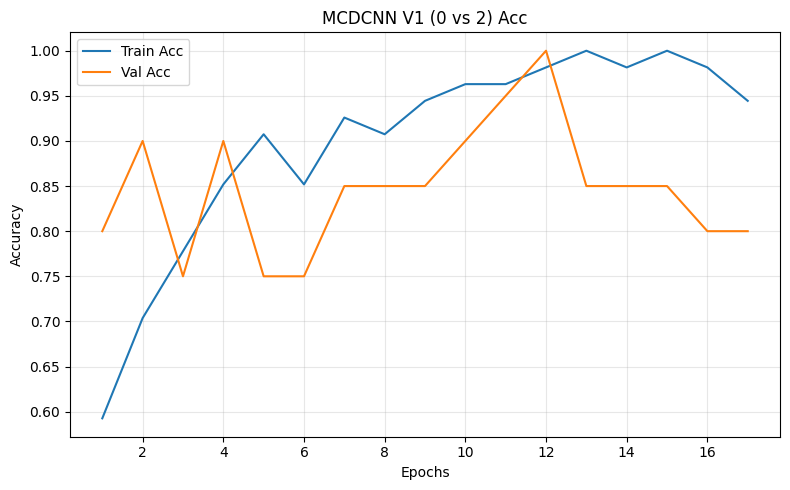

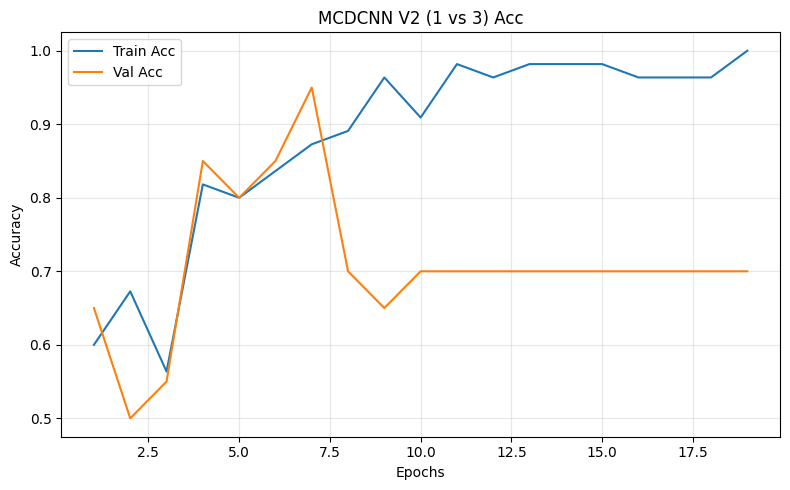

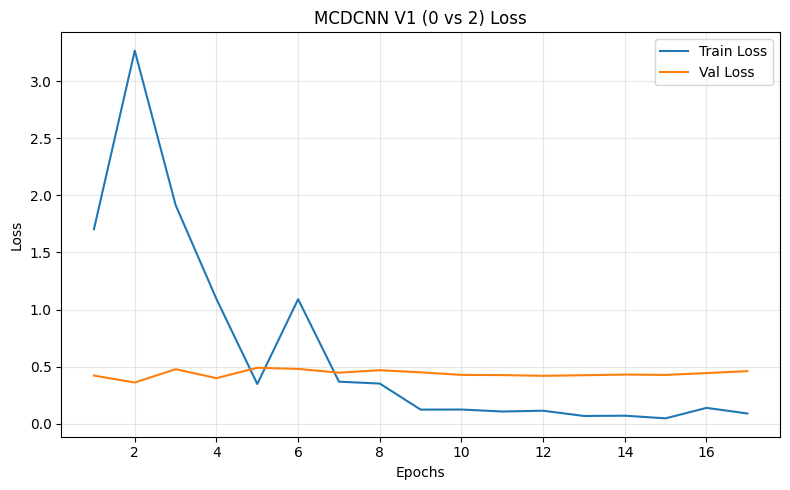

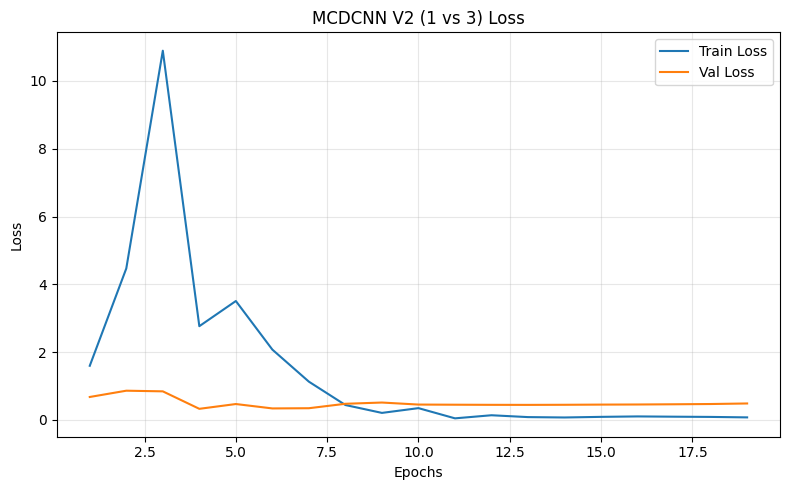

In [3]:
"""
MCDCNN for Eye-Tracking (Participant-wise Split, Early Stopping, LR Plateau)
- Compatible with the current pipeline: Fixed length (1500), /960, Robust per-trace, Subject-independent split
- One branch per channel: Conv -> BN -> ReLU -> Pool × 2 -> Flatten -> Concatenate -> Dense -> Dropout -> Sigmoid
- Supports any number of channels (default 4: [abs_lx, abs_ly, abs_rx, abs_ry])
"""

import time
from typing import Tuple, Dict, List, Optional
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, Model, Input, regularizers
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt

# Reuse existing ones:SEED, load_pair_experiment, split_by_participant_train_val_test,
# compute_class_weight, get_optimizer
# from import ...

np.random.seed(SEED)
tf.random.set_seed(SEED)

# MCDCNN Architecture
def _mcdcnn_branch(x: tf.Tensor,
                   filters: Tuple[int,int]=(32,64),
                   kernels: Tuple[int,int]=(7,5),
                   pools: Tuple[int,int]=(2,2),
                   l2: float = 1e-4,
                   use_bn: bool = True,
                   name_prefix: str = "ch") -> tf.Tensor:
    """Single channel branch: Conv->BN->ReLU->Pool ×2 -> Flatten"""
    assert len(filters)==2 and len(kernels)==2 and len(pools)==2
    x = layers.Conv1D(filters[0], kernels[0], padding='same', use_bias=not use_bn,
                      kernel_regularizer=regularizers.l2(l2),
                      name=f"{name_prefix}_conv1")(x)
    if use_bn: x = layers.BatchNormalization(name=f"{name_prefix}_bn1")(x)
    x = layers.ReLU(name=f"{name_prefix}_relu1")(x)
    x = layers.MaxPooling1D(pool_size=pools[0], name=f"{name_prefix}_pool1")(x)

    x = layers.Conv1D(filters[1], kernels[1], padding='same', use_bias=not use_bn,
                      kernel_regularizer=regularizers.l2(l2),
                      name=f"{name_prefix}_conv2")(x)
    if use_bn: x = layers.BatchNormalization(name=f"{name_prefix}_bn2")(x)
    x = layers.ReLU(name=f"{name_prefix}_relu2")(x)
    x = layers.MaxPooling1D(pool_size=pools[1], name=f"{name_prefix}_pool2")(x)

    x = layers.Flatten(name=f"{name_prefix}_flat")(x)
    return x

def build_mcdcnn(input_shape: Tuple[int,int],
                 filters: Tuple[int,int]=(32,64),
                 kernels: Tuple[int,int]=(7,5),
                 pools: Tuple[int,int]=(2,2),
                 l2: float = 1e-4,
                 dropout: float = 0.5,
                 use_bn: bool = True) -> Model:
    """
    input_shape: (T, C)  e.g., (1500, 4)
    Build a branch for each channel and then concatenate.
    """
    T, C = input_shape
    inp = Input(shape=input_shape, name="mcdcnn_input")

    # Split out (T,1) for each channel
    branches = []
    for c in range(C):
        xc = layers.Lambda(lambda z, k=c: tf.expand_dims(z[:, :, k], axis=-1),
                           name=f"slice_ch{c}")(inp)
        bc = _mcdcnn_branch(xc, filters=filters, kernels=kernels, pools=pools,
                            l2=l2, use_bn=use_bn, name_prefix=f"ch{c}")
        branches.append(bc)

    z = layers.Concatenate(name="concat")((branches if len(branches)>1 else branches[0:1]))
    z = layers.Dense(64, activation='relu', kernel_regularizer=regularizers.l2(l2), name='fc')(z)
    z = layers.Dropout(dropout, name='drop')(z)
    out = layers.Dense(1, activation='sigmoid', name='logit')(z)
    model = Model(inp, out, name=f"mcdcnn_{C}ch")
    return model

# Training/Evaluation Package
def run_experiment_mcdcnn(
    csv_dir: str,
    label_pair: Tuple[int, int],
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    # Model hyperparameters
    filters: Tuple[int,int]=(32,64),
    kernels: Tuple[int,int]=(7,5),
    pools: Tuple[int,int]=(2,2),
    l2: float = 1e-4,
    dropout: float = 0.5,
    use_bn: bool = True
) -> Dict:
    """
    Synchronize with CNN baseline: Load -> Split -> Compile -> Early Stopping & Reduce LR On Plateau -> Test Report
    """
    # Load
    X, y, files = load_pair_experiment(
        csv_dir,
        label_pair,
        resample_len=target_len,
        max_nan_ratio=0.05,
        divide_by_960=True,
        use_robust_scale=True
    )

    # Independent division of subjects
    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    print(f"[Split] train={len(ytr)}, val={len(yva)}, test={len(yte)}")

    # Model
    model = build_mcdcnn(
        input_shape=(target_len, X.shape[-1]),
        filters=filters, kernels=kernels, pools=pools,
        l2=l2, dropout=dropout, use_bn=use_bn
    )
    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    model.summary()

    # Callback
    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
        tf.keras.callbacks.CSVLogger(f'train_log_mcdcnn_{label_pair[0]}_{label_pair[1]}.csv', append=False)
    ]
    class_weight = compute_class_weight(ytr)

    # Train
    t0 = time.perf_counter()
    history = model.fit(
        Xtr, ytr,
        validation_data=(Xva, yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=1,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()
    print(f"[Time][MCDCNN] Pair {label_pair}: training wall-clock {t1 - t0:.2f}s")

    # Test
    yprob = model.predict(Xte, batch_size=batch_size, verbose=0).ravel()
    ypred = (yprob > 0.5).astype(int)
    report = classification_report(yte, ypred, digits=4)
    print(f"\n[TEST][MCDCNN] Pair {label_pair} classification report:\n{report}")

    return {
        'label_pair': label_pair,
        'history': history.history,
        'test_report': report,
        'model': model,
        'id_splits': id_splits
    }

# Simple drawing tool (same as CNN version)
def plot_accuracy_curve(history_dict, title, save_path=None):
    acc = history_dict.get('accuracy', [])
    val_acc = history_dict.get('val_accuracy', [])
    epochs = range(1, len(acc) + 1)
    plt.figure(figsize=(8, 5))
    plt.plot(epochs, acc, label='Train Acc')
    plt.plot(epochs, val_acc, label='Val Acc')
    plt.xlabel('Epochs'); plt.ylabel('Accuracy'); plt.title(title)
    plt.legend(); plt.grid(True, alpha=0.3); plt.tight_layout()
    if save_path: plt.savefig(save_path, dpi=200)
    plt.show()

def plot_loss_curve(history_dict, title, save_path=None):
    loss = history_dict.get('loss', [])
    val_loss = history_dict.get('val_loss', [])
    epochs = range(1, len(loss) + 1)
    plt.figure(figsize=(8, 5))
    plt.plot(epochs, loss, label='Train Loss')
    plt.plot(epochs, val_loss, label='Val Loss')
    plt.xlabel('Epochs'); plt.ylabel('Loss'); plt.title(title)
    plt.legend(); plt.grid(True, alpha=0.3); plt.tight_layout()
    if save_path: plt.savefig(save_path, dpi=200)
    plt.show()


if __name__ == "__main__":
    csv_path = "/Users/wukehui/Desktop/data science project/project/data/first_trials"

    # Same as CNN baseline calling method
    res_02_mcd = run_experiment_mcdcnn(csv_path, (0, 2), target_len=1500)
    res_13_mcd = run_experiment_mcdcnn(csv_path, (1, 3), target_len=1500)

    plot_accuracy_curve(res_02_mcd['history'], title='MCDCNN V1 (0 vs 2) Acc', save_path='train_curve_mcd_v1_acc.png')
    plot_accuracy_curve(res_13_mcd['history'], title='MCDCNN V2 (1 vs 3) Acc', save_path='train_curve_mcd_v2_acc.png')
    plot_loss_curve(res_02_mcd['history'], title='MCDCNN V1 (0 vs 2) Loss', save_path='train_curve_mcd_v1_loss.png')
    plot_loss_curve(res_13_mcd['history'], title='MCDCNN V2 (1 vs 3) Loss', save_path='train_curve_mcd_v2_loss.png')


transfer learning for mcdcnn

[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Pretrain][MCDCNN] source=(0, 2)
Epoch 1/60


/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 1s 120ms/step - loss: 4.1977 - accuracy: 0.4815 - val_loss: 0.4581 - val_accuracy: 0.9000 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 0s 106ms/step - loss: 1.7580 - accuracy: 0.8333 - val_loss: 0.7587 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 0s 115ms/step - loss: 1.9707 - accuracy: 0.8519 - val_loss: 0.3902 - val_accuracy: 0.8500 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 0s 113ms/step - loss: 2.4965 - accuracy: 0.7778 - val_loss: 0.4777 - val_accuracy: 0.8000 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 0s 121ms/step - loss: 1.2388 - accuracy: 0.8704 - val_loss: 0.4733 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 6/60
4/4 [==============================] - 0s 120ms/step - loss: 1.0689 - accuracy: 0.9074 - val_loss: 0.8451 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 7/60
4/4 [==============================] - 0s 121ms/step - los

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 0s 94ms/step - loss: 6.1659 - accuracy: 0.6727 - val_loss: 13.3789 - val_accuracy: 0.5000 - lr: 0.0030
Epoch 2/20
4/4 [==============================] - 0s 108ms/step - loss: 6.6043 - accuracy: 0.6545 - val_loss: 8.9601 - val_accuracy: 0.5500 - lr: 0.0030
Epoch 3/20
4/4 [==============================] - 0s 118ms/step - loss: 10.1415 - accuracy: 0.6000 - val_loss: 0.4900 - val_accuracy: 0.9000 - lr: 0.0030
Epoch 4/20
4/4 [==============================] - 0s 88ms/step - loss: 2.9432 - accuracy: 0.8182 - val_loss: 4.4899 - val_accuracy: 0.7000 - lr: 0.0030
Epoch 5/20
4/4 [==============================] - 0s 87ms/step - loss: 6.8876 - accuracy: 0.6727 - val_loss: 1.3559 - val_accuracy: 0.9000 - lr: 0.0030
Epoch 6/20
4/4 [==============================] - 0s 91ms/step - loss: 0.7157 - accuracy: 0.9091 - val_loss: 0.1704 - val_accuracy: 1.0000 - lr: 0.0030
Epoch 7/20
4/4 [==============================] - 0s 99ms/step - loss: 1.1611 - accuracy: 0.872

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


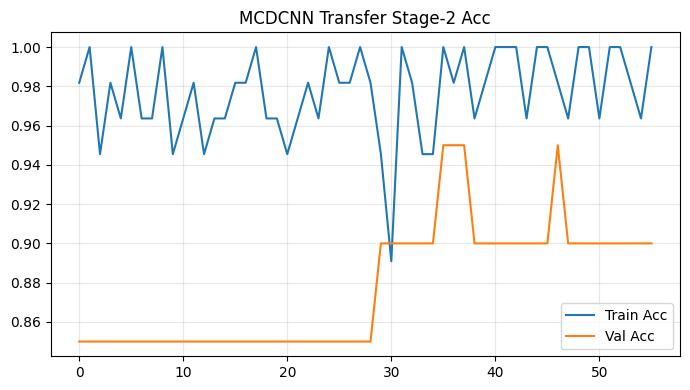

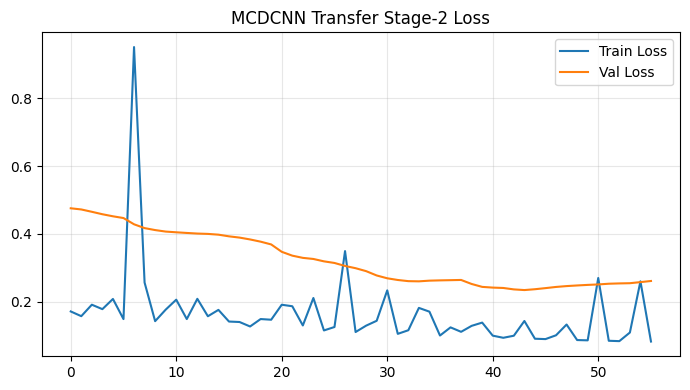

In [18]:
"""
Transfer Learning for MCDCNN on Eye-Tracking
- Stage 0: Pretrain MCDCNN extractor on SOURCE (e.g., (0,2))
- Stage 1: Load extractor, freeze all conv branches, train head only on TARGET
- Stage 1.5: BN-Adapt (only BatchNorm layers trainable) on TARGET
- Stage 2: Unfreeze last conv block in each branch (conv2/bn2) and fine-tune @ low LR
- Threshold tuned on VAL by balanced accuracy, then report TEST
"""

import os, time
from typing import Tuple, Dict, List, Optional
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, Model, Input, regularizers
from sklearn.metrics import classification_report, balanced_accuracy_score

# Global seeds
SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)


# Utilities (use existing ones; these are safe fallbacks)
def get_optimizer(lr=3e-4):
    try:
        return tf.keras.optimizers.legacy.Adam(learning_rate=lr)
    except Exception:
        return tf.keras.optimizers.Adam(learning_rate=lr)

def compute_class_weight(y_train: np.ndarray) -> Optional[Dict[int, float]]:
    n0 = int((y_train == 0).sum())
    n1 = int((y_train == 1).sum())
    if min(n0, n1) == 0:
        return None
    w0 = (n0 + n1) / (2.0 * n0)
    w1 = (n0 + n1) / (2.0 * n1)
    return {0: float(w0), 1: float(w1)}


# MCDCNN extractor & classifier
def _mcdcnn_branch(x: tf.Tensor,
                   filters: Tuple[int,int]=(32,64),
                   kernels: Tuple[int,int]=(7,5),
                   pools: Tuple[int,int]=(2,2),
                   l2: float = 1e-4,
                   use_bn: bool = True,
                   name_prefix: str = "ch") -> tf.Tensor:
    """Single-channel branch: Conv->BN->ReLU->Pool ×2 -> Flatten"""
    x = layers.Conv1D(filters[0], kernels[0], padding='same', use_bias=not use_bn,
                      kernel_regularizer=regularizers.l2(l2), name=f"{name_prefix}_conv1")(x)
    if use_bn: x = layers.BatchNormalization(name=f"{name_prefix}_bn1")(x)
    x = layers.ReLU(name=f"{name_prefix}_relu1")(x)
    x = layers.MaxPooling1D(pool_size=pools[0], name=f"{name_prefix}_pool1")(x)

    x = layers.Conv1D(filters[1], kernels[1], padding='same', use_bias=not use_bn,
                      kernel_regularizer=regularizers.l2(l2), name=f"{name_prefix}_conv2")(x)
    if use_bn: x = layers.BatchNormalization(name=f"{name_prefix}_bn2")(x)
    x = layers.ReLU(name=f"{name_prefix}_relu2")(x)
    x = layers.MaxPooling1D(pool_size=pools[1], name=f"{name_prefix}_pool2")(x)

    x = layers.Flatten(name=f"{name_prefix}_flat")(x)
    return x

def build_mcdcnn_extractor(input_shape: Tuple[int,int],
                           filters: Tuple[int,int]=(32,64),
                           kernels: Tuple[int,int]=(7,5),
                           pools: Tuple[int,int]=(2,2),
                           l2: float = 1e-4,
                           use_bn: bool = True) -> Model:
    """
    Return extractor that outputs concatenated flattened features from all channel-branches.
    """
    T, C = input_shape
    inp = Input(shape=input_shape, name="mcd_input")
    branches = []
    for c in range(C):
        xc = layers.Lambda(lambda z, k=c: tf.expand_dims(z[:, :, k], axis=-1),
                           name=f"slice_ch{c}")(inp)
        bc = _mcdcnn_branch(xc, filters=filters, kernels=kernels, pools=pools,
                            l2=l2, use_bn=use_bn, name_prefix=f"ch{c}")
        branches.append(bc)
    z = layers.Concatenate(name="concat")((branches if len(branches)>1 else branches[0:1]))
    # Extractor output z (flattened features after concatenation)
    return Model(inp, z, name=f"mcd_extractor_{C}ch")

def build_classifier_from_extractor_mcd(extractor: Model, dropout=0.5, l2: float=1e-4) -> Model:
    inp = extractor.input
    x = extractor.output
    x = layers.Dense(64, activation='relu', kernel_regularizer=regularizers.l2(l2), name='fc1')(x)
    x = layers.Dropout(dropout, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='mcd_transfer')


# Freezing helpers
def freeze_all_but_head(model: Model):
    """Freeze everything except head (fc1/drop/logit)."""
    for l in model.layers:
        l.trainable = (l.name in ['fc1','drop','logit'])

def bn_adapt_only(model: Model):
    """Only BatchNorm layers trainable (to adapt running stats)."""
    for l in model.layers:
        if isinstance(l, tf.keras.layers.BatchNormalization):
            l.trainable = True
        else:
            l.trainable = False

def unfreeze_last_block(model: Model):
    """
    Unfreeze last conv block in each branch: *conv2 / *bn2 (+ head).
    Keep earlier layers frozen.
    """
    # First freeze all
    for l in model.layers:
        l.trainable = False
    # Then unfreeze conv2/bn2 from each branch and head layers
    for l in model.layers:
        if any(s in l.name for s in ['_conv2', '_bn2', 'fc1', 'drop', 'logit']):
            l.trainable = True

def set_all_trainable(model: Model, flag: bool = True):
    for l in model.layers:
        l.trainable = flag


# Threshold tuning
def tune_threshold_bal_acc(y_true: np.ndarray, y_prob: np.ndarray) -> Tuple[float, float]:
    """Grid search [0.1, 0.9] for threshold maximizing balanced accuracy."""
    best_thr, best_bal = 0.5, -1.0
    for thr in np.linspace(0.1, 0.9, 33):
        y_pred = (y_prob >= thr).astype(int)
        bal = balanced_accuracy_score(y_true, y_pred)
        if bal > best_bal:
            best_bal, best_thr = bal, float(thr)
    return best_thr, best_bal


# Stage 0: pretrain on SOURCE
def pretrain_mcd_extractor_on_source(
    csv_dir: str, src_pair=(0,2),
    target_len=1500, batch_size=16, max_epochs=60, lr=3e-4,
    filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True,
    save_path='mcd_extractor_src.weights.h5'
) -> str:
    # Load data function (exactly the same as before)
    X, y, files = load_pair_experiment(csv_dir, src_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(X, y, files)

    extractor = build_mcdcnn_extractor((target_len, X.shape[-1]),
                                       filters=filters, kernels=kernels, pools=pools,
                                       l2=l2, use_bn=use_bn)
    model = build_classifier_from_extractor_mcd(extractor, dropout=0.5, l2=l2)
    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=8, min_lr=1e-5, verbose=1),
    ]
    print(f"[Pretrain][MCDCNN] source={src_pair}")
    t0 = time.perf_counter()
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1, callbacks=cbs)
    t1 = time.perf_counter()
    print(f"[Time] Pretrain wall-clock: {t1 - t0:.2f}s")

    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob >= 0.5).astype(int)
    print("[TEST] Pretrain report:\n", classification_report(yte, ypred, digits=4))

    extractor.save_weights(save_path)
    print(f"[SAVE] extractor weights -> {save_path}")
    return save_path


# Transfer to TARGET (head-only -> BN-Adapt -> last-block fine-tune)
def transfer_finetune_mcd(
    csv_dir: str, tgt_pair=(1,3), extractor_weights='mcd_extractor_src.weights.h5',
    target_len=1500, batch_size=16,
    # LRs
    head_lr=3e-3, bn_lr=1e-5, ft_lr=5e-5,
    # Arch
    filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True
):
    X, y, files = load_pair_experiment(csv_dir, tgt_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, split_ids = split_by_participant_train_val_test(X, y, files)
    cls_weight = compute_class_weight(ytr)

    extractor = build_mcdcnn_extractor((target_len, X.shape[-1]),
                                       filters=filters, kernels=kernels, pools=pools,
                                       l2=l2, use_bn=use_bn)
    extractor.load_weights(extractor_weights)

    model = build_classifier_from_extractor_mcd(extractor, dropout=0.5, l2=l2)

    # Stage 1: Head-only
    freeze_all_but_head(model)
    model.compile(optimizer=get_optimizer(head_lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    cbs1 = [
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=4,
                                             min_lr=head_lr/4, verbose=1)
    ]
    print("[Stage 1][MCDCNN] Head-only.")
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1, callbacks=cbs1,
              class_weight=cls_weight)

    # Stage 1.5: BN-Adapt
    print("[BN-Adapt] Only BN trainable. epochs=2, lr=1e-5")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(bn_lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: Last-block fine-tune
    print("[Stage 2][MCDCNN] Unfreeze last conv block (*_conv2/*_bn2) @ LR=5e-5.")
    unfreeze_last_block(model)
    model.compile(optimizer=get_optimizer(ft_lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    cbs2 = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=12, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=8,
                                             min_lr=ft_lr/4, verbose=1)
    ]
    t0 = time.perf_counter()
    hist2 = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                      epochs=60, batch_size=batch_size, verbose=1, callbacks=cbs2,
                      class_weight=cls_weight)
    t1 = time.perf_counter()
    print(f"[Time] Fine-tune wall-clock: {t1 - t0:.2f}s")

    # Threshold tuning on VAL, then TEST
    vprob = model.predict(Xva, batch_size=batch_size).ravel()
    thr, bal = tune_threshold_bal_acc(yva, vprob)
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")

    tprob = model.predict(Xte, batch_size=batch_size).ravel()
    tpred = (tprob >= thr).astype(int)
    print("\n[TEST] Transfer report (thr tuned):\n",
          classification_report(yte, tpred, digits=4))

    return model, (Xtr, ytr, Xva, yva, Xte, yte, split_ids), hist2.history, thr


# Run
if __name__ == "__main__":
    CSV_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"

    # Stage 0: pretrain on (0,2) and save extractor weights
    extractor_w = pretrain_mcd_extractor_on_source(
        csv_dir=CSV_DIR, src_pair=(0,2),
        target_len=1500, batch_size=16, max_epochs=60, lr=3e-4,
        filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True,
        save_path='mcd_extractor_0_2.weights.h5'
    )

    # Transfer to (1,3): head-only -> BN-Adapt -> last-block fine-tune
    model_t, splits, hist2, best_thr = transfer_finetune_mcd(
        csv_dir=CSV_DIR, tgt_pair=(1,3),
        extractor_weights=extractor_w, target_len=1500, batch_size=16,
        head_lr=3e-3, bn_lr=1e-5, ft_lr=5e-5,
        filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True
    )

    # Simple drawing
    import matplotlib.pyplot as plt
    def plot_hist(h, title):
        plt.figure(figsize=(7,4))
        plt.plot(h.get('accuracy', []), label='Train Acc')
        plt.plot(h.get('val_accuracy', []), label='Val Acc')
        plt.legend(); plt.title(title + " Acc"); plt.grid(alpha=0.3); plt.tight_layout(); plt.show()
        plt.figure(figsize=(7,4))
        plt.plot(h.get('loss', []), label='Train Loss')
        plt.plot(h.get('val_loss', []), label='Val Loss')
        plt.legend(); plt.title(title + " Loss"); plt.grid(alpha=0.3); plt.tight_layout(); plt.show()
    plot_hist(hist2, "MCDCNN Transfer Stage-2")


first_trials → repeats

[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Pretrain][MCDCNN] SOURCE=first_trials, pair=(0, 2)
Epoch 1/60
4/4 [==============================] - 1s 99ms/step - loss: 2.7025 - accuracy: 0.6111 - val_loss: 0.6823 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 0s 55ms/step - loss: 3.6883 - accuracy: 0.7037 - val_loss: 0.4844 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 0s 60ms/step - loss: 2.3316 - accuracy: 0.7963 - val_loss: 1.1716 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 0s 48ms/step - loss: 2.2100 - accuracy: 0.7222 - val_loss: 0.7205 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 0s 52ms/step - loss: 0.8043 - accuracy: 0.8704 - val_loss: 0.4437 - val_accuracy: 0.8500 - lr: 3.0000e-04
Epoch 6/60
4/4 [==============================] - 0s 56ms/step - loss: 1.1820 - accuracy: 0.7963 - v

Epoch 3/60
2/2 [==============================] - 0s 32ms/step - loss: 4.8590 - accuracy: 0.9500 - val_loss: 0.9009 - val_accuracy: 0.8750 - lr: 5.0000e-05
Epoch 4/60
2/2 [==============================] - 0s 30ms/step - loss: 7.1914 - accuracy: 0.9500 - val_loss: 0.9370 - val_accuracy: 0.8750 - lr: 5.0000e-05
Epoch 5/60
2/2 [==============================] - 0s 27ms/step - loss: 0.1561 - accuracy: 1.0000 - val_loss: 0.9645 - val_accuracy: 0.8750 - lr: 5.0000e-05
Epoch 6/60
2/2 [==============================] - 0s 29ms/step - loss: 0.1551 - accuracy: 1.0000 - val_loss: 0.9808 - val_accuracy: 0.8750 - lr: 5.0000e-05
Epoch 7/60
2/2 [==============================] - 0s 27ms/step - loss: 0.1541 - accuracy: 1.0000 - val_loss: 0.9993 - val_accuracy: 0.8750 - lr: 5.0000e-05
Epoch 8/60
2/2 [==============================] - 0s 30ms/step - loss: 0.1531 - accuracy: 1.0000 - val_loss: 1.0132 - val_accuracy: 0.8750 - lr: 5.0000e-05
Epoch 9/60
2/2 [==============================] - 0s 28ms/step -

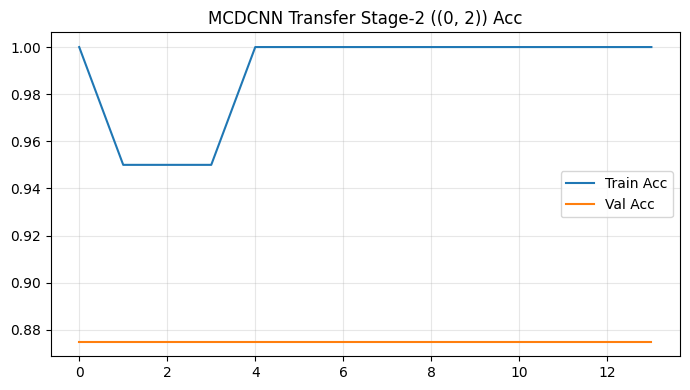

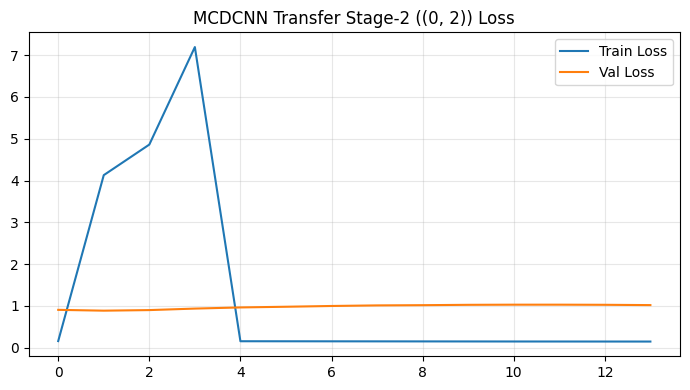

'\n# ===== 如果你没有加载函数，可用这个“极简版”替代（解开注释） =====\nimport pandas as pd\nfrom sklearn.model_selection import train_test_split\n\nREQUIRED_COLS = [\'abs_lx\',\'abs_ly\',\'abs_rx\',\'abs_ry\']\ndef get_participant_id(filename: str) -> str:\n    return os.path.splitext(filename)[0].split(\'_\')[0]\n\ndef _linear_resample(x: np.ndarray, target_len: int) -> np.ndarray:\n    T, C = x.shape\n    if T == target_len: return x\n    src = np.linspace(0.0, 1.0, T, dtype=np.float32)\n    dst = np.linspace(0.0, 1.0, target_len, dtype=np.float32)\n    out = np.empty((target_len, C), dtype=x.dtype)\n    for c in range(C): out[:, c] = np.interp(dst, src, x[:, c])\n    return out\n\ndef _robust_scale_per_trace(x: np.ndarray, eps: float = 1e-6) -> np.ndarray:\n    x2 = x.copy()\n    for c in range(x.shape[1]):\n        v = x[:,c]; med = np.median(v); q75,q25 = np.percentile(v,75),np.percentile(v,25)\n        iqr = max(q75-q25, eps); x2[:,c] = (v - med) / iqr\n    return x2\n\ndef load_pair_experiment(csv_dir: 

In [5]:
"""
MCDCNN Transfer: first_trials -> repeats (Eye-Tracking)
- Stage 0: Pretrain MCDCNN extractor on SOURCE (first_trials)
- Stage 1: Head-only on TARGET (repeats)
- Stage 1.5: BN-Adapt (only BN trainable, very low LR, few epochs)
- Stage 2: Fine-tune last conv block (*_conv2/*_bn2) on TARGET @ low LR
- Threshold tuning by balanced accuracy on VAL, then TEST
"""

import os, time
from typing import Tuple, Dict, List, Optional
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, Model, Input, regularizers
from sklearn.metrics import classification_report, balanced_accuracy_score

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Optimizer / class_weight
def get_optimizer(lr=3e-4):
    try:
        return tf.keras.optimizers.legacy.Adam(learning_rate=lr)
    except Exception:
        return tf.keras.optimizers.Adam(learning_rate=lr)

def compute_class_weight(y_train: np.ndarray) -> Optional[Dict[int, float]]:
    n0 = int((y_train == 0).sum())
    n1 = int((y_train == 1).sum())
    if min(n0, n1) == 0:
        return None
    w0 = (n0 + n1) / (2.0 * n0)
    w1 = (n0 + n1) / (2.0 * n1)
    return {0: float(w0), 1: float(w1)}

# MCDCNN extractor & classifier
def _mcdcnn_branch(x: tf.Tensor,
                   filters: Tuple[int,int]=(32,64),
                   kernels: Tuple[int,int]=(7,5),
                   pools: Tuple[int,int]=(2,2),
                   l2: float = 1e-4,
                   use_bn: bool = True,
                   name_prefix: str = "ch") -> tf.Tensor:
    x = layers.Conv1D(filters[0], kernels[0], padding='same', use_bias=not use_bn,
                      kernel_regularizer=regularizers.l2(l2), name=f"{name_prefix}_conv1")(x)
    if use_bn: x = layers.BatchNormalization(name=f"{name_prefix}_bn1")(x)
    x = layers.ReLU(name=f"{name_prefix}_relu1")(x)
    x = layers.MaxPooling1D(pool_size=pools[0], name=f"{name_prefix}_pool1")(x)

    x = layers.Conv1D(filters[1], kernels[1], padding='same', use_bias=not use_bn,
                      kernel_regularizer=regularizers.l2(l2), name=f"{name_prefix}_conv2")(x)
    if use_bn: x = layers.BatchNormalization(name=f"{name_prefix}_bn2")(x)
    x = layers.ReLU(name=f"{name_prefix}_relu2")(x)
    x = layers.MaxPooling1D(pool_size=pools[1], name=f"{name_prefix}_pool2")(x)

    x = layers.Flatten(name=f"{name_prefix}_flat")(x)
    return x

def build_mcdcnn_extractor(input_shape: Tuple[int,int],
                           filters: Tuple[int,int]=(32,64),
                           kernels: Tuple[int,int]=(7,5),
                           pools: Tuple[int,int]=(2,2),
                           l2: float = 1e-4,
                           use_bn: bool = True) -> Model:
    T, C = input_shape
    inp = Input(shape=input_shape, name="mcd_input")
    branches = []
    for c in range(C):
        xc = layers.Lambda(lambda z, k=c: tf.expand_dims(z[:, :, k], axis=-1),
                           name=f"slice_ch{c}")(inp)
        bc = _mcdcnn_branch(xc, filters=filters, kernels=kernels, pools=pools,
                            l2=l2, use_bn=use_bn, name_prefix=f"ch{c}")
        branches.append(bc)
    z = layers.Concatenate(name="concat")(branches if len(branches)>1 else [branches[0]])
    return Model(inp, z, name=f"mcd_extractor_{C}ch")

def build_classifier_from_extractor_mcd(extractor: Model, dropout=0.5, l2: float=1e-4) -> Model:
    inp = extractor.input
    x = extractor.output
    x = layers.Dense(64, activation='relu', kernel_regularizer=regularizers.l2(l2), name='fc1')(x)
    x = layers.Dropout(dropout, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='mcd_transfer')

# ===== Freeze helpers =====
def freeze_all_but_head(model: Model):
    for l in model.layers:
        l.trainable = (l.name in ['fc1','drop','logit'])

def bn_adapt_only(model: Model):
    for l in model.layers:
        if isinstance(l, tf.keras.layers.BatchNormalization):
            l.trainable = True
        else:
            l.trainable = False

def unfreeze_last_block(model: Model):
    # freeze all first
    for l in model.layers:
        l.trainable = False
    # unfreeze *_conv2 / *_bn2 in each branch, and the head
    for l in model.layers:
        if any(s in l.name for s in ['_conv2', '_bn2', 'fc1', 'drop', 'logit']):
            l.trainable = True

# Threshold tuning
def tune_threshold_bal_acc(y_true: np.ndarray, y_prob: np.ndarray) -> Tuple[float, float]:
    best_thr, best_bal = 0.5, -1.0
    for thr in np.linspace(0.1, 0.9, 33):
        y_pred = (y_prob >= thr).astype(int)
        bal = balanced_accuracy_score(y_true, y_pred)
        if bal > best_bal:
            best_bal, best_thr = bal, float(thr)
    return best_thr, best_bal


# from project:
#   - load_pair_experiment(csv_dir, labels, resample_len=1500, ...)
#   - split_by_participant_train_val_test(X, y, files, val_size, test_size, random_state)

# Stage 0: pretrain on SOURCE (first_trials)
def pretrain_mcd_extractor_on_first(
    src_dir: str, pair=(0,2),
    target_len=1500, batch_size=16, max_epochs=60, lr=3e-4,
    filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True,
    save_path='mcd_extractor_first.weights.h5'
) -> str:
    Xs, ys, fs = load_pair_experiment(src_dir, pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(Xs, ys, fs)

    extractor = build_mcdcnn_extractor((target_len, Xs.shape[-1]),
                                       filters=filters, kernels=kernels, pools=pools,
                                       l2=l2, use_bn=use_bn)
    model = build_classifier_from_extractor_mcd(extractor, dropout=0.5, l2=l2)
    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=8, min_lr=1e-5, verbose=1),
    ]
    print(f"[Pretrain][MCDCNN] SOURCE=first_trials, pair={pair}")
    t0 = time.perf_counter()
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1, callbacks=cbs)
    t1 = time.perf_counter()
    print(f"[Time] Pretrain wall-clock: {t1 - t0:.2f}s")

    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob >= 0.5).astype(int)
    print("[TEST] Pretrain report:\n", classification_report(yte, ypred, digits=4))

    extractor.save_weights(save_path)
    print(f"[SAVE] extractor weights -> {save_path}")
    return save_path

# Stage 1/1.5/2: transfer to TARGET (repeats)
def transfer_first_to_repeats_mcd(
    src_dir: str, tgt_dir: str, pair=(0,2),
    extractor_weights: Optional[str] = None,
    target_len=1500, batch_size=16,
    head_lr=3e-3, bn_lr=1e-5, ft_lr=5e-5,
    filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True
):
    # Load SOURCE (only when we need to pretrain)
    if extractor_weights is None:
        extractor_weights = pretrain_mcd_extractor_on_first(
            src_dir=src_dir, pair=pair, target_len=target_len, batch_size=batch_size,
            max_epochs=60, lr=3e-4, filters=filters, kernels=kernels, pools=pools, l2=l2, use_bn=use_bn,
            save_path=f"mcd_extractor_first_{pair[0]}_{pair[1]}.weights.h5"
        )

    # Load TARGET (repeats)
    Xt, yt, ft = load_pair_experiment(tgt_dir, pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, split_ids = split_by_participant_train_val_test(
        Xt, yt, ft, val_size=0.25, test_size=0.25, random_state=SEED
    )
    print("[Split target pids]", split_ids)
    cls_weight = compute_class_weight(ytr)

    # Build model + load extractor weights
    extractor = build_mcdcnn_extractor((target_len, Xt.shape[-1]),
                                       filters=filters, kernels=kernels, pools=pools,
                                       l2=l2, use_bn=use_bn)
    extractor.load_weights(extractor_weights)
    model = build_classifier_from_extractor_mcd(extractor, dropout=0.5, l2=l2)

    # Stage 1: head-only
    freeze_all_but_head(model)
    model.compile(optimizer=get_optimizer(head_lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    print("[Stage 1] Head-only.")
    cbs1 = [
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=head_lr/4, verbose=1)
    ]
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1, callbacks=cbs1,
              class_weight=cls_weight)

    # Stage 1.5: BN-Adapt
    print("[BN-Adapt] Only BN trainable. epochs=2, lr=1e-5")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(bn_lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: last-block fine-tune
    print("[Stage 2] Unfreeze last conv block (*_conv2/*_bn2) @ LR=5e-5.")
    unfreeze_last_block(model)
    model.compile(optimizer=get_optimizer(ft_lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    cbs2 = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=12, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=8, min_lr=ft_lr/4, verbose=1)
    ]
    t0 = time.perf_counter()
    hist2 = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                      epochs=60, batch_size=batch_size, verbose=1, callbacks=cbs2,
                      class_weight=cls_weight)
    t1 = time.perf_counter()
    print(f"[Time] Fine-tune wall-clock: {t1 - t0:.2f}s")

    # Threshold tuning (VAL) -> TEST
    vprob = model.predict(Xva, batch_size=batch_size).ravel()
    thr, bal = tune_threshold_bal_acc(yva, vprob)
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")

    tprob = model.predict(Xte, batch_size=batch_size).ravel()
    tpred = (tprob >= thr).astype(int)
    print("\n[TEST] Transfer report (thr tuned):\n",
          classification_report(yte, tpred, digits=4))

    return model, (Xtr, ytr, Xva, yva, Xte, yte, split_ids), hist2.history, thr

# Main
if __name__ == "__main__":
    SRC_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    TGT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (0, 2)        # or (1, 3)
    TARGET_LEN = 1500

    # If there is pre-trained weight, fill in the path; otherwise, set None to automatically pre-train.
    EXTRACTOR_WEIGHTS = None   # e.g., "mcd_extractor_first_0_2.weights.h5"

    model_t, splits, hist2, best_thr = transfer_first_to_repeats_mcd(
        src_dir=SRC_DIR, tgt_dir=TGT_DIR, pair=PAIR,
        extractor_weights=EXTRACTOR_WEIGHTS,
        target_len=TARGET_LEN, batch_size=16,
        head_lr=3e-3, bn_lr=1e-5, ft_lr=5e-5,
        filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True
    )

    # Draw the training curve (Stage 2)
    import matplotlib.pyplot as plt
    def plot_hist(h, title):
        plt.figure(figsize=(7,4)); plt.plot(h.get('accuracy', []), label='Train Acc'); plt.plot(h.get('val_accuracy', []), label='Val Acc')
        plt.legend(); plt.title(title + " Acc"); plt.grid(alpha=0.3); plt.tight_layout(); plt.show()
        plt.figure(figsize=(7,4)); plt.plot(h.get('loss', []), label='Train Loss'); plt.plot(h.get('val_loss', []), label='Val Loss')
        plt.legend(); plt.title(title + " Loss"); plt.grid(alpha=0.3); plt.tight_layout(); plt.show()
    plot_hist(hist2, f"MCDCNN Transfer Stage-2 ({PAIR})")

"""
import pandas as pd
from sklearn.model_selection import train_test_split

REQUIRED_COLS = ['abs_lx','abs_ly','abs_rx','abs_ry']
def get_participant_id(filename: str) -> str:
    return os.path.splitext(filename)[0].split('_')[0]

def _linear_resample(x: np.ndarray, target_len: int) -> np.ndarray:
    T, C = x.shape
    if T == target_len: return x
    src = np.linspace(0.0, 1.0, T, dtype=np.float32)
    dst = np.linspace(0.0, 1.0, target_len, dtype=np.float32)
    out = np.empty((target_len, C), dtype=x.dtype)
    for c in range(C): out[:, c] = np.interp(dst, src, x[:, c])
    return out

def _robust_scale_per_trace(x: np.ndarray, eps: float = 1e-6) -> np.ndarray:
    x2 = x.copy()
    for c in range(x.shape[1]):
        v = x[:,c]; med = np.median(v); q75,q25 = np.percentile(v,75),np.percentile(v,25)
        iqr = max(q75-q25, eps); x2[:,c] = (v - med) / iqr
    return x2

def load_pair_experiment(csv_dir: str, labels: Tuple[int,int], resample_len: int = 1500,
                         max_nan_ratio: float = 0.30, divide_by_960: bool = True,
                         use_robust_scale: bool = True):
    X, y, files = [], [], []
    tagA, tagB = f"_{labels[0]}", f"_{labels[1]}"
    for file in sorted(os.listdir(csv_dir)):
        if not file.endswith(".csv"): continue
        if (tagA not in file) and (tagB not in file): continue
        df = pd.read_csv(os.path.join(csv_dir, file))
        raw = df[REQUIRED_COLS].astype(np.float32).values if set(REQUIRED_COLS).issubset(df.columns) else df.iloc[:,1:5].astype(np.float32).values
        if np.isnan(raw).mean() > max_nan_ratio: continue
        raw = pd.DataFrame(raw).fillna(method='ffill').fillna(method='bfill').fillna(0.0).values
        if divide_by_960: raw = raw / 960.0
        seq = _linear_resample(raw, resample_len)
        if use_robust_scale: seq = _robust_scale_per_trace(seq)
        X.append(seq); y.append(0 if tagA in file else 1); files.append(file)
    return np.asarray(X, np.float32), np.asarray(y, np.int64), files

def split_by_participant_train_val_test(X, y, files, val_size=0.25, test_size=0.25, random_state=42):
    pids = np.array([get_participant_id(f) for f in files])
    uniq = np.array(sorted(list(set(pids))))
    pid_trainval, pid_test = train_test_split(uniq, test_size=test_size, random_state=random_state, shuffle=True)
    pid_train, pid_val = train_test_split(pid_trainval, test_size=val_size/(1.0-test_size),
                                          random_state=random_state, shuffle=True)
    def mask(ids): return np.isin(pids, ids)
    return X[mask(pid_train)], y[mask(pid_train)], X[mask(pid_val)], y[mask(pid_val)], X[mask(pid_test)], y[mask(pid_test)], {
        'train_ids': pid_train.tolist(), 'val_ids': pid_val.tolist(), 'test_ids': pid_test.tolist()
    }
"""


repeat trials test for mcdcnn


=== A1: In-domain baseline on FIRST (MCDCNN) ===
[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Pretrain][MCDCNN] SOURCE=first_trials, pair=(0, 2)
Epoch 1/60


/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 1s 121ms/step - loss: 5.5557 - accuracy: 0.5185 - val_loss: 0.8111 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 0s 126ms/step - loss: 2.7010 - accuracy: 0.5926 - val_loss: 0.6586 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 1s 134ms/step - loss: 1.7954 - accuracy: 0.5741 - val_loss: 0.5938 - val_accuracy: 0.8000 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 0s 111ms/step - loss: 0.7320 - accuracy: 0.7407 - val_loss: 0.5611 - val_accuracy: 0.8000 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 0s 124ms/step - loss: 0.6120 - accuracy: 0.8148 - val_loss: 0.5943 - val_accuracy: 0.8500 - lr: 3.0000e-04
Epoch 6/60
4/4 [==============================] - 0s 122ms/step - loss: 0.3125 - accuracy: 0.8704 - val_loss: 0.6277 - val_accuracy: 0.8000 - lr: 3.0000e-04
Epoch 7/60
4/4 [==============================] - 0s 126ms/step - los

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 0s 93ms/step - loss: 4.9589 - accuracy: 0.5741 - val_loss: 6.2878 - val_accuracy: 0.5000 - lr: 0.0030
Epoch 2/20
4/4 [==============================] - 0s 88ms/step - loss: 4.7037 - accuracy: 0.7407 - val_loss: 4.3504 - val_accuracy: 0.7500 - lr: 0.0030
Epoch 3/20
4/4 [==============================] - 1s 124ms/step - loss: 3.9615 - accuracy: 0.7593 - val_loss: 1.0492 - val_accuracy: 0.8000 - lr: 0.0030
Epoch 4/20
4/4 [==============================] - 0s 100ms/step - loss: 2.6119 - accuracy: 0.8333 - val_loss: 1.9071 - val_accuracy: 0.7500 - lr: 0.0030
Epoch 5/20
4/4 [==============================] - 0s 89ms/step - loss: 2.3916 - accuracy: 0.8704 - val_loss: 1.9337 - val_accuracy: 0.8000 - lr: 0.0030
Epoch 6/20
4/4 [==============================] - 0s 95ms/step - loss: 1.5534 - accuracy: 0.8519 - val_loss: 2.5241 - val_accuracy: 0.8000 - lr: 0.0030
Epoch 7/20
4/4 [==============================] - 0s 105ms/step - loss: 0.8295 - accuracy: 0.8889

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


[load_pair_experiment] Labels=(0, 2), files=40, shape=(40, 1500, 4)
[Pretrain][MCDCNN] SOURCE=first_trials, pair=(0, 2)
Epoch 1/60
2/2 [==============================] - ETA: 0s - loss: 7.6305 - accuracy: 0.3636

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


2/2 [==============================] - 0s 117ms/step - loss: 7.6305 - accuracy: 0.3636 - val_loss: 0.4625 - val_accuracy: 1.0000 - lr: 3.0000e-04
Epoch 2/60
2/2 [==============================] - 0s 97ms/step - loss: 1.7730 - accuracy: 0.7273 - val_loss: 0.6114 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 3/60
2/2 [==============================] - 0s 105ms/step - loss: 2.0407 - accuracy: 0.7273 - val_loss: 0.3275 - val_accuracy: 1.0000 - lr: 3.0000e-04
Epoch 4/60
2/2 [==============================] - 0s 97ms/step - loss: 0.7490 - accuracy: 0.8636 - val_loss: 0.7629 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/60
2/2 [==============================] - 0s 97ms/step - loss: 2.8532 - accuracy: 0.8182 - val_loss: 0.9249 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/60
2/2 [==============================] - 0s 101ms/step - loss: 2.3289 - accuracy: 0.7727 - val_loss: 0.6324 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 7/60
2/2 [==============================] - 0s 93ms/step - loss: 0

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


2/2 [==============================] - 0s 100ms/step - loss: 7.5697 - accuracy: 0.2727 - val_loss: 3.1820 - val_accuracy: 0.5000 - lr: 0.0030
Epoch 2/20
2/2 [==============================] - 0s 93ms/step - loss: 5.5406 - accuracy: 0.5909 - val_loss: 5.8390 - val_accuracy: 0.5000 - lr: 0.0030
Epoch 3/20
2/2 [==============================] - 0s 97ms/step - loss: 5.2369 - accuracy: 0.6818 - val_loss: 0.1667 - val_accuracy: 0.8750 - lr: 0.0030
Epoch 4/20
2/2 [==============================] - 0s 84ms/step - loss: 3.4131 - accuracy: 0.7727 - val_loss: 15.8633 - val_accuracy: 0.5000 - lr: 0.0030
Epoch 5/20
2/2 [==============================] - 0s 86ms/step - loss: 2.1822 - accuracy: 0.8636 - val_loss: 17.8753 - val_accuracy: 0.5000 - lr: 0.0030
Epoch 6/20
2/2 [==============================] - 0s 90ms/step - loss: 9.6619 - accuracy: 0.6364 - val_loss: 10.9664 - val_accuracy: 0.5000 - lr: 0.0030
Epoch 7/20
2/2 [==============================] - 0s 89ms/step - loss: 4.7999 - accuracy: 0.818

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


[load_pair_experiment] Labels=(0, 2), files=40, shape=(40, 1500, 4)
3/3 [==============================] - 0s 20ms/step

[EVAL] B1_first→repeats@0.5
label        B1_first→repeats@0.5
thr                           0.5
bal_acc                     0.875
macro_f1                 0.873016
roc_auc                      0.94
auprc                    0.950564
confusion      [[20, 0], [5, 15]]
n                              40
dtype: object
              precision    recall  f1-score   support

           0     0.8000    1.0000    0.8889        20
           1     1.0000    0.7500    0.8571        20

    accuracy                         0.8750        40
   macro avg     0.9000    0.8750    0.8730        40
weighted avg     0.9000    0.8750    0.8730        40


[EVAL] B1_first→repeats@thr_src
label        B1_first→repeats@thr_src
thr                             0.125
bal_acc                         0.825
macro_f1                      0.82401
roc_auc                          0.94
auprc          

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
6/6 [==============================] - 0s 23ms/step

[EVAL] B2_repeats→first@0.5
label        B2_repeats→first@0.5
thr                           0.5
bal_acc                   0.82343
macro_f1                 0.823129
roc_auc                  0.890338
auprc                    0.862691
confusion     [[34, 11], [5, 41]]
n                              91
dtype: object
              precision    recall  f1-score   support

           0     0.8718    0.7556    0.8095        45
           1     0.7885    0.8913    0.8367        46

    accuracy                         0.8242        91
   macro avg     0.8301    0.8234    0.8231        91
weighted avg     0.8297    0.8242    0.8233        91


[EVAL] B2_repeats→first@thr_src
label        B2_repeats→first@thr_src
thr                               0.8
bal_acc                      0.856763
macro_f1                     0.856866
roc_auc                      0.890338
auprc          

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Pretrain][MCDCNN] SOURCE=first_trials, pair=(0, 2)
Epoch 1/60


/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


4/4 [==============================] - 1s 155ms/step - loss: 4.7829 - accuracy: 0.4444 - val_loss: 0.5442 - val_accuracy: 0.8500 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 0s 101ms/step - loss: 0.8114 - accuracy: 0.8704 - val_loss: 0.6031 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 0s 103ms/step - loss: 2.2370 - accuracy: 0.6852 - val_loss: 0.4803 - val_accuracy: 0.8000 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 0s 106ms/step - loss: 0.7995 - accuracy: 0.7963 - val_loss: 0.5793 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 0s 104ms/step - loss: 1.0919 - accuracy: 0.8148 - val_loss: 0.4821 - val_accuracy: 0.8000 - lr: 3.0000e-04
Epoch 6/60
4/4 [==============================] - 0s 101ms/step - loss: 0.9286 - accuracy: 0.8148 - val_loss: 0.5574 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 7/60
4/4 [==============================] - 0s 103ms/step - los

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


1/1 [==============================] - 0s 467ms/step - loss: 0.7172 - accuracy: 0.5625 - val_loss: 0.0367 - val_accuracy: 1.0000 - lr: 0.0030
Epoch 2/20
1/1 [==============================] - 0s 123ms/step - loss: 4.7311 - accuracy: 0.6875 - val_loss: 1.5151 - val_accuracy: 0.7500 - lr: 0.0030
Epoch 3/20
1/1 [==============================] - 0s 105ms/step - loss: 1.2116 - accuracy: 0.9375 - val_loss: 0.1136 - val_accuracy: 1.0000 - lr: 0.0030
Epoch 4/20
1/1 [==============================] - 0s 102ms/step - loss: 0.0488 - accuracy: 1.0000 - val_loss: 0.0545 - val_accuracy: 1.0000 - lr: 0.0030
Epoch 5/20
1/1 [==============================] - 0s 113ms/step - loss: 4.0202 - accuracy: 0.8125 - val_loss: 0.0615 - val_accuracy: 1.0000 - lr: 0.0030
Epoch 6/20
1/1 [==============================] - ETA: 0s - loss: 0.9065 - accuracy: 0.8750
Epoch 6: ReduceLROnPlateau reducing learning rate to 0.001500000013038516.
1/1 [==============================] - 0s 119ms/step - loss: 0.9065 - accuracy:

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


[load_pair_experiment] Labels=(0, 2), files=40, shape=(40, 1500, 4)
[Pretrain][MCDCNN] SOURCE=first_trials, pair=(0, 2)
Epoch 1/60
2/2 [==============================] - ETA: 0s - loss: 11.0223 - accuracy: 0.4545

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


2/2 [==============================] - 0s 124ms/step - loss: 11.0223 - accuracy: 0.4545 - val_loss: 0.4565 - val_accuracy: 0.8750 - lr: 3.0000e-04
Epoch 2/60
2/2 [==============================] - 0s 101ms/step - loss: 2.2318 - accuracy: 0.7273 - val_loss: 0.8802 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/60
2/2 [==============================] - 0s 107ms/step - loss: 5.3971 - accuracy: 0.5455 - val_loss: 0.3934 - val_accuracy: 1.0000 - lr: 3.0000e-04
Epoch 4/60
2/2 [==============================] - 0s 95ms/step - loss: 0.1074 - accuracy: 0.9545 - val_loss: 0.8044 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/60
2/2 [==============================] - 0s 102ms/step - loss: 4.8017 - accuracy: 0.5000 - val_loss: 1.1712 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/60
2/2 [==============================] - 0s 100ms/step - loss: 3.5536 - accuracy: 0.7273 - val_loss: 0.7176 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 7/60
2/2 [==============================] - 0s 100ms/step - los

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


1/1 [==============================] - 0s 175ms/step - loss: 0.6697 - accuracy: 0.7143 - val_loss: 0.8398 - val_accuracy: 0.6667 - lr: 0.0030
Epoch 2/20
1/1 [==============================] - 0s 142ms/step - loss: 1.1064 - accuracy: 0.7857 - val_loss: 10.8525 - val_accuracy: 0.6667 - lr: 0.0030
Epoch 3/20
1/1 [==============================] - 0s 126ms/step - loss: 4.3057 - accuracy: 0.7857 - val_loss: 6.4259 - val_accuracy: 0.6667 - lr: 0.0030
Epoch 4/20
1/1 [==============================] - 0s 116ms/step - loss: 3.5750 - accuracy: 0.8571 - val_loss: 2.4238 - val_accuracy: 0.3333 - lr: 0.0030
Epoch 5/20
1/1 [==============================] - 0s 104ms/step - loss: 0.0522 - accuracy: 1.0000 - val_loss: 4.5491 - val_accuracy: 0.6667 - lr: 0.0030
Epoch 6/20
1/1 [==============================] - ETA: 0s - loss: 0.0589 - accuracy: 1.0000
Epoch 6: ReduceLROnPlateau reducing learning rate to 0.001500000013038516.
1/1 [==============================] - 0s 106ms/step - loss: 0.0589 - accuracy

1/1 [==============================] - 0s 110ms/step - loss: 0.0780 - accuracy: 1.0000 - val_loss: 6.2637 - val_accuracy: 0.6667 - lr: 5.0000e-05
Epoch 30/60
1/1 [==============================] - 0s 107ms/step - loss: 0.0777 - accuracy: 1.0000 - val_loss: 6.2180 - val_accuracy: 0.6667 - lr: 5.0000e-05
Epoch 31/60
1/1 [==============================] - 0s 115ms/step - loss: 0.0774 - accuracy: 1.0000 - val_loss: 6.1771 - val_accuracy: 0.6667 - lr: 5.0000e-05
Epoch 32/60
1/1 [==============================] - 0s 113ms/step - loss: 4.7407 - accuracy: 0.9286 - val_loss: 6.0190 - val_accuracy: 0.6667 - lr: 5.0000e-05
Epoch 33/60
1/1 [==============================] - 0s 114ms/step - loss: 0.0769 - accuracy: 1.0000 - val_loss: 5.8752 - val_accuracy: 0.6667 - lr: 5.0000e-05
Epoch 34/60
1/1 [==============================] - 0s 116ms/step - loss: 0.0766 - accuracy: 1.0000 - val_loss: 5.7447 - val_accuracy: 0.6667 - lr: 5.0000e-05
Epoch 35/60
1/1 [==============================] - 0s 110ms/step

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
[load_pair_experiment] Labels=(0, 2), files=40, shape=(40, 1500, 4)
Epoch 1/20
2/5 [===========>..................] - ETA: 0s - loss: 10.1776 - accuracy: 0.4062

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


5/5 [==============================] - 0s 96ms/step - loss: 6.4144 - accuracy: 0.5676 - val_loss: 0.5670 - val_accuracy: 0.8750 - lr: 0.0030
Epoch 2/20
5/5 [==============================] - 0s 88ms/step - loss: 2.9391 - accuracy: 0.7432 - val_loss: 1.1742 - val_accuracy: 0.8333 - lr: 0.0030
Epoch 3/20
5/5 [==============================] - 0s 85ms/step - loss: 1.3353 - accuracy: 0.7432 - val_loss: 1.3414 - val_accuracy: 0.7917 - lr: 0.0030
Epoch 4/20
5/5 [==============================] - 0s 85ms/step - loss: 0.9039 - accuracy: 0.8243 - val_loss: 0.4405 - val_accuracy: 0.9167 - lr: 0.0030
Epoch 5/20
5/5 [==============================] - 0s 94ms/step - loss: 0.6753 - accuracy: 0.8784 - val_loss: 0.6608 - val_accuracy: 0.9167 - lr: 0.0030
Epoch 6/20
5/5 [==============================] - 0s 91ms/step - loss: 0.5214 - accuracy: 0.8919 - val_loss: 0.9805 - val_accuracy: 0.7917 - lr: 0.0030
Epoch 7/20
5/5 [==============================] - 0s 88ms/step - loss: 0.3443 - accuracy: 0.8784 - 

Epoch 29/60
5/5 [==============================] - 0s 94ms/step - loss: 0.0823 - accuracy: 1.0000 - val_loss: 0.7455 - val_accuracy: 0.8750 - lr: 1.2500e-05
Epoch 30/60
5/5 [==============================] - 0s 94ms/step - loss: 0.0821 - accuracy: 1.0000 - val_loss: 0.7532 - val_accuracy: 0.8750 - lr: 1.2500e-05
Epoch 31/60
5/5 [==============================] - 0s 96ms/step - loss: 0.0914 - accuracy: 1.0000 - val_loss: 0.7627 - val_accuracy: 0.8750 - lr: 1.2500e-05
Epoch 32/60
5/5 [==============================] - 0s 97ms/step - loss: 0.0899 - accuracy: 1.0000 - val_loss: 0.7739 - val_accuracy: 0.8750 - lr: 1.2500e-05
Epoch 33/60
5/5 [==============================] - 0s 94ms/step - loss: 0.1849 - accuracy: 0.9865 - val_loss: 0.7859 - val_accuracy: 0.8750 - lr: 1.2500e-05
Epoch 34/60
5/5 [==============================] - 0s 98ms/step - loss: 0.0929 - accuracy: 0.9865 - val_loss: 0.7971 - val_accuracy: 0.8750 - lr: 1.2500e-05
Epoch 35/60
5/5 [==============================] - 0s 96ms

/Users/wukehui/anaconda3/lib/python3.11/site-packages/tensorflow/python/data/ops/structured_function.py:265: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
[load_pair_experiment] Labels=(0, 2), files=40, shape=(40, 1500, 4)
[KS] min p=1.011e-01, median p=5.888e-01, share<=0.05=0.000


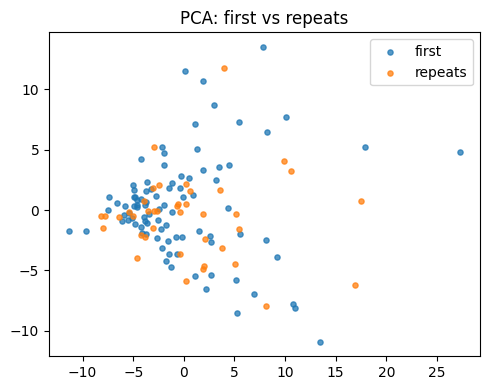

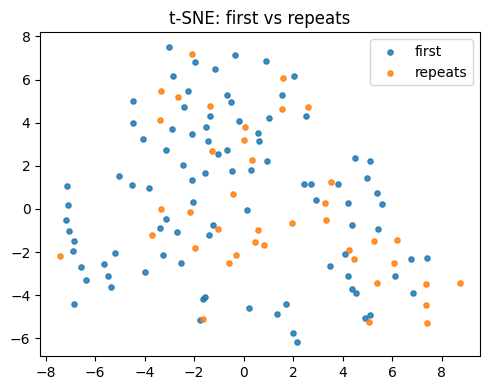

In [20]:
# Repeat Trials Generalisation (RTG) for MCDCNN
import os, numpy as np, pandas as pd, tensorflow as tf
from typing import Optional, Tuple, Dict, List
from tensorflow.keras import Model
from sklearn.model_selection import train_test_split
from sklearn.metrics import (classification_report, balanced_accuracy_score, f1_score,
                             roc_auc_score, average_precision_score, confusion_matrix)

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Eval helpers
def predict_prob_on_dir(model: Model, data_dir: str, pair=(0,2), target_len=1500, batch_size=16):
    """Perform inference on all samples in data_dir and return y_true, y_prob, and files."""
    X, y, files = load_pair_experiment(data_dir, pair, resample_len=target_len)
    y_prob = model.predict(X, batch_size=batch_size).ravel()
    return y, y_prob, files

def evaluate_fixed_threshold(y_true, y_prob, thr=0.5, label=""):
    y_pred = (y_prob >= thr).astype(int)
    out = {
        "label": label,
        "thr": float(thr),
        "bal_acc": balanced_accuracy_score(y_true, y_pred),
        "macro_f1": f1_score(y_true, y_pred, average='macro'),
        "roc_auc": roc_auc_score(y_true, y_prob) if len(np.unique(y_true))==2 else np.nan,
        "auprc": average_precision_score(y_true, y_prob),
        "confusion": confusion_matrix(y_true, y_pred).tolist(),
        "n": int(len(y_true))
    }
    print("\n[EVAL]", label)
    print(pd.Series(out))
    print(classification_report(y_true, y_pred, digits=4))
    return out

def evaluate_with_threshold(model: Model, Xv, yv, Xt, yt, batch_size=16):
    """Use balanced accuracy to adjust the threshold on the validation set and then evaluate on the test set."""
    vprob = model.predict(Xv, batch_size=batch_size).ravel()
    thr, bal = tune_threshold_bal_acc(yv, vprob)
    tprob = model.predict(Xt, batch_size=batch_size).ravel()
    tpred = (tprob >= thr).astype(int)
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")
    print("\n[TEST] (thr tuned on VAL)\n", classification_report(yt, tpred, digits=4))
    return thr, bal

# A) In-domain baselines (MCDCNN)
def run_in_domain_baseline_mcd(data_dir: str, pair=(0,2), target_len=1500, batch_size=16, tag="first",
                               head_lr=3e-3, bn_lr=1e-5, ft_lr=5e-5,
                               filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True):
    """
    Train and test in the same domain (with subject splitting), and present the upper bound performance (MCDCNN) in the domain.
    Process: Pre-train the extractor in the domain → Train the head → BN-Adapt → Unfreeze each branch and fine-tune *_conv2/*_bn2 → Adjust the threshold.
    """
    # Pre-training (extractor weights)
    w_path = pretrain_mcd_extractor_on_first(
        src_dir=data_dir, pair=pair, target_len=target_len,
        max_epochs=60, batch_size=batch_size, lr=3e-4,
        filters=filters, kernels=kernels, pools=pools, l2=l2, use_bn=use_bn,
        save_path=f"mcd_extractor_{tag}_{pair[0]}_{pair[1]}.weights.h5"
    )

    # Segmentation
    Xt, yt, ft = load_pair_experiment(data_dir, pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(Xt, yt, ft, random_state=SEED)

    # Build & Load
    extractor = build_mcdcnn_extractor((target_len, Xt.shape[-1]),
                                       filters=filters, kernels=kernels, pools=pools,
                                       l2=l2, use_bn=use_bn)
    extractor.load_weights(w_path)
    model = build_classifier_from_extractor_mcd(extractor, dropout=0.5, l2=l2)

    # Stage 1: head-only
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(head_lr),
                  loss='binary_crossentropy', metrics=['accuracy'])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5,
                                                 patience=5, min_lr=head_lr/4, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1,
              callbacks=cbs1, class_weight=cls_weight)

    # BN-Adapt
    print("[BN-Adapt] epochs=2, lr=1e-5")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(bn_lr),
                  loss='binary_crossentropy', metrics=['accuracy'])
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: last-block fine-tune (*_conv2/*_bn2)
    print("[Stage 2] Fine-tune last block (*_conv2/*_bn2) @ LR=5e-5.")
    unfreeze_last_block(model)
    model.compile(optimizer=get_optimizer(ft_lr),
                  loss='binary_crossentropy', metrics=['accuracy'])
    cbs2 = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=12, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5,
                                             patience=8, min_lr=ft_lr/4, verbose=1)
    ]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                     epochs=60, batch_size=batch_size, verbose=1,
                     callbacks=cbs2, class_weight=cls_weight)

    # Adjust the threshold and evaluate
    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte),
                       thr=thr, split=split_info, hist=hist.history)

# B) Cross-domain zero-shot (MCDCNN model can be used directly)
def run_zero_shot_mcd(src_model: Model, src_thr: float,
                      tgt_dir: str, pair=(0,2), target_len=1500, batch_size=16,
                      label_prefix="B_zero"):
    """Do not train in the target domain, directly infer; return two thresholds: 0.5 and source domain threshold."""
    y_true, y_prob, _ = predict_prob_on_dir(src_model, tgt_dir, pair, target_len, batch_size)
    out1 = evaluate_fixed_threshold(y_true, y_prob, thr=0.5,     label=f"{label_prefix}@0.5")
    out2 = evaluate_fixed_threshold(y_true, y_prob, thr=src_thr, label=f"{label_prefix}@thr_src")
    return {"@0.5": out1, "@thr_src": out2}

# C) Few-shot adaptation (k-subjects, MCDCNN)
def run_kshot_adaptation_mcd(src_dir: str, tgt_dir: str, pair=(0,2),
                             k_subjects: int = 10, target_len=1500, batch_size=16, seed=SEED,
                             reuse_extractor_path: Optional[str] = None, label="C_kshot",
                             head_lr=3e-3, bn_lr=1e-5, ft_lr=5e-5,
                             filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True):
    """
    Pretrain the extractor in src_dir (or reuse the path), select k subjects for train/val in tgt_dir, and the rest for test.
    """
    # Pre-trained/reused extractors
    if reuse_extractor_path is None:
        reuse_extractor_path = pretrain_mcd_extractor_on_first(
            src_dir=src_dir, pair=pair, target_len=target_len,
            max_epochs=60, batch_size=batch_size, lr=3e-4,
            filters=filters, kernels=kernels, pools=pools, l2=l2, use_bn=use_bn,
            save_path=f"mcd_extractor_{os.path.basename(src_dir)}_{pair[0]}_{pair[1]}.weights.h5"
        )

    # Target domain k-subject partitioning
    Xt, yt, ft = load_pair_experiment(tgt_dir, pair, resample_len=target_len)
    pids = np.array([get_participant_id(f) for f in ft])
    uniq = np.array(sorted(list(set(pids))))
    rng = np.random.RandomState(seed); rng.shuffle(uniq)
    k = min(k_subjects, len(uniq))
    pid_trainval, pid_test = uniq[:k], uniq[k:]
    if len(pid_test) == 0: pid_trainval, pid_test = uniq[:-1], uniq[-1:]

    pid_train, pid_val = train_test_split(pid_trainval, test_size=max(1, int(0.2*len(pid_trainval))), random_state=seed)
    mask = lambda ids: np.isin(pids, ids)
    Xtr, ytr = Xt[mask(pid_train)], yt[mask(pid_train)]
    Xva, yva = Xt[mask(pid_val)],   yt[mask(pid_val)]
    Xte, yte = Xt[mask(pid_test)],  yt[mask(pid_test)]
    print(f"[K-shot split] train_ids={pid_train.tolist()} val_ids={pid_val.tolist()} test_ids={pid_test.tolist()}")

    # Build MCDCNN + Load Extractor
    extractor = build_mcdcnn_extractor((target_len, Xt.shape[-1]),
                                       filters=filters, kernels=kernels, pools=pools,
                                       l2=l2, use_bn=use_bn)
    extractor.load_weights(reuse_extractor_path)
    model = build_classifier_from_extractor_mcd(extractor, dropout=0.5, l2=l2)

    # Stage 1: head-only
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(head_lr),
                  loss='binary_crossentropy', metrics=['accuracy'])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5,
                                                 patience=5, min_lr=head_lr/4, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1,
              callbacks=cbs1, class_weight=cls_weight)

    # BN-Adapt
    print("[BN-Adapt] epochs=2, lr=1e-5")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(bn_lr),
                  loss='binary_crossentropy', metrics=['accuracy'])
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: last-block fine-tune
    print("[Stage 2] Fine-tune last block (*_conv2/*_bn2) @ LR=5e-5.")
    unfreeze_last_block(model)
    model.compile(optimizer=get_optimizer(ft_lr),
                  loss='binary_crossentropy', metrics=['accuracy'])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5,
                                                 patience=12, min_lr=ft_lr/4, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                     epochs=60, batch_size=batch_size, verbose=1,
                     callbacks=cbs2, class_weight=cls_weight)

    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), thr=thr, hist=hist.history)

# D) Joint training (first + repeats, MCDCNN)
def run_joint_training_mcd(first_dir: str, repeats_dir: str, pair=(0,2), target_len=1500, batch_size=16,
                           head_lr=3e-3, bn_lr=1e-5, ft_lr=5e-5,
                           filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True):
    """Merge two domains for training; split train/val/test by subject (with domain prefix); evaluate the test set separately by domain."""
    Xf, yf, ff = load_pair_experiment(first_dir,   pair, resample_len=target_len)
    Xr, yr, fr = load_pair_experiment(repeats_dir, pair, resample_len=target_len)
    pf = np.array(["F_"+get_participant_id(f) for f in ff])
    pr = np.array(["R_"+get_participant_id(f) for f in fr])

    X = np.vstack([Xf, Xr]); y = np.concatenate([yf, yr])
    pids = np.concatenate([pf, pr]); domains = np.array(['first']*len(Xf) + ['repeats']*len(Xr))

    uniq = np.array(sorted(list(set(pids))))
    pid_trainval, pid_test = train_test_split(uniq, test_size=0.25, random_state=SEED, shuffle=True)
    pid_train, pid_val = train_test_split(pid_trainval, test_size=max(1, len(pid_trainval)//4),
                                          random_state=SEED, shuffle=True)
    mask = lambda ids: np.isin(pids, ids)
    tr, va, te = mask(pid_train), mask(pid_val), mask(pid_test)
    Xtr, ytr, Xva, yva, Xte, yte = X[tr], y[tr], X[va], y[va], X[te], y[te]
    d_te = domains[te]

    extractor = build_mcdcnn_extractor((target_len, X.shape[-1]),
                                       filters=filters, kernels=kernels, pools=pools,
                                       l2=l2, use_bn=use_bn)
    model = build_classifier_from_extractor_mcd(extractor, dropout=0.5, l2=l2)

    # Stage 1
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(head_lr), loss='binary_crossentropy', metrics=['accuracy'])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5,
                                                 patience=5, min_lr=head_lr/4, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1,
              callbacks=cbs1, class_weight=cls_weight)

    # BN-Adapt
    print("[BN-Adapt] epochs=2, lr=1e-5")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(bn_lr),
                  loss='binary_crossentropy', metrics=['accuracy'])
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2
    print("[Stage 2] Fine-tune last block (*_conv2/*_bn2) @ LR=5e-5.")
    unfreeze_last_block(model)
    model.compile(optimizer=get_optimizer(ft_lr),
                  loss='binary_crossentropy', metrics=['accuracy'])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5,
                                                 patience=12, min_lr=ft_lr/4, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                     epochs=60, batch_size=batch_size, verbose=1,
                     callbacks=cbs2, class_weight=cls_weight)

    # Validation set adjustment threshold; evaluate on first / repeats test subsets respectively
    vprob = model.predict(Xva, batch_size=batch_size).ravel()
    thr, bal = tune_threshold_bal_acc(yva, vprob)
    tprob = model.predict(Xte, batch_size=batch_size).ravel()
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")

    mask_first = (d_te == 'first'); mask_rep = (d_te == 'repeats')
    print("\n[TEST] Joint→first subset");   evaluate_fixed_threshold(yte[mask_first], tprob[mask_first], thr=thr, label="D_joint→first")
    print("\n[TEST] Joint→repeats subset"); evaluate_fixed_threshold(yte[mask_rep],   tprob[mask_rep],   thr=thr, label="D_joint→repeats")
    print("\n[TEST] Joint→all");            evaluate_fixed_threshold(yte,             tprob,             thr=thr, label="D_joint→all")

    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), test_domain=d_te, thr=thr, hist=hist.history)

# E) Distribution difference analysis (model-independent, retained)
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from scipy.stats import ks_2samp
import matplotlib.pyplot as plt

def summarize_timeseries_simple(X):  # X: (N, T, C)
    feats = []
    for x in X:
        f = []
        for c in range(x.shape[1]):
            sig = x[:, c]
            f += [np.mean(sig), np.std(sig), np.max(sig)-np.min(sig),
                  np.mean(np.abs(sig)), np.sum(sig**2)/len(sig)]
        feats.append(f)
    return np.array(feats)

def analyse_first_vs_repeats(first_dir: str, repeats_dir: str, pair=(0,2), target_len=1500):
    Xf, yf, ff = load_pair_experiment(first_dir, pair, resample_len=target_len)
    Xr, yr, fr = load_pair_experiment(repeats_dir, pair, resample_len=target_len)

    Ff, Fr = summarize_timeseries_simple(Xf), summarize_timeseries_simple(Xr)
    F  = np.vstack([Ff, Fr]); dom = np.array(['first']*len(Ff) + ['repeats']*len(Fr))

    ks_ps = np.array([ks_2samp(Ff[:, i], Fr[:, i])[1] for i in range(F.shape[1])])
    print(f"[KS] min p={ks_ps.min():.3e}, median p={np.median(ks_ps):.3e}, share<=0.05={(ks_ps<=0.05).mean():.3f}")

    pca = PCA(n_components=2, random_state=SEED); Zp = pca.fit_transform(F)
    plt.figure(figsize=(5,4)); 
    plt.scatter(Zp[dom=='first',0], Zp[dom=='first',1], s=14, alpha=0.75, label='first')
    plt.scatter(Zp[dom=='repeats',0], Zp[dom=='repeats',1], s=14, alpha=0.75, label='repeats')
    plt.title('PCA: first vs repeats'); plt.legend(); plt.tight_layout(); plt.show()

    Fstd = (F - F.mean(0)) / (F.std(0)+1e-8)
    Zt = TSNE(n_components=2, perplexity=30, init='pca', learning_rate='auto', random_state=SEED).fit_transform(Fstd)
    plt.figure(figsize=(5,4));
    plt.scatter(Zt[dom=='first',0], Zt[dom=='first',1], s=14, alpha=0.85, label='first')
    plt.scatter(Zt[dom=='repeats',0], Zt[dom=='repeats',1], s=14, alpha=0.85, label='repeats')
    plt.title('t-SNE: first vs repeats'); plt.legend(); plt.tight_layout(); plt.show()

# One-click RTG suite (MCDCNN)
if __name__ == "__main__":
    SRC_DIR = '/Users/wukehui/Desktop/data science project/project/data/first_trials'
    TGT_DIR = '/Users/wukehui/Desktop/data science project/project/data/repeats'
    PAIR    = (0, 2)
    BATCH   = 16
    TLEN    = 1500

    print("\n=== A1: In-domain baseline on FIRST (MCDCNN) ===")
    modelA1, resA1 = run_in_domain_baseline_mcd(SRC_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH, tag="first")
    thrA1 = resA1["thr"]

    print("\n=== A2: In-domain baseline on REPEATS (MCDCNN) ===")
    modelA2, resA2 = run_in_domain_baseline_mcd(TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH, tag="repeats")
    thrA2 = resA2["thr"]

    print("\n=== B1: Zero-shot FIRST → REPEATS (MCDCNN) ===")
    zsB1 = run_zero_shot_mcd(modelA1, thrA1, TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH,
                             label_prefix="B1_first→repeats")

    print("\n=== B2: Zero-shot REPEATS → FIRST (MCDCNN) ===")
    zsB2 = run_zero_shot_mcd(modelA2, thrA2, SRC_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH,
                             label_prefix="B2_repeats→first")

    print("\n=== C1: k-shot FIRST → REPEATS (k=10, MCDCNN) ===")
    modelC1, resC1 = run_kshot_adaptation_mcd(SRC_DIR, TGT_DIR, pair=PAIR, k_subjects=10,
                                              target_len=TLEN, batch_size=BATCH, reuse_extractor_path=None,
                                              label="C1_first→repeats_k10")

    print("\n=== C2: k-shot REPEATS → FIRST (k=10, MCDCNN) ===")
    modelC2, resC2 = run_kshot_adaptation_mcd(TGT_DIR, SRC_DIR, pair=PAIR, k_subjects=10,
                                              target_len=TLEN, batch_size=BATCH, reuse_extractor_path=None,
                                              label="C2_repeats→first_k10")

    print("\n=== D: Joint training (FIRST ∪ REPEATS, MCDCNN) ===")
    modelD, resD = run_joint_training_mcd(SRC_DIR, TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH)

    print("\n=== Distribution analysis (FIRST vs REPEATS) ===")
    analyse_first_vs_repeats(SRC_DIR, TGT_DIR, pair=PAIR, target_len=TLEN)


xai for mcdcnn

[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
Epoch 1/80
4/4 [==============================] - 1s 85ms/step - loss: 1.8710 - accuracy: 0.6667 - val_loss: 0.5987 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 50ms/step - loss: 3.1347 - accuracy: 0.6852 - val_loss: 0.4226 - val_accuracy: 0.8500 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 53ms/step - loss: 1.2012 - accuracy: 0.7778 - val_loss: 0.4731 - val_accuracy: 0.7500 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 0s 48ms/step - loss: 1.0157 - accuracy: 0.8519 - val_loss: 0.3965 - val_accuracy: 0.8500 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 0s 48ms/step - loss: 1.1134 - accuracy: 0.9074 - val_loss: 0.4349 - val_accuracy: 0.8000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 0s 50ms/step - loss: 0.7821 - accuracy: 0.9259 - val_loss: 0.4579 - val_accuracy: 0.8500 - lr: 3.0000e

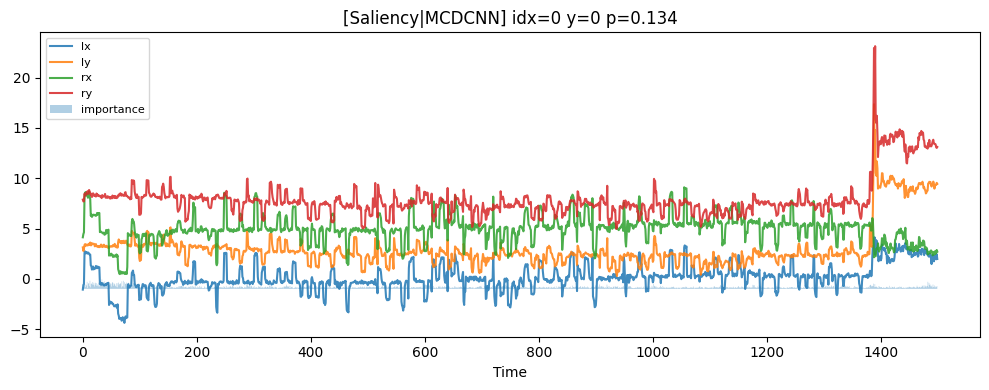

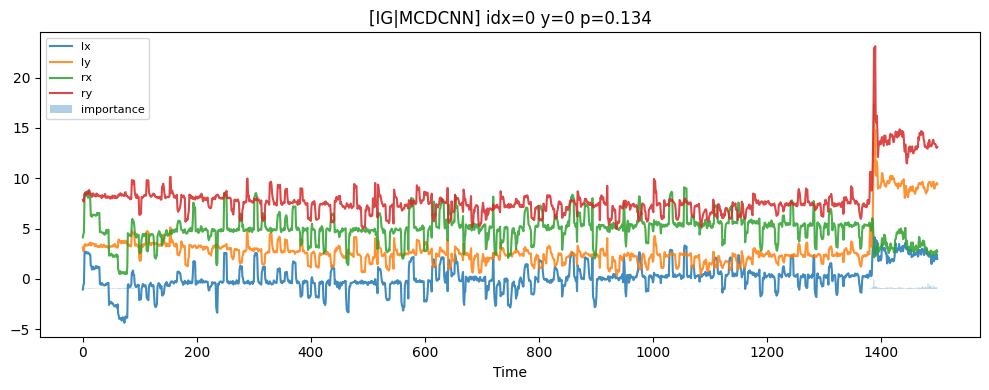

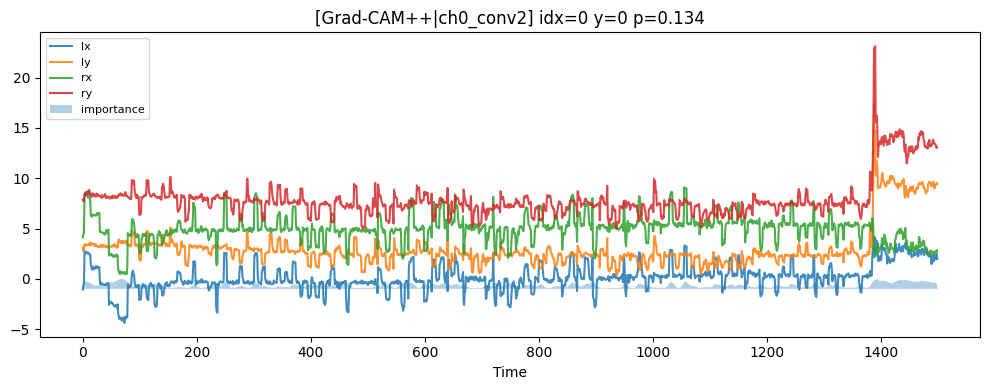

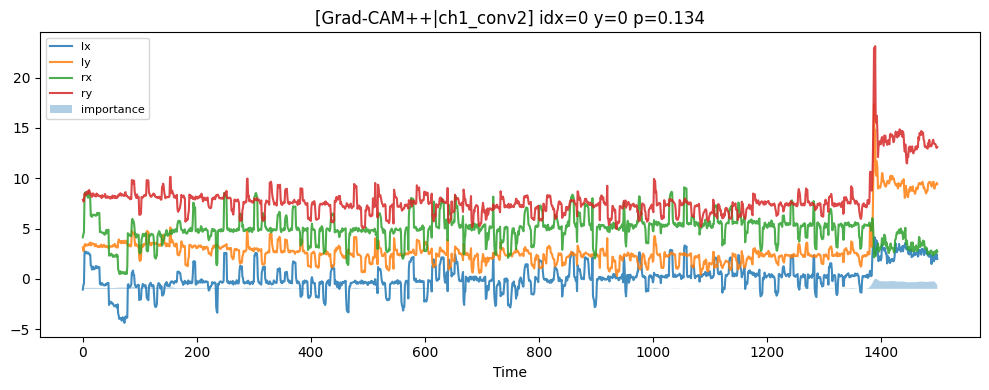

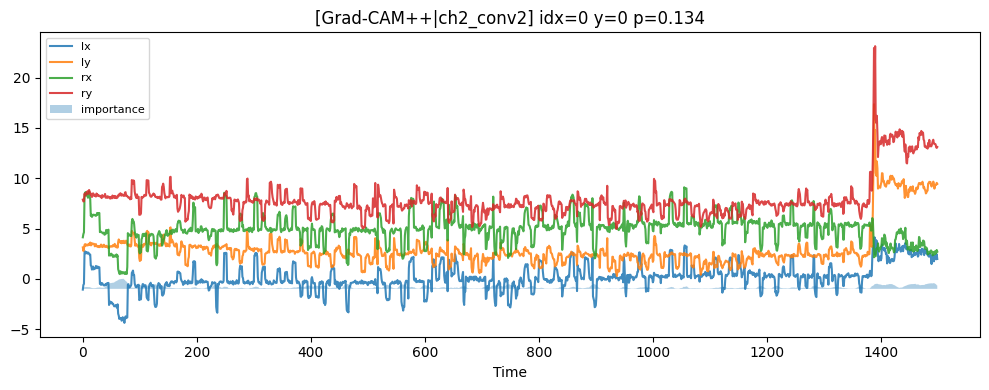

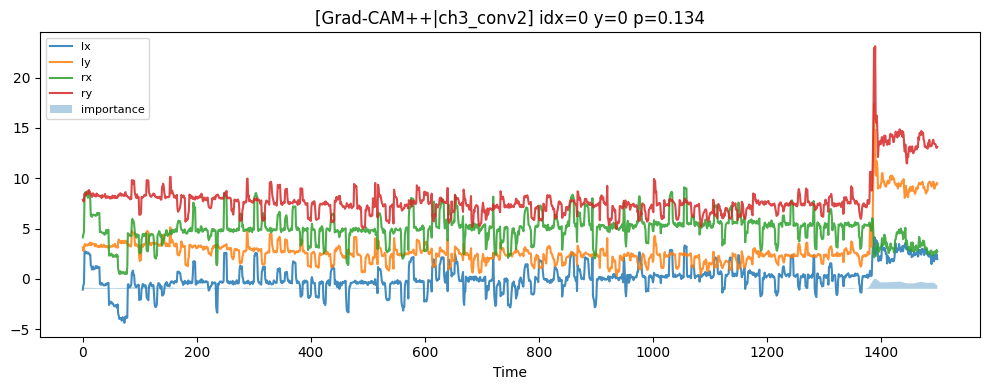

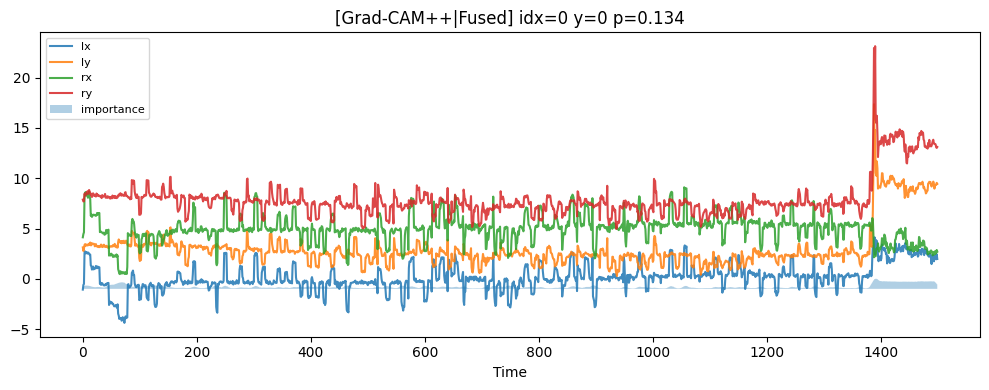

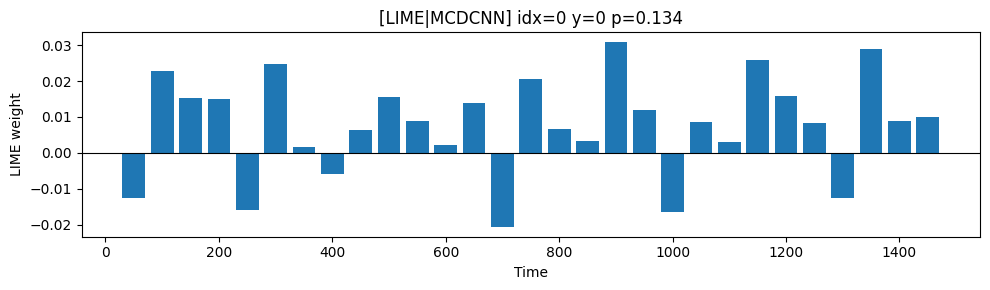

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); trying best-effort reshape…


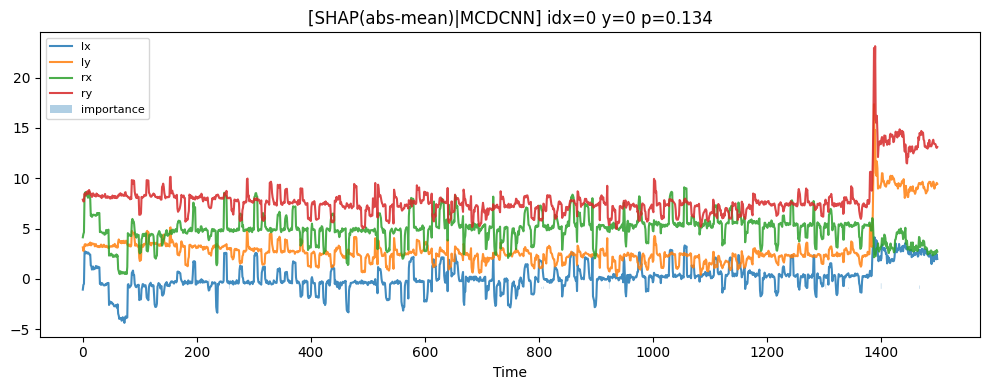

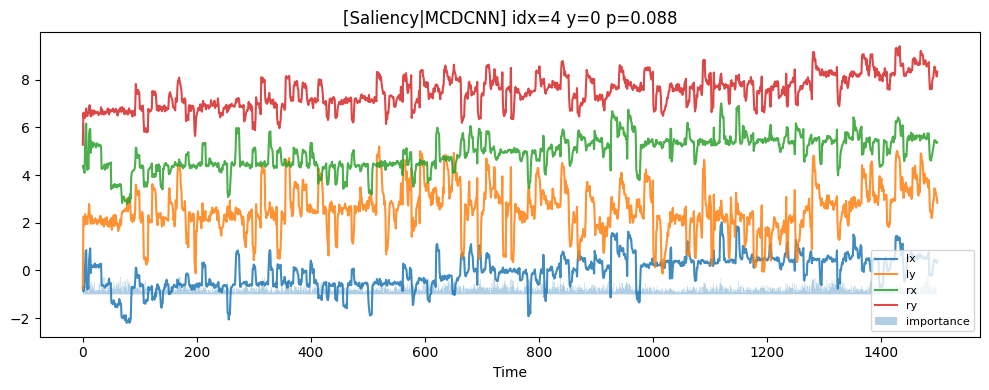

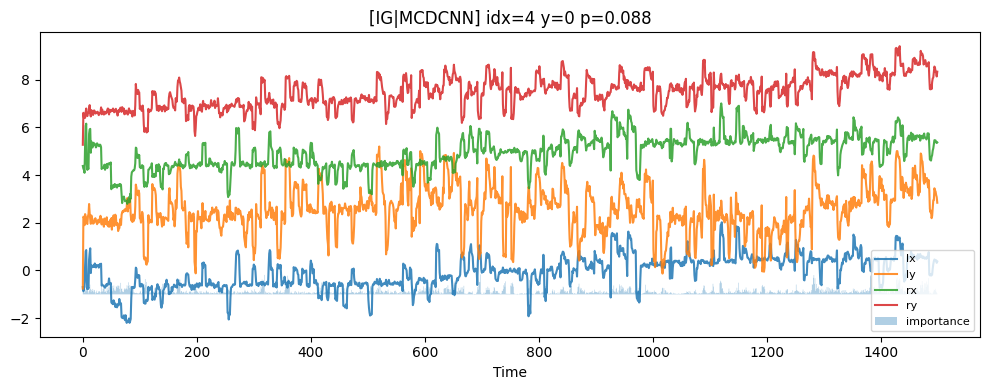

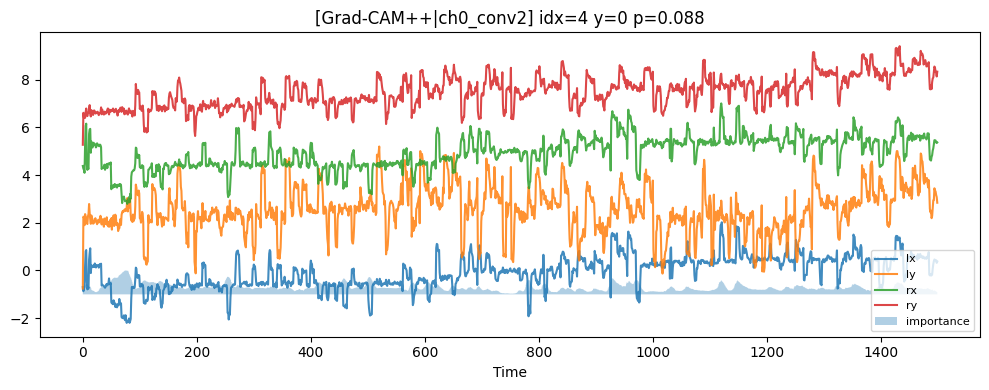

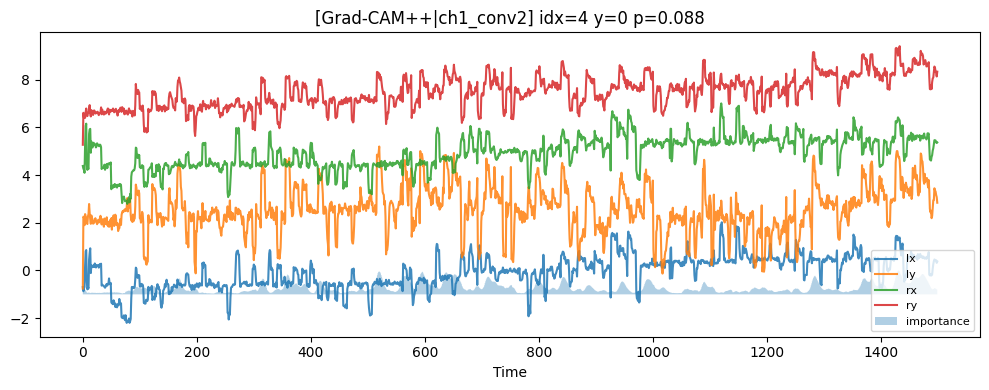

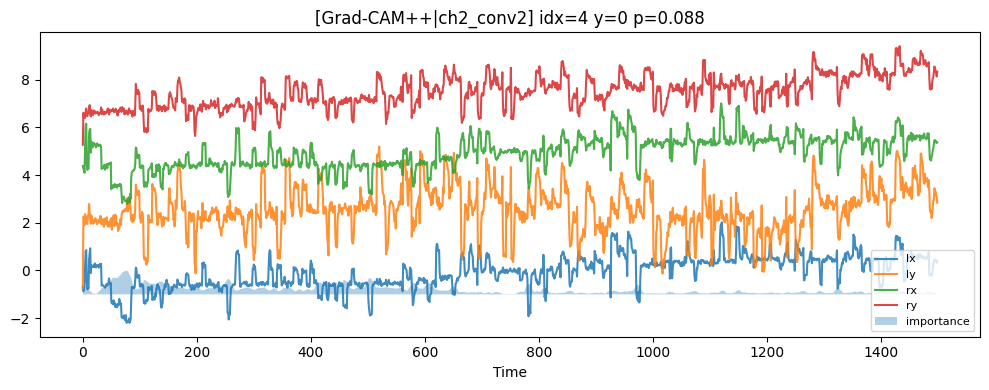

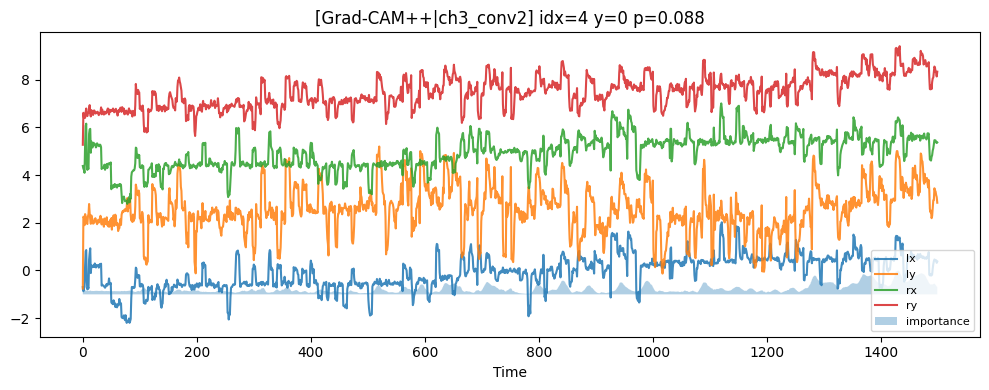

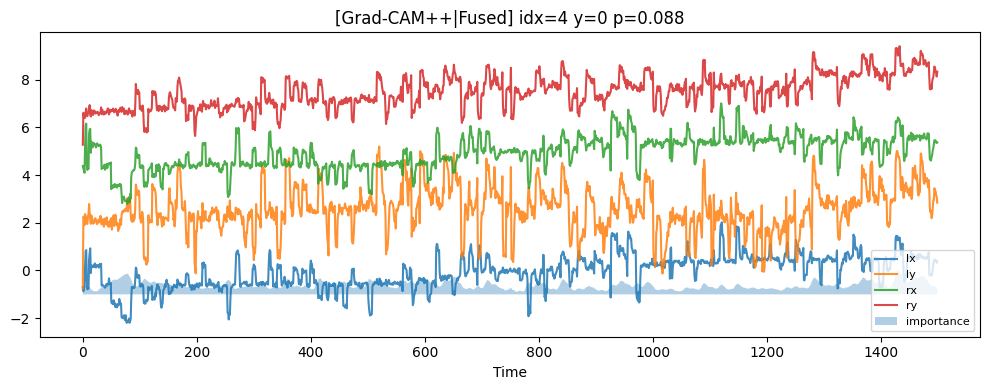

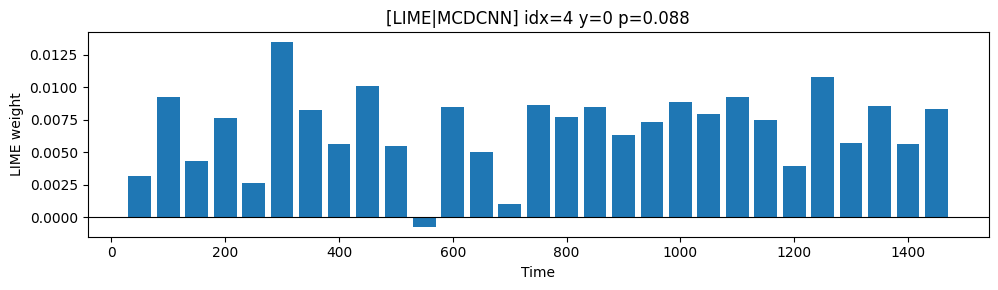

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); trying best-effort reshape…


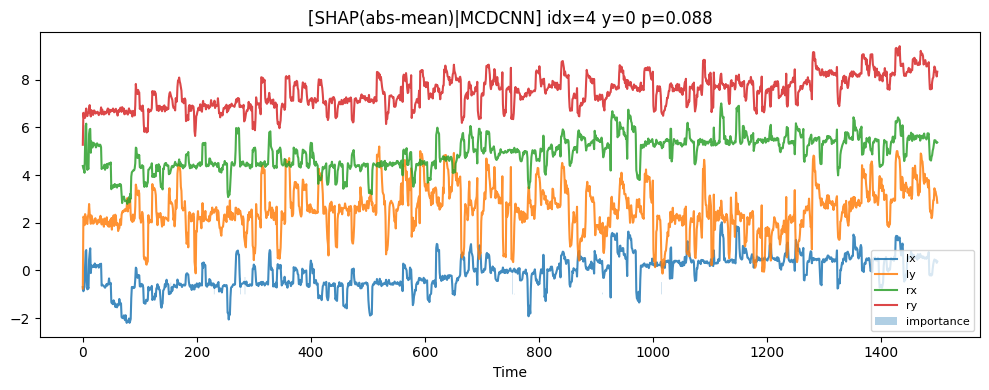

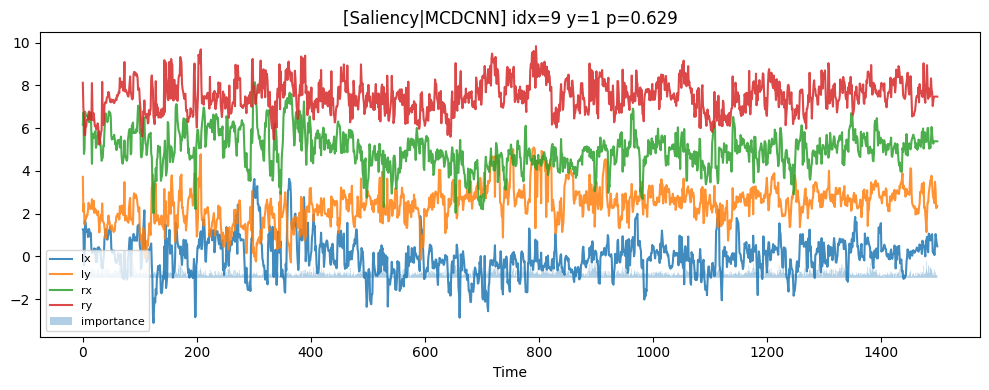

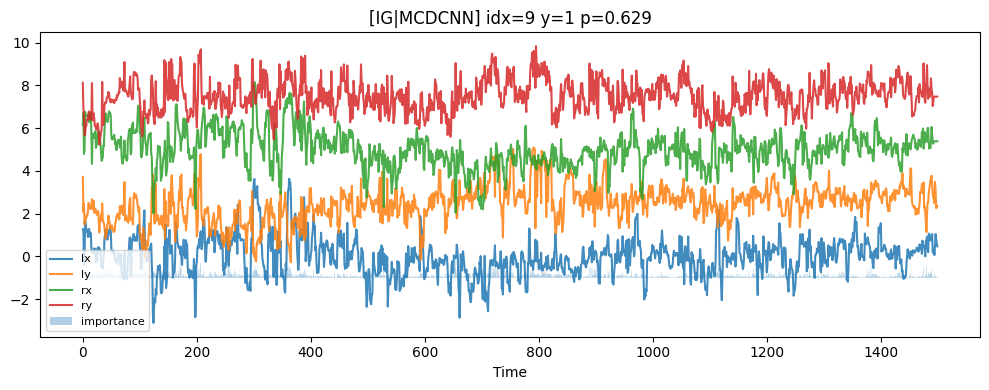

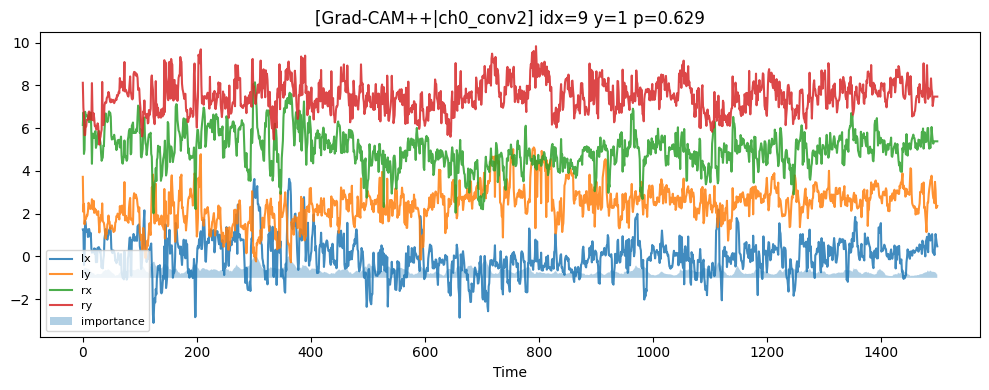

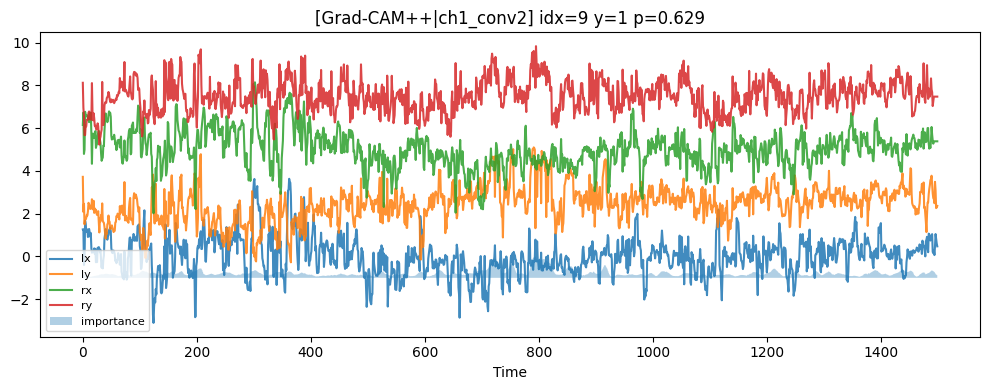

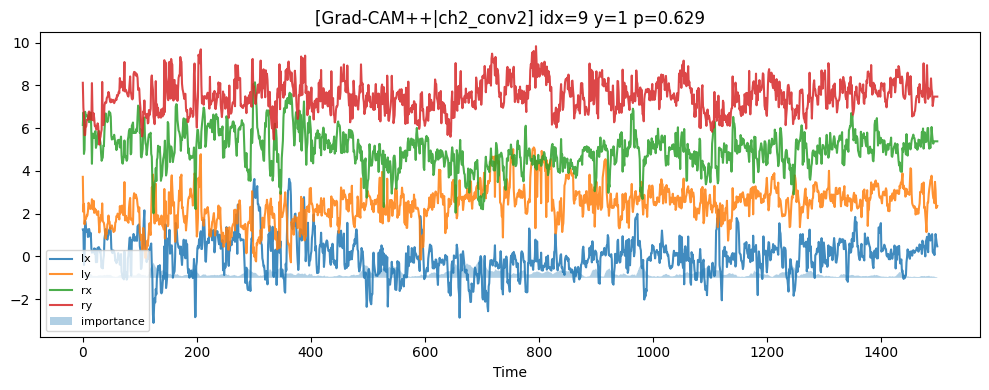

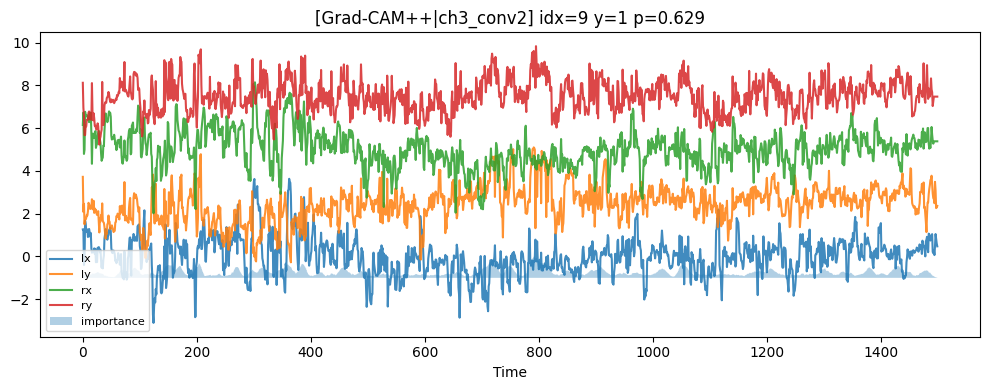

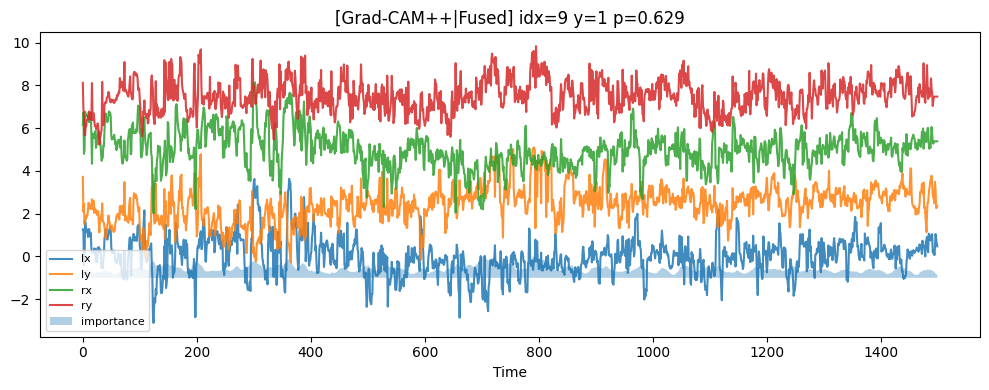

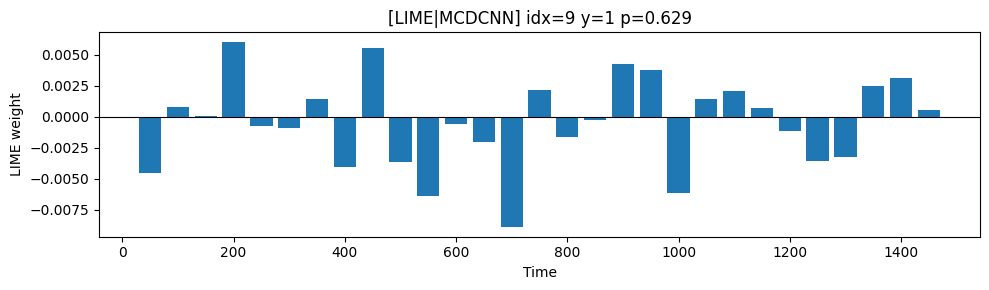

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); trying best-effort reshape…


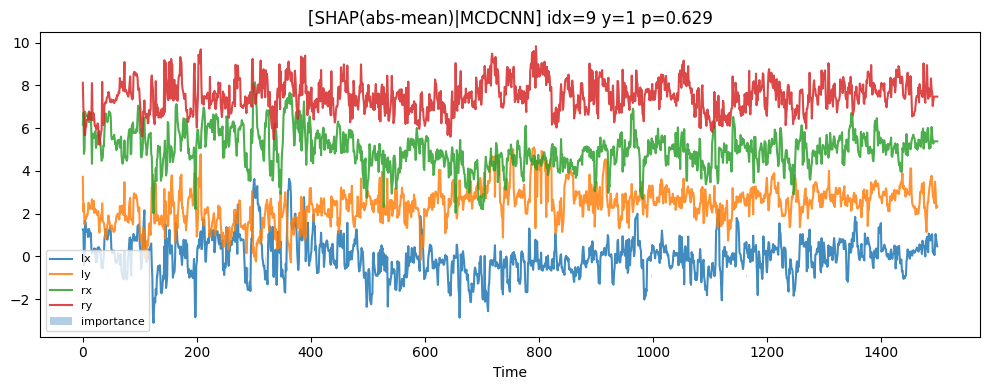

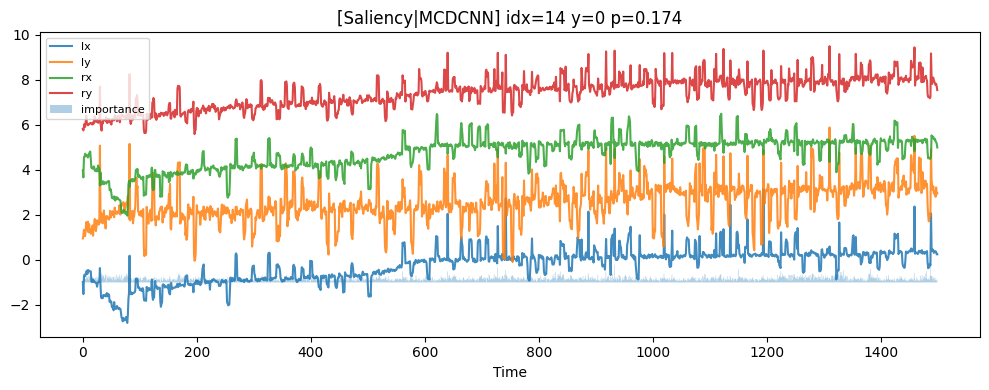

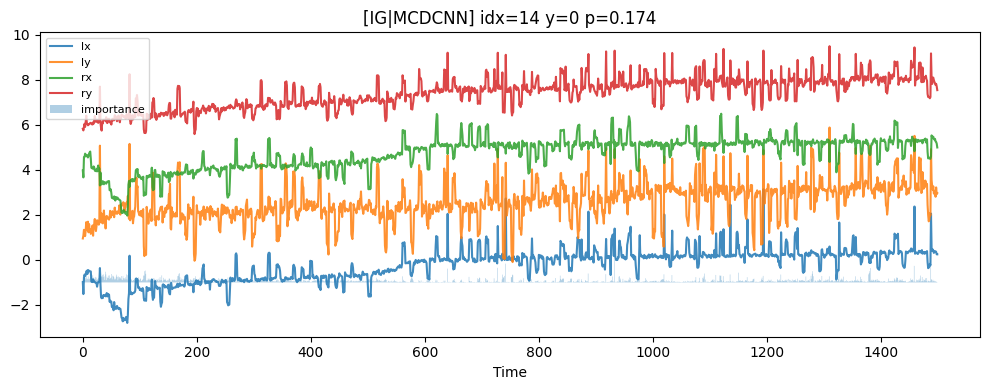

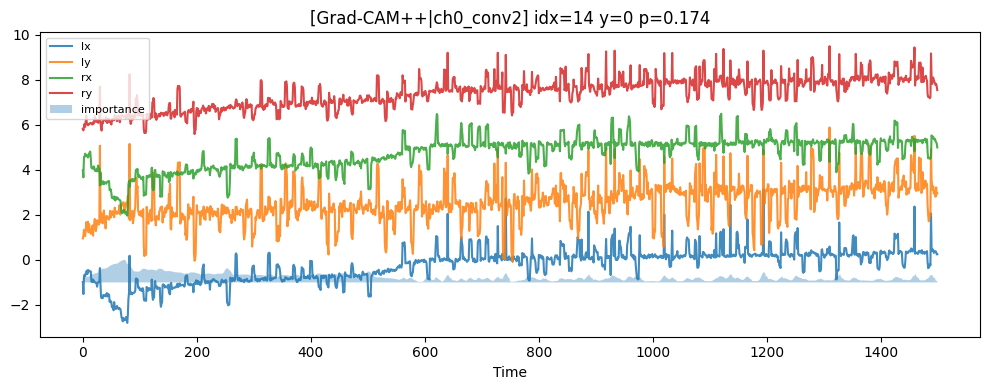

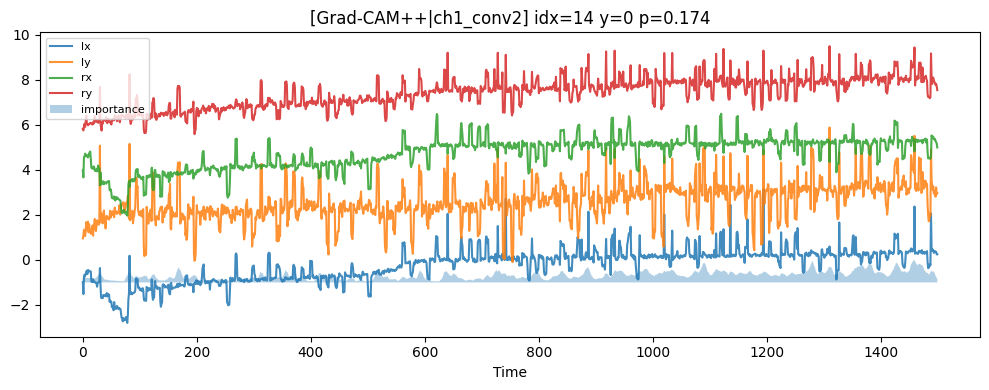

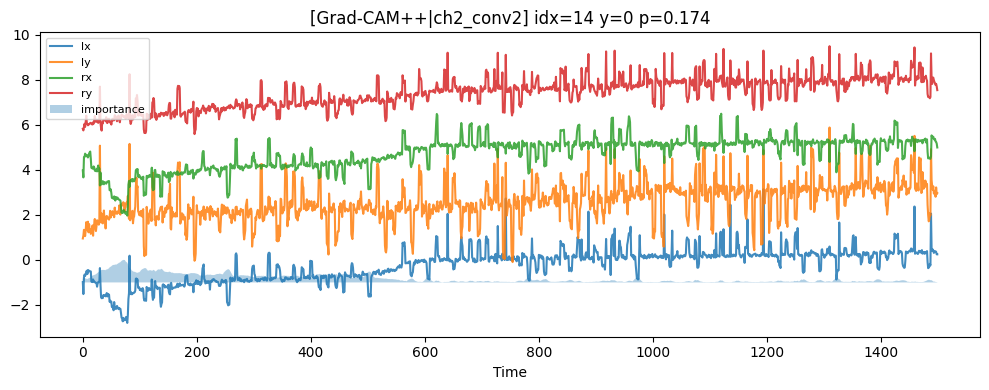

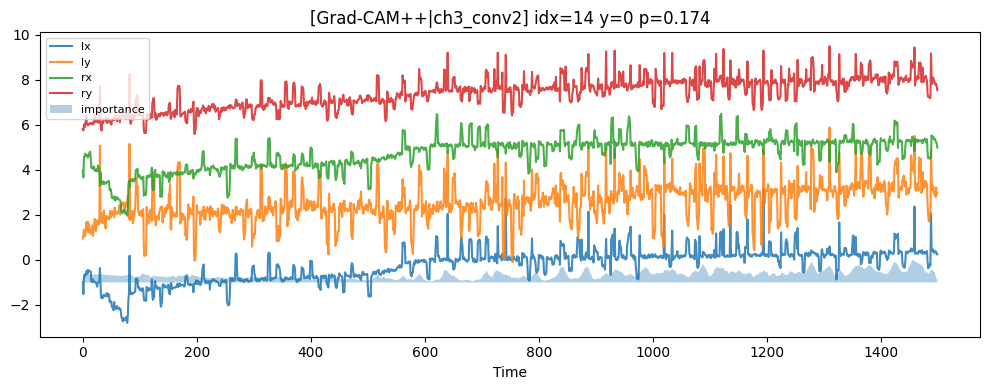

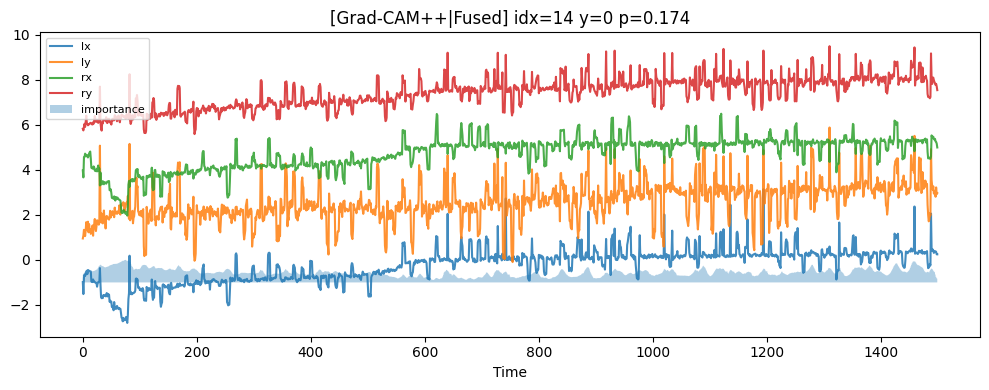

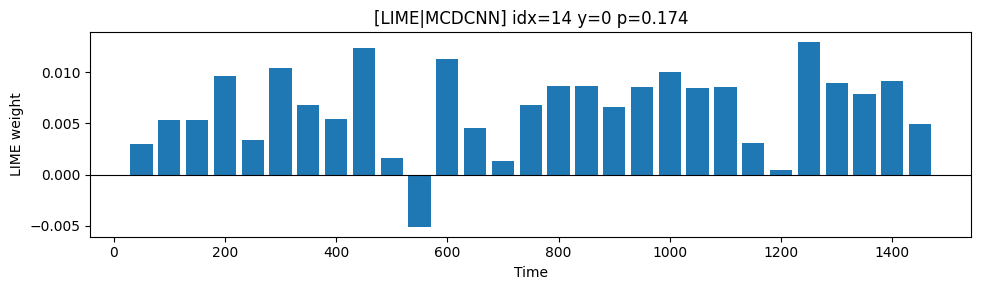

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); trying best-effort reshape…


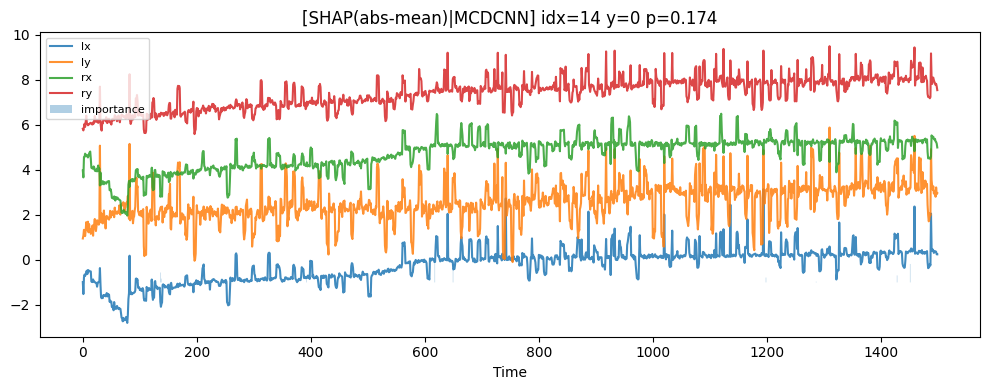

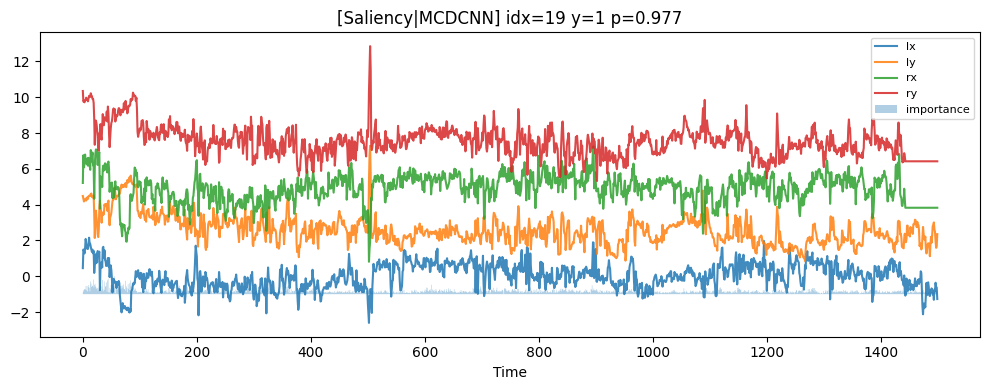

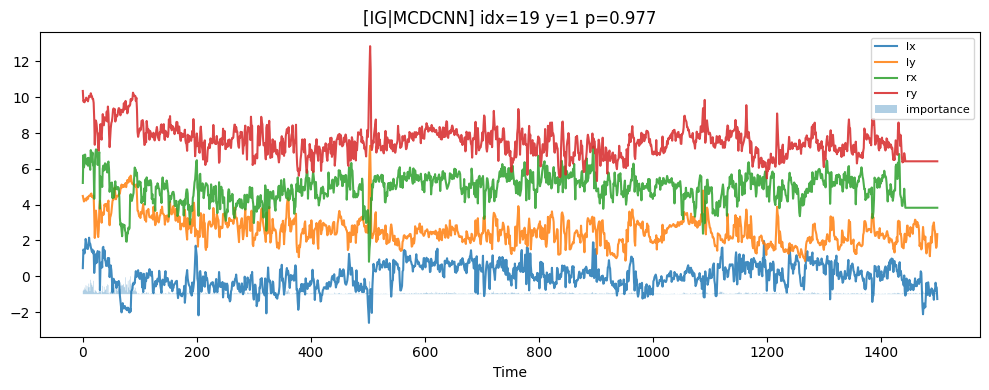

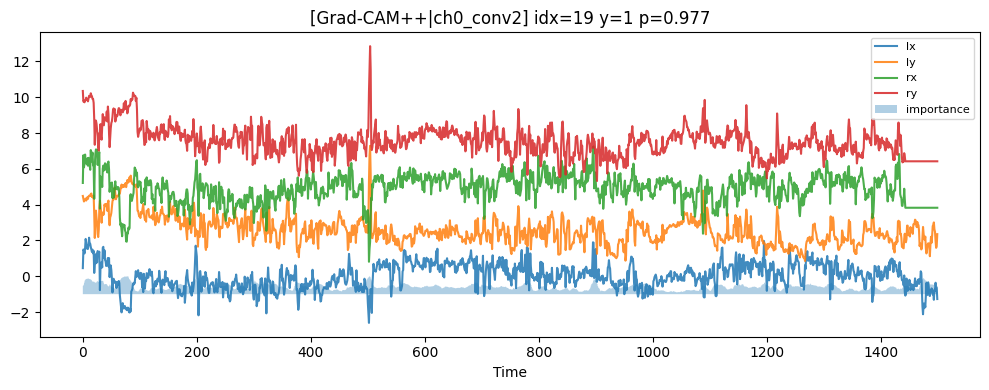

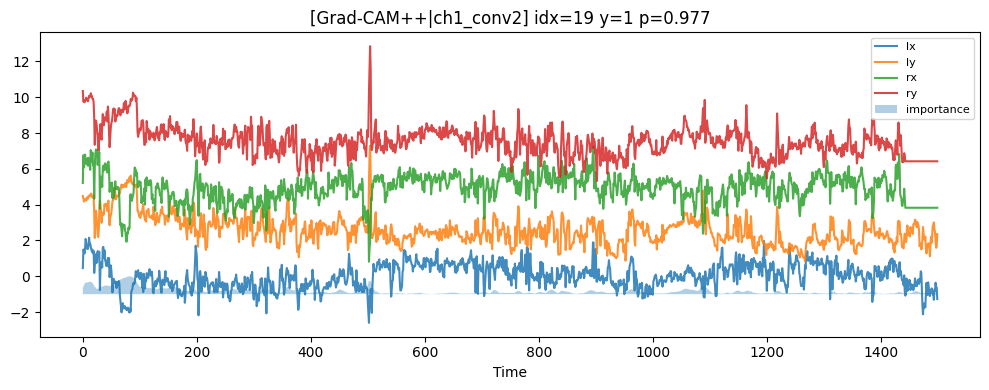

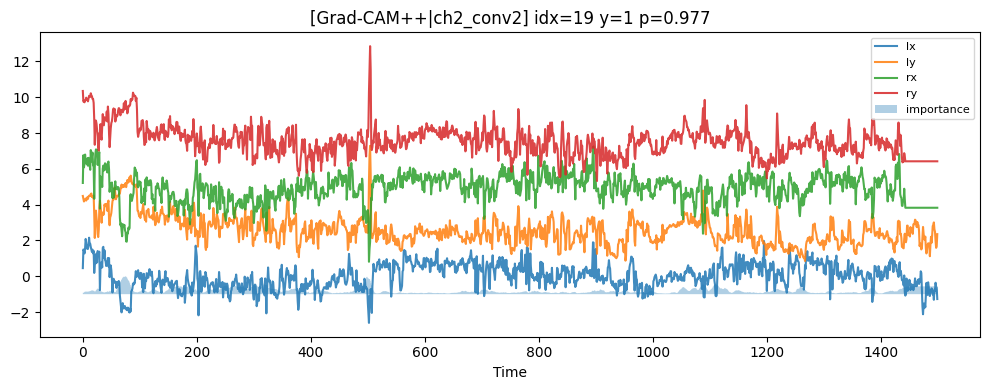

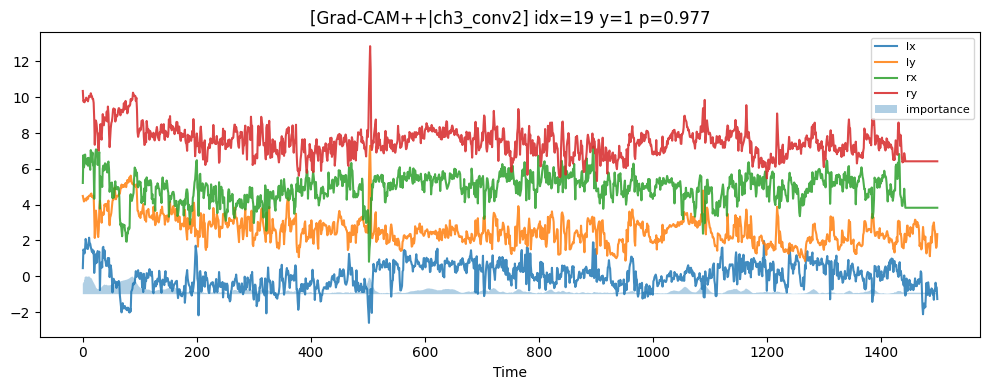

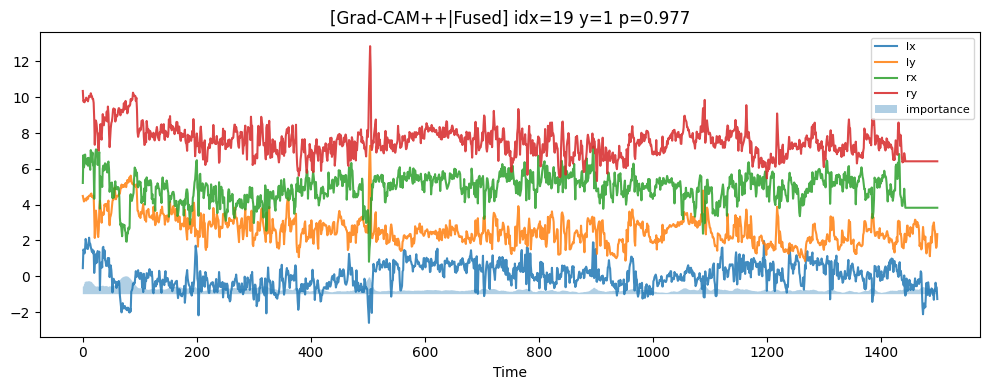

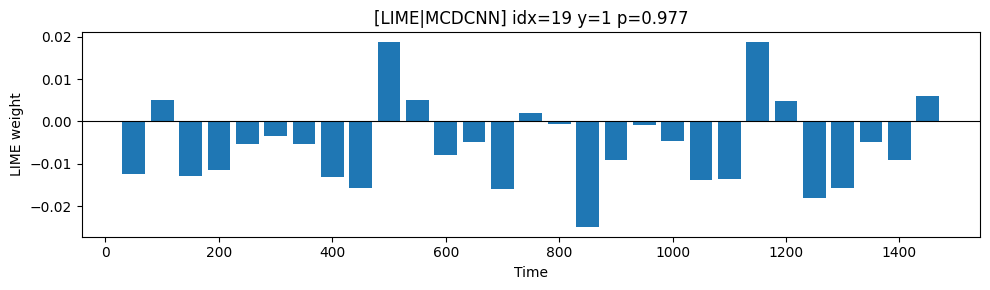

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); trying best-effort reshape…


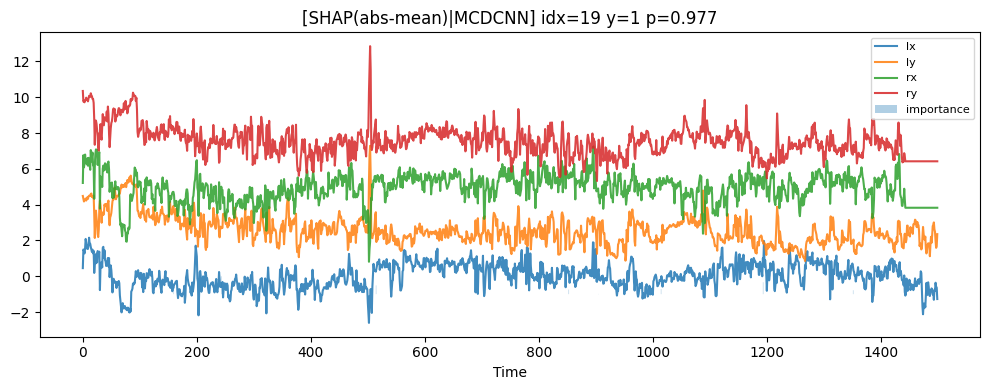

MCDCNN XAI suite (kernel-only SHAP) finished.


In [7]:
"""
XAI suite for MCDCNN time-series model (multi-branch Conv1D).
Methods:
  - Saliency (vanilla grads)
  - Integrated Gradients
  - Grad-CAM++ per-branch (+ fused)
  - SHAP (DeepExplainer -> KernelExplainer fallback)
  - LIME for time series (window perturbation)

Notes:
  - Automatically identify the name of the last convolutional layer in an MCDCNN branch (default convention: '{name}_conv2'; a custom list can be passed).
  - Fusion strategy: Perform min-max normalization on each branch CAM and then take the average (can also be changed to weighted).
"""

import numpy as np, tensorflow as tf, matplotlib.pyplot as plt
from typing import Dict, Tuple, List, Optional
from tensorflow.keras import Model, Input, layers

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Train an MCDCNN for XAI
def train_mcdcnn_for_xai(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    # MCDCNN structure hyperparameters (must be consistent with the defined construction function)
    filters=(32,64), kernels=(7,5), pools=(2,2), l2: float = 1e-4, use_bn: bool = True
):
    X, y, files = load_pair_experiment(
        csv_dir, label_pair,
        resample_len=target_len, max_nan_ratio=0.05,
        divide_by_960=True, use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    extractor = build_mcdcnn_extractor(
        (target_len, X.shape[-1]),
        filters=filters, kernels=kernels, pools=pools, l2=l2, use_bn=use_bn
    )
    model = build_classifier_from_extractor_mcd(extractor, dropout=0.5, l2=l2)

    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])
    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    class_weight = compute_class_weight(ytr)
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1,
              callbacks=cbs, class_weight=class_weight)
    return model, (Xtr,ytr,Xva,yva,Xte,yte), files, splits

# Saliency
def saliency_map(model: Model, x: np.ndarray) -> np.ndarray:
    xt = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)
    with tf.GradientTape() as tape:
        tape.watch(xt)
        y = model(xt, training=False)
    g = tape.gradient(y, xt).numpy()[0]  # (T,C)
    return np.abs(g)

# Integrated Gradients
def integrated_gradients(model: Model, x: np.ndarray, steps: int = 64, baseline: Optional[np.ndarray]=None) -> np.ndarray:
    if baseline is None:
        baseline = np.zeros_like(x, dtype=np.float32)
    xt = tf.convert_to_tensor(x[None,...], tf.float32)
    bt = tf.convert_to_tensor(baseline[None,...], tf.float32)
    alphas = tf.reshape(tf.linspace(0., 1., steps+1)[1:], (-1,1,1))
    path = bt + alphas * (xt - bt)              # (steps,T,C)
    with tf.GradientTape() as tape:
        tape.watch(path)
        preds = model(path, training=False)
    grads = tape.gradient(preds, path)          # (steps,T,C)
    ig = tf.reduce_mean(grads, axis=0) * (xt - bt)[0]
    return tf.math.abs(ig).numpy().astype(np.float32)

# Grad-CAM++ for 1D (Single layer)
def _gradcampp_1d_on_layer(model: Model, x: np.ndarray, conv_layer: layers.Layer) -> np.ndarray:
    grad_model = Model([model.inputs], [conv_layer.output, model.output])
    xt = tf.convert_to_tensor(x[None,...], tf.float32)
    with tf.GradientTape(persistent=True) as t1:
        with tf.GradientTape(persistent=True) as t2:
            conv_out, y = grad_model(xt, training=False)   # conv_out: (1,T',K)
            y_c = y[:, 0]
        g1 = t2.gradient(y_c, conv_out)                    # (1,T',K)
    g2 = t1.gradient(y_c, conv_out)                        # (1,T',K)
    conv = conv_out.numpy()[0]                              # (T',K)
    g1 = g1.numpy()[0]; g2 = g2.numpy()[0]

    # Grad-CAM++ approximate weights
    eps = 1e-8
    relu_g1 = np.maximum(g1, 0.0)
    w = np.zeros((conv.shape[1],), dtype=np.float32)
    for k in range(conv.shape[1]):
        num = np.sum(relu_g1[:,k] * conv[:,k])
        den = np.sum(relu_g1[:,k]) + eps
        w[k] = num / den
    cam = np.maximum(conv @ w, 0.0)  # (T',)

    # Normalise and upsample back to input length
    T = x.shape[0]
    if cam.max() > 0: cam = cam / (cam.max() + 1e-8)
    if cam.shape[0] != T:
        src = np.linspace(0, 1, cam.shape[0], dtype=np.float32)
        dst = np.linspace(0, 1, T, dtype=np.float32)
        cam = np.interp(dst, src, cam)
    return cam.astype(np.float32)    # (T,)

# Multi-branch Grad-CAM++ (MCDCNN)
def gradcampp_mcdcnn(
    model: Model,
    x: np.ndarray,
    branch_last_conv_names: Optional[List[str]] = None,
    fuse: str = "mean"   # 'mean' or 'sum' or 'max'
) -> Dict[str, np.ndarray]:
    """
    Run CAM++ on each branch (the last convolution layer), returning {'branch_name': (T,), ..., 'fused': (T,)}

    By default, layers with names containing 'lx_conv2', 'ly_conv2', 'rx_conv2', 'ry_conv2', or ending with '_conv2' are recognized.
    """
    # Automatically discover the last convolutional layer of the branch
    if branch_last_conv_names is None:
        cand = []
        for L in model.layers:
            if isinstance(L, layers.Conv1D) and (L.name.endswith("_conv2") or any(k in L.name for k in ["lx_conv2","ly_conv2","rx_conv2","ry_conv2"])):
                cand.append(L.name)
        # If not found, the next best thing is to take the last layers of all Conv1D (not necessarily grouped)
        if not cand:
            for L in model.layers[::-1]:
                if isinstance(L, layers.Conv1D):
                    cand = [L.name]; break
        branch_last_conv_names = sorted(list(set(cand)))

    cams = {}
    for name in branch_last_conv_names:
        layer = model.get_layer(name)
        cams[name] = _gradcampp_1d_on_layer(model, x, layer)   # (T,)

    # Fusion
    arr = np.stack([v/(v.max()+1e-8) if v.max()>0 else v for v in cams.values()], axis=0)  # (B,T)
    if fuse == "sum":
        fused = arr.sum(axis=0)
    elif fuse == "max":
        fused = arr.max(axis=0)
    else:
        fused = arr.mean(axis=0)
    fused = fused / (fused.max() + 1e-8)
    cams['fused'] = fused.astype(np.float32)
    cams['branches'] = branch_last_conv_names
    return cams

# SHAP
def shap_explain(model, X_background, X_samples, max_bg: int = 64, nsamples: int = 200):
    """
    First try GradientExplainer; if that fails, try KernelExplainer.
    Whether the returned value is 1D, 2D, or 3D, it is uniformly reduced to (n, T, C).
    """
    import numpy as np
    try:
        import shap
    except ImportError:
        print("[WARN] shap not installed; skip SHAP.")
        return None

    # Standard input shape
    if X_samples.ndim == 2:
        X_samples = X_samples[None, ...]
    assert X_samples.ndim == 3 and X_background.ndim == 3, "expect (n,T,C)"

    Xbg = X_background[:max_bg].astype(np.float32, copy=False)
    Xsm = X_samples.astype(np.float32, copy=False)
    n, T, C = Xsm.shape

    # First try GradientExplainer
    try:
        explainer = shap.GradientExplainer(model, Xbg)
        sv = explainer.shap_values(Xsm)
        if isinstance(sv, list): sv = sv[0]
    except Exception as e:
        print(f"[SHAP] GradientExplainer failed: {type(e).__name__}: {e}\n=> fallback to KernelExplainer.")
        # KernelExplainer: flatten to 2D
        bg2 = Xbg.reshape((Xbg.shape[0], T*C))
        X2  = Xsm.reshape((n, T*C))
        def f_2d(Z2):
            Z3 = np.asarray(Z2, dtype=np.float32).reshape((-1, T, C))
            return model.predict(Z3, verbose=0).reshape(-1, 1)
        explainer = shap.KernelExplainer(f_2d, bg2)
        sv = explainer.shap_values(X2, nsamples=nsamples)
        if isinstance(sv, list): sv = sv[0]

    # Unified reduction to (n, T, C)
    sv = np.asarray(sv)
    if sv.ndim == 1 and sv.size == T*C:
        sv = sv.reshape(1, T, C)
    elif sv.ndim == 2 and sv.shape[1] == T*C:
        sv = sv.reshape(sv.shape[0], T, C)
    elif sv.ndim == 3 and sv.shape[1:] == (T, C):
        pass
    else:
        print(f"[WARN] Unexpected SHAP shape: {sv.shape}; trying best-effort reshape…")
        sv = sv.reshape(-1, T, C)

    return sv.astype(np.float32, copy=False)



# LIME (sliding window perturbation, same as CNN version)
def lime_timeseries_explain(model: Model, x: np.ndarray, window=50, stride=25, n_samples=500, fill=0.0):
    T, C = x.shape
    wins = []
    t0 = 0
    while t0 < T:
        t1 = min(t0 + window, T); wins.append((t0, t1))
        if t1 == T: break
        t0 += stride
    W = len(wins)
    y0 = float(model.predict(x[None,...], verbose=0).ravel()[0])
    rng = np.random.default_rng(SEED)
    Z = rng.integers(0, 2, size=(n_samples, W), endpoint=True)
    y = np.zeros((n_samples,), dtype=np.float32)
    x_fill = np.full_like(x, fill, dtype=np.float32)
    for i in range(n_samples):
        xi = x.copy()
        for j, flag in enumerate(Z[i]):
            if flag == 1:
                a,b = wins[j]; xi[a:b,:] = x_fill[a:b,:]
        y[i] = float(model.predict(xi[None,...], verbose=0).ravel()[0])
    lam = 1e-3
    A = Z.astype(np.float32); b = (y - y0).astype(np.float32)
    beta = np.linalg.solve(A.T @ A + lam*np.eye(W, dtype=np.float32), A.T @ b)
    centers = np.array([(a+b)//2 for (a,b) in wins], dtype=int)
    return centers, beta


# Small visualisation tool
def plot_timeseries_with_heat(x: np.ndarray, heat_1d: np.ndarray, title: str, ch_names=('lx','ly','rx','ry')):
    import numpy as np, matplotlib.pyplot as plt
    T, C = x.shape
    # Insurance: Project the heat of various lengths into length T
    h = np.asarray(heat_1d).squeeze()
    if h.ndim == 2 and h.shape[0] == T:           # (T, C') -> mean over channels
        h = np.abs(h).mean(axis=1)
    if h.size == T*C:                              # Flattened (T*C,)
        h = h.reshape(T, C)
        h = np.abs(h).mean(axis=1)
    elif h.size != T:                              # For other lengths, linearly interpolate to T
        src = np.linspace(0, 1, h.size)
        dst = np.linspace(0, 1, T)
        h = np.interp(dst, src, h)

    # Normal drawing
    plt.figure(figsize=(10,4))
    shift = 0.0
    for c in range(C):
        plt.plot(x[:,c] + shift, alpha=0.85, label=ch_names[c] if c<len(ch_names) else f'ch{c}')
        shift += 2.5
    h_norm = h / (h.max() + 1e-8)
    plt.fill_between(np.arange(T), -1.0, -1.0 + h_norm, alpha=0.35, step='pre', label='importance')
    plt.title(title); plt.xlabel("Time"); plt.legend(fontsize=8); plt.tight_layout(); plt.show()


def plot_bar_over_windows(centers: np.ndarray, weights: np.ndarray, title: str):
    plt.figure(figsize=(10,3))
    w = max(1, int(0.8*(centers[1]-centers[0]))) if len(centers)>1 else 5
    plt.bar(centers, weights, width=w); plt.axhline(0, color='k', lw=0.8)
    plt.title(title); plt.xlabel("Time"); plt.ylabel("LIME weight"); plt.tight_layout(); plt.show()

# One-click entry
# SHAP with KernelExplainer only
def shap_explain_kernel_only(model, X_background, X_samples, max_bg: int = 64, nsamples: int = 200):
    """
    Only use KernelExplainer; uniformly restore the output to (n, T, C).
    """
    import numpy as np
    try:
        import shap
    except ImportError:
        print("[WARN] shap not installed; skip SHAP.")
        return None

    # Standard shape
    if X_samples.ndim == 2:
        X_samples = X_samples[None, ...]
    assert X_samples.ndim == 3 and X_background.ndim == 3, "expect (n,T,C)"

    Xbg = X_background[:max_bg].astype(np.float32, copy=False)
    Xsm = X_samples.astype(np.float32, copy=False)
    n, T, C = Xsm.shape

    bg2 = Xbg.reshape((Xbg.shape[0], T*C))
    X2  = Xsm.reshape((n, T*C))

    def f_2d(Z2):
        Z3 = np.asarray(Z2, dtype=np.float32).reshape((-1, T, C))
        y  = model.predict(Z3, verbose=0).reshape(-1, 1)
        return y

    explainer = shap.KernelExplainer(f_2d, bg2)
    sv = explainer.shap_values(X2, nsamples=nsamples)
    if isinstance(sv, list): sv = sv[0]

    # Unified reduction to (n, T, C)
    sv = np.asarray(sv)
    if sv.ndim == 1 and sv.size == T*C:
        sv = sv.reshape(1, T, C)
    elif sv.ndim == 2 and sv.shape[1] == T*C:
        sv = sv.reshape(sv.shape[0], T, C)
    elif sv.ndim == 3 and sv.shape[1:] == (T, C):
        pass
    else:
        print(f"[WARN] Unexpected SHAP shape: {sv.shape}; trying best-effort reshape…")
        sv = sv.reshape(-1, T, C)

    return sv.astype(np.float32, copy=False)



# One-click import (force kernel-only SHAP)
def run_xai_suite_mcdcnn(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    sample_source: str = 'val',
    n_samples: int = 5,
    branch_last_conv_names: Optional[List[str]] = None,
    # Training/Structure Parameters
    filters=(32,64), kernels=(7,5), pools=(2,2), l2: float = 1e-4, use_bn: bool = True,
    # SHAP switch and sampling volume
    enable_shap: bool = True, shap_bg_max: int = 64, shap_nsamples: int = 200
):
    # 1) Train MCDCNN
    model, (Xtr,ytr,Xva,yva,Xte,yte), files, splits = train_mcdcnn_for_xai(
        csv_dir, label_pair, target_len=target_len,
        filters=filters, kernels=kernels, pools=pools, l2=l2, use_bn=use_bn
    )
    Xs, ys = (Xva, yva) if sample_source == 'val' else (Xte, yte)
    idxs = np.linspace(0, len(ys)-1, num=min(n_samples, len(ys)), dtype=int)

    # 2) Background Set (for SHAP only; doesn't matter if SHAP is not enabled)
    Xbg = Xtr[: min(shap_bg_max, len(Xtr))]

    for i in idxs:
        x = Xs[i]; y_true = int(ys[i])
        y_pred = float(model.predict(x[None,...], verbose=0).ravel()[0])

        # Saliency
        sal = saliency_map(model, x)
        plot_timeseries_with_heat(x, sal.mean(axis=1), title=f"[Saliency|MCDCNN] idx={i} y={y_true} p={y_pred:.3f}")

        # Integrated Gradients
        ig = integrated_gradients(model, x, steps=64)
        plot_timeseries_with_heat(x, ig.mean(axis=1), title=f"[IG|MCDCNN] idx={i} y={y_true} p={y_pred:.3f}")

        # Grad-CAM++ (branch + merge)
        cams = gradcampp_mcdcnn(model, x, branch_last_conv_names=branch_last_conv_names, fuse='mean')
        for bname in cams.get('branches', []):
            plot_timeseries_with_heat(x, cams[bname], title=f"[Grad-CAM++|{bname}] idx={i} y={y_true} p={y_pred:.3f}")
        plot_timeseries_with_heat(x, cams['fused'], title=f"[Grad-CAM++|Fused] idx={i} y={y_true} p={y_pred:.3f}")

        # LIME
        centers, beta = lime_timeseries_explain(model, x, window=100, stride=50, n_samples=600, fill=0.0)
        plot_bar_over_windows(centers, beta, title=f"[LIME|MCDCNN] idx={i} y={y_true} p={y_pred:.3f}")

        # SHAP (KernelExplainer only; stable, does not trigger gradient registration)
        if enable_shap:
            sv = shap_explain_kernel_only(model, Xbg, x[None, ...],
                                          max_bg=shap_bg_max, nsamples=shap_nsamples)
            if sv is not None:
                sv_t = np.abs(sv[0]).mean(axis=1)
                plot_timeseries_with_heat(x, sv_t, title=f"[SHAP(abs-mean)|MCDCNN] idx={i} y={y_true} p={y_pred:.3f}")

    print("MCDCNN XAI suite (kernel-only SHAP) finished.")


if __name__ == "__main__":
    DATA_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"  # or repeats
    PAIR = (0, 2)
    # If the last convolutional layer of the branch is not *_conv2, specify it explicitly here:
    # BRANCH_CONVS = ["lx_conv2","ly_conv2","rx_conv2","ry_conv2"]
    BRANCH_CONVS = None

    run_xai_suite_mcdcnn(
        csv_dir=DATA_DIR,
        label_pair=PAIR,
        target_len=1500,
        sample_source='val',
        n_samples=5,
        branch_last_conv_names=BRANCH_CONVS,
        filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True
    )


feature construction for mcdcnn

In [8]:
"""
Feature Construction for MCDCNN:
- Construct 13 one-dimensional signals as MCDCNN multi-branch input

raw(4) + speed(4) + eye-velocity(2) + L-R difference(3)
- Branch convolution features are integrated with global statistical features for top-level classification

Reuse:
- load_pair_experiment, split_by_participant_train_val_test
- compute_class_weight, get_optimizer
"""

import time, numpy as np, tensorflow as tf
from typing import Dict, Tuple, List, Optional
from tensorflow.keras import layers, Model, Input
from sklearn.metrics import classification_report

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Basic feature tools (same as CNN version)
def _moving_average(x: np.ndarray, k: int = 5) -> np.ndarray:
    if k <= 1: 
        return x
    pad = k // 2
    xp = np.pad(x, (pad, pad), mode='edge')
    kernel = np.ones(k, dtype=np.float32) / float(k)
    return np.convolve(xp, kernel, mode='valid')

def _diff(x: np.ndarray) -> np.ndarray:
    return np.diff(x, prepend=x[:1])

def augment_dynamic_channels(X: np.ndarray, smooth_k: int = 5) -> np.ndarray:
    """
    Input: X (N, T, 4) -> Output (N, T, 13)
    Channel order (remember this order; subsequent branches must be created in the same order):
      [lx, ly, rx, ry, vel_L, vel_R, sp_lx, sp_ly, sp_rx, sp_ry, d_x, d_y, d_mag]
    """
    N, T, C = X.shape
    assert C == 4, "expect 4 channels [abs_lx, abs_ly, abs_rx, abs_ry]"
    out = []
    for i in range(N):
        seq = X[i]
        lx, ly, rx, ry = seq[:,0], seq[:,1], seq[:,2], seq[:,3]
        # velocities
        dlx, dly = _diff(lx), _diff(ly)
        drx, dry = _diff(rx), _diff(ry)
        vel_L = np.sqrt(dlx**2 + dly**2)
        vel_R = np.sqrt(drx**2 + dry**2)
        # speeds of smoothed channels
        slx, sly, srx, sry = map(lambda v: _moving_average(v, smooth_k), (lx,ly,rx,ry))
        sp_lx, sp_ly, sp_rx, sp_ry = _diff(slx), _diff(sly), _diff(srx), _diff(sry)
        # L-R diffs
        d_x = np.abs(lx - rx)
        d_y = np.abs(ly - ry)
        d_mag = np.sqrt(d_x**2 + d_y**2)
        x_aug = np.stack([lx, ly, rx, ry,
                          vel_L, vel_R,
                          sp_lx, sp_ly, sp_rx, sp_ry,
                          d_x, d_y, d_mag], axis=1).astype(np.float32)
        out.append(x_aug)
    return np.asarray(out, dtype=np.float32)

def compute_global_stats(X_aug: np.ndarray) -> np.ndarray:
    """
    Perform column-wise statistics on the enhanced time series (N,T,13): mean/std/range -> (N, 39), and perform column normalisation
    """
    means = X_aug.mean(axis=1)
    stds  = X_aug.std(axis=1)
    rngs  = (X_aug.max(axis=1) - X_aug.min(axis=1))
    F = np.concatenate([means, stds, rngs], axis=1)
    F = (F - F.mean(axis=0, keepdims=True)) / (F.std(axis=0, keepdims=True) + 1e-8)
    return F.astype(np.float32)

# Construct multi-branch input (cut from 13 channels into 13 (T,1))
BRANCH_ORDER = [
    "lx","ly","rx","ry",          # 4 raw
    "vel_L","vel_R",              # 2 eye velocity magnitude
    "sp_lx","sp_ly","sp_rx","sp_ry",  # 4 speeds
    "d_x","d_y","d_mag"           # 3 L-R diffs
]

def split_to_branches(X_aug: np.ndarray) -> Dict[str, np.ndarray]:
    """
    X_aug: (N,T,13) -> dict[name] = (N,T,1)
    The order corresponds to BRANCH_ORDER one by one
    """
    out: Dict[str, np.ndarray] = {}
    for i, name in enumerate(BRANCH_ORDER):
        out[name] = X_aug[:, :, i:i+1]  # keep last dim=1
    return out

# MCDCNN extractor (multiple inputs; each independent Conv stack)
def _one_branch(x_in: tf.Tensor,
                name_prefix: str,
                filters=(32,64), kernels=(7,5), pools=(2,2),
                use_bn: bool = True, l2: float = 1e-4):
    x = x_in
    for bi, (f, k, p) in enumerate(zip(filters, kernels, pools)):
        x = layers.Conv1D(f, k, padding="same",
                          activation="relu",
                          kernel_regularizer=tf.keras.regularizers.l2(l2),
                          name=f"{name_prefix}_conv{bi+1}")(x)
        if use_bn:
            x = layers.BatchNormalization(name=f"{name_prefix}_bn{bi+1}")(x)
        x = layers.MaxPooling1D(p, name=f"{name_prefix}_pool{bi+1}")(x)
    gap = layers.GlobalAveragePooling1D(name=f"{name_prefix}_gap")(x)
    return gap  # (batch, d)

def build_mcdcnn_extractor_with_features(
    T: int,
    branch_names: List[str] = BRANCH_ORDER,
    filters=(32,64), kernels=(7,5), pools=(2,2),
    use_bn: bool = True, l2: float = 1e-4,
) -> Tuple[Model, List[str]]:
    """
    Returns: extractor: Multiple inputs -> concatenate GAP features (excluding statistical branches)
         last_conv_names: Each last layer conv name, for XAI (Grad-CAM++)
    """
    inputs, gaps, last_conv_names = [], [], []
    for name in branch_names:
        inp = Input(shape=(T,1), name=f"in_{name}")
        g = _one_branch(inp, name_prefix=name,
                        filters=filters, kernels=kernels, pools=pools,
                        use_bn=use_bn, l2=l2)
        inputs.append(inp)
        gaps.append(g)
        # Record the last conv name of this branch (inferred by the length of filters/kernels)
        last_conv_names.append(f"{name}_conv{len(filters)}")
    feat = layers.Concatenate(name="concat_branches")(gaps) if len(gaps) > 1 else gaps[0]
    extractor = Model(inputs, feat, name="mcdcnn_extractor_feat")
    return extractor, last_conv_names

def build_classifier_from_mcd_extractor_with_stats(
    extractor: Model,
    n_stats: int,
    dropout: float = 0.5
) -> Model:
    """
    Top-level fusion: branch features + statistical features
    """
    stat_in = Input(shape=(n_stats,), name="stat_in")
    s = layers.Dense(64, activation="relu", name="stat_fc1")(stat_in)
    s = layers.Dropout(dropout, name="stat_drop")(s)

    z = layers.Concatenate(name="fusion")([extractor.output, s])
    z = layers.Dense(64, activation="relu", name="fc")(z)
    z = layers.Dropout(dropout, name="drop")(z)
    out = layers.Dense(1, activation="sigmoid", name="logit")(z)
    model = Model(extractor.inputs + [stat_in], out, name="mcdcnn_hybrid")
    return model

# Train Runner
def run_mcdcnn_with_features(
    csv_dir: str,
    label_pair: Tuple[int,int] = (0,2),
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    smooth_k: int = 5,
    # Structural parameters
    filters=(32,64), kernels=(7,5), pools=(2,2), l2: float = 1e-4, use_bn: bool = True
):
    # 1) Load the original 4 channels and split them by subject
    X, y, files = load_pair_experiment(
        csv_dir, label_pair, resample_len=target_len,
        max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )

    # 2) Enhanced to 13 channels and split into 13 branches (T,1)
    Xtr_aug = augment_dynamic_channels(Xtr, smooth_k=smooth_k)   # (N,T,13)
    Xva_aug = augment_dynamic_channels(Xva, smooth_k=smooth_k)
    Xte_aug = augment_dynamic_channels(Xte, smooth_k=smooth_k)

    # Statistical characteristics (N, 39)
    Ftr = compute_global_stats(Xtr_aug)
    Fva = compute_global_stats(Xva_aug)
    Fte = compute_global_stats(Xte_aug)

    # Split branch dict -> then convert to ordered input list (aligned with extractor.inputs)
    tr_br = split_to_branches(Xtr_aug)  # dict[name] -> (N,T,1)
    va_br = split_to_branches(Xva_aug)
    te_br = split_to_branches(Xte_aug)

    branch_names = BRANCH_ORDER  # Modifiable
    def stack_in(d: Dict[str, np.ndarray]) -> List[np.ndarray]:
        return [ d[name] for name in branch_names ]

    # 3) Build the extractor + top-level fusion classifier
    extractor, last_conv_names = build_mcdcnn_extractor_with_features(
        T=target_len, branch_names=branch_names,
        filters=filters, kernels=kernels, pools=pools, use_bn=use_bn, l2=l2
    )
    model = build_classifier_from_mcd_extractor_with_stats(extractor, n_stats=Ftr.shape[1], dropout=0.5)

    # 4) Train Configuration
    model.compile(optimizer=get_optimizer(lr), loss="binary_crossentropy", metrics=["accuracy"])
    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor="val_loss", patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss", factor=0.5, patience=6, min_lr=1e-5, verbose=1),
        tf.keras.callbacks.CSVLogger(f"train_log_mcd_feat_{label_pair[0]}_{label_pair[1]}.csv", append=False)
    ]
    class_weight = compute_class_weight(ytr)

    # 5) Train
    t0 = time.perf_counter()
    history = model.fit(
        stack_in(tr_br) + [Ftr], ytr,
        validation_data=(stack_in(va_br) + [Fva], yva),
        epochs=max_epochs, batch_size=batch_size, verbose=1,
        callbacks=callbacks, class_weight=class_weight
    )
    t1 = time.perf_counter()
    print(f"[Time] MCDCNN(+features) {label_pair}: {t1 - t0:.2f}s")

    # 6) Test
    yprob = model.predict(stack_in(te_br) + [Fte], batch_size=batch_size).ravel()
    ypred = (yprob >= 0.5).astype(int)
    print("\n[TEST] report:\n", classification_report(yte, ypred, digits=4))

    return {
        "label_pair": label_pair,
        "history": history.history,
        "model": model,
        "split_info": split_info,
        "last_conv_names": last_conv_names,  # For XAI's Grad-CAM++ branch name
        "C_aug": Xtr_aug.shape[-1]
    }


if __name__ == "__main__":
    csv_path = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    res_mcd_02 = run_mcdcnn_with_features(
        csv_path, (0,2), target_len=1500, smooth_k=5,
        filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True
    )


[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
Epoch 1/80
4/4 [==============================] - 2s 201ms/step - loss: 0.7915 - accuracy: 0.4630 - val_loss: 0.7787 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 111ms/step - loss: 0.6432 - accuracy: 0.6852 - val_loss: 0.7741 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 107ms/step - loss: 0.6105 - accuracy: 0.7407 - val_loss: 0.7697 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 0s 112ms/step - loss: 0.6038 - accuracy: 0.7222 - val_loss: 0.7655 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 0s 103ms/step - loss: 0.6205 - accuracy: 0.8148 - val_loss: 0.7606 - val_accuracy: 0.5500 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 0s 102ms/step - loss: 0.5162 - accuracy: 0.7593 - val_loss: 0.7570 - val_accuracy: 0.6500 - lr: 3

Feature Importance in Non/Antisaccadic Areas for mcdcnn

In [15]:
"""
Feature Importance in Non/Saccadic Areas for MCDCNN
Existing dependencies:
- augment_dynamic_channels(X) -> (N,T,13)
- split_to_branches(X_aug) -> dict[name] = (N,T,1)
- gradcampp_mcdcnn(model, x_aug_single, branch_last_conv_names=None, fuse='mean')

Note:
- The saccade mask is calculated based on the original 4 channels (lx, ly, rx, ry).
- Saliency/IG performs a "normalization + averaging" fusion on the multi-input branch-by-branch gradients/integrals.
"""

import numpy as np, tensorflow as tf
from typing import Dict, Tuple, List, Optional
from tensorflow.keras import Model

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Requires existing compute_global_stats(X_aug: (N,T,C_aug))
def prepare_mcd_inputs_from_aug(x_aug_single: np.ndarray, branch_names: List[str]):
    """
    x_aug_single: (T, C_aug=13)
    Returns：
      branches_x: List[np.ndarray]  Each (T,1), the order is consistent with branch_names (here we assume the order is column order 0..12)
      stat_vec:   np.ndarray        (1, n_stats=3*C_aug)
    """
    # 13 branches (T,1)
    branches_x = [x_aug_single[:, i:i+1].astype(np.float32, copy=False) for i in range(len(branch_names))]
    # Statistical characteristics (1, 3*C_aug)
    F = compute_global_stats(x_aug_single[None, ...])  # (1, 3*C_aug)
    stat_vec = F.astype(np.float32, copy=False)        # (1, n_stats)
    return branches_x, stat_vec


# 1) Multi-input Saliency
def mcdcnn_saliency_fused(model: Model, branches_x: List[np.ndarray], stat_vec: np.ndarray) -> np.ndarray:
    """
    branches_x: list of (T,1) (len=13)
    stat_vec:   (1, n_stats)
    """
    xt_list = [tf.convert_to_tensor(x[None, ...], tf.float32) for x in branches_x]  # -> (1,T,1)
    stat_tf = tf.convert_to_tensor(stat_vec, tf.float32)                             # -> (1,n_stats)

    with tf.GradientTape(persistent=True) as tape:
        for xt in xt_list:
            tape.watch(xt)             # Only calculate the gradient of the sequential branch
        # Note: The model requires 14 inputs in the forward pass
        y = model(xt_list + [stat_tf], training=False)  # (1,1)

    imps = []
    for xt in xt_list:
        g = tape.gradient(y, xt).numpy()[0, :, 0]  # (T,)
        g = np.abs(g)
        g = g / (g.max() + 1e-8)
        imps.append(g)
    del tape

    imp_fused = np.mean(np.stack(imps, axis=0), axis=0)
    imp_fused = np.maximum(imp_fused, 0)
    return imp_fused / (imp_fused.sum() + 1e-8)


# Multi-input Integrated Gradients (Fusion)
def mcdcnn_ig_fused(model: Model, branches_x: List[np.ndarray], stat_vec: np.ndarray, steps: int = 64) -> np.ndarray:
    paths = []
    for x in branches_x:
        base = np.zeros_like(x, dtype=np.float32)
        alphas = np.linspace(1/steps, 1.0, steps, dtype=np.float32).reshape(-1, 1, 1)
        path = base[None, ...] + alphas * (x[None, ...] - base[None, ...])  # (steps,T,1)
        paths.append(path)

    # stats branch: repeat the same row vector forward steps times
    stat_steps = np.repeat(stat_vec.astype(np.float32, copy=False), repeats=steps, axis=0)  # (steps, n_stats)

    xt_list = [tf.convert_to_tensor(p, tf.float32) for p in paths]
    stat_tf = tf.convert_to_tensor(stat_steps, tf.float32)

    with tf.GradientTape(persistent=True) as tape:
        for xt in xt_list:
            tape.watch(xt)     # Only look at the temporal branch gradient
        y = model(xt_list + [stat_tf], training=False)  # (steps,1)

    imps = []
    for xi, xt in zip(branches_x, xt_list):
        grads = tape.gradient(y, xt).numpy()         # (steps,T,1)
        avg_g = grads.mean(axis=0)[:, 0]            # (T,)
        ig = (xi[:, 0]) * avg_g
        ig = np.maximum(ig, 0.0)
        ig = ig / (ig.max() + 1e-8)
        imps.append(ig)
    del tape

    imp_fused = np.mean(np.stack(imps, axis=0), axis=0)
    return imp_fused / (imp_fused.sum() + 1e-8)


# 3) Grad-CAM++ (using the previous multi-branch implementation, directly taking fused)
def gradcampp_mcdcnn_multi(
    model: Model,
    x_aug_single: np.ndarray,           # (T,13)
    branch_names: List[str],            # 13 branch names (the order must be consistent with the modelling)
    branch_last_conv_names: Optional[List[str]] = None,
    fuse: str = "mean"                  # 'mean' | 'sum' | 'max'
) -> Dict[str, np.ndarray]:
    """
    Returns: { <branch_layer_name>: (T,), ..., 'fused': (T,), 'branches': [names...] }
    Note: here branch_last_conv_names should be a list of names of the “last convolutional layer of each branch” (length ≈ number of branches).
    """
    import numpy as np
    import tensorflow as tf
    from tensorflow.keras import Model, layers

    # 1) Assemble 14 inputs: 13*(1,T,1) + (1,n_stats)
    branches_x, stat_vec = prepare_mcd_inputs_from_aug(x_aug_single, branch_names)
    xt_list = [tf.convert_to_tensor(x[None, ...], tf.float32) for x in branches_x]    # 13*(1,T,1)
    stat_tf = tf.convert_to_tensor(stat_vec, tf.float32)                               # (1, n_stats)
    inputs_all = xt_list + [stat_tf]                                                  # len=14

    T = x_aug_single.shape[0]

    # 2) If the name of the last convolutional layer of a branch is not explicitly given, it is automatically searched (find the layer whose name ends with '_conv2' in each branch)
    if not branch_last_conv_names:
        cand = []
        for L in model.layers:
            if isinstance(L, layers.Conv1D) and L.name.endswith("_conv2"):
                cand.append(L.name)
        # If it still can't be found, it will fall back to taking the last few layers of all Conv1D (not recommended)
        if not cand:
            for L in model.layers[::-1]:
                if isinstance(L, layers.Conv1D):
                    cand = [L.name]
                    break
        branch_last_conv_names = sorted(list(set(cand)))

    cams = {}
    # 3) Perform Grad‑CAM++ on each target convolutional layer
    for lname in branch_last_conv_names:
        target_layer = model.get_layer(lname)
        grad_model = Model(model.inputs, [target_layer.output, model.output])

        with tf.GradientTape(persistent=True) as t1:
            with tf.GradientTape(persistent=True) as t2:
                conv_out, y = grad_model(inputs_all, training=False)  # conv_out: (1, T', F)
                y_c = y[:, 0]
            g1 = t2.gradient(y_c, conv_out)   # (1, T', F)
        g2 = t1.gradient(y_c, conv_out)       # (1, T', F)
        del t2, t1

        conv = conv_out.numpy()[0]            # (T', F)
        g1   = g1.numpy()[0]                  # (T', F)
        g2   = g2.numpy()[0]                  # (T', F)

        # Grad‑CAM++ weights (stable implementation)
        alpha_num = g1**2
        alpha_den = 2.0 * g1**2 + conv * g2
        alpha = np.divide(alpha_num, np.maximum(alpha_den, 1e-8))
        weights = (alpha * np.maximum(g1, 0.0)).sum(axis=0)      # (F,)

        cam = np.maximum((conv * weights).sum(axis=1), 0.0)      # (T',)
        # Normalise + upsample back to input length T
        if cam.max() > 0: cam = cam / (cam.max() + 1e-8)
        if cam.shape[0] != T:
            src = np.linspace(0, 1, cam.shape[0], dtype=np.float32)
            dst = np.linspace(0, 1, T, dtype=np.float32)
            cam = np.interp(dst, src, cam)
        cams[lname] = cam.astype(np.float32)

    # 4) Fusion
    A = np.stack([v/(v.max()+1e-8) if v.max()>0 else v for v in cams.values()], axis=0)  # (B,T)
    if fuse == "sum":
        fused = A.sum(axis=0)
    elif fuse == "max":
        fused = A.max(axis=0)
    else:
        fused = A.mean(axis=0)
    fused = fused / (fused.max() + 1e-8)

    cams['fused'] = fused.astype(np.float32)
    cams['branches'] = branch_last_conv_names
    return cams



# 4) Proportion/mean of importance in (non-)scanning areas
def compare_importance_on_saccades(importances: np.ndarray, sacc_mask: np.ndarray) -> Dict[str, float]:
    imp_s = importances[sacc_mask]
    imp_n = importances[~sacc_mask]
    return {
        'mean_imp_sacc': float(np.mean(imp_s)) if imp_s.size else 0.0,
        'mean_imp_non':  float(np.mean(imp_n)) if imp_n.size else 0.0,
        'frac_imp_on_sacc': float(np.sum(importances * sacc_mask) / (np.sum(importances)+1e-8))
    }

# 5) Single Sample Evaluation (MCDCNN)
def xai_vs_saccade_for_sample_mcdcnn(
    model: Model,
    x_raw4: np.ndarray,                 # (T,4) for sacc detection
    x_aug_single: np.ndarray,           # (T,13) for MCDCNN
    branch_names: List[str],            # Consistent with the model input order
    xai: str = "saliency",
    vel_thr: float = 0.8,
    min_frames: int = 8,
    branch_last_conv_names: Optional[List[str]] = None
) -> Dict[str, float]:

    # sacc mask
    sacc_mask = detect_saccades_mask(x_raw4, vel_thr=vel_thr, min_frames=min_frames)

    # Multiple inputs: 13 branches + statistics vector
    branches_x, stat_vec = prepare_mcd_inputs_from_aug(x_aug_single, branch_names)

    # XAI
    if xai == "saliency":
        imp = mcdcnn_saliency_fused(model, branches_x, stat_vec)
    elif xai == "ig":
        imp = mcdcnn_ig_fused(model, branches_x, stat_vec, steps=64)
    elif xai == "gradcampp":
        cams = gradcampp_mcdcnn_multi(model, x_aug_single, branch_names, branch_last_conv_names, fuse='mean')
        imp = cams['fused'] / (cams['fused'].sum() + 1e-8)
    else:
        raise ValueError(f"Unknown xai='{xai}'")

    stats = compare_importance_on_saccades(imp, sacc_mask)
    stats.update(dict(xai=xai, vel_thr=vel_thr, min_frames=min_frames))
    return stats


# 6) Dataset-level batch evaluation + saliency
def run_xai_saccade_analysis_mcdcnn(
    model: Model,
    X_raw: np.ndarray,                  # (N,T,4) original four channels (resampled/normalised)
    y: np.ndarray,
    target_len: int,
    branch_names: List[str],
    xai_methods=('saliency','ig','gradcampp'),
    vel_thr: float = 0.8,
    min_frames: int = 8,
    max_n: int = 200,
    branch_last_conv_names: Optional[List[str]] = None
):
    """
    - Construct X_aug (13 channels) from X_raw, split/fuse individual data to perform XAI;
    - Calculate the frac_imp_on_sacc value for each trial;
    - Perform a U-test on label0 vs. label1 and draw a boxplot.
    """
    import random, pandas as pd, matplotlib.pyplot as plt
    from scipy.stats import mannwhitneyu

    # Pre-built enhanced 13 channels
    X_aug = augment_dynamic_channels(X_raw, smooth_k=5)  # (N,T,13)

    idxs = list(range(len(y)))
    random.Random(42).shuffle(idxs)
    idxs = idxs[:min(max_n, len(idxs))]

    rows = []
    for xai in xai_methods:
        for i in idxs:
            stats = xai_vs_saccade_for_sample_mcdcnn(
                model,
                x_raw4=X_raw[i],
                x_aug_single=X_aug[i],
                branch_names=branch_names,
                xai=xai,
                vel_thr=vel_thr,
                min_frames=min_frames,
                branch_last_conv_names=branch_last_conv_names
            )
            rows.append({'xai': xai, 'frac_imp_on_sacc': stats['frac_imp_on_sacc'], 'label': int(y[i])})

    df = pd.DataFrame(rows)

    # Saliency + Visualisation
    summary = {}
    for xai in xai_methods:
        d0 = df[(df['xai']==xai) & (df['label']==0)]['frac_imp_on_sacc'].values
        d1 = df[(df['xai']==xai) & (df['label']==1)]['frac_imp_on_sacc'].values
        if len(d0) and len(d1):
            U, p = mannwhitneyu(d0, d1, alternative='two-sided')
        else:
            U, p = np.nan, np.nan
        summary[xai] = dict(
            mean0=float(np.mean(d0)) if len(d0) else np.nan,
            mean1=float(np.mean(d1)) if len(d1) else np.nan,
            median0=float(np.median(d0)) if len(d0) else np.nan,
            median1=float(np.median(d1)) if len(d1) else np.nan,
            U=float(U), p=float(p), n0=int(len(d0)), n1=int(len(d1))
        )
        print(f"[MCDCNN XAI={xai}] frac_imp_on_sacc  label0 vs label1 -> "
              f"U={summary[xai]['U']:.1f}, p={summary[xai]['p']:.3e}, "
              f"mean0={summary[xai]['mean0']:.3f}, mean1={summary[xai]['mean1']:.3f}")

        plt.figure(figsize=(5,4))
        plt.boxplot([d0, d1], labels=['label0','label1'])
        plt.title(f"{xai}: fraction of importance on saccades")
        plt.ylabel("Frac importance on sacc")
        plt.grid(alpha=0.3)
        plt.tight_layout()
        plt.show()

    return df, summary


[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
Epoch 1/80
4/4 [==============================] - 3s 208ms/step - loss: 0.7029 - accuracy: 0.6296 - val_loss: 0.7408 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 105ms/step - loss: 0.7143 - accuracy: 0.6481 - val_loss: 0.7384 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 103ms/step - loss: 0.6483 - accuracy: 0.7037 - val_loss: 0.7352 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 0s 112ms/step - loss: 0.5648 - accuracy: 0.7407 - val_loss: 0.7330 - val_accuracy: 0.5500 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 0s 108ms/step - loss: 0.6250 - accuracy: 0.6667 - val_loss: 0.7326 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 0s 103ms/step - loss: 0.5039 - accuracy: 0.7963 - val_loss: 0.7328 - val_accuracy: 0.6000 - lr: 3

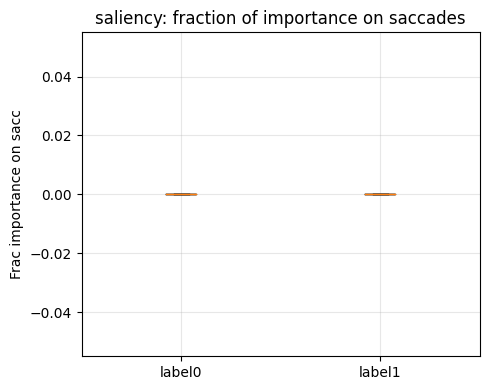

[MCDCNN XAI=ig] frac_imp_on_sacc  label0 vs label1 -> U=1035.0, p=1.000e+00, mean0=0.000, mean1=0.000


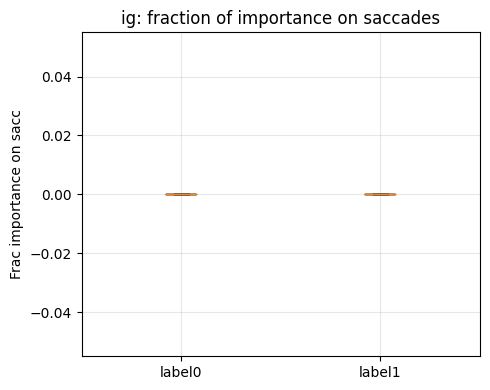

[MCDCNN XAI=gradcampp] frac_imp_on_sacc  label0 vs label1 -> U=1035.0, p=1.000e+00, mean0=0.000, mean1=0.000


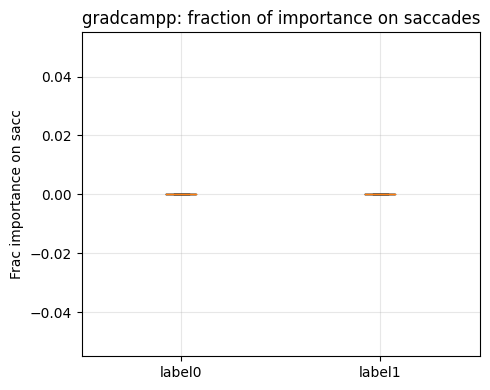

In [16]:
# 1) Train MCDCNN (+features):
res = run_mcdcnn_with_features(
    csv_dir="/Users/wukehui/Desktop/data science project/project/data/first_trials",
    label_pair=(0,2), target_len=1500, smooth_k=5,
    filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True
)
model_mcd = res["model"]
last_conv_names = res["last_conv_names"]     # Grad-CAM++ branch name
branch_names = BRANCH_ORDER                  # Consistent with build time

# 2) Prepare original four-channel data (consistent with training preprocessing):
X_raw, y, files = load_pair_experiment(
    "/Users/wukehui/Desktop/data science project/project/data/first_trials",
    (0,2), resample_len=1500, max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True
)

# 3) Dataset-level evaluation (up to 200 records):
df_imp, summary = run_xai_saccade_analysis_mcdcnn(
    model=model_mcd,
    X_raw=X_raw, y=y,
    target_len=1500,
    branch_names=branch_names, 
    xai_methods=('saliency','ig','gradcampp'),
    vel_thr=0.8, min_frames=8,
    max_n=200,
    branch_last_conv_names=last_conv_names
)


Load-level Pattern Differences + Sliding Window Feature Dynamics for mcdcnn

In [72]:
import os, json
from typing import Dict, Tuple, List, Optional
import numpy as np
import pandas as pd
from scipy.stats import mannwhitneyu
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score, roc_auc_score
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

SEED = 42
np.random.seed(SEED)
os.makedirs("outputs", exist_ok=True)

# Basics: Trajectory length + sliding window features (same as CNN version, based on the original 4 channels)
def trajectory_length(seq_xy: np.ndarray) -> float:
    lx, ly, rx, ry = seq_xy[:,0], seq_xy[:,1], seq_xy[:,2], seq_xy[:,3]
    dl = np.sqrt(np.diff(lx)**2 + np.diff(ly)**2).sum()
    dr = np.sqrt(np.diff(rx)**2 + np.diff(ry)**2).sum()
    return float((dl + dr) / 2.0)

def compute_lengths(X: np.ndarray) -> np.ndarray:
    return np.array([trajectory_length(x) for x in X], dtype=np.float32)

def velocity_trace(seq_xy: np.ndarray) -> np.ndarray:
    lx, ly, rx, ry = seq_xy[:,0], seq_xy[:,1], seq_xy[:,2], seq_xy[:,3]
    vl = np.sqrt(np.diff(lx)**2 + np.diff(ly)**2)
    vr = np.sqrt(np.diff(rx)**2 + np.diff(ry)**2)
    return (vl + vr)/2.0

def acceleration_from_velocity(v: np.ndarray) -> np.ndarray:
    if len(v) < 2: return np.zeros_like(v)
    return np.abs(np.diff(v))

def window_slices(T: int, win: int, stride: int):
    idx = []
    s = 0
    while s + win <= T:
        idx.append((s, s+win))
        s += stride
    if not idx:
        idx.append((0, T))
    return idx

def window_features(seq_xy: np.ndarray, win=100, stride=50, sacc_thr=None) -> Dict[str, np.ndarray]:
    """
    Each window extracts:
      - mean_v: Mean velocity
      - mean_a: Mean acceleration (mean of the absolute values of velocity differences)
      - rng: Position range (mean of the max-min values for each channel)
      - sacc_freq: Fraction of frames where velocity exceeds a threshold (adaptive threshold: p90 or a constant)
    """
    T = seq_xy.shape[0]
    vx = velocity_trace(seq_xy)          # length T-1
    ax = acceleration_from_velocity(vx)  # length T-2

    if sacc_thr is None:
        sacc_thr = np.percentile(vx, 90.0)

    slices = window_slices(T-1, win, stride)  # Based on speed length
    mean_v, mean_a, rng, sacc_freq = [], [], [], []
    for (i, j) in slices:
        v_win = vx[i:j]                        # (win,)
        a_win = ax[i:j-1] if (j-i)>=2 else np.array([0.0])
        sub = seq_xy[i:(i+win), :] if (i+win)<=T else seq_xy[i:T, :]

        mean_v.append(float(np.mean(v_win) if len(v_win)>0 else 0.0))
        mean_a.append(float(np.mean(a_win) if len(a_win)>0 else 0.0))

        ranges = sub.max(axis=0) - sub.min(axis=0)
        rng.append(float(np.mean(ranges)))

        sacc_freq.append(float(np.mean(v_win > sacc_thr)) if len(v_win)>0 else 0.0)

    return {
        'mean_v': np.array(mean_v, dtype=np.float32),
        'mean_a': np.array(mean_a, dtype=np.float32),
        'rng': np.array(rng, dtype=np.float32),
        'sacc_freq': np.array(sacc_freq, dtype=np.float32),
        'windows': np.array(slices, dtype=np.int32)     # (start, end) of each window on the original time axis
    }

# Window-level XAI dynamics (MCDCNN fused importance)
def fused_importance_mcdcnn(
    model, x_aug_single: np.ndarray, branch_names: List[str],
    method: str = "gradcampp", ig_steps: int = 64
) -> np.ndarray:
    """
    Outputs a one-dimensional importance curve of length T (normalized to sum to 1) for alignment with sliding window features.
    Depending on what you've already implemented:
      - mcdcnn_saliency_fused(model, branches_x, stat_vec)
      - mcdcnn_ig_fused(model, branches_x, stat_vec, steps)
      - gradcampp_mcdcnn_multi(model, x_aug_single, branch_names, ...) -> Returns a dict containing 'fused'
      - prepare_mcd_inputs_from_aug(x_aug_single, branch_names)
    """
    if method in ("saliency", "ig"):
        branches_x, stat_vec = prepare_mcd_inputs_from_aug(x_aug_single, branch_names)
        if method == "saliency":
            imp = mcdcnn_saliency_fused(model, branches_x, stat_vec)         # (T,)
        else:
            imp = mcdcnn_ig_fused(model, branches_x, stat_vec, steps=ig_steps)  # (T,)
    elif method == "gradcampp":
        cams = gradcampp_mcdcnn_multi(model, x_aug_single, branch_names, branch_last_conv_names=None, fuse='mean')
        imp = cams['fused'] / (cams['fused'].sum() + 1e-8)
    else:
        raise ValueError(f"Unknown XAI method: {method}")
    # Do the robustness again
    imp = np.maximum(imp, 0)
    return imp / (imp.sum() + 1e-8)

def window_aggregate_importance(imp: np.ndarray, win_slices: np.ndarray) -> np.ndarray:
    """
    Aggregate the frame-by-frame importance imp(T,) to each window (take the average) and get (K,).
    """
    K = len(win_slices)
    out = np.zeros((K,), dtype=np.float32)
    for k, (s, e) in enumerate(win_slices):
        out[k] = float(np.mean(imp[s:e]))
    return out

# Group-level comparison (sliding window + optional XAI)
def group_window_dynamics_with_xai(
    X_raw: np.ndarray, y: np.ndarray,
    model_mcd=None, X_aug: Optional[np.ndarray]=None, branch_names: Optional[List[str]]=None,
    xai_method: Optional[str] = "gradcampp",     # None means no XAI overlay
    win=100, stride=50
) -> Dict:
    feats0, feats1 = [], []
    xai0, xai1 = [], []

    for i in range(len(X_raw)):
        feats = window_features(X_raw[i], win=win, stride=stride, sacc_thr=None)
        feats['label'] = int(y[i])

        # Window-level XAI
        if (xai_method is not None) and (model_mcd is not None):
            if X_aug is None or branch_names is None:
                raise ValueError("XAI overlays require X_aug and branch_names")
            imp = fused_importance_mcdcnn(model_mcd, X_aug[i], branch_names, method=xai_method)  # (T,)
            w_imp = window_aggregate_importance(imp, feats['windows'])                           # (K,)
            feats['xai_win'] = w_imp

        if y[i] == 0:
            feats0.append(feats)
        else:
            feats1.append(feats)

    if len(feats0)==0 or len(feats1)==0:
        raise ValueError("There are not enough samples of the two categories to make dynamic comparisons")

    # Align to the same number of windows (take the shortest)
    K = min(min(len(f['mean_v']) for f in feats0), min(len(f['mean_v']) for f in feats1))

    def stack_and_trim(feats_list, key):
        return np.stack([f[key][:K] for f in feats_list], axis=0)

    out = {}
    keys = ['mean_v','mean_a','rng','sacc_freq']
    if (xai_method is not None) and (model_mcd is not None):
        keys = keys + ['xai_win']

    for key in keys:
        A0 = stack_and_trim(feats0, key)   # (N0, K)
        A1 = stack_and_trim(feats1, key)   # (N1, K)
        mean0, mean1 = A0.mean(0), A1.mean(0)
        se0, se1 = A0.std(0)/np.sqrt(A0.shape[0]), A1.std(0)/np.sqrt(A1.shape[0])
        pvals = [mannwhitneyu(A0[:,k], A1[:,k], alternative='two-sided')[1] for k in range(K)]
        out[key] = {
            'mean0': mean0, 'mean1': mean1,
            'se0': se0, 'se1': se1,
            'pvals': np.asarray(pvals, dtype=np.float32)
        }
    out['K'] = K
    out['win'] = win
    out['stride'] = stride
    return out

# Plot
def plot_window_curves(dyn: Dict, title: str, save_path: str, alpha=0.05):
    K, win, stride = dyn['K'], dyn['win'], dyn['stride']
    tgrid = np.arange(K) * stride + win//2
    # Automatically include xai_win
    keys = [k for k in ['mean_v','mean_a','rng','sacc_freq','xai_win'] if k in dyn]
    fig, axes = plt.subplots(len(keys), 1, figsize=(10, 2.8*len(keys)), sharex=True)
    if len(keys)==1: axes = [axes]
    for ax, key in zip(axes, keys):
        d = dyn[key]
        ax.plot(tgrid, d['mean0'], label='label0')
        ax.fill_between(tgrid, d['mean0']-d['se0'], d['mean0']+d['se0'], alpha=0.25)
        ax.plot(tgrid, d['mean1'], label='label1')
        ax.fill_between(tgrid, d['mean1']-d['se1'], d['mean1']+d['se1'], alpha=0.25)
        # Significance marking
        sig = d['pvals'] < alpha
        if sig.any():
            ymin = min(d['mean0'].min(), d['mean1'].min())
            ax.scatter(tgrid[sig], np.full(sig.sum(), ymin), marker='|', s=60, label='p<%.2f'%alpha)
        ax.set_ylabel(key)
        ax.grid(alpha=0.25)
    axes[-1].set_xlabel('time (frame)')
    axes[0].legend()
    fig.suptitle(title)
    plt.tight_layout()
    fig.savefig(save_path, dpi=200)
    plt.close(fig)

def plot_box_violin_lengths(lengths: np.ndarray, y: np.ndarray, title: str, save_path: str):
    data0, data1 = lengths[y==0], lengths[y==1]
    fig, ax = plt.subplots(1,2, figsize=(10,4), sharey=True)
    ax[0].boxplot([data0, data1], labels=['label0','label1'])
    ax[0].set_title('Boxplot')
    ax[0].set_ylabel('Trajectory length')
    parts = ax[1].violinplot([data0, data1], showmeans=True, showmedians=True)
    ax[1].set_xticks([1,2]); ax[1].set_xticklabels(['label0','label1'])
    ax[1].set_title('Violin')
    fig.suptitle(title)
    plt.tight_layout()
    fig.savefig(save_path, dpi=200)
    plt.close(fig)

# One-click operation (MCDCNN version)
def analyze_dataset_mcdcnn(
    name: str,
    csv_dir: str,
    label_pair=(0,2),
    target_len=1500,
    out_dir="outputs",
    win=100, stride=50,
    # MCDCNN related
    model_mcd=None,
    branch_names: Optional[List[str]] = None,
    xai_method: Optional[str] = "gradcampp"   # None turns off the XAI curve
):
    os.makedirs(os.path.join(out_dir, name), exist_ok=True)

    # 1) Load data (preprocessing consistent with training)
    X_raw, y, files = load_pair_experiment(
        csv_dir, label_pair, resample_len=target_len,
        max_nan_ratio=0.30, divide_by_960=True, use_robust_scale=True
    )

    # 2) Trajectory length differences + length-only classification (subject grouping)
    L = compute_lengths(X_raw)
    df_len = pd.DataFrame({'file': files, 'pid':[os.path.splitext(f)[0].split('_')[0] for f in files],
                           'label': y, 'length': L})
    df_len.to_csv(os.path.join(out_dir, name, f"{name}_lengths.csv"), index=False)

    L0, L1 = L[y==0], L[y==1]
    U, p = mannwhitneyu(L0, L1, alternative='two-sided')
    stats_len = dict(n0=int(len(L0)), n1=int(len(L1)),
                     mean0=float(L0.mean()), mean1=float(L1.mean()),
                     std0=float(L0.std()), std1=float(L1.std()),
                     U=float(U), p=float(p))
    with open(os.path.join(out_dir, name, f"{name}_length_stats.json"), "w") as f:
        json.dump(stats_len, f, indent=2)

    plot_box_violin_lengths(L, y, title=f"{name} Trajectory Length",
                            save_path=os.path.join(out_dir, name, f"{name}_length_box_violin.png"))

    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(
        L.reshape(-1,1), y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    clf = make_pipeline(StandardScaler(), LogisticRegression(random_state=SEED, max_iter=1000))
    clf.fit(np.vstack([Xtr, Xva]), np.hstack([ytr, yva]))
    prob = clf.predict_proba(Xte)[:,1]
    pred = (prob >= 0.5).astype(int)
    acc = accuracy_score(yte, pred)
    try: auc = roc_auc_score(yte, prob)
    except ValueError: auc = float('nan')
    with open(os.path.join(out_dir, name, f"{name}_length_cls.json"), "w") as f:
        json.dump({'accuracy': float(acc), 'roc_auc': float(auc), 'split': split_info}, f, indent=2)

    # 3) Sliding Window Feature Dynamics (+ Optional XAI Sliding Window Importance)
    X_aug = None
    if (xai_method is not None) and (model_mcd is not None):
        # Pre-constructed 13-channel enhancement (consistent with MCDCNN)
        X_aug = augment_dynamic_channels(X_raw, smooth_k=5)  # (N,T,13)

    dyn = group_window_dynamics_with_xai(
        X_raw, y, model_mcd=model_mcd, X_aug=X_aug, branch_names=branch_names,
        xai_method=xai_method, win=win, stride=stride
    )
    # Save window-by-window p-values
    keys = ['mean_v','mean_a','rng','sacc_freq']
    if 'xai_win' in dyn: keys.append('xai_win')
    pv = {k: dyn[k]['pvals'].tolist() for k in keys}
    with open(os.path.join(out_dir, name, f"{name}_window_pvals.json"), "w") as f:
        json.dump({'K': dyn['K'], 'win': dyn['win'], 'stride': dyn['stride'], 'pvals': pv}, f, indent=2)

    # Plot
    plot_window_curves(dyn, title=f"{name} sliding-window dynamics (win={win}, stride={stride})",
                       save_path=os.path.join(out_dir, name, f"{name}_window_dynamics.png"))

    print(f"[{name}] Length-only Acc={acc:.3f}, AUC={auc:.3f}; MW-U(length) p={p:.3e}")
    if 'xai_win' in dyn:
        print(f"[{name}] has saved XAI sliding window importance and feature dynamics to {os.path.join(out_dir, name)}")

    return {'length_stats': stats_len,
            'length_cls': {'accuracy': float(acc), 'roc_auc': float(auc)},
            'splits': split_info}


In [73]:
if __name__ == "__main__":
    FIRST_DIR  = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (0, 2)
    TARGET_LEN = 1500
    WIN, STRIDE = 100, 50

    # Trained MCDCNN (with 13 branches + statistical input)
    # model_mcd = res["model_mcd"] / saved model
    # branch_names = BRANCH_ORDER # Keep the order of the inputs consistent with the modeling input.

    print("=== Analyze FIRST (with XAI overlay) ===")
    analyze_dataset_mcdcnn(
        name="first_trials_mcd",
        csv_dir=FIRST_DIR, label_pair=PAIR, target_len=TARGET_LEN,
        out_dir="outputs", win=WIN, stride=STRIDE,
        model_mcd=model_mcd, branch_names=branch_names, xai_method="gradcampp"  # "saliency"/"ig"/"gradcampp"/None
    )

    print("=== Analyze REPEATS (with XAI overlay) ===")
    analyze_dataset_mcdcnn(
        name="repeats_mcd",
        csv_dir=REPEAT_DIR, label_pair=PAIR, target_len=TARGET_LEN,
        out_dir="outputs", win=WIN, stride=STRIDE,
        model_mcd=model_mcd, branch_names=branch_names, xai_method="gradcampp"
    )


=== Analyze FIRST (with XAI overlay) ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[first_trials_mcd] Length-only Acc=0.389, AUC=0.500; MW-U(length) p=3.548e-01
[first_trials_mcd] has saved XAI sliding window importance and feature dynamics to outputs/first_trials_mcd
=== Analyze REPEATS (with XAI overlay) ===
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
[repeats_mcd] Length-only Acc=0.700, AUC=0.760; MW-U(length) p=6.359e-01
[repeats_mcd] has saved XAI sliding window importance and feature dynamics to outputs/repeats_mcd


Ablation Experiments for mcdcnn

In [20]:
"""
Ablation Experiments for MCDCNN (multi-branch + stats)
- 8.3.1 Eye Channel Ablation: Left Only / Right Only / Both
- 8.3.2 Temporal Segment Ablation: Start / Middle / End
- 8.3.3 Coordinate Direction Ablation: X only / Y only

The input remains unchanged with 13 branches + statistics vector, and ablation is performed by channel zeroing or time slicing->resampling->re-enhancement.
"""

import os, time, json
from typing import Tuple, List, Dict, Optional
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, classification_report

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Convention: 13 channel column order output by augment_dynamic_channels
# [0:lx, 1:ly, 2:rx, 3:ry, 4:vel_L, 5:vel_R, 6:sp_lx, 7:sp_ly, 8:sp_rx, 9:sp_ry, 10:d_x, 11:d_y, 12:d_mag]
IDX = {
    'lx':0, 'ly':1, 'rx':2, 'ry':3,
    'vel_L':4, 'vel_R':5, 'sp_lx':6, 'sp_ly':7, 'sp_rx':8, 'sp_ry':9,
    'd_x':10, 'd_y':11, 'd_mag':12
}
ALL_IDX = list(range(13))

# Tools: 13 channels -> 13 branches + statistics vector
# Unified decomposition/packaging
def split_to_branches_stats_and_packed(X_aug: np.ndarray):
    """
    Input: X_aug (N,T,13)
    Output:
      branches: list of 13 arrays (N,T,1)
      stats:    (N, 39)
      packed:   (N, T, 13)
    """
    N, T, C = X_aug.shape
    assert C == 13, f"expect 13 channels, got {C}"
    branches = [X_aug[..., i:i+1].astype(np.float32, copy=False) for i in range(13)]
    stats = compute_global_stats(X_aug).astype(np.float32, copy=False)   # (N, 39)
    packed = X_aug.astype(np.float32, copy=False)
    return branches, stats, packed

def prepare_inputs_for_model(model, X_aug: np.ndarray):
    """
    Prepare inputs adaptively according to the number of model.inputs:
      - 1 input: (N,T,13)
      - 2 input: [(N,T,13), (N,39)]
      - 14 input: [13*(N,T,1), (N,39)]
    """
    n_in = len(model.inputs)
    branches, stats, packed = split_to_branches_stats_and_packed(X_aug)

    if n_in == 1:
        return packed
    elif n_in == 2:
        return [packed, stats]
    elif n_in == 14:
        return branches + [stats]
    else:
        raise ValueError(f"Unsupported number of inputs: model expects {n_in} inputs; "
                         f"only 1, 2, or 14 are handled. Please check your MCDCNN builder.")


# The builder remains unchanged (still uses its own builder function), but the trainer is changed to self-adaptive
def build_mcdcnn_model_from_extractor(
    T: int, filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True, dropout=0.5
):
    # Still reuse the two-stage construction function
    extractor = build_mcdcnn_extractor((T, 13), filters=filters, kernels=kernels, pools=pools, l2=l2, use_bn=use_bn)
    model = build_classifier_from_extractor_mcd(extractor, dropout=dropout, l2=l2)
    return model


def train_eval_once_mcdcnn(
    X_aug: np.ndarray, y: np.ndarray, files: List[str],
    lr=3e-4, batch_size=16, max_epochs=80, early_patience=15,
    filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True, dropout=0.5
) -> Dict:
    """
    Use the "self-adaptive" packing method to train MCDCNN: whether the MCDCNN has 1 input, 2 inputs, or 14 inputs, it can be matched.
    """
    # Independent partitioning of subjects (using subject ID in the file name)
    Xtr, ytr, Xva, yva, Xte, yte, splits = split_by_participant_train_val_test(
        X_aug, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )

    # Build the model
    T = X_aug.shape[1]
    model = build_mcdcnn_model_from_extractor(
        T, filters=filters, kernels=kernels, pools=pools, l2=l2, use_bn=use_bn, dropout=dropout
    )
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])

    # Adaptive packaging input
    Xtr_in = prepare_inputs_for_model(model, Xtr)
    Xva_in = prepare_inputs_for_model(model, Xva)
    Xte_in = prepare_inputs_for_model(model, Xte)

    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    class_weight = compute_class_weight(ytr)

    t0 = time.perf_counter()
    model.fit(
        Xtr_in, ytr,
        validation_data=(Xva_in, yva),
        epochs=max_epochs, batch_size=batch_size, verbose=0,
        callbacks=callbacks, class_weight=class_weight
    )
    t1 = time.perf_counter()

    yprob = model.predict(Xte_in, batch_size=batch_size).ravel()
    ypred = (yprob >= 0.5).astype(int)

    from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, classification_report
    acc = accuracy_score(yte, ypred)
    macro_f1 = f1_score(yte, ypred, average='macro')
    try:
        roc_auc = roc_auc_score(yte, yprob)
    except Exception:
        roc_auc = np.nan
    report = classification_report(yte, ypred, digits=4)

    return dict(
        acc=float(acc), macro_f1=float(macro_f1), roc_auc=float(roc_auc),
        time_sec=float(t1 - t0), report=report, splits=splits
    )








# Ablation: Channel Zeroing
def ablate_channels_on_aug(X_aug: np.ndarray, keep_names: List[str]) -> np.ndarray:
    """
    Perform a "preserving" ablation after 13-channel augmentation: all channels not listed in keep_names are set to zero.
    keep_names uses a keyed set of IDX .
    """
    keep_idx = sorted([IDX[k] for k in keep_names])
    X_mod = X_aug.copy()
    drop_idx = [i for i in ALL_IDX if i not in keep_idx]
    if drop_idx:
        X_mod[..., drop_idx] = 0.0
    return X_mod

# Ablation: Time Slice (on original 4-channel slice -> resample -> re-enhance)
def temporal_slice_and_reaugment(
    X_raw4: np.ndarray, seg: str, target_len: int
) -> np.ndarray:
    """
    X_raw4: (N,T,4) resampled and robustly scaled (same as training)
    seg in {'start', 'middle', 'end'}
    First slice by 1/3, then linearly resample back to target_len, and finally augment_dynamic_channels -> (N,T,13)
    """
    N, T, C = X_raw4.shape
    assert C == 4
    third = T // 3
    if seg == 'start':
        Xs = X_raw4[:, :third, :]
    elif seg == 'middle':
        Xs = X_raw4[:, third:2*third, :]
    elif seg == 'end':
        Xs = X_raw4[:, 2*third:, :]
    else:
        raise ValueError(f"Unknown seg: {seg}")

    # Resample back to target_len
    Xr = np.empty((N, target_len, 4), dtype=np.float32)
    for i in range(N):
        Xr[i] = _linear_resample(Xs[i], target_len)  # Reusing existing functions

    # Then do 13 channel enhancement
    X_aug = augment_dynamic_channels(Xr, smooth_k=5)
    return X_aug





# 8.3.1 Ablation per eye
def run_eye_channel_ablation_mcdcnn(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True, dropout=0.5
) -> pd.DataFrame:
    # 1) Load the original 4 channels (same as training)
    X_raw, y, files = load_pair_experiment(
        csv_dir, label_pair, resample_len=target_len,
        max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True
    )
    # 2) Unified enhancement to 13-channel base
    X_aug_base = augment_dynamic_channels(X_raw, smooth_k=5)

    settings = {
        'left':  ['lx','ly','vel_L','sp_lx','sp_ly'],   # The right eye and LR differences are all set to zero
        'right': ['rx','ry','vel_R','sp_rx','sp_ry'],
        'both':  ['lx','ly','rx','ry','vel_L','vel_R','sp_lx','sp_ly','sp_rx','sp_ry','d_x','d_y','d_mag']
    }

    rows = []
    for name, keep in settings.items():
        X_aug = ablate_channels_on_aug(X_aug_base, keep)
        res = train_eval_once_mcdcnn(
            X_aug, y, files, filters=filters, kernels=kernels, pools=pools, l2=l2, use_bn=use_bn, dropout=dropout
        )
        rows.append(dict(
            ablation='EyeChannel', setting=name,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'], time_sec=res['time_sec']
        ))
        print(f"[MCDCNN EyeChannel] {name}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# 8.3.2 Time Segment Ablation
def run_temporal_segment_ablation_mcdcnn(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True, dropout=0.5
) -> pd.DataFrame:
    # Original 4-channel loading
    X_raw, y, files = load_pair_experiment(
        csv_dir, label_pair, resample_len=target_len,
        max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True
    )

    rows = []
    for seg in ['start','middle','end']:
        # Slice->Resample->Re-enhance
        X_aug = temporal_slice_and_reaugment(X_raw, seg, target_len)
        res = train_eval_once_mcdcnn(
            X_aug, y, files, filters=filters, kernels=kernels, pools=pools, l2=l2, use_bn=use_bn, dropout=dropout
        )
        rows.append(dict(
            ablation='Temporal', setting=seg,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'], time_sec=res['time_sec']
        ))
        print(f"[MCDCNN Temporal] {seg}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# 8.3.3 Directional Ablation
def run_coord_direction_ablation_mcdcnn(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True, dropout=0.5
) -> pd.DataFrame:
    X_raw, y, files = load_pair_experiment(
        csv_dir, label_pair, resample_len=target_len,
        max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True
    )
    X_aug_base = augment_dynamic_channels(X_raw, smooth_k=5)

    # Note: To avoid Y/X information leakage, vel_* depends on two axes. In the direction ablation, we set vel_* to zero and only retain the original/velocity differential/difference of the corresponding axis.
    settings = {
        'x': ['lx','rx','sp_lx','sp_rx','d_x'],     # ly/ry/sp_ly/sp_ry/d_y/d_mag/vel_* set to zero
        'y': ['ly','ry','sp_ly','sp_ry','d_y'],
    }

    rows = []
    for name, keep in settings.items():
        X_aug = ablate_channels_on_aug(X_aug_base, keep)
        res = train_eval_once_mcdcnn(
            X_aug, y, files, filters=filters, kernels=kernels, pools=pools, l2=l2, use_bn=use_bn, dropout=dropout
        )
        rows.append(dict(
            ablation='Coord', setting=name,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'], time_sec=res['time_sec']
        ))
        print(f"[MCDCNN Coord] {name}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# One-button control
def run_all_ablation_mcdcnn(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    save_prefix: Optional[str] = None,
    filters=(32,64), kernels=(7,5), pools=(2,2), l2=1e-4, use_bn=True, dropout=0.5
) -> Dict[str, pd.DataFrame]:
    res_eye = run_eye_channel_ablation_mcdcnn(csv_dir, label_pair, target_len, filters, kernels, pools, l2, use_bn, dropout)
    res_tmp = run_temporal_segment_ablation_mcdcnn(csv_dir, label_pair, target_len, filters, kernels, pools, l2, use_bn, dropout)
    res_dir = run_coord_direction_ablation_mcdcnn(csv_dir, label_pair, target_len, filters, kernels, pools, l2, use_bn, dropout)

    results = {'EyeChannel': res_eye, 'Temporal': res_tmp, 'Coord': res_dir}
    if save_prefix:
        for k, df in results.items():
            df.to_csv(f"{save_prefix}_{k}.csv", index=False)
        with open(f"{save_prefix}_meta.json", "w") as f:
            json.dump({'label_pair': label_pair, 'target_len': target_len}, f, indent=2)
    return results

# Run
if __name__ == "__main__":
    FIRST_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (0, 2)
    TLEN = 1500

    print("=== 8.3 Ablation on FIRST_TRIALS (MCDCNN) ===")
    res_first = run_all_ablation_mcdcnn(
        FIRST_DIR, label_pair=PAIR, target_len=TLEN,
        save_prefix=f"mcd_ablation_first_{PAIR[0]}_{PAIR[1]}"
    )

    print("\n=== 8.3 Ablation on REPEATS (MCDCNN) ===")
    res_repeats = run_all_ablation_mcdcnn(
        REPEAT_DIR, label_pair=PAIR, target_len=TLEN,
        save_prefix=f"mcd_ablation_repeats_{PAIR[0]}_{PAIR[1]}"
    )

    # Summary Printing
    for name, df in res_first.items():
        print(f"\n[FIRST|MCDCNN] {name}\n", df.sort_values('acc', ascending=False))
    for name, df in res_repeats.items():
        print(f"\n[REPEATS|MCDCNN] {name}\n", df.sort_values('acc', ascending=False))


=== 8.3 Ablation on FIRST_TRIALS (MCDCNN) ===
[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)

Epoch 10: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 16: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 5ms/step
[MCDCNN EyeChannel] left: Acc=0.882, F1=0.882, AUC=0.971
              precision    recall  f1-score   support

           0     0.7778    1.0000    0.8750         7
           1     1.0000    0.8000    0.8889        10

    accuracy                         0.8824        17
   macro avg     0.8889    0.9000    0.8819        17
weighted avg     0.9085    0.8824    0.8832        17


Epoch 11: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 17: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 7ms/step
[MCDCNN EyeChannel] right: Acc=0.824, F1=0.821, AUC=0.943
              precision    rec


Epoch 14: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 20: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 220ms/step
[MCDCNN Temporal] end: Acc=0.700, F1=0.697, AUC=0.880
              precision    recall  f1-score   support

           0     0.7500    0.6000    0.6667         5
           1     0.6667    0.8000    0.7273         5

    accuracy                         0.7000        10
   macro avg     0.7083    0.7000    0.6970        10
weighted avg     0.7083    0.7000    0.6970        10

[load_pair_experiment] Labels=(0, 2), files=40, shape=(40, 1500, 4)

Epoch 17: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 23: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 231ms/step
[MCDCNN Coord] x: Acc=1.000, F1=1.000, AUC=1.000
              precision    recall  f1-score   support

           0     1.0000    1.

In [20]:
# Run
if __name__ == "__main__":
    FIRST_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (1, 3)
    TLEN = 1500

    print("=== 8.3 Ablation on FIRST_TRIALS (MCDCNN) ===")
    res_first = run_all_ablation_mcdcnn(
        FIRST_DIR, label_pair=PAIR, target_len=TLEN,
        save_prefix=f"mcd_ablation_first_{PAIR[0]}_{PAIR[1]}"
    )

    print("\n=== 8.3 Ablation on REPEATS (MCDCNN) ===")
    res_repeats = run_all_ablation_mcdcnn(
        REPEAT_DIR, label_pair=PAIR, target_len=TLEN,
        save_prefix=f"mcd_ablation_repeats_{PAIR[0]}_{PAIR[1]}"
    )

    # Summary Printing
    for name, df in res_first.items():
        print(f"\n[FIRST|MCDCNN] {name}\n", df.sort_values('acc', ascending=False))
    for name, df in res_repeats.items():
        print(f"\n[REPEATS|MCDCNN] {name}\n", df.sort_values('acc', ascending=False))


=== 8.3 Ablation on FIRST_TRIALS (MCDCNN) ===
[load_pair_experiment] Dir=first_trials Labels=(1, 3), files=96, shape=(96, 1500, 4)

Epoch 10: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 16: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 1s 13ms/step
[MCDCNN EyeChannel] left: Acc=0.762, F1=0.753, AUC=0.936
              precision    recall  f1-score   support

           0     0.7143    0.9091    0.8000        11
           1     0.8571    0.6000    0.7059        10

    accuracy                         0.7619        21
   macro avg     0.7857    0.7545    0.7529        21
weighted avg     0.7823    0.7619    0.7552        21


Epoch 10: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 16: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 13ms/step
[MCDCNN EyeChannel] right: Acc=0.857, F1=0.857, AUC=0.909
           


Epoch 19: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 231ms/step
[MCDCNN Temporal] end: Acc=1.000, F1=1.000, AUC=1.000
              precision    recall  f1-score   support

           0     1.0000    1.0000    1.0000         5
           1     1.0000    1.0000    1.0000         4

    accuracy                         1.0000         9
   macro avg     1.0000    1.0000    1.0000         9
weighted avg     1.0000    1.0000    1.0000         9

[load_pair_experiment] Dir=repeats Labels=(1, 3), files=39, shape=(39, 1500, 4)

Epoch 10: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 16: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 224ms/step
[MCDCNN Coord] x: Acc=0.889, F1=0.883, AUC=1.000
              precision    recall  f1-score   support

           0     0.8333    1.0000    0.9091         5
           1     1.0000    0.7500    0.85

time-cnn

[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Time-CNN Split] train=54, val=20, test=17
Epoch 1/80
4/4 [==============================] - 1s 61ms/step - loss: 0.6841 - accuracy: 0.5000 - val_loss: 0.6892 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 45ms/step - loss: 0.5821 - accuracy: 0.7593 - val_loss: 0.6864 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 47ms/step - loss: 0.5916 - accuracy: 0.6852 - val_loss: 0.6846 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 0s 48ms/step - loss: 0.5444 - accuracy: 0.6481 - val_loss: 0.6819 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 0s 43ms/step - loss: 0.5757 - accuracy: 0.7222 - val_loss: 0.6771 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 0s 45ms/step - loss: 0.5287 - accuracy: 0.7778 - val_loss: 

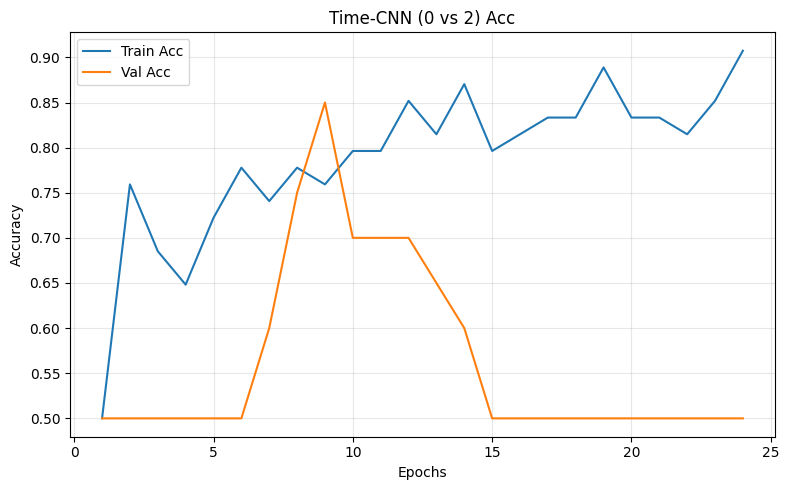

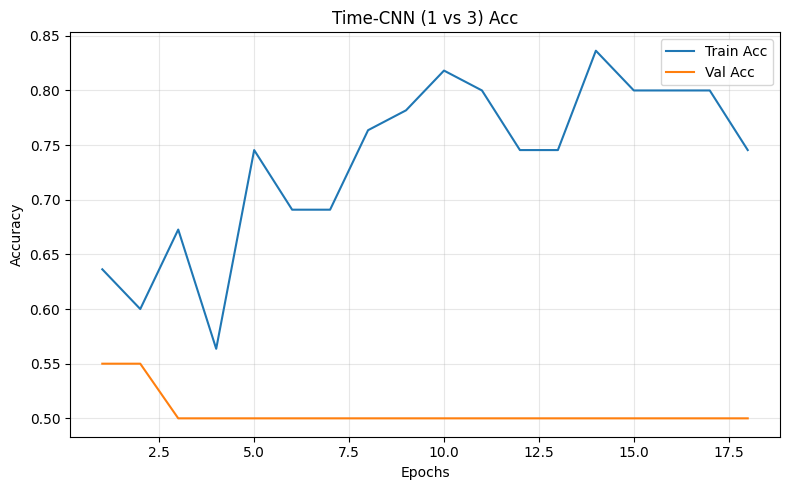

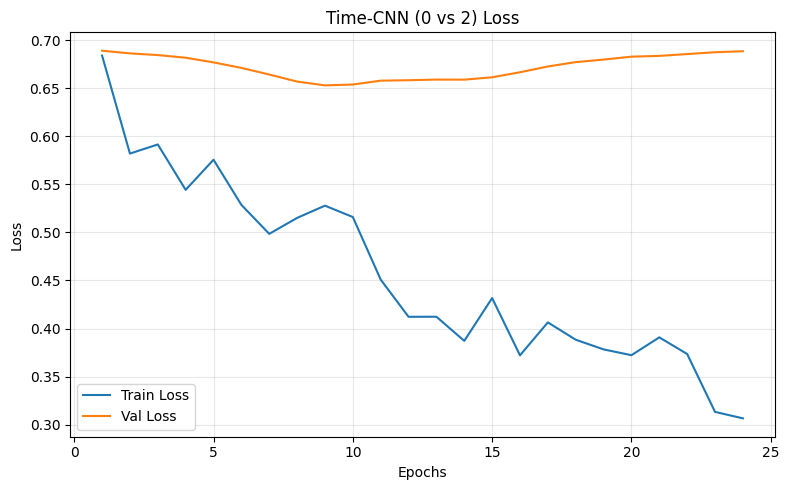

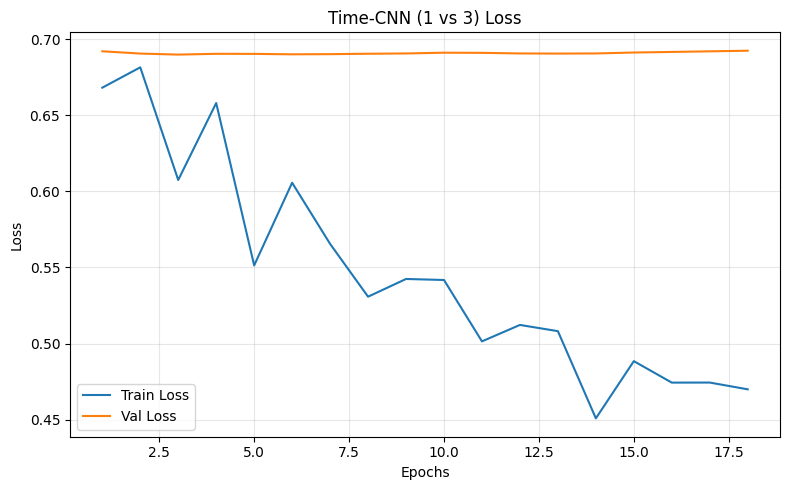

In [21]:
# Time-CNN
from tensorflow.keras import layers, Model, Input

def conv_block(x, nf, ks, pool=2, activation='relu', use_bn=True, dropout=0.0, name=''):
    x = layers.Conv1D(nf, ks, padding='same', use_bias=not use_bn, name=f'conv{name}')(x)
    if use_bn:
        x = layers.BatchNormalization(name=f'bn{name}')(x)
    x = layers.Activation(activation, name=f'act{name}')(x)
    if pool and pool > 1:
        x = layers.AveragePooling1D(pool_size=pool, name=f'avgpool{name}')(x)   # Time-CNN commonly used avg pooling
    if dropout and dropout > 0:
        x = layers.Dropout(dropout, name=f'drop{name}')(x)
    return x

def build_time_cnn_model(input_shape,
                         n_filters=(64, 128, 256),
                         kernel_sizes=(8, 5, 3),
                         pools=(2, 2, 2),
                         use_bn=True,
                         activation='relu',
                         head_units=64,
                         head_dropout=0.5):
    """
    A light Time-CNN:
      - Conv1D -> BN -> ReLU -> AvgPool (×3)
      - GlobalAveragePooling
      - Dense(head) + Dropout
      - Sigmoid
    """
    assert len(n_filters) == len(kernel_sizes) == len(pools)
    inp = Input(shape=input_shape, name='timecnn_input')
    x = inp
    for i, (nf, ks, ps) in enumerate(zip(n_filters, kernel_sizes, pools), start=1):
        x = conv_block(x, nf, ks, pool=ps, activation=activation, use_bn=use_bn,
                       dropout=0.0 if i < len(n_filters) else 0.1, name=f'{i}')
    x = layers.GlobalAveragePooling1D(name='gap')(x)
    x = layers.Dense(head_units, activation='relu', name='head_fc')(x)
    x = layers.Dropout(head_dropout, name='head_drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='time_cnn')

def run_time_cnn_experiment(
    csv_dir: str,
    label_pair: Tuple[int, int],
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    # Time-CNN architecture hyperparameters (can be fine-tuned as needed)
    n_filters=(64, 128, 256),
    kernel_sizes=(8, 5, 3),
    pools=(2, 2, 2),
    use_bn=True,
    head_units=64,
    head_dropout=0.5,
):
    # Reading & preprocessing (exactly the same as baseline)
    X, y, files = load_pair_experiment(
        csv_dir, label_pair,
        resample_len=target_len, max_nan_ratio=0.05,
        divide_by_960=True, use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    print(f"[Time-CNN Split] train={len(ytr)}, val={len(yva)}, test={len(yte)}")

    # Build Time-CNN
    model = build_time_cnn_model(
        input_shape=(target_len, 4),
        n_filters=n_filters, kernel_sizes=kernel_sizes, pools=pools,
        use_bn=use_bn, head_units=head_units, head_dropout=head_dropout
    )
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])

    # The callback remains consistent with the baseline
    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
        tf.keras.callbacks.CSVLogger(f'timecnn_log_{label_pair[0]}_{label_pair[1]}.csv', append=False)
    ]
    class_weight = compute_class_weight(ytr)

    # Train
    t0 = time.perf_counter()
    history = model.fit(
        Xtr, ytr,
        validation_data=(Xva, yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=1,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()
    print(f"[Time] Time-CNN {label_pair}: {t1 - t0:.2f}s")

    # Test
    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    from sklearn.metrics import classification_report, roc_auc_score
    report = classification_report(yte, ypred, digits=4)
    try:
        auc = roc_auc_score(yte, yprob)
    except Exception:
        auc = float('nan')
    print(f"\n[TEST|Time-CNN] Pair {label_pair} AUC={auc:.3f}\n{report}")

    return {
        'label_pair': label_pair,
        'history': history.history,
        'test_report': report,
        'auc': float(auc),
        'model': model,
        'id_splits': id_splits
    }

# Quick run (side-by-side comparison with baseline)
if __name__ == "__main__":
    csv_path = "/Users/wukehui/Desktop/data science project/project/data/first_trials"

    # Baseline (already available)
    # res_02 = run_experiment(csv_path, (0, 2), target_len=1500)
    # res_13 = run_experiment(csv_path, (1, 3), target_len=1500)

    # Time-CNN
    tcnn_02 = run_time_cnn_experiment(csv_path, (0, 2), target_len=1500)
    tcnn_13 = run_time_cnn_experiment(csv_path, (1, 3), target_len=1500)

    # Reusable previous drawing function
    plot_accuracy_curve(tcnn_02['history'], title='Time-CNN (0 vs 2) Acc', save_path='timecnn_02_acc.png')
    plot_accuracy_curve(tcnn_13['history'], title='Time-CNN (1 vs 3) Acc', save_path='timecnn_13_acc.png')
    plot_loss_curve(tcnn_02['history'], title='Time-CNN (0 vs 2) Loss', save_path='timecnn_02_loss.png')
    plot_loss_curve(tcnn_13['history'], title='Time-CNN (1 vs 3) Loss', save_path='timecnn_13_loss.png')


time-CNN transfer learning

In [22]:
# Time-CNN Transfer
import numpy as np, tensorflow as tf, time, os
from typing import Tuple, Dict, Optional, List
from tensorflow.keras import layers, Model, Input
from sklearn.metrics import classification_report, balanced_accuracy_score, f1_score

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Time-CNN blocks
def _conv_block(x, nf, ks, pool=2, use_bn=True, act='relu', name=''):
    x = layers.Conv1D(nf, ks, padding='same', use_bias=not use_bn, name=f'conv{name}')(x)
    if use_bn: x = layers.BatchNormalization(name=f'bn{name}')(x)
    x = layers.Activation(act, name=f'act{name}')(x)
    if pool and pool > 1: x = layers.AveragePooling1D(pool_size=pool, name=f'avgpool{name}')(x)
    return x

def build_timecnn_extractor(input_shape,
                            n_filters=(64,128,256),
                            kernel_sizes=(8,5,3),
                            pools=(2,2,2),
                            use_bn=True,
                            act='relu') -> Model:
    """Convolutional side only (for pre-training transferable representations)"""
    assert len(n_filters)==len(kernel_sizes)==len(pools)
    inp = Input(shape=input_shape, name='tcnn_in')
    x = inp
    for i,(nf,ks,ps) in enumerate(zip(n_filters, kernel_sizes, pools), start=1):
        x = _conv_block(x, nf, ks, pool=ps, use_bn=use_bn, act=act, name=f'{i}')
    x = layers.GlobalAveragePooling1D(name='gap')(x)
    return Model(inp, x, name='timecnn_extractor')

def build_timecnn_from_extractor(extractor: Model, head_units=64, dropout=0.5) -> Model:
    """Connect a small sorting head to the top of the extractor"""
    inp = extractor.input
    x = extractor.output
    x = layers.Dense(head_units, activation='relu', name='fc1')(x)
    x = layers.Dropout(dropout, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='timecnn_transfer')

# Trainability helpers
def freeze_all_but_head(model: Model):
    for l in model.layers:
        l.trainable = (l.name in ['fc1','drop','logit'])

def bn_adapt_only(model: Model):
    for l in model.layers:
        if isinstance(l, layers.BatchNormalization):
            l.trainable = True
        else:
            l.trainable = False

def unfreeze_last_block(model: Model):
    """Unfreeze the last convolutional block, gap, and header, and freeze the rest.
       Number convention: conv3/bn3/avgpool3 (if present)/gap.
       If the number of layers is changed to 4, replace '3' with the number of the last layer."""
    for l in model.layers:
        l.trainable = False
    for name in ['conv3','bn3','avgpool3','gap','fc1','drop','logit']:
        try:
            model.get_layer(name).trainable = True
        except ValueError:
            pass

# Gadget: Threshold Search (Balanced Accuracy)
def tune_threshold_bal_acc(y_true, y_prob) -> Tuple[float,float]:
    grid = np.linspace(0.1, 0.9, 33)
    best_t, best_m = 0.5, -1.0
    for t in grid:
        yhat = (y_prob >= t).astype(int)
        m = balanced_accuracy_score(y_true, yhat)
        if m > best_m:
            best_m, best_t = m, float(t)
    return best_t, best_m

# Pipelines
def pretrain_timecnn_extractor(
    csv_dir: str, src_pair=(0,2), target_len=1500,
    n_filters=(64,128,256), kernel_sizes=(8,5,3), pools=(2,2,2),
    head_units=64, dropout=0.5,
    max_epochs=60, batch_size=16, lr=3e-4,
    save_path='timecnn_extractor_src.weights.h5'
):
    # Read source domain
    Xs, ys, fs = load_pair_experiment(csv_dir, src_pair, resample_len=target_len,
                                      max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(Xs, ys, fs)

    # Build
    extractor = build_timecnn_extractor((target_len,4), n_filters, kernel_sizes, pools)
    model = build_timecnn_from_extractor(extractor, head_units=head_units, dropout=dropout)
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])

    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=12, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=8, min_lr=3.75e-5, verbose=1),
    ]
    print(f"[Pretrain|Time-CNN] source={src_pair}")
    t0 = time.perf_counter()
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=max_epochs, batch_size=batch_size, verbose=1, callbacks=cbs)
    print(f"[Time] {time.perf_counter()-t0:.2f}s")

    # A quick look at source domain testing
    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob >= 0.5).astype(int)
    print("[TEST|source] report:\n", classification_report(yte, ypred, digits=4))

    # Only store extractor weights
    extractor.save_weights(save_path)
    print(f"[SAVE] extractor weights -> {save_path}")
    return save_path

def transfer_timecnn(
    csv_dir: str, tgt_pair=(1,3), extractor_weights='timecnn_extractor_src.weights.h5',
    target_len=1500, batch_size=16,
    n_filters=(64,128,256), kernel_sizes=(8,5,3), pools=(2,2,2),
    head_units=64, dropout=0.5,
    head_lr=1.5e-3,  # Larger learning rate in the head
    ft_lr=5e-5       # Fine-tuning with a lower learning rate
):
    # Read target domain
    X, y, files = load_pair_experiment(csv_dir, tgt_pair, resample_len=target_len,
                                       max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)
    Xtr, ytr, Xva, yva, Xte, yte, split_ids = split_by_participant_train_val_test(X, y, files)
    cls_weight = compute_class_weight(ytr)

    # Load extractor
    extractor = build_timecnn_extractor((target_len,4), n_filters, kernel_sizes, pools)
    extractor.load_weights(extractor_weights)
    model = build_timecnn_from_extractor(extractor, head_units=head_units, dropout=dropout)

    # Stage 1: Head training only
    freeze_all_but_head(model)
    model.compile(optimizer=get_optimizer(head_lr), loss='binary_crossentropy', metrics=['accuracy','AUC'])
    print("[Stage 1] Head-only @ LR=", head_lr)
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=4, min_lr=head_lr/4, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size, verbose=1,
              callbacks=cbs1, class_weight=cls_weight)

    # Stage 1.5: BN-Adapt (updates BN statistics only)
    print("[BN-Adapt] epochs=2, lr=1e-5")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy', metrics=['accuracy','AUC'])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: Unfreeze the last convolutional fine-tuning
    print("[Stage 2] Unfreeze last block (conv3) @ LR=", ft_lr)
    unfreeze_last_block(model)
    model.compile(optimizer=get_optimizer(ft_lr), loss='binary_crossentropy', metrics=['accuracy','AUC'])
    cbs2 = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=12, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=8, min_lr=ft_lr/4, verbose=1)
    ]
    t0 = time.perf_counter()
    hist2 = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size, verbose=1,
                      callbacks=cbs2, class_weight=cls_weight)
    print(f"[Time] Fine-tune {time.perf_counter()-t0:.2f}s")

    # Threshold fine-tuning (Val → Test)
    vprob = model.predict(Xva, batch_size=batch_size).ravel()
    thr, bal = tune_threshold_bal_acc(yva, vprob)
    tprob = model.predict(Xte, batch_size=batch_size).ravel()
    tpred = (tprob >= thr).astype(int)
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")
    print("\n[TEST|target] report (thr tuned):\n", classification_report(yte, tpred, digits=4))

    return model, (Xtr, ytr, Xva, yva, Xte, yte, split_ids), hist2.history, thr

# Cross-dataset (first -> repeats)
def transfer_timecnn_first_to_repeats(
    src_dir: str, tgt_dir: str, pair=(0,2),
    extractor_weights: Optional[str] = None,
    **kwargs
):
    # Pretrain on first_trials (if weights are not provided)
    if extractor_weights is None:
        extractor_weights = pretrain_timecnn_extractor(
            csv_dir=src_dir, src_pair=pair, save_path=f"timecnn_extractor_first_{pair[0]}_{pair[1]}.weights.h5", **kwargs
        )
    # Then migrate and fine-tune on repeats
    return transfer_timecnn(
        csv_dir=tgt_dir, tgt_pair=pair, extractor_weights=extractor_weights, **kwargs
    )

# run
if __name__ == "__main__":
    # Migration within a single dataset: pre-train on 0vs2 first, then migrate to 1vs3
    CSV_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    W = pretrain_timecnn_extractor(CSV_DIR, src_pair=(0,2), target_len=1500)
    model_t, splits, hist2, thr = transfer_timecnn(CSV_DIR, tgt_pair=(1,3), extractor_weights=W, target_len=1500)

    # Migrating across datasets: first_trials -> repeats
    SRC = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    TGT = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    model_x, splits_x, histx, thr_x = transfer_timecnn_first_to_repeats(SRC, TGT, pair=(0,2), target_len=1500)


[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Pretrain|Time-CNN] source=(0, 2)
Epoch 1/60
4/4 [==============================] - 1s 78ms/step - loss: 0.7168 - accuracy: 0.5370 - auc: 0.5330 - val_loss: 0.6870 - val_accuracy: 0.5000 - val_auc: 0.9050 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 0s 39ms/step - loss: 0.6146 - accuracy: 0.5926 - auc: 0.7122 - val_loss: 0.6842 - val_accuracy: 0.5000 - val_auc: 0.9000 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 0s 45ms/step - loss: 0.5269 - accuracy: 0.7963 - auc: 0.8338 - val_loss: 0.6802 - val_accuracy: 0.5000 - val_auc: 0.8900 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 0s 48ms/step - loss: 0.5266 - accuracy: 0.7593 - auc: 0.8180 - val_loss: 0.6765 - val_accuracy: 0.5000 - val_auc: 0.8850 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 0s 51ms/step - loss: 0.4965 - accuracy: 0.7593 - auc: 0.8372 - val_loss: 0.6714 - val_accuracy: 

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[load_pair_experiment] Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Pretrain|Time-CNN] source=(0, 2)
Epoch 1/60
4/4 [==============================] - 1s 63ms/step - loss: 0.7609 - accuracy: 0.4815 - auc: 0.4986 - val_loss: 0.6899 - val_accuracy: 0.5000 - val_auc: 0.7450 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 0s 43ms/step - loss: 0.6484 - accuracy: 0.6111 - auc: 0.6628 - val_loss: 0.6868 - val_accuracy: 0.5000 - val_auc: 0.7900 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 0s 43ms/step - loss: 0.5224 - accuracy: 0.7593 - auc: 0.8304 - val_loss: 0.6838 - val_accuracy: 0.5000 - val_auc: 0.7850 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 0s 42ms/step - loss: 0.5139 - accuracy: 0.7407 - auc: 0.8434 - val_loss: 0.6823 - val_accuracy: 0.5000 - val_auc: 0.7950 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 0s 44ms/step - loss: 0.4686 - accuracy: 0.7963 - auc: 0.8867 - val_loss: 0.6787 - val_accuracy: 

2/2 [==============================] - 0s 28ms/step - loss: 0.4283 - accuracy: 0.7727 - auc: 0.9091 - val_loss: 0.5844 - val_accuracy: 0.7500 - val_auc: 0.8125 - lr: 5.0000e-05
Epoch 40/60
2/2 [==============================] - 0s 28ms/step - loss: 0.4643 - accuracy: 0.8182 - auc: 0.8926 - val_loss: 0.5833 - val_accuracy: 0.7500 - val_auc: 0.8125 - lr: 5.0000e-05
Epoch 41/60
2/2 [==============================] - 0s 27ms/step - loss: 0.4190 - accuracy: 0.7727 - auc: 0.9339 - val_loss: 0.5822 - val_accuracy: 0.7500 - val_auc: 0.8125 - lr: 5.0000e-05
Epoch 42/60
2/2 [==============================] - 0s 28ms/step - loss: 0.3915 - accuracy: 0.9091 - auc: 0.9504 - val_loss: 0.5812 - val_accuracy: 0.7500 - val_auc: 0.8125 - lr: 5.0000e-05
Epoch 43/60
2/2 [==============================] - 0s 29ms/step - loss: 0.5194 - accuracy: 0.6818 - auc: 0.8388 - val_loss: 0.5801 - val_accuracy: 0.7500 - val_auc: 0.8125 - lr: 5.0000e-05
Epoch 44/60
2/2 [==============================] - 0s 30ms/step - l

Repeat Trials Generalisation Test for time-cnn

In [25]:
# RTG: Repeat Trials Generalisation for Time-CNN
import os, json, time
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from typing import Optional, Tuple, Dict, List
from sklearn.metrics import (classification_report, balanced_accuracy_score, f1_score,
                             roc_auc_score, average_precision_score, confusion_matrix,
                             roc_curve, precision_recall_curve)
from tensorflow.keras import Model

os.makedirs("outputs/rtg_timecnn", exist_ok=True)

# Eval helpers
def predict_prob_on_dir(model: Model, data_dir: str, pair=(0,2), target_len=1500, batch_size=16):
    X, y, files = load_pair_experiment(data_dir, pair, resample_len=target_len)
    y_prob = model.predict(X, batch_size=batch_size).ravel()
    return y, y_prob, files

def evaluate_fixed_threshold(y_true, y_prob, thr=0.5, label=""):
    y_pred = (y_prob >= thr).astype(int)
    out = {
        "label": label,
        "thr": float(thr),
        "bal_acc": balanced_accuracy_score(y_true, y_pred),
        "macro_f1": f1_score(y_true, y_pred, average='macro'),
        "roc_auc": roc_auc_score(y_true, y_prob) if len(np.unique(y_true))==2 else np.nan,
        "auprc": average_precision_score(y_true, y_prob),
        "confusion": confusion_matrix(y_true, y_pred).tolist(),
        "n": int(len(y_true))
    }
    print("\n[EVAL]", label)
    print(pd.Series(out))
    print(classification_report(y_true, y_pred, digits=4))
    return out

def _plot_confmat(cm, title, save_path):
    cm = np.array(cm)
    fig, ax = plt.subplots(1,1,figsize=(3.6,3.2))
    im = ax.imshow(cm, interpolation='nearest')
    ax.set_title(title); ax.set_xlabel("Pred"); ax.set_ylabel("True")
    for (i,j),v in np.ndenumerate(cm):
        ax.text(j, i, f"{v}", ha='center', va='center', fontsize=10)
    plt.tight_layout(); fig.savefig(save_path, dpi=200); plt.close(fig)

def _plot_roc_pr(y_true, y_prob, title, save_prefix):
    # ROC
    try:
        fpr, tpr, _ = roc_curve(y_true, y_prob)
        auc = roc_auc_score(y_true, y_prob)
        plt.figure(figsize=(3.6,3.2))
        plt.plot(fpr, tpr, label=f"AUC={auc:.3f}")
        plt.plot([0,1],[0,1],'--',alpha=0.5)
        plt.xlabel("FPR"); plt.ylabel("TPR"); plt.title(title+" ROC"); plt.legend()
        plt.tight_layout(); plt.savefig(save_prefix+"_roc.png", dpi=200); plt.close()
    except Exception:
        pass
    # PR
    prec, rec, _ = precision_recall_curve(y_true, y_prob)
    auprc = average_precision_score(y_true, y_prob)
    plt.figure(figsize=(3.6,3.2))
    plt.plot(rec, prec, label=f"AUPRC={auprc:.3f}")
    plt.xlabel("Recall"); plt.ylabel("Precision"); plt.title(title+" PR"); plt.legend()
    plt.tight_layout(); plt.savefig(save_prefix+"_pr.png", dpi=200); plt.close()

# A) In-domain baselines
def run_in_domain_baseline(data_dir: str, pair=(0,2), target_len=1500, batch_size=16, tag="first"):
    w_path = pretrain_extractor_on_source(
        csv_dir=data_dir, src_pair=pair, target_len=target_len,
        max_epochs=60, batch_size=batch_size, lr=3e-4,
        save_path=f"extractor_{tag}_{pair[0]}_{pair[1]}.weights.h5"
    )
    Xt, yt, ft = load_pair_experiment(data_dir, pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(Xt, yt, ft, random_state=SEED)
    extractor = build_extractor((target_len, 4))
    extractor.load_weights(w_path)
    model = build_classifier_from_extractor(extractor)

    # stage 1: head only
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-04, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)

    # BN-Adapt
    print("[BN-Adapt] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # stage 2: conv3
    print("[Stage 2] Fine-tune last block (conv3) @ LR=5e-5.")
    finetune_last_block(model)
    model.compile(optimizer=get_optimizer(5e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), thr=thr, split=split_info, hist=hist.history)

# B) Zero-shot
def run_zero_shot(src_model: Model, src_thr: float,
                  tgt_dir: str, pair=(0,2), target_len=1500, batch_size=16,
                  label_prefix="B_zero", outdir="outputs/rtg_timecnn"):
    y_true, y_prob, files = predict_prob_on_dir(src_model, tgt_dir, pair, target_len, batch_size)
    res_05 = evaluate_fixed_threshold(y_true, y_prob, thr=0.5,   label=f"{label_prefix}@0.5")
    res_src= evaluate_fixed_threshold(y_true, y_prob, thr=src_thr, label=f"{label_prefix}@thr_src")
    # plots
    _plot_roc_pr(y_true, y_prob, title=label_prefix, save_prefix=os.path.join(outdir, label_prefix))
    _plot_confmat(res_05["confusion"], f"{label_prefix} @0.5", os.path.join(outdir, f"{label_prefix}_cm_05.png"))
    _plot_confmat(res_src["confusion"], f"{label_prefix} @thr_src", os.path.join(outdir, f"{label_prefix}_cm_src.png"))
    return {"@0.5": res_05, "@thr_src": res_src}

# C) Few-shot (k subjects)
def run_kshot_adaptation(src_dir: str, tgt_dir: str, pair=(0,2),
                         k_subjects: int = 10, target_len=1500, batch_size=16, seed=SEED,
                         reuse_extractor_path: Optional[str] = None, label="C_kshot",
                         outdir="outputs/rtg_timecnn"):
    if reuse_extractor_path is None:
        reuse_extractor_path = pretrain_extractor_on_source(
            csv_dir=src_dir, src_pair=pair, target_len=target_len,
            max_epochs=60, batch_size=batch_size, lr=3e-4,
            save_path=f"extractor_{os.path.basename(src_dir)}_{pair[0]}_{pair[1]}.weights.h5"
        )
    Xt, yt, ft = load_pair_experiment(tgt_dir, pair, resample_len=target_len)
    pids = np.array([get_participant_id(f) for f in ft])
    uniq = np.array(sorted(list(set(pids))))
    rng = np.random.RandomState(seed); rng.shuffle(uniq)
    k = min(k_subjects, len(uniq))
    pid_trainval, pid_test = uniq[:k], uniq[k:] if k<len(uniq) else uniq[-1:]
    if len(pid_test)==0: pid_trainval, pid_test = uniq[:-1], uniq[-1:]
    pid_train, pid_val = train_test_split(pid_trainval, test_size=max(1, int(0.2*len(pid_trainval))), random_state=seed)

    def mask(ids): return np.isin(pids, ids)
    Xtr, ytr = Xt[mask(pid_train)], yt[mask(pid_train)]
    Xva, yva = Xt[mask(pid_val)],   yt[mask(pid_val)]
    Xte, yte = Xt[mask(pid_test)],  yt[mask(pid_test)]
    print(f"[K-shot split] train_ids={pid_train.tolist()} val_ids={pid_val.tolist()} test_ids={pid_test.tolist()}")

    extractor = build_extractor((target_len, 4))
    extractor.load_weights(reuse_extractor_path)
    model = build_classifier_from_extractor(extractor)

    # Stage 1
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-04, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)
    # BN-Adapt
    print("[BN-Adapt] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)
    # Stage 2
    print("[Stage 2] Fine-tune last block (conv3) @ LR=5e-5.")
    finetune_last_block(model)
    model.compile(optimizer=get_optimizer(5e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    # Threshold → Test
    vprob = model.predict(Xva, batch_size=batch_size).ravel()
    thr = float(np.linspace(0.1,0.9,33)[np.argmax([balanced_accuracy_score(yva,(vprob>=t).astype(int)) for t in np.linspace(0.1,0.9,33)])])
    tprob = model.predict(Xte, batch_size=batch_size).ravel()
    res = evaluate_fixed_threshold(yte, tprob, thr=thr, label=f"{label}_k={k_subjects}")
    _plot_roc_pr(yte, tprob, title=label, save_prefix=os.path.join(outdir, label))
    _plot_confmat(res["confusion"], f"{label} @thr", os.path.join(outdir, f"{label}_cm.png"))
    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), thr=thr, hist=hist.history, result=res)

# D) Joint training
def run_joint_training(first_dir: str, repeats_dir: str, pair=(0,2), target_len=1500, batch_size=16, outdir="outputs/rtg_timecnn"):
    Xf, yf, ff = load_pair_experiment(first_dir, pair, resample_len=target_len)
    Xr, yr, fr = load_pair_experiment(repeats_dir, pair, resample_len=target_len)

    pf = np.array([ "F_"+get_participant_id(f) for f in ff ])
    pr = np.array([ "R_"+get_participant_id(f) for f in fr ])
    X = np.vstack([Xf, Xr]); y = np.concatenate([yf, yr]); pids = np.concatenate([pf, pr])
    dom = np.array(['first']*len(Xf) + ['repeats']*len(Xr))

    uniq = np.array(sorted(list(set(pids))))
    pid_trainval, pid_test = train_test_split(uniq, test_size=0.25, random_state=SEED, shuffle=True)
    pid_train, pid_val = train_test_split(pid_trainval, test_size=max(1, len(pid_trainval)//4), random_state=SEED, shuffle=True)
    def mask(ids): return np.isin(pids, ids)
    tr, va, te = mask(pid_train), mask(pid_val), mask(pid_test)
    Xtr, ytr = X[tr], y[tr]; Xva, yva = X[va], y[va]; Xte, yte = X[te], y[te]; d_te = dom[te]

    extractor = build_extractor((target_len, 4))
    model = build_classifier_from_extractor(extractor)
    # Stage 1
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3), loss='binary_crossentropy', metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-04, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size, verbose=1, callbacks=cbs1, class_weight=cls_weight)
    # BN-adapt
    print("[BN-Adapt] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy', metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)
    # Stage 2
    print("[Stage 2] Fine-tune last block (conv3) @ LR=5e-5.")
    finetune_last_block(model)
    model.compile(optimizer=get_optimizer(5e-5), loss='binary_crossentropy', metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size, verbose=1, callbacks=cbs2, class_weight=cls_weight)

    # Threshold on val → test domain
    vprob = model.predict(Xva, batch_size=batch_size).ravel()
    thr = float(np.linspace(0.1,0.9,33)[np.argmax([balanced_accuracy_score(yva,(vprob>=t).astype(int)) for t in np.linspace(0.1,0.9,33)])])
    tprob = model.predict(Xte, batch_size=batch_size).ravel()
    _plot_roc_pr(y[te], tprob, title="D_joint_all", save_prefix=os.path.join(outdir, "D_joint_all"))
    print(f"[VAL] best_threshold={thr:.3f}")

    mask_first = (d_te == 'first'); mask_rep = (d_te == 'repeats')
    res_first  = evaluate_fixed_threshold(yte[mask_first], tprob[mask_first], thr=thr, label="D_joint→firstTest")
    res_rep    = evaluate_fixed_threshold(yte[mask_rep],   tprob[mask_rep],   thr=thr, label="D_joint→repeatsTest")
    res_all    = evaluate_fixed_threshold(yte,             tprob,             thr=thr, label="D_joint→allTest")

    _plot_confmat(res_first["confusion"],  "D_joint→first cm",   os.path.join(outdir, "D_joint_first_cm.png"))
    _plot_confmat(res_rep["confusion"],    "D_joint→repeats cm", os.path.join(outdir, "D_joint_repeats_cm.png"))
    _plot_confmat(res_all["confusion"],    "D_joint→all cm",     os.path.join(outdir, "D_joint_all_cm.png"))

    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), test_domain=d_te, thr=thr, hist=hist.history,
                       res_first=res_first, res_rep=res_rep, res_all=res_all)

# Distribution analysis
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from scipy.stats import ks_2samp

def summarize_timeseries(X):  # X: (N, T, C)
    feats = []
    for x in X:
        f = []
        for c in range(x.shape[1]):
            sig = x[:, c]
            f += [np.mean(sig), np.std(sig), np.max(sig)-np.min(sig),
                  np.mean(np.abs(sig)), np.sum(sig**2)/len(sig)]
        feats.append(f)
    return np.array(feats)

def analyse_first_vs_repeats(first_dir: str, repeats_dir: str, pair=(0,2), target_len=1500, outdir="outputs/rtg_timecnn"):
    Xf, yf, ff = load_pair_experiment(first_dir, pair, resample_len=target_len)
    Xr, yr, fr = load_pair_experiment(repeats_dir, pair, resample_len=target_len)
    Ff, Fr = summarize_timeseries(Xf), summarize_timeseries(Xr)
    F  = np.vstack([Ff, Fr]); dom = np.array(['first']*len(Ff) + ['repeats']*len(Fr))

    ks_ps = np.array([ks_2samp(Ff[:, i], Fr[:, i]).pvalue for i in range(F.shape[1])])
    print(f"[KS] min p={ks_ps.min():.3e}, median p={np.median(ks_ps):.3e}, share<=0.05={(ks_ps<=0.05).mean():.3f}")
    with open(os.path.join(outdir, "ks_summary.json"), "w") as f:
        json.dump({"min_p": float(ks_ps.min()), "median_p": float(np.median(ks_ps)),
                   "share_p_le_0.05": float((ks_ps<=0.05).mean())}, f, indent=2)

    # PCA
    pca = PCA(n_components=2, random_state=SEED)
    Zp = pca.fit_transform(F)
    plt.figure(figsize=(5,4))
    plt.scatter(Zp[dom=='first',0], Zp[dom=='first',1], s=14, alpha=0.75, label='first')
    plt.scatter(Zp[dom=='repeats',0], Zp[dom=='repeats',1], s=14, alpha=0.75, label='repeats')
    plt.title('PCA: first vs repeats'); plt.legend(); plt.tight_layout()
    plt.savefig(os.path.join(outdir, "pca_first_vs_repeats.png"), dpi=200); plt.close()

    # t‑SNE (after normalisation)
    Fstd = (F - F.mean(0)) / (F.std(0)+1e-8)
    Zt = TSNE(n_components=2, perplexity=30, init='pca', learning_rate='auto',
              random_state=SEED).fit_transform(Fstd)
    plt.figure(figsize=(5,4))
    plt.scatter(Zt[dom=='first',0], Zt[dom=='first',1], s=14, alpha=0.85, label='first')
    plt.scatter(Zt[dom=='repeats',0], Zt[dom=='repeats',1], s=14, alpha=0.85, label='repeats')
    plt.title('t-SNE: first vs repeats'); plt.legend(); plt.tight_layout()
    plt.savefig(os.path.join(outdir, "tsne_first_vs_repeats.png"), dpi=200); plt.close()

# One‑click RTG suite
def run_rtg_suite_timecnn(
    SRC_DIR: str,
    TGT_DIR: str,
    PAIR=(0,2),
    TLEN=1500,
    BATCH=16,
    KSHOT=10,
    outdir="outputs/rtg_timecnn"
):
    os.makedirs(outdir, exist_ok=True)
    records = []

    print("\n=== A1: in-domain baseline on FIRST ===")
    modelA1, resA1 = run_in_domain_baseline(SRC_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH, tag="first")
    thrA1 = resA1["thr"];  records.append(dict(stage="A1_first_in", thr=thrA1))

    print("\n=== A2: in-domain baseline on REPEATS ===")
    modelA2, resA2 = run_in_domain_baseline(TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH, tag="repeats")
    thrA2 = resA2["thr"];  records.append(dict(stage="A2_repeats_in", thr=thrA2))

    print("\n=== B1: zero-shot FIRST → REPEATS ===")
    zsB1 = run_zero_shot(modelA1, thrA1, TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH, label_prefix="B1_first→repeats")
    for k,v in zsB1.items(): records.append(dict(stage="B1_first→repeats"+k, **v))

    print("\n=== B2: zero-shot REPEATS → FIRST ===")
    zsB2 = run_zero_shot(modelA2, thrA2, SRC_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH, label_prefix="B2_repeats→first")
    for k,v in zsB2.items(): records.append(dict(stage="B2_repeats→first"+k, **v))

    print(f"\n=== C1: k-shot FIRST → REPEATS (k={KSHOT}) ===")
    modelC1, resC1 = run_kshot_adaptation(SRC_DIR, TGT_DIR, pair=PAIR, k_subjects=KSHOT,
                                          target_len=TLEN, batch_size=BATCH,
                                          reuse_extractor_path=None, label=f"C1_first→repeats_k{KSHOT}")
    records.append(dict(stage="C1_first→repeats_kshot", **resC1["result"]))

    print(f"\n=== C2: k-shot REPEATS → FIRST (k={KSHOT}) ===")
    modelC2, resC2 = run_kshot_adaptation(TGT_DIR, SRC_DIR, pair=PAIR, k_subjects=KSHOT,
                                          target_len=TLEN, batch_size=BATCH,
                                          reuse_extractor_path=None, label=f"C2_repeats→first_k{KSHOT}")
    records.append(dict(stage="C2_repeats→first_kshot", **resC2["result"]))

    print("\n=== D: Joint training (FIRST ∪ REPEATS) ===")
    modelD, resD = run_joint_training(SRC_DIR, TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH)
    records.append(dict(stage="D_joint→first",  **resD["res_first"]))
    records.append(dict(stage="D_joint→repeats",**resD["res_rep"]))
    records.append(dict(stage="D_joint→all",    **resD["res_all"]))

    # Summary Table
    df = pd.DataFrame(records)
    csv_path = os.path.join(outdir, f"rtg_summary_{PAIR[0]}_{PAIR[1]}.csv")
    df.to_csv(csv_path, index=False)
    print(f"\n[RTG] summary saved -> {csv_path}")

    # Statistical distribution visualisation
    print("\n=== Distribution analysis ===")
    analyse_first_vs_repeats(SRC_DIR, TGT_DIR, pair=PAIR, target_len=TLEN, outdir=outdir)

    return df

# Run
if __name__ == "__main__":
    SRC_DIR = '/Users/wukehui/Desktop/data science project/project/data/first_trials'
    TGT_DIR = '/Users/wukehui/Desktop/data science project/project/data/repeats'
    PAIR    = (0,2)
    TLEN    = 1500
    BATCH   = 16
    KSHOT   = 10

    df_rtg = run_rtg_suite_timecnn(SRC_DIR, TGT_DIR, PAIR, TLEN, BATCH, KSHOT, outdir="outputs/rtg_timecnn")
    print(df_rtg.sort_values("bal_acc", ascending=False)[["stage","bal_acc","macro_f1","roc_auc","auprc","thr","n"]].head(12))



=== A1: in-domain baseline on FIRST ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[Pretrain] source=(0, 2)
Epoch 1/60
3/3 [==============================] - 1s 83ms/step - loss: 0.6693 - accuracy: 0.5333 - auc: 0.6126 - val_loss: 0.6858 - val_accuracy: 0.5417 - val_auc: 0.7168 - lr: 3.0000e-04
Epoch 2/60
3/3 [==============================] - 0s 47ms/step - loss: 0.6104 - accuracy: 0.7556 - auc: 0.8419 - val_loss: 0.6782 - val_accuracy: 0.5417 - val_auc: 0.7937 - lr: 3.0000e-04
Epoch 3/60
3/3 [==============================] - 0s 48ms/step - loss: 0.5724 - accuracy: 0.7778 - auc: 0.8251 - val_loss: 0.6743 - val_accuracy: 0.5417 - val_auc: 0.7448 - lr: 3.0000e-04
Epoch 4/60
3/3 [==============================] - 0s 47ms/step - loss: 0.5154 - accuracy: 0.8000 - auc: 0.8992 - val_loss: 0.6714 - val_accuracy: 0.5417 - val_auc: 0.8147 - lr: 3.0000e-04
Epoch 5/60
3/3 [==============================] - 0s 48ms/step - loss: 0.5328 - accuracy: 0.7778 

Epoch 43/60
3/3 [==============================] - 0s 46ms/step - loss: 0.1313 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.6362 - val_accuracy: 0.5833 - val_auc: 0.9231 - lr: 1.5000e-04
Epoch 44/60
3/3 [==============================] - ETA: 0s - loss: 0.1396 - accuracy: 0.9556 - auc: 0.9980
Epoch 44: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
3/3 [==============================] - 0s 47ms/step - loss: 0.1396 - accuracy: 0.9556 - auc: 0.9980 - val_loss: 0.6359 - val_accuracy: 0.6250 - val_auc: 0.9266 - lr: 1.5000e-04
Epoch 45/60
3/3 [==============================] - 0s 45ms/step - loss: 0.1636 - accuracy: 0.9556 - auc: 0.9960 - val_loss: 0.6351 - val_accuracy: 0.6250 - val_auc: 0.9301 - lr: 7.5000e-05
Epoch 46/60
3/3 [==============================] - 0s 47ms/step - loss: 0.1535 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.6339 - val_accuracy: 0.6250 - val_auc: 0.9266 - lr: 7.5000e-05
Epoch 47/60
3/3 [==============================] - 0s 46ms/step - loss: 

Epoch 2/2
3/3 [==============================] - 0s 39ms/step - loss: 0.1206 - accuracy: 0.9556 - auc: 0.9960 - val_loss: 0.3862 - val_accuracy: 0.7917 - val_auc: 0.9545
[Stage 2] Fine-tune last block (conv3) @ LR=5e-5.
Epoch 1/60
3/3 [==============================] - 0s 61ms/step - loss: 0.2467 - accuracy: 0.8667 - auc: 0.9615 - val_loss: 0.3785 - val_accuracy: 0.8333 - val_auc: 0.9545 - lr: 5.0000e-05
Epoch 2/60
3/3 [==============================] - 0s 26ms/step - loss: 0.1890 - accuracy: 0.9333 - auc: 0.9694 - val_loss: 0.3612 - val_accuracy: 0.8333 - val_auc: 0.9650 - lr: 5.0000e-05
Epoch 3/60
3/3 [==============================] - 0s 27ms/step - loss: 0.1650 - accuracy: 0.9111 - auc: 0.9901 - val_loss: 0.3447 - val_accuracy: 0.8333 - val_auc: 0.9650 - lr: 5.0000e-05
Epoch 4/60
3/3 [==============================] - 0s 27ms/step - loss: 0.1568 - accuracy: 0.9556 - auc: 0.9960 - val_loss: 0.3341 - val_accuracy: 0.8750 - val_auc: 0.9720 - lr: 5.0000e-05
Epoch 5/60
3/3 [============

Epoch 42/60
3/3 [==============================] - 0s 37ms/step - loss: 0.1119 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.3218 - val_accuracy: 0.8750 - val_auc: 0.9650 - lr: 1.2500e-05
Epoch 43/60
3/3 [==============================] - 0s 32ms/step - loss: 0.1149 - accuracy: 0.9778 - auc: 1.0000 - val_loss: 0.3223 - val_accuracy: 0.8750 - val_auc: 0.9650 - lr: 1.2500e-05
Epoch 44/60
3/3 [==============================] - 0s 31ms/step - loss: 0.1105 - accuracy: 0.9778 - auc: 1.0000 - val_loss: 0.3226 - val_accuracy: 0.8750 - val_auc: 0.9650 - lr: 1.2500e-05
Epoch 45/60
3/3 [==============================] - 0s 31ms/step - loss: 0.1215 - accuracy: 0.9778 - auc: 0.9980 - val_loss: 0.3227 - val_accuracy: 0.8750 - val_auc: 0.9650 - lr: 1.2500e-05
Epoch 46/60
3/3 [==============================] - 0s 29ms/step - loss: 0.1184 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.3229 - val_accuracy: 0.8750 - val_auc: 0.9650 - lr: 1.2500e-05
Epoch 47/60
3/3 [==============================] - 0s 3

2/2 [==============================] - 0s 38ms/step - loss: 0.4222 - accuracy: 0.9500 - auc: 0.9800 - val_loss: 0.6070 - val_accuracy: 0.8750 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 22/60
2/2 [==============================] - 0s 32ms/step - loss: 0.3876 - accuracy: 0.9000 - auc: 0.9750 - val_loss: 0.6009 - val_accuracy: 0.8750 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 23/60
2/2 [==============================] - 0s 30ms/step - loss: 0.3645 - accuracy: 0.9500 - auc: 0.9800 - val_loss: 0.5936 - val_accuracy: 0.8750 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 24/60
2/2 [==============================] - 0s 28ms/step - loss: 0.3540 - accuracy: 0.9000 - auc: 0.9800 - val_loss: 0.5872 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 25/60
2/2 [==============================] - 0s 30ms/step - loss: 0.3319 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.5846 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 3.0000e-04
Epoch 26/60
2/2 [==============================] - 0s 31ms/step - l

Epoch 23/60
2/2 [==============================] - 0s 24ms/step - loss: 0.2260 - accuracy: 0.9500 - auc: 1.0000 - val_loss: 0.4435 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 24/60
2/2 [==============================] - 0s 21ms/step - loss: 0.2278 - accuracy: 0.9000 - auc: 1.0000 - val_loss: 0.4420 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 25/60
2/2 [==============================] - 0s 23ms/step - loss: 0.2862 - accuracy: 1.0000 - auc: 1.0000 - val_loss: 0.4414 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 26/60
2/2 [==============================] - 0s 19ms/step - loss: 0.2308 - accuracy: 0.9500 - auc: 1.0000 - val_loss: 0.4405 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 27/60
2/2 [==============================] - 0s 21ms/step - loss: 0.2429 - accuracy: 0.9000 - auc: 0.9850 - val_loss: 0.4401 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 28/60
2/2 [==============================] - 0s 2


=== B2: zero-shot REPEATS → FIRST ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
6/6 [==============================] - 0s 7ms/step

[EVAL] B2_repeats→first@0.5
label        B2_repeats→first@0.5
thr                           0.5
bal_acc                  0.804348
macro_f1                 0.804255
roc_auc                  0.860586
auprc                    0.841237
confusion     [[36, 10], [8, 38]]
n                              92
dtype: object
              precision    recall  f1-score   support

           0     0.8182    0.7826    0.8000        46
           1     0.7917    0.8261    0.8085        46

    accuracy                         0.8043        92
   macro avg     0.8049    0.8043    0.8043        92
weighted avg     0.8049    0.8043    0.8043        92


[EVAL] B2_repeats→first@thr_src
label        B2_repeats→first@thr_src
thr                               0.3
bal_acc                      0.706522
macro_f1                      0.6903

Epoch 35/60
3/3 [==============================] - 0s 44ms/step - loss: 0.1563 - accuracy: 0.9778 - auc: 1.0000 - val_loss: 0.6700 - val_accuracy: 0.6250 - val_auc: 0.8741 - lr: 1.5000e-04
Epoch 36/60
3/3 [==============================] - 0s 47ms/step - loss: 0.2280 - accuracy: 0.9556 - auc: 0.9822 - val_loss: 0.6699 - val_accuracy: 0.6250 - val_auc: 0.8846 - lr: 1.5000e-04
Epoch 37/60
3/3 [==============================] - 0s 47ms/step - loss: 0.1732 - accuracy: 0.9778 - auc: 0.9980 - val_loss: 0.6747 - val_accuracy: 0.6250 - val_auc: 0.8846 - lr: 1.5000e-04
Epoch 38/60
3/3 [==============================] - 0s 45ms/step - loss: 0.1719 - accuracy: 0.9778 - auc: 0.9970 - val_loss: 0.6774 - val_accuracy: 0.6250 - val_auc: 0.8881 - lr: 1.5000e-04
Epoch 39/60
3/3 [==============================] - ETA: 0s - loss: 0.1638 - accuracy: 1.0000 - auc: 1.0000
Epoch 39: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
3/3 [==============================] - 0s 45ms/step - loss: 

1/1 [==============================] - 0s 24ms/step - loss: 0.5866 - accuracy: 0.8125 - auc: 0.7656 - val_loss: 0.9128 - val_accuracy: 0.5000 - val_auc: 0.5000 - lr: 0.0015
Epoch 12/20
1/1 [==============================] - 0s 22ms/step - loss: 0.5040 - accuracy: 0.7500 - auc: 0.8594 - val_loss: 0.9172 - val_accuracy: 0.5000 - val_auc: 0.5000 - lr: 7.5000e-04
Epoch 13/20
1/1 [==============================] - 0s 22ms/step - loss: 0.4222 - accuracy: 0.8125 - auc: 0.9297 - val_loss: 0.9188 - val_accuracy: 0.5000 - val_auc: 0.5000 - lr: 7.5000e-04
Epoch 14/20
1/1 [==============================] - 0s 25ms/step - loss: 0.4250 - accuracy: 0.8125 - auc: 0.9375 - val_loss: 0.9190 - val_accuracy: 0.5000 - val_auc: 0.5000 - lr: 7.5000e-04
Epoch 15/20
1/1 [==============================] - 0s 22ms/step - loss: 0.4462 - accuracy: 0.8125 - auc: 0.8672 - val_loss: 0.9183 - val_accuracy: 0.5000 - val_auc: 0.5000 - lr: 7.5000e-04
Epoch 16/20
1/1 [==============================] - 0s 23ms/step - loss:

2/2 [==============================] - 0s 28ms/step - loss: 0.4719 - accuracy: 0.8000 - auc: 0.9500 - val_loss: 0.7083 - val_accuracy: 0.6250 - val_auc: 0.3438 - lr: 3.0000e-04
Epoch 11/60
2/2 [==============================] - 0s 29ms/step - loss: 0.4991 - accuracy: 0.8500 - auc: 0.9000 - val_loss: 0.7072 - val_accuracy: 0.6250 - val_auc: 0.3438 - lr: 3.0000e-04
Epoch 12/60
2/2 [==============================] - 0s 29ms/step - loss: 0.4914 - accuracy: 0.7500 - auc: 0.9150 - val_loss: 0.7053 - val_accuracy: 0.6250 - val_auc: 0.4375 - lr: 3.0000e-04
Epoch 13/60
2/2 [==============================] - 0s 27ms/step - loss: 0.4443 - accuracy: 0.8500 - auc: 0.9300 - val_loss: 0.7023 - val_accuracy: 0.6250 - val_auc: 0.4688 - lr: 3.0000e-04
Epoch 14/60
2/2 [==============================] - 0s 31ms/step - loss: 0.5023 - accuracy: 0.7500 - auc: 0.8650 - val_loss: 0.6976 - val_accuracy: 0.6250 - val_auc: 0.5625 - lr: 3.0000e-04
Epoch 15/60
2/2 [==============================] - 0s 28ms/step - l

1/1 [==============================] - 0s 26ms/step - loss: 0.3606 - accuracy: 0.8667 - auc: 0.9464 - val_loss: 0.5810 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 9/60
1/1 [==============================] - 0s 29ms/step - loss: 0.3645 - accuracy: 0.8000 - auc: 0.9643 - val_loss: 0.5803 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 10/60
1/1 [==============================] - 0s 31ms/step - loss: 0.3468 - accuracy: 0.8667 - auc: 1.0000 - val_loss: 0.5796 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 11/60
1/1 [==============================] - 0s 26ms/step - loss: 0.3598 - accuracy: 0.8667 - auc: 1.0000 - val_loss: 0.5788 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 12/60
1/1 [==============================] - 0s 28ms/step - loss: 0.3699 - accuracy: 0.8667 - auc: 0.9464 - val_loss: 0.5782 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 13/60
1/1 [==============================] - 0s 26ms/step - lo

5/5 [==============================] - 0s 23ms/step - loss: 0.5048 - accuracy: 0.7568 - auc: 0.8458 - val_loss: 0.6551 - val_accuracy: 0.5600 - val_auc: 0.8622 - lr: 5.0000e-05
Epoch 8/60
5/5 [==============================] - 0s 21ms/step - loss: 0.4665 - accuracy: 0.8108 - auc: 0.8651 - val_loss: 0.6536 - val_accuracy: 0.5600 - val_auc: 0.8622 - lr: 5.0000e-05
Epoch 9/60
5/5 [==============================] - 0s 21ms/step - loss: 0.4611 - accuracy: 0.8243 - auc: 0.8790 - val_loss: 0.6538 - val_accuracy: 0.5600 - val_auc: 0.8622 - lr: 5.0000e-05
Epoch 10/60
5/5 [==============================] - 0s 21ms/step - loss: 0.5433 - accuracy: 0.7027 - auc: 0.7975 - val_loss: 0.6532 - val_accuracy: 0.5600 - val_auc: 0.8654 - lr: 5.0000e-05
Epoch 11/60
5/5 [==============================] - 0s 22ms/step - loss: 0.4819 - accuracy: 0.7838 - auc: 0.8662 - val_loss: 0.6521 - val_accuracy: 0.5600 - val_auc: 0.8558 - lr: 5.0000e-05
Epoch 12/60
5/5 [==============================] - 0s 21ms/step - los

xai for time-cnn

[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
Epoch 1/80
4/4 [==============================] - 1s 62ms/step - loss: 0.7055 - accuracy: 0.5926 - val_loss: 0.6876 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 37ms/step - loss: 0.6292 - accuracy: 0.6852 - val_loss: 0.6857 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 37ms/step - loss: 0.6330 - accuracy: 0.5741 - val_loss: 0.6829 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 0s 36ms/step - loss: 0.5644 - accuracy: 0.7407 - val_loss: 0.6812 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 0s 40ms/step - loss: 0.5632 - accuracy: 0.6481 - val_loss: 0.6788 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 0s 37ms/step - loss: 0.5787 - accuracy: 0.7593 - val_loss: 0.6757 - val_accuracy: 0.5

Epoch 51/80
4/4 [==============================] - 0s 29ms/step - loss: 0.2566 - accuracy: 0.9444 - val_loss: 0.6107 - val_accuracy: 0.8000 - lr: 7.5000e-05
Epoch 52/80
4/4 [==============================] - 0s 32ms/step - loss: 0.3440 - accuracy: 0.8519 - val_loss: 0.6098 - val_accuracy: 0.8500 - lr: 7.5000e-05
Epoch 53/80
4/4 [==============================] - 0s 35ms/step - loss: 0.2979 - accuracy: 0.9074 - val_loss: 0.6073 - val_accuracy: 0.8500 - lr: 7.5000e-05
Epoch 54/80
4/4 [==============================] - 0s 35ms/step - loss: 0.3174 - accuracy: 0.8889 - val_loss: 0.6054 - val_accuracy: 0.8500 - lr: 7.5000e-05
Epoch 55/80
4/4 [==============================] - 0s 33ms/step - loss: 0.3024 - accuracy: 0.8704 - val_loss: 0.6044 - val_accuracy: 0.9000 - lr: 7.5000e-05
Epoch 56/80
4/4 [==============================] - 0s 32ms/step - loss: 0.2382 - accuracy: 0.9630 - val_loss: 0.6022 - val_accuracy: 0.9000 - lr: 7.5000e-05
Epoch 57/80
4/4 [==============================] - 0s 34ms

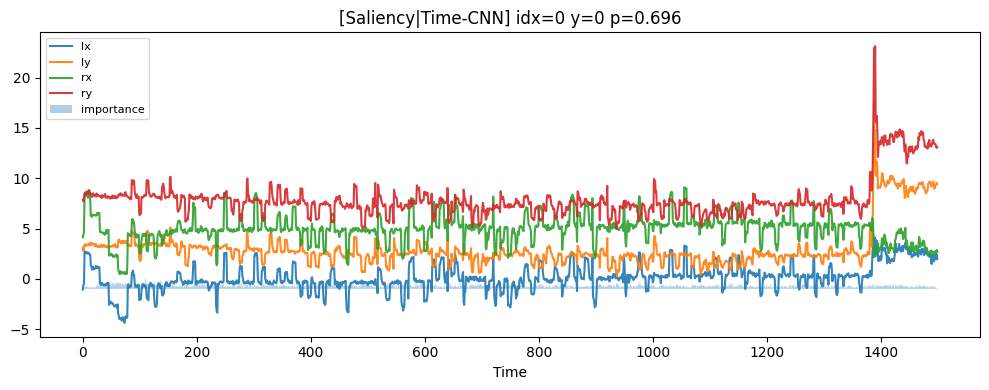

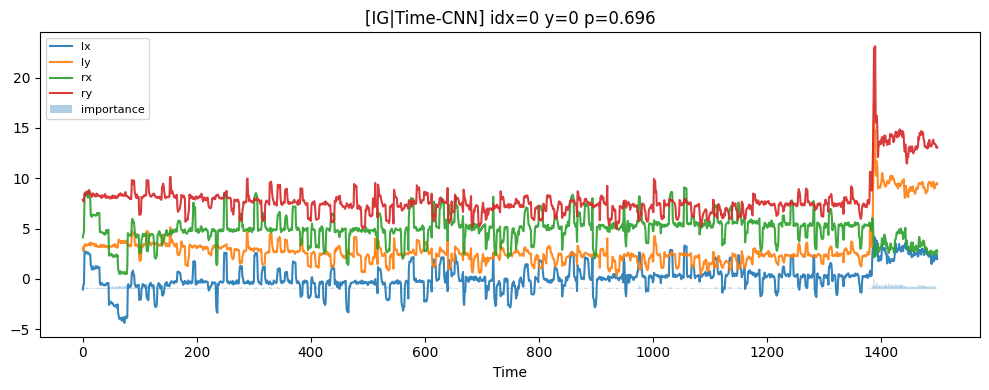

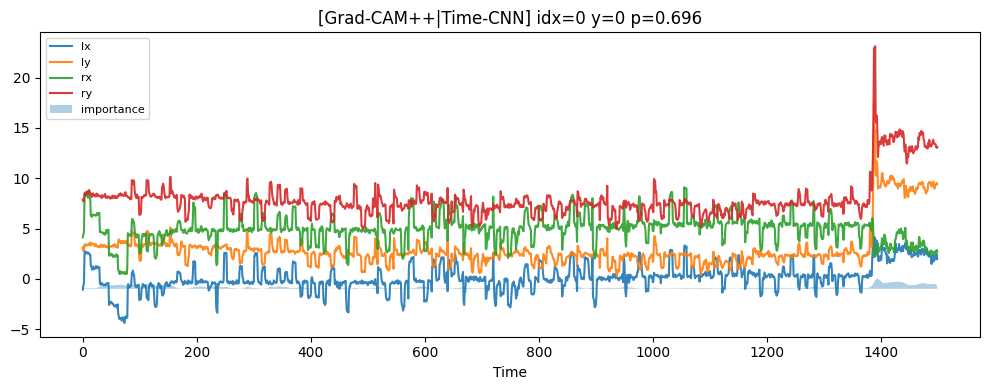

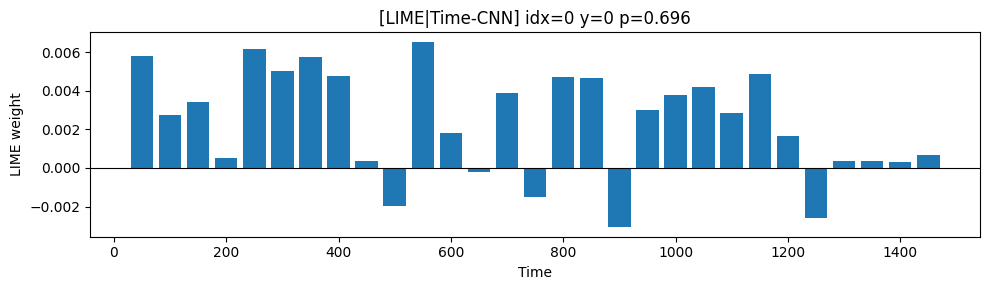

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); trying reshape


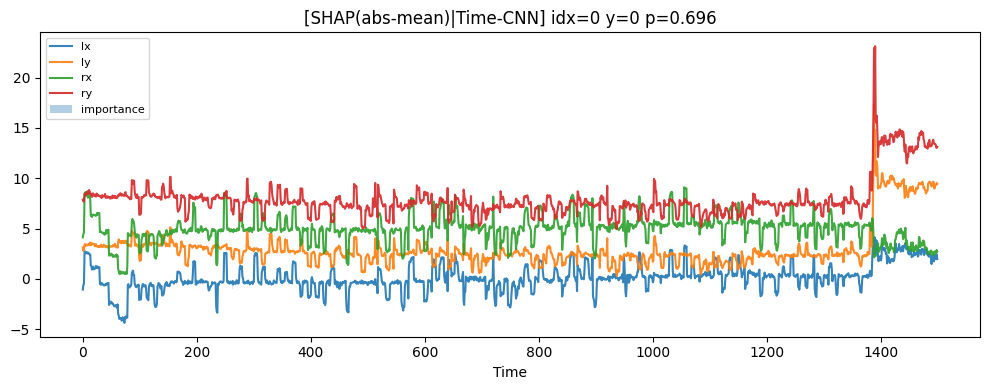

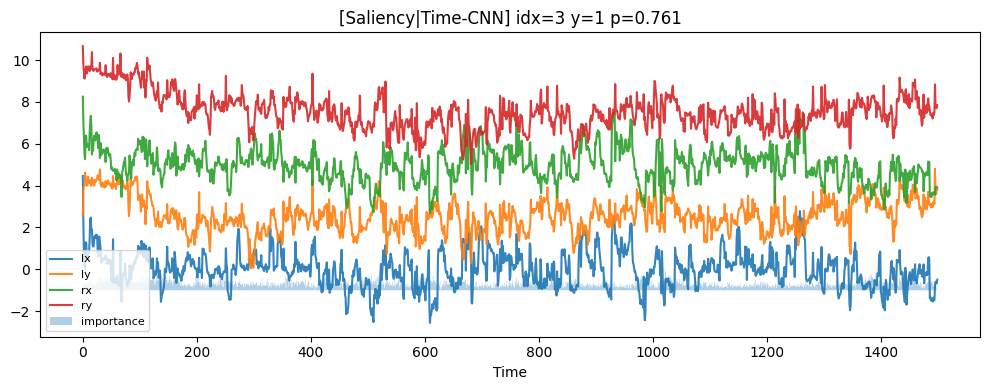

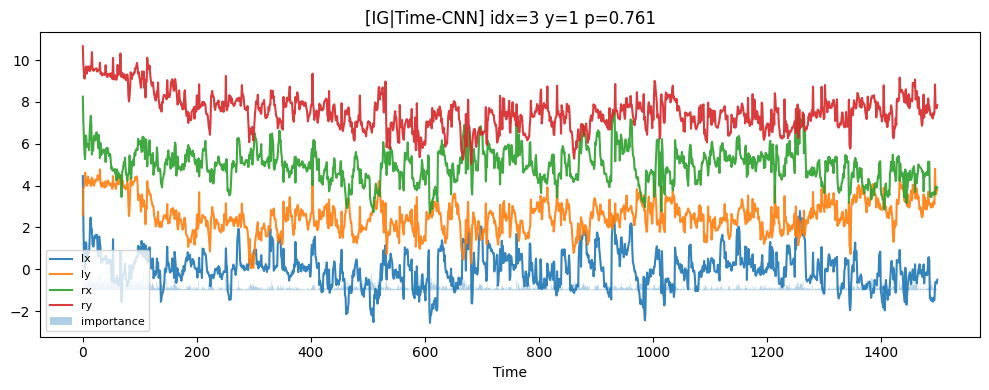

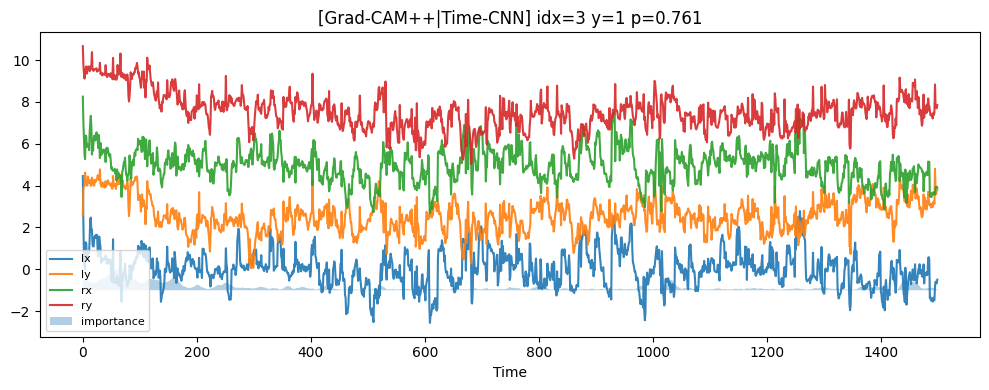

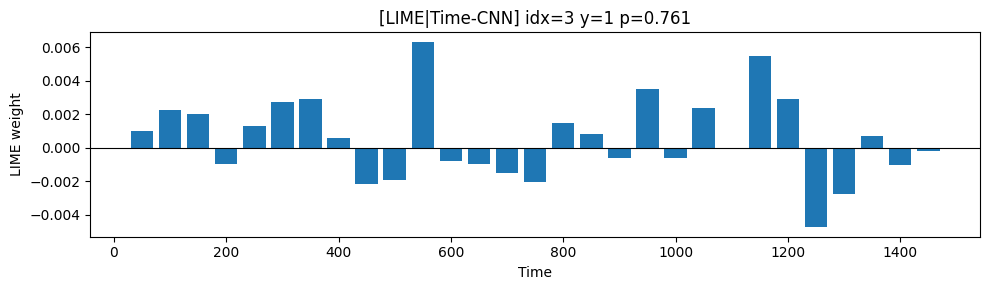

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); trying reshape


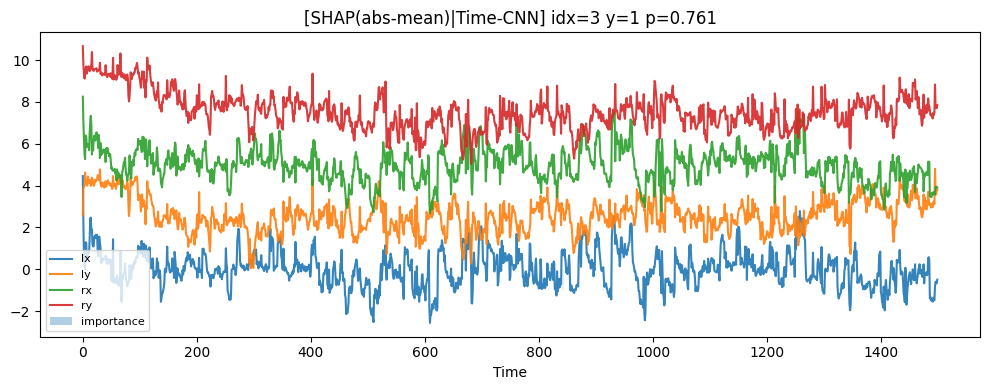

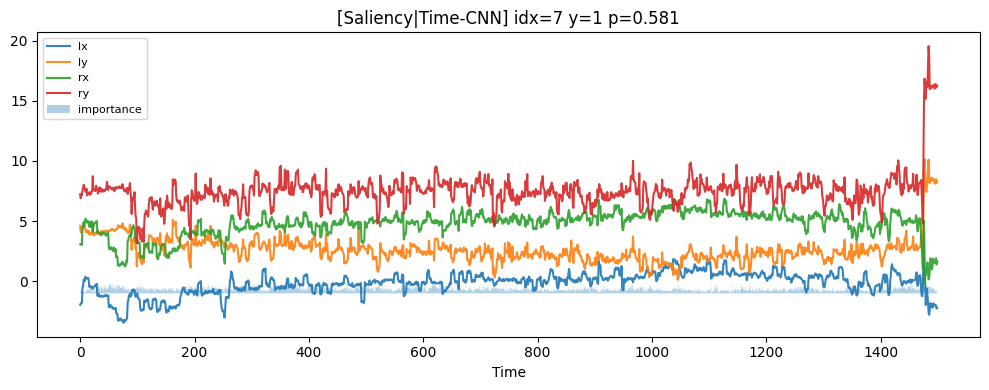

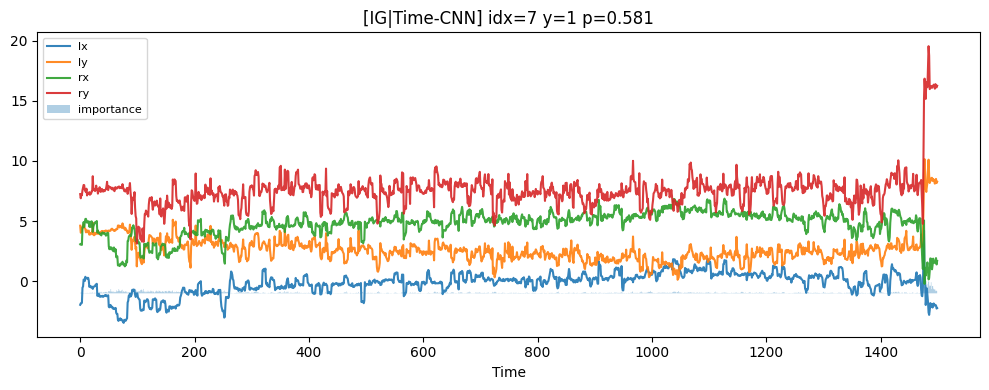

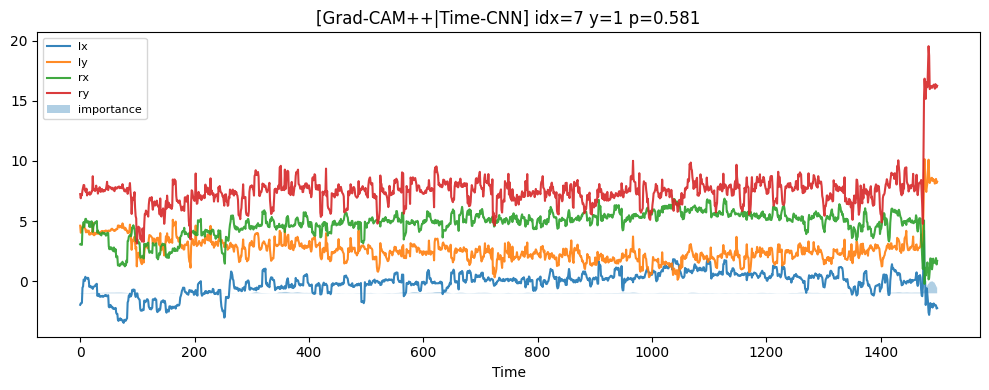

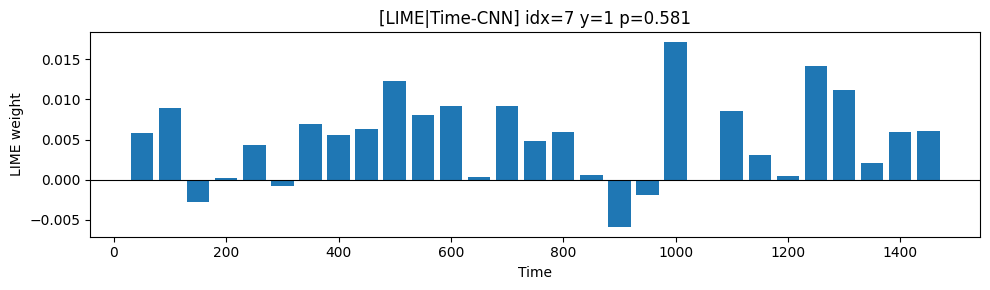

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); trying reshape


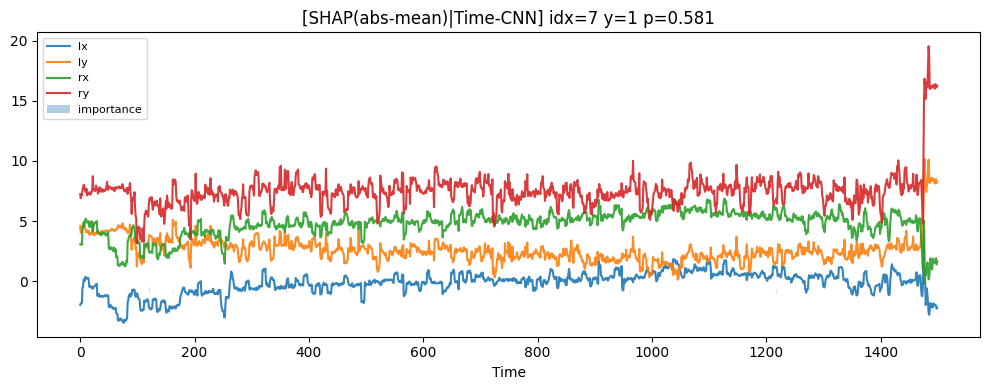

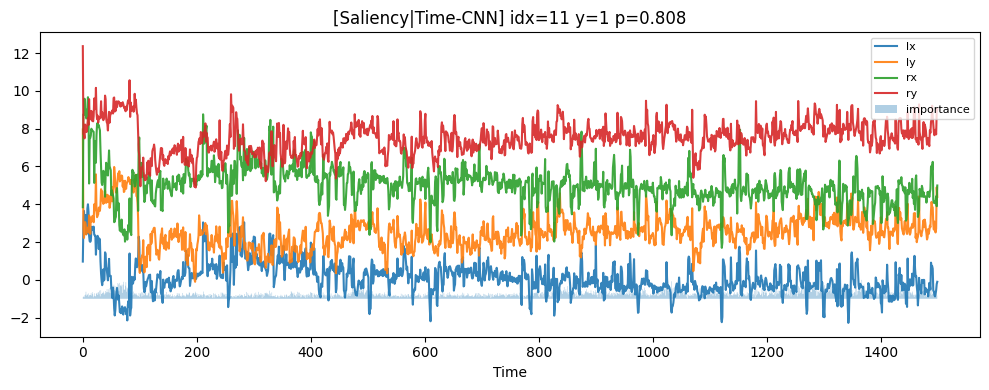

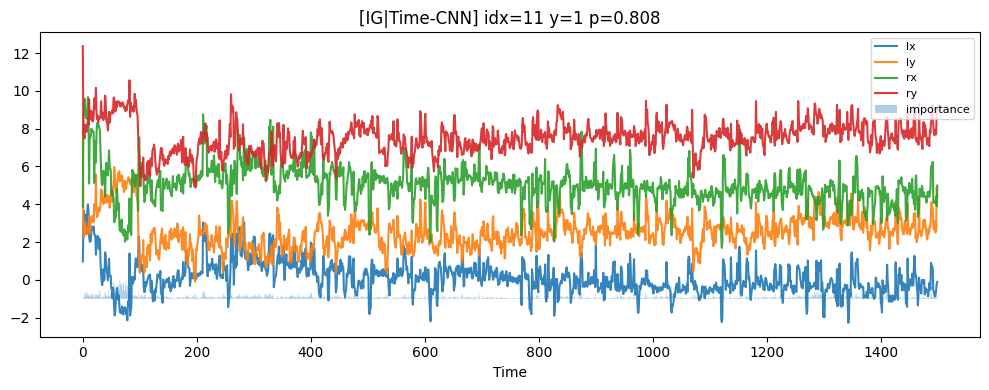

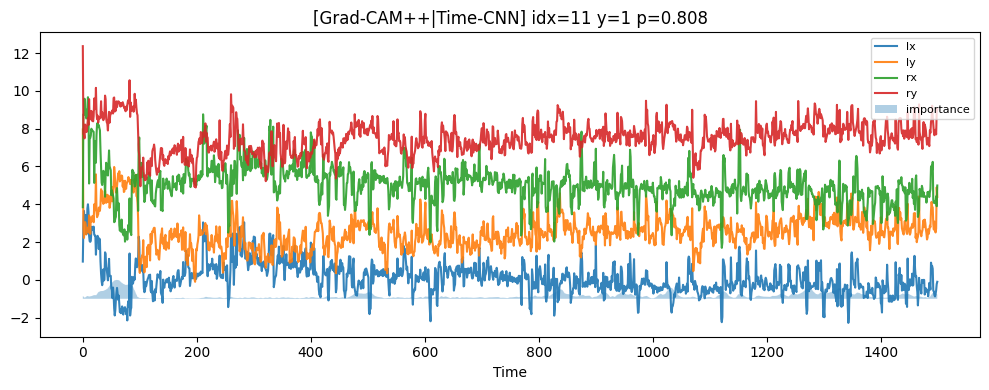

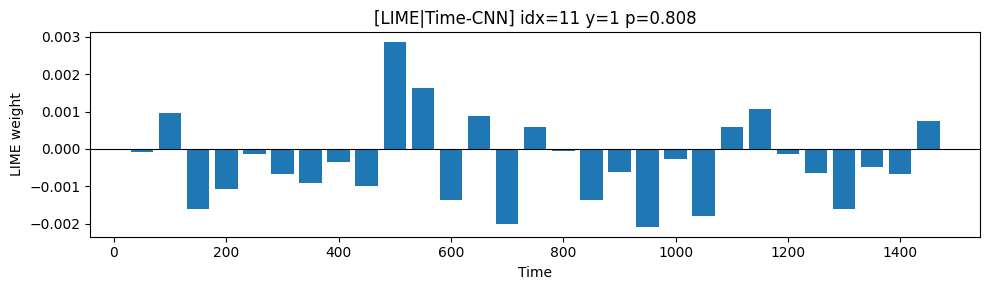

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); trying reshape


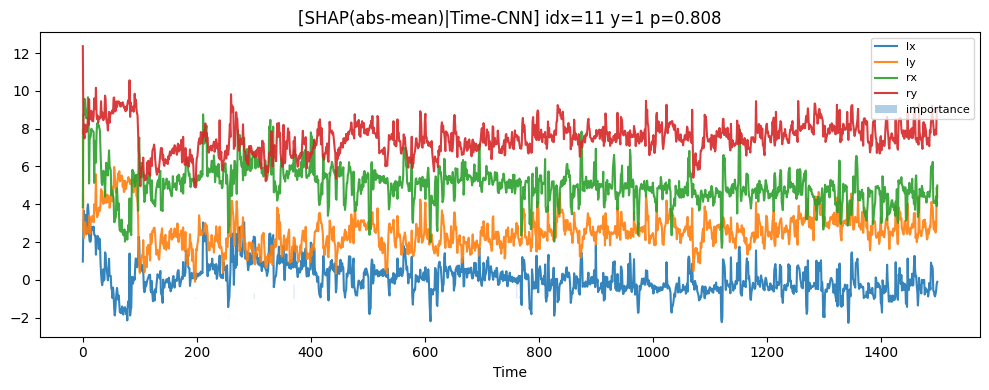

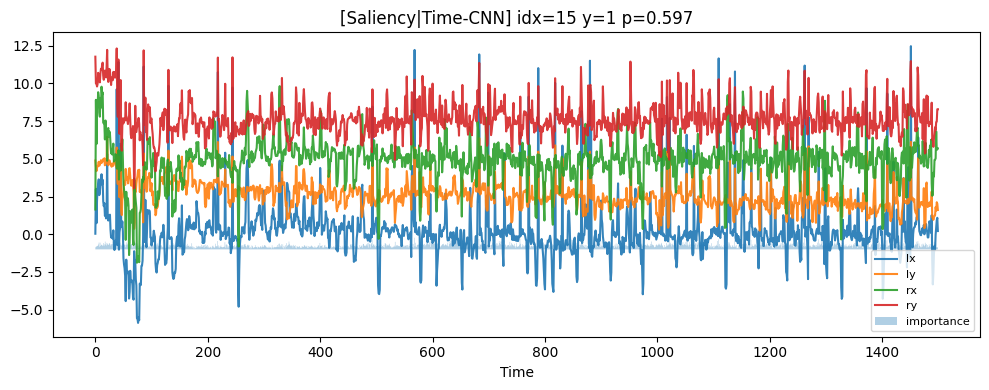

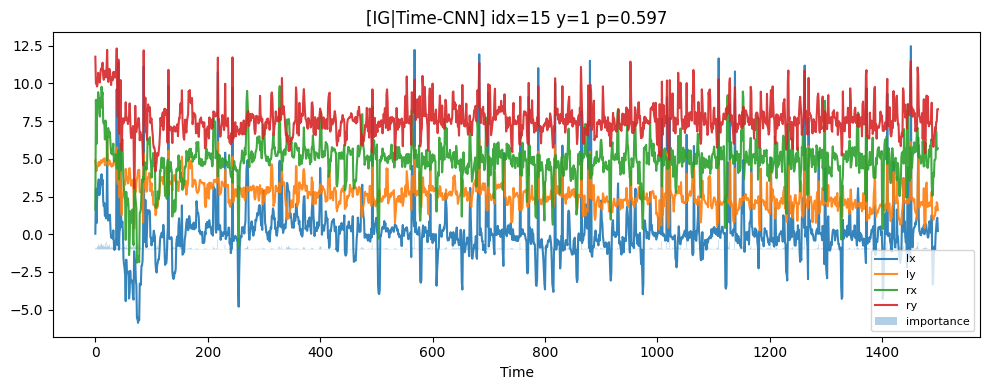

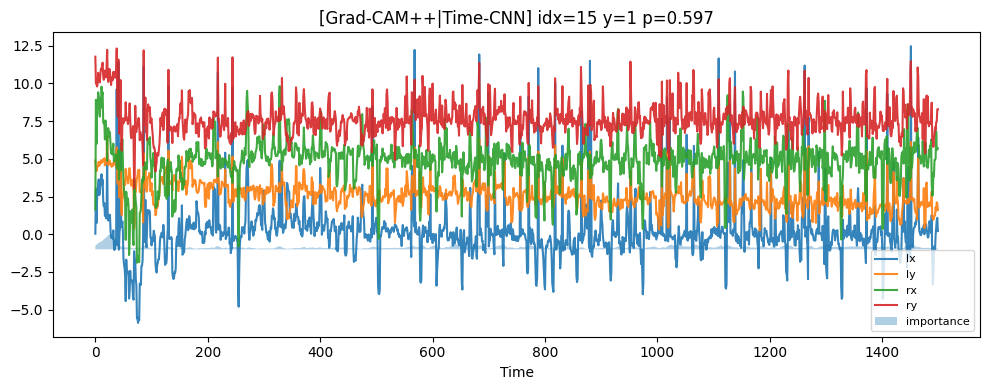

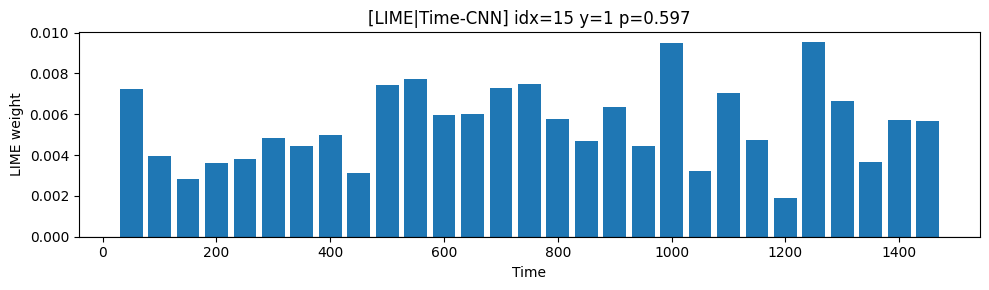

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); trying reshape


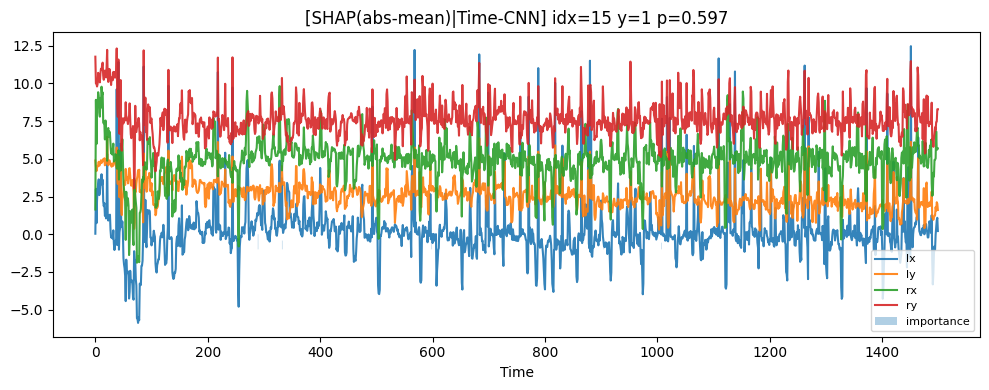

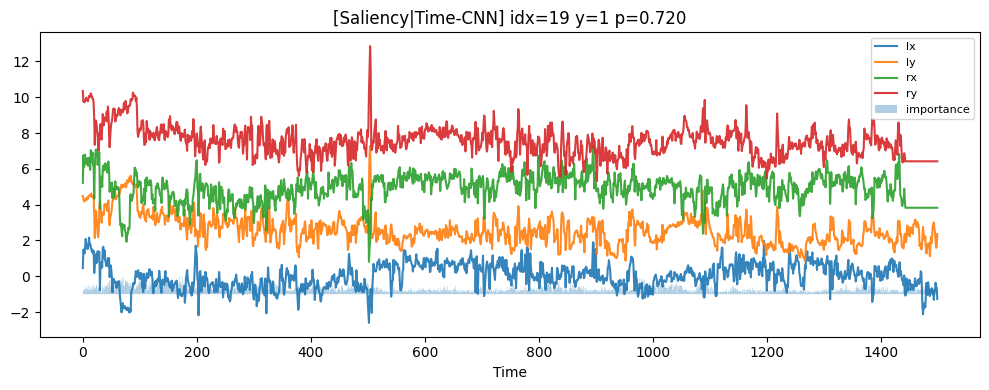

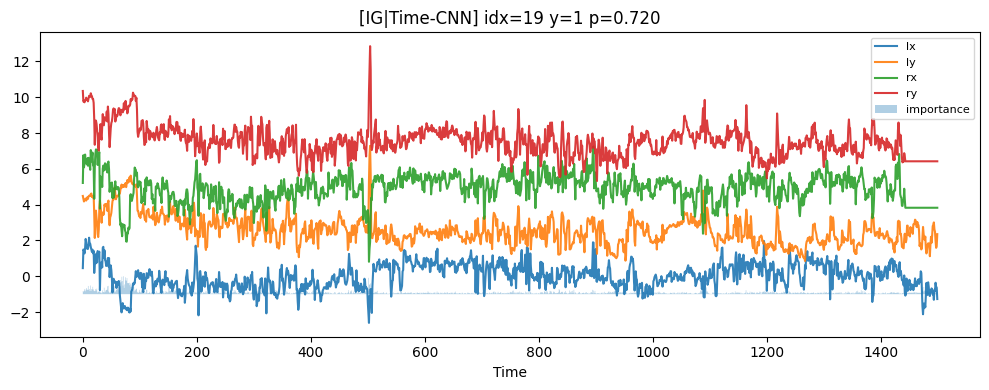

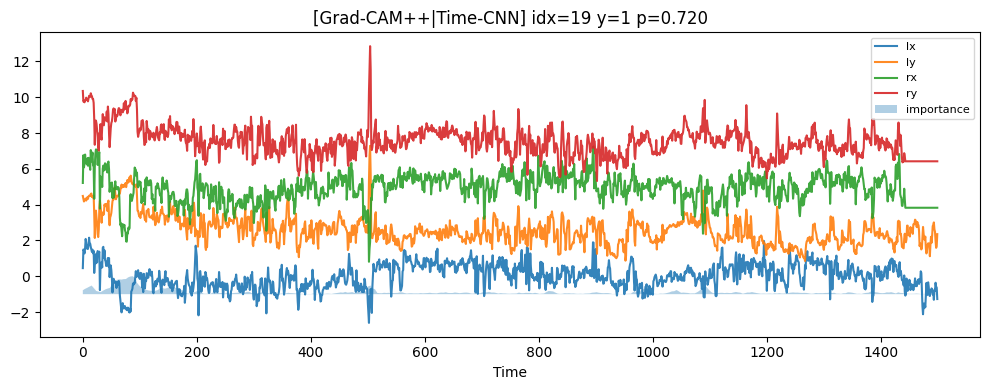

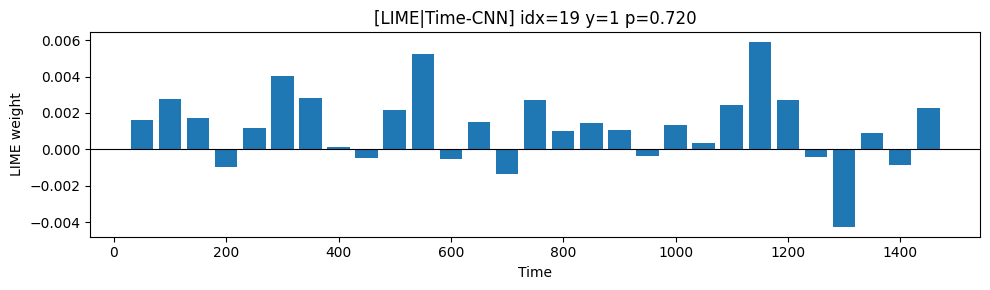

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); trying reshape


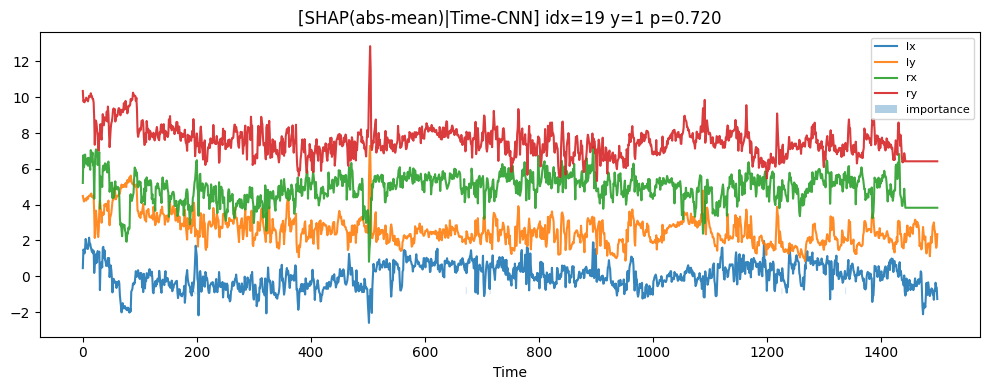

Time-CNN XAI suite finished.


In [26]:
"""
XAI suite for Time-CNN (single-branch Conv1D on 4 channels)
Methods:
  - Saliency (vanilla grads)
  - Integrated Gradients
  - Grad-CAM++ (auto-pick last Conv1D if not provided)
  - LIME (window perturbation)
  - SHAP (KernelExplainer only for stability)

Notes:
  - Input shape: (T, 4). All time series heatmaps are normalised and interpolated back to length T for easy visualisation and overlay.
  - Grad-CAM++ defaults to the "last Conv1D layer" in the model; can also explicitly pass a layer name.
"""

import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from typing import Optional, Tuple, Dict, List
from tensorflow.keras import Model, layers

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Training a Time-CNN for XAI
def train_timecnn_for_xai(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15
):
    X, y, files = load_pair_experiment(
        csv_dir, label_pair,
        resample_len=target_len, max_nan_ratio=0.05,
        divide_by_960=True, use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    model = build_1dcnn_model((target_len, 4))
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])
    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    class_weight = compute_class_weight(ytr)
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1,
              callbacks=cbs, class_weight=class_weight)
    return model, (Xtr,ytr,Xva,yva,Xte,yte), files, splits

# Saliency
def saliency_timecnn(model: Model, x: np.ndarray) -> np.ndarray:
    """
    Return |dy/dx| of shape (T, C).
    """
    xt = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)
    with tf.GradientTape() as tape:
        tape.watch(xt)
        y = model(xt, training=False)
    g = tape.gradient(y, xt).numpy()[0]  # (T,C)
    return np.abs(g).astype(np.float32)

# Integrated Gradients
def integrated_gradients_timecnn(model: Model, x: np.ndarray, steps: int = 64, baseline: Optional[np.ndarray]=None) -> np.ndarray:
    """
    baseline defaults to zero; returns (T, C).
    """
    if baseline is None:
        baseline = np.zeros_like(x, dtype=np.float32)
    xt = tf.convert_to_tensor(x[None,...], tf.float32)
    bt = tf.convert_to_tensor(baseline[None,...], tf.float32)
    alphas = tf.reshape(tf.linspace(0., 1., steps+1)[1:], (-1,1,1))
    path = bt + alphas * (xt - bt)              # (steps,T,C)
    with tf.GradientTape() as tape:
        tape.watch(path)
        preds = model(path, training=False)
    grads = tape.gradient(preds, path)          # (steps,T,C)
    ig = tf.reduce_mean(grads, axis=0) * (xt - bt)[0]
    return tf.math.abs(ig).numpy().astype(np.float32)

# Grad-CAM++ (1D)
def gradcampp_timecnn(model: Model, x: np.ndarray, conv_layer_name: Optional[str] = None) -> np.ndarray:
    """
    Generate CAM++ for a Conv1D layer and upsample it back to length T, returning (T,).
    """
    # Automatically locate the last Conv1D
    if conv_layer_name is None:
        target_layer = None
        for L in model.layers[::-1]:
            if isinstance(L, layers.Conv1D):
                target_layer = L
                break
        if target_layer is None:
            raise ValueError("No Conv1D layer found for Grad-CAM++ in this model.")
    else:
        target_layer = model.get_layer(conv_layer_name)

    grad_model = tf.keras.Model([model.inputs], [target_layer.output, model.output])

    xt = tf.convert_to_tensor(x[None,...], tf.float32)
    with tf.GradientTape(persistent=True) as t1:
        with tf.GradientTape(persistent=True) as t2:
            conv_out, y = grad_model(xt, training=False)   # conv_out: (1,T',K)
            y_c = y[:, 0]
        g1 = t2.gradient(y_c, conv_out)                    # (1,T',K)
    g2 = t1.gradient(y_c, conv_out)                        # (1,T',K)
    del t1, t2

    conv = conv_out.numpy()[0]   # (T',K)
    g1   = g1.numpy()[0]
    g2   = g2.numpy()[0]

    # Grad-CAM++ weights (stable approximation)
    eps = 1e-8
    alpha_num = g1**2
    alpha_den = 2.0 * g1**2 + conv * g2
    alpha = np.divide(alpha_num, np.maximum(alpha_den, eps))
    weights = (alpha * np.maximum(g1, 0.0)).sum(axis=0)    # (K,)

    cam = np.maximum((conv * weights).sum(axis=1), 0.0)    # (T',)
    if cam.max() > 0: cam = cam / (cam.max() + 1e-8)

    # Upsample back to T
    T = x.shape[0]
    if cam.shape[0] != T:
        src = np.linspace(0, 1, cam.shape[0], dtype=np.float32)
        dst = np.linspace(0, 1, T, dtype=np.float32)
        cam = np.interp(dst, src, cam)
    return cam.astype(np.float32)

# LIME (Sliding Window Perturbation)
def lime_timeseries_explain(model: Model, x: np.ndarray, window=100, stride=50, n_samples=600, fill=0.0, seed=SEED):
    """
    Returns: centers (W,), weights (W,); Windows with weights > 0 are more important for improving predictions.
    """
    T, C = x.shape
    wins = []
    t0 = 0
    while t0 < T:
        t1 = min(t0 + window, T); wins.append((t0, t1))
        if t1 == T: break
        t0 += stride
    W = len(wins)
    y0 = float(model.predict(x[None,...], verbose=0).ravel()[0])
    rng = np.random.default_rng(seed)
    Z = rng.integers(0, 2, size=(n_samples, W), endpoint=True)
    y = np.zeros((n_samples,), dtype=np.float32)
    x_fill = np.full_like(x, fill, dtype=np.float32)
    for i in range(n_samples):
        xi = x.copy()
        for j, flag in enumerate(Z[i]):
            if flag == 1:
                a,b = wins[j]; xi[a:b,:] = x_fill[a:b,:]
        y[i] = float(model.predict(xi[None,...], verbose=0).ravel()[0])
    lam = 1e-3
    A = Z.astype(np.float32); b = (y - y0).astype(np.float32)
    beta = np.linalg.solve(A.T @ A + lam*np.eye(W, dtype=np.float32), A.T @ b)
    centers = np.array([(a+b)//2 for (a,b) in wins], dtype=int)
    return centers, beta

# SHAP (KernelExplainer, more stable)
def shap_explain_kernel_timecnn(model: Model, X_background: np.ndarray, X_samples: np.ndarray,
                                max_bg: int = 64, nsamples: int = 200):
    try:
        import shap
    except ImportError:
        print("[WARN] shap not installed; skip SHAP.")
        return None

    if X_samples.ndim == 2:
        X_samples = X_samples[None, ...]
    assert X_samples.ndim == 3 and X_background.ndim == 3, "expect (n,T,C)"

    Xbg = X_background[:max_bg].astype(np.float32, copy=False)
    Xsm = X_samples.astype(np.float32, copy=False)
    n, T, C = Xsm.shape

    bg2 = Xbg.reshape((Xbg.shape[0], T*C))
    X2  = Xsm.reshape((n, T*C))

    def f_2d(Z2):
        Z3 = np.asarray(Z2, dtype=np.float32).reshape((-1, T, C))
        y  = model.predict(Z3, verbose=0).reshape(-1, 1)
        return y

    explainer = shap.KernelExplainer(f_2d, bg2)
    sv = explainer.shap_values(X2, nsamples=nsamples)
    if isinstance(sv, list): sv = sv[0]

    sv = np.asarray(sv)
    if sv.ndim == 1 and sv.size == T*C:
        sv = sv.reshape(1, T, C)
    elif sv.ndim == 2 and sv.shape[1] == T*C:
        sv = sv.reshape(sv.shape[0], T, C)
    elif sv.ndim == 3 and sv.shape[1:] == (T, C):
        pass
    else:
        print(f"[WARN] Unexpected SHAP shape: {sv.shape}; trying reshape")
        sv = sv.reshape(-1, T, C)

    return sv.astype(np.float32, copy=False)

# Visualisation
def plot_timeseries_with_heat(x: np.ndarray, heat_1d: np.ndarray, title: str, ch_names=('lx','ly','rx','ry')):
    T, C = x.shape
    h = np.asarray(heat_1d).squeeze()

    # Insurance treatment: Project various shapes into 1D of length T
    if h.ndim == 2 and h.shape[0] == T:
        h = np.abs(h).mean(axis=1)
    if h.size == T*C:
        h = np.abs(h.reshape(T, C)).mean(axis=1)
    elif h.size != T:
        src = np.linspace(0, 1, h.size)
        dst = np.linspace(0, 1, T)
        h = np.interp(dst, src, h)

    plt.figure(figsize=(10,4))
    shift = 0.0
    for c in range(C):
        plt.plot(x[:,c] + shift, alpha=0.9, label=ch_names[c] if c<len(ch_names) else f'ch{c}')
        shift += 2.5
    h_norm = h / (h.max() + 1e-8)
    plt.fill_between(np.arange(T), -1.0, -1.0 + h_norm, alpha=0.35, step='pre', label='importance')
    plt.title(title); plt.xlabel("Time"); plt.legend(fontsize=8); plt.tight_layout(); plt.show()

def plot_bar_over_windows(centers: np.ndarray, weights: np.ndarray, title: str):
    plt.figure(figsize=(10,3))
    w = max(1, int(0.8*(centers[1]-centers[0]))) if len(centers)>1 else 5
    plt.bar(centers, weights, width=w); plt.axhline(0, color='k', lw=0.8)
    plt.title(title); plt.xlabel("Time"); plt.ylabel("LIME weight"); plt.tight_layout(); plt.show()

# One-click entry
def run_xai_suite_timecnn(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    sample_source: str = 'val',     # 'val' or 'test'
    n_samples: int = 6,
    gradcam_target: Optional[str] = None,   # Specify the name of the last convolutional layer; None = automatically find the last Conv1D
    enable_shap: bool = True,
    shap_bg_max: int = 64,
    shap_nsamples: int = 200
):
    # 1) Training the model
    model, (Xtr,ytr,Xva,yva,Xte,yte), files, splits = train_timecnn_for_xai(
        csv_dir, label_pair, target_len=target_len
    )
    Xs, ys = (Xva, yva) if sample_source == 'val' else (Xte, yte)
    idxs = np.linspace(0, len(ys)-1, num=min(n_samples, len(ys)), dtype=int)

    # 2) SHAP background
    Xbg = Xtr[: min(shap_bg_max, len(Xtr))]

    for i in idxs:
        x = Xs[i]; y_true = int(ys[i])
        y_pred = float(model.predict(x[None,...], verbose=0).ravel()[0])

        # (a) Saliency
        sal = saliency_timecnn(model, x)                 # (T,C)
        plot_timeseries_with_heat(x, sal, title=f"[Saliency|Time-CNN] idx={i} y={y_true} p={y_pred:.3f}")

        # (b) IG
        ig = integrated_gradients_timecnn(model, x, steps=64)
        plot_timeseries_with_heat(x, ig, title=f"[IG|Time-CNN] idx={i} y={y_true} p={y_pred:.3f}")

        # (c) Grad-CAM++
        cam = gradcampp_timecnn(model, x, conv_layer_name=gradcam_target)
        plot_timeseries_with_heat(x, cam, title=f"[Grad-CAM++|Time-CNN] idx={i} y={y_true} p={y_pred:.3f}")

        # (d) LIME (window)
        centers, beta = lime_timeseries_explain(model, x, window=100, stride=50, n_samples=600, fill=0.0)
        plot_bar_over_windows(centers, beta, title=f"[LIME|Time-CNN] idx={i} y={y_true} p={y_pred:.3f}")

        # (e) SHAP (kernel-only)
        if enable_shap:
            sv = shap_explain_kernel_timecnn(model, Xbg, x[None, ...], max_bg=shap_bg_max, nsamples=shap_nsamples)
            if sv is not None:
                sv_t = np.abs(sv[0]).mean(axis=1)  # Average the channels and push them to 1D
                plot_timeseries_with_heat(x, sv_t, title=f"[SHAP(abs-mean)|Time-CNN] idx={i} y={y_true} p={y_pred:.3f}")

    print("Time-CNN XAI suite finished.")


# Run
if __name__ == "__main__":
    DATA_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"  # or repeats
    PAIR = (0, 2)

    # If want to explicitly specify the target convolutional layer name for Grad-CAM++ (e.g., 'conv3'), change gradcam_target to the layer name;
    # Otherwise, set it to None to automatically search for the "last Conv1D" in the model.
    run_xai_suite_timecnn(
        csv_dir=DATA_DIR,
        label_pair=PAIR,
        target_len=1500,
        sample_source='val',
        n_samples=6,
        gradcam_target=None,
        enable_shap=True,
        shap_bg_max=64,
        shap_nsamples=200
    )


feature construction for time-cnn

In [39]:
"""
Feature Construction for Time-CNN:
- augment_dynamic_channels: (N,T,4) -> (N,T,13)
- compute_global_stats_raw: per-channel mean/std/range -> (N, 3*C_aug)
- StandardScaler for fitting statistical features to the training set, applied to val/test
- cnn_hybrid: early fusion of a temporal CNN branch and a global statistics MLP branch
- run_experiment_with_features: end-to-end training/testing (same split/training strategy as the baseline)
"""

import time
import numpy as np
from typing import Tuple, Optional
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report

# Feature construction (time-series + global stats)

def _moving_average(x: np.ndarray, k: int = 5) -> np.ndarray:
    """Simple sliding average, with boundaries replicated using padding."""
    if k <= 1:
        return x
    pad = k // 2
    xp = np.pad(x, (pad, pad), mode='edge')
    kernel = np.ones(k, dtype=np.float32) / float(k)
    return np.convolve(xp, kernel, mode='valid')

def _diff(x: np.ndarray) -> np.ndarray:
    """The next item - the previous item, with x[0] added to the first digit to maintain the length."""
    return np.diff(x, prepend=x[:1])

def augment_dynamic_channels(X: np.ndarray, smooth_k: int = 5) -> np.ndarray:
    """
    Input X: (N, T, 4) [abs_lx, abs_ly, abs_rx, abs_ry] (resampled and robustly scaled)
    Output X_aug: (N, T, 13)
      4 raw: lx, ly, rx, ry
      2 vel: vel_L, vel_R (speed modulus of each eye)
      4 sp: first-order difference after smoothing each channel (speed)
      3 L/R: |lx-rx|, |ly-ry|, sqrt((lx-rx)^2 + (ly-ry)^2)
    """
    N, T, C = X.shape
    assert C == 4, "expect 4 channels: [abs_lx, abs_ly, abs_rx, abs_ry]"
    out = []
    for i in range(N):
        seq = X[i]
        lx, ly, rx, ry = seq[:,0], seq[:,1], seq[:,2], seq[:,3]

        # velocity magnitude per eye
        dlx, dly = _diff(lx), _diff(ly)
        drx, dry = _diff(rx), _diff(ry)
        vel_L = np.sqrt(dlx**2 + dly**2)
        vel_R = np.sqrt(drx**2 + dry**2)

        # speed per channel (diff of smoothed)
        slx = _moving_average(lx, smooth_k)
        sly = _moving_average(ly, smooth_k)
        srx = _moving_average(rx, smooth_k)
        sry = _moving_average(ry, smooth_k)
        sp_lx, sp_ly, sp_rx, sp_ry = _diff(slx), _diff(sly), _diff(srx), _diff(sry)

        # L/R differences
        d_x  = np.abs(lx - rx)
        d_y  = np.abs(ly - ry)
        dmag = np.sqrt(d_x**2 + d_y**2)

        x_aug = np.stack(
            [lx, ly, rx, ry, vel_L, vel_R, sp_lx, sp_ly, sp_rx, sp_ry, d_x, d_y, dmag],
            axis=1
        )
        out.append(x_aug.astype(np.float32))
    return np.asarray(out, dtype=np.float32)

def compute_global_stats_raw(X_aug: np.ndarray) -> np.ndarray:
    """
    Compute the mean/std/range for each channel and return the "unnormalized" feature matrix (N, 3*C_aug).
    Normalisation should be performed externally using StandardScaler on the training set to avoid information leakage.
    """
    means = X_aug.mean(axis=1)                         # (N, C_aug)
    stds  = X_aug.std(axis=1)                          # (N, C_aug)
    rngs  = (X_aug.max(axis=1) - X_aug.min(axis=1))    # (N, C_aug)
    F = np.concatenate([means, stds, rngs], axis=1)    # (N, 3*C_aug)
    return F.astype(np.float32)

# Hybrid head on top of CNN (fusion with global stats)

def build_1dcnn_backbone(input_shape):
    """CNN backbone equivalent to the baseline (excluding the final classification head); output GAP features."""
    inp = Input(shape=input_shape)
    x = layers.Conv1D(64, 7, padding='same', activation='relu', name='conv1')(inp)
    x = layers.BatchNormalization(name='bn1')(x)
    x = layers.MaxPooling1D(2, name='pool1')(x)

    x = layers.Conv1D(128, 5, padding='same', activation='relu', name='conv2')(x)
    x = layers.BatchNormalization(name='bn2')(x)
    x = layers.MaxPooling1D(2, name='pool2')(x)

    x = layers.Conv1D(128, 3, padding='same', activation='relu', name='conv3')(x)
    x = layers.GlobalAveragePooling1D(name='gap')(x)
    return Model(inp, x, name='cnn_backbone')

def build_cnn_hybrid_model(ts_input_shape, n_stats: int, dropout=0.5) -> Model:
    """
    Input 1: Augmented time series (T, C_aug) -> CNN -> GAP
    Input 2: Global statistics (n_stats,) -> Small MLP
    Fusion: Concat -> Dense -> Dropout -> Sigmoid
    """
    backbone = build_1dcnn_backbone(ts_input_shape)
    ts_inp, ts_feat = backbone.input, backbone.output

    st_inp = Input(shape=(n_stats,), name='stat_in')
    s = layers.Dense(64, activation='relu', name='stat_fc1')(st_inp)
    s = layers.Dropout(dropout, name='stat_drop')(s)

    z = layers.Concatenate(name='fusion')([ts_feat, s])
    z = layers.Dense(64, activation='relu', name='fc')(z)
    z = layers.Dropout(dropout, name='drop')(z)
    out = layers.Dense(1, activation='sigmoid', name='logit')(z)
    return Model([ts_inp, st_inp], out, name='cnn_hybrid')

# Runner with feature construction (drop-in)

def run_experiment_with_features(
    csv_dir: str,
    label_pair: Tuple[int, int],
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    smooth_k: int = 5
):
    """
    Dependencies are already defined:
      - load_pair_experiment
      - split_by_participant_train_val_test
      - get_optimizer
      - compute_class_weight
    """
    # 1) Loading and partitioning (same as baseline)
    X, y, files = load_pair_experiment(
        csv_dir, label_pair, resample_len=target_len,
        max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=42
    )

    # 2) Construct Enhancement Channel + Original Statistics
    Xtr_aug = augment_dynamic_channels(Xtr, smooth_k=smooth_k)
    Xva_aug = augment_dynamic_channels(Xva, smooth_k=smooth_k)
    Xte_aug = augment_dynamic_channels(Xte, smooth_k=smooth_k)

    Ftr_raw = compute_global_stats_raw(Xtr_aug)
    Fva_raw = compute_global_stats_raw(Xva_aug)
    Fte_raw = compute_global_stats_raw(Xte_aug)

    # 3) Fit the scaler using only the training set and apply it to val/test (to prevent information leakage)
    stat_scaler = StandardScaler()
    Ftr = stat_scaler.fit_transform(Ftr_raw)
    Fva = stat_scaler.transform(Fva_raw)
    Fte = stat_scaler.transform(Fte_raw)

    # 4) Model
    model = build_cnn_hybrid_model(
        ts_input_shape=(target_len, Xtr_aug.shape[-1]),
        n_stats=Ftr.shape[1], dropout=0.5
    )
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])

    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
        tf.keras.callbacks.CSVLogger(f'train_log_feat_{label_pair[0]}_{label_pair[1]}.csv', append=False)
    ]
    class_weight = compute_class_weight(ytr)

    # 5) Train
    t0 = time.perf_counter()
    history = model.fit(
        [Xtr_aug, Ftr], ytr,
        validation_data=([Xva_aug, Fva], yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=1,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()
    print(f"[Time] Pair {label_pair} (+features): training wall-clock {t1 - t0:.2f}s")

    # 6) Test
    yprob = model.predict([Xte_aug, Fte], batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)

    from sklearn.metrics import classification_report
    report = classification_report(yte, ypred, digits=4)
    print(f"\n[TEST] Pair {label_pair} (+features) classification report:\n{report}")

    return {
        'label_pair': label_pair,
        'history': history.history,
        'test_report': report,
        'model': model,
        'id_splits': id_splits,
        'C_aug': Xtr_aug.shape[-1]
    }


In [40]:
CSV_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
for PAIR in [(0,2), (1,3)]:
    print(f"\n=== Pair {PAIR} (+features) ===")
    res = run_experiment_with_features(CSV_DIR, PAIR, target_len=1500, smooth_k=5)
    print(res['test_report'])

TLEN    = 1500

res = run_experiment_with_features(
    csv_dir=CSV_DIR,
    label_pair=PAIR,
    target_len=TLEN,
    batch_size=16,
    max_epochs=80,
    lr=3e-4,
    early_patience=15,
    smooth_k=5
)

# Key results:
print(res['test_report'])          # sklearn's classification_report (test set)
print("C_aug =", res['C_aug'])     # Number of channels after enhancement (should be 13)
print("Split IDs:", res['id_splits'])



=== Pair (0, 2) (+features) ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
Epoch 1/80
4/4 [==============================] - 1s 76ms/step - loss: 0.7880 - accuracy: 0.5000 - val_loss: 0.7518 - val_accuracy: 0.4000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 0s 34ms/step - loss: 0.6656 - accuracy: 0.5556 - val_loss: 0.7462 - val_accuracy: 0.4500 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 0s 33ms/step - loss: 0.6905 - accuracy: 0.6296 - val_loss: 0.7386 - val_accuracy: 0.4500 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 0s 38ms/step - loss: 0.5785 - accuracy: 0.6481 - val_loss: 0.7360 - val_accuracy: 0.4500 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 0s 40ms/step - loss: 0.6874 - accuracy: 0.5556 - val_loss: 0.7347 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 0s 37ms/step - loss: 0.5692 - accuracy: 0.7222 - val

4/4 [==============================] - 0s 36ms/step - loss: 0.1652 - accuracy: 0.9636 - val_loss: 0.6283 - val_accuracy: 0.6500 - lr: 1.5000e-04
Epoch 67/80
4/4 [==============================] - 0s 33ms/step - loss: 0.1312 - accuracy: 0.9818 - val_loss: 0.6276 - val_accuracy: 0.6500 - lr: 1.5000e-04
Epoch 68/80
4/4 [==============================] - 0s 32ms/step - loss: 0.1080 - accuracy: 0.9818 - val_loss: 0.6258 - val_accuracy: 0.6500 - lr: 1.5000e-04
Epoch 69/80
4/4 [==============================] - 0s 32ms/step - loss: 0.1038 - accuracy: 1.0000 - val_loss: 0.6252 - val_accuracy: 0.6500 - lr: 1.5000e-04
Epoch 70/80
4/4 [==============================] - 0s 35ms/step - loss: 0.1418 - accuracy: 0.9818 - val_loss: 0.6205 - val_accuracy: 0.7000 - lr: 1.5000e-04
Epoch 71/80
4/4 [==============================] - 0s 37ms/step - loss: 0.0864 - accuracy: 0.9818 - val_loss: 0.6147 - val_accuracy: 0.7000 - lr: 1.5000e-04
Epoch 72/80
4/4 [==============================] - 0s 38ms/step - loss

Feature Importance in Non/Antisaccadic Areas for time-cnn

In [41]:
"""
Feature Importance in Non/Saccadic (Antisaccadic) Areas for time-CNN
- Adapting single-input CNN (T, 4) and dual-input Hybrid CNN ([T, C_aug], [n_stats])
- XAI: Saliency, Integrated Gradients, Grad-CAM++
- Statistics: "Proportion/mean of importance falling within the saccade region" for each trial,
       Then do the MW-U significance test + box plot according to the label
"""

import numpy as np, tensorflow as tf, matplotlib.pyplot as plt
from typing import Dict, Tuple, List, Optional, Callable, Union
from tensorflow.keras import Model, layers

SEED = 42
np.random.seed(SEED); tf.random.set_seed(SEED)

# 0) Glance detection (simple speed threshold + minimum frame count)
def detect_saccades_mask(x_raw4: np.ndarray, vel_thr: float = 0.8, min_frames: int = 8) -> np.ndarray:
    """
    x_raw4: (T,4) -> [lx, ly, rx, ry] (Same preprocessing as training: resampling, /960, robust scaling)
    Thresholding based on the average of left and right eye velocities; segments shorter than a minimum length are discarded.
    Returns a bool mask shape = (T,)
    """
    assert x_raw4.ndim == 2 and x_raw4.shape[1] >= 4
    lx, ly, rx, ry = x_raw4[:,0], x_raw4[:,1], x_raw4[:,2], x_raw4[:,3]
    vl = np.sqrt(np.diff(lx, prepend=lx[:1])**2 + np.diff(ly, prepend=ly[:1])**2)
    vr = np.sqrt(np.diff(rx, prepend=rx[:1])**2 + np.diff(ry, prepend=ry[:1])**2)
    v  = 0.5*(vl+vr)
    mask = v > vel_thr

    # Connect/remove short fragments
    m = mask.astype(np.int32)
    # Clean up 1 segment smaller than min_frames
    i = 0
    while i < len(m):
        if m[i] == 1:
            j = i
            while j < len(m) and m[j] == 1: j += 1
            if (j - i) < min_frames:
                m[i:j] = 0
            i = j
        else:
            i += 1
    return (m == 1)

# 1) Auxiliary: Identify model type (plain/hybrid) + construct forward input
def infer_time_input_spec(model: Model):
    """
    Determine model input:
    - Single input: (T,C) -> Return kind='plain'
    - Dual input: [(T,C_aug), (n_stats,)] -> Return kind='hybrid'
    """
    ins = model.inputs
    if not isinstance(ins, list):
        ins = [ins]
    if len(ins) == 1:
        return dict(kind='plain')
    elif len(ins) == 2:
        # Assume that time input is rank=3 and stats is rank=2
        shapes = [tuple(i.shape) for i in ins]
        rks = [len(s) for s in shapes]
        if (3 in rks) and (2 in rks):
            return dict(kind='hybrid')
    raise ValueError("Unrecognized model input signature; expected plain (1 input) or hybrid (2 inputs).")

def make_forward_inputs(model: Model, x_time: np.ndarray, x_stats: Optional[np.ndarray]=None):
    """Spell out the correct forward input tensor according to the model type"""
    spec = infer_time_input_spec(model)
    if spec['kind'] == 'plain':
        return [tf.convert_to_tensor(x_time[None,...], tf.float32)]
    else:
        assert x_stats is not None and x_stats.shape[0] == x_time.shape[0]  # (1,n_stats) vs (T,C)
        return [tf.convert_to_tensor(x_time[None,...], tf.float32),
                tf.convert_to_tensor(x_stats, tf.float32)]

# 2) XAI: Saliency / Integrated Gradients / Grad-CAM++
def timecnn_saliency(model: Model,
                     x_time: np.ndarray,                       # (T,C_time)
                     x_stats: Optional[np.ndarray]=None        # (1,n_stats) only for hybrid
                    ) -> np.ndarray:
    """
    Returns the one-dimensional importance of length T (mean over channel |gradient|)
    """
    xt = tf.convert_to_tensor(x_time[None,...], tf.float32)   # (1,T,C)
    if infer_time_input_spec(model)['kind'] == 'plain':
        inputs = [xt]
        watch_tensors = [xt]
    else:
        st = tf.convert_to_tensor(x_stats, tf.float32)        # (1,n_stats)
        inputs = [xt, st]
        watch_tensors = [xt]                                   # Only calculate the gradient of the sequential branch

    with tf.GradientTape() as tape:
        for t in watch_tensors: tape.watch(t)
        y = model(inputs, training=False)                      # (1,1)
    g = tape.gradient(y, xt).numpy()[0]                        # (T,C)
    g = np.abs(g)
    h = g.mean(axis=1)                                         # (T,)
    h = np.maximum(h, 0)
    h = h / (h.sum() + 1e-8)
    return h.astype(np.float32)

def timecnn_integrated_gradients(model: Model,
                                 x_time: np.ndarray,
                                 x_stats: Optional[np.ndarray]=None,
                                 steps: int = 64,
                                 baseline: Optional[np.ndarray]=None) -> np.ndarray:
    """
    IG only performs path integration on the timing branch, and the stats branch is fixed to x_stats (e.g. hybrid).
    Returns (T,) importance
    """
    if baseline is None:
        baseline = np.zeros_like(x_time, dtype=np.float32)
    alphas = tf.reshape(tf.linspace(1./steps, 1., steps), (-1,1,1))  # (steps,1,1)
    path = (baseline[None,...] + alphas * (x_time[None,...] - baseline[None,...]))  # (steps,T,C)

    xt = tf.convert_to_tensor(path, tf.float32)
    if infer_time_input_spec(model)['kind'] == 'plain':
        inputs = [xt]
        watch = [xt]
    else:
        assert x_stats is not None
        st = tf.convert_to_tensor(np.repeat(x_stats, repeats=steps, axis=0), tf.float32)  # (steps,n_stats)
        inputs = [xt, st]
        watch = [xt]

    with tf.GradientTape() as tape:
        for t in watch: tape.watch(t)
        y = model(inputs, training=False)                       # (steps,1)
    grads = tape.gradient(y, xt).numpy()                        # (steps,T,C)
    ig = grads.mean(axis=0) * (x_time - baseline)               # (T,C)
    h = np.abs(ig).mean(axis=1)                                 # (T,)
    h = h / (h.sum() + 1e-8)
    return h.astype(np.float32)

def _find_last_conv1d(model: Model, fallback_name: Optional[str]=None) -> layers.Layer:
    if fallback_name:
        return model.get_layer(fallback_name)
    for L in model.layers[::-1]:
        if isinstance(L, layers.Conv1D):
            return L
    raise ValueError("No Conv1D layer found; please pass conv_layer_name explicitly.")

def timecnn_gradcampp(model: Model,
                      x_time: np.ndarray,
                      x_stats: Optional[np.ndarray]=None,
                      conv_layer_name: Optional[str]=None) -> np.ndarray:
    """
    Single-branch Grad‑CAM++: Returns a one-dimensional heatmap of length T
    """
    target_layer = _find_last_conv1d(model, conv_layer_name)

    # Assemble the forward input
    inputs = make_forward_inputs(model, x_time, x_stats)

    # Build a graph to take the output of the middle layer
    grad_model = Model(model.inputs, [target_layer.output, model.output])

    with tf.GradientTape(persistent=True) as t1:
        with tf.GradientTape(persistent=True) as t2:
            conv_out, y = grad_model(inputs, training=False)  # conv_out: (1,T',F)
            y_c = y[:, 0]
        g1 = t2.gradient(y_c, conv_out)                       # (1,T',F)
    g2 = t1.gradient(y_c, conv_out)                           # (1,T',F)
    del t2, t1

    conv = conv_out.numpy()[0]                                # (T',F)
    g1   = g1.numpy()[0]                                      # (T',F)
    g2   = g2.numpy()[0]

    # Grad‑CAM++ weights (stable implementation)
    eps = 1e-8
    alpha_num = g1**2
    alpha_den = 2.0*(g1**2) + conv*g2
    alpha = np.divide(alpha_num, np.maximum(alpha_den, eps))
    weights = (alpha * np.maximum(g1, 0.0)).sum(axis=0)       # (F,)

    cam = np.maximum((conv * weights).sum(axis=1), 0.0)       # (T',)

    # Normalise & upsample to input length
    T = x_time.shape[0]
    if cam.max() > 0: cam = cam/(cam.max()+1e-8)
    if cam.shape[0] != T:
        src = np.linspace(0,1,cam.shape[0], dtype=np.float32)
        dst = np.linspace(0,1,T, dtype=np.float32)
        cam = np.interp(dst, src, cam)
    cam = cam.astype(np.float32)
    cam = cam/(cam.sum()+1e-8)
    return cam

# 3) Comparison with the scan mask
def compare_importance_on_saccades(importances_1d: np.ndarray, sacc_mask: np.ndarray) -> Dict[str, float]:
    imp = importances_1d / (importances_1d.sum() + 1e-8)
    sacc_mask = sacc_mask.astype(bool)
    imp_s = imp[sacc_mask]
    imp_n = imp[~sacc_mask]
    return {
        'mean_imp_sacc': float(imp_s.mean()) if imp_s.size else 0.0,
        'mean_imp_non':  float(imp_n.mean()) if imp_n.size else 0.0,
        'frac_imp_on_sacc': float((imp * sacc_mask).sum())
    }

# 4) Single sample evaluation entry
def xai_vs_saccade_for_sample_timecnn(
    model: Model,
    x_raw4: np.ndarray,                        # (T,4) for scan detection
    x_input_time: np.ndarray,                  # (T,C_time) Time input to the model
    x_input_stats: Optional[np.ndarray],       # (1,n_stats) If hybrid, provide; if plain, pass None
    xai: str = "saliency",
    vel_thr: float = 0.8,
    min_frames: int = 8,
    conv_layer_name: Optional[str] = None
) -> Dict[str, float]:

    sacc_mask = detect_saccades_mask(x_raw4, vel_thr=vel_thr, min_frames=min_frames)

    if xai == "saliency":
        h = timecnn_saliency(model, x_input_time, x_input_stats)
    elif xai == "ig":
        h = timecnn_integrated_gradients(model, x_input_time, x_input_stats, steps=64)
    elif xai == "gradcampp":
        h = timecnn_gradcampp(model, x_input_time, x_input_stats, conv_layer_name=conv_layer_name)
    else:
        raise ValueError(f"Unknown xai='{xai}'")

    stats = compare_importance_on_saccades(h, sacc_mask)
    stats.update(dict(xai=xai, vel_thr=vel_thr, min_frames=min_frames))
    return stats

# 5) Dataset-level batch evaluation
def run_xai_saccade_analysis_timecnn(
    model: Model,
    X_raw: np.ndarray,                      # (N,T,4) original 4 channels (preprocessed as training)
    y: np.ndarray,
    # Construct a function for "model input" (preferably consistent with training)
    #   build_time_input: (x_raw4)->(T,C_time)
    #   build_stats_input: (x_raw4)->(1,n_stats)；plain returns None
    build_time_input: Callable[[np.ndarray], np.ndarray],
    build_stats_input: Optional[Callable[[np.ndarray], Optional[np.ndarray]]] = None,
    xai_methods=('saliency','ig','gradcampp'),
    vel_thr: float = 0.8,
    min_frames: int = 8,
    max_n: int = 200,
    conv_layer_name: Optional[str] = None    # Grad‑CAM++ specifies the name of the last convolutional layer (optional, automatically found)
):
    """
    Example：
      - Plain: build_time_input=lambda x: x; build_stats_input=None
      - Hybrid: build_time_input=lambda x: augment_dynamic_channels(x[None,...])[0]
                build_stats_input=lambda x: compute_global_stats(augment_dynamic_channels(x[None,...]))[0:1]
    """
    import random, pandas as pd
    from scipy.stats import mannwhitneyu

    idxs = list(range(len(y)))
    random.Random(42).shuffle(idxs)
    idxs = idxs[:min(max_n, len(idxs))]

    rows = []
    for xai in xai_methods:
        for i in idxs:
            x_time = build_time_input(X_raw[i])                       # (T,C_time)
            x_stats = build_stats_input(X_raw[i]) if build_stats_input is not None else None
            stats = xai_vs_saccade_for_sample_timecnn(
                model, X_raw[i], x_time, x_stats,
                xai=xai, vel_thr=vel_thr, min_frames=min_frames,
                conv_layer_name=conv_layer_name
            )
            rows.append({'xai': xai, 'frac_imp_on_sacc': stats['frac_imp_on_sacc'], 'label': int(y[i])})

    df = pd.DataFrame(rows)

    # Significance + Boxplot
    summary = {}
    for xai in xai_methods:
        d0 = df[(df['xai']==xai) & (df['label']==0)]['frac_imp_on_sacc'].values
        d1 = df[(df['xai']==xai) & (df['label']==1)]['frac_imp_on_sacc'].values
        if len(d0) and len(d1):
            U, p = mannwhitneyu(d0, d1, alternative='two-sided')
        else:
            U, p = np.nan, np.nan
        summary[xai] = dict(
            mean0=float(np.mean(d0)) if len(d0) else np.nan,
            mean1=float(np.mean(d1)) if len(d1) else np.nan,
            median0=float(np.median(d0)) if len(d0) else np.nan,
            median1=float(np.median(d1)) if len(d1) else np.nan,
            U=float(U), p=float(p), n0=int(len(d0)), n1=int(len(d1))
        )
        print(f"[time-CNN XAI={xai}] frac_imp_on_sacc label0 vs label1 -> "
              f"U={summary[xai]['U']:.1f}, p={summary[xai]['p']:.3e}, "
              f"mean0={summary[xai]['mean0']:.3f}, mean1={summary[xai]['mean1']:.3f}")

        # Draw a box plot
        plt.figure(figsize=(5,4))
        plt.boxplot([d0, d1], labels=['label0','label1'])
        plt.title(f"{xai}: fraction of importance on saccades")
        plt.ylabel("Frac importance on sacc")
        plt.grid(alpha=0.3)
        plt.tight_layout()
        plt.show()

    return df, summary


Last Conv1D layer = conv1d_2
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
[time-CNN XAI=saliency] frac_imp_on_sacc label0 vs label1 -> U=938.0, p=2.483e-01, mean0=0.001, mean1=0.002


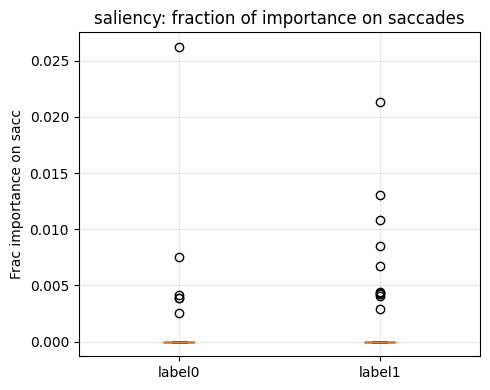

[time-CNN XAI=ig] frac_imp_on_sacc label0 vs label1 -> U=950.0, p=3.120e-01, mean0=0.003, mean1=0.005


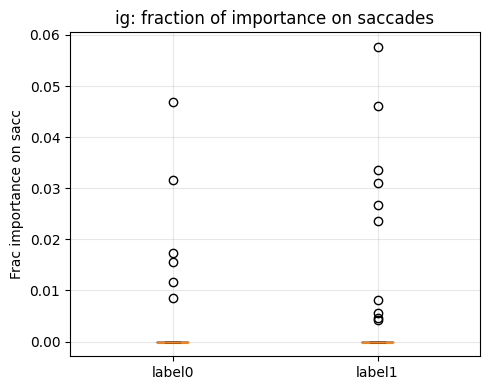

[time-CNN XAI=gradcampp] frac_imp_on_sacc label0 vs label1 -> U=946.0, p=2.897e-01, mean0=0.002, mean1=0.005


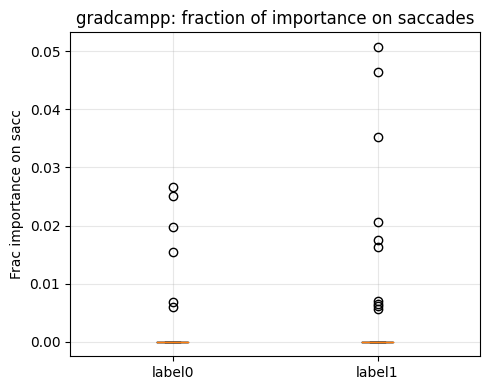


=== Summary (time‑CNN, frac_imp_on_sacc) ===
saliency {'mean0': 0.0010706597059551212, 'mean1': 0.0017472107631518788, 'median0': 0.0, 'median1': 0.0, 'U': 938.0, 'p': 0.24827221794186782, 'n0': 45, 'n1': 46}
ig {'mean0': 0.002928195624715752, 'mean1': 0.005246779203171964, 'median0': 0.0, 'median1': 0.0, 'U': 950.0, 'p': 0.3120238812651621, 'n0': 45, 'n1': 46}
gradcampp {'mean0': 0.0022146136086020206, 'mean1': 0.004604756487938373, 'median0': 0.0, 'median1': 0.0, 'U': 946.0, 'p': 0.2896718869182291, 'n0': 45, 'n1': 46}


In [43]:
# 1) Get model_plain (using the model produced by the existing run_experiment)
CSV_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
PAIR    = (0, 2)
TLEN    = 1500

# Already run: res_02 = run_experiment(CSV_DIR, (0,2), target_len=TLEN)
# Simply retrieve:
model_plain = res_02['model']  # <== Align variable names

# 2) Automatically find the name of the last Conv1D layer (to adapt to the unnamed Conv1D_* layers in the baseline)
def get_last_conv1d_name(model):
    from tensorflow.keras import layers
    for L in model.layers[::-1]:
        if isinstance(L, layers.Conv1D):
            return L.name
    raise RuntimeError("No Conv1D layers found in the model; please confirm that it is time-CNN.")

CONV_LAST = get_last_conv1d_name(model_plain)
print("Last Conv1D layer =", CONV_LAST)

# Check the network and look at the last few layers of names to confirm:
# for L in model_plain.layers[-10:]:
#     print(L.name, L.output_shape)

# 3) Prepare four-channel data preprocessed in the same way as training
X_raw, y, files = load_pair_experiment(
    CSV_DIR, PAIR, resample_len=TLEN,
    max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True
)

# 4) Run XAI + scan comparison (plain: time input is the original (T,4); no stats branch)
df_imp, summary = run_xai_saccade_analysis_timecnn(
    model=model_plain,
    X_raw=X_raw, y=y,
    build_time_input=lambda x: x,     # Directly feed (T,4)
    build_stats_input=None,           # Single-input CNN without stats
    xai_methods=('saliency','ig','gradcampp'),
    vel_thr=0.8, min_frames=8,
    max_n=200,
    conv_layer_name=CONV_LAST         # The last Conv1D name found automatically
)

print("\n=== Summary (time‑CNN, frac_imp_on_sacc) ===")
for k, v in summary.items():
    print(k, v)


Load-level Pattern Differences + Sliding Window Feature Dynamics for time-cnn

In [46]:
# Load-level Pattern Differences + Sliding Window Feature Dynamics (for time-CNN)

# Use the functions given above: load_pair_experiment, split_by_participant_train_val_test,
# and the previously defined compute_lengths, group_window_dynamics, plot_*, etc.

def run_timecnn_loadlevel_and_dynamics(
    first_dir: str,
    repeats_dir: str,
    label_pair=(0,2),
    target_len=1500,
    win=100,
    stride=50,
    out_root="outputs"
):
    os.makedirs(out_root, exist_ok=True)

    print("=== Analyze FIRST ===")
    res_first = analyze_dataset(
        name="first_trials",
        csv_dir=first_dir,
        label_pair=label_pair,
        target_len=target_len,
        out_dir=out_root,
        win=win, stride=stride
    )

    print("\n=== Analyze REPEATS ===")
    res_repeats = analyze_dataset(
        name="repeats",
        csv_dir=repeats_dir,
        label_pair=label_pair,
        target_len=target_len,
        out_dir=out_root,
        win=win, stride=stride
    )

    print("\n=== Summary ===")
    print("FIRST  length-only:", res_first['length_cls'])
    print("REPEATS length-only:", res_repeats['length_cls'])
    return res_first, res_repeats


# Run directly
FIRST_DIR  = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
PAIR       = (0, 2)     # or (1, 3)
TLEN       = 1500
WIN        = 100
STRIDE     = 50

res_first, res_repeats = run_timecnn_loadlevel_and_dynamics(
    first_dir=FIRST_DIR,
    repeats_dir=REPEAT_DIR,
    label_pair=PAIR,
    target_len=TLEN,
    win=WIN,
    stride=STRIDE,
    out_root="outputs"
)


=== Analyze FIRST ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[first_trials] Length MW-U: U=1177.0, p=3.548e-01, mean0=761.688, mean1=725.137
[first_trials] Length-only classifier: Acc=0.389, ROC-AUC=0.500

=== Analyze REPEATS ===
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
[repeats] Length MW-U: U=218.0, p=6.359e-01, mean0=892.691, mean1=850.462
[repeats] Length-only classifier: Acc=0.700, ROC-AUC=0.760

=== Summary ===
FIRST  length-only: {'accuracy': 0.3888888888888889, 'roc_auc': 0.5}
REPEATS length-only: {'accuracy': 0.7, 'roc_auc': 0.76}


Ablation Experiments for time-cnn

In [47]:
"""
Ablation Experiments for time-CNN (8.3)
- 8.3.1 Eye Channel: Left / Right / Both
- 8.3.2 Temporal Segment: Start / Middle / End  (Cut 1/3 and resample back to target_len)
- 8.3.3 Coordinate Direction: X only / Y only

Notes:
- Reuses existing data loading and preprocessing (linear resampling + robust scaling)
- Model input automatically adjusts to the number of channels after pruning (target_len, n_channels)
- Subjects are grouped, and the test set is evaluated only on the out-of-subjects dataset
- Automatically saves CSV/JSON results to ./outputs/ablation_timecnn/
"""

import os, time, json
from typing import Tuple, List, Dict, Optional
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, classification_report

# Reuse/fallback definitions (avoiding NameError)
SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# If these functions have been defined in the environment, they will be automatically overwritten here; otherwise, the fallback implementation here will be used.
try:
    _linear_resample
except NameError:
    def _linear_resample(x: np.ndarray, target_len: int) -> np.ndarray:
        T, C = x.shape
        if T == target_len:
            return x
        src = np.linspace(0.0, 1.0, T, dtype=np.float32)
        dst = np.linspace(0.0, 1.0, target_len, dtype=np.float32)
        out = np.empty((target_len, C), dtype=x.dtype)
        for c in range(C):
            out[:, c] = np.interp(dst, src, x[:, c])
        return out

try:
    _robust_scale_per_trace
except NameError:
    def _robust_scale_per_trace(x: np.ndarray, eps: float = 1e-6) -> np.ndarray:
        x_scaled = x.copy()
        for c in range(x.shape[1]):
            v = x[:, c]
            med = np.median(v)
            q75, q25 = np.percentile(v, 75), np.percentile(v, 25)
            iqr = max(q75 - q25, eps)
            x_scaled[:, c] = (v - med) / iqr
        return x_scaled

try:
    load_pair_experiment
except NameError:
    # Minimum available loader (same style as baseline)
    import pandas as pd
    REQUIRED_COLS = ['abs_lx','abs_ly','abs_rx','abs_ry']
    def load_pair_experiment(csv_dir: str, labels: Tuple[int,int], resample_len: int = 1500,
                             max_nan_ratio: float = 0.05, divide_by_960: bool = True,
                             use_robust_scale: bool = True):
        X, y, files = [], [], []
        tagA, tagB = f"_{labels[0]}", f"_{labels[1]}"
        for file in sorted(os.listdir(csv_dir)):
            if not file.endswith(".csv"): continue
            if (tagA not in file) and (tagB not in file): continue
            df = pd.read_csv(os.path.join(csv_dir, file))
            if set(REQUIRED_COLS).issubset(df.columns):
                raw = df[REQUIRED_COLS].astype(np.float32).values
            else:
                raw = df.iloc[:, 1:5].astype(np.float32).values
            if np.isnan(raw).mean() > max_nan_ratio: continue
            raw = pd.DataFrame(raw).fillna(method='ffill').fillna(method='bfill').fillna(0.0).values
            if divide_by_960: raw = raw / 960.0
            seq = _linear_resample(raw, resample_len)
            if use_robust_scale: seq = _robust_scale_per_trace(seq)
            X.append(seq); y.append(0 if tagA in file else 1); files.append(file)
        X = np.asarray(X, dtype=np.float32); y = np.asarray(y, dtype=np.int64)
        print(f"[load_pair_experiment] Labels={labels}, files={len(files)}, shape={X.shape}")
        return X, y, files

try:
    split_by_participant_train_val_test
except NameError:
    from sklearn.model_selection import train_test_split
    def get_participant_id(filename: str) -> str:
        return os.path.splitext(filename)[0].split('_')[0]
    def split_by_participant_train_val_test(X, y, files, val_size=0.2, test_size=0.2, random_state=42):
        pids = np.array([get_participant_id(f) for f in files])
        uniq = np.array(sorted(list(set(pids))))
        pid_trainval, pid_test = train_test_split(uniq, test_size=test_size, random_state=random_state, shuffle=True)
        pid_train, pid_val = train_test_split(pid_trainval, test_size=val_size/(1.0-test_size),
                                              random_state=random_state, shuffle=True)
        def mask(ids): return np.isin(pids, ids)
        tr, va, te = mask(pid_train), mask(pid_val), mask(pid_test)
        return X[tr], y[tr], X[va], y[va], X[te], y[te], {
            'train_ids': pid_train.tolist(), 'val_ids': pid_val.tolist(), 'test_ids': pid_test.tolist()
        }

try:
    compute_class_weight
except NameError:
    def compute_class_weight(y_train: np.ndarray):
        n0 = int((y_train == 0).sum()); n1 = int((y_train == 1).sum())
        if min(n0, n1) == 0: return None
        w0 = (n0+n1)/(2.0*n0); w1 = (n0+n1)/(2.0*n1)
        return {0: float(w0), 1: float(w1)}

try:
    get_optimizer
except NameError:
    def get_optimizer(lr=3e-4):
        try:
            return tf.keras.optimizers.legacy.Adam(learning_rate=lr)
        except Exception:
            return tf.keras.optimizers.Adam(learning_rate=lr)

# Model (channel adaptation)
def build_1dcnn_model_nchan(target_len: int, n_channels: int) -> Model:
    inp = Input(shape=(target_len, n_channels))
    x = layers.Conv1D(64, 7, padding='same', activation='relu')(inp)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling1D(2)(x)

    x = layers.Conv1D(128, 5, padding='same', activation='relu')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPooling1D(2)(x)

    x = layers.Conv1D(128, 3, padding='same', activation='relu')(x)
    x = layers.GlobalAveragePooling1D()(x)
    x = layers.Dense(64, activation='relu')(x)
    x = layers.Dropout(0.5)(x)
    out = layers.Dense(1, activation='sigmoid')(x)
    return Model(inp, out)

# Crop tool
IDX = {'lx':0, 'ly':1, 'rx':2, 'ry':3}

def select_channels(X: np.ndarray, mode: str) -> np.ndarray:
    """
    mode ∈ {'left','right','both','x','y'}
      left  -> [lx, ly]   ; right -> [rx, ry]
      both  -> [lx, ly, rx, ry]
      x     -> [lx, rx]   ; y     -> [ly, ry]
    """
    if mode == 'left':
        keep = [IDX['lx'], IDX['ly']]
    elif mode == 'right':
        keep = [IDX['rx'], IDX['ry']]
    elif mode == 'both':
        keep = [IDX['lx'], IDX['ly'], IDX['rx'], IDX['ry']]
    elif mode == 'x':
        keep = [IDX['lx'], IDX['rx']]
    elif mode == 'y':
        keep = [IDX['ly'], IDX['ry']]
    else:
        raise ValueError(f"Unknown channel mode: {mode}")
    return X[:, :, keep]

def slice_temporal_segment(X: np.ndarray, seg: str, resample_back_len: Optional[int] = None) -> np.ndarray:
    """
    Slice (N,T,C) into 1/3 slices in the time dimension: seg ∈ {'full','start','middle','end'}
    If resample_back_len is given after slicing, linear resampling is performed back to that length.
    """
    if seg == 'full':
        return X
    N, T, C = X.shape
    one_third = T // 3
    if seg == 'start':
        Xs = X[:, :one_third, :]
    elif seg == 'middle':
        Xs = X[:, one_third:2*one_third, :]
    elif seg == 'end':
        Xs = X[:, 2*one_third:, :]
    else:
        raise ValueError(f"Unknown temporal segment: {seg}")

    if (resample_back_len is None) or (Xs.shape[1] == resample_back_len):
        return Xs

    out = np.empty((N, resample_back_len, C), dtype=X.dtype)
    for i in range(N):
        out[i] = _linear_resample(Xs[i], resample_back_len)
    return out

# Training and evaluation
def train_eval_once(
    X: np.ndarray, y: np.ndarray, files: List[str],
    target_len: int = 1500,
    lr: float = 3e-4,
    batch_size: int = 16,
    max_epochs: int = 80,
    early_patience: int = 15
) -> Dict:
    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    n_channels = X.shape[-1]
    model = build_1dcnn_model_nchan(target_len, n_channels)
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])

    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    class_weight = compute_class_weight(ytr)

    t0 = time.perf_counter()
    hist = model.fit(
        Xtr, ytr,
        validation_data=(Xva, yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=0,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()

    yprob = model.predict(Xte, batch_size=batch_size, verbose=0).ravel()
    ypred = (yprob >= 0.5).astype(int)
    acc = accuracy_score(yte, ypred)
    macro_f1 = f1_score(yte, ypred, average='macro')
    try:
        roc_auc = roc_auc_score(yte, yprob)
    except Exception:
        roc_auc = np.nan
    report = classification_report(yte, ypred, digits=4)
    return {
        'acc': float(acc), 'macro_f1': float(macro_f1), 'roc_auc': float(roc_auc),
        'report': report, 'history': hist.history, 'time_sec': float(t1 - t0),
        'splits': id_splits
    }

#  8.3.1 Eye Channel Ablation
def run_eye_channel_ablation(csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
                             base_loader_kwargs: Optional[Dict] = None) -> pd.DataFrame:
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)
    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)
    rows = []
    for mode in ['left', 'right', 'both']:
        Xc = select_channels(X, mode)
        res = train_eval_once(Xc, y, files, target_len=target_len)
        rows.append(dict(ablation='EyeChannel', setting=mode, **{k:res[k] for k in ['acc','macro_f1','roc_auc','time_sec']}))
        print(f"[EyeChannel] {mode}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# 8.3.2 Temporal Segment Ablation
def run_temporal_segment_ablation(csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
                                  base_loader_kwargs: Optional[Dict] = None) -> pd.DataFrame:
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)
    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)
    rows = []
    for seg in ['start', 'middle', 'end']:
        Xt = slice_temporal_segment(X, seg=seg, resample_back_len=target_len)
        res = train_eval_once(Xt, y, files, target_len=target_len)
        rows.append(dict(ablation='Temporal', setting=seg, **{k:res[k] for k in ['acc','macro_f1','roc_auc','time_sec']}))
        print(f"[Temporal] {seg}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# 8.3.3 Coordinate Direction Ablation
def run_coord_direction_ablation(csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
                                 base_loader_kwargs: Optional[Dict] = None) -> pd.DataFrame:
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)
    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)
    rows = []
    for d in ['x', 'y']:
        Xc = select_channels(X, d)
        res = train_eval_once(Xc, y, files, target_len=target_len)
        rows.append(dict(ablation='Coord', setting=d, **{k:res[k] for k in ['acc','macro_f1','roc_auc','time_sec']}))
        print(f"[Coord] {d}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# One-touch control + disk placement
def run_all_ablation(csv_dir: str, label_pair: Tuple[int,int]=(0,2), target_len: int = 1500,
                     save_prefix: Optional[str] = None, out_dir: str = "outputs/ablation_timecnn") -> Dict[str, pd.DataFrame]:
    os.makedirs(out_dir, exist_ok=True)
    res_eye = run_eye_channel_ablation(csv_dir, label_pair, target_len)
    res_tmp = run_temporal_segment_ablation(csv_dir, label_pair, target_len)
    res_dir = run_coord_direction_ablation(csv_dir, label_pair, target_len)
    results = {'EyeChannel': res_eye, 'Temporal': res_tmp, 'Coord': res_dir}

    if save_prefix:
        for k, df in results.items():
            path = os.path.join(out_dir, f"{save_prefix}_{k}.csv")
            df.to_csv(path, index=False)
        with open(os.path.join(out_dir, f"{save_prefix}_meta.json"), "w") as f:
            json.dump({'label_pair': label_pair, 'target_len': target_len}, f, indent=2)
    return results

# Run
if __name__ == "__main__":
    FIRST_DIR  = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (0, 2)     # or (1, 3)
    TLEN = 1500

    print("=== 8.3 Ablation on FIRST_TRIALS ===")
    res_first = run_all_ablation(FIRST_DIR, label_pair=PAIR, target_len=TLEN,
                                 save_prefix=f"first_{PAIR[0]}_{PAIR[1]}")
    print("\n=== 8.3 Ablation on REPEATS ===")
    res_repeats = run_all_ablation(REPEAT_DIR, label_pair=PAIR, target_len=TLEN,
                                   save_prefix=f"repeats_{PAIR[0]}_{PAIR[1]}")

    # Summary print (accurate descending order)
    for name, df in res_first.items():
        print(f"\n[FIRST] {name}\n", df.sort_values('acc', ascending=False))
    for name, df in res_repeats.items():
        print(f"\n[REPEATS] {name}\n", df.sort_values('acc', ascending=False))


=== 8.3 Ablation on FIRST_TRIALS ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)

Epoch 42: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 52: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.

Epoch 67: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.
[EyeChannel] left: Acc=0.824, F1=0.798, AUC=1.000
              precision    recall  f1-score   support

           0     1.0000    0.5714    0.7273         7
           1     0.7692    1.0000    0.8696        10

    accuracy                         0.8235        17
   macro avg     0.8846    0.7857    0.7984        17
weighted avg     0.8643    0.8235    0.8110        17


Epoch 20: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 26: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[EyeChannel] right: Acc=0.647, F1=0.510, AUC=0.886
              precision    recall  f1-score   support

    

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[Coord] y: Acc=0.588, F1=0.370, AUC=0.886
              precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000         7
           1     0.5882    1.0000    0.7407        10

    accuracy                         0.5882        17
   macro avg     0.2941    0.5000    0.3704        17
weighted avg     0.3460    0.5882    0.4357        17


=== 8.3 Ablation on REPEATS ===
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)

Epoch 30: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 47: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[EyeChannel] left: Acc=0.700, F1=0.670, AUC=0.960
              precision    recall  f1-score   support

           0     0.6250    1.0000    0.7692         5
           1     1.0000    0.4000    0.5714         5

    accuracy                         0.7000        10
   macro avg     0.8125    0.7000    0.6703        10
weighted avg     0.8125    0.7000    0.6

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[Coord] x: Acc=0.500, F1=0.333, AUC=1.000
              precision    recall  f1-score   support

           0     0.5000    1.0000    0.6667         5
           1     0.0000    0.0000    0.0000         5

    accuracy                         0.5000        10
   macro avg     0.2500    0.5000    0.3333        10
weighted avg     0.2500    0.5000    0.3333        10


Epoch 8: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 31: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[Coord] y: Acc=0.500, F1=0.333, AUC=1.000
              precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000         5
           1     0.5000    1.0000    0.6667         5

    accuracy                         0.5000        10
   macro avg     0.2500    0.5000    0.3333        10
weighted avg     0.2500    0.5000    0.3333        10


[FIRST] EyeChannel
      ablation setting       acc  macro_f1   roc_auc   time_sec
2  EyeChannel    both  

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [23]:
# Run
if __name__ == "__main__":
    FIRST_DIR  = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (1, 3)
    TLEN = 1500

    print("=== 8.3 Ablation on FIRST_TRIALS ===")
    res_first = run_all_ablation(FIRST_DIR, label_pair=PAIR, target_len=TLEN,
                                 save_prefix=f"first_{PAIR[0]}_{PAIR[1]}")
    print("\n=== 8.3 Ablation on REPEATS ===")
    res_repeats = run_all_ablation(REPEAT_DIR, label_pair=PAIR, target_len=TLEN,
                                   save_prefix=f"repeats_{PAIR[0]}_{PAIR[1]}")

    # Summary print (accurate descending order)
    for name, df in res_first.items():
        print(f"\n[FIRST] {name}\n", df.sort_values('acc', ascending=False))
    for name, df in res_repeats.items():
        print(f"\n[REPEATS] {name}\n", df.sort_values('acc', ascending=False))

=== 8.3 Ablation on FIRST_TRIALS ===
[load_pair_experiment] Dir=first_trials Labels=(1, 3), files=96, shape=(96, 1500, 4)

Epoch 28: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 34: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[EyeChannel] left: Acc=0.524, F1=0.417, AUC=0.791
              precision    recall  f1-score   support

           0     1.0000    0.0909    0.1667        11
           1     0.5000    1.0000    0.6667        10

    accuracy                         0.5238        21
   macro avg     0.7500    0.5455    0.4167        21
weighted avg     0.7619    0.5238    0.4048        21


Epoch 7: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 13: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.


/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[EyeChannel] right: Acc=0.476, F1=0.323, AUC=0.455
              precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000        11
           1     0.4762    1.0000    0.6452        10

    accuracy                         0.4762        21
   macro avg     0.2381    0.5000    0.3226        21
weighted avg     0.2268    0.4762    0.3072        21


Epoch 19: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 62: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[EyeChannel] both: Acc=0.714, F1=0.697, AUC=0.882
              precision    recall  f1-score   support

           0     1.0000    0.4545    0.6250        11
           1     0.6250    1.0000    0.7692        10

    accuracy                         0.7143        21
   macro avg     0.8125    0.7273    0.6971        21
weighted avg     0.8214    0.7143    0.6937        21

[load_pair_experiment] Dir=first_trials Labels=(1, 3), files=96, shape=(96, 1500, 4)

Epo

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[Coord] x: Acc=0.476, F1=0.323, AUC=0.400
              precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000        11
           1     0.4762    1.0000    0.6452        10

    accuracy                         0.4762        21
   macro avg     0.2381    0.5000    0.3226        21
weighted avg     0.2268    0.4762    0.3072        21


Epoch 11: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.
[Coord] y: Acc=0.762, F1=0.753, AUC=0.927
              precision    recall  f1-score   support

           0     1.0000    0.5455    0.7059        11
           1     0.6667    1.0000    0.8000        10

    accuracy                         0.7619        21
   macro avg     0.8333    0.7727    0.7529        21
weighted avg     0.8413    0.7619    0.7507        21


=== 8.3 Ablation on REPEATS ===
[load_pair_experiment] Dir=repeats Labels=(1, 3), files=39, shape=(39, 1500, 4)

Epoch 34: ReduceLROnPlateau reducing learning rate to 0.00015000000712

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[EyeChannel] left: Acc=0.444, F1=0.308, AUC=1.000
              precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000         5
           1     0.4444    1.0000    0.6154         4

    accuracy                         0.4444         9
   macro avg     0.2222    0.5000    0.3077         9
weighted avg     0.1975    0.4444    0.2735         9


Epoch 11: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 17: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[EyeChannel] right: Acc=0.556, F1=0.500, AUC=0.800
              precision    recall  f1-score   support

           0     0.5714    0.8000    0.6667         5
           1     0.5000    0.2500    0.3333         4

    accuracy                         0.5556         9
   macro avg     0.5357    0.5250    0.5000         9
weighted avg     0.5397    0.5556    0.5185         9


Epoch 7: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 18: R

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[Coord] x: Acc=0.556, F1=0.357, AUC=0.650
              precision    recall  f1-score   support

           0     0.5556    1.0000    0.7143         5
           1     0.0000    0.0000    0.0000         4

    accuracy                         0.5556         9
   macro avg     0.2778    0.5000    0.3571         9
weighted avg     0.3086    0.5556    0.3968         9


Epoch 11: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 17: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
[Coord] y: Acc=0.556, F1=0.357, AUC=0.700
              precision    recall  f1-score   support

           0     0.5556    1.0000    0.7143         5
           1     0.0000    0.0000    0.0000         4

    accuracy                         0.5556         9
   macro avg     0.2778    0.5000    0.3571         9
weighted avg     0.3086    0.5556    0.3968         9


[FIRST] EyeChannel
      ablation setting       acc  macro_f1   roc_auc   time_sec
2  EyeChannel    both 

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


tcn

[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Split] train=54, val=20, test=17
Epoch 1/80
4/4 [==============================] - 2s 263ms/step - loss: 0.9995 - accuracy: 0.5000 - val_loss: 0.7062 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 1s 216ms/step - loss: 0.7668 - accuracy: 0.6296 - val_loss: 0.7177 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 1s 209ms/step - loss: 0.9257 - accuracy: 0.5370 - val_loss: 0.7255 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 1s 204ms/step - loss: 0.6732 - accuracy: 0.7037 - val_loss: 0.7585 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 1s 244ms/step - loss: 0.7476 - accuracy: 0.6296 - val_loss: 0.7613 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 1s 299ms/step - loss: 0.6926 - accuracy: 0.685

Epoch 16/80
4/4 [==============================] - 1s 210ms/step - loss: 0.7773 - accuracy: 0.5818 - val_loss: 0.7450 - val_accuracy: 0.5000 - lr: 1.5000e-04
Epoch 17/80
4/4 [==============================] - 1s 204ms/step - loss: 0.7073 - accuracy: 0.6000 - val_loss: 0.7491 - val_accuracy: 0.5000 - lr: 1.5000e-04
Epoch 18/80
4/4 [==============================] - 1s 203ms/step - loss: 0.6892 - accuracy: 0.6545 - val_loss: 0.7576 - val_accuracy: 0.5000 - lr: 1.5000e-04
Epoch 19/80
4/4 [==============================] - 1s 227ms/step - loss: 0.6964 - accuracy: 0.6182 - val_loss: 0.7666 - val_accuracy: 0.5000 - lr: 1.5000e-04
Epoch 20/80
4/4 [==============================] - 1s 229ms/step - loss: 0.6679 - accuracy: 0.6545 - val_loss: 0.7717 - val_accuracy: 0.5000 - lr: 1.5000e-04
Epoch 21/80
4/4 [==============================] - ETA: 0s - loss: 0.6977 - accuracy: 0.6909
Epoch 21: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
4/4 [==============================] - 1

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


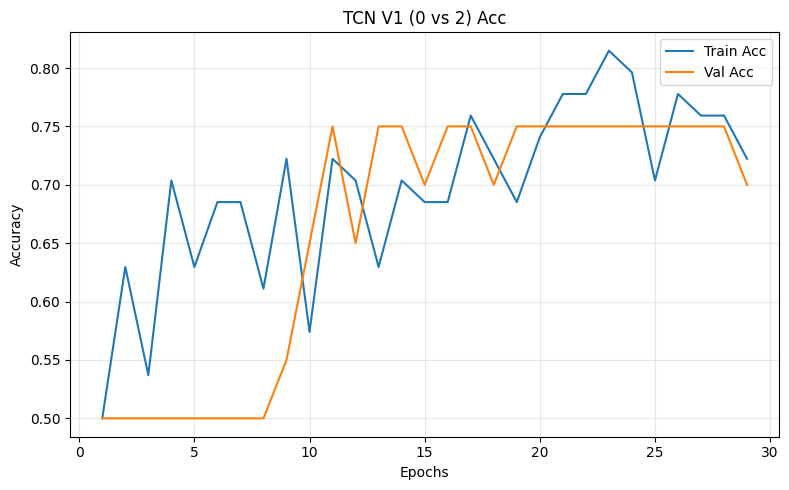

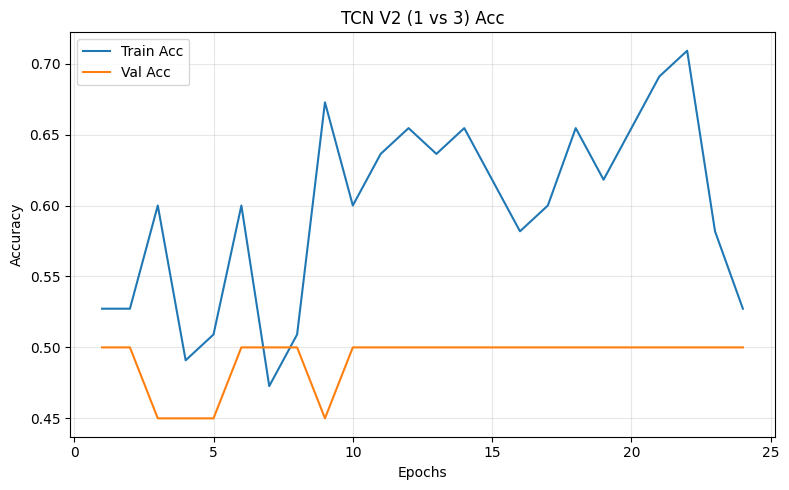

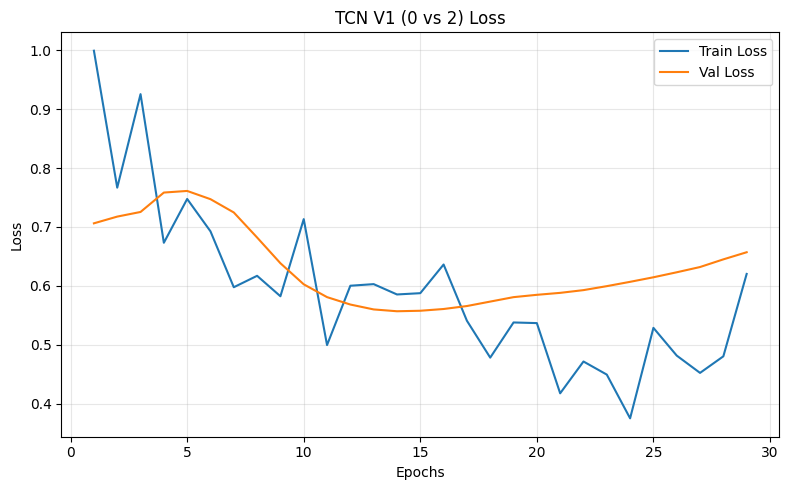

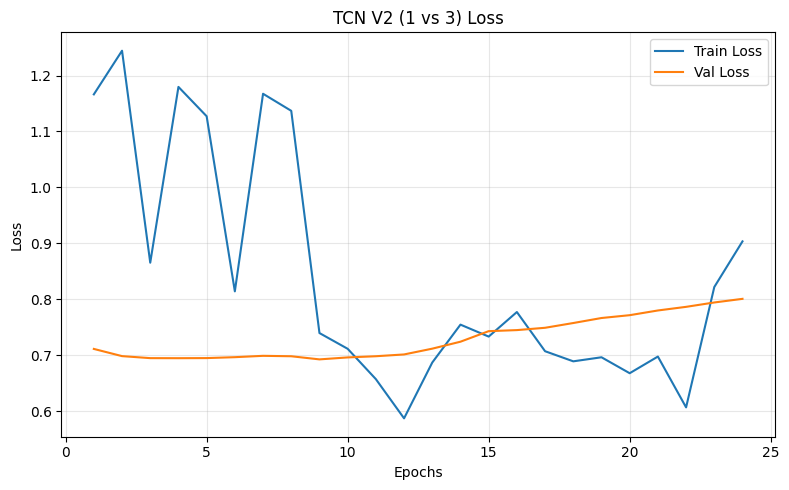

In [48]:
"""
TCN baseline (aligned with CNN pipeline)
- Same loader, resampling, robust scaling, participant-wise splits
- Causal + dilated Conv1D residual blocks
- Binary crossentropy, early stopping, ReduceLROnPlateau
"""

import os, time
from typing import List, Tuple, Dict
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Reuse helpers
#   - _linear_resample, _robust_scale_per_trace, load_pair_experiment
#   - split_by_participant_train_val_test
#   - compute_class_weight, get_optimizer
# These functions have been defined according to the CNN version

# TCN building blocks
def ResidualBlockTCN(x, n_filters: int, kernel_size: int, dilation: int,
                     dropout: float = 0.1, use_ln: bool = False, name: str = "tcn"):
    """
    A standard TCN residual block:
      Conv1D(causal, dilation) -> (LayerNorm|BatchNorm) -> ReLU -> SpatialDropout1D
      Conv1D(causal, dilation) -> (LayerNorm|BatchNorm) -> ReLU -> SpatialDropout1D
      Residual + ReLU
    """
    shortcut = x
    # If the number of channels does not match, use 1x1 convolution projection
    if x.shape[-1] != n_filters:
        shortcut = layers.Conv1D(n_filters, 1, padding='same', name=f"{name}_proj")(shortcut)

    y = layers.Conv1D(n_filters, kernel_size, padding='causal',
                      dilation_rate=dilation, name=f"{name}_conv1")(x)
    if use_ln:
        y = layers.LayerNormalization(name=f"{name}_ln1")(y)
    else:
        y = layers.BatchNormalization(name=f"{name}_bn1")(y)
    y = layers.Activation('relu', name=f"{name}_relu1")(y)
    y = layers.SpatialDropout1D(dropout, name=f"{name}_sd1")(y)

    y = layers.Conv1D(n_filters, kernel_size, padding='causal',
                      dilation_rate=dilation, name=f"{name}_conv2")(y)
    if use_ln:
        y = layers.LayerNormalization(name=f"{name}_ln2")(y)
    else:
        y = layers.BatchNormalization(name=f"{name}_bn2")(y)
    y = layers.Activation('relu', name=f"{name}_relu2")(y)
    y = layers.SpatialDropout1D(dropout, name=f"{name}_sd2")(y)

    out = layers.Add(name=f"{name}_add")([shortcut, y])
    out = layers.Activation('relu', name=f"{name}_out_relu")(out)
    return out

def build_tcn_model(input_shape,
                    n_filters: int = 64,
                    kernel_size: int = 7,
                    dilations: List[int] = (1, 2, 4, 8, 16),
                    nb_stacks: int = 1,
                    dropout: float = 0.1,
                    use_ln: bool = False) -> Model:
    """
    Build a TCN backbone with GAP + small head.
    input_shape: (T, C) e.g. (1500, 4)
    """
    inp = Input(shape=input_shape, name="input")
    x = inp
    for s in range(nb_stacks):
        for d in dilations:
            x = ResidualBlockTCN(
                x, n_filters=n_filters, kernel_size=kernel_size, dilation=d,
                dropout=dropout, use_ln=use_ln, name=f"tcn_s{s}_d{d}"
            )
    x = layers.GlobalAveragePooling1D(name="gap")(x)
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(0.5, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name="tcn_baseline")

# Training runner (mirrors CNN)
def run_experiment_tcn(
    csv_dir: str,
    label_pair: Tuple[int, int],
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    # TCN hyperparams
    n_filters: int = 64,
    kernel_size: int = 7,
    dilations: Tuple[int, ...] = (1, 2, 4, 8, 16),
    nb_stacks: int = 1,
    dropout: float = 0.1,
    use_ln: bool = False
) -> Dict:
    # data
    X, y, files = load_pair_experiment(
        csv_dir,
        label_pair,
        resample_len=target_len,
        max_nan_ratio=0.05,
        divide_by_960=True,
        use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    print(f"[Split] train={len(ytr)}, val={len(yva)}, test={len(yte)}")

    # model
    model = build_tcn_model(
        input_shape=(target_len, X.shape[-1]),
        n_filters=n_filters, kernel_size=kernel_size,
        dilations=list(dilations), nb_stacks=nb_stacks,
        dropout=dropout, use_ln=use_ln
    )
    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])

    callbacks = [
        tf.keras.callbacks.EarlyStopping(
            monitor='val_loss', patience=early_patience, restore_best_weights=True
        ),
        tf.keras.callbacks.ReduceLROnPlateau(
            monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1
        ),
        tf.keras.callbacks.CSVLogger(f'train_log_tcn_{label_pair[0]}_{label_pair[1]}.csv', append=False)
    ]
    class_weight = compute_class_weight(ytr)

    t0 = time.perf_counter()
    history = model.fit(
        Xtr, ytr,
        validation_data=(Xva, yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=1,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()
    print(f"[Time][TCN] Pair {label_pair}: training wall-clock {t1 - t0:.2f}s")

    # test
    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    report = classification_report(yte, ypred, digits=4)
    print(f"\n[TEST][TCN] Pair {label_pair} classification report:\n{report}")

    return {
        'label_pair': label_pair,
        'history': history.history,
        'test_report': report,
        'model': model,
        'id_splits': id_splits
    }

# Plots (reuse plotters)
import matplotlib.pyplot as plt

def plot_accuracy_curve(history_dict, title, save_path=None):
    acc = history_dict.get('accuracy', [])
    val_acc = history_dict.get('val_accuracy', [])
    epochs = range(1, len(acc) + 1)
    plt.figure(figsize=(8, 5))
    plt.plot(epochs, acc, label='Train Acc')
    plt.plot(epochs, val_acc, label='Val Acc')
    plt.xlabel('Epochs'); plt.ylabel('Accuracy'); plt.title(title)
    plt.legend(); plt.grid(True, alpha=0.3); plt.tight_layout()
    if save_path is not None:
        plt.savefig(save_path, dpi=200)
    plt.show()

def plot_loss_curve(history_dict, title, save_path=None):
    loss = history_dict.get('loss', [])
    val_loss = history_dict.get('val_loss', [])
    epochs = range(1, len(loss) + 1)
    plt.figure(figsize=(8, 5))
    plt.plot(epochs, loss, label='Train Loss')
    plt.plot(epochs, val_loss, label='Val Loss')
    plt.xlabel('Epochs'); plt.ylabel('Loss'); plt.title(title)
    plt.legend(); plt.grid(True, alpha=0.3); plt.tight_layout()
    if save_path is not None:
        plt.savefig(save_path, dpi=200)
    plt.show()

# main
if __name__ == "__main__":
    csv_path = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    # can also run the repeats directory
    res_tcn_02 = run_experiment_tcn(
        csv_dir=csv_path, label_pair=(0, 2), target_len=1500,
        # TCN hyperparameters (fine-tunable)
        n_filters=64, kernel_size=7, dilations=(1,2,4,8,16),
        nb_stacks=1, dropout=0.1, use_ln=False
    )
    res_tcn_13 = run_experiment_tcn(
        csv_dir=csv_path, label_pair=(1, 3), target_len=1500,
        n_filters=64, kernel_size=7, dilations=(1,2,4,8,16),
        nb_stacks=1, dropout=0.1, use_ln=False
    )

    # curve
    plot_accuracy_curve(res_tcn_02['history'], title='TCN V1 (0 vs 2) Acc', save_path='tcn_v1_acc.png')
    plot_accuracy_curve(res_tcn_13['history'], title='TCN V2 (1 vs 3) Acc', save_path='tcn_v2_acc.png')
    plot_loss_curve(res_tcn_02['history'], title='TCN V1 (0 vs 2) Loss', save_path='tcn_v1_loss.png')
    plot_loss_curve(res_tcn_13['history'], title='TCN V2 (1 vs 3) Loss', save_path='tcn_v2_loss.png')


tcn transfer learning

In [49]:
"""
Transfer Learning for TCN (first_trials -> repeats, or (0,2)->(1,3))
- Stage 0: Pretrain TCN extractor on SOURCE
- Stage 1: Head-only on TARGET
- Stage 1.5: BN-Adapt (only BN trainable)
- Stage 2: Fine-tune the last TCN residual block @ low LR
- Threshold tuned on VAL by balanced accuracy, then report TEST
"""

import os, time, re
from typing import List, Tuple, Dict, Optional
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.metrics import classification_report, balanced_accuracy_score

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Reuse existing tools: load_pair_experiment / split_by_participant_train_val_test / get_optimizer / compute_class_weight
# They are defined in the same file

# TCN Construction
def ResidualBlockTCN(x, n_filters: int, kernel_size: int, dilation: int,
                     dropout: float = 0.1, use_ln: bool = False, name: str = "tcn"):
    """
    Standard TCN residual block: Causal Dilated Conv1D x2 + (BN/LN) + ReLU + SpatialDropout1D + residual
    Naming convention: {name}_conv1/2, {name}_bn1/2 or ln1/2, {name}_sd1/2, {name}_out_relu
    """
    shortcut = x
    if x.shape[-1] != n_filters:
        shortcut = layers.Conv1D(n_filters, 1, padding='same', name=f"{name}_proj")(shortcut)

    y = layers.Conv1D(n_filters, kernel_size, padding='causal', dilation_rate=dilation, name=f"{name}_conv1")(x)
    y = (layers.LayerNormalization(name=f"{name}_ln1") if use_ln else layers.BatchNormalization(name=f"{name}_bn1"))(y)
    y = layers.Activation('relu', name=f"{name}_relu1")(y)
    y = layers.SpatialDropout1D(dropout, name=f"{name}_sd1")(y)

    y = layers.Conv1D(n_filters, kernel_size, padding='causal', dilation_rate=dilation, name=f"{name}_conv2")(y)
    y = (layers.LayerNormalization(name=f"{name}_ln2") if use_ln else layers.BatchNormalization(name=f"{name}_bn2"))(y)
    y = layers.Activation('relu', name=f"{name}_relu2")(y)
    y = layers.SpatialDropout1D(dropout, name=f"{name}_sd2")(y)

    out = layers.Add(name=f"{name}_add")([shortcut, y])
    out = layers.Activation('relu', name=f"{name}_out_relu")(out)
    return out

def build_tcn_extractor(input_shape,
                        n_filters: int = 64,
                        kernel_size: int = 7,
                        dilations: List[int] = (1, 2, 4, 8, 16),
                        nb_stacks: int = 1,
                        dropout: float = 0.1,
                        use_ln: bool = False) -> Model:
    """
    Feature extractor only: stack several TCN residual blocks and finally gap the output vector.
    Naming convention: block name tcn_s{stack}_d{dilation}_*
    """
    inp = Input(shape=input_shape, name="input")
    x = inp
    for s in range(nb_stacks):
        for d in dilations:
            x = ResidualBlockTCN(
                x, n_filters=n_filters, kernel_size=kernel_size, dilation=d,
                dropout=dropout, use_ln=use_ln, name=f"tcn_s{s}_d{d}"
            )
    x = layers.GlobalAveragePooling1D(name="gap")(x)
    return Model(inp, x, name="tcn_extractor")

def build_classifier_from_extractor_tcn(extractor: Model, dropout=0.5) -> Model:
    """A small FC header is added after the TCN extractor; the layer names remain the same as the CNN version to reuse the frozen logic."""
    inp = extractor.input
    x = extractor.output
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(dropout, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='tcn_transfer')

# Freeze/Thaw & BN-Adapt
def freeze_all_but_head(model: Model):
    """Make only the head (fc1/drop/logit) trainable."""
    for l in model.layers:
        l.trainable = (l.name in ['fc1', 'drop', 'logit'])

def bn_adapt_only(model: Model):
    """Only BN layers are trainable (for BN-Adapt)"""
    for l in model.layers:
        if isinstance(l, layers.BatchNormalization):
            l.trainable = True
        else:
            l.trainable = False

def _get_last_tcn_block_names(model: Model) -> List[str]:
    """
    Automatically finds the "last set" of TCN residual blocks (the one with the largest dilation in the same stack, or the last block overall).
    Based on the layer name pattern tcn_s{stack}_d{d}_...
    Returns the name prefix of all related layers in the block (all conv/bn/relu/drop/add/out_relu layers with the same name prefix will be unfrozen).
    """
    pat = re.compile(r"^tcn_s(\d+)_d(\d+)_(conv1|conv2|bn1|bn2|ln1|ln2|relu1|relu2|sd1|sd2|proj|add|out_relu)$")
    blocks = []
    for L in model.layers:
        m = pat.match(L.name)
        if m:
            s = int(m.group(1)); d = int(m.group(2))
            blocks.append((s, d))
    if not blocks:
        return []

    # Select the piece with the largest s and largest d
    s_max = max(s for s, _ in blocks)
    d_max = max(d for s, d in blocks if s == s_max)
    prefix = f"tcn_s{s_max}_d{d_max}_"
    # Collect all layer names with the prefix of this block
    names = [L.name for L in model.layers if L.name.startswith(prefix)]
    return names

def finetune_last_tcn_block(model: Model):
    """Only unfreeze the "last set of TCN residual blocks" + GAP + head; keep the rest frozen."""
    for l in model.layers:
        l.trainable = False
    names = _get_last_tcn_block_names(model)
    for name in names + ['gap', 'fc1', 'drop', 'logit']:
        try:
            model.get_layer(name).trainable = True
        except Exception:
            pass

# Threshold search (same as CNN version)
def tune_threshold_bal_acc(y_true: np.ndarray, y_prob: np.ndarray) -> Tuple[float, float]:
    best_thr, best_bal = 0.5, -1.0
    for thr in np.linspace(0.1, 0.9, 33):
        y_pred = (y_prob >= thr).astype(int)
        bal = balanced_accuracy_score(y_true, y_pred)
        if bal > best_bal:
            best_bal, best_thr = bal, float(thr)
    return best_thr, best_bal

def evaluate_with_threshold(model: Model, Xv, yv, Xt, yt, batch_size=16):
    vprob = model.predict(Xv, batch_size=batch_size).ravel()
    thr, bal = tune_threshold_bal_acc(yv, vprob)
    tprob = model.predict(Xt, batch_size=batch_size).ravel()
    tpred = (tprob >= thr).astype(int)
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")
    print("\n[TEST] Transfer report (thr tuned):\n",
          classification_report(yt, tpred, digits=4))
    return thr, bal

# Training phase: pre-training & transfer
def pretrain_tcn_extractor_on_source(
    csv_dir: str, src_pair=(0,2), target_len=1500,
    max_epochs=60, batch_size=16, lr=3e-4,
    n_filters=64, kernel_size=7, dilations=(1,2,4,8,16), nb_stacks=1, dropout=0.1, use_ln=False,
    save_path='tcn_extractor_src.weights.h5'
):
    from sklearn.model_selection import train_test_split  # Preventing outer scope conflicts
    X, y, files = load_pair_experiment(csv_dir, src_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(X, y, files)

    extractor = build_tcn_extractor((target_len, 4),
                                    n_filters=n_filters, kernel_size=kernel_size,
                                    dilations=list(dilations), nb_stacks=nb_stacks,
                                    dropout=dropout, use_ln=use_ln)
    model = build_classifier_from_extractor_tcn(extractor)

    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs = [
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=10, min_lr=3.75e-05, verbose=1),
    ]
    print(f"[Pretrain-TCN] source={src_pair}")
    t0 = time.perf_counter()
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1, callbacks=cbs)
    t1 = time.perf_counter()
    print(f"[Time] Pretrain wall-clock: {t1 - t0:.2f}s")

    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    print("[TEST] Pretrain report:\n", classification_report(yte, ypred, digits=4))

    extractor.save_weights(save_path)
    print(f"[SAVE] TCN extractor weights -> {save_path}")
    return save_path

def transfer_first_to_repeats_tcn(
    src_dir: str, tgt_dir: str, pair=(0,2),
    extractor_weights_path: Optional[str] = None,
    target_len=1500, batch_size=16,
    # TCN super parameters
    n_filters=64, kernel_size=7, dilations=(1,2,4,8,16), nb_stacks=1, dropout=0.1, use_ln=False
):
    # Load data
    Xt, yt, ft = load_pair_experiment(tgt_dir, pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(
        Xt, yt, ft, val_size=0.25, test_size=0.25, random_state=SEED
    )
    print("[Split target pids]", split_info)

    # Build TCN & load extractor
    extractor = build_tcn_extractor((target_len, 4),
                                    n_filters=n_filters, kernel_size=kernel_size,
                                    dilations=list(dilations), nb_stacks=nb_stacks,
                                    dropout=dropout, use_ln=use_ln)

    if extractor_weights_path is None:
        # Source domain pre-training (on src_dir)
        extractor_weights_path = pretrain_tcn_extractor_on_source(
            csv_dir=src_dir, src_pair=pair, target_len=target_len,
            max_epochs=60, batch_size=batch_size, lr=3e-4,
            n_filters=n_filters, kernel_size=kernel_size, dilations=dilations,
            nb_stacks=nb_stacks, dropout=dropout, use_ln=use_ln,
            save_path=f"tcn_extractor_first_{pair[0]}_{pair[1]}.weights.h5"
        )

    extractor.load_weights(extractor_weights_path)
    model = build_classifier_from_extractor_tcn(extractor)
    cls_weight = compute_class_weight(ytr)

    # Stage 1: head-only
    freeze_all_but_head(model)
    model.compile(optimizer=get_optimizer(3e-3),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    print("[Stage 1][TCN] Head-only.")
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5,
                                                 min_lr=7.5e-04, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1, callbacks=cbs1,
              class_weight=cls_weight)

    # Stage 1.5: BN-Adapt
    print("[BN-Adapt][TCN] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: fine-tune last TCN block
    print("[Stage 2][TCN] Fine-tune last TCN block @ LR=5e-5.")
    finetune_last_tcn_block(model)
    model.compile(optimizer=get_optimizer(5e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12,
                                                 min_lr=1e-5, verbose=1)]
    t0 = time.perf_counter()
    hist2 = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                      epochs=60, batch_size=batch_size, verbose=1, callbacks=cbs2,
                      class_weight=cls_weight)
    t1 = time.perf_counter()
    print(f"[Time] Fine-tune wall-clock: {t1 - t0:.2f}s")

    # Threshold tune & Test
    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, (Xtr, ytr, Xva, yva, Xte, yte), hist2.history, thr, split_info

# Main
if __name__ == "__main__":
    SRC_DIR = '/Users/wukehui/Desktop/data science project/project/data/first_trials'
    TGT_DIR = '/Users/wukehui/Desktop/data science project/project/data/repeats'
    PAIR = (0, 2)
    EXTRACTOR_WEIGHTS = None  # If it already exists, can fill in the path to avoid repeated pre-training

    model_tcn, splits, hist2, best_thr, pid_split = transfer_first_to_repeats_tcn(
        src_dir=SRC_DIR, tgt_dir=TGT_DIR, pair=PAIR,
        extractor_weights_path=EXTRACTOR_WEIGHTS,
        target_len=1500, batch_size=16,
        n_filters=64, kernel_size=7, dilations=(1,2,4,8,16), nb_stacks=1, dropout=0.1, use_ln=False
    )


[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
[Split target pids] {'train_ids': ['021', '065', '016', '032', '054', '072', '036', '056', '058', '042'], 'val_ids': ['049', '047', '048', '071', '011'], 'test_ids': ['006', '062', '057', '009', '041', '029']}
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[Pretrain-TCN] source=(0, 2)
Epoch 1/60
4/4 [==============================] - 3s 327ms/step - loss: 1.3199 - accuracy: 0.5185 - auc: 0.5337 - val_loss: 0.6882 - val_accuracy: 0.5500 - val_auc: 0.7000 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 1s 272ms/step - loss: 0.9506 - accuracy: 0.5741 - auc: 0.6518 - val_loss: 0.6875 - val_accuracy: 0.5000 - val_auc: 0.8250 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 1s 260ms/step - loss: 0.7707 - accuracy: 0.6296 - auc: 0.6724 - val_loss: 0.7077 - val_accuracy: 0.5000 - val_auc: 0.8300 - lr: 3.0000e-04
Epoch 4/60
4/4 [=============

2/2 [==============================] - 0s 66ms/step - loss: 0.5338 - accuracy: 0.7000 - auc: 0.8500 - val_loss: 0.4592 - val_accuracy: 0.7500 - val_auc: 0.9375 - lr: 0.0015
Epoch 20/20
2/2 [==============================] - 0s 64ms/step - loss: 0.6538 - accuracy: 0.6500 - auc: 0.6500 - val_loss: 0.4504 - val_accuracy: 0.7500 - val_auc: 0.9375 - lr: 0.0015
[BN-Adapt][TCN] epochs=2, lr=1e-05
Epoch 1/2
2/2 [==============================] - 1s 284ms/step - loss: 0.4304 - accuracy: 0.8000 - auc: 0.9200 - val_loss: 0.4502 - val_accuracy: 0.7500 - val_auc: 0.9375
Epoch 2/2
2/2 [==============================] - 0s 110ms/step - loss: 0.5754 - accuracy: 0.7000 - auc: 0.8500 - val_loss: 0.4487 - val_accuracy: 0.7500 - val_auc: 0.9375
[Stage 2][TCN] Fine-tune last TCN block @ LR=5e-5.
Epoch 1/60
2/2 [==============================] - 1s 205ms/step - loss: 0.4636 - accuracy: 0.8000 - auc: 0.9350 - val_loss: 0.4471 - val_accuracy: 0.7500 - val_auc: 0.9375 - lr: 5.0000e-05
Epoch 2/60
2/2 [=========

In [50]:
# Cross-pair transfer: source=(1,3)  ->  target=(0,2)

def transfer_cross_pair_tcn(
    csv_dir: str,
    src_pair=(1, 3),
    tgt_pair=(0, 2),
    target_len=1500,
    batch_size=16,
    # TCN hyperparams
    n_filters=64, kernel_size=7, dilations=(1,2,4,8,16), nb_stacks=1, dropout=0.1, use_ln=False,
    extractor_weights_path: Optional[str] = None
):
    """
    In the same data directory csv_dir:
      1) Pre-train the TCN extractor using src_pair (or load weights).
      2) On tgt_pair, perform the following: Head-only -> BN-Adapt -> Fine-tune the last set of TCN residual blocks.
      3) Adjust the threshold (balanced accuracy) on the validation set, then evaluate on the test set.
    Returns: model, (Xtr,ytr,Xva,yva,Xte,yte), hist2.history, best_thr, split_info
    """
    # Stage 0: Pre-training (if no ready-made weights)
    if extractor_weights_path is None:
        extractor_weights_path = pretrain_tcn_extractor_on_source(
            csv_dir=csv_dir, src_pair=src_pair, target_len=target_len,
            max_epochs=60, batch_size=batch_size, lr=3e-4,
            n_filters=n_filters, kernel_size=kernel_size, dilations=dilations,
            nb_stacks=nb_stacks, dropout=dropout, use_ln=use_ln,
            save_path=f"tcn_extractor_src_{src_pair[0]}_{src_pair[1]}.weights.h5"
        )

    # Load target pair data
    Xt, yt, ft = load_pair_experiment(csv_dir, tgt_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(
        Xt, yt, ft, val_size=0.25, test_size=0.25, random_state=SEED
    )
    cls_weight = compute_class_weight(ytr)

    # Build TCN + load extractor weights
    extractor = build_tcn_extractor(
        (target_len, 4),
        n_filters=n_filters, kernel_size=kernel_size,
        dilations=list(dilations), nb_stacks=nb_stacks,
        dropout=dropout, use_ln=use_ln
    )
    extractor.load_weights(extractor_weights_path)
    model = build_classifier_from_extractor_tcn(extractor)

    # Stage 1: Head-only
    freeze_all_but_head(model)
    model.compile(optimizer=get_optimizer(3e-3),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5,
                                                 patience=5, min_lr=7.5e-04, verbose=1)]
    print(f"[Stage 1][TCN] Head-only on tgt_pair={tgt_pair}.")
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1, callbacks=cbs1,
              class_weight=cls_weight)

    # Stage 1.5: BN-Adapt
    print("[BN-Adapt][TCN] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: Fine-tune the last set of TCN residual blocks
    print("[Stage 2][TCN] Fine-tune last TCN block @ LR=5e-5.")
    finetune_last_tcn_block(model)
    model.compile(optimizer=get_optimizer(5e-5),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5,
                                                 patience=12, min_lr=1e-5, verbose=1)]
    t0 = time.perf_counter()
    hist2 = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                      epochs=60, batch_size=batch_size, verbose=1, callbacks=cbs2,
                      class_weight=cls_weight)
    t1 = time.perf_counter()
    print(f"[Time] Fine-tune wall-clock: {t1 - t0:.2f}s")

    # Threshold tuning + testing
    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, (Xtr, ytr, Xva, yva, Xte, yte), hist2.history, thr, split_info


# Run
if __name__ == "__main__":
    CSV_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"  # The same directory, with two tags
    SRC_PAIR = (1, 3)
    TGT_PAIR = (0, 2)
    TLEN = 1500

    model_tcn, splits, hist2, best_thr, pid_split = transfer_cross_pair_tcn(
        csv_dir=CSV_DIR,
        src_pair=SRC_PAIR, tgt_pair=TGT_PAIR,
        target_len=TLEN, batch_size=16,
        n_filters=64, kernel_size=7, dilations=(1,2,4,8,16), nb_stacks=1, dropout=0.1, use_ln=False,
        extractor_weights_path=None   # If already have pre-trained weights, can directly fill in the path and skip pre-training.
    )


[load_pair_experiment] Dir=first_trials Labels=(1, 3), files=98, shape=(98, 1500, 4)
[Pretrain-TCN] source=(1, 3)
Epoch 1/60
4/4 [==============================] - 2s 285ms/step - loss: 1.2974 - accuracy: 0.5088 - auc: 0.5006 - val_loss: 0.7053 - val_accuracy: 0.5000 - val_auc: 0.6000 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 1s 222ms/step - loss: 1.3390 - accuracy: 0.4912 - auc: 0.4877 - val_loss: 0.6923 - val_accuracy: 0.5000 - val_auc: 0.6950 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 1s 271ms/step - loss: 1.5109 - accuracy: 0.3684 - auc: 0.3073 - val_loss: 0.6906 - val_accuracy: 0.5000 - val_auc: 0.7000 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 1s 296ms/step - loss: 1.2953 - accuracy: 0.4386 - auc: 0.4304 - val_loss: 0.6943 - val_accuracy: 0.5000 - val_auc: 0.6600 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 1s 303ms/step - loss: 0.8532 - accuracy: 0.5614 - auc: 0.6287 - val_loss: 0.6964

Epoch 42/60
4/4 [==============================] - 1s 224ms/step - loss: 0.5074 - accuracy: 0.7193 - auc: 0.8257 - val_loss: 0.8873 - val_accuracy: 0.5000 - val_auc: 0.8550 - lr: 7.5000e-05
Epoch 43/60
4/4 [==============================] - 1s 213ms/step - loss: 0.5297 - accuracy: 0.6842 - auc: 0.8233 - val_loss: 0.8987 - val_accuracy: 0.5000 - val_auc: 0.8450 - lr: 7.5000e-05
Epoch 44/60
4/4 [==============================] - 1s 209ms/step - loss: 0.6601 - accuracy: 0.6842 - auc: 0.7241 - val_loss: 0.9127 - val_accuracy: 0.5000 - val_auc: 0.8450 - lr: 7.5000e-05
Epoch 45/60
4/4 [==============================] - ETA: 0s - loss: 0.6942 - accuracy: 0.6842 - auc: 0.7309
Epoch 45: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.
4/4 [==============================] - 1s 208ms/step - loss: 0.6942 - accuracy: 0.6842 - auc: 0.7309 - val_loss: 0.9383 - val_accuracy: 0.5000 - val_auc: 0.8350 - lr: 7.5000e-05
Epoch 46/60
4/4 [==============================] - 1s 210ms/step - 

3/3 [==============================] - 0s 159ms/step - loss: 0.4729 - accuracy: 0.7333 - auc: 0.8824 - val_loss: 0.5266 - val_accuracy: 0.6667 - val_auc: 0.8217 - lr: 5.0000e-05
Epoch 43/60
3/3 [==============================] - 0s 159ms/step - loss: 0.5241 - accuracy: 0.7556 - auc: 0.8330 - val_loss: 0.5264 - val_accuracy: 0.6667 - val_auc: 0.8217 - lr: 5.0000e-05
Epoch 44/60
3/3 [==============================] - 1s 150ms/step - loss: 0.5139 - accuracy: 0.7778 - auc: 0.8310 - val_loss: 0.5258 - val_accuracy: 0.6667 - val_auc: 0.8217 - lr: 5.0000e-05
Epoch 45/60
3/3 [==============================] - 0s 160ms/step - loss: 0.5397 - accuracy: 0.7111 - auc: 0.8014 - val_loss: 0.5255 - val_accuracy: 0.6667 - val_auc: 0.8217 - lr: 5.0000e-05
Epoch 46/60
3/3 [==============================] - 0s 165ms/step - loss: 0.5761 - accuracy: 0.7111 - auc: 0.7757 - val_loss: 0.5254 - val_accuracy: 0.6667 - val_auc: 0.8182 - lr: 5.0000e-05
Epoch 47/60
3/3 [==============================] - 0s 160ms/st

Repeat Trials Generalisation Test for tcn

In [51]:
# RTG for TCN
import numpy as np, pandas as pd, tensorflow as tf
from typing import Optional, Tuple, Dict
from tensorflow.keras import Model
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, balanced_accuracy_score, f1_score, roc_auc_score, average_precision_score, confusion_matrix

SEED = 42

# Eval helpers for RTG
def predict_prob_on_dir(model: Model, data_dir: str, pair=(0,2), target_len=1500, batch_size=16):
    """Inference only: Make predictions for all samples in data_dir and return y_true, y_prob, and files."""
    X, y, files = load_pair_experiment(data_dir, pair, resample_len=target_len)
    y_prob = model.predict(X, batch_size=batch_size, verbose=0).ravel()
    return y, y_prob, files

def evaluate_fixed_threshold(y_true, y_prob, thr=0.5, label=""):
    y_pred = (y_prob >= thr).astype(int)
    out = {
        "label": label,
        "thr": float(thr),
        "bal_acc": balanced_accuracy_score(y_true, y_pred),
        "macro_f1": f1_score(y_true, y_pred, average='macro'),
        "roc_auc": roc_auc_score(y_true, y_prob) if len(np.unique(y_true))==2 else np.nan,
        "auprc": average_precision_score(y_true, y_prob),
        "confusion": confusion_matrix(y_true, y_pred).tolist(),
        "n": int(len(y_true))
    }
    print("\n[EVAL]", label)
    print(pd.Series(out))
    print(classification_report(y_true, y_pred, digits=4))
    return out

# A) In-domain baselines (TCN)
def run_in_domain_baseline_tcn(data_dir: str, pair=(0,2), target_len=1500, batch_size=16, tag="first",
                               # TCN hyperparams (same as your builder)
                               n_filters=64, kernel_size=7, dilations=(1,2,4,8,16), nb_stacks=1,
                               dropout=0.1, use_ln=False):
    """Train and test in the same domain (subject split), giving the upper bound performance (TCN) in the domain."""
    # First pre-train the extractor in this domain (keep it consistent with the transfer pipeline)
    w_path = pretrain_tcn_extractor_on_source(
        csv_dir=data_dir, src_pair=pair, target_len=target_len,
        max_epochs=60, batch_size=batch_size, lr=3e-4,
        n_filters=n_filters, kernel_size=kernel_size, dilations=list(dilations),
        nb_stacks=nb_stacks, dropout=dropout, use_ln=use_ln,
        save_path=f"tcn_extractor_{tag}_{pair[0]}_{pair[1]}.weights.h5"
    )
    # Three-stage training in the same domain (subject division)
    Xt, yt, ft = load_pair_experiment(data_dir, pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(Xt, yt, ft, random_state=SEED)

    extractor = build_tcn_extractor((target_len, 4),
                                    n_filters=n_filters, kernel_size=kernel_size,
                                    dilations=list(dilations), nb_stacks=nb_stacks,
                                    dropout=dropout, use_ln=use_ln)
    extractor.load_weights(w_path)
    model = build_classifier_from_extractor_tcn(extractor)

    # Stage 1: head only
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5,
                                                 min_lr=7.5e-04, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)

    # Stage 1.5: BN-Adapt
    print("[BN-Adapt|TCN] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: The last set of TCN blocks
    print("[Stage 2|TCN] Fine-tune last TCN block @ LR=5e-5.")
    finetune_last_tcn_block(model)
    model.compile(optimizer=get_optimizer(5e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12,
                                                 min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    # The threshold is adjusted higher in the validation set of the domain, and then the test set of the domain is tested
    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte),
                       thr=thr, split=split_info, hist=hist.history)

# B) Cross-domain zero-shot (TCN)
def run_zero_shot_tcn(src_model: Model, src_thr: float,
                      tgt_dir: str, pair=(0,2), target_len=1500, batch_size=16,
                      label_prefix="B_zero_TCN"):
    """Not trained in the target domain, direct reasoning (TCN)。"""
    y_true, y_prob, _ = predict_prob_on_dir(src_model, tgt_dir, pair, target_len, batch_size)
    out1 = evaluate_fixed_threshold(y_true, y_prob, thr=0.5, label=f"{label_prefix}@0.5")
    out2 = evaluate_fixed_threshold(y_true, y_prob, thr=src_thr, label=f"{label_prefix}@thr_src")
    return {"@0.5": out1, "@thr_src": out2}

# C) Few-shot adaptation (k-subjects, TCN)
def run_kshot_adaptation_tcn(src_dir: str, tgt_dir: str, pair=(0,2),
                             k_subjects: int = 10, target_len=1500, batch_size=16, seed=SEED,
                             reuse_extractor_path: Optional[str] = None, label="C_kshot_TCN",
                             n_filters=64, kernel_size=7, dilations=(1,2,4,8,16), nb_stacks=1,
                             dropout=0.1, use_ln=False):
    """
    First pre-train the TCN extractor in src_dir (or reuse the path), select k subjects in tgt_dir for training/validation, and the rest for testing.
    """
    # Pretrain/load extractors
    if reuse_extractor_path is None:
        reuse_extractor_path = pretrain_tcn_extractor_on_source(
            csv_dir=src_dir, src_pair=pair, target_len=target_len,
            max_epochs=60, batch_size=batch_size, lr=3e-4,
            n_filters=n_filters, kernel_size=kernel_size, dilations=list(dilations),
            nb_stacks=nb_stacks, dropout=dropout, use_ln=use_ln,
            save_path=f"tcn_extractor_{os.path.basename(src_dir)}_{pair[0]}_{pair[1]}.weights.h5"
        )

    # Load the target domain and subject partitioning (custom k-shot)
    Xt, yt, ft = load_pair_experiment(tgt_dir, pair, resample_len=target_len)
    pids = np.array([get_participant_id(f) for f in ft])
    uniq = np.array(sorted(list(set(pids))))
    rng = np.random.RandomState(seed)
    rng.shuffle(uniq)
    k = min(k_subjects, len(uniq))
    pid_trainval = uniq[:k]
    pid_test     = uniq[k:]
    if len(pid_test) == 0:
        pid_test = uniq[-1:]
        pid_trainval = uniq[:-1]
    pid_train, pid_val = train_test_split(pid_trainval, test_size=max(1, int(0.2*len(pid_trainval))), random_state=seed)
    def mask(ids): return np.isin(pids, ids)
    Xtr, ytr = Xt[mask(pid_train)], yt[mask(pid_train)]
    Xva, yva = Xt[mask(pid_val)],   yt[mask(pid_val)]
    Xte, yte = Xt[mask(pid_test)],  yt[mask(pid_test)]
    print(f"[K-shot split][TCN] train_ids={pid_train.tolist()} val_ids={pid_val.tolist()} test_ids={pid_test.tolist()}")

    # Build the model and load the extractor
    extractor = build_tcn_extractor((target_len, 4),
                                    n_filters=n_filters, kernel_size=kernel_size,
                                    dilations=list(dilations), nb_stacks=nb_stacks,
                                    dropout=dropout, use_ln=use_ln)
    extractor.load_weights(reuse_extractor_path)
    model = build_classifier_from_extractor_tcn(extractor)

    # Stage 1: Head-only
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5,
                                                 min_lr=7.5e-04, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)

    # BN-Adapt
    print("[BN-Adapt|TCN] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: last TCN block
    print("[Stage 2|TCN] Fine-tune last TCN block @ LR=5e-5.")
    finetune_last_tcn_block(model)
    model.compile(optimizer=get_optimizer(5e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12,
                                                 min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), thr=thr, hist=hist.history)

# D) Joint training (first + repeats, TCN)
def run_joint_training_tcn(first_dir: str, repeats_dir: str, pair=(0,2), target_len=1500, batch_size=16,
                           n_filters=64, kernel_size=7, dilations=(1,2,4,8,16), nb_stacks=1,
                           dropout=0.1, use_ln=False):
    """Combine two domains for training; divide by subjects; evaluate the test set separately by domain (TCN version)."""
    Xf, yf, ff = load_pair_experiment(first_dir, pair, resample_len=target_len)
    Xr, yr, fr = load_pair_experiment(repeats_dir, pair, resample_len=target_len)

    pf = np.array([ "F_"+get_participant_id(f) for f in ff ])
    pr = np.array([ "R_"+get_participant_id(f) for f in fr ])

    X = np.vstack([Xf, Xr]); y = np.concatenate([yf, yr])
    files = np.array(ff + fr)
    pids  = np.concatenate([pf, pr])
    domains = np.array(['first']*len(Xf) + ['repeats']*len(Xr))

    uniq = np.array(sorted(list(set(pids))))
    pid_trainval, pid_test = train_test_split(uniq, test_size=0.25, random_state=SEED, shuffle=True)
    pid_train, pid_val = train_test_split(pid_trainval, test_size=len(pid_trainval)//4 if len(pid_trainval)>4 else 1,
                                          random_state=SEED, shuffle=True)

    def mask(ids): return np.isin(pids, ids)
    tr, va, te = mask(pid_train), mask(pid_val), mask(pid_test)
    Xtr, ytr = X[tr], y[tr]
    Xva, yva = X[va], y[va]
    Xte, yte = X[te], y[te]
    d_te = domains[te]

    extractor = build_tcn_extractor((target_len, 4),
                                    n_filters=n_filters, kernel_size=kernel_size,
                                    dilations=list(dilations), nb_stacks=nb_stacks,
                                    dropout=dropout, use_ln=use_ln)
    model = build_classifier_from_extractor_tcn(extractor)

    # Stage 1
    freeze_all_but_head(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5,
                                                 min_lr=7.5e-04, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)

    # BN-adapt
    print("[BN-Adapt|TCN] epochs=2, lr=1e-05")
    bn_adapt_only(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2
    print("[Stage 2|TCN] Fine-tune last TCN block @ LR=5e-5.")
    finetune_last_tcn_block(model)
    model.compile(optimizer=get_optimizer(5e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12,
                                                 min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    # Combine validation set to adjust threshold; evaluate on first / repeats test subsets respectively
    vprob = model.predict(Xva, batch_size=batch_size, verbose=0).ravel()
    thr, bal = tune_threshold_bal_acc(yva, vprob)
    tprob = model.predict(Xte, batch_size=batch_size, verbose=0).ravel()
    print(f"[VAL|TCN] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")

    mask_first = (d_te == 'first'); mask_rep = (d_te == 'repeats')
    print("\n[TEST] Joint(TCN) → first subset");  evaluate_fixed_threshold(yte[mask_first], tprob[mask_first], thr=thr, label="D_joint→firstTest_TCN")
    print("\n[TEST] Joint(TCN) → repeats subset"); evaluate_fixed_threshold(yte[mask_rep], tprob[mask_rep], thr=thr, label="D_joint→repeatsTest_TCN")
    print("\n[TEST] Joint(TCN) → all");            evaluate_fixed_threshold(yte, tprob, thr=thr, label="D_joint→allTest_TCN")

    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), test_domain=d_te, thr=thr, hist=hist.history)

# Distribution analysis (same as CNN, can be directly reused)
# Use the CNN version of analyse_first_vs_repeats() directly, no modifications required.

# Run RTG (TCN) with one click
if __name__ == "__main__":
    SRC_DIR = '/Users/wukehui/Desktop/data science project/project/data/first_trials'
    TGT_DIR = '/Users/wukehui/Desktop/data science project/project/data/repeats'
    PAIR = (0,2)
    BATCH = 16
    TLEN = 1500

    # A) In-domain baselines
    print("\n=== A1(TCN): in-domain baseline on FIRST ===")
    modelA1, resA1 = run_in_domain_baseline_tcn(SRC_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH, tag="first")
    thrA1 = resA1["thr"]

    print("\n=== A2(TCN): in-domain baseline on REPEATS ===")
    modelA2, resA2 = run_in_domain_baseline_tcn(TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH, tag="repeats")
    thrA2 = resA2["thr"]

    # ===== B) Cross-domain zero-shot =====
    print("\n=== B1(TCN): zero-shot FIRST → REPEATS ===")
    zsB1 = run_zero_shot_tcn(modelA1, thrA1, TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH,
                             label_prefix="B1_TCN_first→repeats")

    print("\n=== B2(TCN): zero-shot REPEATS → FIRST ===")
    zsB2 = run_zero_shot_tcn(modelA2, thrA2, SRC_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH,
                             label_prefix="B2_TCN_repeats→first")

    # ===== C) Few-shot adaptation =====
    print("\n=== C1(TCN): k-shot FIRST → REPEATS (k=10) ===")
    modelC1, resC1 = run_kshot_adaptation_tcn(SRC_DIR, TGT_DIR, pair=PAIR, k_subjects=10,
                                              target_len=TLEN, batch_size=BATCH,
                                              reuse_extractor_path=None, label="C1_TCN_first→repeats_k10")

    print("\n=== C2(TCN): k-shot REPEATS → FIRST (k=10) ===")
    modelC2, resC2 = run_kshot_adaptation_tcn(TGT_DIR, SRC_DIR, pair=PAIR, k_subjects=10,
                                              target_len=TLEN, batch_size=BATCH,
                                              reuse_extractor_path=None, label="C2_TCN_repeats→first_k10")

    # ===== D) Joint training =====
    print("\n=== D(TCN): Joint training (FIRST ∪ REPEATS) ===")
    modelD, resD = run_joint_training_tcn(SRC_DIR, TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH)

    # ===== Distribution analysis =====
    print("\n=== Distribution analysis (same as CNN) ===")
    analyse_first_vs_repeats(SRC_DIR, TGT_DIR, pair=PAIR, target_len=TLEN)



=== A1(TCN): in-domain baseline on FIRST ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[Pretrain-TCN] source=(0, 2)
Epoch 1/60
4/4 [==============================] - 4s 332ms/step - loss: 1.9792 - accuracy: 0.4444 - auc: 0.4059 - val_loss: 0.7420 - val_accuracy: 0.5000 - val_auc: 0.2750 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 1s 298ms/step - loss: 1.4312 - accuracy: 0.5000 - auc: 0.5048 - val_loss: 0.6895 - val_accuracy: 0.6000 - val_auc: 0.5950 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 1s 212ms/step - loss: 0.9076 - accuracy: 0.6852 - auc: 0.7253 - val_loss: 0.6964 - val_accuracy: 0.5000 - val_auc: 0.7850 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 1s 260ms/step - loss: 1.1721 - accuracy: 0.5185 - auc: 0.5398 - val_loss: 0.7138 - val_accuracy: 0.5000 - val_auc: 0.7800 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 1s 207ms/step - loss: 0.9005 - acc

Epoch 19/20
4/4 [==============================] - 0s 90ms/step - loss: 0.4248 - accuracy: 0.7778 - auc: 0.8984 - val_loss: 0.6449 - val_accuracy: 0.7000 - val_auc: 0.7900 - lr: 7.5000e-04
Epoch 20/20
4/4 [==============================] - 0s 90ms/step - loss: 0.3136 - accuracy: 0.8519 - auc: 0.9457 - val_loss: 0.6426 - val_accuracy: 0.7000 - val_auc: 0.7900 - lr: 7.5000e-04
[BN-Adapt|TCN] epochs=2, lr=1e-05
Epoch 1/2
4/4 [==============================] - 2s 224ms/step - loss: 0.4846 - accuracy: 0.7778 - auc: 0.9348 - val_loss: 0.6407 - val_accuracy: 0.7000 - val_auc: 0.7900
Epoch 2/2
4/4 [==============================] - 1s 178ms/step - loss: 0.4816 - accuracy: 0.8148 - auc: 0.9464 - val_loss: 0.6389 - val_accuracy: 0.7000 - val_auc: 0.7900
[Stage 2|TCN] Fine-tune last TCN block @ LR=5e-5.
Epoch 1/60
4/4 [==============================] - 1s 176ms/step - loss: 0.2804 - accuracy: 0.8889 - auc: 0.9615 - val_loss: 0.6421 - val_accuracy: 0.7000 - val_auc: 0.7900 - lr: 5.0000e-05
Epoch 2

Epoch 38/60
4/4 [==============================] - 0s 110ms/step - loss: 0.3977 - accuracy: 0.8519 - auc: 0.9135 - val_loss: 0.6775 - val_accuracy: 0.7000 - val_auc: 0.7900 - lr: 1.0000e-05
Epoch 39/60
4/4 [==============================] - 0s 119ms/step - loss: 0.3289 - accuracy: 0.8519 - auc: 0.9272 - val_loss: 0.6775 - val_accuracy: 0.7000 - val_auc: 0.7900 - lr: 1.0000e-05
Epoch 40/60
4/4 [==============================] - 0s 116ms/step - loss: 0.3272 - accuracy: 0.8889 - auc: 0.9423 - val_loss: 0.6776 - val_accuracy: 0.7000 - val_auc: 0.7900 - lr: 1.0000e-05
Epoch 41/60
4/4 [==============================] - 0s 129ms/step - loss: 0.2826 - accuracy: 0.8704 - auc: 0.9567 - val_loss: 0.6776 - val_accuracy: 0.7000 - val_auc: 0.7900 - lr: 1.0000e-05
Epoch 42/60
4/4 [==============================] - 0s 118ms/step - loss: 0.2116 - accuracy: 0.9444 - auc: 0.9876 - val_loss: 0.6779 - val_accuracy: 0.7000 - val_auc: 0.7900 - lr: 1.0000e-05
Epoch 43/60
4/4 [==============================] -

Epoch 18/60
2/2 [==============================] - 0s 130ms/step - loss: 0.6413 - accuracy: 0.5909 - auc: 0.7273 - val_loss: 0.6571 - val_accuracy: 0.6250 - val_auc: 0.6562 - lr: 3.0000e-04
Epoch 19/60
2/2 [==============================] - 0s 139ms/step - loss: 0.8203 - accuracy: 0.5909 - auc: 0.6818 - val_loss: 0.6444 - val_accuracy: 0.6250 - val_auc: 0.8125 - lr: 3.0000e-04
Epoch 20/60
2/2 [==============================] - 0s 142ms/step - loss: 0.6902 - accuracy: 0.5455 - auc: 0.6653 - val_loss: 0.6384 - val_accuracy: 0.6250 - val_auc: 0.8125 - lr: 3.0000e-04
Epoch 21/60
2/2 [==============================] - 0s 144ms/step - loss: 0.9852 - accuracy: 0.4545 - auc: 0.5579 - val_loss: 0.6458 - val_accuracy: 0.6250 - val_auc: 0.8125 - lr: 3.0000e-04
Epoch 22/60
2/2 [==============================] - 0s 151ms/step - loss: 0.6082 - accuracy: 0.6818 - auc: 0.7521 - val_loss: 0.6791 - val_accuracy: 0.6250 - val_auc: 0.8125 - lr: 3.0000e-04
Epoch 23/60
2/2 [==============================] -

2/2 [==============================] - 0s 95ms/step - loss: 0.3422 - accuracy: 0.8636 - auc: 0.9256 - val_loss: 0.4129 - val_accuracy: 0.8750 - val_auc: 0.8125 - lr: 5.0000e-05
Epoch 19/60
2/2 [==============================] - 0s 89ms/step - loss: 0.3099 - accuracy: 0.8182 - auc: 0.9256 - val_loss: 0.4127 - val_accuracy: 0.8750 - val_auc: 0.8125 - lr: 5.0000e-05
Epoch 20/60
2/2 [==============================] - 0s 93ms/step - loss: 0.1908 - accuracy: 0.9545 - auc: 0.9917 - val_loss: 0.4128 - val_accuracy: 0.8750 - val_auc: 0.8125 - lr: 5.0000e-05
Epoch 21/60
2/2 [==============================] - 0s 89ms/step - loss: 0.2349 - accuracy: 0.9545 - auc: 0.9917 - val_loss: 0.4128 - val_accuracy: 0.8750 - val_auc: 0.8125 - lr: 5.0000e-05
Epoch 22/60
2/2 [==============================] - 0s 99ms/step - loss: 0.2577 - accuracy: 0.9091 - auc: 0.9669 - val_loss: 0.4127 - val_accuracy: 0.8750 - val_auc: 0.8125 - lr: 5.0000e-05
Epoch 23/60
2/2 [==============================] - 0s 93ms/step - l

Epoch 23/60
4/4 [==============================] - 1s 196ms/step - loss: 0.4810 - accuracy: 0.7778 - auc: 0.8317 - val_loss: 0.5077 - val_accuracy: 0.6500 - val_auc: 0.8400 - lr: 3.0000e-04
Epoch 24/60
4/4 [==============================] - 1s 196ms/step - loss: 0.3806 - accuracy: 0.8519 - auc: 0.9217 - val_loss: 0.5085 - val_accuracy: 0.7500 - val_auc: 0.8300 - lr: 3.0000e-04
Epoch 25/60
4/4 [==============================] - 1s 199ms/step - loss: 0.4768 - accuracy: 0.7407 - auc: 0.8420 - val_loss: 0.5168 - val_accuracy: 0.7500 - val_auc: 0.8300 - lr: 3.0000e-04
Epoch 26/60
4/4 [==============================] - 1s 223ms/step - loss: 0.4340 - accuracy: 0.7593 - auc: 0.8716 - val_loss: 0.5319 - val_accuracy: 0.7500 - val_auc: 0.8250 - lr: 3.0000e-04
Epoch 27/60
4/4 [==============================] - 1s 198ms/step - loss: 0.4991 - accuracy: 0.7593 - auc: 0.8379 - val_loss: 0.5627 - val_accuracy: 0.7500 - val_auc: 0.8150 - lr: 3.0000e-04
Epoch 28/60
4/4 [==============================] -

[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
[K-shot split][TCN] train_ids=['029', '006', '016', '057', '058', '041', '009', '048'] val_ids=['065', '062'] test_ids=['054', '011', '042', '072', '021', '049', '036', '047', '056', '071', '032']
Epoch 1/20
1/1 [==============================] - 1s 1s/step - loss: 1.0754 - accuracy: 0.5000 - auc: 0.7266 - val_loss: 0.7583 - val_accuracy: 0.5000 - val_auc: 1.0000 - lr: 0.0030
Epoch 2/20
1/1 [==============================] - 0s 107ms/step - loss: 0.8455 - accuracy: 0.4375 - auc: 0.6953 - val_loss: 0.6010 - val_accuracy: 0.5000 - val_auc: 1.0000 - lr: 0.0030
Epoch 3/20
1/1 [==============================] - 0s 109ms/step - loss: 0.7188 - accuracy: 0.5000 - auc: 0.4297 - val_loss: 0.5463 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 0.0030
Epoch 4/20
1/1 [==============================] - 0s 112ms/step - loss: 0.4879 - accuracy: 0.7500 - auc: 0.8594 - val_loss: 0.4950 - val_accuracy: 0.7500 - val_auc: 1.0000

Epoch 21/60
1/1 [==============================] - 0s 136ms/step - loss: 0.3447 - accuracy: 0.7500 - auc: 0.9375 - val_loss: 0.1576 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 22/60
1/1 [==============================] - 0s 143ms/step - loss: 0.6360 - accuracy: 0.6250 - auc: 0.7344 - val_loss: 0.1569 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 23/60
1/1 [==============================] - 0s 130ms/step - loss: 0.2908 - accuracy: 0.8750 - auc: 0.9531 - val_loss: 0.1562 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 24/60
1/1 [==============================] - 0s 131ms/step - loss: 0.4920 - accuracy: 0.8125 - auc: 0.8594 - val_loss: 0.1556 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 25/60
1/1 [==============================] - 0s 133ms/step - loss: 0.4157 - accuracy: 0.7500 - auc: 0.8594 - val_loss: 0.1550 - val_accuracy: 1.0000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 26/60
1/1 [==============================] -

2/2 [==============================] - 1s 309ms/step - loss: 2.0205 - accuracy: 0.5000 - auc: 0.5702 - val_loss: 0.8386 - val_accuracy: 0.5000 - val_auc: 0.8125 - lr: 3.0000e-04
Epoch 2/60
2/2 [==============================] - 0s 137ms/step - loss: 2.1897 - accuracy: 0.5000 - auc: 0.5413 - val_loss: 0.8194 - val_accuracy: 0.5000 - val_auc: 0.8125 - lr: 3.0000e-04
Epoch 3/60
2/2 [==============================] - 0s 139ms/step - loss: 1.8295 - accuracy: 0.5455 - auc: 0.5661 - val_loss: 0.7948 - val_accuracy: 0.5000 - val_auc: 0.8125 - lr: 3.0000e-04
Epoch 4/60
2/2 [==============================] - 0s 139ms/step - loss: 1.6092 - accuracy: 0.4091 - auc: 0.5455 - val_loss: 0.7542 - val_accuracy: 0.5000 - val_auc: 0.7812 - lr: 3.0000e-04
Epoch 5/60
2/2 [==============================] - 0s 155ms/step - loss: 0.9449 - accuracy: 0.5455 - auc: 0.6942 - val_loss: 0.7425 - val_accuracy: 0.5000 - val_auc: 0.8125 - lr: 3.0000e-04
Epoch 6/60
2/2 [==============================] - 0s 155ms/step - 

1/1 [==============================] - 1s 1s/step - loss: 0.1834 - accuracy: 0.8667 - auc: 1.0000 - val_loss: 0.5027 - val_accuracy: 0.6667 - val_auc: 1.0000
Epoch 2/2
1/1 [==============================] - 0s 246ms/step - loss: 0.4641 - accuracy: 0.8000 - auc: 0.8929 - val_loss: 0.5052 - val_accuracy: 0.6667 - val_auc: 1.0000
[Stage 2|TCN] Fine-tune last TCN block @ LR=5e-5.
Epoch 1/60
1/1 [==============================] - 1s 935ms/step - loss: 0.2389 - accuracy: 0.8667 - auc: 1.0000 - val_loss: 0.5057 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 2/60
1/1 [==============================] - 0s 149ms/step - loss: 0.3317 - accuracy: 0.8667 - auc: 0.9196 - val_loss: 0.5057 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 3/60
1/1 [==============================] - 0s 134ms/step - loss: 0.2679 - accuracy: 0.9333 - auc: 0.9464 - val_loss: 0.5056 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 4/60
1/1 [==============================] - 0s 1

Epoch 18/20
5/5 [==============================] - 0s 99ms/step - loss: 0.7011 - accuracy: 0.4459 - auc: 0.4825 - val_loss: 0.6762 - val_accuracy: 0.5200 - val_auc: 0.7821 - lr: 7.5000e-04
Epoch 19/20
5/5 [==============================] - 0s 98ms/step - loss: 0.6519 - accuracy: 0.6892 - auc: 0.7902 - val_loss: 0.6742 - val_accuracy: 0.5600 - val_auc: 0.8077 - lr: 7.5000e-04
Epoch 20/20
5/5 [==============================] - 0s 102ms/step - loss: 0.7016 - accuracy: 0.5135 - auc: 0.4861 - val_loss: 0.6746 - val_accuracy: 0.5600 - val_auc: 0.8333 - lr: 7.5000e-04
[BN-Adapt|TCN] epochs=2, lr=1e-05
Epoch 1/2
5/5 [==============================] - 2s 253ms/step - loss: 0.6671 - accuracy: 0.6216 - auc: 0.6667 - val_loss: 0.6746 - val_accuracy: 0.6400 - val_auc: 0.8013
Epoch 2/2
5/5 [==============================] - 1s 206ms/step - loss: 0.6620 - accuracy: 0.5676 - auc: 0.6703 - val_loss: 0.6746 - val_accuracy: 0.6400 - val_auc: 0.8301
[Stage 2|TCN] Fine-tune last TCN block @ LR=5e-5.
Epoch 

Epoch 39/60
5/5 [==============================] - 1s 132ms/step - loss: 0.6382 - accuracy: 0.6622 - auc: 0.7551 - val_loss: 0.6232 - val_accuracy: 0.7200 - val_auc: 0.8333 - lr: 5.0000e-05
Epoch 40/60
5/5 [==============================] - 1s 131ms/step - loss: 0.6283 - accuracy: 0.7297 - auc: 0.7438 - val_loss: 0.6215 - val_accuracy: 0.7200 - val_auc: 0.8397 - lr: 5.0000e-05
Epoch 41/60
5/5 [==============================] - 1s 128ms/step - loss: 0.6272 - accuracy: 0.7162 - auc: 0.7906 - val_loss: 0.6202 - val_accuracy: 0.7600 - val_auc: 0.8397 - lr: 5.0000e-05
Epoch 42/60
5/5 [==============================] - 1s 138ms/step - loss: 0.6109 - accuracy: 0.7297 - auc: 0.8114 - val_loss: 0.6193 - val_accuracy: 0.7600 - val_auc: 0.8397 - lr: 5.0000e-05
Epoch 43/60
5/5 [==============================] - 1s 137ms/step - loss: 0.6452 - accuracy: 0.6757 - auc: 0.7310 - val_loss: 0.6180 - val_accuracy: 0.8000 - val_auc: 0.8462 - lr: 5.0000e-05
Epoch 44/60
5/5 [==============================] -

xai for tcn

[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
Epoch 1/80
4/4 [==============================] - 3s 274ms/step - loss: 1.9326 - accuracy: 0.4444 - val_loss: 0.7338 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 1s 215ms/step - loss: 1.0030 - accuracy: 0.5370 - val_loss: 0.7067 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 1s 210ms/step - loss: 1.3877 - accuracy: 0.4630 - val_loss: 0.6921 - val_accuracy: 0.4000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 1s 211ms/step - loss: 1.1251 - accuracy: 0.5370 - val_loss: 0.6842 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 1s 206ms/step - loss: 0.9002 - accuracy: 0.5556 - val_loss: 0.6847 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 1s 339ms/step - loss: 0.9098 - accuracy: 0.5926 - val_loss: 0.6842 - val_accurac

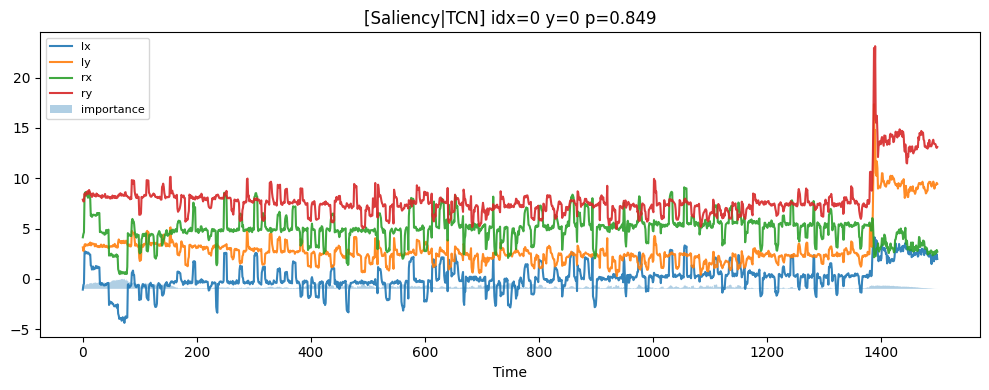

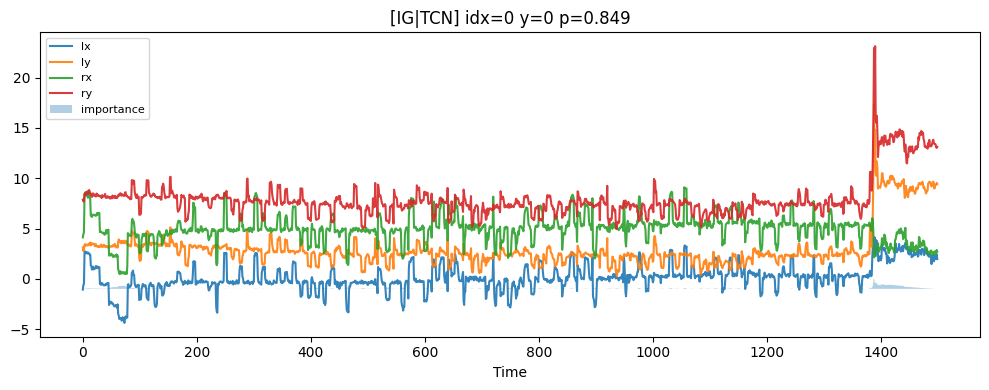

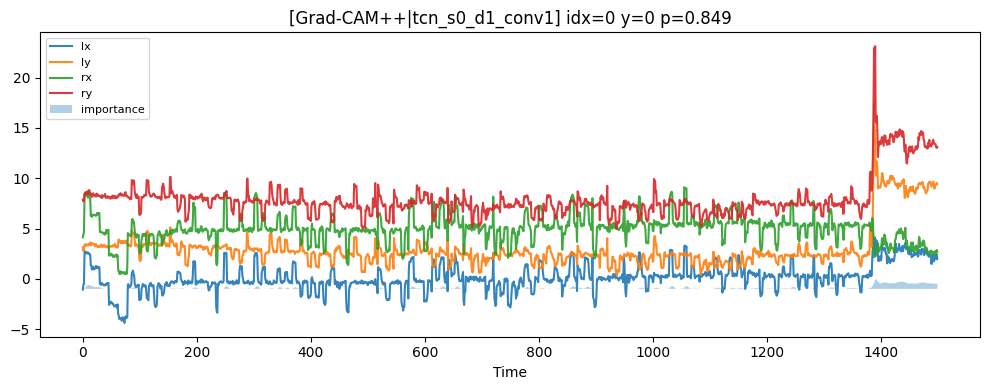

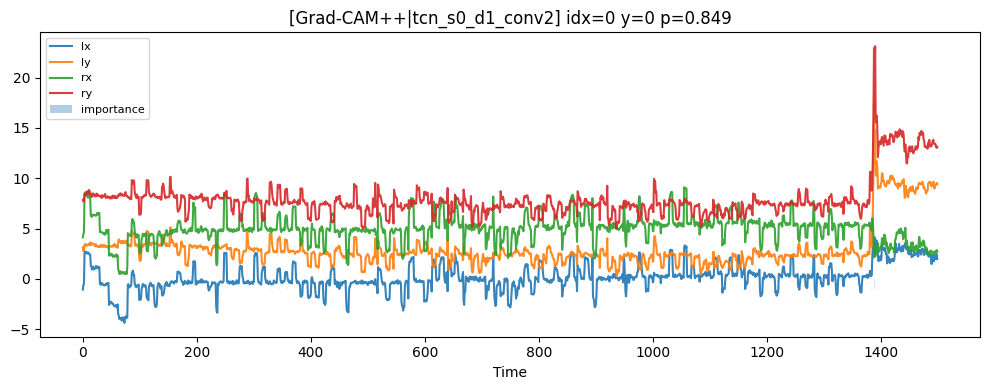

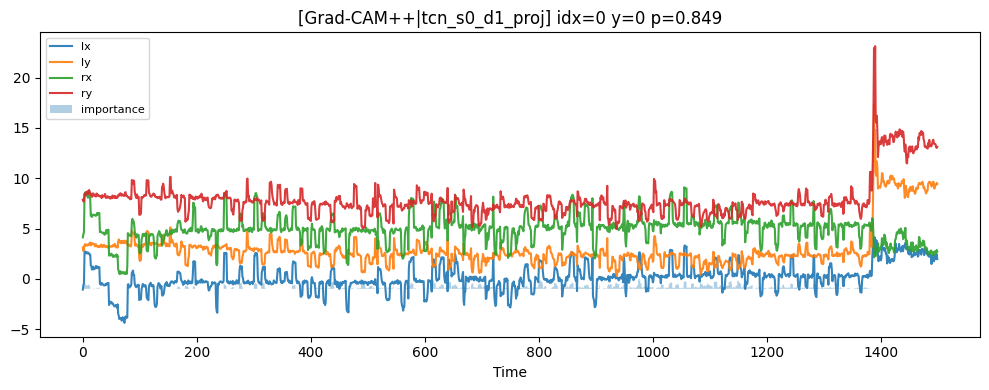

...

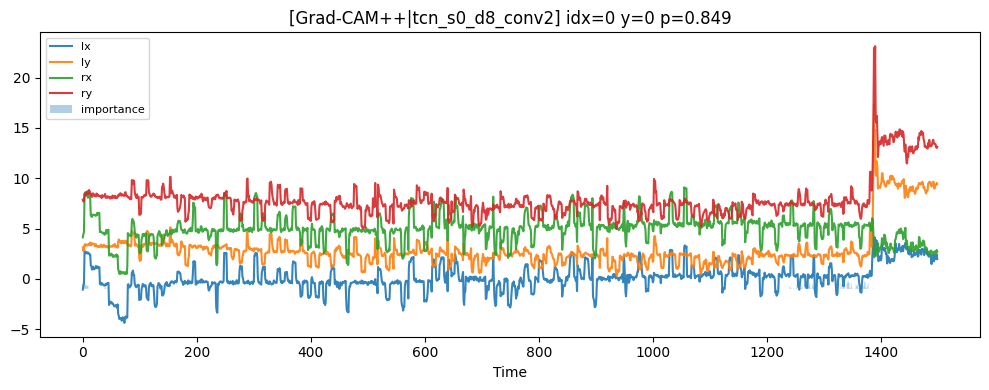

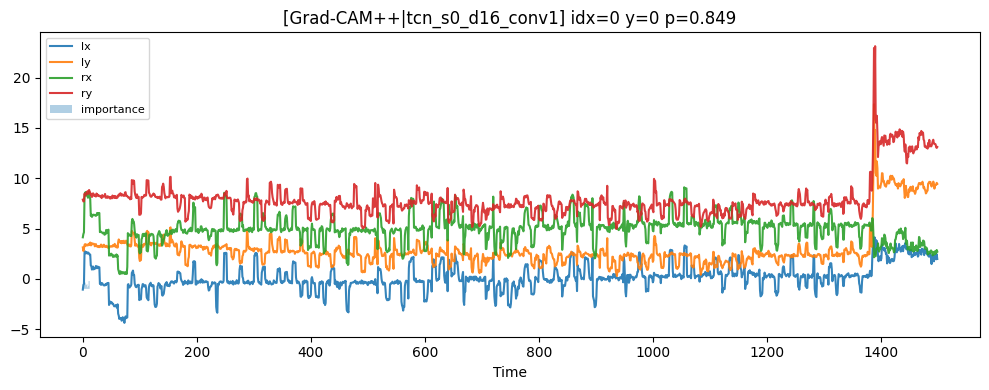

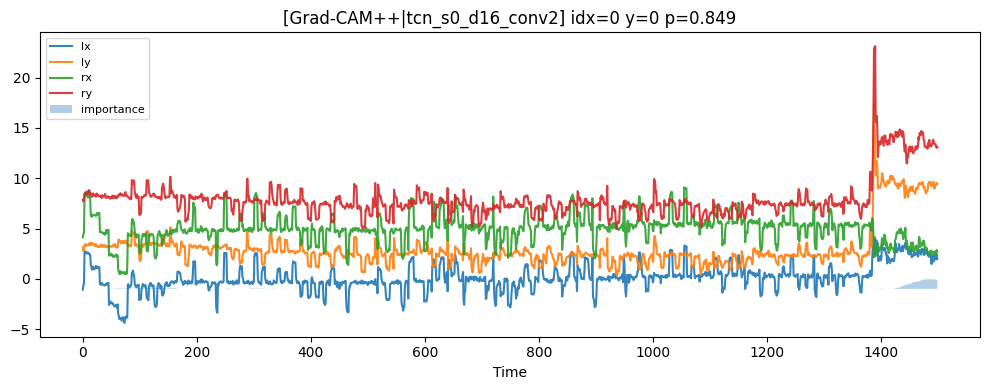

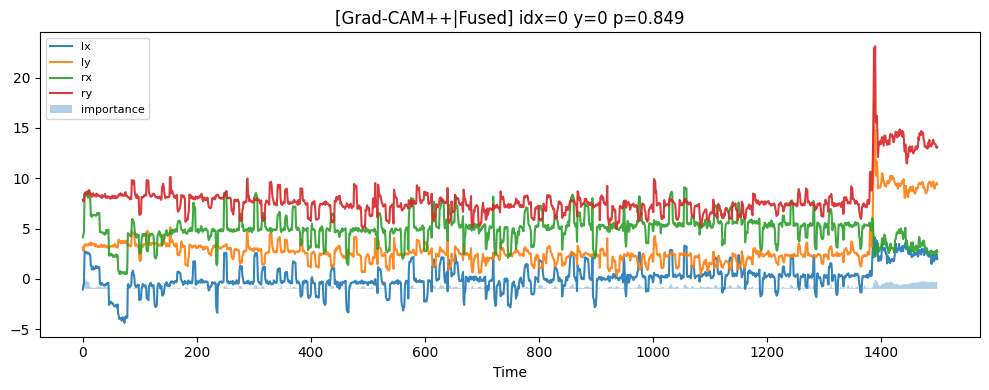

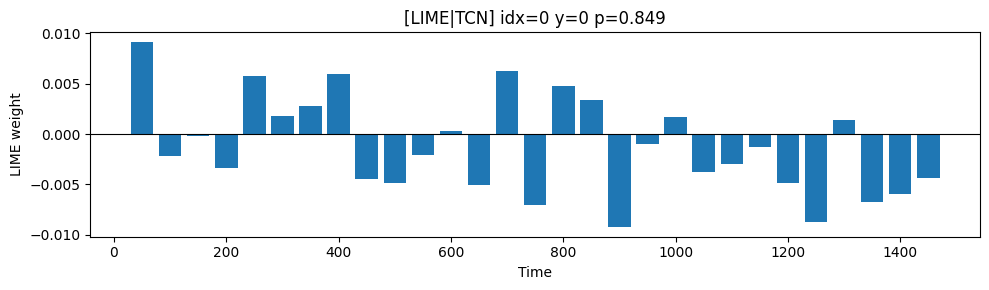

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); reshape fallback


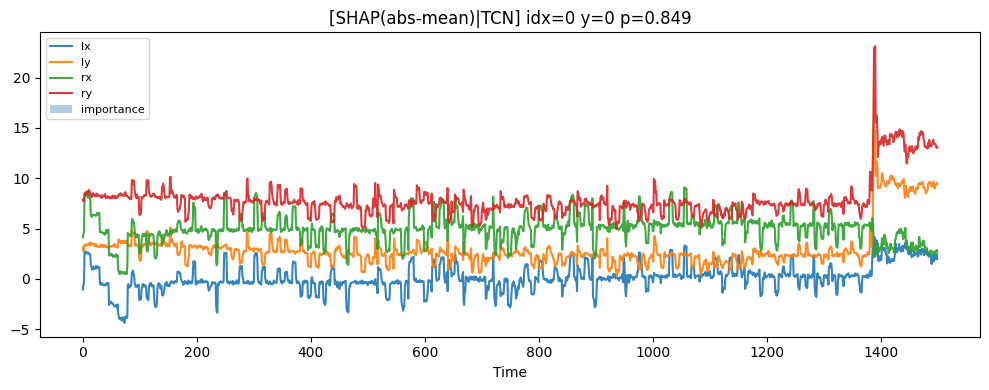

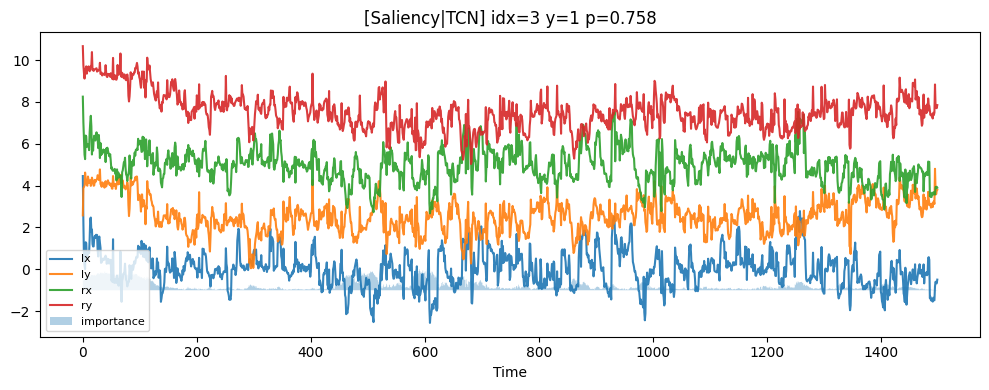

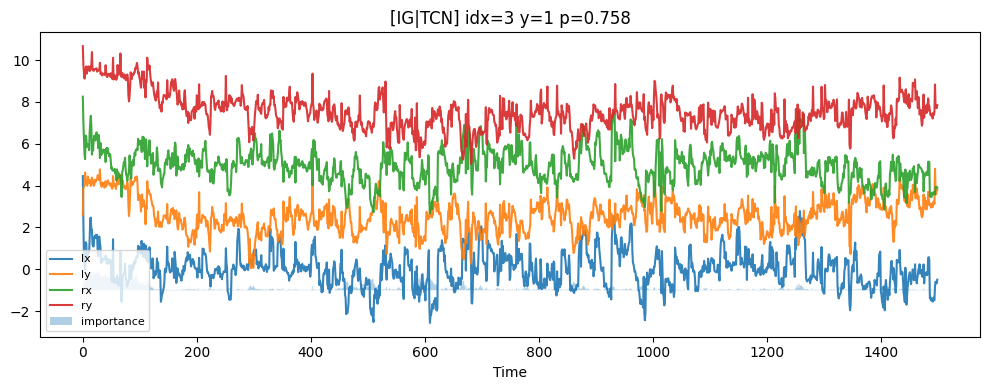

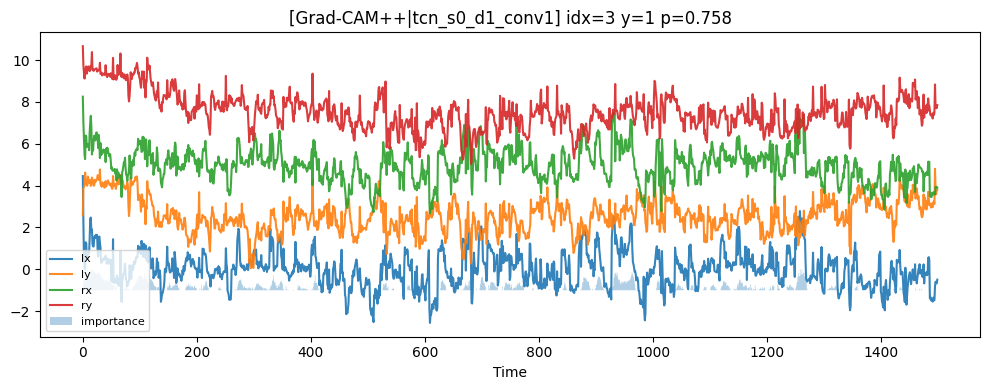

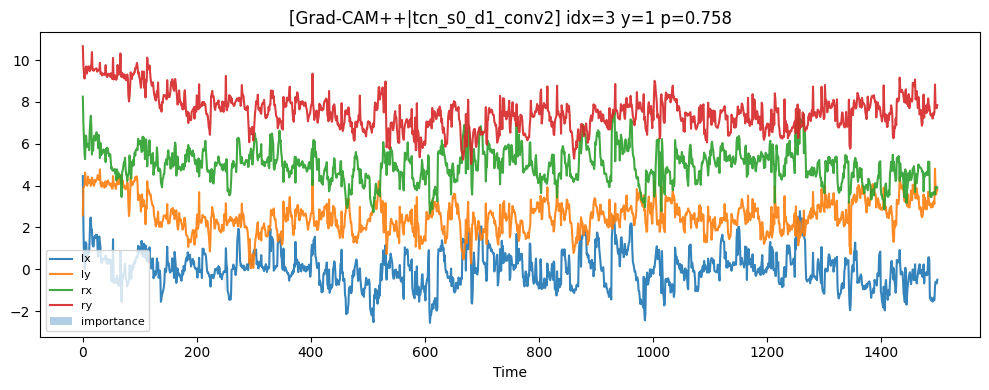

...

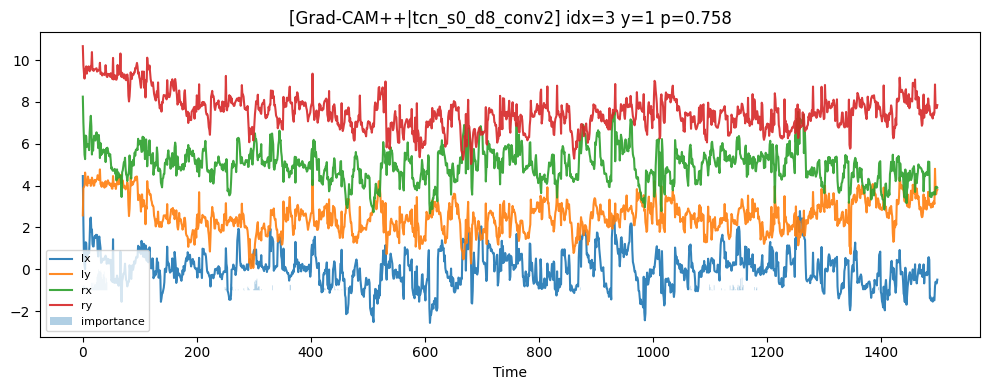

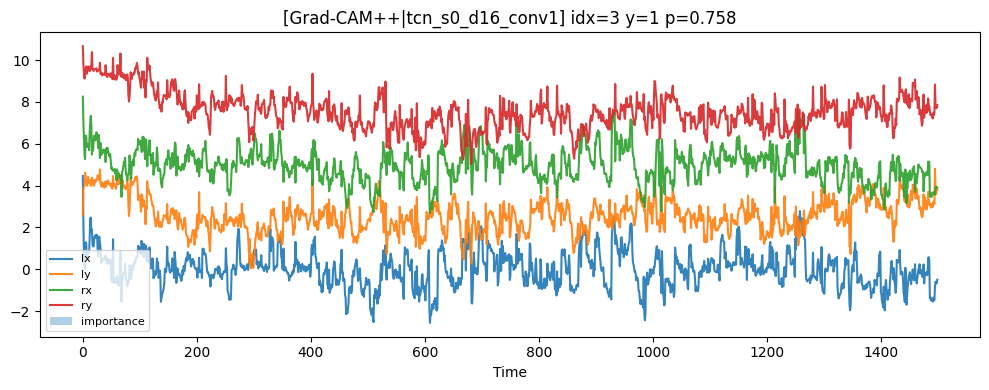

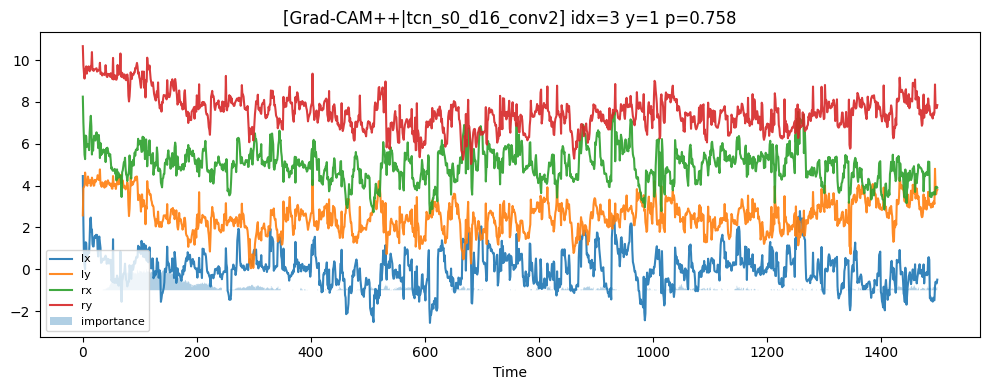

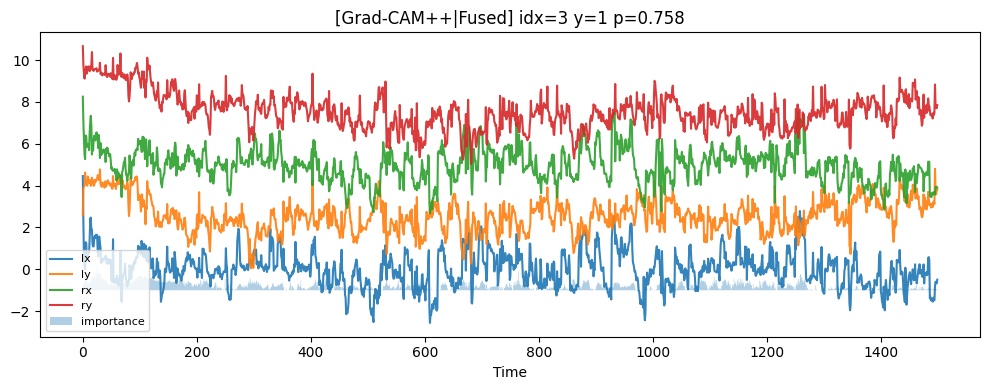

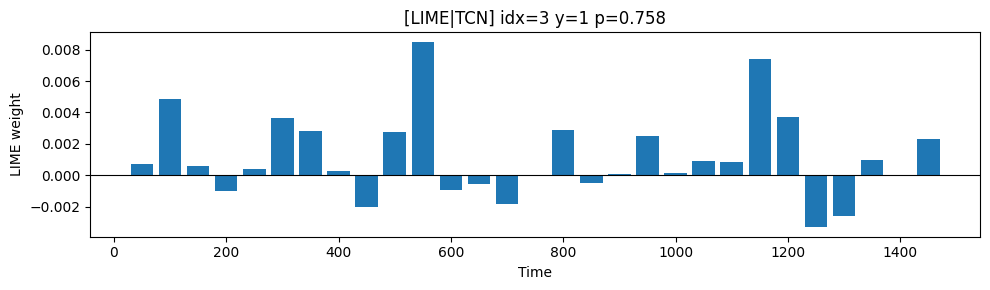

  0%|          | 0/1 [00:00<?, ?it/s]

/Users/wukehui/anaconda3/lib/python3.11/site-packages/shap/explainers/_kernel.py:708: UserWarning: Linear regression equation is singular, a least squares solutions is used instead.
To avoid this situation and get a regular matrix do one of the following:
1) turn up the number of samples,
2) turn up the L1 regularization with num_features(N) where N is less than the number of samples,
3) group features together to reduce the number of inputs that need to be explained.
  warnings.warn(


[WARN] Unexpected SHAP shape: (1, 6000, 1); reshape fallback


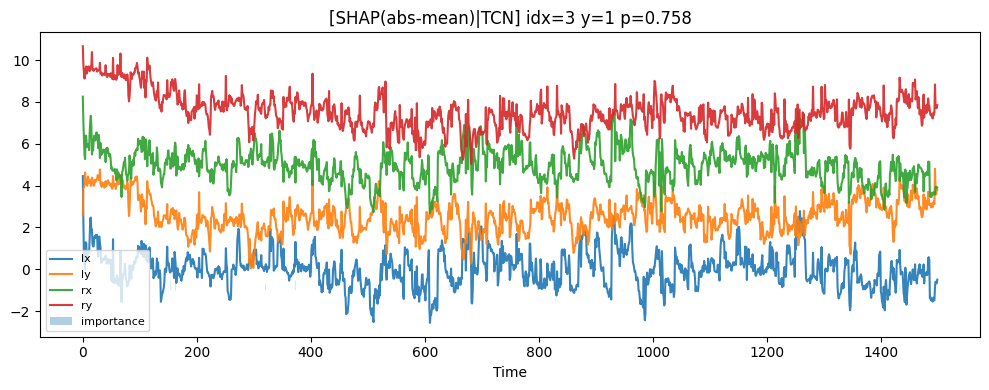

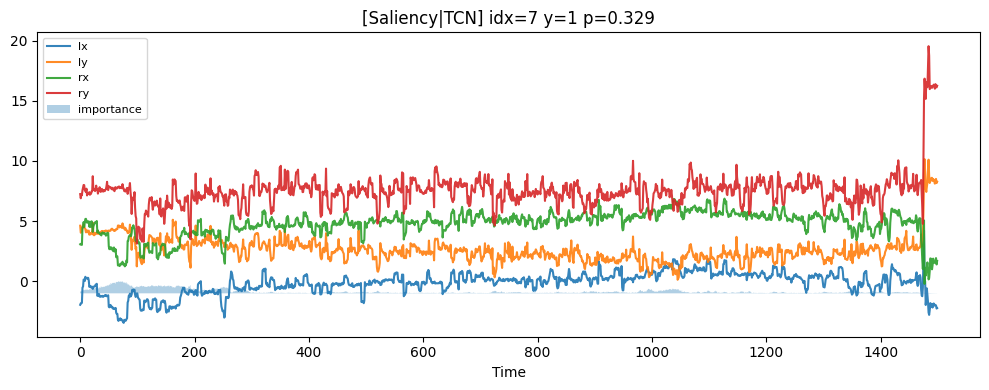

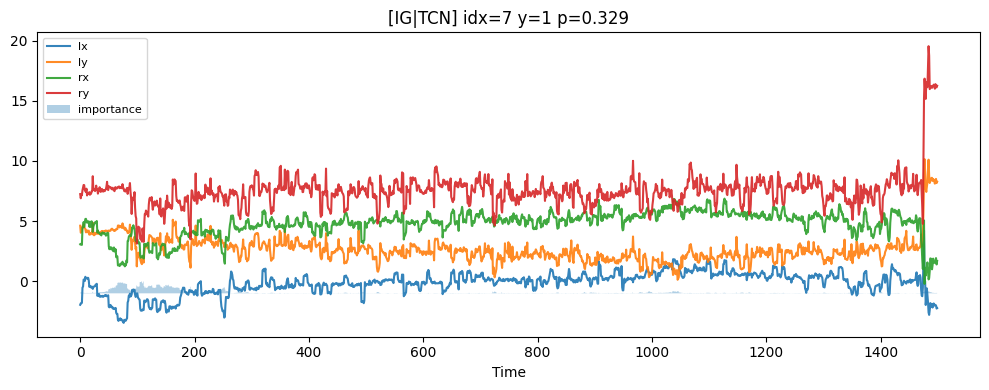

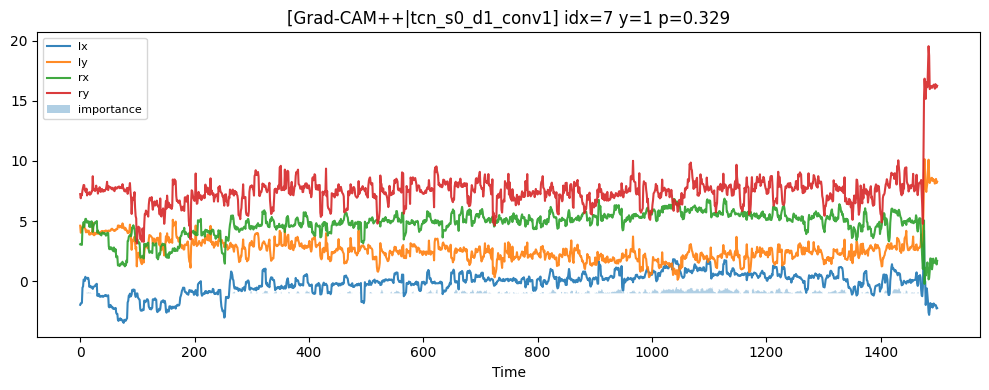

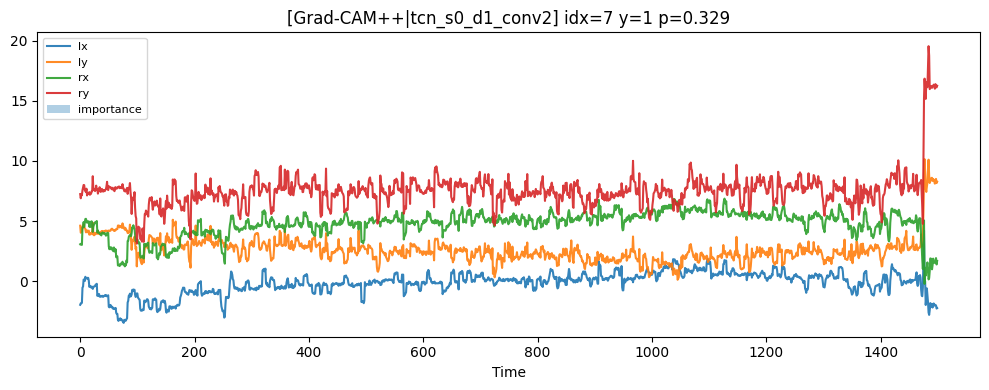

...

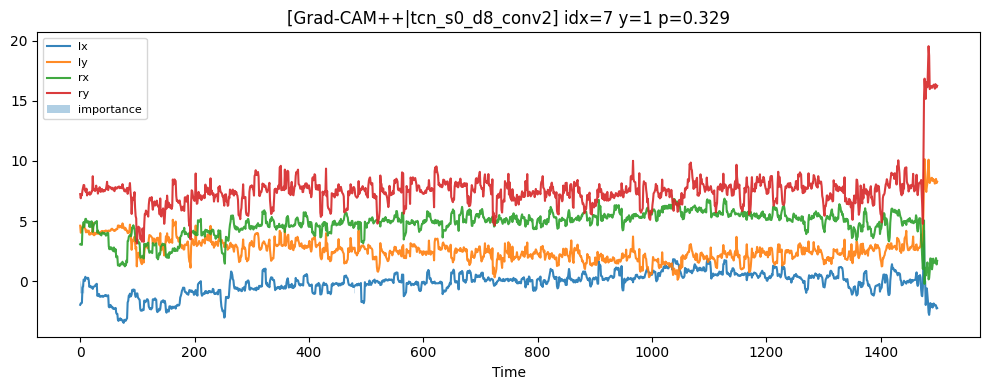

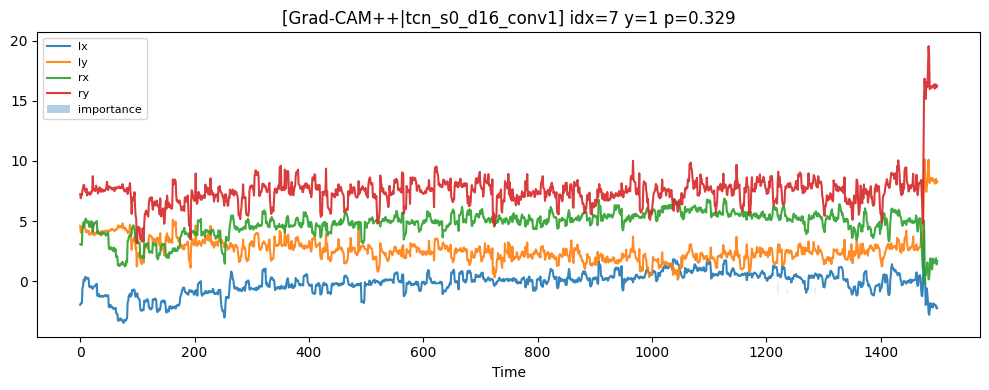

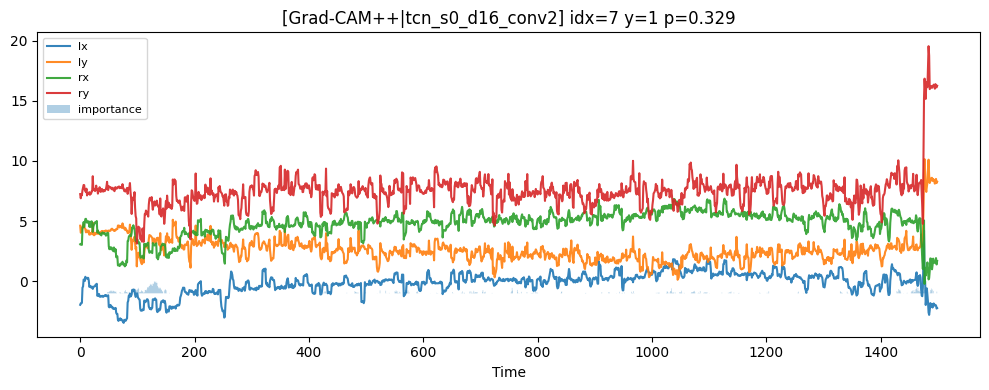

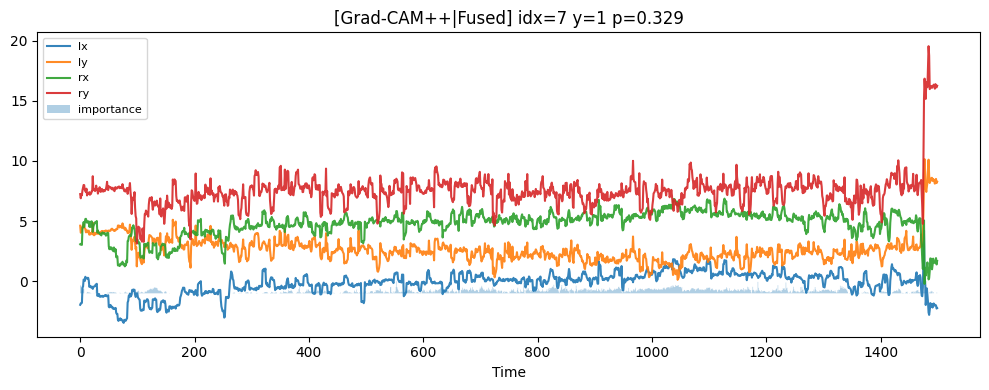

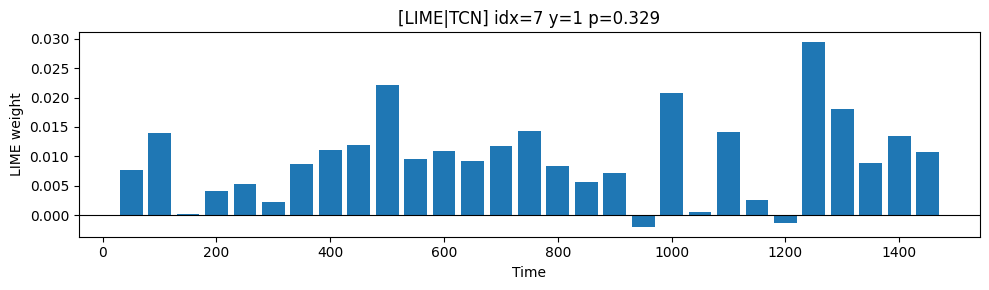

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); reshape fallback


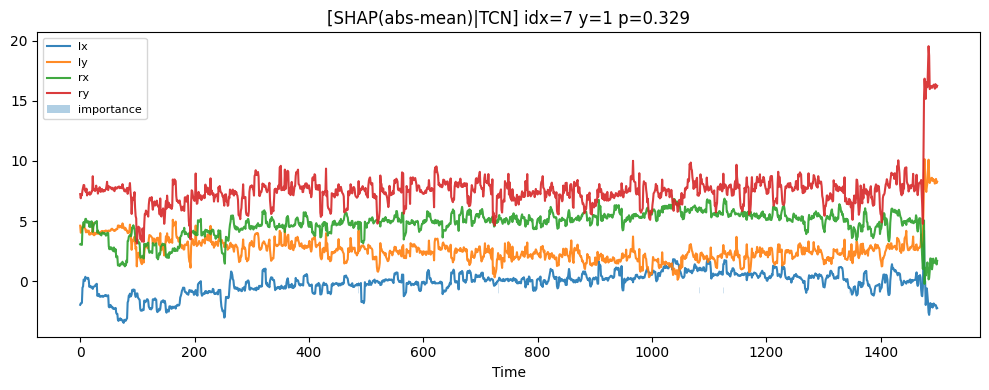

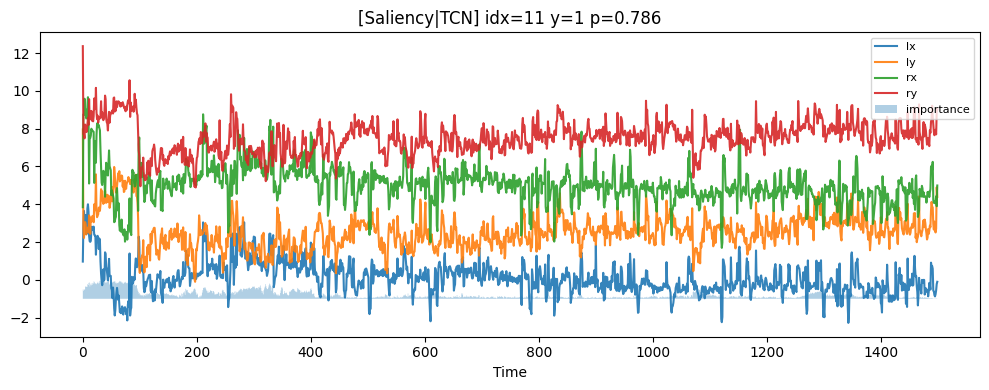

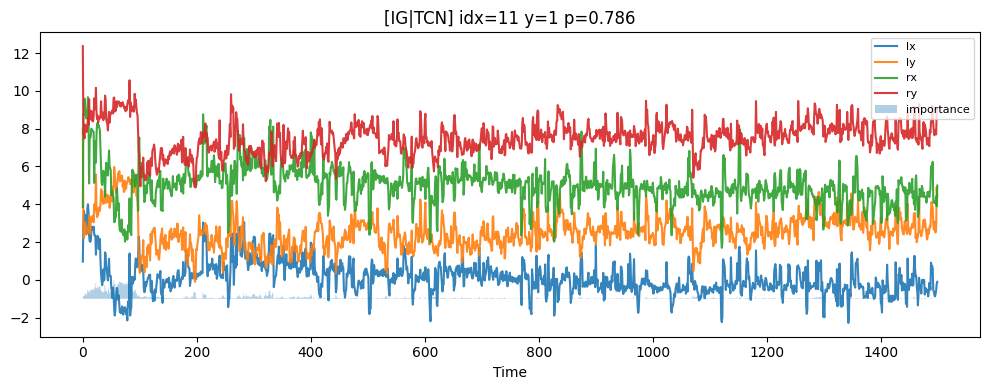

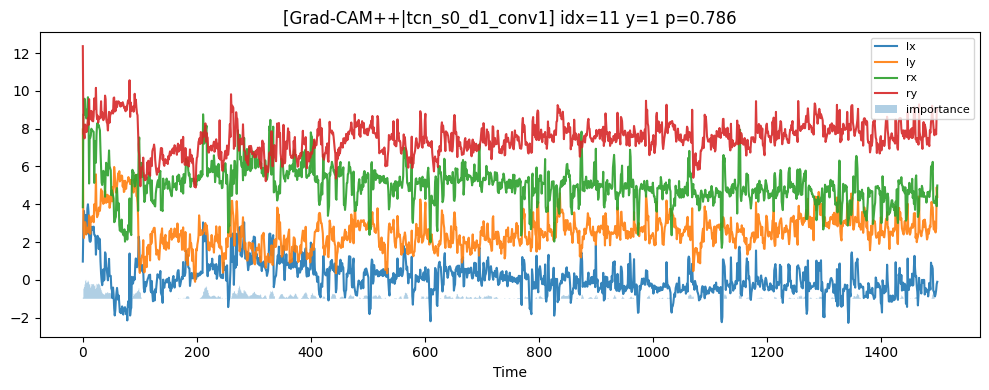

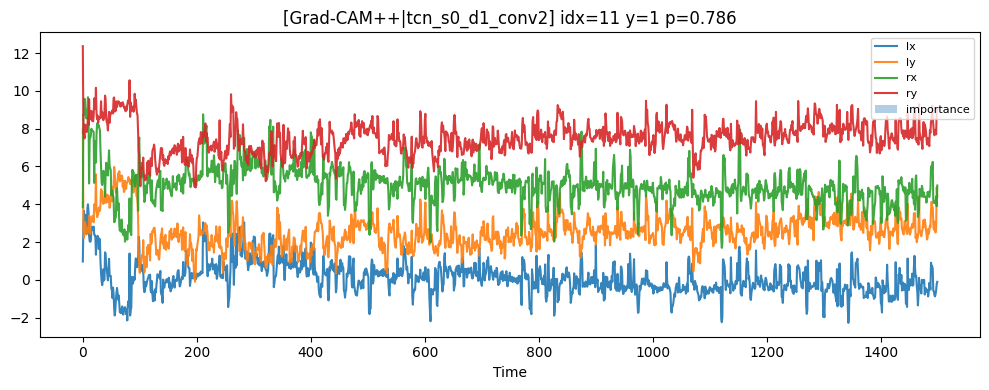

...

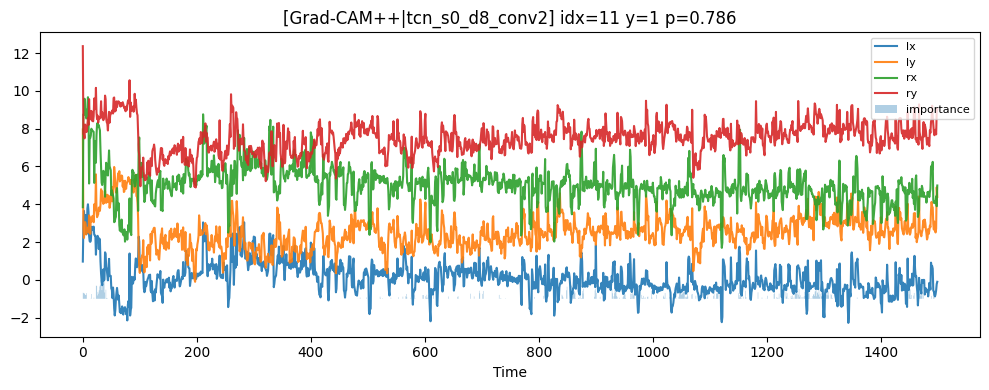

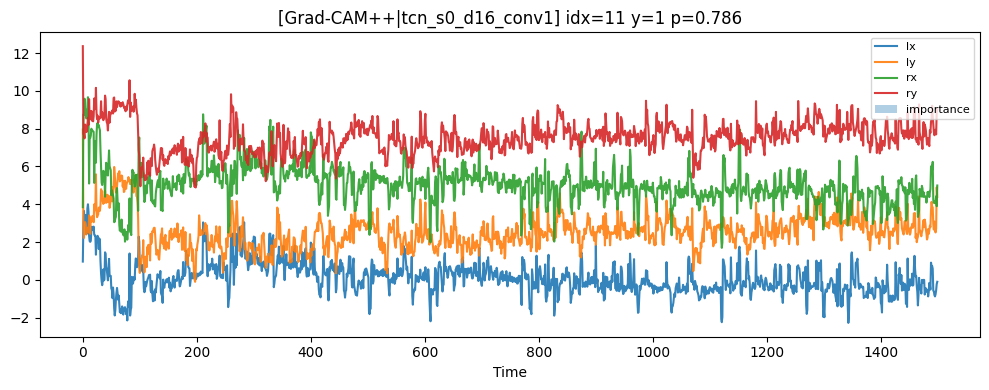

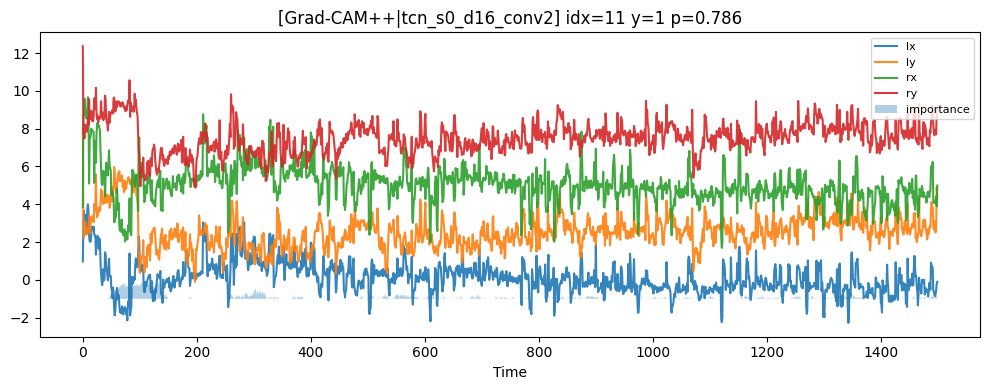

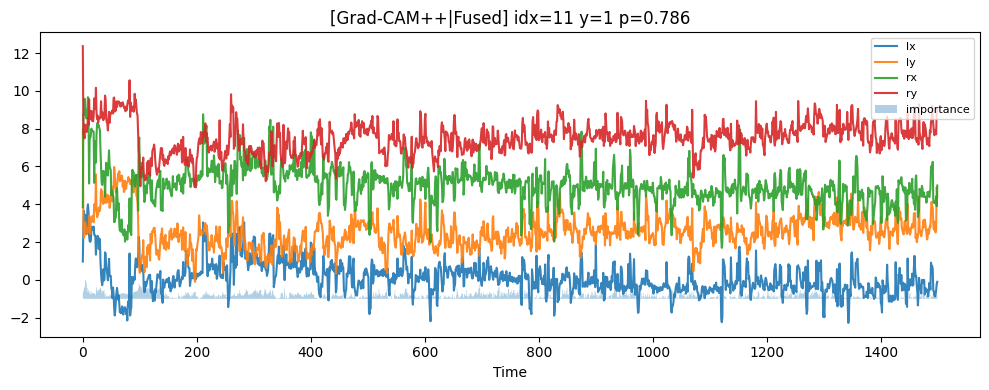

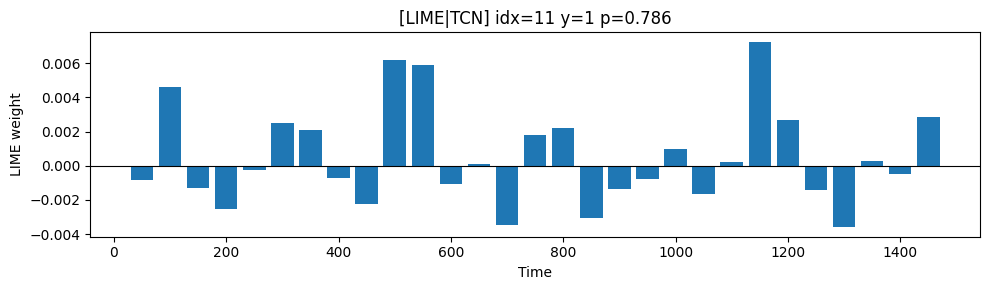

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); reshape fallback


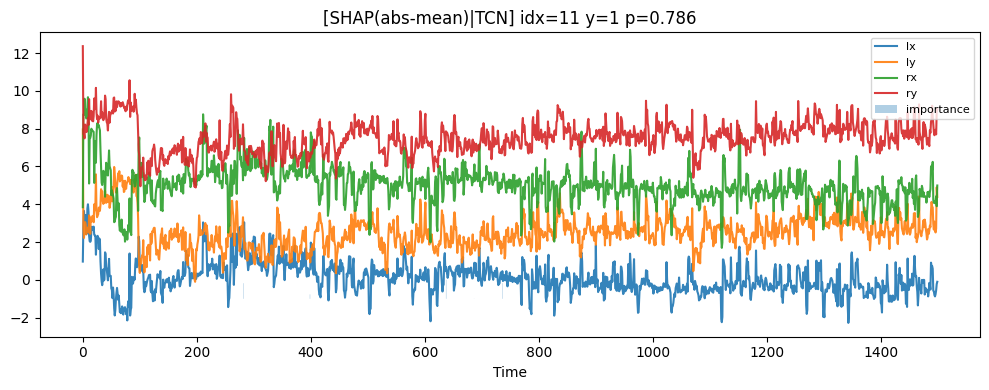

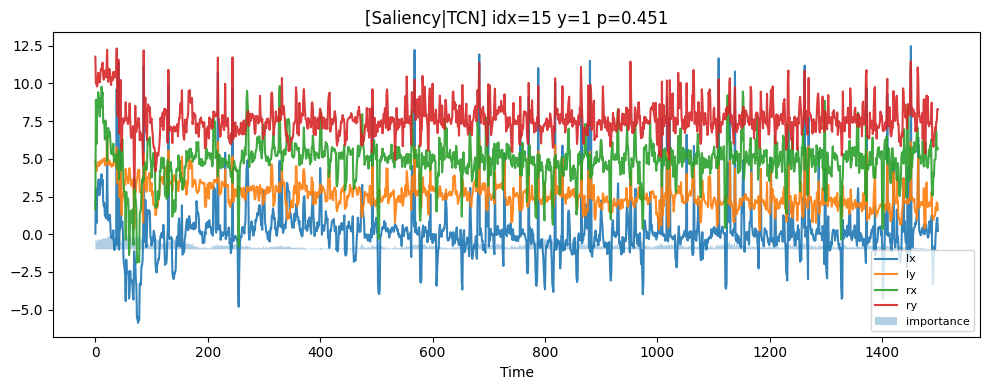

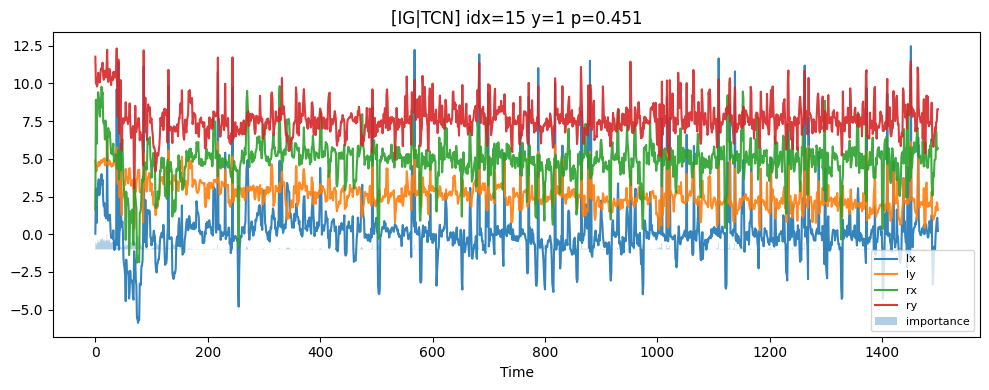

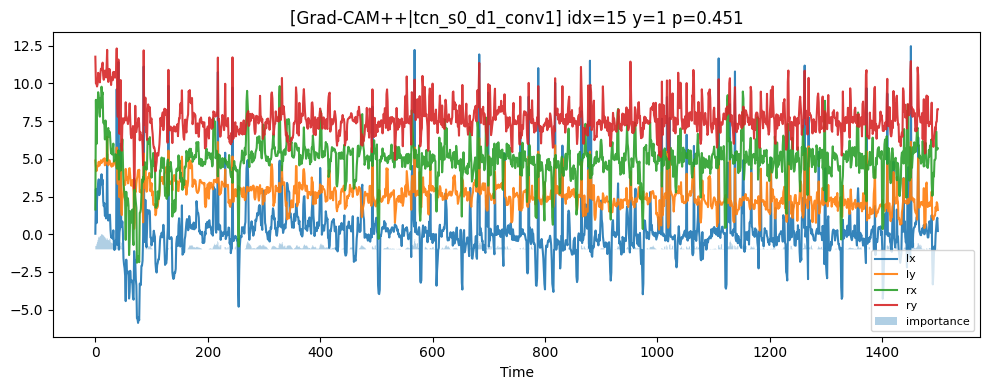

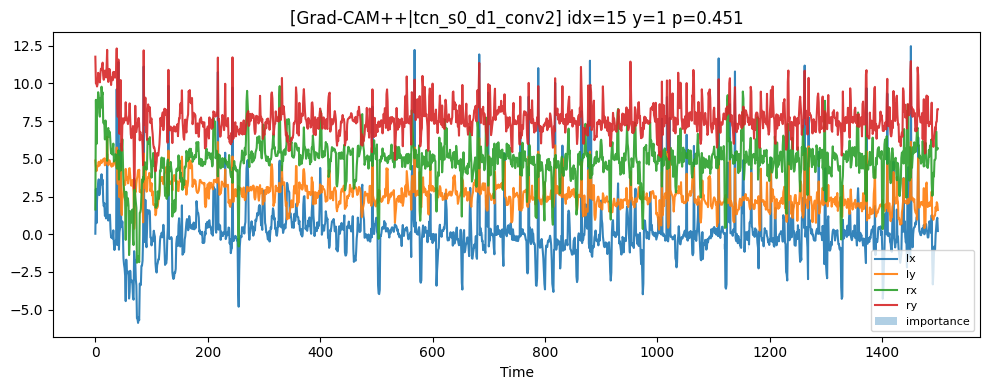

...

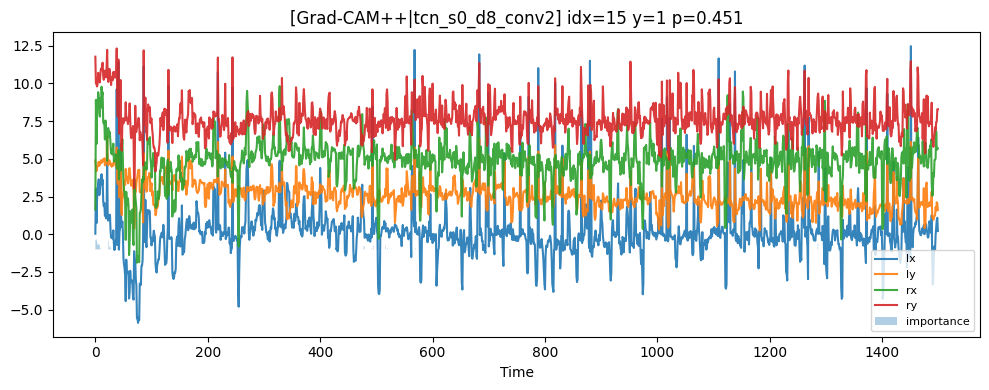

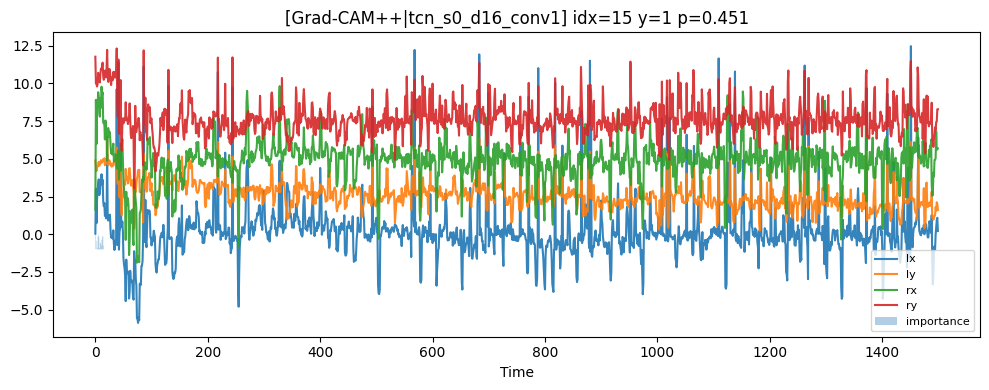

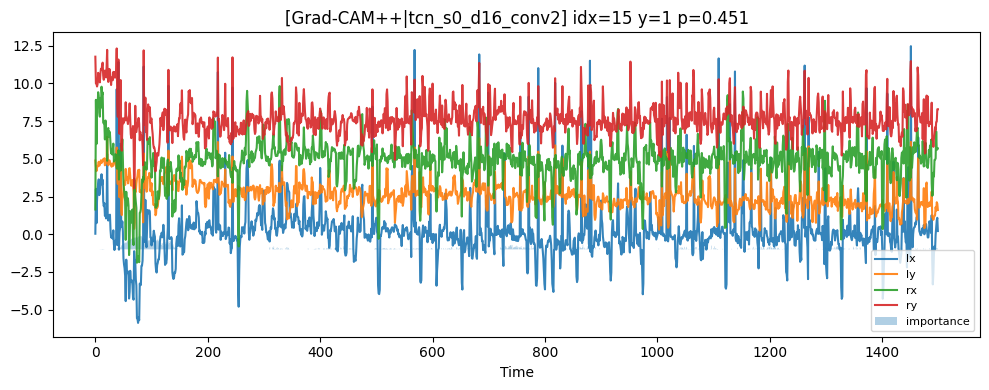

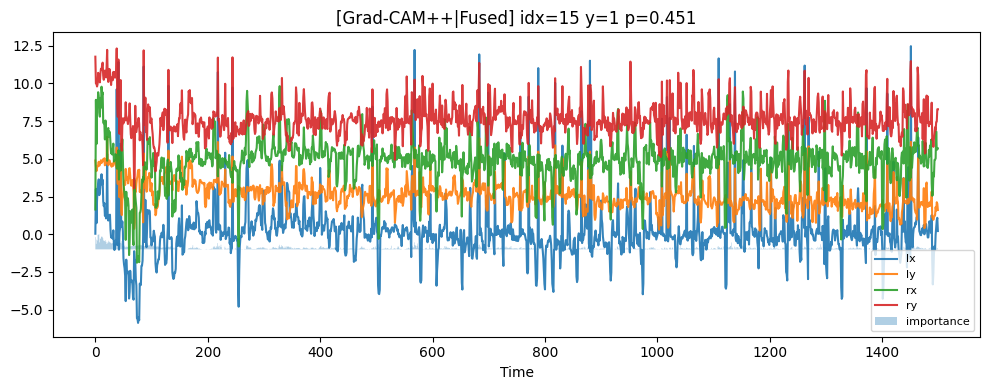

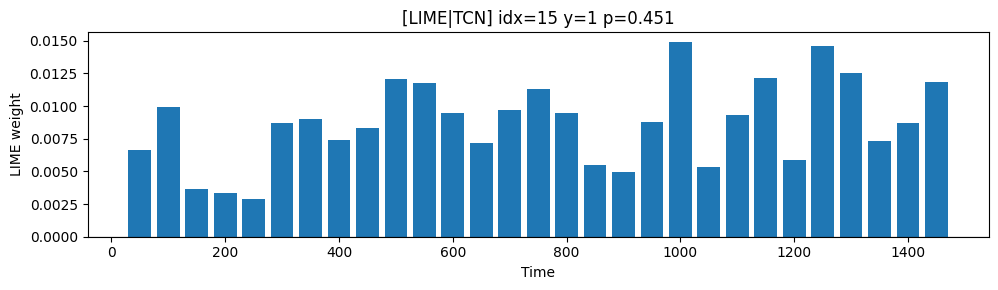

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); reshape fallback


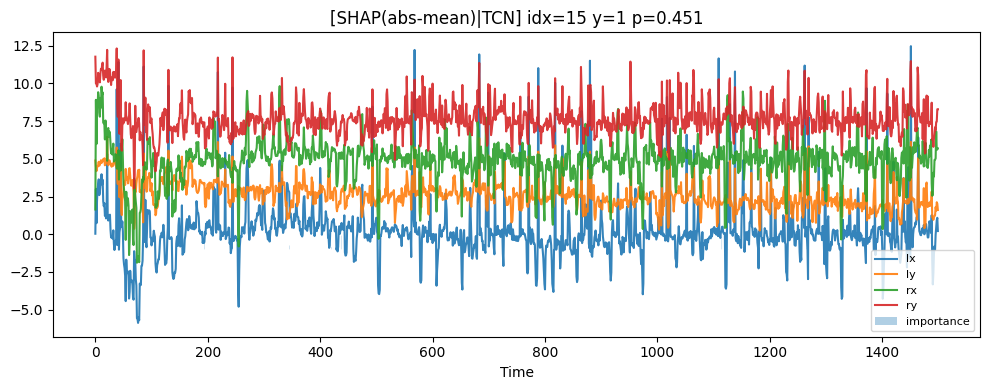

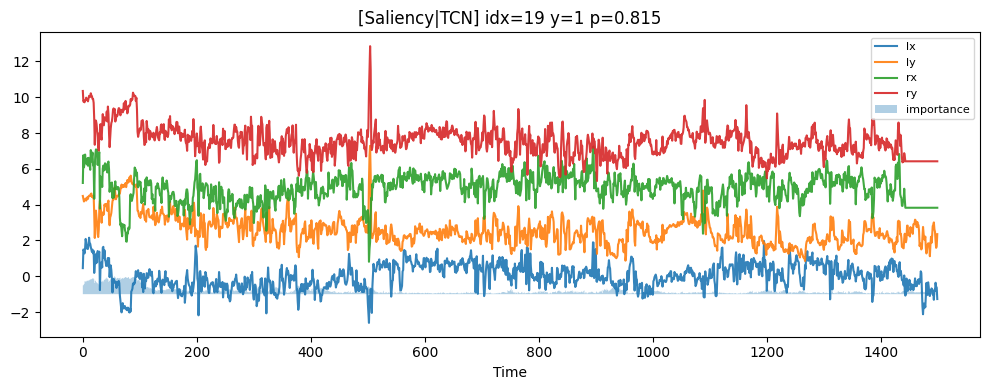

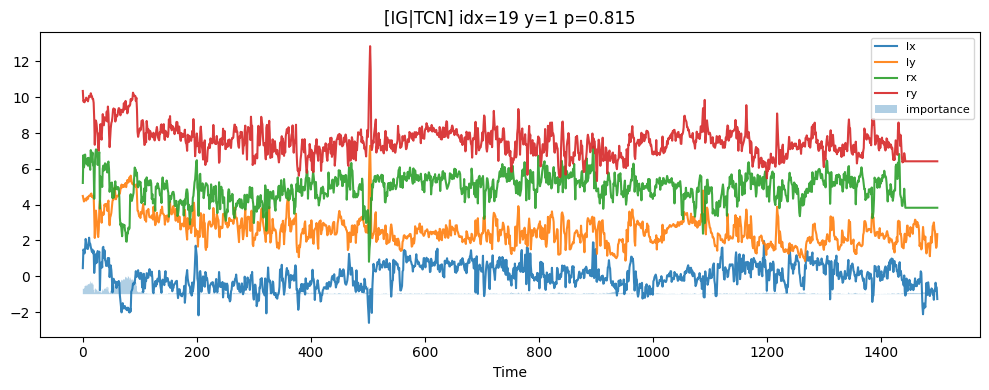

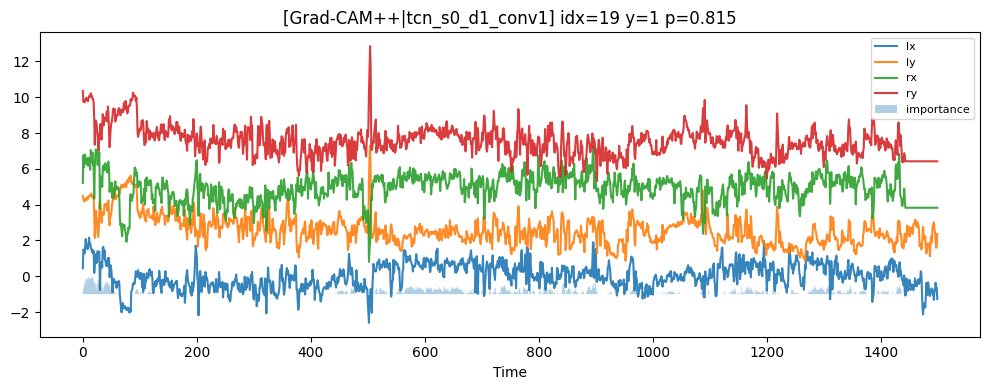

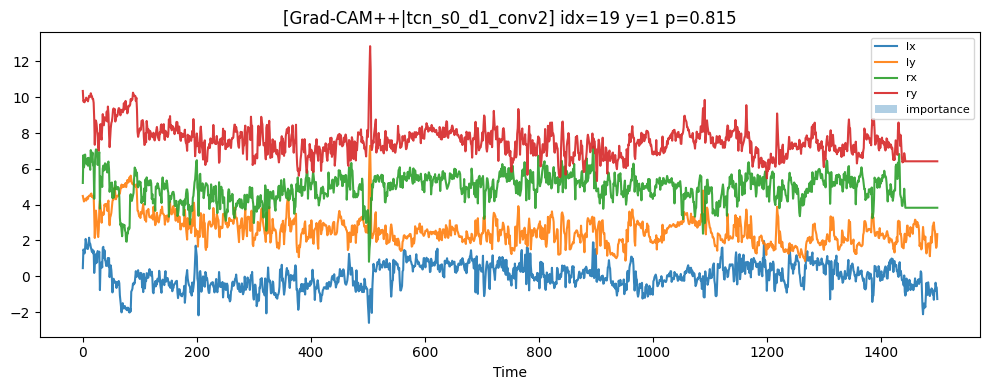

...

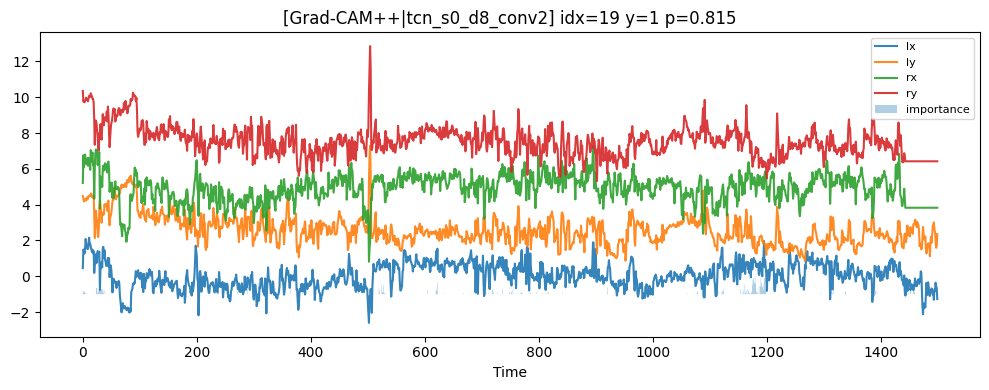

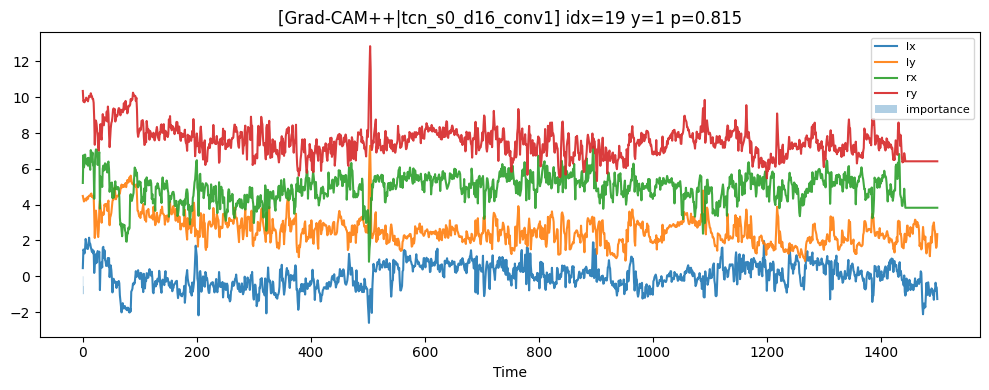

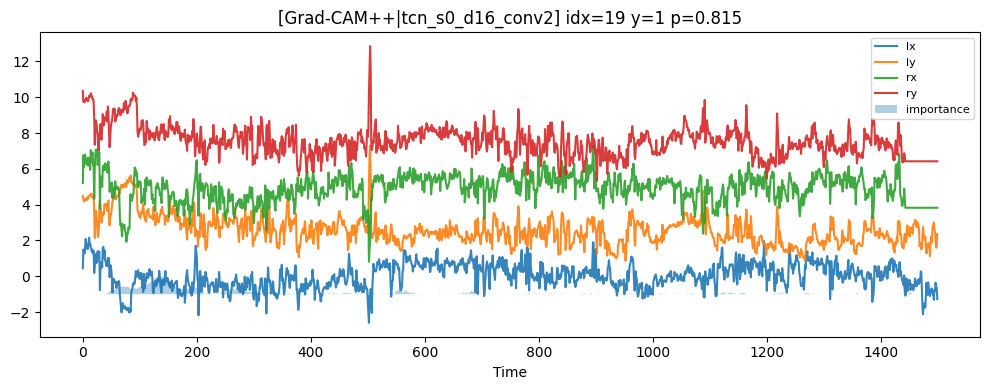

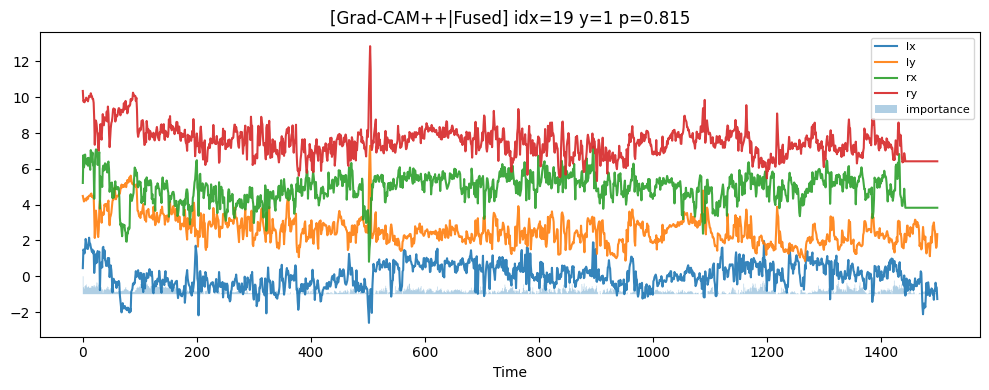

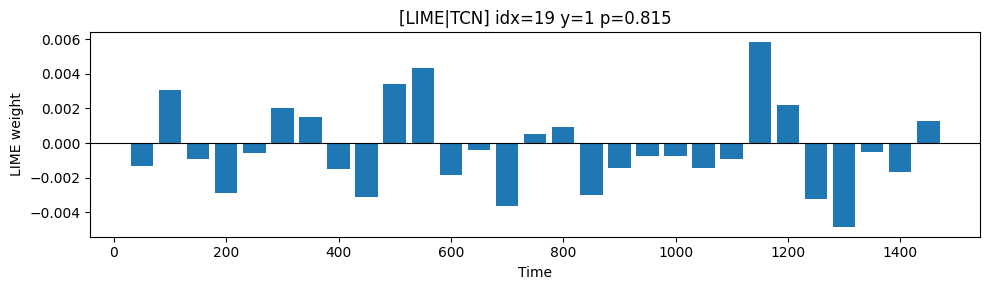

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); reshape fallback


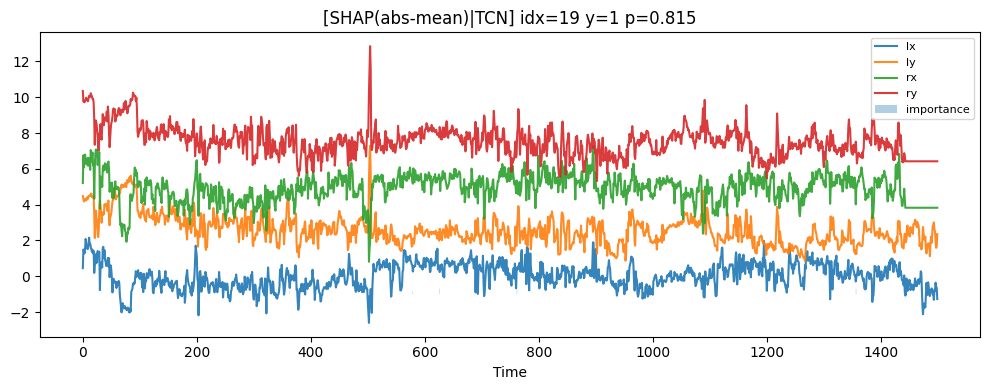

TCN XAI suite finished.


In [52]:
"""
XAI suite for TCN (Temporal Convolutional Network, single-branch on 4 channels)
Methods:
  - Saliency (vanilla grads)
  - Integrated Gradients
  - Grad-CAM++ (for 1D Conv in TCN residual blocks; auto-pick last Conv1D)
  - LIME (window perturbation)
  - SHAP (KernelExplainer only, stable)

Notes:
  - Input (T, 4). All heatmaps are normalized and interpolated back to length T for easy stacking and visualization.
  - If conv_layer_names is not passed, the "last Conv1D" in the model will be automatically found. Alternatively, a list such as ['tcn_b3_conv2', ...] can be passed for layer-by-layer visualization, and 'fused' fusion can be provided. 
"""

import numpy as np, tensorflow as tf, matplotlib.pyplot as plt
from typing import Optional, Tuple, Dict, List
from tensorflow.keras import Model, layers

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Training a TCN classifier for XAI
def train_tcn_for_xai(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    # TCN hyperparameters (must be consistent with the construction function)
    n_filters: int = 64,
    kernel_size: int = 7,
    dilations: List[int] = (1,2,4,8,16),
    nb_stacks: int = 1,
    dropout: float = 0.1,
    use_ln: bool = False
):
    # Data
    X, y, files = load_pair_experiment(
        csv_dir, label_pair,
        resample_len=target_len, max_nan_ratio=0.05,
        divide_by_960=True, use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    # Model
    extractor = build_tcn_extractor(
        (target_len, 4),
        n_filters=n_filters, kernel_size=kernel_size,
        dilations=list(dilations), nb_stacks=nb_stacks,
        dropout=dropout, use_ln=use_ln
    )
    model = build_classifier_from_extractor_tcn(extractor)
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])
    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    class_weight = compute_class_weight(ytr)
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1,
              callbacks=cbs, class_weight=class_weight)
    return model, (Xtr,ytr,Xva,yva,Xte,yte), files, splits

# Saliency
def saliency_tcn(model: Model, x: np.ndarray) -> np.ndarray:
    xt = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)
    with tf.GradientTape() as tape:
        tape.watch(xt)
        y = model(xt, training=False)
    g = tape.gradient(y, xt).numpy()[0]  # (T,C)
    return np.abs(g).astype(np.float32)

# Integrated Gradients
def integrated_gradients_tcn(model: Model, x: np.ndarray, steps: int = 64, baseline: Optional[np.ndarray]=None) -> np.ndarray:
    if baseline is None:
        baseline = np.zeros_like(x, dtype=np.float32)
    xt = tf.convert_to_tensor(x[None,...], tf.float32)
    bt = tf.convert_to_tensor(baseline[None,...], tf.float32)
    alphas = tf.reshape(tf.linspace(0., 1., steps+1)[1:], (-1,1,1))
    path = bt + alphas * (xt - bt)              # (steps,T,C)
    with tf.GradientTape() as tape:
        tape.watch(path)
        preds = model(path, training=False)
    grads = tape.gradient(preds, path)          # (steps,T,C)
    ig = tf.reduce_mean(grads, axis=0) * (xt - bt)[0]
    return tf.math.abs(ig).numpy().astype(np.float32)

# Grad‑CAM++ for 1D（TCN）
def _pick_conv_layers_for_tcn(model: Model, conv_layer_names: Optional[List[str]] = None) -> List[str]:
    """
    If no layer names are given explicitly: first look for the last few Conv1D layers whose names contain 'tcn'; otherwise fall back to the last Conv1D in the model.
    """
    if conv_layer_names:
        return conv_layer_names
    cand = [L.name for L in model.layers if isinstance(L, layers.Conv1D) and ('tcn' in L.name.lower())]
    if not cand:
        # Fallback: Take the last Conv1D
        for L in model.layers[::-1]:
            if isinstance(L, layers.Conv1D):
                cand = [L.name]; break
    return cand if cand else []

def _gradcampp_1d_on_layer(model: Model, x: np.ndarray, conv_layer: layers.Layer) -> np.ndarray:
    grad_model = Model([model.inputs], [conv_layer.output, model.output])
    xt = tf.convert_to_tensor(x[None,...], tf.float32)
    with tf.GradientTape(persistent=True) as t1:
        with tf.GradientTape(persistent=True) as t2:
            conv_out, y = grad_model(xt, training=False)   # conv_out: (1,T',K)
            y_c = y[:, 0]
        g1 = t2.gradient(y_c, conv_out)                    # (1,T',K)
    g2 = t1.gradient(y_c, conv_out)                        # (1,T',K)
    del t1, t2

    conv = conv_out.numpy()[0]   # (T',K)
    g1   = g1.numpy()[0]
    g2   = g2.numpy()[0]

    eps = 1e-8
    alpha_num = g1**2
    alpha_den = 2.0 * g1**2 + conv * g2
    alpha = np.divide(alpha_num, np.maximum(alpha_den, eps))
    weights = (alpha * np.maximum(g1, 0.0)).sum(axis=0)    # (K,)

    cam = np.maximum((conv * weights).sum(axis=1), 0.0)    # (T',)
    if cam.max() > 0: cam = cam / (cam.max() + 1e-8)

    # Upsample back to input length
    T = x.shape[0]
    if cam.shape[0] != T:
        src = np.linspace(0, 1, cam.shape[0], dtype=np.float32)
        dst = np.linspace(0, 1, T, dtype=np.float32)
        cam = np.interp(dst, src, cam)
    return cam.astype(np.float32)

def gradcampp_tcn(model: Model, x: np.ndarray, conv_layer_names: Optional[List[str]] = None, fuse: str = "mean") -> Dict[str, np.ndarray]:
    """
    Returns {'<layer>': (T,), ..., 'fused': (T,), 'layers': [names...]}
    """
    layer_names = _pick_conv_layers_for_tcn(model, conv_layer_names)
    if not layer_names:
        raise ValueError("No Conv1D layer found for Grad-CAM++ in this model.")
    cams = {}
    for nm in layer_names:
        layer = model.get_layer(nm)
        cams[nm] = _gradcampp_1d_on_layer(model, x, layer)

    # Fusion
    A = np.stack([v/(v.max()+1e-8) if v.max()>0 else v for v in cams.values()], axis=0)  # (B,T)
    if fuse == "sum":
        fused = A.sum(axis=0)
    elif fuse == "max":
        fused = A.max(axis=0)
    else:
        fused = A.mean(axis=0)
    fused = fused / (fused.max() + 1e-8)
    cams['fused'] = fused.astype(np.float32)
    cams['layers'] = layer_names
    return cams

# LIME (Sliding Window Perturbation)
def lime_timeseries_explain(model: Model, x: np.ndarray, window=100, stride=50, n_samples=600, fill=0.0, seed=SEED):
    T, C = x.shape
    wins = []
    t0 = 0
    while t0 < T:
        t1 = min(t0 + window, T); wins.append((t0, t1))
        if t1 == T: break
        t0 += stride
    W = len(wins)
    y0 = float(model.predict(x[None,...], verbose=0).ravel()[0])
    rng = np.random.default_rng(seed)
    Z = rng.integers(0, 2, size=(n_samples, W), endpoint=True)
    y = np.zeros((n_samples,), dtype=np.float32)
    x_fill = np.full_like(x, fill, dtype=np.float32)
    for i in range(n_samples):
        xi = x.copy()
        for j, flag in enumerate(Z[i]):
            if flag == 1:
                a,b = wins[j]; xi[a:b,:] = x_fill[a:b,:]
        y[i] = float(model.predict(xi[None,...], verbose=0).ravel()[0])
    lam = 1e-3
    A = Z.astype(np.float32); b = (y - y0).astype(np.float32)
    beta = np.linalg.solve(A.T @ A + lam*np.eye(W, dtype=np.float32), A.T @ b)
    centers = np.array([(a+b)//2 for (a,b) in wins], dtype=int)
    return centers, beta

# SHAP (KernelExplainer, more stable)
def shap_explain_kernel_tcn(model: Model, X_background: np.ndarray, X_samples: np.ndarray,
                            max_bg: int = 64, nsamples: int = 200):
    try:
        import shap
    except ImportError:
        print("[WARN] shap not installed; skip SHAP.")
        return None
    if X_samples.ndim == 2:
        X_samples = X_samples[None, ...]
    assert X_samples.ndim == 3 and X_background.ndim == 3, "expect (n,T,C)"
    Xbg = X_background[:max_bg].astype(np.float32, copy=False)
    Xsm = X_samples.astype(np.float32, copy=False)
    n, T, C = Xsm.shape
    bg2 = Xbg.reshape((Xbg.shape[0], T*C))
    X2  = Xsm.reshape((n, T*C))
    def f_2d(Z2):
        Z3 = np.asarray(Z2, dtype=np.float32).reshape((-1, T, C))
        y  = model.predict(Z3, verbose=0).reshape(-1, 1)
        return y
    explainer = shap.KernelExplainer(f_2d, bg2)
    sv = explainer.shap_values(X2, nsamples=nsamples)
    if isinstance(sv, list): sv = sv[0]
    sv = np.asarray(sv)
    if sv.ndim == 1 and sv.size == T*C:
        sv = sv.reshape(1, T, C)
    elif sv.ndim == 2 and sv.shape[1] == T*C:
        sv = sv.reshape(sv.shape[0], T, C)
    elif sv.ndim == 3 and sv.shape[1:] == (T, C):
        pass
    else:
        print(f"[WARN] Unexpected SHAP shape: {sv.shape}; reshape fallback")
        sv = sv.reshape(-1, T, C)
    return sv.astype(np.float32, copy=False)

# Visualisation
def plot_timeseries_with_heat(x: np.ndarray, heat_1d: np.ndarray, title: str, ch_names=('lx','ly','rx','ry')):
    T, C = x.shape
    h = np.asarray(heat_1d).squeeze()
    # Projection is T length
    if h.ndim == 2 and h.shape[0] == T:
        h = np.abs(h).mean(axis=1)
    if h.size == T*C:
        h = np.abs(h.reshape(T, C)).mean(axis=1)
    elif h.size != T:
        src = np.linspace(0, 1, h.size); dst = np.linspace(0, 1, T)
        h = np.interp(dst, src, h)

    plt.figure(figsize=(10,4))
    shift = 0.0
    for c in range(C):
        plt.plot(x[:,c] + shift, alpha=0.9, label=ch_names[c] if c<len(ch_names) else f'ch{c}')
        shift += 2.5
    h_norm = h / (h.max() + 1e-8)
    plt.fill_between(np.arange(T), -1.0, -1.0 + h_norm, alpha=0.35, step='pre', label='importance')
    plt.title(title); plt.xlabel("Time"); plt.legend(fontsize=8); plt.tight_layout(); plt.show()

def plot_bar_over_windows(centers: np.ndarray, weights: np.ndarray, title: str):
    plt.figure(figsize=(10,3))
    w = max(1, int(0.8*(centers[1]-centers[0]))) if len(centers)>1 else 5
    plt.bar(centers, weights, width=w); plt.axhline(0, color='k', lw=0.8)
    plt.title(title); plt.xlabel("Time"); plt.ylabel("LIME weight"); plt.tight_layout(); plt.show()

# One-click entry
def run_xai_suite_tcn(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    sample_source: str = 'val',
    n_samples: int = 6,
    conv_layer_names: Optional[List[str]] = None,  # For example, ['tcn_block3_conv2']; None = automatic search
    enable_shap: bool = True,
    shap_bg_max: int = 64,
    shap_nsamples: int = 200,
    # TCN hyperparameters (must be consistent with the builder to facilitate retraining)
    n_filters: int = 64, kernel_size: int = 7,
    dilations: List[int] = (1,2,4,8,16), nb_stacks: int = 1,
    dropout: float = 0.1, use_ln: bool = False
):
    # 1) Train TCN
    model, (Xtr,ytr,Xva,yva,Xte,yte), files, splits = train_tcn_for_xai(
        csv_dir, label_pair, target_len=target_len,
        n_filters=n_filters, kernel_size=kernel_size,
        dilations=list(dilations), nb_stacks=nb_stacks,
        dropout=dropout, use_ln=use_ln
    )
    Xs, ys = (Xva, yva) if sample_source == 'val' else (Xte, yte)
    idxs = np.linspace(0, len(ys)-1, num=min(n_samples, len(ys)), dtype=int)

    # 2) SHAP Background
    Xbg = Xtr[: min(shap_bg_max, len(Xtr))]

    for i in idxs:
        x = Xs[i]; y_true = int(ys[i])
        y_pred = float(model.predict(x[None,...], verbose=0).ravel()[0])

        # (a) Saliency
        sal = saliency_tcn(model, x)
        plot_timeseries_with_heat(x, sal, title=f"[Saliency|TCN] idx={i} y={y_true} p={y_pred:.3f}")

        # (b) Integrated Gradients
        ig = integrated_gradients_tcn(model, x, steps=64)
        plot_timeseries_with_heat(x, ig, title=f"[IG|TCN] idx={i} y={y_true} p={y_pred:.3f}")

        # (c) Grad-CAM++ (multi-layer + fusion)
        cams = gradcampp_tcn(model, x, conv_layer_names=conv_layer_names, fuse='mean')
        for lname in cams.get('layers', []):
            plot_timeseries_with_heat(x, cams[lname], title=f"[Grad-CAM++|{lname}] idx={i} y={y_true} p={y_pred:.3f}")
        plot_timeseries_with_heat(x, cams['fused'], title=f"[Grad-CAM++|Fused] idx={i} y={y_true} p={y_pred:.3f}")

        # (d) LIME (Sliding Window)
        centers, beta = lime_timeseries_explain(model, x, window=100, stride=50, n_samples=600, fill=0.0)
        plot_bar_over_windows(centers, beta, title=f"[LIME|TCN] idx={i} y={y_true} p={y_pred:.3f}")

        # (e) SHAP（kernel-only）
        if enable_shap:
            sv = shap_explain_kernel_tcn(model, Xbg, x[None, ...], max_bg=shap_bg_max, nsamples=shap_nsamples)
            if sv is not None:
                sv_t = np.abs(sv[0]).mean(axis=1)
                plot_timeseries_with_heat(x, sv_t, title=f"[SHAP(abs-mean)|TCN] idx={i} y={y_true} p={y_pred:.3f}")

    print("TCN XAI suite finished.")


# Run
if __name__ == "__main__":
    DATA_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    PAIR = (0, 2)

    # If the TCN layer naming convention is, for example, tcn_b{idx}_conv{1/2}, can pass:
    # convs = ['tcn_b3_conv2','tcn_b4_conv2'] # Perform CAM on the last two layers and fuse them.
    convs = None

    run_xai_suite_tcn(
        csv_dir=DATA_DIR,
        label_pair=PAIR,
        target_len=1500,
        sample_source='val',
        n_samples=6,
        conv_layer_names=convs,      # None=Automatically find the last Conv1D
        enable_shap=True,
        shap_bg_max=64,
        shap_nsamples=200,
        # Keep the same hyperparameters as the TCN used for training
        n_filters=64, kernel_size=7,
        dilations=(1,2,4,8,16), nb_stacks=1,
        dropout=0.1, use_ln=False
    )


feature construction for tcn

In [53]:
"""
Feature construction for TCN (time-series + global stats, hybrid fusion)

Reuse the existing ones:
- load_pair_experiment, split_by_participant_train_val_test
- get_optimizer, compute_class_weight, SEED
- augment_dynamic_channels, compute_global_stats (fully compatible with the CNN version)

Provide:
- TCN backbone (residual + dilated convolution, causal padding)
- TCN + Stats dual-input hybrid model
- One-click runner: run_experiment_with_features_tcn(...)
"""

import time
import numpy as np
from typing import Tuple, List
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.metrics import classification_report

# Feature construction from the CNN version (completely universal)
# Already copied augment_dynamic_channels / compute_global_stats from the CNN version.

# TCN backbone
def _norm(use_ln: bool, name: str):
    return (layers.LayerNormalization(name=name) if use_ln
            else layers.BatchNormalization(name=name))

def _tcn_block(x, filters: int, kernel_size: int, dilation: int,
               dropout: float, use_ln: bool, bname: str):
    """
    A standard TCN residual block:
      Conv1D(causal) -> Norm -> ReLU -> SpatialDropout1D
      Conv1D(causal) -> Norm -> ReLU
      + Residual (1x1 conv aligned channels)
    Output is the same length as input (causal padding)
    """
    inp = x
    # conv1
    x = layers.Conv1D(filters, kernel_size,
                      dilation_rate=dilation,
                      padding='causal',
                      activation=None,
                      name=f'{bname}_conv1')(x)
    x = _norm(use_ln, name=f'{bname}_n1')(x)
    x = layers.Activation('relu', name=f'{bname}_relu1')(x)
    x = layers.SpatialDropout1D(dropout, name=f'{bname}_drop1')(x)

    # conv2
    x = layers.Conv1D(filters, kernel_size,
                      dilation_rate=dilation,
                      padding='causal',
                      activation=None,
                      name=f'{bname}_conv2')(x)
    x = _norm(use_ln, name=f'{bname}_n2')(x)
    x = layers.Activation('relu', name=f'{bname}_relu2')(x)

    # residual
    if inp.shape[-1] != filters:
        inp = layers.Conv1D(filters, 1, padding='same',
                            activation=None, name=f'{bname}_res')(inp)
    out = layers.Add(name=f'{bname}_add')([inp, x])
    out = layers.Activation('relu', name=f'{bname}_out')(out)
    return out

def build_tcn_backbone(input_shape: Tuple[int,int],
                       n_filters: int = 64,
                       kernel_size: int = 7,
                       dilations: List[int] = (1,2,4,8,16),
                       nb_stacks: int = 1,
                       dropout: float = 0.1,
                       use_ln: bool = False) -> Model:
    """
    Aligned with the TCN baseline: multi-layer dilation factors, causal padding, and residual connections.
    Outputs a gap feature vector.
    """
    inp = Input(shape=input_shape, name='tcn_input')
    x = inp
    for s in range(nb_stacks):
        for i, d in enumerate(dilations):
            x = _tcn_block(x, n_filters, kernel_size, d, dropout, use_ln,
                           bname=f'tcn_s{s+1}_b{i+1}')
    gap = layers.GlobalAveragePooling1D(name='tcn_gap')(x)
    return Model(inp, gap, name='tcn_backbone')

# Hybrid head (TCN + global stats)
def build_tcn_hybrid_model(ts_input_shape: Tuple[int,int],
                           n_stats: int,
                           n_filters: int = 64,
                           kernel_size: int = 7,
                           dilations: List[int] = (1,2,4,8,16),
                           nb_stacks: int = 1,
                           dropout: float = 0.1,
                           use_ln: bool = False) -> Model:
    """
    Input 1: Augmented time series (T, C_aug) -> TCN -> GAP
    Input 2: Global statistics (n_stats,) -> Small MLP
    Fusion: Concat -> Dense -> Dropout -> Sigmoid
    """
    # Timing Branch
    tcn = build_tcn_backbone(ts_input_shape, n_filters, kernel_size,
                             list(dilations), nb_stacks, dropout, use_ln)
    ts_inp = tcn.input
    ts_feat = tcn.output

    # Statistics Branch
    st_inp = Input(shape=(n_stats,), name='stat_in')
    s = layers.Dense(64, activation='relu', name='stat_fc1')(st_inp)
    s = layers.Dropout(dropout, name='stat_drop')(s)

    # Fusion + Classification Head
    z = layers.Concatenate(name='fusion')([ts_feat, s])
    z = layers.Dense(64, activation='relu', name='fc')(z)
    z = layers.Dropout(dropout, name='drop')(z)
    out = layers.Dense(1, activation='sigmoid', name='logit')(z)
    return Model([ts_inp, st_inp], out, name='tcn_hybrid')

# Runner
def run_experiment_with_features_tcn(
    csv_dir: str,
    label_pair: Tuple[int, int],
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    smooth_k: int = 5,
    # TCN super parameters
    n_filters: int = 64,
    kernel_size: int = 7,
    dilations: Tuple[int,...] = (1,2,4,8,16),
    nb_stacks: int = 1,
    dropout: float = 0.1,
    use_ln: bool = False
):
    # 1) Loading & subject division (same as pipeline)
    X, y, files = load_pair_experiment(
        csv_dir, label_pair, resample_len=target_len,
        max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )

    # 2) Dynamic channel enhancement + statistical features
    Xtr_aug = augment_dynamic_channels(Xtr, smooth_k=smooth_k)
    Xva_aug = augment_dynamic_channels(Xva, smooth_k=smooth_k)
    Xte_aug = augment_dynamic_channels(Xte, smooth_k=smooth_k)

    Ftr = compute_global_stats(Xtr_aug)   # (N, 3*C_aug)
    Fva = compute_global_stats(Xva_aug)
    Fte = compute_global_stats(Xte_aug)

    # 3) Model (TCN + Stats hybrid)
    model = build_tcn_hybrid_model(
        ts_input_shape=(target_len, Xtr_aug.shape[-1]),
        n_stats=Ftr.shape[1],
        n_filters=n_filters, kernel_size=kernel_size,
        dilations=list(dilations), nb_stacks=nb_stacks,
        dropout=dropout, use_ln=use_ln
    )
    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])

    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
        tf.keras.callbacks.CSVLogger(f'train_log_feat_tcn_{label_pair[0]}_{label_pair[1]}.csv', append=False)
    ]
    class_weight = compute_class_weight(ytr)

    # 4) Train
    t0 = time.perf_counter()
    history = model.fit(
        [Xtr_aug, Ftr], ytr,
        validation_data=([Xva_aug, Fva], yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=1,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()
    print(f"[Time] Pair {label_pair} (+features|TCN): training wall-clock {t1 - t0:.2f}s")

    # 5) Test
    yprob = model.predict([Xte_aug, Fte], batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    report = classification_report(yte, ypred, digits=4)
    print(f"\n[TEST] Pair {label_pair} (+features|TCN) classification report:\n{report}")

    return {
        'label_pair': label_pair,
        'history': history.history,
        'test_report': report,
        'model': model,
        'id_splits': id_splits,
        'C_aug': Xtr_aug.shape[-1]
    }

# Run
if __name__ == "__main__":
    csv_path = "/Users/wukehui/Desktop/data science project/project/data/first_trials"

    # Baseline (can be compared with the pure TCN baseline)
    # res_02 = run_experiment_tcn(csv_path, (0, 2), target_len=1500) # If the pure TCN baseline has been implemented

    # TCN + feature construction version (A/B comparison)
    feat_tcn_02 = run_experiment_with_features_tcn(
        csv_dir=csv_path, label_pair=(0, 2), target_len=1500, smooth_k=5,
        n_filters=64, kernel_size=7, dilations=(1,2,4,8,16), nb_stacks=1, dropout=0.1, use_ln=False
    )
    feat_tcn_13 = run_experiment_with_features_tcn(
        csv_dir=csv_path, label_pair=(1, 3), target_len=1500, smooth_k=5,
        n_filters=64, kernel_size=7, dilations=(1,2,4,8,16), nb_stacks=1, dropout=0.1, use_ln=False
    )


[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
Epoch 1/80
4/4 [==============================] - 2s 275ms/step - loss: 0.7952 - accuracy: 0.4630 - val_loss: 0.7410 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 1s 204ms/step - loss: 0.5710 - accuracy: 0.7222 - val_loss: 0.8126 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 1s 221ms/step - loss: 0.5175 - accuracy: 0.6852 - val_loss: 0.8405 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 1s 219ms/step - loss: 0.5417 - accuracy: 0.7037 - val_loss: 0.8854 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 1s 227ms/step - loss: 0.4820 - accuracy: 0.7593 - val_loss: 0.8742 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 1s 215ms/step - loss: 0.4086 - accuracy: 0.8333 - val_loss: 0.8932 - val_accurac

Epoch 12/80
4/4 [==============================] - 1s 197ms/step - loss: 0.4690 - accuracy: 0.8000 - val_loss: 0.6806 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 13/80
4/4 [==============================] - 1s 201ms/step - loss: 0.4544 - accuracy: 0.8182 - val_loss: 0.6701 - val_accuracy: 0.5500 - lr: 3.0000e-04
Epoch 14/80
4/4 [==============================] - 1s 194ms/step - loss: 0.4718 - accuracy: 0.7818 - val_loss: 0.6458 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 15/80
4/4 [==============================] - 1s 198ms/step - loss: 0.4665 - accuracy: 0.7455 - val_loss: 0.6402 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 16/80
4/4 [==============================] - 1s 216ms/step - loss: 0.3733 - accuracy: 0.8909 - val_loss: 0.6240 - val_accuracy: 0.5500 - lr: 3.0000e-04
Epoch 17/80
4/4 [==============================] - 1s 202ms/step - loss: 0.4130 - accuracy: 0.8545 - val_loss: 0.6030 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 18/80
4/4 [==============================] - 1

Feature Importance in Non/Antisaccadic Areas for tcn

[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Split] train=54, val=20, test=17
Epoch 1/80
4/4 [==============================] - 2s 307ms/step - loss: 2.4347 - accuracy: 0.5185 - val_loss: 0.9110 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 1s 235ms/step - loss: 1.8515 - accuracy: 0.5370 - val_loss: 1.0371 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 1s 221ms/step - loss: 1.4769 - accuracy: 0.5741 - val_loss: 1.2721 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 1s 218ms/step - loss: 1.1874 - accuracy: 0.5370 - val_loss: 1.4915 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 1s 223ms/step - loss: 1.1451 - accuracy: 0.5556 - val_loss: 1.5473 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 1s 205ms/step - loss: 0.6558 - accuracy: 0.611

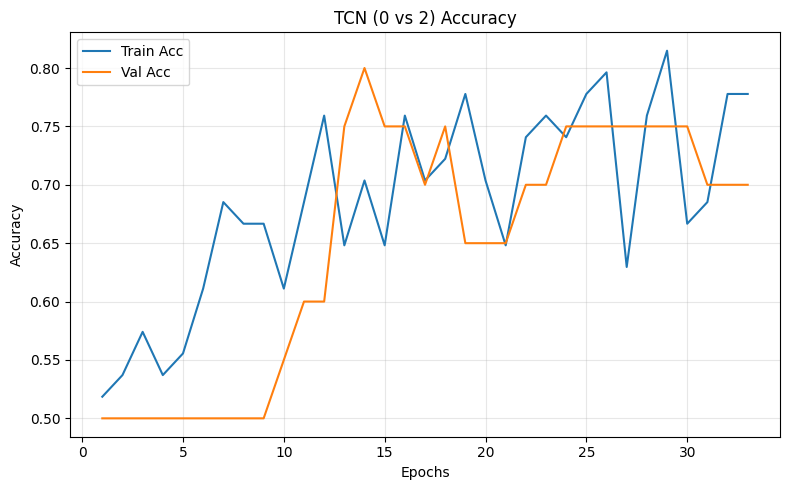

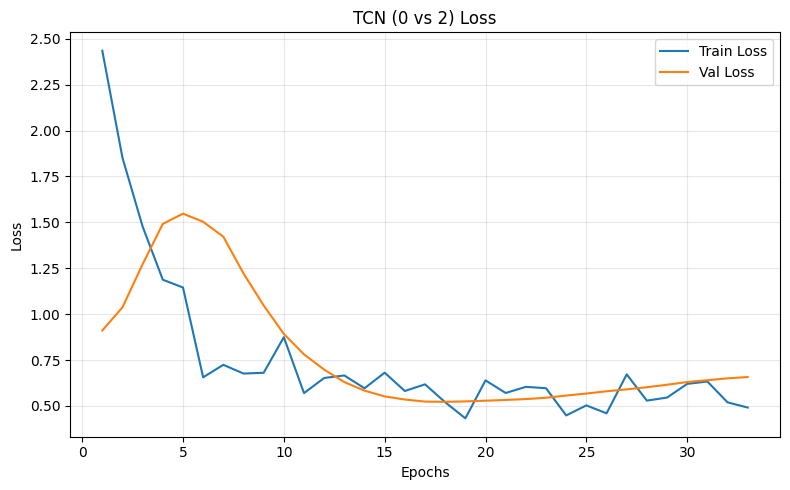

In [55]:
"""
Feature Importance in Non/Saccadic Areas for TCN
- Supports two models:
  (A) Pure TCN: Input (T, 4)
  (B) TCN + Stats Hybrid: Input [(T, C_aug), (3*C_aug,)]
- Method: Saliency / Integrated Gradients / Grad-CAM++
- Output: The distribution and proportion of importance of each trial in the saccade and non-saccade regions

Dependencies:
- augment_dynamic_channels(X) -> (N, T, 13)
- compute_global_stats(X_aug) -> (N, 3*C_aug)
- load_pair_experiment, split_by_participant_train_val_test
- TCN training script (to obtain the model)
"""

import numpy as np, tensorflow as tf
import pandas as pd, matplotlib.pyplot as plt
from typing import Dict, Tuple, List, Optional
from tensorflow.keras import Model, layers

SEED = 42
np.random.seed(SEED); tf.random.set_seed(SEED)

# 0) Saccade detection (same as CNN version, can be directly reused)
def detect_saccades_mask(x: np.ndarray,
                         vel_thr: float = 0.8,
                         min_frames: int = 8,
                         smooth_win: int = 7) -> np.ndarray:
    """
    x: (T,4) -> [lx,ly,rx,ry]; returns (T,) bool
    """
    T = x.shape[0]
    if smooth_win > 1:
        import scipy.signal as ss
        xf = np.stack([ss.medfilt(x[:,c], kernel_size=smooth_win) for c in range(x.shape[1])], axis=1)
    else:
        xf = x
    L, R = xf[:, :2], xf[:, 2:]
    P = 0.5*(L+R)
    V = np.sqrt(np.sum(np.diff(P, axis=0, prepend=P[[0],:])**2, axis=1))
    mask0 = (V >= vel_thr)

    sacc_mask = np.zeros(T, dtype=bool)
    i = 0
    while i < T:
        if not mask0[i]:
            i += 1; continue
        j = i
        while j < T and mask0[j]:
            j += 1
        if (j - i) >= min_frames:
            sacc_mask[i:j] = True
        i = j
    return sacc_mask

def compare_importance_on_saccades(importances: np.ndarray, sacc_mask: np.ndarray) -> Dict[str, float]:
    imp_s = importances[sacc_mask]
    imp_n = importances[~sacc_mask]
    return {
        'mean_imp_sacc': float(np.mean(imp_s)) if imp_s.size else 0.0,
        'mean_imp_non':  float(np.mean(imp_n)) if imp_n.size else 0.0,
        'frac_imp_on_sacc': float(np.sum(importances * sacc_mask) / (np.sum(importances)+1e-8))
    }

# 1) Mixed/pure TCN input preparation
def _is_hybrid_tcn(model: Model) -> bool:
    """Determine whether it is a TCN+Stats hybrid model (i.e., multiple inputs and including an input named 'stat_in')"""
    return (isinstance(model.input, (list, tuple)) or isinstance(model.inputs, (list, tuple))) and \
           any(getattr(t, 'name', '').startswith('stat_in') for t in model.inputs)

def _prepare_inputs_for_model(model: Model, x_raw4: np.ndarray, smooth_k: int = 5):
    """
    For a single original 4-channel sequence (T,4):
      - If pure TCN: Return xt=(1,T,4)
      - If mixed TCN: First perform channel/global statistics enhancement, then return [x_aug(1,T,C_aug), F(1,3*C_aug)]
    Also returns a tensor handle for the gradient to be calculated, grad_target (only for sequential branches).
    """
    if not _is_hybrid_tcn(model):
        xt = tf.convert_to_tensor(x_raw4[None, ...], tf.float32)  # (1,T,4)
        grad_target = xt
        feed = xt
    else:
        # Construct a single enhancement + statistics
        X_aug = augment_dynamic_channels(x_raw4[None, ...], smooth_k=smooth_k)  # (1,T,C_aug)
        F     = compute_global_stats(X_aug)                                     # (1,3*C_aug)
        xt = tf.convert_to_tensor(X_aug, tf.float32)
        st = tf.convert_to_tensor(F, tf.float32)
        grad_target = xt            # Only derive the sequential branches
        feed = [xt, st]
    return feed, grad_target

# 2) XAI on TCN (gradients/saliency maps only for temporal branches)
def saliency_tcn(model: Model, x_raw4: np.ndarray, smooth_k: int = 5) -> np.ndarray:
    feed, grad_t = _prepare_inputs_for_model(model, x_raw4, smooth_k=smooth_k)
    with tf.GradientTape() as tape:
        tape.watch(grad_t)
        y = model(feed, training=False)  # (1,1)
    g = tape.gradient(y, grad_t).numpy()[0]      # (T,C_ts)
    imp = np.abs(g).mean(axis=1)                 # (T,)
    imp = np.maximum(imp, 0)
    return imp / (imp.sum() + 1e-8)

def ig_tcn(model: Model, x_raw4: np.ndarray, steps: int = 64, smooth_k: int = 5) -> np.ndarray:
    feed, grad_t = _prepare_inputs_for_model(model, x_raw4, smooth_k=smooth_k)
    # Baseline: All zeros (path integration is performed only on the timing branch; the stats branch remains unchanged)
    baseline = tf.zeros_like(grad_t)
    alphas = tf.reshape(tf.linspace(0., 1., steps+1)[1:], (-1,1,1))
    path_ts = baseline + alphas * (grad_t - baseline)     # (steps,T,C_ts)

    # Assemble feed (hybrid: stats repeated steps times; pure TCN: direct path_ts)
    if _is_hybrid_tcn(model):
        # Get the stats tensor of the prepare stage
        Xt, St = feed  # Xt(1,T,C), St(1,S)
        St_steps = tf.repeat(St, repeats=steps, axis=0)   # (steps,S)
        feed_steps = [path_ts, St_steps]
    else:
        feed_steps = path_ts

    with tf.GradientTape() as tape:
        tape.watch(path_ts)
        y = model(feed_steps, training=False)             # (steps,1)
    grads = tape.gradient(y, path_ts).numpy()            # (steps,T,C_ts)
    avg_g = grads.mean(axis=0)                           # (T,C_ts)
    ig = ((grad_t.numpy()[0] - 0.0) * avg_g).mean(axis=1)
    ig = np.maximum(ig, 0)
    return ig / (ig.sum() + 1e-8)

def gradcampp_tcn(model: Model, x_raw4: np.ndarray, conv_layer_name: Optional[str] = None, smooth_k: int = 5) -> np.ndarray:
    """
    Perform Grad-CAM++ on the conv layer of the last Conv1D layer in the model or the specified TCN block.
    Only perform forward and backward propagation on the timing branch; the stats branch remains fixed.
    """
    # Target layer
    if conv_layer_name is None:
        target_layer = None
        for L in model.layers[::-1]:
            if isinstance(L, layers.Conv1D):
                target_layer = L; break
        if target_layer is None:
            raise ValueError("No Conv1D layer found for Grad-CAM++ in this model.")
    else:
        target_layer = model.get_layer(conv_layer_name)

    # Prepare input
    feed, grad_t = _prepare_inputs_for_model(model, x_raw4, smooth_k=smooth_k)
    # Create a sub-model
    grad_model = Model(model.inputs, [target_layer.output, model.output])

    # Forward + first/second order gradient
    with tf.GradientTape(persistent=True) as t1:
        with tf.GradientTape(persistent=True) as t2:
            conv_out, y = grad_model(feed, training=False)   # conv_out: (1,T',F)
            y_c = y[:, 0]
        g1 = t2.gradient(y_c, conv_out)                      # (1,T',F)
    g2 = t1.gradient(y_c, conv_out)                          # (1,T',F)
    del t1, t2

    conv = conv_out.numpy()[0]    # (T',F)
    g1   = g1.numpy()[0]
    g2   = g2.numpy()[0]

    # GC++ Weight
    eps = 1e-8
    alpha = (g1**2) / np.maximum(2.0*(g1**2) + conv*g2, eps)  # (T',F)
    weights = (alpha * np.maximum(g1, 0.0)).sum(axis=0)       # (F,)
    cam = np.maximum((conv * weights).sum(axis=1), 0.0)       # (T',)

    # Normalise & upsample to original T (according to original 4-channel length)
    T = x_raw4.shape[0]
    if cam.max() > 0:
        cam = cam / (cam.max() + 1e-8)
    if cam.shape[0] != T:
        src = np.linspace(0, 1, cam.shape[0], dtype=np.float32)
        dst = np.linspace(0, 1, T, dtype=np.float32)
        cam = np.interp(dst, src, cam)
    # Convert to probability distribution (same as saliency/IG)
    cam = np.maximum(cam, 0.0)
    return cam / (cam.sum() + 1e-8)

# 3) Single sample packaging
def xai_vs_saccade_for_sample_tcn(
    model: Model,
    x_raw4: np.ndarray,           # (T,4) Original four channels after preprocessing (linear resampling + /960 + robust)
    xai: str = "saliency",        # 'saliency' | 'ig' | 'gradcampp'
    vel_thr: float = 0.8,
    min_frames: int = 8,
    smooth_k: int = 5,
    conv_target: Optional[str] = None
) -> Dict[str, float]:

    if xai == "saliency":
        imp = saliency_tcn(model, x_raw4, smooth_k=smooth_k)
    elif xai == "ig":
        imp = ig_tcn(model, x_raw4, steps=64, smooth_k=smooth_k)
    elif xai == "gradcampp":
        imp = gradcampp_tcn(model, x_raw4, conv_layer_name=conv_target, smooth_k=smooth_k)
    else:
        raise ValueError(f"Unknown xai='{xai}'")

    sacc_mask = detect_saccades_mask(x_raw4, vel_thr=vel_thr, min_frames=min_frames)
    stats = compare_importance_on_saccades(imp, sacc_mask)
    stats.update(dict(xai=xai, vel_thr=vel_thr, min_frames=min_frames))
    return stats

# 4) Dataset-level batch evaluation
from scipy.stats import mannwhitneyu

def run_xai_saccade_analysis_tcn(
    model: Model,
    X_raw: np.ndarray,        # (N,T,4) Same as training preprocessing (linear resampling + robust scaling)
    y: np.ndarray,
    xai_methods=('saliency','ig','gradcampp'),
    vel_thr: float = 0.8,
    min_frames: int = 8,
    smooth_k: int = 5,
    max_n: int = 200,
    conv_target: Optional[str] = None
):
    import random
    idxs = list(range(len(y)))
    random.Random(42).shuffle(idxs)
    idxs = idxs[:min(max_n, len(idxs))]

    rows = []
    for xai in xai_methods:
        for i in idxs:
            s = xai_vs_saccade_for_sample_tcn(
                model, X_raw[i], xai=xai, vel_thr=vel_thr,
                min_frames=min_frames, smooth_k=smooth_k, conv_target=conv_target
            )
            rows.append({'xai': xai, 'frac_imp_on_sacc': s['frac_imp_on_sacc'], 'label': int(y[i])})
    df = pd.DataFrame(rows)

    # Statistics + Visualisation
    summary = {}
    for xai in xai_methods:
        d0 = df[(df['xai']==xai) & (df['label']==0)]['frac_imp_on_sacc'].values
        d1 = df[(df['xai']==xai) & (df['label']==1)]['frac_imp_on_sacc'].values
        if len(d0) and len(d1):
            U, p = mannwhitneyu(d0, d1, alternative='two-sided')
        else:
            U, p = np.nan, np.nan
        summary[xai] = dict(
            mean0=float(np.mean(d0)) if len(d0) else np.nan,
            mean1=float(np.mean(d1)) if len(d1) else np.nan,
            median0=float(np.median(d0)) if len(d0) else np.nan,
            median1=float(np.median(d1)) if len(d1) else np.nan,
            U=float(U), p=float(p), n0=int(len(d0)), n1=int(len(d1))
        )
        print(f"[TCN XAI={xai}] frac_imp_on_sacc  label0 vs label1 -> "
              f"U={summary[xai]['U']:.1f}, p={summary[xai]['p']:.3e}, "
              f"mean0={summary[xai]['mean0']:.3f}, mean1={summary[xai]['mean1']:.3f}")

        plt.figure(figsize=(5,4))
        plt.boxplot([d0, d1], labels=['label0','label1'])
        plt.title(f"{xai}: fraction of importance on saccades (TCN)")
        plt.ylabel("Frac importance on sacc")
        plt.grid(alpha=0.3)
        plt.tight_layout()
        plt.show()

    return df, summary

# 5) Quick Start
if __name__ == "__main__":
    # 1) Path & Parameters
    CSV_DIR   = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    PAIR      = (0, 2)
    TARGETLEN = 1500
    BATCH     = 16

    # 2) Directly call training/validation/testing
    res = run_experiment_tcn(
        csv_dir=CSV_DIR, 
        label_pair=PAIR, 
        target_len=TARGETLEN,
        batch_size=BATCH,
        max_epochs=80, 
        lr=3e-4, 
        early_patience=15,
        # TCN hyperparameters (adjustable)
        n_filters=64, kernel_size=7, dilations=(1,2,4,8,16),
        nb_stacks=1, dropout=0.1, use_ln=False
    )

    # 3) View test results
    print(res["test_report"])

    # 4) Draw a training curve
    plot_accuracy_curve(res['history'], title='TCN (0 vs 2) Accuracy', save_path='tcn_02_acc.png')
    plot_loss_curve(res['history'],     title='TCN (0 vs 2) Loss',     save_path='tcn_02_loss.png')

    # 5) Get the model/subject division (can be reused later)
    model      = res['model']
    id_splits  = res['id_splits']  # {'train_ids':..., 'val_ids':..., 'test_ids':...}

    # 6) Save Weights & Reuse
    model.save_weights("tcn_0_2_first_trials.weights.h5")



Load-level Pattern Differences + Sliding Window Feature Dynamics for tcn

In [56]:
"""
Load-level Pattern Differences + Sliding Window Feature Dynamics (for TCN)
- Equivalent statistical analysis to the CNN version: full-length trajectory length distribution & sliding window features (mean velocity/acceleration/range/scan rate)
- Additional (optional) TCN window sensitivity: the probability of sliding window occlusion decreases, as a "significance" time series curve
- Output to ./outputs/<dataset_name>/

Dependencies (must be defined or imported with the T/1D-CNN tool):
  _linear_resample, _robust_scale_per_trace, load_pair_experiment
  split_by_participant_train_val_test
  build_tcn_model (for optional sensitivity analysis only), get_optimizer (same as above)
"""

import os, json
from typing import List, Tuple, Dict, Optional
import numpy as np
import pandas as pd
from scipy.stats import mannwhitneyu
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score, roc_auc_score
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

SEED = 42
np.random.seed(SEED)
REQUIRED_COLS = ['abs_lx','abs_ly','abs_rx','abs_ry']
os.makedirs("outputs", exist_ok=True)

# Utils
def get_participant_id(filename: str) -> str:
    return os.path.splitext(filename)[0].split('_')[0]

# load_pair_experiment / split_by_participant_train_val_test are already defined.
# Simply import

# Core analytics (equivalent to the CNN version)
def trajectory_length(seq_xy: np.ndarray) -> float:
    lx, ly, rx, ry = seq_xy[:,0], seq_xy[:,1], seq_xy[:,2], seq_xy[:,3]
    dl = np.sqrt(np.diff(lx)**2 + np.diff(ly)**2).sum()
    dr = np.sqrt(np.diff(rx)**2 + np.diff(ry)**2).sum()
    return float((dl + dr) / 2.0)

def compute_lengths(X: np.ndarray) -> np.ndarray:
    return np.array([trajectory_length(x) for x in X], dtype=np.float32)

def velocity_trace(seq_xy: np.ndarray) -> np.ndarray:
    lx, ly, rx, ry = seq_xy[:,0], seq_xy[:,1], seq_xy[:,2], seq_xy[:,3]
    vl = np.sqrt(np.diff(lx)**2 + np.diff(ly)**2)
    vr = np.sqrt(np.diff(rx)**2 + np.diff(ry)**2)
    return (vl + vr)/2.0

def acceleration_from_velocity(v: np.ndarray) -> np.ndarray:
    if len(v) < 2: return np.zeros_like(v)
    return np.abs(np.diff(v))

def window_slices(T: int, win: int, stride: int):
    idx = []
    s = 0
    while s + win <= T:
        idx.append((s, s+win))
        s += stride
    if not idx:
        idx.append((0, T))
    return idx

def window_features(seq_xy: np.ndarray, win=100, stride=50, sacc_thr=None) -> Dict[str, np.ndarray]:
    T = seq_xy.shape[0]
    vx = velocity_trace(seq_xy)
    ax = acceleration_from_velocity(vx)
    if sacc_thr is None:
        sacc_thr = np.percentile(vx, 90.0)

    slices = window_slices(T-1, win, stride)  # v length T-1
    mean_v, mean_a, rng, sacc_freq = [], [], [], []
    for (i, j) in slices:
        v_win = vx[i:j]
        a_win = ax[i:j-1] if (j-i)>=2 else np.array([0.0])
        sub = seq_xy[i:(i+win), :] if (i+win)<=T else seq_xy[i:T, :]

        mean_v.append(float(np.mean(v_win) if len(v_win)>0 else 0.0))
        mean_a.append(float(np.mean(a_win) if len(a_win)>0 else 0.0))
        ranges = sub.max(axis=0) - sub.min(axis=0)
        rng.append(float(np.mean(ranges)))
        sacc_freq.append(float(np.mean(v_win > sacc_thr)) if len(v_win)>0 else 0.0)

    return {
        'mean_v': np.array(mean_v, dtype=np.float32),
        'mean_a': np.array(mean_a, dtype=np.float32),
        'rng': np.array(rng, dtype=np.float32),
        'sacc_freq': np.array(sacc_freq, dtype=np.float32),
        'windows': np.array(slices, dtype=np.int32)
    }

def group_window_dynamics(X: np.ndarray, y: np.ndarray, win=100, stride=50) -> Dict:
    feats0, feats1 = [], []
    for i in range(len(X)):
        feats = window_features(X[i], win=win, stride=stride, sacc_thr=None)
        if y[i] == 0: feats0.append(feats)
        else:         feats1.append(feats)

    if len(feats0)==0 or len(feats1)==0:
        raise ValueError("There are not enough samples of the two types to make dynamic comparisons")

    K0 = min(len(f['mean_v']) for f in feats0)
    K1 = min(len(f['mean_v']) for f in feats1)
    K = min(K0, K1)

    def stack_trim(L, key):
        return np.stack([f[key][:K] for f in L], axis=0)

    out = {}
    for key in ['mean_v','mean_a','rng','sacc_freq']:
        A0 = stack_trim(feats0, key)
        A1 = stack_trim(feats1, key)
        mean0, mean1 = A0.mean(0), A1.mean(0)
        se0, se1 = A0.std(0)/np.sqrt(A0.shape[0]), A1.std(0)/np.sqrt(A1.shape[0])

        pvals = []
        for k in range(K):
            u, p = mannwhitneyu(A0[:,k], A1[:,k], alternative='two-sided')
            pvals.append(p)
        out[key] = {'mean0': mean0, 'mean1': mean1, 'se0': se0, 'se1': se1, 'pvals': np.array(pvals)}
    out['K'], out['win'], out['stride'] = K, win, stride
    return out

# Plots
def plot_box_violin_lengths(lengths: np.ndarray, y: np.ndarray, title: str, save_path: str):
    data0, data1 = lengths[y==0], lengths[y==1]
    fig, ax = plt.subplots(1,2, figsize=(10,4), sharey=True)
    ax[0].boxplot([data0, data1], labels=['label0','label1'])
    ax[0].set_title('Boxplot'); ax[0].set_ylabel('Trajectory length')
    ax[1].violinplot([data0, data1], showmeans=True, showmedians=True)
    ax[1].set_xticks([1,2]); ax[1].set_xticklabels(['label0','label1'])
    ax[1].set_title('Violin')
    fig.suptitle(title); plt.tight_layout(); fig.savefig(save_path, dpi=200); plt.close(fig)

def plot_window_curves(dyn: Dict, title: str, save_path: str, alpha=0.05):
    K, win, stride = dyn['K'], dyn['win'], dyn['stride']
    tgrid = np.arange(K) * stride + win//2
    keys = ['mean_v','mean_a','rng','sacc_freq']
    fig, axes = plt.subplots(len(keys), 1, figsize=(10, 2.8*len(keys)), sharex=True)
    if len(keys)==1: axes = [axes]
    for ax, key in zip(axes, keys):
        d = dyn[key]
        ax.plot(tgrid, d['mean0'], label='label0')
        ax.fill_between(tgrid, d['mean0']-d['se0'], d['mean0']+d['se0'], alpha=0.25)
        ax.plot(tgrid, d['mean1'], label='label1')
        ax.fill_between(tgrid, d['mean1']-d['se1'], d['mean1']+d['se1'], alpha=0.25)
        sig = d['pvals'] < alpha
        if sig.any():
            ymin = min(d['mean0'].min(), d['mean1'].min())
            ax.scatter(tgrid[sig], np.full(sig.sum(), ymin), marker='|', s=60, label='p<%.2f'%alpha)
        ax.set_ylabel(key); ax.grid(alpha=0.2)
    axes[-1].set_xlabel('time (frame)'); axes[0].legend()
    fig.suptitle(title); plt.tight_layout(); fig.savefig(save_path, dpi=200); plt.close(fig)

# TCN window sensitivity
def tcn_window_sensitivity(model, x: np.ndarray, win=100, stride=50, fill_value=0.0):
    """
    Perform sliding window masking on a single sequence x:(T,4): Set the window to fill_value 
    and calculate y0 - y_win_drop as the importance of the window. Return centers(Tw,) and scores(Tw,)
    """
    T = x.shape[0]
    wins = window_slices(T, win, stride)
    y0 = float(model.predict(x[None, ...], verbose=0).ravel()[0])
    centers, scores = [], []
    for (i, j) in wins:
        xi = x.copy()
        xi[i:j, :] = fill_value
        y_drop = float(model.predict(xi[None, ...], verbose=0).ravel()[0])
        centers.append((i+j)//2)
        scores.append(max(0.0, y0 - y_drop))  # Only positive impact
    return np.array(centers, dtype=int), np.array(scores, dtype=np.float32)

def plot_window_sensitivity(centers0, scores0, centers1, scores1, title, save_path):
    plt.figure(figsize=(10,4))
    # Draw the mean + SE for each of the two categories
    def agg(centers, scores):
        # Possibly different trial lengths → aligned to a common center index
        u = np.unique(np.concatenate(centers))
        m = []
        e = []
        for c in u:
            vals = []
            for ci, si in zip(centers, scores):
                # Find out whether this center exists in the trial
                idx = np.where(ci==c)[0]
                if len(idx): vals.append(si[idx[0]])
            if len(vals):
                vals = np.array(vals)
                m.append(vals.mean())
                e.append(vals.std()/np.sqrt(len(vals)))
            else:
                m.append(np.nan); e.append(np.nan)
        return u, np.array(m), np.array(e)
    t0, m0, e0 = agg(centers0, scores0)
    t1, m1, e1 = agg(centers1, scores1)
    plt.plot(t0, m0, label='label0'); plt.fill_between(t0, m0-e0, m0+e0, alpha=0.25)
    plt.plot(t1, m1, label='label1'); plt.fill_between(t1, m1-e1, m1+e1, alpha=0.25)
    plt.xlabel("time (frame)"); plt.ylabel("occlusion importance (Δprob)")
    plt.title(title); plt.legend(); plt.grid(alpha=0.3); plt.tight_layout()
    plt.savefig(save_path, dpi=200); plt.close()

# End-to-end run
def analyze_dataset(
    name: str, csv_dir: str, label_pair=(0,2),
    target_len=1500, out_dir="outputs", win=100, stride=50,
    # ↓↓↓ Provide a trained TCN model (or give weight path + composition parameters)
    tcn_model=None,
    tcn_build_kwargs: Optional[dict] = None,
    tcn_weights_path: Optional[str] = None
):
    os.makedirs(os.path.join(out_dir, name), exist_ok=True)

    # 1) Load
    X, y, files = load_pair_experiment(csv_dir, label_pair, resample_len=target_len,
                                       max_nan_ratio=0.30, divide_by_960=True, use_robust_scale=True)

    # 2) Full track length
    L = compute_lengths(X)
    df_len = pd.DataFrame({'file': files, 'pid':[get_participant_id(f) for f in files],
                           'label': y, 'length': L})
    df_len.to_csv(os.path.join(out_dir, name, f"{name}_lengths.csv"), index=False)

    # Significance
    L0, L1 = L[y==0], L[y==1]
    u, p = mannwhitneyu(L0, L1, alternative='two-sided')
    stats = {'n0': int(len(L0)), 'n1': int(len(L1)),
             'mean0': float(L0.mean()), 'mean1': float(L1.mean()),
             'std0': float(L0.std()), 'std1': float(L1.std()),
             'U': float(u), 'p': float(p)}
    with open(os.path.join(out_dir, name, f"{name}_length_stats.json"), "w") as f:
        json.dump(stats, f, indent=2)
    print(f"[{name}] Length MW-U: U={u:.1f}, p={p:.3e}, mean0={L0.mean():.3f}, mean1={L1.mean():.3f}")

    # Boxplot/Violinplot
    plot_box_violin_lengths(L, y, title=f"{name} Trajectory Length", 
                            save_path=os.path.join(out_dir, name, f"{name}_length_box_violin.png"))

    # 3) Length classification (subject grouping)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(
        L.reshape(-1,1), y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    clf = make_pipeline(StandardScaler(), LogisticRegression(random_state=SEED, max_iter=1000))
    clf.fit(np.vstack([Xtr, Xva]), np.hstack([ytr, yva]))
    prob = clf.predict_proba(Xte)[:,1]
    pred = (prob >= 0.5).astype(int)
    acc = accuracy_score(yte, pred)
    try: auc = roc_auc_score(yte, prob)
    except ValueError: auc = float('nan')
    print(f"[{name}] Length-only classifier: Acc={acc:.3f}, ROC-AUC={auc:.3f}")
    with open(os.path.join(out_dir, name, f"{name}_length_cls.json"), "w") as f:
        json.dump({'accuracy': float(acc), 'roc_auc': float(auc), 'split': split_info}, f, indent=2)

    # 4) Sliding Window Feature Dynamics
    dyn = group_window_dynamics(X, y, win=win, stride=stride)
    pv = {k: dyn[k]['pvals'].tolist() for k in ['mean_v','mean_a','rng','sacc_freq']}
    with open(os.path.join(out_dir, name, f"{name}_window_pvals.json"), "w") as f:
        json.dump({'K': dyn['K'], 'win': dyn['win'], 'stride': dyn['stride'], 'pvals': pv}, f, indent=2)
    plot_window_curves(dyn, title=f"{name} sliding-window dynamics (win={win}, stride={stride})",
                       save_path=os.path.join(out_dir, name, f"{name}_window_dynamics.png"))

    # 5) TCN window sensitivity (if you give model/weights)
    if (tcn_model is not None) or (tcn_weights_path is not None):
        print("[TCN] Running window-occlusion sensitivity ...")
        model = tcn_model
        if model is None:
            # Requires existing build_tcn_model / get_optimizer
            model = build_tcn_model(input_shape=(target_len, 4), **(tcn_build_kwargs or {}))
            model.compile(optimizer=get_optimizer(1e-4), loss='binary_crossentropy', metrics=['accuracy'])
            model.load_weights(tcn_weights_path)

        # Aggregate the window importance of the two categories separately
        centers0, scores0, centers1, scores1 = [], [], [], []
        for i in range(len(X)):
            c, s = tcn_window_sensitivity(model, X[i], win=win, stride=stride, fill_value=0.0)
            if y[i] == 0:
                centers0.append(c); scores0.append(s)
            else:
                centers1.append(c); scores1.append(s)
        plot_window_sensitivity(
            centers0, scores0, centers1, scores1,
            title=f"{name} TCN window-occlusion importance (win={win}, stride={stride})",
            save_path=os.path.join(out_dir, name, f"{name}_tcn_window_importance.png")
        )

    return {
        'length_stats': stats,
        'length_cls': {'accuracy': float(acc), 'roc_auc': float(auc)},
        'splits': split_info
    }

# Main
if __name__ == "__main__":
    FIRST_DIR  = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (0, 2)
    TARGET_LEN = 1500
    WIN, STRIDE = 100, 50

    # If have trained TCN weights, can do window sensitivity on FIRST; otherwise, set None to skip this step.
    TCN_WEIGHTS = None  # e.g., "tcn_0_2_first_trials.weights.h5"
    TCN_BUILD_KW = dict(n_filters=64, kernel_size=7, dilations=(1,2,4,8,16), nb_stacks=1, dropout=0.1, use_ln=False)

    print("=== Analyze FIRST ===")
    res_first = analyze_dataset("first_trials", FIRST_DIR, label_pair=PAIR, target_len=TARGET_LEN,
                                out_dir="outputs", win=WIN, stride=STRIDE,
                                tcn_model=None, tcn_build_kwargs=TCN_BUILD_KW, tcn_weights_path=TCN_WEIGHTS)

    print("=== Analyze REPEATS ===")
    res_repeats = analyze_dataset("repeats", REPEAT_DIR, label_pair=PAIR, target_len=TARGET_LEN,
                                  out_dir="outputs", win=WIN, stride=STRIDE,
                                  tcn_model=None, tcn_build_kwargs=TCN_BUILD_KW, tcn_weights_path=TCN_WEIGHTS)

    print("\nSummary:")
    print("FIRST length-only:", res_first['length_cls'])
    print("REPEATS length-only:", res_repeats['length_cls'])


=== Analyze FIRST ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[first_trials] Length MW-U: U=1177.0, p=3.548e-01, mean0=761.688, mean1=725.137
[first_trials] Length-only classifier: Acc=0.389, ROC-AUC=0.500
=== Analyze REPEATS ===
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
[repeats] Length MW-U: U=218.0, p=6.359e-01, mean0=892.691, mean1=850.462
[repeats] Length-only classifier: Acc=0.700, ROC-AUC=0.760

Summary:
FIRST length-only: {'accuracy': 0.3888888888888889, 'roc_auc': 0.5}
REPEATS length-only: {'accuracy': 0.7, 'roc_auc': 0.76}


Ablation Experiments for tcn

In [57]:
"""
Ablation Experiments for TCN (aligned with CNN 8.3):
- 8.3.1 Eye Channel Ablation: Left / Right / Both
- 8.3.2 Temporal Segment Ablation: Start / Middle / End
- 8.3.3 Coordinate Direction Ablation: X only / Y only

Notes:
- Cropping (channels/time slices) is performed before entering the model; after cropping, the time slices are linearly resampled back to target_len to maintain input alignment.
- The model automatically sets input_shape = (target_len, n_channels) based on the number of channels after cropping.
- Training details (loss/ES/LR scheduling/grouping) remain consistent with the CNN version.
"""

import os, time, json
from typing import Tuple, List, Dict, Optional
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, classification_report

# Directly reuse these functions in existing scripts
#   - _linear_resample(x, target_len)
#   - _robust_scale_per_trace(x)
#   - load_pair_experiment(csv_dir, labels, resample_len, max_nan_ratio, divide_by_960, use_robust_scale)
#   - split_by_participant_train_val_test(X, y, files, val_size, test_size, random_state)
#   - compute_class_weight(y_train)
#   - get_optimizer(lr)

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# TCN module
def ResidualBlockTCN(x, n_filters: int, kernel_size: int, dilation: int,
                     dropout: float = 0.1, use_ln: bool = False, name: str = "tcn"):
    """
    Standard TCN residual block (causal + dilated Conv1D):
      Conv(causal,d) -> (BN/LN) -> ReLU -> SpatialDropout
      Conv(causal,d) -> (BN/LN) -> ReLU -> SpatialDropout
      + Residual (use 1x1 projection if channels don't match) -> ReLU
    """
    shortcut = x
    if x.shape[-1] != n_filters:
        shortcut = layers.Conv1D(n_filters, 1, padding='same', name=f"{name}_proj")(shortcut)

    y = layers.Conv1D(n_filters, kernel_size, padding='causal',
                      dilation_rate=dilation, name=f"{name}_conv1")(x)
    y = (layers.LayerNormalization(name=f"{name}_ln1")(y)
         if use_ln else layers.BatchNormalization(name=f"{name}_bn1")(y))
    y = layers.Activation('relu', name=f"{name}_relu1")(y)
    y = layers.SpatialDropout1D(dropout, name=f"{name}_sd1")(y)

    y = layers.Conv1D(n_filters, kernel_size, padding='causal',
                      dilation_rate=dilation, name=f"{name}_conv2")(y)
    y = (layers.LayerNormalization(name=f"{name}_ln2")(y)
         if use_ln else layers.BatchNormalization(name=f"{name}_bn2")(y))
    y = layers.Activation('relu', name=f"{name}_relu2")(y)
    y = layers.SpatialDropout1D(dropout, name=f"{name}_sd2")(y)

    out = layers.Add(name=f"{name}_add")([shortcut, y])
    out = layers.Activation('relu', name=f"{name}_out_relu")(out)
    return out

def build_tcn_model_nchan(target_len: int, n_channels: int,
                          n_filters: int = 64,
                          kernel_size: int = 7,
                          dilations: Tuple[int, ...] = (1,2,4,8,16),
                          nb_stacks: int = 1,
                          dropout: float = 0.1,
                          use_ln: bool = False) -> Model:
    """
    Construct TCN + GAP + small head according to the current number of channels.
    """
    inp = Input(shape=(target_len, n_channels), name="input")
    x = inp
    for s in range(nb_stacks):
        for d in dilations:
            x = ResidualBlockTCN(
                x, n_filters=n_filters, kernel_size=kernel_size, dilation=d,
                dropout=dropout, use_ln=use_ln, name=f"tcn_s{s}_d{d}"
            )
    x = layers.GlobalAveragePooling1D(name="gap")(x)
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(0.5, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name="tcn_ablation")

# Crop tool (same as CNN version)
# Channel index: 0: lx, 1: ly, 2: rx, 3: ry
IDX = {'lx':0, 'ly':1, 'rx':2, 'ry':3}

def select_channels(X: np.ndarray, mode: str) -> np.ndarray:
    """
    mode ∈ {'left','right','both','x','y'}
    """
    if mode == 'left':
        keep = [IDX['lx'], IDX['ly']]
    elif mode == 'right':
        keep = [IDX['rx'], IDX['ry']]
    elif mode == 'both':
        keep = [IDX['lx'], IDX['ly'], IDX['rx'], IDX['ry']]
    elif mode == 'x':
        keep = [IDX['lx'], IDX['rx']]
    elif mode == 'y':
        keep = [IDX['ly'], IDX['ry']]
    else:
        raise ValueError(f"Unknown channel mode: {mode}")
    return X[:, :, keep]

def slice_temporal_segment(X: np.ndarray, seg: str, resample_back_len: Optional[int] = None) -> np.ndarray:
    """
    Slice by 1/3: 'start' / 'middle' / 'end'; then resample back to resample_back_len.
    """
    if seg == 'full':
        return X
    N, T, C = X.shape
    one_third = T // 3
    if seg == 'start':
        Xs = X[:, :one_third, :]
    elif seg == 'middle':
        Xs = X[:, one_third:2*one_third, :]
    elif seg == 'end':
        Xs = X[:, 2*one_third:, :]
    else:
        raise ValueError(f"Unknown temporal segment: {seg}")

    if (resample_back_len is None) or (Xs.shape[1] == resample_back_len):
        return Xs

    out = np.empty((N, resample_back_len, C), dtype=X.dtype)
    for i in range(N):
        out[i] = _linear_resample(Xs[i], resample_back_len)
    return out

# Training and evaluation (with TCN)
def train_eval_once_tcn(
    X: np.ndarray, y: np.ndarray, files: List[str],
    target_len: int = 1500,
    lr: float = 3e-4,
    batch_size: int = 16,
    max_epochs: int = 80,
    early_patience: int = 15,
    # TCN hyperparameters (adjustable, globally applicable)
    n_filters: int = 64,
    kernel_size: int = 7,
    dilations: Tuple[int, ...] = (1,2,4,8,16),
    nb_stacks: int = 1,
    dropout: float = 0.1,
    use_ln: bool = False
) -> Dict:
    """
    Subject-independent partitioning -> training -> testing (TCN).
    """
    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    n_channels = X.shape[-1]
    model = build_tcn_model_nchan(
        target_len, n_channels,
        n_filters=n_filters, kernel_size=kernel_size,
        dilations=dilations, nb_stacks=nb_stacks,
        dropout=dropout, use_ln=use_ln
    )
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])

    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    class_weight = compute_class_weight(ytr)

    t0 = time.perf_counter()
    hist = model.fit(
        Xtr, ytr,
        validation_data=(Xva, yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=0,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()

    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob >= 0.5).astype(int)
    acc = accuracy_score(yte, ypred)
    macro_f1 = f1_score(yte, ypred, average='macro')
    try:
        roc_auc = roc_auc_score(yte, yprob)
    except Exception:
        roc_auc = np.nan
    report = classification_report(yte, ypred, digits=4)
    return {
        'acc': acc, 'macro_f1': macro_f1, 'roc_auc': roc_auc,
        'report': report, 'history': hist.history, 'time_sec': t1 - t0,
        'splits': id_splits
    }

# 8.3.1 Eye Channel Ablation
def run_eye_channel_ablation(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    base_loader_kwargs: Optional[Dict] = None,
    # Transparent TCN super parameters
    tcn_kwargs: Optional[Dict] = None
) -> pd.DataFrame:
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)
    if tcn_kwargs is None:
        tcn_kwargs = {}

    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)
    rows = []
    for mode in ['left', 'right', 'both']:
        Xc = select_channels(X, mode)
        res = train_eval_once_tcn(Xc, y, files, target_len=target_len, **tcn_kwargs)
        rows.append(dict(
            ablation='EyeChannel', setting=mode,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'],
            time_sec=res['time_sec']
        ))
        print(f"[TCN|EyeChannel] {mode}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# 8.3.2 Temporal Segment Ablation
def run_temporal_segment_ablation(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    base_loader_kwargs: Optional[Dict] = None,
    tcn_kwargs: Optional[Dict] = None
) -> pd.DataFrame:
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)
    if tcn_kwargs is None:
        tcn_kwargs = {}

    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)
    rows = []
    for seg in ['start', 'middle', 'end']:
        Xt = slice_temporal_segment(X, seg=seg, resample_back_len=target_len)
        res = train_eval_once_tcn(Xt, y, files, target_len=target_len, **tcn_kwargs)
        rows.append(dict(
            ablation='Temporal', setting=seg,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'],
            time_sec=res['time_sec']
        ))
        print(f"[TCN|Temporal] {seg}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# 8.3.3 Coordinate Direction Ablation
def run_coord_direction_ablation(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    base_loader_kwargs: Optional[Dict] = None,
    tcn_kwargs: Optional[Dict] = None
) -> pd.DataFrame:
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)
    if tcn_kwargs is None:
        tcn_kwargs = {}

    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)
    rows = []
    for d in ['x', 'y']:
        Xc = select_channels(X, d)
        res = train_eval_once_tcn(Xc, y, files, target_len=target_len, **tcn_kwargs)
        rows.append(dict(
            ablation='Coord', setting=d,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'],
            time_sec=res['time_sec']
        ))
        print(f"[TCN|Coord] {d}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# One-button control
def run_all_ablation(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    # Prefix is saved; for example, "ablation_tcn_first_0_2"
    save_prefix: Optional[str] = None,
    # Uniformly pass in TCN hyperparameters (optional)
    tcn_kwargs: Optional[Dict] = None
) -> Dict[str, pd.DataFrame]:
    res_eye = run_eye_channel_ablation(csv_dir, label_pair, target_len, tcn_kwargs=tcn_kwargs)
    res_tmp = run_temporal_segment_ablation(csv_dir, label_pair, target_len, tcn_kwargs=tcn_kwargs)
    res_dir = run_coord_direction_ablation(csv_dir, label_pair, target_len, tcn_kwargs=tcn_kwargs)

    results = {'EyeChannel': res_eye, 'Temporal': res_tmp, 'Coord': res_dir}
    if save_prefix:
        for k, df in results.items():
            df.to_csv(f"{save_prefix}_{k}.csv", index=False)
        with open(f"{save_prefix}_meta.json", "w") as f:
            json.dump({'label_pair': label_pair, 'target_len': target_len,
                       'tcn_kwargs': (tcn_kwargs or {})}, f, indent=2)
    return results

# Run
if __name__ == "__main__":
    FIRST_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"

    PAIR = (0, 2)  # or (1, 3)
    TLEN = 1500

    # Can adjust TCN hyperparameters here; if not set, the default value will be used.
    TCN_KW = dict(n_filters=64, kernel_size=7, dilations=(1,2,4,8,16),
                  nb_stacks=1, dropout=0.1, use_ln=False, lr=3e-4)

    print("=== [TCN] 8.3 Ablation on FIRST_TRIALS ===")
    res_first = run_all_ablation(
        FIRST_DIR, label_pair=PAIR, target_len=TLEN,
        save_prefix=f"ablation_tcn_first_{PAIR[0]}_{PAIR[1]}",
        tcn_kwargs=TCN_KW
    )

    print("\n=== [TCN] 8.3 Ablation on REPEATS ===")
    res_repeats = run_all_ablation(
        REPEAT_DIR, label_pair=PAIR, target_len=TLEN,
        save_prefix=f"ablation_tcn_repeats_{PAIR[0]}_{PAIR[1]}",
        tcn_kwargs=TCN_KW
    )

    # Summary Print
    for name, df in res_first.items():
        print(f"\n[FIRST|TCN] {name}\n", df.sort_values('acc', ascending=False))
    for name, df in res_repeats.items():
        print(f"\n[REPEATS|TCN] {name}\n", df.sort_values('acc', ascending=False))


=== [TCN] 8.3 Ablation on FIRST_TRIALS ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)

Epoch 14: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 20: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 9ms/step
[TCN|EyeChannel] left: Acc=0.824, F1=0.813, AUC=0.929
              precision    recall  f1-score   support

           0     0.8333    0.7143    0.7692         7
           1     0.8182    0.9000    0.8571        10

    accuracy                         0.8235        17
   macro avg     0.8258    0.8071    0.8132        17
weighted avg     0.8244    0.8235    0.8209        17


Epoch 18: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 24: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 9ms/step
[TCN|EyeChannel] right: Acc=0.882, F1=0.879, AUC=0.943
              precisio


Epoch 35: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.
1/1 [==============================] - 0s 146ms/step
[TCN|Temporal] middle: Acc=0.800, F1=0.792, AUC=0.960
              precision    recall  f1-score   support

           0     0.7143    1.0000    0.8333         5
           1     1.0000    0.6000    0.7500         5

    accuracy                         0.8000        10
   macro avg     0.8571    0.8000    0.7917        10
weighted avg     0.8571    0.8000    0.7917        10


Epoch 60: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 66: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.

Epoch 78: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.
1/1 [==============================] - 0s 151ms/step
[TCN|Temporal] end: Acc=0.900, F1=0.899, AUC=1.000
              precision    recall  f1-score   support

           0     0.8333    1.0000    0.9091         5
           1     1.0000    0.8000    0.

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 8: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.
1/1 [==============================] - 0s 149ms/step
[TCN|Coord] y: Acc=0.700, F1=0.670, AUC=1.000
              precision    recall  f1-score   support

           0     0.6250    1.0000    0.7692         5
           1     1.0000    0.4000    0.5714         5

    accuracy                         0.7000        10
   macro avg     0.8125    0.7000    0.6703        10
weighted avg     0.8125    0.7000    0.6703        10


[FIRST|TCN] EyeChannel
      ablation setting       acc  macro_f1   roc_auc   time_sec
2  EyeChannel    both  0.941176  0.940351  0.985714  27.380753
1  EyeChannel   right  0.882353  0.878571  0.942857  21.546043
0  EyeChannel    left  0.823529  0.813187  0.928571  23.137920

[FIRST|TCN] Temporal
    ablation setting       acc  macro_f1   roc_auc   time_sec
0  Temporal   start  0.764706  0.757143  0.914286  41.495275
2  Temporal     end  0.705882  0.701754  0.785714  21.801141
1  Temporal  m

In [26]:
# Run
if __name__ == "__main__":
    FIRST_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"

    PAIR = (1, 3)
    TLEN = 1500

    # Can adjust TCN hyperparameters here; if not set, the default value will be used.
    TCN_KW = dict(n_filters=64, kernel_size=7, dilations=(1,2,4,8,16),
                  nb_stacks=1, dropout=0.1, use_ln=False, lr=3e-4)

    print("=== [TCN] 8.3 Ablation on FIRST_TRIALS ===")
    res_first = run_all_ablation(
        FIRST_DIR, label_pair=PAIR, target_len=TLEN,
        save_prefix=f"ablation_tcn_first_{PAIR[0]}_{PAIR[1]}",
        tcn_kwargs=TCN_KW
    )

    print("\n=== [TCN] 8.3 Ablation on REPEATS ===")
    res_repeats = run_all_ablation(
        REPEAT_DIR, label_pair=PAIR, target_len=TLEN,
        save_prefix=f"ablation_tcn_repeats_{PAIR[0]}_{PAIR[1]}",
        tcn_kwargs=TCN_KW
    )

    # Summary Print
    for name, df in res_first.items():
        print(f"\n[FIRST|TCN] {name}\n", df.sort_values('acc', ascending=False))
    for name, df in res_repeats.items():
        print(f"\n[REPEATS|TCN] {name}\n", df.sort_values('acc', ascending=False))

=== [TCN] 8.3 Ablation on FIRST_TRIALS ===
[load_pair_experiment] Dir=first_trials Labels=(1, 3), files=96, shape=(96, 1500, 4)

Epoch 15: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 21: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 21ms/step
[TCN|EyeChannel] left: Acc=0.524, F1=0.344, AUC=0.582
              precision    recall  f1-score   support

           0     0.5238    1.0000    0.6875        11
           1     0.0000    0.0000    0.0000        10

    accuracy                         0.5238        21
   macro avg     0.2619    0.5000    0.3438        21
weighted avg     0.2744    0.5238    0.3601        21



/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 15: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 21: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 28ms/step
[TCN|EyeChannel] right: Acc=0.524, F1=0.344, AUC=0.682
              precision    recall  f1-score   support

           0     0.5238    1.0000    0.6875        11
           1     0.0000    0.0000    0.0000        10

    accuracy                         0.5238        21
   macro avg     0.2619    0.5000    0.3438        21
weighted avg     0.2744    0.5238    0.3601        21



/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 15: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 21: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 21ms/step
[TCN|EyeChannel] both: Acc=0.524, F1=0.344, AUC=0.564
              precision    recall  f1-score   support

           0     0.5238    1.0000    0.6875        11
           1     0.0000    0.0000    0.0000        10

    accuracy                         0.5238        21
   macro avg     0.2619    0.5000    0.3438        21
weighted avg     0.2744    0.5238    0.3601        21



/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[load_pair_experiment] Dir=first_trials Labels=(1, 3), files=96, shape=(96, 1500, 4)

Epoch 24: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 30: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 26ms/step
[TCN|Temporal] start: Acc=0.810, F1=0.806, AUC=0.836
              precision    recall  f1-score   support

           0     0.7692    0.9091    0.8333        11
           1     0.8750    0.7000    0.7778        10

    accuracy                         0.8095        21
   macro avg     0.8221    0.8045    0.8056        21
weighted avg     0.8196    0.8095    0.8069        21


Epoch 23: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 40: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.

Epoch 46: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.
2/2 [==============================] - 0s 31ms/step
[TCN|Temporal] middle: Acc=0.762, F1=0.7

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[load_pair_experiment] Dir=first_trials Labels=(1, 3), files=96, shape=(96, 1500, 4)

Epoch 10: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 16: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 27ms/step
[TCN|Coord] x: Acc=0.524, F1=0.344, AUC=0.809
              precision    recall  f1-score   support

           0     0.5238    1.0000    0.6875        11
           1     0.0000    0.0000    0.0000        10

    accuracy                         0.5238        21
   macro avg     0.2619    0.5000    0.3438        21
weighted avg     0.2744    0.5238    0.3601        21



/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 15: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 21: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 23ms/step
[TCN|Coord] y: Acc=0.524, F1=0.344, AUC=0.791
              precision    recall  f1-score   support

           0     0.5238    1.0000    0.6875        11
           1     0.0000    0.0000    0.0000        10

    accuracy                         0.5238        21
   macro avg     0.2619    0.5000    0.3438        21
weighted avg     0.2744    0.5238    0.3601        21


=== [TCN] 8.3 Ablation on REPEATS ===


/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[load_pair_experiment] Dir=repeats Labels=(1, 3), files=39, shape=(39, 1500, 4)

Epoch 20: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.
1/1 [==============================] - 0s 186ms/step
[TCN|EyeChannel] left: Acc=0.889, F1=0.883, AUC=0.900
              precision    recall  f1-score   support

           0     0.8333    1.0000    0.9091         5
           1     1.0000    0.7500    0.8571         4

    accuracy                         0.8889         9
   macro avg     0.9167    0.8750    0.8831         9
weighted avg     0.9074    0.8889    0.8860         9


Epoch 21: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 27: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.

Epoch 37: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.

Epoch 43: ReduceLROnPlateau reducing learning rate to 1.8750000890577212e-05.
1/1 [==============================] - 0s 392ms/step
[TCN|EyeChannel] right: Acc=0.667, F1=0.5

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 38: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 44: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 139ms/step
[TCN|Coord] y: Acc=0.556, F1=0.357, AUC=0.800
              precision    recall  f1-score   support

           0     0.5556    1.0000    0.7143         5
           1     0.0000    0.0000    0.0000         4

    accuracy                         0.5556         9
   macro avg     0.2778    0.5000    0.3571         9
weighted avg     0.3086    0.5556    0.3968         9


[FIRST|TCN] EyeChannel
      ablation setting      acc  macro_f1   roc_auc   time_sec
0  EyeChannel    left  0.52381   0.34375  0.581818  19.911439
1  EyeChannel   right  0.52381   0.34375  0.681818  19.975139
2  EyeChannel    both  0.52381   0.34375  0.563636  19.197044

[FIRST|TCN] Temporal
    ablation setting       acc  macro_f1   roc_auc   time_sec
0  Temporal   start  0.809524  0.805556  0.836364  26.913239


/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


bigru

[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
[Split] train=54, val=20, test=17
Epoch 1/80
4/4 [==============================] - 8s 1s/step - loss: 0.6900 - accuracy: 0.6852 - val_loss: 0.6877 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 6s 1s/step - loss: 0.6881 - accuracy: 0.5926 - val_loss: 0.6850 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 6s 1s/step - loss: 0.6842 - accuracy: 0.8148 - val_loss: 0.6820 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 5s 1s/step - loss: 0.6825 - accuracy: 0.7222 - val_loss: 0.6792 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 6s 2s/step - loss: 0.6786 - accuracy: 0.7407 - val_loss: 0.6763 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 6s 2s/step - loss: 0.6731 - accuracy: 0.7407 - val_loss: 0.67

4/4 [==============================] - 5s 1s/step - loss: 0.6555 - accuracy: 0.6182 - val_loss: 0.6836 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 20/80
4/4 [==============================] - 5s 1s/step - loss: 0.6735 - accuracy: 0.5636 - val_loss: 0.6826 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 21/80
4/4 [==============================] - 5s 1s/step - loss: 0.6644 - accuracy: 0.6182 - val_loss: 0.6815 - val_accuracy: 0.4500 - lr: 3.0000e-04
Epoch 22/80
4/4 [==============================] - 5s 1s/step - loss: 0.6533 - accuracy: 0.6182 - val_loss: 0.6803 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 23/80
4/4 [==============================] - 5s 1s/step - loss: 0.6466 - accuracy: 0.7273 - val_loss: 0.6796 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 24/80
4/4 [==============================] - 5s 1s/step - loss: 0.6553 - accuracy: 0.6182 - val_loss: 0.6789 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 25/80
4/4 [==============================] - 5s 1s/step - loss: 0.6348 - acc

Epoch 72/80
4/4 [==============================] - 5s 1s/step - loss: 0.4819 - accuracy: 0.8182 - val_loss: 0.5694 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 73/80
4/4 [==============================] - 4s 1s/step - loss: 0.4734 - accuracy: 0.8182 - val_loss: 0.5692 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 74/80
4/4 [==============================] - 4s 1s/step - loss: 0.4407 - accuracy: 0.8182 - val_loss: 0.5664 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 75/80
4/4 [==============================] - 5s 1s/step - loss: 0.4710 - accuracy: 0.8545 - val_loss: 0.5600 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 76/80
4/4 [==============================] - 5s 1s/step - loss: 0.4683 - accuracy: 0.8000 - val_loss: 0.5584 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 77/80
4/4 [==============================] - 4s 1s/step - loss: 0.4292 - accuracy: 0.8000 - val_loss: 0.5495 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 78/80
4/4 [==============================] - 5s 1s/step - loss: 

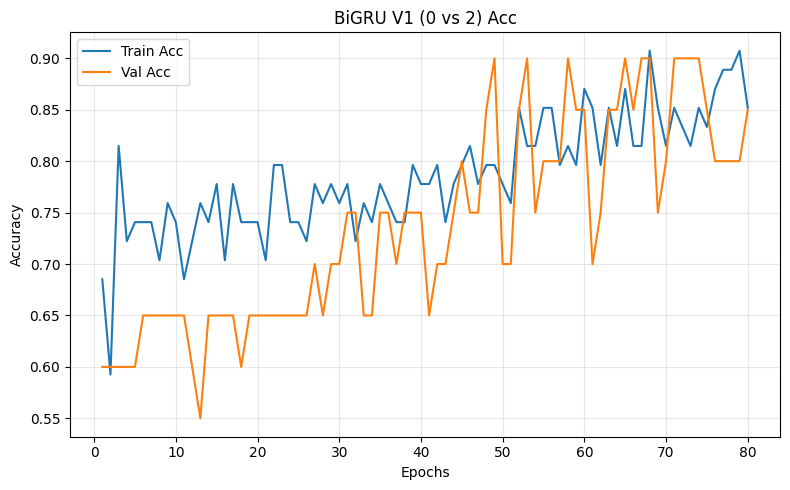

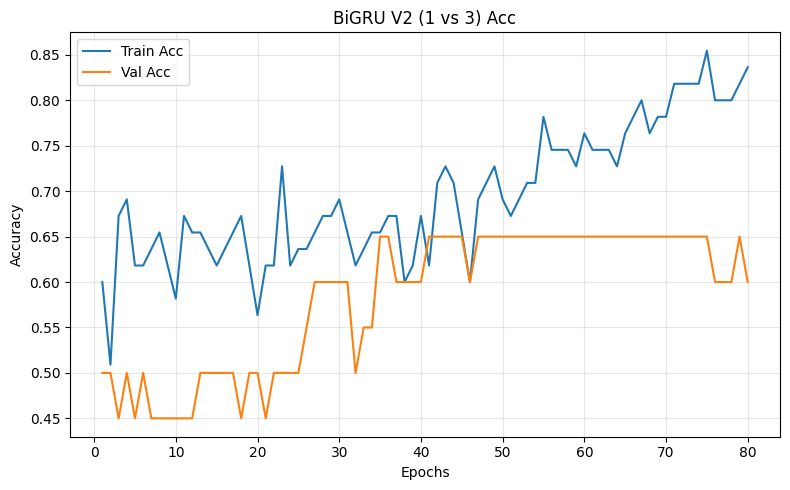

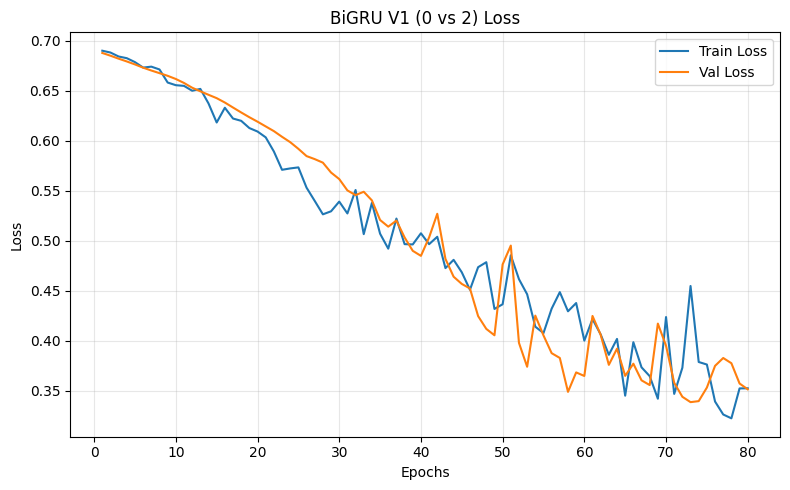

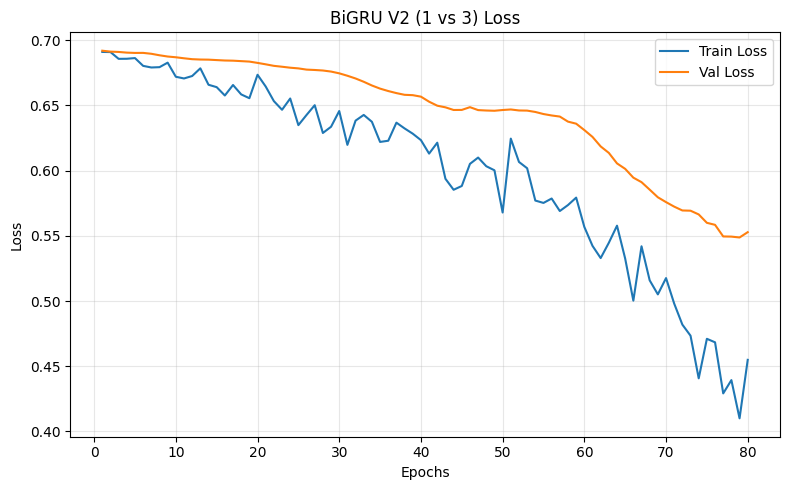

In [58]:
"""
BiGRU baseline (aligned with CNN pipeline)
- Multiplexing: Linear resampling + robust scaling + participant-wise splits
- Model: Multi-layer BiGRU (return_sequences=True) → GAP → Small fully connected head
- Loss: binary_crossentropy
- EarlyStopping + ReduceLROnPlateau
"""

import os, time
from typing import List, Tuple, Dict
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Reuse existing utility functions (make sure they are in the same file or from ... import ...)
# Existing: _linear_resample, _robust_scale_per_trace, load_pair_experiment,
#      split_by_participant_train_val_test, compute_class_weight, get_optimizer

# BiGRU Model
def build_bigru_model(
    input_shape,                 # (T, C) e.g., (1500, 4)
    rnn_units: int = 64,
    rnn_layers: int = 2,
    dropout: float = 0.3,
    recurrent_dropout: float = 0.1,
    use_ln: bool = False         # Whether to add LayerNorm after the sequence dimension
) -> Model:
    """
    Stack BiGRUs (all with return_sequences=True), then perform GlobalAveragePooling1D at the end.
    Followed by a small header (Dense64 + Dropout + Sigmoid).
    This approach is less sensitive to length and more robust to timing misalignment.
    """
    inp = Input(shape=input_shape, name="input")
    x = inp
    for i in range(rnn_layers):
        x = layers.Bidirectional(
            layers.GRU(
                rnn_units,
                return_sequences=True,
                dropout=dropout,
                recurrent_dropout=recurrent_dropout,
                reset_after=True
            ),
            name=f"bigru_{i+1}"
        )(x)
        if use_ln:
            x = layers.LayerNormalization(name=f"ln_{i+1}")(x)

    # Pooled sequence output (can also be replaced with Attention/GMP)
    x = layers.GlobalAveragePooling1D(name="gap")(x)
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(0.5, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name="bigru_baseline")

# Runner (same as CNN version)
def run_experiment_bigru(
    csv_dir: str,
    label_pair: Tuple[int, int],
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    # BiGRU hyperparameters
    rnn_units: int = 64,
    rnn_layers: int = 2,
    dropout: float = 0.3,
    recurrent_dropout: float = 0.1,
    use_ln: bool = False
) -> Dict:
    # 1) Data (fully reused loading and preprocessing)
    X, y, files = load_pair_experiment(
        csv_dir,
        label_pair,
        resample_len=target_len,
        max_nan_ratio=0.05,
        divide_by_960=True,
        use_robust_scale=True
    )

    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    print(f"[Split] train={len(ytr)}, val={len(yva)}, test={len(yte)}")

    # 2) Model
    model = build_bigru_model(
        input_shape=(target_len, X.shape[-1]),
        rnn_units=rnn_units, rnn_layers=rnn_layers,
        dropout=dropout, recurrent_dropout=recurrent_dropout,
        use_ln=use_ln
    )
    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])

    # 3) Training strategy (same as CNN version)
    callbacks = [
        tf.keras.callbacks.EarlyStopping(
            monitor='val_loss', patience=early_patience, restore_best_weights=True
        ),
        tf.keras.callbacks.ReduceLROnPlateau(
            monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1
        ),
        tf.keras.callbacks.CSVLogger(f'train_log_bigru_{label_pair[0]}_{label_pair[1]}.csv', append=False)
    ]
    class_weight = compute_class_weight(ytr)

    # 4) Train
    t0 = time.perf_counter()
    history = model.fit(
        Xtr, ytr,
        validation_data=(Xva, yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=1,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()
    print(f"[Time][BiGRU] Pair {label_pair}: training wall-clock {t1 - t0:.2f}s")

    # 5) Test
    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    report = classification_report(yte, ypred, digits=4)
    print(f"\n[TEST][BiGRU] Pair {label_pair} classification report:\n{report}")

    return {
        'label_pair': label_pair,
        'history': history.history,
        'test_report': report,
        'model': model,
        'id_splits': id_splits
    }

# Curve drawing (same as existing drawing method)
import matplotlib.pyplot as plt

def plot_accuracy_curve(history_dict, title, save_path=None):
    acc = history_dict.get('accuracy', [])
    val_acc = history_dict.get('val_accuracy', [])
    epochs = range(1, len(acc) + 1)
    plt.figure(figsize=(8, 5))
    plt.plot(epochs, acc, label='Train Acc')
    plt.plot(epochs, val_acc, label='Val Acc')
    plt.xlabel('Epochs'); plt.ylabel('Accuracy'); plt.title(title)
    plt.legend(); plt.grid(True, alpha=0.3); plt.tight_layout()
    if save_path is not None:
        plt.savefig(save_path, dpi=200)
    plt.show()

def plot_loss_curve(history_dict, title, save_path=None):
    loss = history_dict.get('loss', [])
    val_loss = history_dict.get('val_loss', [])
    epochs = range(1, len(loss) + 1)
    plt.figure(figsize=(8, 5))
    plt.plot(epochs, loss, label='Train Loss')
    plt.plot(epochs, val_loss, label='Val Loss')
    plt.xlabel('Epochs'); plt.ylabel('Loss'); plt.title(title)
    plt.legend(); plt.grid(True, alpha=0.3); plt.tight_layout()
    if save_path is not None:
        plt.savefig(save_path, dpi=200)
    plt.show()

# Run
if __name__ == "__main__":
    csv_path = "/Users/wukehui/Desktop/data science project/project/data/first_trials"

    # Run two pairs of the same CNN
    res_02 = run_experiment_bigru(
        csv_path, (0, 2), target_len=1500,
        # BiGRU hyperparameters (can be fine-tuned as needed)
        rnn_units=64, rnn_layers=2,
        dropout=0.3, recurrent_dropout=0.1,
        use_ln=False,
        batch_size=16, max_epochs=80, lr=3e-4, early_patience=15
    )
    res_13 = run_experiment_bigru(
        csv_path, (1, 3), target_len=1500,
        rnn_units=64, rnn_layers=2,
        dropout=0.3, recurrent_dropout=0.1,
        use_ln=False
    )

    # Training curve
    plot_accuracy_curve(res_02['history'], title='BiGRU V1 (0 vs 2) Acc', save_path='bigru_v1_acc.png')
    plot_accuracy_curve(res_13['history'], title='BiGRU V2 (1 vs 3) Acc', save_path='bigru_v2_acc.png')
    plot_loss_curve(res_02['history'], title='BiGRU V1 (0 vs 2) Loss', save_path='bigru_v1_loss.png')
    plot_loss_curve(res_13['history'], title='BiGRU V2 (1 vs 3) Loss', save_path='bigru_v2_loss.png')


bigru transfer learning

[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[Pretrain|BiGRU] source=(0, 2)
Epoch 1/60
4/4 [==============================] - 11s 1s/step - loss: 0.6948 - accuracy: 0.4630 - auc: 0.4361 - val_loss: 0.6939 - val_accuracy: 0.5000 - val_auc: 0.4400 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 5s 1s/step - loss: 0.6894 - accuracy: 0.6481 - auc: 0.6696 - val_loss: 0.6907 - val_accuracy: 0.7000 - val_auc: 0.6300 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 5s 1s/step - loss: 0.6817 - accuracy: 0.6852 - auc: 0.7905 - val_loss: 0.6881 - val_accuracy: 0.6500 - val_auc: 0.6700 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 5s 1s/step - loss: 0.6785 - accuracy: 0.7407 - auc: 0.7692 - val_loss: 0.6858 - val_accuracy: 0.5500 - val_auc: 0.7100 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 5s 1s/step - loss: 0.6801 - accuracy: 0.6852 - auc: 0.7067 - val_loss: 0.6832 - val_accur

2/2 [==============================] - 2s 1s/step - loss: 0.5746 - accuracy: 0.6364 - auc: 0.7686 - val_loss: 0.4894 - val_accuracy: 0.7500 - val_auc: 0.8750 - lr: 5.0000e-05
Epoch 5/60
2/2 [==============================] - 2s 1s/step - loss: 0.5745 - accuracy: 0.7273 - auc: 0.8182 - val_loss: 0.4892 - val_accuracy: 0.7500 - val_auc: 0.8750 - lr: 5.0000e-05
Epoch 6/60
2/2 [==============================] - 2s 729ms/step - loss: 0.5668 - accuracy: 0.7273 - auc: 0.7893 - val_loss: 0.4891 - val_accuracy: 0.7500 - val_auc: 0.8750 - lr: 5.0000e-05
Epoch 7/60
2/2 [==============================] - 2s 1s/step - loss: 0.5723 - accuracy: 0.6818 - auc: 0.7810 - val_loss: 0.4888 - val_accuracy: 0.7500 - val_auc: 0.8750 - lr: 5.0000e-05
Epoch 8/60
2/2 [==============================] - 2s 1s/step - loss: 0.5643 - accuracy: 0.7727 - auc: 0.7893 - val_loss: 0.4882 - val_accuracy: 0.7500 - val_auc: 0.8750 - lr: 5.0000e-05
Epoch 9/60
2/2 [==============================] - 2s 997ms/step - loss: 0.5959

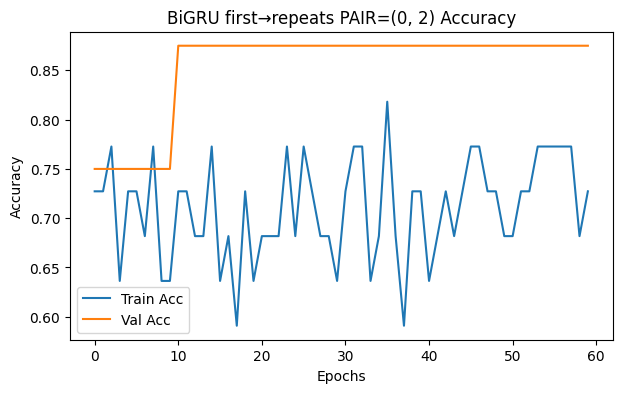

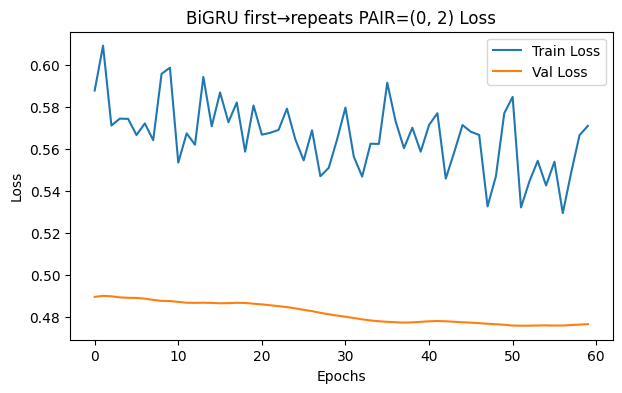


=== BiGRU transfer (1,3) → (0,2) within FIRST_DIR ===
[load_pair_experiment] Dir=first_trials Labels=(1, 3), files=98, shape=(98, 1500, 4)
[Pretrain|BiGRU] source=(1, 3)
Epoch 1/60
4/4 [==============================] - 7s 1s/step - loss: 0.6935 - accuracy: 0.5088 - auc: 0.5234 - val_loss: 0.6915 - val_accuracy: 0.5000 - val_auc: 0.5100 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 5s 1s/step - loss: 0.6917 - accuracy: 0.5263 - auc: 0.5517 - val_loss: 0.6909 - val_accuracy: 0.4500 - val_auc: 0.5100 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 5s 1s/step - loss: 0.6961 - accuracy: 0.4561 - auc: 0.4150 - val_loss: 0.6903 - val_accuracy: 0.5000 - val_auc: 0.5350 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 5s 1s/step - loss: 0.6900 - accuracy: 0.4912 - auc: 0.5628 - val_loss: 0.6900 - val_accuracy: 0.5000 - val_auc: 0.5550 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 5s 1s/step - loss: 0.6854 - accurac

Epoch 44/60
4/4 [==============================] - 5s 1s/step - loss: 0.6041 - accuracy: 0.7018 - auc: 0.7488 - val_loss: 0.6223 - val_accuracy: 0.6500 - val_auc: 0.6850 - lr: 3.0000e-04
Epoch 45/60
4/4 [==============================] - 5s 1s/step - loss: 0.6072 - accuracy: 0.7193 - auc: 0.7451 - val_loss: 0.6197 - val_accuracy: 0.7000 - val_auc: 0.6800 - lr: 3.0000e-04
Epoch 46/60
4/4 [==============================] - 5s 1s/step - loss: 0.6036 - accuracy: 0.7193 - auc: 0.7408 - val_loss: 0.6173 - val_accuracy: 0.7000 - val_auc: 0.6800 - lr: 3.0000e-04
Epoch 47/60
4/4 [==============================] - 5s 1s/step - loss: 0.5775 - accuracy: 0.6842 - auc: 0.7796 - val_loss: 0.6164 - val_accuracy: 0.7000 - val_auc: 0.6850 - lr: 3.0000e-04
Epoch 48/60
4/4 [==============================] - 5s 1s/step - loss: 0.6024 - accuracy: 0.7193 - auc: 0.7611 - val_loss: 0.6145 - val_accuracy: 0.6500 - val_auc: 0.7050 - lr: 3.0000e-04
Epoch 49/60
4/4 [==============================] - 5s 1s/step - l

4/4 [==============================] - 3s 859ms/step - loss: 0.6131 - accuracy: 0.6667 - auc: 0.7218 - val_loss: 0.6833 - val_accuracy: 0.6000 - val_auc: 0.6200 - lr: 5.0000e-05
Epoch 45/60
4/4 [==============================] - 4s 902ms/step - loss: 0.6300 - accuracy: 0.6111 - auc: 0.6841 - val_loss: 0.6831 - val_accuracy: 0.6000 - val_auc: 0.6300 - lr: 5.0000e-05
Epoch 46/60
4/4 [==============================] - 4s 912ms/step - loss: 0.6169 - accuracy: 0.7037 - auc: 0.7239 - val_loss: 0.6829 - val_accuracy: 0.6000 - val_auc: 0.6400 - lr: 5.0000e-05
Epoch 47/60
4/4 [==============================] - 4s 884ms/step - loss: 0.6286 - accuracy: 0.6852 - auc: 0.6861 - val_loss: 0.6828 - val_accuracy: 0.6000 - val_auc: 0.6400 - lr: 5.0000e-05
Epoch 48/60
4/4 [==============================] - 4s 890ms/step - loss: 0.6322 - accuracy: 0.6667 - auc: 0.7157 - val_loss: 0.6828 - val_accuracy: 0.6000 - val_auc: 0.6400 - lr: 5.0000e-05
Epoch 49/60
4/4 [==============================] - 4s 890ms/st

Epoch 24/60
4/4 [==============================] - 5s 1s/step - loss: 0.5642 - accuracy: 0.7778 - auc: 0.8262 - val_loss: 0.6095 - val_accuracy: 0.6500 - val_auc: 0.7250 - lr: 3.0000e-04
Epoch 25/60
4/4 [==============================] - 5s 1s/step - loss: 0.5718 - accuracy: 0.7407 - auc: 0.7988 - val_loss: 0.6022 - val_accuracy: 0.6500 - val_auc: 0.7300 - lr: 3.0000e-04
Epoch 26/60
4/4 [==============================] - 5s 1s/step - loss: 0.5239 - accuracy: 0.7407 - auc: 0.8420 - val_loss: 0.5968 - val_accuracy: 0.6500 - val_auc: 0.7400 - lr: 3.0000e-04
Epoch 27/60
4/4 [==============================] - 5s 1s/step - loss: 0.5522 - accuracy: 0.7037 - auc: 0.8056 - val_loss: 0.5923 - val_accuracy: 0.6500 - val_auc: 0.7450 - lr: 3.0000e-04
Epoch 28/60
4/4 [==============================] - 5s 1s/step - loss: 0.5505 - accuracy: 0.7593 - auc: 0.8139 - val_loss: 0.5870 - val_accuracy: 0.6500 - val_auc: 0.7650 - lr: 3.0000e-04
Epoch 29/60
4/4 [==============================] - 5s 1s/step - l

2/2 [==============================] - 2s 943ms/step - loss: 0.5667 - accuracy: 0.7727 - auc: 0.7934 - val_loss: 0.4994 - val_accuracy: 0.8750 - val_auc: 0.8750 - lr: 5.0000e-05
Epoch 28/60
2/2 [==============================] - 2s 877ms/step - loss: 0.5873 - accuracy: 0.6818 - auc: 0.7810 - val_loss: 0.4986 - val_accuracy: 0.8750 - val_auc: 0.8750 - lr: 5.0000e-05
Epoch 29/60
2/2 [==============================] - 2s 817ms/step - loss: 0.5806 - accuracy: 0.7727 - auc: 0.7645 - val_loss: 0.4980 - val_accuracy: 0.8750 - val_auc: 0.8750 - lr: 5.0000e-05
Epoch 30/60
2/2 [==============================] - 2s 1s/step - loss: 0.5580 - accuracy: 0.7273 - auc: 0.8512 - val_loss: 0.4975 - val_accuracy: 0.8750 - val_auc: 0.8750 - lr: 5.0000e-05
Epoch 31/60
2/2 [==============================] - 2s 949ms/step - loss: 0.5847 - accuracy: 0.7273 - auc: 0.8058 - val_loss: 0.4969 - val_accuracy: 0.8750 - val_auc: 0.8750 - lr: 5.0000e-05
Epoch 32/60
2/2 [==============================] - 2s 957ms/step 

In [59]:
"""
Transfer Learning for BiGRU on Eye-Tracking
- Stage 0: Pretrain BiGRU extractor on SOURCE (e.g., (0,2) in first_trials)
- Stage 1: On TARGET, freeze BiGRU, train head only
- Stage 1.5: (optional) LN-Adapt (only LayerNorm trainable) if use_ln=True
- Stage 2: Unfreeze last BiGRU block (or all) and fine-tune @ low LR
- Threshold tuning on VAL by balanced accuracy, then TEST
"""

import os, time
from typing import Tuple, Dict, Optional, List
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.metrics import classification_report, balanced_accuracy_score
from sklearn.model_selection import train_test_split

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Reuse the following functions
# - get_participant_id(filename)
# - _linear_resample(x, target_len)
# - _robust_scale_per_trace(x)
# - load_pair_experiment(csv_dir, labels, resample_len, max_nan_ratio, divide_by_960, use_robust_scale)
# - split_by_participant_train_val_test(X, y, files, val_size, test_size, random_state)
# - compute_class_weight(y_train)
# - get_optimizer(lr)

# BiGRU Extractor & Classifier
def build_bigru_extractor(
    input_shape,                 # (T, C)
    rnn_units: int = 64,
    rnn_layers: int = 2,
    dropout: float = 0.3,
    recurrent_dropout: float = 0.1,
    use_ln: bool = False
) -> Model:
    """
    BiGRU stacks, all with return_sequences=True; the outputs are aggregated into a single vector (equivalent to a "feature") using GAP.
    """
    inp = Input(shape=input_shape, name="input")
    x = inp
    for i in range(rnn_layers):
        x = layers.Bidirectional(
            layers.GRU(
                rnn_units,
                return_sequences=True,
                dropout=dropout,
                recurrent_dropout=recurrent_dropout,
                reset_after=True
            ),
            name=f"bigru_{i+1}"
        )(x)
        if use_ln:
            x = layers.LayerNormalization(name=f"ln_{i+1}")(x)
    feat = layers.GlobalAveragePooling1D(name="gap")(x)  # Extractor output features
    return Model(inp, feat, name="bigru_extractor")

def build_classifier_from_extractor(extractor: Model, dropout=0.5) -> Model:
    inp = extractor.input
    x = extractor.output
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(dropout, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name="bigru_transfer")

# Freeze helpers
def freeze_all_rnn(model: Model, freeze: bool = True):
    """
    Freeze/unfreeze all layers except head('fc1','drop','logit') .
    """
    for l in model.layers:
        if l.name in ['fc1','drop','logit']:
            l.trainable = True
        else:
            l.trainable = (not freeze)

def freeze_except_last_bigru(model: Model):
    """
    Only the last BiGRU layer (+ the following LN/GAP/Head) is unfrozen, and the rest of the layers are frozen.
    """
    # Freeze all first
    for l in model.layers:
        l.trainable = False
    # Find the last bigru_* layer and unfreeze it and subsequent layers
    last_name = None
    for l in model.layers:
        if l.name.startswith("bigru_"):
            last_name = l.name
    # Unfreeze: final bigru, subsequent LN, gap, fc1, drop, logit
    to_unfreeze = set(['gap','fc1','drop','logit'])
    if last_name:
        to_unfreeze.add(last_name)
        # If using LayerNorm, name it ln_*
        # Unfreeze the LN following the last layer (if any)
        for l in model.layers:
            if l.name.startswith("ln_"):
                to_unfreeze.add(l.name)
    for name in to_unfreeze:
        try:
            model.get_layer(name).trainable = True
        except ValueError:
            pass

def ln_adapt_only(model: Model):
    """
    RNN does not have BN, here provides "LN-Adapt": only LayerNorm is trainable (if use_ln=True).
    """
    for l in model.layers:
        if isinstance(l, layers.LayerNormalization):
            l.trainable = True
        else:
            l.trainable = False

# Threshold tuning
def tune_threshold_bal_acc(y_true: np.ndarray, y_prob: np.ndarray) -> Tuple[float, float]:
    best_thr, best_bal = 0.5, -1.0
    for thr in np.linspace(0.1, 0.9, 33):
        y_pred = (y_prob >= thr).astype(int)
        bal = balanced_accuracy_score(y_true, y_pred)
        if bal > best_bal:
            best_bal, best_thr = bal, float(thr)
    return best_thr, best_bal

def evaluate_with_threshold(model: Model, Xv, yv, Xt, yt, batch_size=16):
    vprob = model.predict(Xv, batch_size=batch_size).ravel()
    thr, bal = tune_threshold_bal_acc(yv, vprob)
    tprob = model.predict(Xt, batch_size=batch_size).ravel()
    tpred = (tprob >= thr).astype(int)
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")
    print("\n[TEST] Transfer report (thr tuned):\n",
          classification_report(yt, tpred, digits=4))
    return thr, bal

# Stage 0: Pretrain extractor on SOURCE
def pretrain_extractor_on_source_bigru(
    csv_dir: str, src_pair=(0,2),
    target_len=1500, batch_size=16, max_epochs=60, lr=3e-4,
    rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1, use_ln=False,
    save_path='bigru_extractor_src.weights.h5'
):
    X, y, files = load_pair_experiment(csv_dir, src_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(X, y, files)

    extractor = build_bigru_extractor(
        (target_len, X.shape[-1]),
        rnn_units=rnn_units, rnn_layers=rnn_layers,
        dropout=dropout, recurrent_dropout=recurrent_dropout, use_ln=use_ln
    )
    model = build_classifier_from_extractor(extractor)

    model.compile(optimizer=get_optimizer(lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    print(f"[Pretrain|BiGRU] source={src_pair}")
    t0 = time.perf_counter()
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1, callbacks=cbs)
    t1 = time.perf_counter()
    print(f"[Time] Pretrain wall-clock: {t1 - t0:.2f}s")

    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob >= 0.5).astype(int)
    print("[TEST] Pretrain report:\n", classification_report(yte, ypred, digits=4))

    extractor.save_weights(save_path)
    print(f"[SAVE] BiGRU extractor -> {save_path}")
    return save_path

# Stage 1/1.5/2: Transfer on TARGET
def transfer_finetune_bigru(
    csv_dir: str, tgt_pair=(1,3),
    extractor_weights: str = 'bigru_extractor_src.weights.h5',
    target_len=1500, batch_size=16,
    # head / ft LRs
    head_lr=1.5e-3, ft_lr=5e-5,
    # extractor hparams (must match pretrain)
    rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1, use_ln=False,
    # which stage-2 strategy: 'last' (last BiGRU only) or 'all'
    finetune_mode: str = 'last'
):
    # Target domain data
    X, y, files = load_pair_experiment(csv_dir, tgt_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(X, y, files)
    cls_weight = compute_class_weight(ytr)

    # Build and load the extractor
    extractor = build_bigru_extractor(
        (target_len, X.shape[-1]),
        rnn_units=rnn_units, rnn_layers=rnn_layers,
        dropout=dropout, recurrent_dropout=recurrent_dropout, use_ln=use_ln
    )
    extractor.load_weights(extractor_weights)
    model = build_classifier_from_extractor(extractor)

    # Stage 1: Head-only
    freeze_all_rnn(model, freeze=True)
    model.compile(optimizer=get_optimizer(head_lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=4,
                                             min_lr=head_lr/4, verbose=1)
    ]
    print("[Stage 1] Head-only.")
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1, callbacks=cbs1,
              class_weight=cls_weight)

    # Stage 1.5: LN-Adapt (only valid if use_ln=True)
    if use_ln:
        print("[LN-Adapt] epochs=2, lr=1e-5 (only LayerNorm trainable)")
        ln_adapt_only(model)
        model.compile(optimizer=get_optimizer(1e-5),
                      loss='binary_crossentropy',
                      metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
        model.fit(Xtr, ytr, validation_data=(Xva, yva),
                  epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: Fine-tune
    if finetune_mode == 'last':
        print("[Stage 2] Fine-tune LAST BiGRU block @ LR=5e-5.")
        freeze_except_last_bigru(model)
    else:
        print("[Stage 2] Fine-tune ALL BiGRU layers @ LR=5e-5.")
        freeze_all_rnn(model, freeze=False)

    model.compile(optimizer=get_optimizer(ft_lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=12, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=8,
                                             min_lr=ft_lr/4, verbose=1)
    ]
    t0 = time.perf_counter()
    hist2 = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                      epochs=60, batch_size=batch_size, verbose=1, callbacks=cbs2,
                      class_weight=cls_weight)
    t1 = time.perf_counter()
    print(f"[Time] Fine-tune wall-clock: {t1 - t0:.2f}s")

    # Threshold is tuned on validation set → test
    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, (Xtr, ytr, Xva, yva, Xte, yte, split_info), hist2.history, thr

# "source → target directory" version (first_trials → repeats)
def transfer_first_to_repeats_bigru(
    src_dir: str, tgt_dir: str, pair=(0,2),
    extractor_weights_path: Optional[str] = None,
    target_len=1500, batch_size=16,
    rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1, use_ln=False,
    head_lr=1.5e-3, ft_lr=5e-5, finetune_mode='last'
):
    # If no pre-training weights are provided, pre-train in the source domain first.
    if extractor_weights_path is None:
        extractor_weights_path = pretrain_extractor_on_source_bigru(
            csv_dir=src_dir, src_pair=pair, target_len=target_len,
            batch_size=batch_size, max_epochs=60, lr=3e-4,
            rnn_units=rnn_units, rnn_layers=rnn_layers,
            dropout=dropout, recurrent_dropout=recurrent_dropout, use_ln=use_ln,
            save_path=f"bigru_extractor_first_{pair[0]}_{pair[1]}.weights.h5"
        )

    # Load the target domain and transfer fine-tuning
    X, y, files = load_pair_experiment(tgt_dir, pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(X, y, files)
    cls_weight = compute_class_weight(ytr)

    extractor = build_bigru_extractor(
        (target_len, X.shape[-1]),
        rnn_units=rnn_units, rnn_layers=rnn_layers,
        dropout=dropout, recurrent_dropout=recurrent_dropout, use_ln=use_ln
    )
    extractor.load_weights(extractor_weights_path)
    model = build_classifier_from_extractor(extractor)

    # Stage 1
    freeze_all_rnn(model, freeze=True)
    model.compile(optimizer=get_optimizer(head_lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5,
                                                 min_lr=head_lr/4, verbose=1)]
    print("[Stage 1] Head-only (first→repeats).")
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=20, batch_size=batch_size, verbose=1, callbacks=cbs1,
              class_weight=cls_weight)

    # Stage 1.5 (LN-Adapt)
    if use_ln:
        print("[LN-Adapt] epochs=2, lr=1e-5")
        ln_adapt_only(model)
        model.compile(optimizer=get_optimizer(1e-5),
                      loss='binary_crossentropy',
                      metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
        model.fit(Xtr, ytr, validation_data=(Xva, yva),
                  epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2
    if finetune_mode == 'last':
        print("[Stage 2] Fine-tune LAST BiGRU @ LR=5e-5.")
        freeze_except_last_bigru(model)
    else:
        print("[Stage 2] Fine-tune ALL BiGRU @ LR=5e-5.")
        freeze_all_rnn(model, freeze=False)

    model.compile(optimizer=get_optimizer(ft_lr),
                  loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12,
                                                 min_lr=ft_lr/4, verbose=1)]
    t0 = time.perf_counter()
    hist2 = model.fit(Xtr, ytr, validation_data=(Xva, yva),
                      epochs=60, batch_size=batch_size, verbose=1, callbacks=cbs2,
                      class_weight=cls_weight)
    t1 = time.perf_counter()
    print(f"[Time] Fine-tune wall-clock: {t1 - t0:.2f}s")

    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, (Xtr, ytr, Xva, yva, Xte, yte, split_info), hist2.history, thr

# Gadget: Draw Curve
import matplotlib.pyplot as plt
def plot_history_acc_loss(history, title_prefix=""):
    if history is None:
        return
    acc = history.get('accuracy', [])
    val_acc = history.get('val_accuracy', [])
    loss = history.get('loss', [])
    val_loss = history.get('val_loss', [])
    plt.figure(figsize=(7,4))
    plt.plot(acc, label='Train Acc'); plt.plot(val_acc, label='Val Acc')
    plt.xlabel("Epochs"); plt.ylabel("Accuracy"); plt.title(f"{title_prefix} Accuracy"); plt.legend(); plt.show()

    plt.figure(figsize=(7,4))
    plt.plot(loss, label='Train Loss'); plt.plot(val_loss, label='Val Loss')
    plt.xlabel("Epochs"); plt.ylabel("Loss"); plt.title(f"{title_prefix} Loss"); plt.legend(); plt.show()

# Run
if __name__ == "__main__":
    FIRST_DIR  = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEATS_DIR= "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (0, 2)
    TLEN = 1500
    BATCH = 16

    # 1) Pretrain extractor on FIRST(0,2)
    extractor_w = pretrain_extractor_on_source_bigru(
        csv_dir=FIRST_DIR, src_pair=PAIR, target_len=TLEN,
        batch_size=BATCH, max_epochs=60, lr=3e-4,
        rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1, use_ln=False,
        save_path=f"bigru_extractor_first_{PAIR[0]}_{PAIR[1]}.weights.h5"
    )

    # 2) Migrate to REPEATS (head-only -> (optional) LN-Adapt -> last layer BiGRU fine-tuning)
    model_t, splits, hist2, best_thr = transfer_first_to_repeats_bigru(
        src_dir=FIRST_DIR, tgt_dir=REPEATS_DIR, pair=PAIR,
        extractor_weights_path=extractor_w,
        target_len=TLEN, batch_size=BATCH,
        rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1, use_ln=False,
        head_lr=1.5e-3, ft_lr=5e-5, finetune_mode='last'  # 'all' can also be tried
    )

    # Draw the final stage curve
    plot_history_acc_loss({'accuracy': hist2.get('accuracy', []),
                           'val_accuracy': hist2.get('val_accuracy', []),
                           'loss': hist2.get('loss', []),
                           'val_loss': hist2.get('val_loss', [])},
                          title_prefix=f"BiGRU first→repeats PAIR={PAIR}")
    
    
# Convenience runners: (1,3)->(0,2) & first->repeats

def run_pair_to_pair_bigru(
    csv_dir: str,
    src_pair=(1, 3),
    tgt_pair=(0, 2),
    target_len=1500, batch_size=16,
    rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1, use_ln=False,
    head_lr=1.5e-3, ft_lr=5e-5, finetune_mode='last'
):
    """
    Migrate data in the same directory: Pretrain a BiGRU extractor in src_pair, 
    then migrate it to tgt_pair (head-only -> (optional) LN-Adapt -> fine-tune the last layer/all layers).
    """
    # Stage-0: pretrain on SOURCE pair
    w_path = pretrain_extractor_on_source_bigru(
        csv_dir=csv_dir, src_pair=src_pair, target_len=target_len,
        batch_size=batch_size, max_epochs=60, lr=3e-4,
        rnn_units=rnn_units, rnn_layers=rnn_layers,
        dropout=dropout, recurrent_dropout=recurrent_dropout, use_ln=use_ln,
        save_path=f"bigru_extractor_src_{src_pair[0]}_{src_pair[1]}.weights.h5"
    )

    # Stage-1/2: transfer to TARGET pair (same directory)
    model_t, splits, hist2, best_thr = transfer_finetune_bigru(
        csv_dir=csv_dir, tgt_pair=tgt_pair,
        extractor_weights=w_path, target_len=target_len, batch_size=batch_size,
        head_lr=head_lr, ft_lr=ft_lr,
        rnn_units=rnn_units, rnn_layers=rnn_layers,
        dropout=dropout, recurrent_dropout=recurrent_dropout, use_ln=use_ln,
        finetune_mode=finetune_mode
    )
    return model_t, splits, hist2, best_thr


def run_first_to_repeats_bigru(
    first_dir: str,
    repeats_dir: str,
    pair=(0, 2),
    target_len=1500, batch_size=16,
    rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1, use_ln=False,
    head_lr=1.5e-3, ft_lr=5e-5, finetune_mode='last',
    extractor_weights_path: str | None = None
):
    """
    Cross-domain transfer: Pre-train on first_trials (or load trained weights), 
    then transfer to repeats (head-only -> (optional) LN-Adapt -> fine-tune).
    """
    model_t, splits, hist2, best_thr = transfer_first_to_repeats_bigru(
        src_dir=first_dir, tgt_dir=repeats_dir, pair=pair,
        extractor_weights_path=extractor_weights_path,
        target_len=target_len, batch_size=batch_size,
        rnn_units=rnn_units, rnn_layers=rnn_layers,
        dropout=dropout, recurrent_dropout=recurrent_dropout, use_ln=use_ln,
        head_lr=head_lr, ft_lr=ft_lr, finetune_mode=finetune_mode
    )
    return model_t, splits, hist2, best_thr


# Run
if __name__ == "__main__":
    FIRST_DIR   = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEATS_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    TLEN, BATCH = 1500, 16

    # A) Migrate in the same direction: (1,3) -> (0,2) on FIRST_DIR
    print("\n=== BiGRU transfer (1,3) → (0,2) within FIRST_DIR ===")
    model_dir, splits_dir, hist_dir, thr_dir = run_pair_to_pair_bigru(
        csv_dir=FIRST_DIR,
        src_pair=(1,3),
        tgt_pair=(0,2),
        target_len=TLEN, batch_size=BATCH,
        rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1, use_ln=False,
        head_lr=1.5e-3, ft_lr=5e-5, finetune_mode='last'   # 'all' can also be tried
    )

    # B) Cross-domain migration: first_trials -> repeats (pair = (0,2))
    print("\n=== BiGRU transfer FIRST → REPEATS (pair=(0,2)) ===")
    model_xd, splits_xd, hist_xd, thr_xd = run_first_to_repeats_bigru(
        first_dir=FIRST_DIR,
        repeats_dir=REPEATS_DIR,
        pair=(0,2),
        target_len=TLEN, batch_size=BATCH,
        rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1, use_ln=False,
        head_lr=1.5e-3, ft_lr=5e-5, finetune_mode='last',
        extractor_weights_path=None   # If there are weights available to fill in the path, skip pre-training
    )

    # Draw the final stage curve
    # plot_history_acc_loss(hist_dir, title_prefix="BiGRU (1,3)→(0,2) Stage-2")
    # plot_history_acc_loss(hist_xd,  title_prefix="BiGRU first→repeats Stage-2")


Repeat Trials Generalisation Test for bigru


=== A1: in-domain baseline (FIRST, BiGRU) ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[Pretrain-BiGRU] source=(0, 2)
Epoch 1/60
4/4 [==============================] - 10s 2s/step - loss: 0.6761 - accuracy: 0.6296 - auc: 0.5941 - val_loss: 0.6920 - val_accuracy: 0.5000 - val_auc: 0.6850 - lr: 3.0000e-04
Epoch 2/60
4/4 [==============================] - 6s 2s/step - loss: 0.6595 - accuracy: 0.6111 - auc: 0.6930 - val_loss: 0.6913 - val_accuracy: 0.5000 - val_auc: 0.6800 - lr: 3.0000e-04
Epoch 3/60
4/4 [==============================] - 6s 1s/step - loss: 0.6601 - accuracy: 0.5741 - auc: 0.6765 - val_loss: 0.6915 - val_accuracy: 0.5000 - val_auc: 0.7400 - lr: 3.0000e-04
Epoch 4/60
4/4 [==============================] - 6s 1s/step - loss: 0.6355 - accuracy: 0.6852 - auc: 0.7610 - val_loss: 0.6919 - val_accuracy: 0.5000 - val_auc: 0.7700 - lr: 3.0000e-04
Epoch 5/60
4/4 [==============================] - 6s 2s/step - loss: 0.6187 - accuracy: 0.64

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[TEST][Pretrain] report:
               precision    recall  f1-score   support

           0     0.4444    1.0000    0.6154         8
           1     0.0000    0.0000    0.0000        10

    accuracy                         0.4444        18
   macro avg     0.2222    0.5000    0.3077        18
weighted avg     0.1975    0.4444    0.2735        18

[SAVE] BiGRU extractor -> bigru_extractor_first_0_2.weights.h5
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
Epoch 1/20
4/4 [==============================] - 5s 733ms/step - loss: 0.7054 - accuracy: 0.4444 - auc: 0.3942 - val_loss: 0.6859 - val_accuracy: 0.8500 - val_auc: 0.8250 - lr: 0.0030
Epoch 2/20
4/4 [==============================] - 2s 646ms/step - loss: 0.6963 - accuracy: 0.5000 - auc: 0.4952 - val_loss: 0.6812 - val_accuracy: 0.5000 - val_auc: 0.9550 - lr: 0.0030
Epoch 3/20
4/4 [==============================] - 2s 552ms/step - loss: 0.6918 - accuracy: 0.4259 - auc: 0.5391 - val_loss: 0.679

4/4 [==============================] - 7s 2s/step - loss: 0.4847 - accuracy: 0.7593 - auc: 0.8420 - val_loss: 0.6006 - val_accuracy: 0.7500 - val_auc: 0.8500 - lr: 5.0000e-05
Epoch 21/60
4/4 [==============================] - 6s 1s/step - loss: 0.4977 - accuracy: 0.7963 - auc: 0.8434 - val_loss: 0.5998 - val_accuracy: 0.7500 - val_auc: 0.8400 - lr: 5.0000e-05
Epoch 22/60
4/4 [==============================] - 6s 2s/step - loss: 0.5177 - accuracy: 0.7222 - auc: 0.8166 - val_loss: 0.5988 - val_accuracy: 0.7500 - val_auc: 0.8400 - lr: 5.0000e-05
Epoch 23/60
4/4 [==============================] - 4s 1s/step - loss: 0.4562 - accuracy: 0.7963 - auc: 0.8757 - val_loss: 0.5979 - val_accuracy: 0.7500 - val_auc: 0.8400 - lr: 5.0000e-05
Epoch 24/60
4/4 [==============================] - 4s 1s/step - loss: 0.4705 - accuracy: 0.7407 - auc: 0.8613 - val_loss: 0.5969 - val_accuracy: 0.7500 - val_auc: 0.8400 - lr: 5.0000e-05
Epoch 25/60
4/4 [==============================] - 5s 1s/step - loss: 0.4671 

2/2 [==============================] - 10s 2s/step - loss: 0.6932 - accuracy: 0.5000 - auc: 0.4669 - val_loss: 0.6920 - val_accuracy: 0.5000 - val_auc: 0.7500 - lr: 3.0000e-04
Epoch 2/60
2/2 [==============================] - 4s 2s/step - loss: 0.7232 - accuracy: 0.5000 - auc: 0.3264 - val_loss: 0.6902 - val_accuracy: 0.5000 - val_auc: 0.7812 - lr: 3.0000e-04
Epoch 3/60
2/2 [==============================] - 33s 32s/step - loss: 0.6316 - accuracy: 0.7727 - auc: 0.9008 - val_loss: 0.6891 - val_accuracy: 0.5000 - val_auc: 0.8125 - lr: 3.0000e-04
Epoch 4/60
2/2 [==============================] - 3s 1s/step - loss: 0.6547 - accuracy: 0.7727 - auc: 0.7975 - val_loss: 0.6886 - val_accuracy: 0.5000 - val_auc: 0.7812 - lr: 3.0000e-04
Epoch 5/60
2/2 [==============================] - 5s 2s/step - loss: 0.6523 - accuracy: 0.6364 - auc: 0.7231 - val_loss: 0.6881 - val_accuracy: 0.7500 - val_auc: 0.6562 - lr: 3.0000e-04
Epoch 6/60
2/2 [==============================] - 4s 1s/step - loss: 0.6165 - 

Epoch 44/60
2/2 [==============================] - 4s 2s/step - loss: 0.3387 - accuracy: 0.9091 - auc: 0.9669 - val_loss: 0.6615 - val_accuracy: 0.6250 - val_auc: 0.6250 - lr: 1.5000e-04
[TEST][Pretrain] report:
               precision    recall  f1-score   support

           0     0.8333    1.0000    0.9091         5
           1     1.0000    0.8000    0.8889         5

    accuracy                         0.9000        10
   macro avg     0.9167    0.9000    0.8990        10
weighted avg     0.9167    0.9000    0.8990        10

[SAVE] BiGRU extractor -> bigru_extractor_repeats_0_2.weights.h5
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
Epoch 1/20
2/2 [==============================] - 4s 1s/step - loss: 0.7142 - accuracy: 0.4091 - auc: 0.4256 - val_loss: 0.6983 - val_accuracy: 0.5000 - val_auc: 0.1875 - lr: 0.0030
Epoch 2/20
2/2 [==============================] - 2s 1s/step - loss: 0.7084 - accuracy: 0.5000 - auc: 0.4463 - val_loss: 0.6819 - val

Epoch 60/60
2/2 [==============================] - 2s 1s/step - loss: 0.4128 - accuracy: 0.8182 - auc: 0.8802 - val_loss: 0.6347 - val_accuracy: 0.5000 - val_auc: 0.6875 - lr: 1.0000e-05
[VAL] best_threshold=0.225, best_bal_acc=0.7500

[TEST] report (thr tuned):
               precision    recall  f1-score   support

           0     1.0000    0.8000    0.8889         5
           1     0.8333    1.0000    0.9091         5

    accuracy                         0.9000        10
   macro avg     0.9167    0.9000    0.8990        10
weighted avg     0.9167    0.9000    0.8990        10


=== B1: zero-shot FIRST → REPEATS (BiGRU) ===
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)

[EVAL] B1_first→repeats@0.5
label        B1_first→repeats@0.5
thr                           0.5
bal_acc                     0.775
macro_f1                 0.767892
roc_auc                    0.8725
auprc                    0.881043
confusion      [[19, 1], [8, 12]]
n              

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[TEST][Pretrain] report:
               precision    recall  f1-score   support

           0     0.4444    1.0000    0.6154         8
           1     0.0000    0.0000    0.0000        10

    accuracy                         0.4444        18
   macro avg     0.2222    0.5000    0.3077        18
weighted avg     0.1975    0.4444    0.2735        18

[SAVE] BiGRU extractor -> bigru_extractor_first_trials_0_2.weights.h5
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
[K-shot split] train=['029', '006', '016', '057', '058', '041', '009', '048'] val=['065', '062'] test=['054', '011', '042', '072', '021', '049', '036', '047', '056', '071', '032']
Epoch 1/20
1/1 [==============================] - 2s 2s/step - loss: 0.6855 - accuracy: 0.5625 - auc: 0.6484 - val_loss: 0.6944 - val_accuracy: 0.5000 - val_auc: 0.2500 - lr: 0.0030
Epoch 2/20
1/1 [==============================] - 1s 979ms/step - loss: 0.6741 - accuracy: 0.6250 - auc: 0.6250 - val_loss: 0.6929 - va

1/1 [==============================] - 21s 21s/step - loss: 0.5893 - accuracy: 0.8750 - auc: 0.9688 - val_loss: 0.6592 - val_accuracy: 0.5000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 20/60
1/1 [==============================] - 1s 864ms/step - loss: 0.6422 - accuracy: 0.7500 - auc: 0.7109 - val_loss: 0.6589 - val_accuracy: 0.5000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 21/60
1/1 [==============================] - 1s 881ms/step - loss: 0.6151 - accuracy: 0.7500 - auc: 0.7812 - val_loss: 0.6587 - val_accuracy: 0.5000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 22/60
1/1 [==============================] - 1s 856ms/step - loss: 0.6091 - accuracy: 0.6875 - auc: 0.7656 - val_loss: 0.6584 - val_accuracy: 0.5000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 23/60
1/1 [==============================] - 1s 1s/step - loss: 0.5453 - accuracy: 0.8125 - auc: 0.9297 - val_loss: 0.6581 - val_accuracy: 0.5000 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 24/60
1/1 [==============================] - 1s 1s/step - lo

[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
[Pretrain-BiGRU] source=(0, 2)
Epoch 1/60
2/2 [==============================] - 121s 2s/step - loss: 0.7071 - accuracy: 0.4091 - auc: 0.3636 - val_loss: 0.7113 - val_accuracy: 0.5000 - val_auc: 0.1875 - lr: 3.0000e-04
Epoch 2/60
2/2 [==============================] - 3s 2s/step - loss: 0.6932 - accuracy: 0.5000 - auc: 0.5124 - val_loss: 0.7099 - val_accuracy: 0.5000 - val_auc: 0.1562 - lr: 3.0000e-04
Epoch 3/60
2/2 [==============================] - 957s 955s/step - loss: 0.6951 - accuracy: 0.5000 - auc: 0.5372 - val_loss: 0.7095 - val_accuracy: 0.5000 - val_auc: 0.1562 - lr: 3.0000e-04
Epoch 4/60
2/2 [==============================] - 3s 2s/step - loss: 0.6512 - accuracy: 0.6364 - auc: 0.7355 - val_loss: 0.7097 - val_accuracy: 0.5000 - val_auc: 0.1875 - lr: 3.0000e-04
Epoch 5/60
2/2 [==============================] - 197s 1s/step - loss: 0.6723 - accuracy: 0.6364 - auc: 0.6736 - val_loss: 0.7098 - val_acc

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[TEST][Pretrain] report:
               precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000         5
           1     0.5000    1.0000    0.6667         5

    accuracy                         0.5000        10
   macro avg     0.2500    0.5000    0.3333        10
weighted avg     0.2500    0.5000    0.3333        10

[SAVE] BiGRU extractor -> bigru_extractor_repeats_0_2.weights.h5
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[K-shot split] train=['070', '024', '038', '043', '031', '028', '065', '039'] val=['048', '056'] test=['021', '009', '053', '016', '008', '013', '058', '066', '069', '026', '017', '027', '037', '050', '047', '001', '064', '040', '049', '011', '042', '020', '052', '003', '033', '006', '062', '051', '036', '057', '019', '034', '029', '071', '032', '015', '060', '025', '041', '054']
Epoch 1/20
1/1 [==============================] - 3s 3s/step - loss: 0.6859 - accuracy: 0.4667 - auc: 0.7143 - val

Epoch 18/60
1/1 [==============================] - 1s 1s/step - loss: 0.4049 - accuracy: 0.8000 - auc: 0.9554 - val_loss: 0.5671 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 19/60
1/1 [==============================] - 3s 3s/step - loss: 0.4120 - accuracy: 0.8667 - auc: 0.9643 - val_loss: 0.5664 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 20/60
1/1 [==============================] - 1s 926ms/step - loss: 0.4128 - accuracy: 0.8667 - auc: 0.9643 - val_loss: 0.5658 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 21/60
1/1 [==============================] - 1s 1s/step - loss: 0.3549 - accuracy: 0.8667 - auc: 0.9821 - val_loss: 0.5651 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 22/60
1/1 [==============================] - 1s 858ms/step - loss: 0.3991 - accuracy: 0.8667 - auc: 0.9821 - val_loss: 0.5645 - val_accuracy: 0.6667 - val_auc: 1.0000 - lr: 5.0000e-05
Epoch 23/60
1/1 [==============================] - 2s 2s/st

[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
Epoch 1/20
5/5 [==============================] - 70s 16s/step - loss: 0.6975 - accuracy: 0.4865 - auc: 0.4408 - val_loss: 0.6851 - val_accuracy: 0.5200 - val_auc: 0.8462 - lr: 0.0030
Epoch 2/20
5/5 [==============================] - 3s 630ms/step - loss: 0.6928 - accuracy: 0.4730 - auc: 0.5223 - val_loss: 0.6824 - val_accuracy: 0.5600 - val_auc: 0.8526 - lr: 0.0030
Epoch 3/20
5/5 [==============================] - 33s 8s/step - loss: 0.6862 - accuracy: 0.5405 - auc: 0.5998 - val_loss: 0.6776 - val_accuracy: 0.5200 - val_auc: 0.8846 - lr: 0.0030
Epoch 4/20
5/5 [==============================] - 2s 507ms/step - loss: 0.6876 - accuracy: 0.5135 - auc: 0.5735 - val_loss: 0.6731 - val_accuracy: 0.5200 - val_auc: 0.8942 - lr: 0.0030
Epoch 5/20
5/5 [==============================] - 4s 765ms/step - loss: 0.6901 - accuracy: 0.5270 

Epoch 22/60
5/5 [==============================] - 6s 1s/step - loss: 0.5152 - accuracy: 0.7838 - auc: 0.8447 - val_loss: 0.5231 - val_accuracy: 0.7600 - val_auc: 0.8782 - lr: 5.0000e-05
Epoch 23/60
5/5 [==============================] - 24s 6s/step - loss: 0.4311 - accuracy: 0.7838 - auc: 0.8794 - val_loss: 0.5221 - val_accuracy: 0.7600 - val_auc: 0.8814 - lr: 5.0000e-05
Epoch 24/60
5/5 [==============================] - 5s 1s/step - loss: 0.4516 - accuracy: 0.8243 - auc: 0.8841 - val_loss: 0.5208 - val_accuracy: 0.7600 - val_auc: 0.8846 - lr: 5.0000e-05
Epoch 25/60
5/5 [==============================] - 273s 948ms/step - loss: 0.5002 - accuracy: 0.7838 - auc: 0.8480 - val_loss: 0.5196 - val_accuracy: 0.7600 - val_auc: 0.8846 - lr: 5.0000e-05
Epoch 26/60
5/5 [==============================] - 637s 159s/step - loss: 0.4610 - accuracy: 0.7973 - auc: 0.8659 - val_loss: 0.5188 - val_accuracy: 0.7600 - val_auc: 0.8846 - lr: 5.0000e-05
Epoch 27/60
5/5 [==============================] - 22s 

[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=92, shape=(92, 1500, 4)
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
[KS] min p=8.892e-02, median p=6.064e-01, share<=0.05=0.000


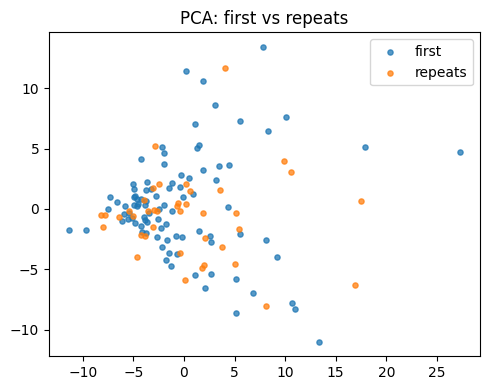

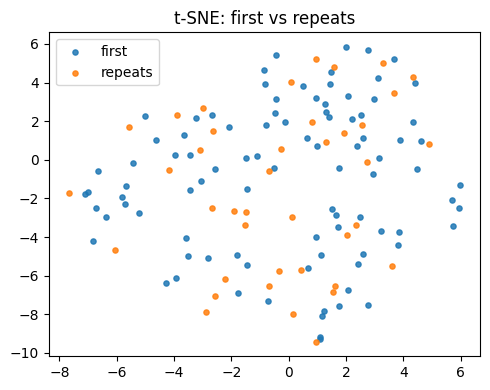

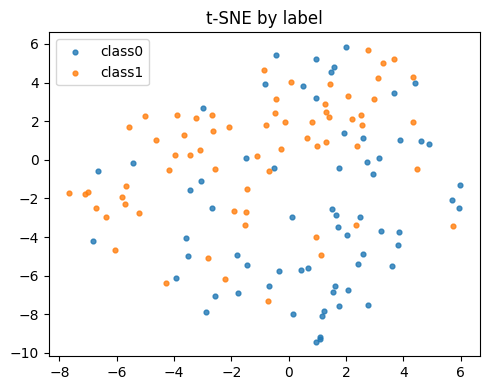

In [60]:
# BiGRU RTG Suite
import numpy as np, pandas as pd, tensorflow as tf, os, time
from typing import Optional, Tuple, List, Dict
from tensorflow.keras import layers, Model, Input
from sklearn.model_selection import train_test_split
from sklearn.metrics import (classification_report, balanced_accuracy_score, f1_score,
                             roc_auc_score, average_precision_score, confusion_matrix)

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# BiGRU extractor & head
def build_bigru_extractor(input_shape, rnn_units=64, rnn_layers=2, dropout=0.3,
                          recurrent_dropout=0.1, use_projection=True) -> Model:
    """
    Feature extractor:
      (optional) Conv1D projection -> [BiGRU(return_sequences=True) + BatchNorm]*L -> GAP(time)
    """
    inp = Input(shape=input_shape, name="input")
    x = inp
    if use_projection:
        x = layers.Conv1D(64, 5, padding='same', activation='relu', name='proj_conv')(x)
        x = layers.BatchNormalization(name='proj_bn')(x)
    for i in range(rnn_layers):
        x = layers.Bidirectional(
                layers.GRU(rnn_units, return_sequences=True, dropout=dropout,
                           recurrent_dropout=recurrent_dropout, name=f'gru{i+1}')
            , name=f'bigru{i+1}')(x)
        x = layers.BatchNormalization(name=f'bn_rnn{i+1}')(x)   # 便于 BN-Adapt
    x = layers.GlobalAveragePooling1D(name='gap')(x)
    return Model(inp, x, name='bigru_extractor')

def build_classifier_from_extractor_bigru(extractor: Model, dropout=0.5) -> Model:
    inp = extractor.input
    x = extractor.output
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(dropout, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='bigru_transfer')

# Trainability helpers
def freeze_all_but_head_bigru(model: Model):
    for l in model.layers:
        l.trainable = (l.name in ['fc1', 'drop', 'logit'])

def bn_adapt_only_bigru(model: Model):
    for l in model.layers:
        if isinstance(l, layers.BatchNormalization):
            l.trainable = True
        else:
            l.trainable = False

def finetune_last_block_bigru(model: Model):
    """
    Unfreeze the last BiGRU block, its BatchNorm, GAP, and header; freeze all others.
    Conventional naming: bigru{L}, bn_rnn{L}, gap, fc1, drop, logit
    """
    # Freeze all first
    for l in model.layers:
        l.trainable = False
    # Find the RNN block with the largest number
    last_id = 0
    for l in model.layers:
        if l.name.startswith('bn_rnn'):
            try:
                last_id = max(last_id, int(l.name.replace('bn_rnn','')))
            except: pass
    targets = [f'bigru{last_id}', f'bn_rnn{last_id}', 'gap', 'fc1', 'drop', 'logit']
    for name in targets:
        try:
            model.get_layer(name).trainable = True
        except ValueError:
            pass

# Eval helpers (same as CNN version)
def predict_prob_on_dir(model: Model, data_dir: str, pair=(0,2), target_len=1500, batch_size=16):
    X, y, files = load_pair_experiment(data_dir, pair, resample_len=target_len)
    y_prob = model.predict(X, batch_size=batch_size, verbose=0).ravel()
    return y, y_prob, files

def evaluate_fixed_threshold(y_true, y_prob, thr=0.5, label=""):
    y_pred = (y_prob >= thr).astype(int)
    out = {
        "label": label,
        "thr": float(thr),
        "bal_acc": balanced_accuracy_score(y_true, y_pred),
        "macro_f1": f1_score(y_true, y_pred, average='macro'),
        "roc_auc": roc_auc_score(y_true, y_prob) if len(np.unique(y_true))==2 else np.nan,
        "auprc": average_precision_score(y_true, y_prob),
        "confusion": confusion_matrix(y_true, y_pred).tolist(),
        "n": int(len(y_true))
    }
    print("\n[EVAL]", label)
    print(pd.Series(out))
    print(classification_report(y_true, y_pred, digits=4))
    return out

def tune_threshold_bal_acc(y_true, y_prob):
    best_thr, best_bal = 0.5, -1.0
    for thr in np.linspace(0.1, 0.9, 33):
        y_pred = (y_prob >= thr).astype(int)
        bal = balanced_accuracy_score(y_true, y_pred)
        if bal > best_bal: best_thr, best_bal = float(thr), float(bal)
    return best_thr, best_bal

def evaluate_with_threshold(model: Model, Xv, yv, Xt, yt, batch_size=16):
    vprob = model.predict(Xv, batch_size=batch_size, verbose=0).ravel()
    thr, bal = tune_threshold_bal_acc(yv, vprob)
    tprob = model.predict(Xt, batch_size=batch_size, verbose=0).ravel()
    tpred = (tprob >= thr).astype(int)
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")
    print("\n[TEST] report (thr tuned):\n", classification_report(yt, tpred, digits=4))
    return thr, bal

# Stage-0: pretrain extractor on a directory/pair
def pretrain_extractor_on_source_bigru(csv_dir: str, src_pair=(0,2), target_len=1500,
                                       max_epochs=60, batch_size=16, lr=3e-4,
                                       rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1,
                                       save_path='bigru_extractor_src.weights.h5'):
    X, y, files = load_pair_experiment(csv_dir, src_pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, _ = split_by_participant_train_val_test(X, y, files, random_state=SEED)
    extractor = build_bigru_extractor((target_len, X.shape[-1]),
                                      rnn_units=rnn_units, rnn_layers=rnn_layers,
                                      dropout=dropout, recurrent_dropout=recurrent_dropout)
    model = build_classifier_from_extractor_bigru(extractor)
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs = [tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True),
           tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1)]
    print(f"[Pretrain-BiGRU] source={src_pair}")
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=max_epochs, batch_size=batch_size, verbose=1, callbacks=cbs)
    # quick check on held-out test
    yprob = model.predict(Xte, batch_size=batch_size, verbose=0).ravel()
    ypred = (yprob > 0.5).astype(int)
    print("[TEST][Pretrain] report:\n", classification_report(yte, ypred, digits=4))
    extractor.save_weights(save_path)
    print(f"[SAVE] BiGRU extractor -> {save_path}")
    return save_path

# A) In-domain baselines
def run_in_domain_baseline_bigru(data_dir: str, pair=(0,2), target_len=1500, batch_size=16,
                                 tag="first", rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1):
    # First pre-train the extractor in this domain
    w_path = pretrain_extractor_on_source_bigru(
        csv_dir=data_dir, src_pair=pair, target_len=target_len,
        max_epochs=60, batch_size=batch_size, lr=3e-4,
        rnn_units=rnn_units, rnn_layers=rnn_layers, dropout=dropout, recurrent_dropout=recurrent_dropout,
        save_path=f"bigru_extractor_{tag}_{pair[0]}_{pair[1]}.weights.h5"
    )
    # Then go through three stages in the same domain
    Xt, yt, ft = load_pair_experiment(data_dir, pair, resample_len=target_len)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(Xt, yt, ft, random_state=SEED)
    extractor = build_bigru_extractor((target_len, Xt.shape[-1]),
                                      rnn_units=rnn_units, rnn_layers=rnn_layers,
                                      dropout=dropout, recurrent_dropout=recurrent_dropout)
    extractor.load_weights(w_path)
    model = build_classifier_from_extractor_bigru(extractor)

    # stage 1: head only
    freeze_all_but_head_bigru(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-04, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)

    # Stage 1.5: BN-Adapt (update BN only)
    print("[BN-Adapt] epochs=2, lr=1e-05")
    bn_adapt_only_bigru(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # stage 2: last RNN block
    print("[Stage 2] Fine-tune last BiGRU block @ LR=5e-5.")
    finetune_last_block_bigru(model)
    model.compile(optimizer=get_optimizer(5e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), thr=thr, split=split_info, hist=hist.history)

# B) Cross-domain zero-shot
def run_zero_shot_bigru(src_model: Model, src_thr: float,
                        tgt_dir: str, pair=(0,2), target_len=1500, batch_size=16,
                        label_prefix="B_zero"):
    y_true, y_prob, _ = predict_prob_on_dir(src_model, tgt_dir, pair, target_len, batch_size)
    out1 = evaluate_fixed_threshold(y_true, y_prob, thr=0.5, label=f"{label_prefix}@0.5")
    out2 = evaluate_fixed_threshold(y_true, y_prob, thr=src_thr, label=f"{label_prefix}@thr_src")
    return {"@0.5": out1, "@thr_src": out2}

# C) Few-shot adaptation (k-subjects)
def run_kshot_adaptation_bigru(src_dir: str, tgt_dir: str, pair=(0,2),
                               k_subjects: int = 10, target_len=1500, batch_size=16, seed=SEED,
                               reuse_extractor_path: Optional[str] = None, label="C_kshot",
                               rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1):
    # Pretrain/load extractors
    if reuse_extractor_path is None:
        reuse_extractor_path = pretrain_extractor_on_source_bigru(
            csv_dir=src_dir, src_pair=pair, target_len=target_len,
            max_epochs=60, batch_size=batch_size, lr=3e-4,
            rnn_units=rnn_units, rnn_layers=rnn_layers, dropout=dropout, recurrent_dropout=recurrent_dropout,
            save_path=f"bigru_extractor_{os.path.basename(src_dir)}_{pair[0]}_{pair[1]}.weights.h5"
        )

    # Load the target domain and divide it into k-subjects
    Xt, yt, ft = load_pair_experiment(tgt_dir, pair, resample_len=target_len)
    pids = np.array([get_participant_id(f) for f in ft])
    uniq = np.array(sorted(list(set(pids))))
    rng = np.random.RandomState(seed); rng.shuffle(uniq)
    k = min(k_subjects, len(uniq))
    pid_trainval, pid_test = uniq[:k], uniq[k:]
    if len(pid_test) == 0:
        pid_test = uniq[-1:]; pid_trainval = uniq[:-1]
    pid_train, pid_val = train_test_split(pid_trainval, test_size=max(1, int(0.2*len(pid_trainval))), random_state=seed)
    def mask(ids): return np.isin(pids, ids)
    Xtr, ytr = Xt[mask(pid_train)], yt[mask(pid_train)]
    Xva, yva = Xt[mask(pid_val)],   yt[mask(pid_val)]
    Xte, yte = Xt[mask(pid_test)],  yt[mask(pid_test)]
    print(f"[K-shot split] train={pid_train.tolist()} val={pid_val.tolist()} test={pid_test.tolist()}")

    # Build + Load
    extractor = build_bigru_extractor((target_len, Xt.shape[-1]),
                                      rnn_units=rnn_units, rnn_layers=rnn_layers,
                                      dropout=dropout, recurrent_dropout=recurrent_dropout)
    extractor.load_weights(reuse_extractor_path)
    model = build_classifier_from_extractor_bigru(extractor)

    # Stage 1: Head-only
    freeze_all_but_head_bigru(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-04, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)

    # BN-Adapt
    print("[BN-Adapt] epochs=2, lr=1e-05")
    bn_adapt_only_bigru(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2: last RNN block
    print("[Stage 2] Fine-tune last BiGRU block @ LR=5e-5.")
    finetune_last_block_bigru(model)
    model.compile(optimizer=get_optimizer(5e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    thr, bal = evaluate_with_threshold(model, Xva, yva, Xte, yte, batch_size=batch_size)
    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), thr=thr, hist=hist.history)

# D) Joint training (first + repeats)
def run_joint_training_bigru(first_dir: str, repeats_dir: str, pair=(0,2), target_len=1500, batch_size=16,
                             rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1):
    Xf, yf, ff = load_pair_experiment(first_dir, pair, resample_len=target_len)
    Xr, yr, fr = load_pair_experiment(repeats_dir, pair, resample_len=target_len)
    pf = np.array([ "F_"+get_participant_id(f) for f in ff ])
    pr = np.array([ "R_"+get_participant_id(f) for f in fr ])
    X = np.vstack([Xf, Xr]); y = np.concatenate([yf, yr])
    files = np.array(ff + fr); pids = np.concatenate([pf, pr])
    domains = np.array(['first']*len(Xf) + ['repeats']*len(Xr))

    uniq = np.array(sorted(list(set(pids))))
    pid_trainval, pid_test = train_test_split(uniq, test_size=0.25, random_state=SEED, shuffle=True)
    pid_train, pid_val = train_test_split(pid_trainval, test_size=len(pid_trainval)//4 if len(pid_trainval)>4 else 1,
                                          random_state=SEED, shuffle=True)
    def mask(ids): return np.isin(pids, ids)
    tr, va, te = mask(pid_train), mask(pid_val), mask(pid_test)
    Xtr, ytr = X[tr], y[tr]; Xva, yva = X[va], y[va]; Xte, yte = X[te], y[te]; d_te = domains[te]

    extractor = build_bigru_extractor((target_len, X.shape[-1]),
                                      rnn_units=rnn_units, rnn_layers=rnn_layers,
                                      dropout=dropout, recurrent_dropout=recurrent_dropout)
    model = build_classifier_from_extractor_bigru(extractor)

    # Stage 1
    freeze_all_but_head_bigru(model)
    cls_weight = compute_class_weight(ytr)
    model.compile(optimizer=get_optimizer(3e-3), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs1 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=7.5e-04, verbose=1)]
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=20, batch_size=batch_size,
              verbose=1, callbacks=cbs1, class_weight=cls_weight)

    # BN-Adapt
    print("[BN-Adapt] epochs=2, lr=1e-05")
    bn_adapt_only_bigru(model)
    model.compile(optimizer=get_optimizer(1e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=2, batch_size=batch_size, verbose=1)

    # Stage 2
    print("[Stage 2] Fine-tune last BiGRU block @ LR=5e-5.")
    finetune_last_block_bigru(model)
    model.compile(optimizer=get_optimizer(5e-5), loss='binary_crossentropy',
                  metrics=['accuracy', tf.keras.metrics.AUC(name='auc')])
    cbs2 = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=12, min_lr=1e-5, verbose=1)]
    hist = model.fit(Xtr, ytr, validation_data=(Xva, yva), epochs=60, batch_size=batch_size,
                     verbose=1, callbacks=cbs2, class_weight=cls_weight)

    # Threshold adjustment + domain evaluation
    vprob = model.predict(Xva, batch_size=batch_size, verbose=0).ravel()
    thr, bal = tune_threshold_bal_acc(yva, vprob)
    tprob = model.predict(Xte, batch_size=batch_size, verbose=0).ravel()
    print(f"[VAL] best_threshold={thr:.3f}, best_bal_acc={bal:.4f}")
    mask_first = (d_te == 'first'); mask_rep = (d_te == 'repeats')
    print("\n[TEST] Joint → first subset")
    evaluate_fixed_threshold(y[te][mask_first], tprob[mask_first], thr=thr, label="D_joint→firstTest")
    print("\n[TEST] Joint → repeats subset")
    evaluate_fixed_threshold(y[te][mask_rep], tprob[mask_rep], thr=thr, label="D_joint→repeatsTest")
    print("\n[TEST] Joint → all")
    evaluate_fixed_threshold(y[te], tprob, thr=thr, label="D_joint→allTest")
    return model, dict(train=(Xtr,ytr), val=(Xva,yva), test=(Xte,yte), test_domain=d_te, thr=thr, hist=hist.history)

# Distribution analysis (Same as CNN version)
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from scipy.stats import ks_2samp
import matplotlib.pyplot as plt

def summarize_timeseries(X):
    feats = []
    for x in X:
        f = []
        for c in range(x.shape[1]):
            sig = x[:, c]
            f += [np.mean(sig), np.std(sig), np.max(sig)-np.min(sig),
                  np.mean(np.abs(sig)), np.sum(sig**2)/len(sig)]
        feats.append(f)
    return np.array(feats)

def analyse_first_vs_repeats(first_dir: str, repeats_dir: str, pair=(0,2), target_len=1500):
    Xf, yf, ff = load_pair_experiment(first_dir, pair, resample_len=target_len)
    Xr, yr, fr = load_pair_experiment(repeats_dir, pair, resample_len=target_len)
    Ff, Fr = summarize_timeseries(Xf), summarize_timeseries(Xr)
    F = np.vstack([Ff, Fr]); dom = np.array(['first']*len(Ff) + ['repeats']*len(Fr)); y = np.concatenate([yf, yr])
    ks_ps = [ks_2samp(Ff[:, i], Fr[:, i])[1] for i in range(F.shape[1])]
    print(f"[KS] min p={np.min(ks_ps):.3e}, median p={np.median(ks_ps):.3e}, share<=0.05={(np.array(ks_ps)<=0.05).mean():.3f}")
    pca = PCA(n_components=2, random_state=SEED); Zp = pca.fit_transform(F)
    plt.figure(figsize=(5,4)); plt.scatter(Zp[dom=='first',0], Zp[dom=='first',1], s=14, alpha=0.75, label='first')
    plt.scatter(Zp[dom=='repeats',0], Zp[dom=='repeats',1], s=14, alpha=0.75, label='repeats')
    plt.title('PCA: first vs repeats'); plt.legend(); plt.tight_layout(); plt.show()
    Fstd = (F - F.mean(0)) / (F.std(0)+1e-8)
    Zt = TSNE(n_components=2, perplexity=30, init='pca', learning_rate='auto', random_state=SEED).fit_transform(Fstd)
    plt.figure(figsize=(5,4)); plt.scatter(Zt[dom=='first',0], Zt[dom=='first',1], s=14, alpha=0.85, label='first')
    plt.scatter(Zt[dom=='repeats',0], Zt[dom=='repeats',1], s=14, alpha=0.85, label='repeats')
    plt.title('t-SNE: first vs repeats'); plt.legend(); plt.tight_layout(); plt.show()
    plt.figure(figsize=(5,4))
    for lab, name in [(0,'class0'),(1,'class1')]:
        m = (y==lab); plt.scatter(Zt[m,0], Zt[m,1], s=12, alpha=0.8, label=name)
    plt.title('t-SNE by label'); plt.legend(); plt.tight_layout(); plt.show()

# One-click RTG run (BiGRU)
if __name__ == "__main__":
    SRC_DIR = '/Users/wukehui/Desktop/data science project/project/data/first_trials'
    TGT_DIR = '/Users/wukehui/Desktop/data science project/project/data/repeats'
    PAIR = (0,2); BATCH = 16; TLEN = 1500
    RNN_UNITS, RNN_LAYERS = 64, 2

    print("\n=== A1: in-domain baseline (FIRST, BiGRU) ===")
    modelA1, resA1 = run_in_domain_baseline_bigru(SRC_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH,
                                                  tag="first", rnn_units=RNN_UNITS, rnn_layers=RNN_LAYERS)
    thrA1 = resA1["thr"]

    print("\n=== A2: in-domain baseline (REPEATS, BiGRU) ===")
    modelA2, resA2 = run_in_domain_baseline_bigru(TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH,
                                                  tag="repeats", rnn_units=RNN_UNITS, rnn_layers=RNN_LAYERS)
    thrA2 = resA2["thr"]

    print("\n=== B1: zero-shot FIRST → REPEATS (BiGRU) ===")
    zsB1 = run_zero_shot_bigru(modelA1, thrA1, TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH,
                               label_prefix="B1_first→repeats")

    print("\n=== B2: zero-shot REPEATS → FIRST (BiGRU) ===")
    zsB2 = run_zero_shot_bigru(modelA2, thrA2, SRC_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH,
                               label_prefix="B2_repeats→first")

    print("\n=== C1: k-shot FIRST → REPEATS (k=10, BiGRU) ===")
    modelC1, resC1 = run_kshot_adaptation_bigru(SRC_DIR, TGT_DIR, pair=PAIR, k_subjects=10, target_len=TLEN,
                                                batch_size=BATCH, reuse_extractor_path=None, label="C1_first→repeats_k10",
                                                rnn_units=RNN_UNITS, rnn_layers=RNN_LAYERS)

    print("\n=== C2: k-shot REPEATS → FIRST (k=10, BiGRU) ===")
    modelC2, resC2 = run_kshot_adaptation_bigru(TGT_DIR, SRC_DIR, pair=PAIR, k_subjects=10, target_len=TLEN,
                                                batch_size=BATCH, reuse_extractor_path=None, label="C2_repeats→first_k10",
                                                rnn_units=RNN_UNITS, rnn_layers=RNN_LAYERS)

    print("\n=== D: Joint training (FIRST ∪ REPEATS, BiGRU) ===")
    modelD, resD = run_joint_training_bigru(SRC_DIR, TGT_DIR, pair=PAIR, target_len=TLEN, batch_size=BATCH,
                                            rnn_units=RNN_UNITS, rnn_layers=RNN_LAYERS)

    print("\n=== Distribution analysis ===")
    analyse_first_vs_repeats(SRC_DIR, TGT_DIR, pair=PAIR, target_len=TLEN)


xai for bigru

[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
Epoch 1/80
4/4 [==============================] - 11s 2s/step - loss: 0.7202 - accuracy: 0.4630 - val_loss: 0.7005 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 9s 2s/step - loss: 0.6614 - accuracy: 0.6296 - val_loss: 0.6967 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 10s 3s/step - loss: 0.6480 - accuracy: 0.5741 - val_loss: 0.6934 - val_accuracy: 0.4500 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 9s 2s/step - loss: 0.6365 - accuracy: 0.6667 - val_loss: 0.6916 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 8s 2s/step - loss: 0.5929 - accuracy: 0.7593 - val_loss: 0.6897 - val_accuracy: 0.5000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 8s 2s/step - loss: 0.5643 - accuracy: 0.7778 - val_loss: 0.6872 - val_accuracy: 0.5000 - lr: 

Epoch 53/80
4/4 [==============================] - 8s 2s/step - loss: 0.1870 - accuracy: 0.9259 - val_loss: 0.5702 - val_accuracy: 0.7500 - lr: 1.5000e-04
Epoch 54/80
4/4 [==============================] - 7s 2s/step - loss: 0.1289 - accuracy: 0.9630 - val_loss: 0.5819 - val_accuracy: 0.7500 - lr: 1.5000e-04
Epoch 55/80
4/4 [==============================] - 6s 1s/step - loss: 0.1244 - accuracy: 0.9815 - val_loss: 0.6093 - val_accuracy: 0.7500 - lr: 1.5000e-04
Epoch 56/80
4/4 [==============================] - 7s 2s/step - loss: 0.1563 - accuracy: 0.9444 - val_loss: 0.6624 - val_accuracy: 0.6500 - lr: 1.5000e-04
Epoch 57/80
4/4 [==============================] - 8s 2s/step - loss: 0.1397 - accuracy: 0.9630 - val_loss: 0.7304 - val_accuracy: 0.6500 - lr: 1.5000e-04
Epoch 58/80
4/4 [==============================] - ETA: 0s - loss: 0.1367 - accuracy: 0.9630
Epoch 58: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
4/4 [==============================] - 9s 2s/step - los

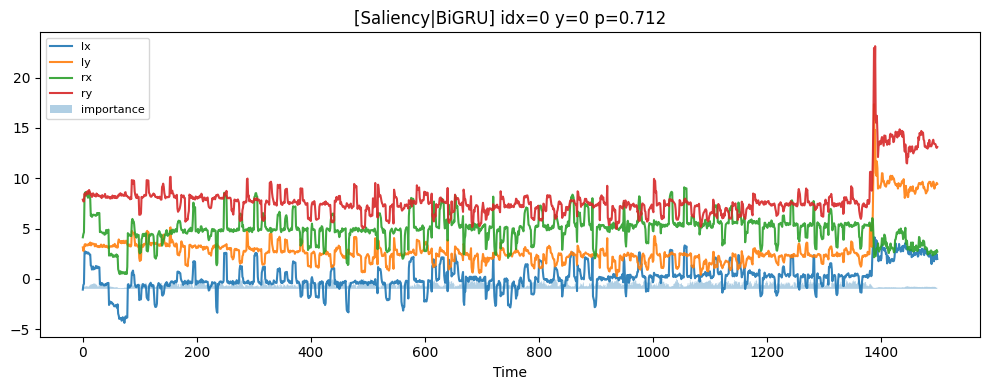

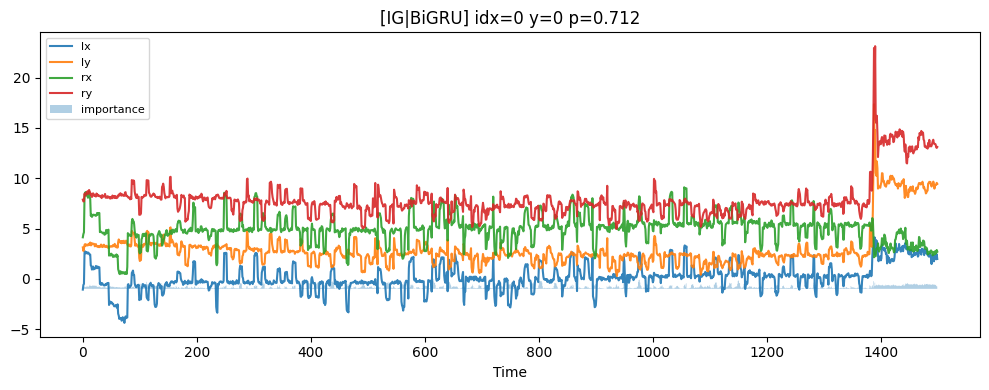

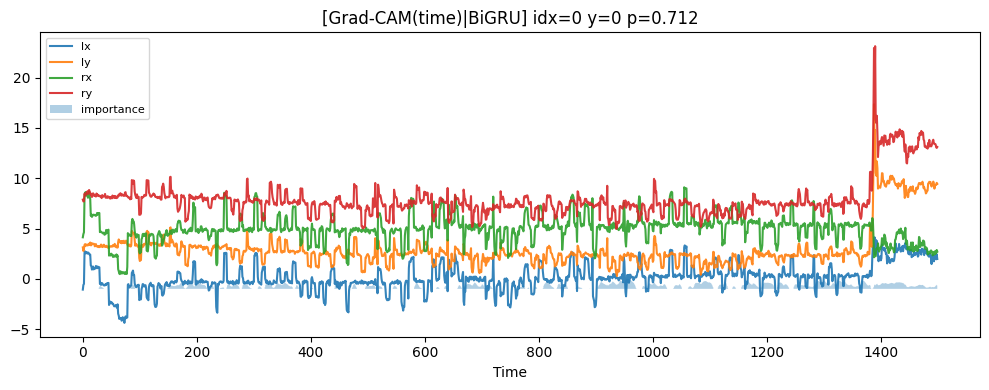

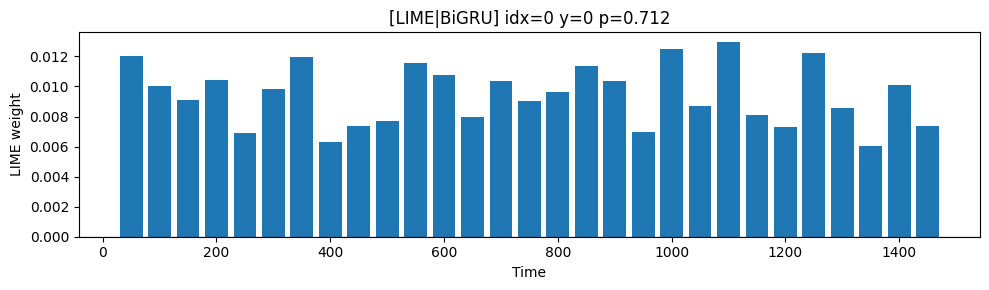

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); reshape fallback


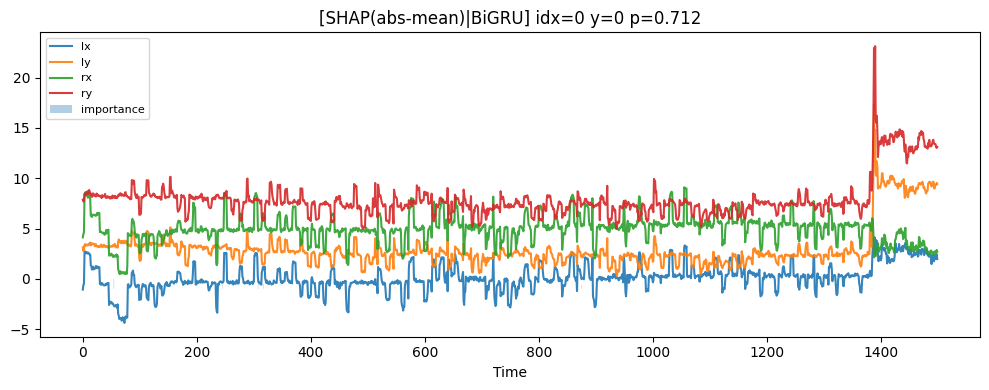

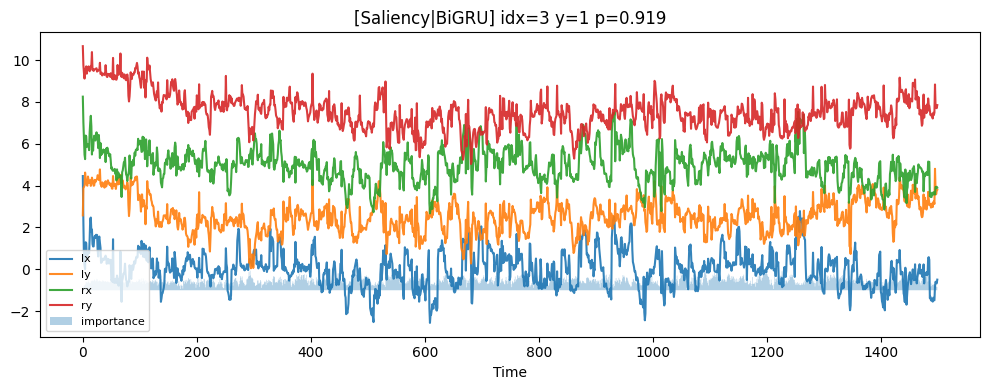

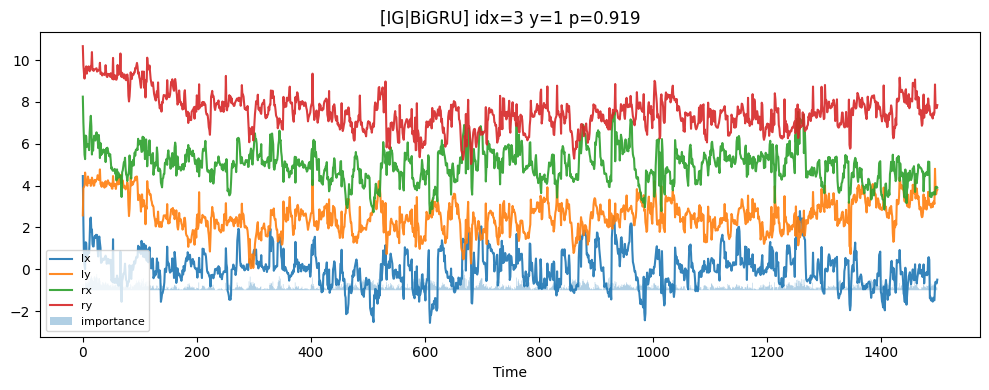

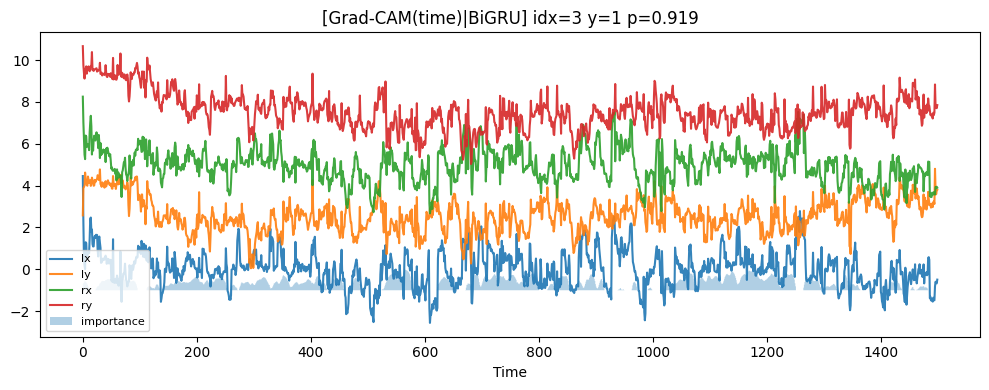

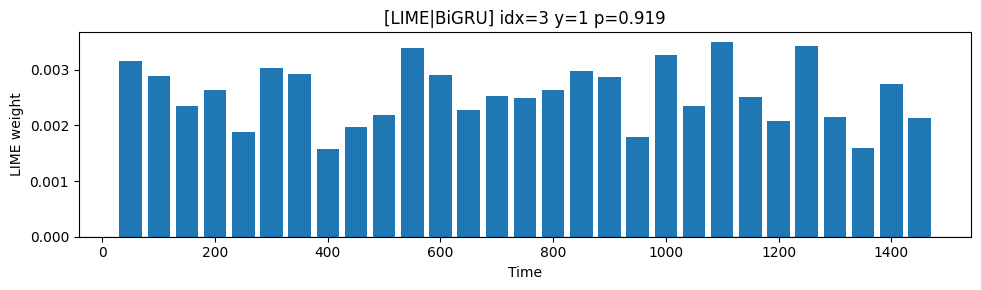

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); reshape fallback


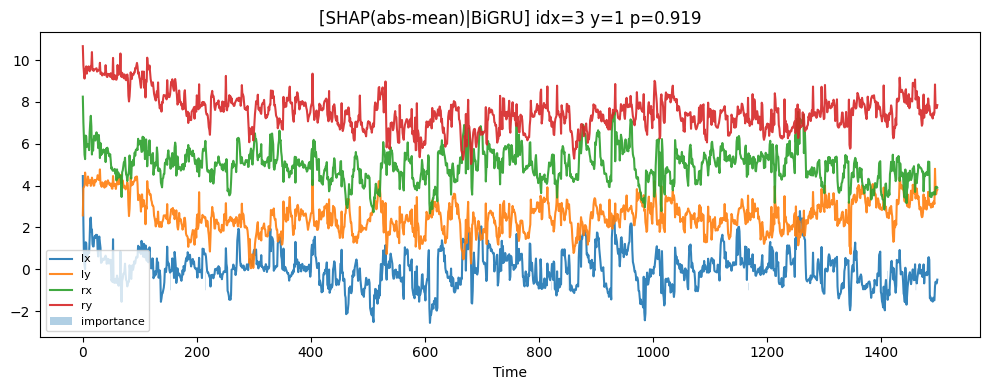

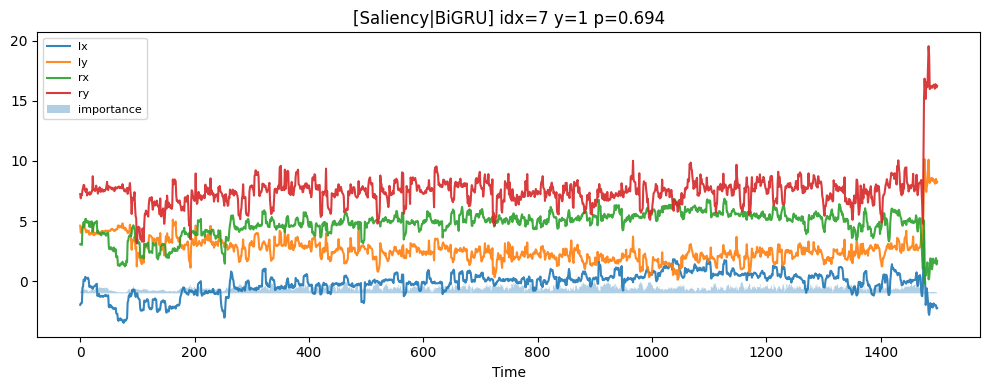

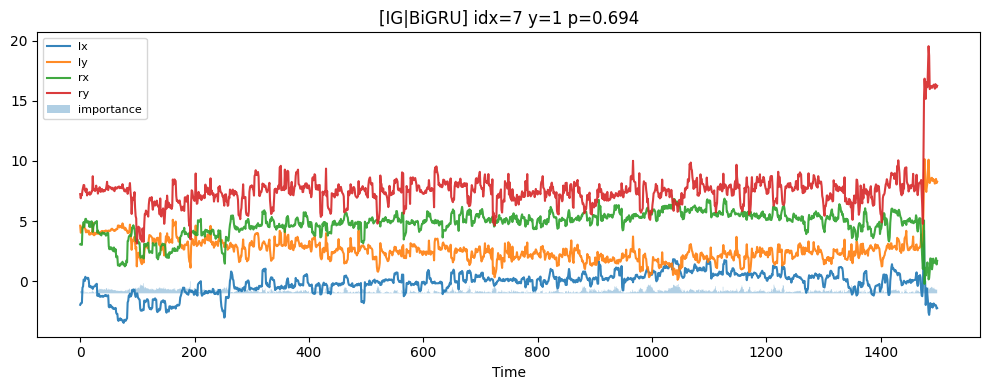

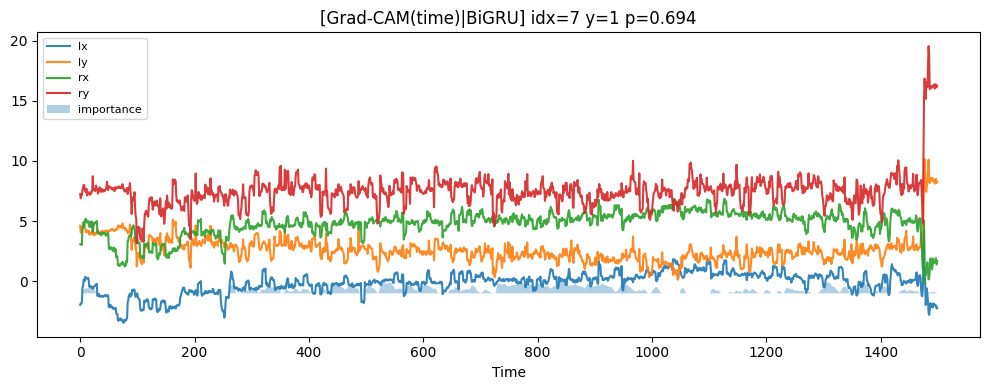

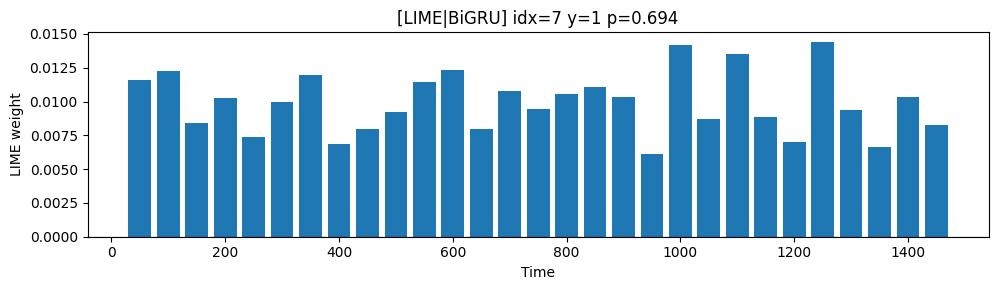

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); reshape fallback


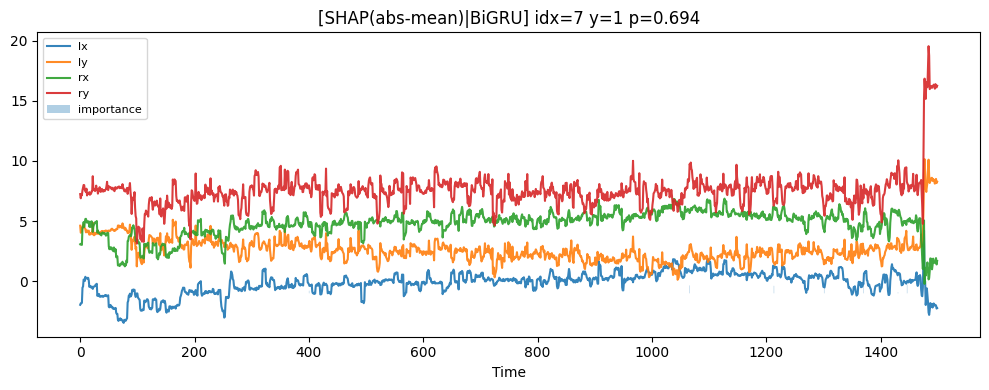

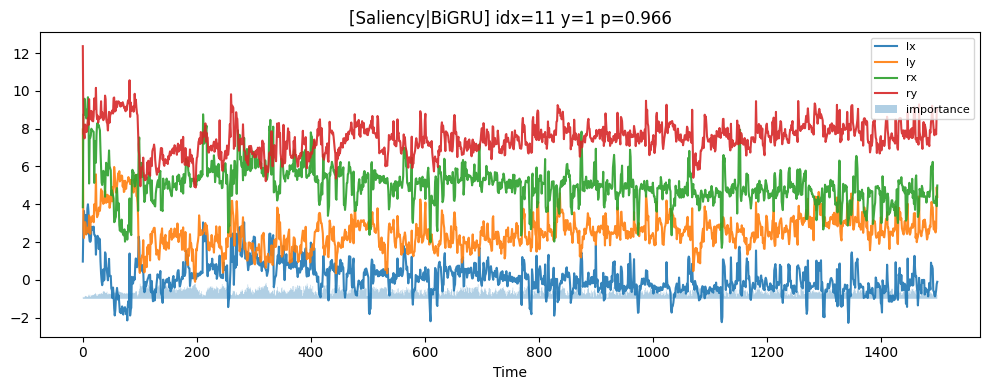

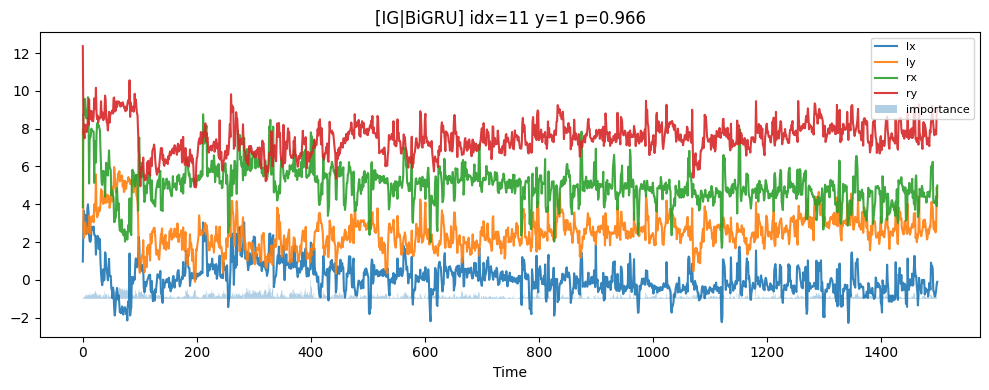

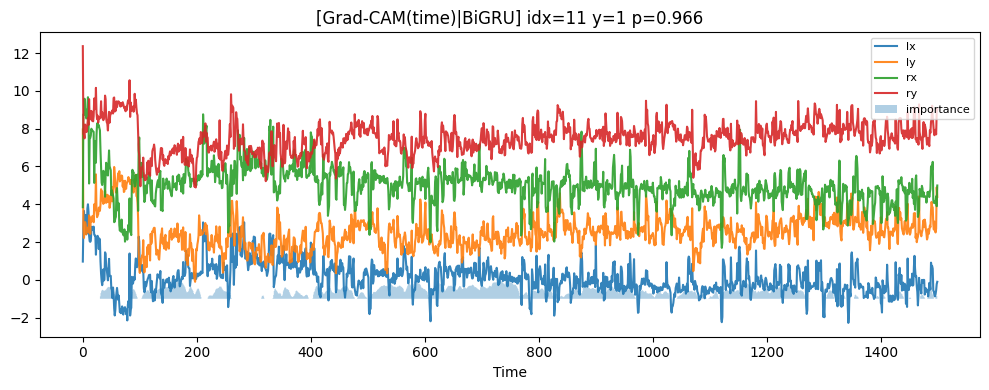

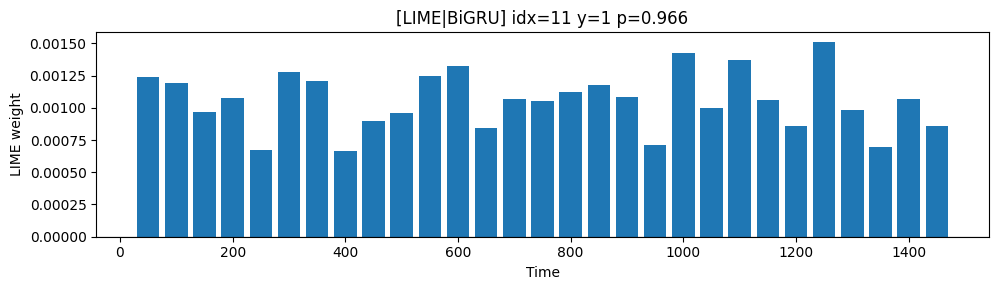

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); reshape fallback


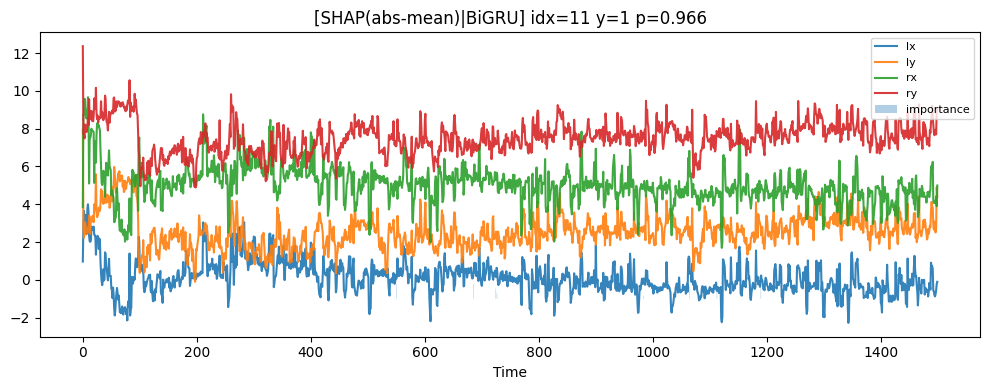

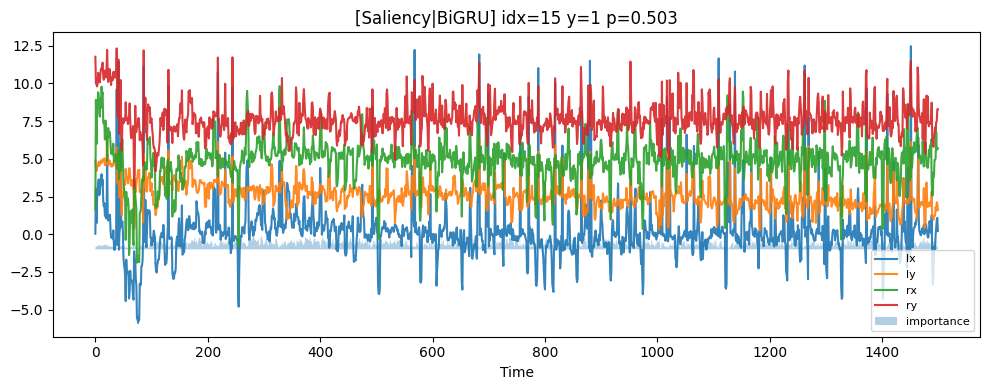

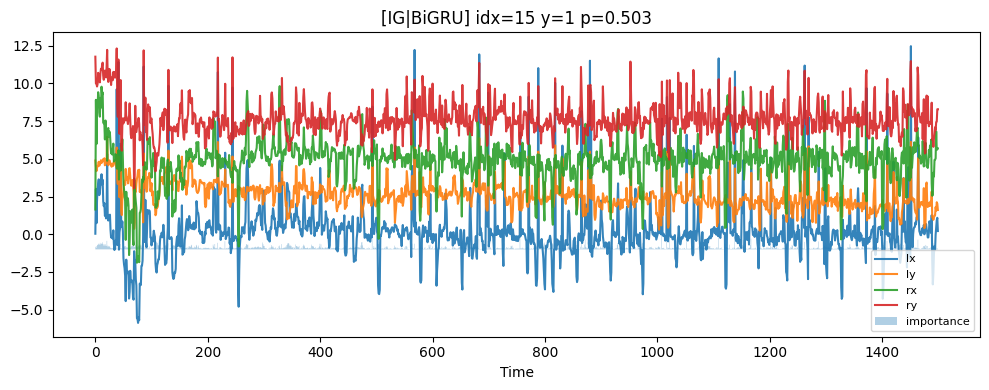

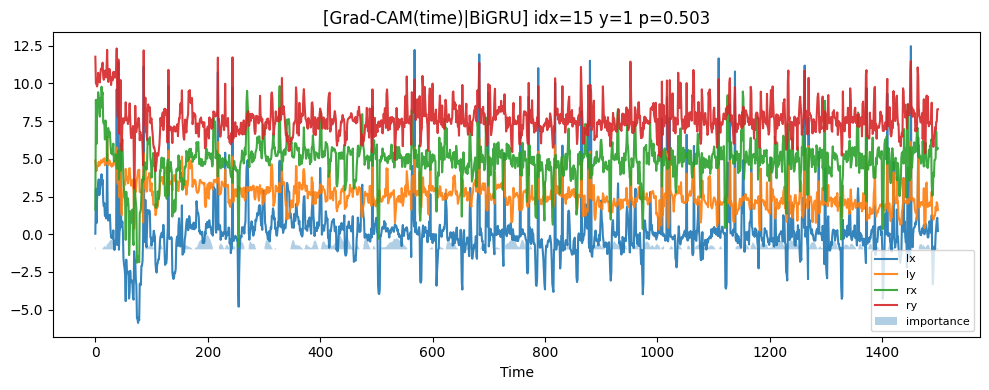

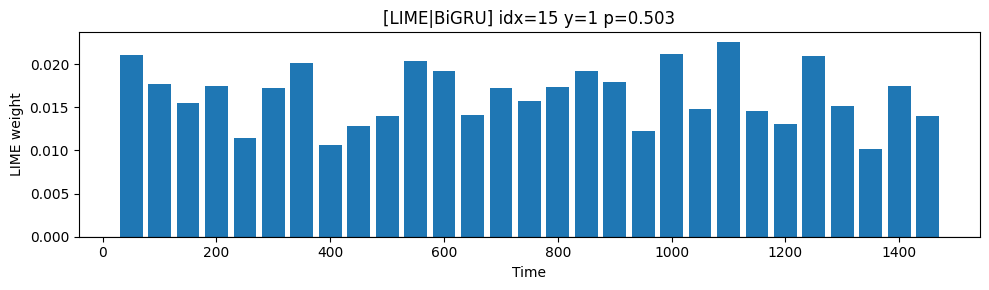

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); reshape fallback


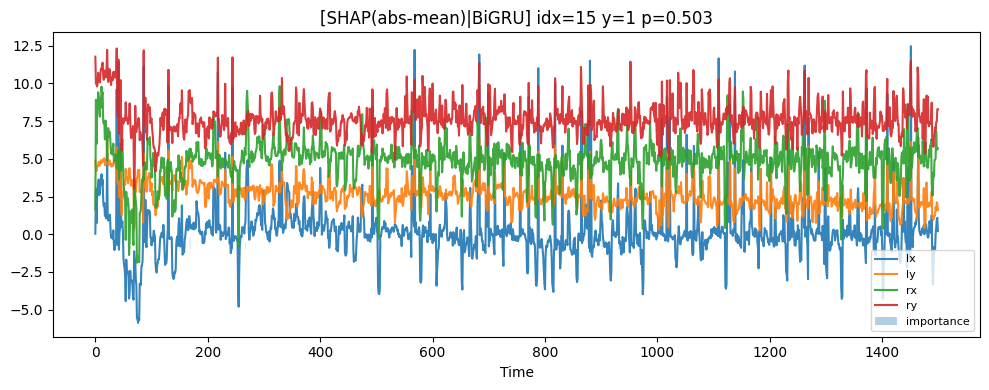

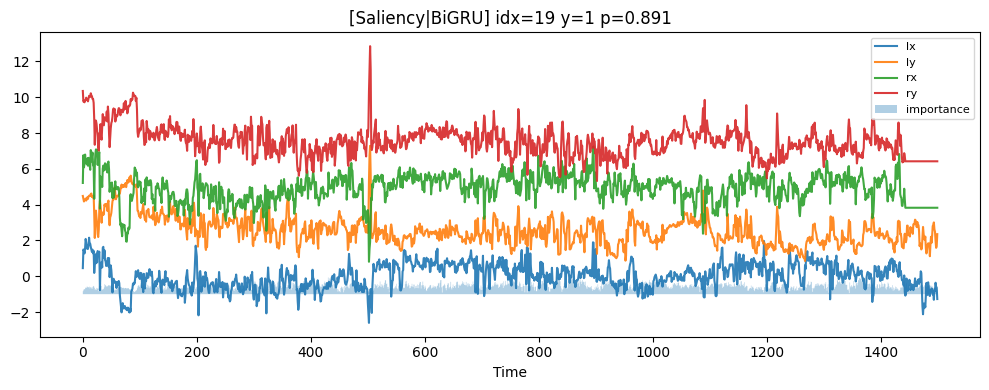

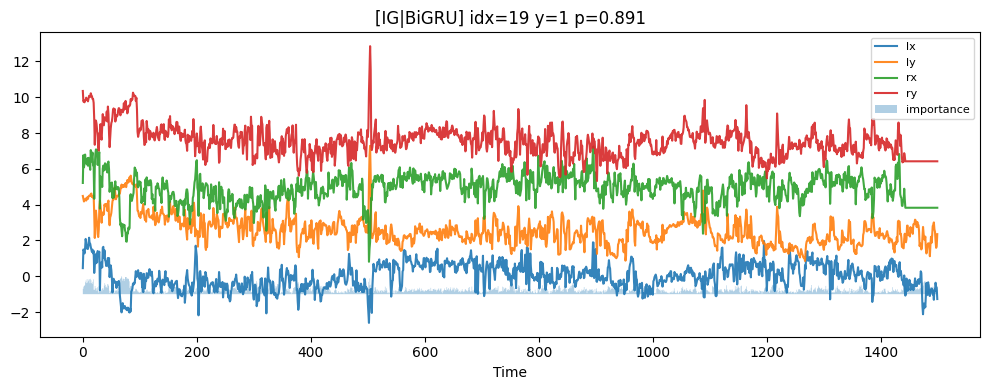

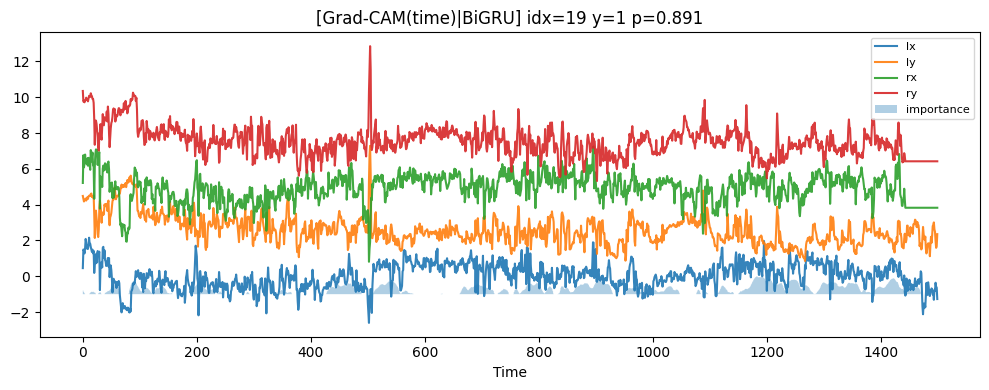

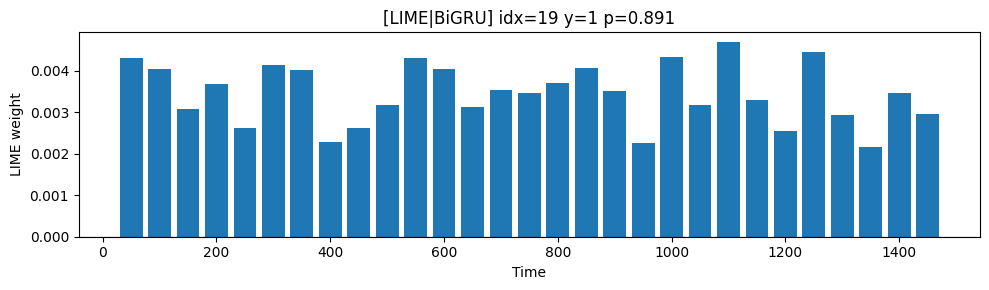

  0%|          | 0/1 [00:00<?, ?it/s]

[WARN] Unexpected SHAP shape: (1, 6000, 1); reshape fallback


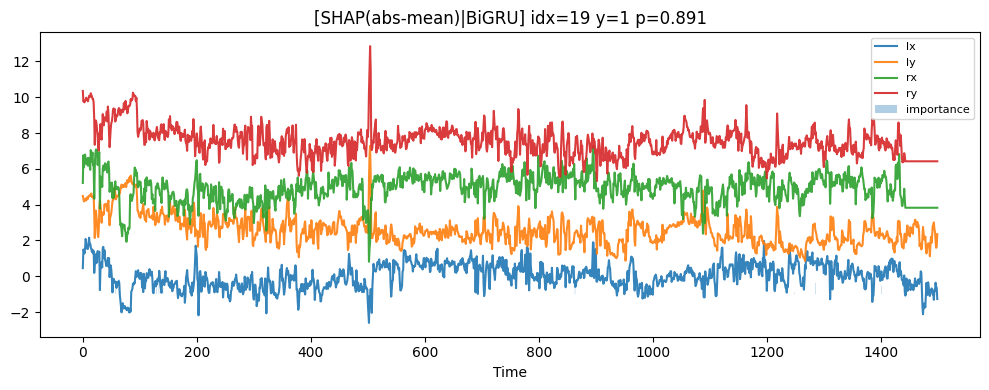

BiGRU XAI suite finished.


In [61]:
"""
XAI suite for BiGRU (single-branch on 4 channels)
Methods:
  - Saliency (vanilla grads)
  - Integrated Gradients (baseline=0)
  - Grad-CAM (temporal): Take the sequence representation of the last BiGRU (return_sequences=True) layer as the temporal importance
  - LIME (window perturbation, ridge)
  - SHAP (KernelExplainer, robust)

Notes:
  - Input (T, 4). All heatmaps are normalised and interpolated/projected to length T for easy stacking and visualisation.
  - If time_layer_name is not passed, the function automatically searches for the last Bidirectional(GRU, return_sequences=True) layer;
    If not found, the function falls back to the "last 3D output layer" in the model.
"""

import numpy as np, tensorflow as tf, matplotlib.pyplot as plt
from typing import Optional, Tuple, Dict, List
from tensorflow.keras import Model, layers, Input

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# BiGRU backbone for XAI
def build_bigru_extractor(input_shape,
                          rnn_units=64, rnn_layers=2,
                          dropout=0.3, recurrent_dropout=0.1,
                          use_projection=True) -> Model:
    """
    (optional) Conv1D projection -> [BiGRU(return_sequences=True)+BN]*L -> GAP(time)
    """
    inp = Input(shape=input_shape, name="input")
    x = inp
    if use_projection:
        x = layers.Conv1D(64, 5, padding='same', activation='relu', name='proj_conv')(x)
        x = layers.BatchNormalization(name='proj_bn')(x)

    for i in range(rnn_layers):
        x = layers.Bidirectional(
            layers.GRU(rnn_units, return_sequences=True, dropout=dropout,
                       recurrent_dropout=recurrent_dropout, name=f'gru{i+1}'),
            name=f'bigru{i+1}'
        )(x)
        x = layers.BatchNormalization(name=f'bn_rnn{i+1}')(x)

    x = layers.GlobalAveragePooling1D(name='gap')(x)
    return Model(inp, x, name='bigru_extractor')

def build_classifier_from_extractor_bigru(extractor: Model, dropout=0.5) -> Model:
    inp = extractor.input
    x   = extractor.output
    x   = layers.Dense(64, activation='relu', name='fc1')(x)
    x   = layers.Dropout(dropout, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name='bigru_cls')

# Train a BiGRU model for XAI
def train_bigru_for_xai(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    rnn_units: int = 64,
    rnn_layers: int = 2,
    dropout: float = 0.3,
    recurrent_dropout: float = 0.1,
):
    # Data
    X, y, files = load_pair_experiment(
        csv_dir, label_pair,
        resample_len=target_len, max_nan_ratio=0.05,
        divide_by_960=True, use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    # Model
    extractor = build_bigru_extractor(
        (target_len, X.shape[-1]),
        rnn_units=rnn_units, rnn_layers=rnn_layers,
        dropout=dropout, recurrent_dropout=recurrent_dropout
    )
    model = build_classifier_from_extractor_bigru(extractor)
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])
    cbs = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    class_weight = compute_class_weight(ytr)
    model.fit(Xtr, ytr, validation_data=(Xva, yva),
              epochs=max_epochs, batch_size=batch_size, verbose=1,
              callbacks=cbs, class_weight=class_weight)
    return model, (Xtr,ytr,Xva,yva,Xte,yte), files, splits

# Saliency
def saliency_bigru(model: Model, x: np.ndarray) -> np.ndarray:
    xt = tf.convert_to_tensor(x[None, ...], dtype=tf.float32)
    with tf.GradientTape() as tape:
        tape.watch(xt)
        y = model(xt, training=False)
    g = tape.gradient(y, xt).numpy()[0]  # (T,C)
    return np.abs(g).astype(np.float32)

# Integrated Gradients
def integrated_gradients_bigru(model: Model, x: np.ndarray, steps: int = 64, baseline: Optional[np.ndarray]=None) -> np.ndarray:
    if baseline is None:
        baseline = np.zeros_like(x, dtype=np.float32)
    xt = tf.convert_to_tensor(x[None,...], tf.float32)
    bt = tf.convert_to_tensor(baseline[None,...], tf.float32)
    alphas = tf.reshape(tf.linspace(0., 1., steps+1)[1:], (-1,1,1))
    path = bt + alphas * (xt - bt)              # (steps,T,C)
    with tf.GradientTape() as tape:
        tape.watch(path)
        preds = model(path, training=False)
    grads = tape.gradient(preds, path)          # (steps,T,C)
    ig = tf.reduce_mean(grads, axis=0) * (xt - bt)[0]
    return tf.math.abs(ig).numpy().astype(np.float32)

# Grad‑CAM (temporal) for BiGRU
def _pick_time_layer_for_bigru(model: Model, name_hint: Optional[str] = None) -> layers.Layer:
    """
    Prioritize: The last layer whose name begins with 'bigru' and whose output is rank 3 (time series).
    If name_hint is provided, that layer is used directly.
    Fallback: The last layer in the model whose output is 3D.
    """
    if name_hint:
        return model.get_layer(name_hint)

    cand = []
    for L in model.layers:
        try:
            out_rank = len(L.output_shape)  # may fail for ragged
        except Exception:
            continue
        if out_rank == 3 and (L.name.startswith('bigru') or isinstance(L, layers.Bidirectional)):
            cand.append(L)
    if cand:
        return cand[-1]

    # fallback: last 3D output layer
    for L in model.layers[::-1]:
        try:
            if len(L.output_shape) == 3:
                return L
        except Exception:
            continue
    raise ValueError("No time-sequence layer (rank-3) found for Grad-CAM temporal.")

def gradcam_time_bigru(model: Model, x: np.ndarray, time_layer_name: Optional[str] = None) -> np.ndarray:
    """
    A time-dependent version of the standard Grad‑CAM approach:
      Take the temporal layer H ∈ R^{T×F} and the gradient of y g ∈ R^{T×F}.
      First, we average the time values to obtain the channel weights w_k = mean_t ReLU(g_{t,k}),
      cam_t = ReLU(Σ_k w_k * H_{t,k}), then normalise to [0,1] and upsample to T.
    """
    target_layer = _pick_time_layer_for_bigru(model, time_layer_name)
    grad_model = Model([model.inputs], [target_layer.output, model.output])

    xt = tf.convert_to_tensor(x[None, ...], tf.float32)
    with tf.GradientTape() as tape:
        (H, y) = grad_model(xt, training=False)   # H: (1,T',F)
        y_c = y[:, 0]
    g = tape.gradient(y_c, H)                     # (1,T',F)

    H = H.numpy()[0]    # (T',F)
    g = g.numpy()[0]    # (T',F)

    weights = np.maximum(g, 0).mean(axis=0)      # (F,)
    cam = np.maximum((H * weights).sum(axis=1), 0.0)  # (T',)

    # Normalise & upsample back to original length
    if cam.max() > 0: cam = cam / (cam.max() + 1e-8)
    T = x.shape[0]
    if cam.shape[0] != T:
        src = np.linspace(0, 1, cam.shape[0], dtype=np.float32)
        dst = np.linspace(0, 1, T, dtype=np.float32)
        cam = np.interp(dst, src, cam)
    return cam.astype(np.float32)

# LIME (sliding-window occlusion)
def lime_timeseries_explain(model: Model, x: np.ndarray, window=100, stride=50, n_samples=600, fill=0.0, seed=SEED):
    T, C = x.shape
    wins = []
    t0 = 0
    while t0 < T:
        t1 = min(t0 + window, T); wins.append((t0, t1))
        if t1 == T: break
        t0 += stride
    W = len(wins)
    y0 = float(model.predict(x[None,...], verbose=0).ravel()[0])
    rng = np.random.default_rng(seed)
    Z = rng.integers(0, 2, size=(n_samples, W), endpoint=True)
    y = np.zeros((n_samples,), dtype=np.float32)
    x_fill = np.full_like(x, fill, dtype=np.float32)
    for i in range(n_samples):
        xi = x.copy()
        for j, flag in enumerate(Z[i]):
            if flag == 1:
                a,b = wins[j]; xi[a:b,:] = x_fill[a:b,:]
        y[i] = float(model.predict(xi[None,...], verbose=0).ravel()[0])
    lam = 1e-3
    A = Z.astype(np.float32); b = (y - y0).astype(np.float32)
    beta = np.linalg.solve(A.T @ A + lam*np.eye(W, dtype=np.float32), A.T @ b)
    centers = np.array([(a+b)//2 for (a,b) in wins], dtype=int)
    return centers, beta

# SHAP (KernelExplainer)
def shap_explain_kernel_bigru(model: Model, X_background: np.ndarray, X_samples: np.ndarray,
                              max_bg: int = 64, nsamples: int = 200):
    try:
        import shap
    except ImportError:
        print("[WARN] shap not installed; skip SHAP.")
        return None
    if X_samples.ndim == 2:
        X_samples = X_samples[None, ...]
    assert X_samples.ndim == 3 and X_background.ndim == 3, "expect (n,T,C)"
    Xbg = X_background[:max_bg].astype(np.float32, copy=False)
    Xsm = X_samples.astype(np.float32, copy=False)
    n, T, C = Xsm.shape
    bg2 = Xbg.reshape((Xbg.shape[0], T*C))
    X2  = Xsm.reshape((n, T*C))
    def f_2d(Z2):
        Z3 = np.asarray(Z2, dtype=np.float32).reshape((-1, T, C))
        y  = model.predict(Z3, verbose=0).reshape(-1, 1)
        return y
    explainer = shap.KernelExplainer(f_2d, bg2)
    sv = explainer.shap_values(X2, nsamples=nsamples)
    if isinstance(sv, list): sv = sv[0]
    sv = np.asarray(sv)
    if sv.ndim == 1 and sv.size == T*C:
        sv = sv.reshape(1, T, C)
    elif sv.ndim == 2 and sv.shape[1] == T*C:
        sv = sv.reshape(sv.shape[0], T, C)
    elif sv.ndim == 3 and sv.shape[1:] == (T, C):
        pass
    else:
        print(f"[WARN] Unexpected SHAP shape: {sv.shape}; reshape fallback")
        sv = sv.reshape(-1, T, C)
    return sv.astype(np.float32, copy=False)

# Plots
def plot_timeseries_with_heat(x: np.ndarray, heat_1d: np.ndarray, title: str, ch_names=('lx','ly','rx','ry')):
    T, C = x.shape
    h = np.asarray(heat_1d).squeeze()
    # Projection is T length
    if h.ndim == 2 and h.shape[0] == T:
        h = np.abs(h).mean(axis=1)
    if h.size == T*C:
        h = np.abs(h.reshape(T, C)).mean(axis=1)
    elif h.size != T:
        src = np.linspace(0, 1, h.size); dst = np.linspace(0, 1, T)
        h = np.interp(dst, src, h)

    plt.figure(figsize=(10,4))
    shift = 0.0
    for c in range(C):
        plt.plot(x[:,c] + shift, alpha=0.9, label=ch_names[c] if c<len(ch_names) else f'ch{c}')
        shift += 2.5
    h_norm = h / (h.max() + 1e-8)
    plt.fill_between(np.arange(T), -1.0, -1.0 + h_norm, alpha=0.35, step='pre', label='importance')
    plt.title(title); plt.xlabel("Time"); plt.legend(fontsize=8); plt.tight_layout(); plt.show()

def plot_bar_over_windows(centers: np.ndarray, weights: np.ndarray, title: str):
    plt.figure(figsize=(10,3))
    w = max(1, int(0.8*(centers[1]-centers[0]))) if len(centers)>1 else 5
    plt.bar(centers, weights, width=w); plt.axhline(0, color='k', lw=0.8)
    plt.title(title); plt.xlabel("Time"); plt.ylabel("LIME weight"); plt.tight_layout(); plt.show()

# One-click runner
def run_xai_suite_bigru(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    sample_source: str = 'val',
    n_samples: int = 6,
    time_layer_name: Optional[str] = None,  # such as 'bigru2'
    enable_shap: bool = True,
    shap_bg_max: int = 64,
    shap_nsamples: int = 200,
    # BiGRU hyperparameters (must be consistent with training to facilitate retraining)
    rnn_units: int = 64, rnn_layers: int = 2,
    dropout: float = 0.3, recurrent_dropout: float = 0.1
):
    # 1) Train BiGRU
    model, (Xtr,ytr,Xva,yva,Xte,yte), files, splits = train_bigru_for_xai(
        csv_dir, label_pair, target_len=target_len,
        rnn_units=rnn_units, rnn_layers=rnn_layers,
        dropout=dropout, recurrent_dropout=recurrent_dropout
    )
    Xs, ys = (Xva, yva) if sample_source == 'val' else (Xte, yte)
    idxs = np.linspace(0, len(ys)-1, num=min(n_samples, len(ys)), dtype=int)

    # 2) SHAP Background
    Xbg = Xtr[: min(shap_bg_max, len(Xtr))]

    for i in idxs:
        x = Xs[i]; y_true = int(ys[i])
        y_pred = float(model.predict(x[None,...], verbose=0).ravel()[0])

        # (a) Saliency
        sal = saliency_bigru(model, x)
        plot_timeseries_with_heat(x, sal, title=f"[Saliency|BiGRU] idx={i} y={y_true} p={y_pred:.3f}")

        # (b) Integrated Gradients
        ig = integrated_gradients_bigru(model, x, steps=64)
        plot_timeseries_with_heat(x, ig, title=f"[IG|BiGRU] idx={i} y={y_true} p={y_pred:.3f}")

        # (c) Grad‑CAM (temporal) on last BiGRU layer
        cam = gradcam_time_bigru(model, x, time_layer_name=time_layer_name)
        plot_timeseries_with_heat(x, cam, title=f"[Grad-CAM(time)|BiGRU] idx={i} y={y_true} p={y_pred:.3f}")

        # (d) LIME (Sliding Window)
        centers, beta = lime_timeseries_explain(model, x, window=100, stride=50, n_samples=600, fill=0.0)
        plot_bar_over_windows(centers, beta, title=f"[LIME|BiGRU] idx={i} y={y_true} p={y_pred:.3f}")

        # (e) SHAP（kernel-only）
        if enable_shap:
            sv = shap_explain_kernel_bigru(model, Xbg, x[None, ...], max_bg=shap_bg_max, nsamples=shap_nsamples)
            if sv is not None:
                sv_t = np.abs(sv[0]).mean(axis=1)   # Channel aggregation is T
                plot_timeseries_with_heat(x, sv_t, title=f"[SHAP(abs-mean)|BiGRU] idx={i} y={y_true} p={y_pred:.3f}")

    print("BiGRU XAI suite finished.")

# Run
if __name__ == "__main__":
    DATA_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    PAIR = (0, 2)
    run_xai_suite_bigru(
        csv_dir=DATA_DIR,
        label_pair=PAIR,
        target_len=1500,
        sample_source='val',
        n_samples=6,
        time_layer_name=None,      # None = Automatically find the last BiGRU sequence layer
        enable_shap=True,
        shap_bg_max=64,
        shap_nsamples=200,
        rnn_units=64, rnn_layers=2, dropout=0.3, recurrent_dropout=0.1
    )


feature construction for bigru

In [62]:
# Feature construction (same as CNN)
import numpy as np, time
from typing import Tuple
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.metrics import classification_report

SEED = 42

def _moving_average(x: np.ndarray, k: int = 5) -> np.ndarray:
    if k <= 1:
        return x
    pad = k // 2
    xp = np.pad(x, (pad, pad), mode='edge')
    kernel = np.ones(k, dtype=np.float32) / float(k)
    return np.convolve(xp, kernel, mode='valid')

def _diff(x: np.ndarray) -> np.ndarray:
    return np.diff(x, prepend=x[:1])

def augment_dynamic_channels(X: np.ndarray, smooth_k: int = 5) -> np.ndarray:
    """
    Input: X (N, T, 4) [abs_lx, abs_ly, abs_rx, abs_ry] (robustly scaled)
    Output: X_aug (N, T, 13)
      Append:
        2 velocity channels: vel_L, vel_R
        4 speed channels: diff( moving_avg(lx/ly/rx/ry) )
        3 L-R differential channels: |lx-rx|, |ly-ry|, sqrt(dx^2+dy^2)
      4 + 2 + 4 + 3 = 13 channels in total
    """
    N, T, C = X.shape
    assert C == 4, "expect 4 channels: [abs_lx, abs_ly, abs_rx, abs_ry]"
    out = []

    for i in range(N):
        seq = X[i]
        lx, ly, rx, ry = seq[:,0], seq[:,1], seq[:,2], seq[:,3]

        dlx, dly = _diff(lx), _diff(ly)
        drx, dry = _diff(rx), _diff(ry)
        vel_L = np.sqrt(dlx**2 + dly**2)
        vel_R = np.sqrt(drx**2 + dry**2)

        slx = _moving_average(lx, smooth_k)
        sly = _moving_average(ly, smooth_k)
        srx = _moving_average(rx, smooth_k)
        sry = _moving_average(ry, smooth_k)
        sp_lx = _diff(slx); sp_ly = _diff(sly); sp_rx = _diff(srx); sp_ry = _diff(sry)

        d_x = np.abs(lx - rx)
        d_y = np.abs(ly - ry)
        d_mag = np.sqrt(d_x**2 + d_y**2)

        x_aug = np.stack([
            lx, ly, rx, ry,
            vel_L, vel_R,
            sp_lx, sp_ly, sp_rx, sp_ry,
            d_x, d_y, d_mag
        ], axis=1)
        out.append(x_aug.astype(np.float32))

    return np.asarray(out, dtype=np.float32)

def compute_global_stats(X_aug: np.ndarray) -> np.ndarray:
    """
    Statistics for each channel: mean, std, range -> (N, 3*C_aug), and column normalisation.
    """
    N, T, C = X_aug.shape
    means = X_aug.mean(axis=1)                             # (N, C)
    stds  = X_aug.std(axis=1)                              # (N, C)
    rngs  = (X_aug.max(axis=1) - X_aug.min(axis=1))        # (N, C)
    F = np.concatenate([means, stds, rngs], axis=1)        # (N, 3*C)
    F = (F - F.mean(axis=0, keepdims=True)) / (F.std(axis=0, keepdims=True) + 1e-8)
    return F.astype(np.float32)

# BiGRU backbone (sequence branch)
def build_bigru_backbone(input_shape,
                         rnn_units: int = 64,
                         rnn_layers: int = 2,
                         dropout: float = 0.3,
                         recurrent_dropout: float = 0.1,
                         proj_conv: bool = True) -> Model:
    """
    Input: (T, C_aug) -> [Conv1D(optional)] -> [BiGRU x L, return_sequences=True] -> GAP(time)
    Output: GAP feature vector
    """
    inp = Input(shape=input_shape, name="ts_input")
    x = inp
    if proj_conv:
        x = layers.Conv1D(64, 5, padding='same', activation='relu', name='proj_conv')(x)
        x = layers.BatchNormalization(name='proj_bn')(x)

    for i in range(rnn_layers):
        x = layers.Bidirectional(
            layers.GRU(rnn_units, return_sequences=True, dropout=dropout,
                       recurrent_dropout=recurrent_dropout, name=f'gru{i+1}'),
            name=f'bigru{i+1}'
        )(x)
        x = layers.BatchNormalization(name=f'bn_rnn{i+1}')(x)

    x = layers.GlobalAveragePooling1D(name='gap')(x)
    return Model(inp, x, name='bigru_backbone')

# Hybrid fusion head (BiGRU + global stats)
def build_bigru_hybrid_model(ts_input_shape, n_stats: int, dropout=0.5,
                             rnn_units: int = 64, rnn_layers: int = 2,
                             rnn_dropout: float = 0.3, rnn_rec_dropout: float = 0.1,
                             proj_conv: bool = True) -> Model:
    """
    Input 1: Augmented time series (T, C_aug) -> BiGRU backbone -> GAP
    Input 2: Global statistics (n_stats,) -> Small MLP
    Fusion: Concat -> Dense -> Dropout -> Sigmoid
    """
    # Timing Branch
    backbone = build_bigru_backbone(
        ts_input_shape, rnn_units=rnn_units, rnn_layers=rnn_layers,
        dropout=rnn_dropout, recurrent_dropout=rnn_rec_dropout, proj_conv=proj_conv
    )
    ts_inp = backbone.input
    ts_feat = backbone.output

    # Statistics Branch
    st_inp = Input(shape=(n_stats,), name='stat_in')
    s = layers.Dense(64, activation='relu', name='stat_fc1')(st_inp)
    s = layers.Dropout(dropout, name='stat_drop')(s)

    # Fusion
    z = layers.Concatenate(name='fusion')([ts_feat, s])
    z = layers.Dense(64, activation='relu', name='fc')(z)
    z = layers.Dropout(dropout, name='drop')(z)
    out = layers.Dense(1, activation='sigmoid', name='logit')(z)
    return Model([ts_inp, st_inp], out, name='bigru_hybrid')

# Runner with feature construction (BiGRU)
def run_bigru_with_features(
    csv_dir: str,
    label_pair: Tuple[int, int],
    target_len: int = 1500,
    batch_size: int = 16,
    max_epochs: int = 80,
    lr: float = 3e-4,
    early_patience: int = 15,
    smooth_k: int = 5,
    # BiGRU hyperparameters
    rnn_units: int = 64, rnn_layers: int = 2,
    rnn_dropout: float = 0.3, rnn_rec_dropout: float = 0.1,
    proj_conv: bool = True
):
    # 1) Loading and basic preprocessing (consistent with existing ones)
    X, y, files = load_pair_experiment(
        csv_dir, label_pair, resample_len=target_len,
        max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True
    )
    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )

    # 2) Feature Enhancement + Global Statistics
    Xtr_aug = augment_dynamic_channels(Xtr, smooth_k=smooth_k)
    Xva_aug = augment_dynamic_channels(Xva, smooth_k=smooth_k)
    Xte_aug = augment_dynamic_channels(Xte, smooth_k=smooth_k)

    Ftr = compute_global_stats(Xtr_aug)
    Fva = compute_global_stats(Xva_aug)
    Fte = compute_global_stats(Xte_aug)

    # 3) Model (BiGRU + Stats fusion)
    model = build_bigru_hybrid_model(
        ts_input_shape=(target_len, Xtr_aug.shape[-1]),
        n_stats=Ftr.shape[1],
        dropout=0.5,
        rnn_units=rnn_units, rnn_layers=rnn_layers,
        rnn_dropout=rnn_dropout, rnn_rec_dropout=rnn_rec_dropout,
        proj_conv=proj_conv
    )
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])

    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
        tf.keras.callbacks.CSVLogger(f'train_log_bigru_feat_{label_pair[0]}_{label_pair[1]}.csv', append=False)
    ]
    class_weight = compute_class_weight(ytr)

    # 4) Train
    t0 = time.perf_counter()
    history = model.fit(
        [Xtr_aug, Ftr], ytr,
        validation_data=([Xva_aug, Fva], yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=1,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()
    print(f"[Time][BiGRU+feat] Pair {label_pair}: {t1 - t0:.2f}s")

    # 5) Test
    yprob = model.predict([Xte_aug, Fte], batch_size=batch_size).ravel()
    ypred = (yprob > 0.5).astype(int)
    report = classification_report(yte, ypred, digits=4)
    print(f"\n[TEST][BiGRU+feat] Pair {label_pair} classification report:\n{report}")

    return {
        'label_pair': label_pair,
        'history': history.history,
        'test_report': report,
        'model': model,
        'id_splits': id_splits,
        'C_aug': Xtr_aug.shape[-1]
    }

# main
if __name__ == "__main__":
    csv_path = "/Users/wukehui/Desktop/data science project/project/data/first_trials"

    # Run the BiGRU baseline (no feature augmentation) first for A/B comparison
    # res_bigru_base = run_experiment_bigru(csv_path, (0, 2), target_len=1500) # If this function already exists

    # BiGRU fusion model with feature augmentation and global statistics
    feat_bigru_02 = run_bigru_with_features(
        csv_dir=csv_path, label_pair=(0, 2), target_len=1500,
        smooth_k=5, rnn_units=64, rnn_layers=2, rnn_dropout=0.3, rnn_rec_dropout=0.1, proj_conv=True
    )


[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
Epoch 1/80
4/4 [==============================] - 11s 2s/step - loss: 0.7640 - accuracy: 0.5556 - val_loss: 0.6819 - val_accuracy: 0.5500 - lr: 3.0000e-04
Epoch 2/80
4/4 [==============================] - 6s 1s/step - loss: 0.7592 - accuracy: 0.4444 - val_loss: 0.6661 - val_accuracy: 0.6000 - lr: 3.0000e-04
Epoch 3/80
4/4 [==============================] - 6s 1s/step - loss: 0.7353 - accuracy: 0.5185 - val_loss: 0.6532 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 4/80
4/4 [==============================] - 5s 1s/step - loss: 0.6601 - accuracy: 0.6296 - val_loss: 0.6458 - val_accuracy: 0.6500 - lr: 3.0000e-04
Epoch 5/80
4/4 [==============================] - 6s 1s/step - loss: 0.7254 - accuracy: 0.6111 - val_loss: 0.6430 - val_accuracy: 0.7000 - lr: 3.0000e-04
Epoch 6/80
4/4 [==============================] - 6s 1s/step - loss: 0.5893 - accuracy: 0.6852 - val_loss: 0.6458 - val_accuracy: 0.6000 - lr: 3

Epoch 51/80
4/4 [==============================] - 5s 1s/step - loss: 0.1325 - accuracy: 0.9815 - val_loss: 0.5326 - val_accuracy: 0.7000 - lr: 7.5000e-05
[Time][BiGRU+feat] Pair (0, 2): 288.27s
2/2 [==============================] - 1s 107ms/step

[TEST][BiGRU+feat] Pair (0, 2) classification report:
              precision    recall  f1-score   support

           0     1.0000    0.7143    0.8333         7
           1     0.8333    1.0000    0.9091        10

    accuracy                         0.8824        17
   macro avg     0.9167    0.8571    0.8712        17
weighted avg     0.9020    0.8824    0.8779        17



Feature Importance in Non/Antisaccadic Areas for bigru

In [63]:
"""
Feature Importance in Non/Saccadic Areas for BiGRU
- Model Type:
  (A) Pure BiGRU: Input (T, 4)
  (B) BiGRU+Stats Hybrid: Input [(T, C_aug), (3*C_aug,)], Statistics branch named 'stat_in'
- Method: Saliency / Integrated Gradients / Grad-CAM++ (if Conv1D is present, such as 'proj_conv')
- Output: Distribution and proportion of each trial's importance in the saccade/non-saccade region
Dependencies:
- (If using a hybrid) augment_dynamic_channels(X), compute_global_stats(X_aug)
- Data loading and splitting: load_pair_experiment, split_by_participant_train_val_test
"""

import numpy as np, tensorflow as tf, pandas as pd, matplotlib.pyplot as plt
from typing import Dict, Tuple, List, Optional, Union
from tensorflow.keras import Model, layers
from scipy.stats import mannwhitneyu

SEED = 42
np.random.seed(SEED); tf.random.set_seed(SEED)

# 0) Saccade detection (same as CNN/TCN version)
def detect_saccades_mask(x: np.ndarray,
                         vel_thr: float = 0.8,
                         min_frames: int = 8,
                         smooth_win: int = 7) -> np.ndarray:
    """
    x: (T,4) -> [lx,ly,rx,ry]; returns (T,) bool
    """
    T = x.shape[0]
    if smooth_win > 1:
        import scipy.signal as ss
        xf = np.stack([ss.medfilt(x[:,c], kernel_size=smooth_win) for c in range(x.shape[1])], axis=1)
    else:
        xf = x
    L, R = xf[:, :2], xf[:, 2:]
    P = 0.5*(L+R)
    V = np.sqrt(np.sum(np.diff(P, axis=0, prepend=P[[0],:])**2, axis=1))
    mask0 = (V >= vel_thr)

    sacc_mask = np.zeros(T, dtype=bool)
    i = 0
    while i < T:
        if not mask0[i]:
            i += 1; continue
        j = i
        while j < T and mask0[j]:
            j += 1
        if (j - i) >= min_frames:
            sacc_mask[i:j] = True
        i = j
    return sacc_mask

def compare_importance_on_saccades(importances: np.ndarray, sacc_mask: np.ndarray) -> Dict[str, float]:
    imp_s = importances[sacc_mask]
    imp_n = importances[~sacc_mask]
    return {
        'mean_imp_sacc': float(np.mean(imp_s)) if imp_s.size else 0.0,
        'mean_imp_non':  float(np.mean(imp_n)) if imp_n.size else 0.0,
        'frac_imp_on_sacc': float(np.sum(importances * sacc_mask) / (np.sum(importances)+1e-8))
    }

# 1) Distinguishing BiGRU Pure/Hybrid Models & Preparing Input
def _is_hybrid_bigru(model: Model) -> bool:
    """Whether BiGRU+Stats has multiple inputs (there is an input named 'stat_in' )."""
    ins = model.inputs if isinstance(model.inputs, (list, tuple)) else [model.inputs]
    try:
        return any(tensor.name.startswith('stat_in') for tensor in ins)
    except Exception:
        # Some backends do not have a name attribute
        return any(getattr(tensor, 'shape', None) is not None and tensor.shape.rank == 2 for tensor in ins)

def _prepare_inputs_for_model_bigru(
    model: Model,
    x_raw4: np.ndarray,   # (T,4), after linear resampling +/960+robust
    smooth_k: int = 5
):
    """
    Returns (feed, grad_target)：
      - Pure BiGRU: feed = xt=(1,T,4), grad_target=xt (gradient of input)
      - Hybrid: First perform augmentation/statistics: Xt=(1,T,C_aug), St=(1,3*C_aug); feed=[Xt,St], grad_target=Xt
    """
    if not _is_hybrid_bigru(model):
        xt = tf.convert_to_tensor(x_raw4[None, ...], tf.float32)
        return xt, xt
    else:
        X_aug = augment_dynamic_channels(x_raw4[None, ...], smooth_k=smooth_k)  # (1,T,C_aug)
        F     = compute_global_stats(X_aug)                                     # (1,3*C_aug)
        xt = tf.convert_to_tensor(X_aug, tf.float32)
        st = tf.convert_to_tensor(F, tf.float32)
        return [xt, st], xt  # Only calculate the gradient of the sequential branch

# 2) XAI on BiGRU
def saliency_bigru(model: Model, x_raw4: np.ndarray, smooth_k: int = 5) -> np.ndarray:
    feed, grad_t = _prepare_inputs_for_model_bigru(model, x_raw4, smooth_k=smooth_k)
    with tf.GradientTape() as tape:
        tape.watch(grad_t)
        y = model(feed, training=False)  # (1,1)
    g = tape.gradient(y, grad_t).numpy()[0]  # (T,C_ts)
    imp = np.abs(g).mean(axis=1)
    imp = np.maximum(imp, 0)
    return imp / (imp.sum() + 1e-8)

def ig_bigru(model: Model, x_raw4: np.ndarray, steps: int = 64, smooth_k: int = 5) -> np.ndarray:
    feed, grad_t = _prepare_inputs_for_model_bigru(model, x_raw4, smooth_k=smooth_k)
    baseline = tf.zeros_like(grad_t)
    alphas = tf.reshape(tf.linspace(0., 1., steps+1)[1:], (-1,1,1))
    path_ts = baseline + alphas * (grad_t - baseline)   # (steps,T,C_ts)

    if _is_hybrid_bigru(model):
        Xt, St = feed
        St_steps = tf.repeat(St, repeats=steps, axis=0)
        feed_steps = [path_ts, St_steps]
    else:
        feed_steps = path_ts

    with tf.GradientTape() as tape:
        tape.watch(path_ts)
        y = model(feed_steps, training=False)            # (steps,1)
    grads = tape.gradient(y, path_ts).numpy()           # (steps,T,C_ts)
    ig = ((grad_t.numpy()[0] - 0.) * grads.mean(axis=0)).mean(axis=1)
    ig = np.maximum(ig, 0)
    return ig / (ig.sum() + 1e-8)

def gradcampp_bigru(model: Model, x_raw4: np.ndarray,
                    conv_layer_name: Optional[str] = None,
                    smooth_k: int = 5) -> np.ndarray:
    """
    If a Conv1D layer exists before the BigRU backbone (e.g., 'proj_conv'), Grad‑CAM++ is applied to that layer.
    If there is no Conv1D layer in the model, a ValueError is thrown (use saliency/IG instead).
    """
    # 1) Select the target convolutional layer
    if conv_layer_name is None:
        target_layer = None
        for L in model.layers[::-1]:
            if isinstance(L, layers.Conv1D):
                target_layer = L; break
        if target_layer is None:
            raise ValueError("No Conv1D layer found for Grad-CAM++ in BiGRU model. "
                             "Enable proj_conv in backbone or pass conv_layer_name.")
    else:
        target_layer = model.get_layer(conv_layer_name)

    # 2) Forward/backward propagation
    feed, _ = _prepare_inputs_for_model_bigru(model, x_raw4, smooth_k=smooth_k)
    grad_model = Model(model.inputs, [target_layer.output, model.output])

    with tf.GradientTape(persistent=True) as t1:
        with tf.GradientTape(persistent=True) as t2:
            conv_out, y = grad_model(feed, training=False)   # (1,T',F)
            y_c = y[:, 0]
        g1 = t2.gradient(y_c, conv_out)                      # (1,T',F)
    g2 = t1.gradient(y_c, conv_out)                          # (1,T',F)
    del t1, t2

    conv = conv_out.numpy()[0]     # (T',F)
    g1   = g1.numpy()[0]
    g2   = g2.numpy()[0]

    eps = 1e-8
    alpha = (g1**2) / np.maximum(2.0*(g1**2) + conv*g2, eps)
    weights = (alpha * np.maximum(g1, 0.0)).sum(axis=0)      # (F,)
    cam = np.maximum((conv * weights).sum(axis=1), 0.0)      # (T',)

    # Normalise + upsample to original T
    T = x_raw4.shape[0]
    if cam.max() > 0:
        cam = cam / (cam.max() + 1e-8)
    if cam.shape[0] != T:
        src = np.linspace(0, 1, cam.shape[0], dtype=np.float32)
        dst = np.linspace(0, 1, T, dtype=np.float32)
        cam = np.interp(dst, src, cam)
    return cam / (cam.sum() + 1e-8)

# 3) Single sample: XAI -> Comparison with saccades
def xai_vs_saccade_for_sample_bigru(
    model: Model,
    x_raw4: np.ndarray,           # (T,4) (linear resampling + /960 + robust)
    xai: str = 'saliency',        # 'saliency' | 'ig' | 'gradcampp'
    vel_thr: float = 0.8,
    min_frames: int = 8,
    smooth_k: int = 5,
    conv_target: Optional[str] = None
) -> Dict[str, float]:
    if xai == 'saliency':
        imp = saliency_bigru(model, x_raw4, smooth_k=smooth_k)
    elif xai == 'ig':
        imp = ig_bigru(model, x_raw4, steps=64, smooth_k=smooth_k)
    elif xai == 'gradcampp':
        imp = gradcampp_bigru(model, x_raw4, conv_layer_name=conv_target, smooth_k=smooth_k)
    else:
        raise ValueError(f"Unknown xai='{xai}'")

    sacc_mask = detect_saccades_mask(x_raw4, vel_thr=vel_thr, min_frames=min_frames)
    stats = compare_importance_on_saccades(imp, sacc_mask)
    stats.update(dict(xai=xai, vel_thr=vel_thr, min_frames=min_frames))
    return stats

# 4) Dataset level: aggregation, significance testing, and visualisation
def run_xai_saccade_analysis_bigru(
    model: Model,
    X_raw4: np.ndarray, y: np.ndarray,                  # (N,T,4) after preprocessing consistent with training
    xai_methods=('saliency','ig','gradcampp'),
    vel_thr: float = 0.8, min_frames: int = 8, smooth_k: int = 5,
    conv_target: Optional[str] = None,
    max_n: int = 200
):
    import random
    idxs = list(range(len(y)))
    random.Random(42).shuffle(idxs)
    idxs = idxs[:min(max_n, len(idxs))]

    rows = []
    for xai in xai_methods:
        for i in idxs:
            try:
                s = xai_vs_saccade_for_sample_bigru(
                    model, X_raw4[i], xai=xai, vel_thr=vel_thr,
                    min_frames=min_frames, smooth_k=smooth_k, conv_target=conv_target
                )
                rows.append({'xai': xai, 'frac_imp_on_sacc': s['frac_imp_on_sacc'], 'label': int(y[i])})
            except ValueError as e:
                # Skip CAM++ when there is no Conv1D
                if 'Grad-CAM++' in str(e):
                    print(f"[Skip CAM++] idx={i}: {e}")
                    continue
                else:
                    raise

    df = pd.DataFrame(rows)

    # Summary + U Test + Boxplot
    summary = {}
    for xai in sorted(df['xai'].unique()):
        d0 = df[(df['xai']==xai) & (df['label']==0)]['frac_imp_on_sacc'].values
        d1 = df[(df['xai']==xai) & (df['label']==1)]['frac_imp_on_sacc'].values
        if len(d0) and len(d1):
            U, p = mannwhitneyu(d0, d1, alternative='two-sided')
        else:
            U, p = np.nan, np.nan
        summary[xai] = dict(
            mean0=float(np.mean(d0)) if len(d0) else np.nan,
            mean1=float(np.mean(d1)) if len(d1) else np.nan,
            median0=float(np.median(d0)) if len(d0) else np.nan,
            median1=float(np.median(d1)) if len(d1) else np.nan,
            U=float(U), p=float(p), n0=int(len(d0)), n1=int(len(d1))
        )
        print(f"[BiGRU XAI={xai}] frac_imp_on_sacc  label0 vs label1 -> "
              f"U={summary[xai]['U']:.1f}, p={summary[xai]['p']:.3e}, "
              f"mean0={summary[xai]['mean0']:.3f}, mean1={summary[xai]['mean1']:.3f}")

        plt.figure(figsize=(5,4))
        plt.boxplot([d0, d1], labels=['label0','label1'])
        plt.title(f"{xai}: fraction of importance on saccades (BiGRU)")
        plt.ylabel("Frac importance on sacc")
        plt.grid(alpha=0.3)
        plt.tight_layout()
        plt.show()

    return df, summary


[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
n_test: 17 of 91
[BiGRU XAI=ig] frac_imp_on_sacc  label0 vs label1 -> U=35.0, p=1.000e+00, mean0=0.000, mean1=0.000


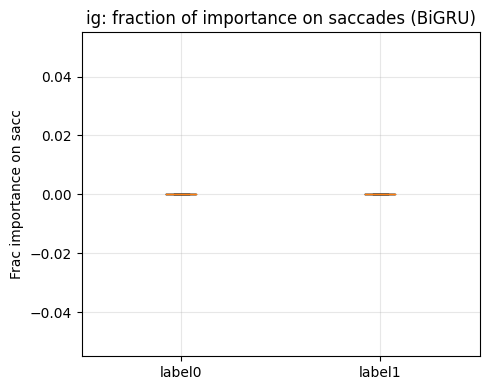

[BiGRU XAI=saliency] frac_imp_on_sacc  label0 vs label1 -> U=35.0, p=1.000e+00, mean0=0.000, mean1=0.000


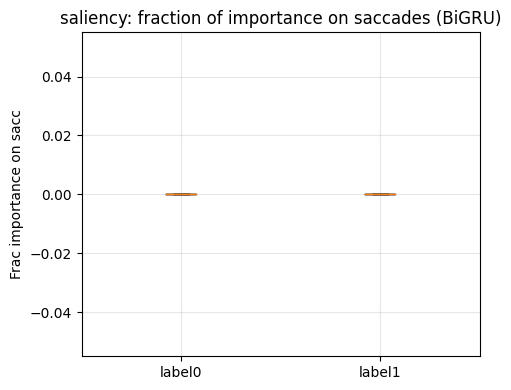

In [67]:
# res_02 from run_experiment_bigru(...)
model_bigru = res_02['model']

# Reload the original data (consistent with training)
X_raw, y, files = load_pair_experiment(
    "/Users/wukehui/Desktop/data science project/project/data/first_trials",
    (0, 2),
    resample_len=1500,
    max_nan_ratio=0.05,
    divide_by_960=True,
    use_robust_scale=True
)

# Use subject ID as test set mask
test_pids = set(res_02['id_splits']['test_ids'])
mask_test = np.array([get_participant_id(f) in test_pids for f in files])
print("n_test:", mask_test.sum(), "of", len(mask_test))

X_test = X_raw[mask_test]
y_test = y[mask_test]

# If the model does not have Conv1D, run only saliency/IG first; if there is Conv1D, add 'gradcampp'
methods = ('saliency','ig')  # or ('saliency','ig','gradcampp')

df_result, summary = run_xai_saccade_analysis_bigru(
    model_bigru, X_test, y_test,
    xai_methods=methods,
    vel_thr=0.8, min_frames=8,
    # conv_target='proj_conv', # If a Conv1D layer is added before BiGRU
)


Load-level Pattern Differences + Sliding Window Feature Dynamics for bigru

In [68]:
"""
Load-level Pattern Differences + Sliding Window Feature Dynamics (for BiGRU pipeline)
- Reuse: Linear resampling + /960 + robust scaling (same as the BiGRU baseline)
- Analysis:
  1) Full-length trajectory length (distribution, MW-U significance, classification based on length alone - subject grouping)
  2) Sliding window features: mean velocity / mean acceleration / range / saccade frequency
     - Window-by-window Mann–Whitney U test; plot mean ± SE curves for both classes and highlight significant regions
- Output: Save plots and CSV/JSON files to ./outputs/<dataset_name>
"""

import os, json
from typing import List, Tuple, Dict, Optional
import numpy as np
import pandas as pd
from scipy.stats import mannwhitneyu
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score, roc_auc_score
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

# Aligned with BiGRU baseline
SEED = 42
np.random.seed(SEED)
REQUIRED_COLS = ['abs_lx','abs_ly','abs_rx','abs_ry']
os.makedirs("outputs", exist_ok=True)

def get_participant_id(filename: str) -> str:
    # Compatible with "021_0.csv" or "P021_xxx_0.csv"
    return os.path.splitext(filename)[0].split('_')[0]

def _linear_resample(x: np.ndarray, target_len: int) -> np.ndarray:
    T, C = x.shape
    if T == target_len:
        return x
    src = np.linspace(0.0, 1.0, T, dtype=np.float32)
    dst = np.linspace(0.0, 1.0, target_len, dtype=np.float32)
    out = np.empty((target_len, C), dtype=x.dtype)
    for c in range(C):
        out[:, c] = np.interp(dst, src, x[:, c])
    return out

def _robust_scale_per_trace(x: np.ndarray, eps: float = 1e-6) -> np.ndarray:
    x_scaled = x.copy()
    for c in range(x.shape[1]):
        v = x[:, c]
        med = np.median(v)
        q75, q25 = np.percentile(v, 75), np.percentile(v, 25)
        iqr = max(q75 - q25, eps)
        x_scaled[:, c] = (v - med) / iqr
    return x_scaled

def load_pair_experiment(
    csv_dir: str,
    labels: Tuple[int, int],
    resample_len: int = 1500,
    max_nan_ratio: float = 0.05,   # Aligned with BiGRU baseline (stricter)
    divide_by_960: bool = True,
    use_robust_scale: bool = True
):
    X, y, files = [], [], []
    tagA, tagB = f"_{labels[0]}", f"_{labels[1]}"
    for file in sorted(os.listdir(csv_dir)):
        if not file.endswith(".csv"):
            continue
        if (tagA not in file) and (tagB not in file):
            continue
        path = os.path.join(csv_dir, file)
        try:
            df = pd.read_csv(path)
        except Exception:
            continue

        if set(REQUIRED_COLS).issubset(df.columns):
            raw = df[REQUIRED_COLS].astype(np.float32).values
        else:
            raw = df.iloc[:, 1:5].astype(np.float32).values

        if raw.ndim != 2 or raw.shape[1] < 4:
            continue

        # Strict NaN filtering (same as BiGRU)
        nan_ratio = np.isnan(raw).mean()
        if nan_ratio > max_nan_ratio:
            continue

        raw = pd.DataFrame(raw).fillna(method='ffill').fillna(method='bfill').fillna(0.0).values
        if divide_by_960:
            raw = raw / 960.0

        seq = _linear_resample(raw, resample_len)  # (T,4)
        if use_robust_scale:
            seq = _robust_scale_per_trace(seq)

        X.append(seq)
        y.append(0 if tagA in file else 1)
        files.append(file)

    X = np.asarray(X, dtype=np.float32)
    y = np.asarray(y, dtype=np.int64)
    print(f"[load_pair_experiment] Dir={os.path.basename(csv_dir)} Labels={labels}, files={len(files)}, shape={X.shape}")
    return X, y, files

def split_by_participant_train_val_test(
    X: np.ndarray, y: np.ndarray, files: List[str],
    val_size: float = 0.2, test_size: float = 0.2, random_state: int = 42
):
    pids = np.array([get_participant_id(f) for f in files])
    uniq = np.array(sorted(list(set(pids))))
    pid_trainval, pid_test = train_test_split(uniq, test_size=test_size, random_state=random_state, shuffle=True)
    pid_train, pid_val = train_test_split(pid_trainval, test_size=val_size/(1.0-test_size),
                                          random_state=random_state, shuffle=True)
    def mask(ids): return np.isin(pids, ids)
    tr, va, te = mask(pid_train), mask(pid_val), mask(pid_test)
    return X[tr], y[tr], X[va], y[va], X[te], y[te], {
        'train_ids': pid_train.tolist(), 'val_ids': pid_val.tolist(), 'test_ids': pid_test.tolist()
    }

# Core metrics (same as CNN version)
def trajectory_length(seq_xy: np.ndarray) -> float:
    lx, ly, rx, ry = seq_xy[:,0], seq_xy[:,1], seq_xy[:,2], seq_xy[:,3]
    dl = np.sqrt(np.diff(lx)**2 + np.diff(ly)**2).sum()
    dr = np.sqrt(np.diff(rx)**2 + np.diff(ry)**2).sum()
    return float((dl + dr) / 2.0)

def compute_lengths(X: np.ndarray) -> np.ndarray:
    return np.array([trajectory_length(x) for x in X], dtype=np.float32)

def velocity_trace(seq_xy: np.ndarray) -> np.ndarray:
    lx, ly, rx, ry = seq_xy[:,0], seq_xy[:,1], seq_xy[:,2], seq_xy[:,3]
    vl = np.sqrt(np.diff(lx)**2 + np.diff(ly)**2)
    vr = np.sqrt(np.diff(rx)**2 + np.diff(ry)**2)
    return (vl + vr)/2.0

def acceleration_from_velocity(v: np.ndarray) -> np.ndarray:
    if len(v) < 2: 
        return np.zeros_like(v)
    return np.abs(np.diff(v))

def window_slices(T: int, win: int, stride: int):
    idx = []
    s = 0
    while s + win <= T:
        idx.append((s, s+win))
        s += stride
    if not idx:
        idx.append((0, T))
    return idx

def window_features(seq_xy: np.ndarray, win=100, stride=50, sacc_thr=None) -> Dict[str, np.ndarray]:
    T = seq_xy.shape[0]
    vx = velocity_trace(seq_xy)         # length T-1
    ax = acceleration_from_velocity(vx) # length T-2

    if sacc_thr is None:
        sacc_thr = np.percentile(vx, 90.0)

    slices = window_slices(T-1, win, stride)  # Slice with the length of vx
    mean_v, mean_a, rng, sacc_freq = [], [], [], []
    for (i, j) in slices:
        v_win = vx[i:j]
        a_win = ax[i:j-1] if (j-i) >= 2 else np.array([0.0])
        sub = seq_xy[i:(i+win), :] if (i+win) <= T else seq_xy[i:T, :]

        mean_v.append(float(np.mean(v_win) if len(v_win)>0 else 0.0))
        mean_a.append(float(np.mean(a_win) if len(a_win)>0 else 0.0))
        ranges = sub.max(axis=0) - sub.min(axis=0)
        rng.append(float(np.mean(ranges)))
        sacc_freq.append(float(np.mean(v_win > sacc_thr)) if len(v_win)>0 else 0.0)

    return {
        'mean_v': np.array(mean_v, dtype=np.float32),
        'mean_a': np.array(mean_a, dtype=np.float32),
        'rng': np.array(rng, dtype=np.float32),
        'sacc_freq': np.array(sacc_freq, dtype=np.float32),
        'windows': np.array(slices, dtype=np.int32)
    }

def group_window_dynamics(X: np.ndarray, y: np.ndarray, win=100, stride=50) -> Dict:
    feats0, feats1 = [], []
    for i in range(len(X)):
        feats = window_features(X[i], win=win, stride=stride, sacc_thr=None)
        feats['label'] = y[i]
        (feats0 if y[i]==0 else feats1).append(feats)

    if len(feats0)==0 or len(feats1)==0:
        raise ValueError("There are not enough samples of the two types to make dynamic comparisons")

    K = min(min(len(f['mean_v']) for f in feats0), min(len(f['mean_v']) for f in feats1))

    def stack_and_trim(feats_list, key):
        return np.stack([f[key][:K] for f in feats_list], axis=0)  # (N, K)

    out = {}
    for key in ['mean_v','mean_a','rng','sacc_freq']:
        A0 = stack_and_trim(feats0, key)
        A1 = stack_and_trim(feats1, key)
        mean0, mean1 = A0.mean(0), A1.mean(0)
        se0, se1 = A0.std(0)/np.sqrt(A0.shape[0]), A1.std(0)/np.sqrt(A1.shape[0])

        pvals = [mannwhitneyu(A0[:,k], A1[:,k], alternative='two-sided').pvalue for k in range(K)]
        out[key] = {'mean0': mean0, 'mean1': mean1, 'se0': se0, 'se1': se1, 'pvals': np.array(pvals)}
    out['K'], out['win'], out['stride'] = K, win, stride
    return out

# Plot
def plot_box_violin_lengths(lengths: np.ndarray, y: np.ndarray, title: str, save_path: str):
    data0, data1 = lengths[y==0], lengths[y==1]
    fig, ax = plt.subplots(1,2, figsize=(10,4), sharey=True)
    ax[0].boxplot([data0, data1], labels=['label0','label1'])
    ax[0].set_title('Boxplot'); ax[0].set_ylabel('Trajectory length')
    ax[1].violinplot([data0, data1], showmeans=True, showmedians=True)
    ax[1].set_xticks([1,2]); ax[1].set_xticklabels(['label0','label1'])
    ax[1].set_title('Violin')
    fig.suptitle(title); plt.tight_layout(); fig.savefig(save_path, dpi=200); plt.close(fig)

def plot_window_curves(dyn: Dict, title: str, save_path: str, alpha=0.05):
    K, win, stride = dyn['K'], dyn['win'], dyn['stride']
    tgrid = np.arange(K) * stride + win//2
    keys = ['mean_v','mean_a','rng','sacc_freq']
    fig, axes = plt.subplots(len(keys), 1, figsize=(10, 2.8*len(keys)), sharex=True)
    if len(keys)==1: axes = [axes]
    for ax, key in zip(axes, keys):
        d = dyn[key]
        ax.plot(tgrid, d['mean0'], label='label0')
        ax.fill_between(tgrid, d['mean0']-d['se0'], d['mean0']+d['se0'], alpha=0.25)
        ax.plot(tgrid, d['mean1'], label='label1')
        ax.fill_between(tgrid, d['mean1']-d['se1'], d['mean1']+d['se1'], alpha=0.25)
        sig = d['pvals'] < alpha
        if sig.any():
            ymin = min(d['mean0'].min(), d['mean1'].min())
            ax.scatter(tgrid[sig], np.full(sig.sum(), ymin), marker='|', s=60, label='p<%.2f'%alpha)
        ax.set_ylabel(key); ax.grid(alpha=0.2)
    axes[-1].set_xlabel('time (frame)'); axes[0].legend()
    fig.suptitle(title); plt.tight_layout(); fig.savefig(save_path, dpi=200); plt.close(fig)

# One-click entry
def analyze_dataset_bigru(
    name: str, csv_dir: str, label_pair=(0,2),
    target_len=1500, out_dir="outputs",
    win=100, stride=50,
    max_nan_ratio=0.05   # Keep consistent with BiGRU baseline
):
    os.makedirs(os.path.join(out_dir, name), exist_ok=True)

    # 1) Load
    X, y, files = load_pair_experiment(csv_dir, label_pair, resample_len=target_len,
                                       max_nan_ratio=max_nan_ratio, divide_by_960=True, use_robust_scale=True)

    # 2) Total track length + statistics
    L = compute_lengths(X)
    df_len = pd.DataFrame({'file': files, 'pid':[get_participant_id(f) for f in files],
                           'label': y, 'length': L})
    df_len.to_csv(os.path.join(out_dir, name, f"{name}_lengths.csv"), index=False)

    L0, L1 = L[y==0], L[y==1]
    U, p = (np.nan, np.nan) if (len(L0)==0 or len(L1)==0) else mannwhitneyu(L0, L1, alternative='two-sided')
    stats = {'n0': int(len(L0)), 'n1': int(len(L1)),
             'mean0': float(np.nanmean(L0)) if len(L0) else np.nan,
             'mean1': float(np.nanmean(L1)) if len(L1) else np.nan,
             'std0': float(np.nanstd(L0)) if len(L0) else np.nan,
             'std1': float(np.nanstd(L1)) if len(L1) else np.nan,
             'U': float(U) if not np.isnan(U) else np.nan, 'p': float(p) if not np.isnan(U) else np.nan}
    with open(os.path.join(out_dir, name, f"{name}_length_stats.json"), "w") as f:
        json.dump(stats, f, indent=2)
    print(f"[{name}] Length MW-U: U={stats['U']}, p={stats['p']}, mean0={stats['mean0']:.3f}, mean1={stats['mean1']:.3f}")

    plot_box_violin_lengths(L, y, title=f"{name} Trajectory Length",
                            save_path=os.path.join(out_dir, name, f"{name}_length_box_violin.png"))

    # 3) Classification by length only (subject grouping)
    Xtr, ytr, Xva, yva, Xte, yte, split_info = split_by_participant_train_val_test(
        L.reshape(-1,1), y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    clf = make_pipeline(StandardScaler(), LogisticRegression(random_state=SEED, max_iter=1000))
    clf.fit(np.vstack([Xtr, Xva]), np.hstack([ytr, yva]))
    prob = clf.predict_proba(Xte)[:,1]
    pred = (prob >= 0.5).astype(int)
    acc = accuracy_score(yte, pred)
    auc = roc_auc_score(yte, prob) if len(np.unique(yte))==2 else float('nan')
    print(f"[{name}] Length-only classifier: Acc={acc:.3f}, ROC-AUC={auc:.3f}")
    with open(os.path.join(out_dir, name, f"{name}_length_cls.json"), "w") as f:
        json.dump({'accuracy': float(acc), 'roc_auc': float(auc), 'split': split_info}, f, indent=2)

    # 4) Sliding window feature dynamics
    dyn = group_window_dynamics(X, y, win=win, stride=stride)
    pv = {k: dyn[k]['pvals'].tolist() for k in ['mean_v','mean_a','rng','sacc_freq']}
    with open(os.path.join(out_dir, name, f"{name}_window_pvals.json"), "w") as f:
        json.dump({'K': dyn['K'], 'win': dyn['win'], 'stride': dyn['stride'], 'pvals': pv}, f, indent=2)

    plot_window_curves(dyn, title=f"{name} sliding-window dynamics (win={win}, stride={stride})",
                       save_path=os.path.join(out_dir, name, f"{name}_window_dynamics.png"))

    return {'length_stats': stats, 'length_cls': {'accuracy': float(acc), 'roc_auc': float(auc)}, 'splits': split_info}

# Run
if __name__ == "__main__":
    FIRST_DIR  = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (0, 2)   # or (1, 3)
    TARGET_LEN = 1500
    WIN, STRIDE = 100, 50

    print("=== Analyze FIRST (BiGRU-preproc) ===")
    res_first = analyze_dataset_bigru("first_trials", FIRST_DIR, label_pair=PAIR, target_len=TARGET_LEN,
                                      out_dir="outputs", win=WIN, stride=STRIDE, max_nan_ratio=0.05)

    print("=== Analyze REPEATS (BiGRU-preproc) ===")
    res_repeats = analyze_dataset_bigru("repeats", REPEAT_DIR, label_pair=PAIR, target_len=TARGET_LEN,
                                        out_dir="outputs", win=WIN, stride=STRIDE, max_nan_ratio=0.05)

    print("\nSummary:")
    print("FIRST length-only:", res_first['length_cls'])
    print("REPEATS length-only:", res_repeats['length_cls'])


=== Analyze FIRST (BiGRU-preproc) ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)
[first_trials] Length MW-U: U=1140.0, p=0.40680918123320464, mean0=758.761, mean1=725.137
[first_trials] Length-only classifier: Acc=0.353, ROC-AUC=0.429
=== Analyze REPEATS (BiGRU-preproc) ===
[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)
[repeats] Length MW-U: U=218.0, p=0.6359445511344555, mean0=892.691, mean1=850.462
[repeats] Length-only classifier: Acc=0.700, ROC-AUC=0.760

Summary:
FIRST length-only: {'accuracy': 0.35294117647058826, 'roc_auc': 0.4285714285714286}
REPEATS length-only: {'accuracy': 0.7, 'roc_auc': 0.76}


Ablation Experiments for bigru

In [69]:
"""
Ablation Experiments for BiGRU
- 8.3.1 Eye Channel Ablation: Left / Right / Both
- 8.3.2 Temporal Segment Ablation: Start / Middle / End (Cut to 1/3 and then upsample to target_len)
- 8.3.3 Coordinate Direction Ablation: X only / Y only

Dependency: Reuse existing
  _linear_resample, _robust_scale_per_trace, load_pair_experiment,
  split_by_participant_train_val_test, compute_class_weight, get_optimizer
"""

import os, time, json
from typing import Tuple, List, Dict, Optional
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras import layers, Model, Input
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, classification_report

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# BiGRU (variable number of channels)
def build_bigru_model_nchan(
    target_len: int,
    n_channels: int,
    rnn_units: int = 64,
    rnn_layers: int = 2,
    dropout: float = 0.3,
    recurrent_dropout: float = 0.1,
    use_ln: bool = False
) -> Model:
    inp = Input(shape=(target_len, n_channels), name="input")
    x = inp
    for i in range(rnn_layers):
        x = layers.Bidirectional(
            layers.GRU(
                rnn_units,
                return_sequences=True,
                dropout=dropout,
                recurrent_dropout=recurrent_dropout,
                reset_after=True
            ),
            name=f"bigru_{i+1}"
        )(x)
        if use_ln:
            x = layers.LayerNormalization(name=f"ln_{i+1}")(x)
    x = layers.GlobalAveragePooling1D(name="gap")(x)
    x = layers.Dense(64, activation='relu', name='fc1')(x)
    x = layers.Dropout(0.5, name='drop')(x)
    out = layers.Dense(1, activation='sigmoid', name='logit')(x)
    return Model(inp, out, name="bigru_ablation")

# Crop tool
# Channel index convention: 0: lx, 1: ly, 2: rx, 3: ry
IDX = {'lx':0, 'ly':1, 'rx':2, 'ry':3}

def select_channels(X: np.ndarray, mode: str) -> np.ndarray:
    """
    mode in {'left','right','both','x','y'}:
      left  -> [lx, ly]
      right -> [rx, ry]
      both  -> [lx, ly, rx, ry]
      x     -> [lx, rx]
      y     -> [ly, ry]
    """
    if mode == 'left':
        keep = [IDX['lx'], IDX['ly']]
    elif mode == 'right':
        keep = [IDX['rx'], IDX['ry']]
    elif mode == 'both':
        keep = [IDX['lx'], IDX['ly'], IDX['rx'], IDX['ry']]
    elif mode == 'x':
        keep = [IDX['lx'], IDX['rx']]
    elif mode == 'y':
        keep = [IDX['ly'], IDX['ry']]
    else:
        raise ValueError(f"Unknown channel mode: {mode}")
    return X[:, :, keep]

def slice_temporal_segment(X: np.ndarray, seg: str, resample_back_len: Optional[int] = None) -> np.ndarray:
    """
    seg in {'full','start','middle','end'}
    Slices the time dimension into 1/3 segments. If resample_back_len is given, each sample is upsampled back to the specified length using linear interpolation.
    """
    if seg == 'full':
        return X
    N, T, C = X.shape
    one_third = T // 3
    if seg == 'start':
        Xs = X[:, :one_third, :]
    elif seg == 'middle':
        Xs = X[:, one_third:2*one_third, :]
    elif seg == 'end':
        Xs = X[:, 2*one_third:, :]
    else:
        raise ValueError(f"Unknown temporal segment: {seg}")

    if (resample_back_len is None) or (Xs.shape[1] == resample_back_len):
        return Xs

    out = np.empty((N, resample_back_len, C), dtype=X.dtype)
    for i in range(N):
        out[i] = _linear_resample(Xs[i], resample_back_len)
    return out

# Single training/evaluation (subject grouping)
def train_eval_once_bigru(
    X: np.ndarray, y: np.ndarray, files: List[str],
    target_len: int = 1500,
    lr: float = 3e-4,
    batch_size: int = 16,
    max_epochs: int = 80,
    early_patience: int = 15,
    # BiGRU hyperparameters (aligned with baseline)
    rnn_units: int = 64,
    rnn_layers: int = 2,
    dropout: float = 0.3,
    recurrent_dropout: float = 0.1,
    use_ln: bool = False
) -> Dict:
    Xtr, ytr, Xva, yva, Xte, yte, id_splits = split_by_participant_train_val_test(
        X, y, files, val_size=0.2, test_size=0.2, random_state=SEED
    )
    n_channels = X.shape[-1]
    model = build_bigru_model_nchan(
        target_len, n_channels,
        rnn_units=rnn_units, rnn_layers=rnn_layers,
        dropout=dropout, recurrent_dropout=recurrent_dropout, use_ln=use_ln
    )
    model.compile(optimizer=get_optimizer(lr), loss='binary_crossentropy', metrics=['accuracy'])

    callbacks = [
        tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=early_patience, restore_best_weights=True),
        tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=6, min_lr=1e-5, verbose=1),
    ]
    class_weight = compute_class_weight(ytr)

    t0 = time.perf_counter()
    hist = model.fit(
        Xtr, ytr,
        validation_data=(Xva, yva),
        epochs=max_epochs,
        batch_size=batch_size,
        verbose=0,
        callbacks=callbacks,
        class_weight=class_weight
    )
    t1 = time.perf_counter()

    # Test
    yprob = model.predict(Xte, batch_size=batch_size).ravel()
    ypred = (yprob >= 0.5).astype(int)
    acc = accuracy_score(yte, ypred)
    macro_f1 = f1_score(yte, ypred, average='macro')
    try:
        roc_auc = roc_auc_score(yte, yprob)
    except Exception:
        roc_auc = np.nan
    report = classification_report(yte, ypred, digits=4)
    return {
        'acc': acc, 'macro_f1': macro_f1, 'roc_auc': roc_auc,
        'report': report, 'history': hist.history, 'time_sec': t1 - t0,
        'splits': id_splits
    }

# 8.3.1 Eye Channel Ablation
def run_eye_channel_ablation_bigru(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    base_loader_kwargs: Optional[Dict] = None
) -> pd.DataFrame:
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)

    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)
    rows = []
    for mode in ['left', 'right', 'both']:
        Xc = select_channels(X, mode)
        res = train_eval_once_bigru(Xc, y, files, target_len=target_len)
        rows.append(dict(
            ablation='EyeChannel', setting=mode,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'],
            time_sec=res['time_sec']
        ))
        print(f"[EyeChannel|BiGRU] {mode}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# 8.3.2 Temporal Segment Ablation
def run_temporal_segment_ablation_bigru(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    base_loader_kwargs: Optional[Dict] = None
) -> pd.DataFrame:
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)
    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)

    rows = []
    for seg in ['start', 'middle', 'end']:
        Xt = slice_temporal_segment(X, seg=seg, resample_back_len=target_len)
        res = train_eval_once_bigru(Xt, y, files, target_len=target_len)
        rows.append(dict(
            ablation='Temporal', setting=seg,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'],
            time_sec=res['time_sec']
        ))
        print(f"[Temporal|BiGRU] {seg}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# 8.3.3 Coordinate Direction Ablation
def run_coord_direction_ablation_bigru(
    csv_dir: str, label_pair: Tuple[int,int], target_len: int = 1500,
    base_loader_kwargs: Optional[Dict] = None
) -> pd.DataFrame:
    if base_loader_kwargs is None:
        base_loader_kwargs = dict(resample_len=target_len, max_nan_ratio=0.05, divide_by_960=True, use_robust_scale=True)
    X, y, files = load_pair_experiment(csv_dir, label_pair, **base_loader_kwargs)

    rows = []
    for d in ['x', 'y']:
        Xc = select_channels(X, d)
        res = train_eval_once_bigru(Xc, y, files, target_len=target_len)
        rows.append(dict(
            ablation='Coord', setting=d,
            acc=res['acc'], macro_f1=res['macro_f1'], roc_auc=res['roc_auc'],
            time_sec=res['time_sec']
        ))
        print(f"[Coord|BiGRU] {d}: Acc={res['acc']:.3f}, F1={res['macro_f1']:.3f}, AUC={res['roc_auc']:.3f}")
        print(res['report'])
    return pd.DataFrame(rows)

# One-button control
def run_all_ablation_bigru(
    csv_dir: str,
    label_pair: Tuple[int,int]=(0,2),
    target_len: int = 1500,
    save_prefix: Optional[str] = None
) -> Dict[str, pd.DataFrame]:
    res_eye = run_eye_channel_ablation_bigru(csv_dir, label_pair, target_len)
    res_tmp = run_temporal_segment_ablation_bigru(csv_dir, label_pair, target_len)
    res_dir = run_coord_direction_ablation_bigru(csv_dir, label_pair, target_len)

    results = {'EyeChannel': res_eye, 'Temporal': res_tmp, 'Coord': res_dir}
    if save_prefix:
        for k, df in results.items():
            df.to_csv(f"{save_prefix}_{k}.csv", index=False)
        with open(f"{save_prefix}_meta.json", "w") as f:
            json.dump({'label_pair': label_pair, 'target_len': target_len}, f, indent=2)
    return results

# Run
if __name__ == "__main__":
    FIRST_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (0, 2)  # or (1, 3)

    print("=== 8.3 Ablation on FIRST_TRIALS (BiGRU) ===")
    res_first = run_all_ablation_bigru(FIRST_DIR, label_pair=PAIR, target_len=1500,
                                       save_prefix=f"ablation_bigru_first_{PAIR[0]}_{PAIR[1]}")

    print("\n=== 8.3 Ablation on REPEATS (BiGRU) ===")
    res_repeats = run_all_ablation_bigru(REPEAT_DIR, label_pair=PAIR, target_len=1500,
                                         save_prefix=f"ablation_bigru_repeats_{PAIR[0]}_{PAIR[1]}")

    # Summary Print
    for name, df in res_first.items():
        print(f"\n[FIRST|BiGRU] {name}\n", df.sort_values('acc', ascending=False))
    for name, df in res_repeats.items():
        print(f"\n[REPEATS|BiGRU] {name}\n", df.sort_values('acc', ascending=False))


=== 8.3 Ablation on FIRST_TRIALS (BiGRU) ===
[load_pair_experiment] Dir=first_trials Labels=(0, 2), files=91, shape=(91, 1500, 4)

Epoch 45: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 51: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 131ms/step
[EyeChannel|BiGRU] left: Acc=0.706, F1=0.689, AUC=0.900
              precision    recall  f1-score   support

           0     0.6667    0.5714    0.6154         7
           1     0.7273    0.8000    0.7619        10

    accuracy                         0.7059        17
   macro avg     0.6970    0.6857    0.6886        17
weighted avg     0.7023    0.7059    0.7016        17


Epoch 77: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.
2/2 [==============================] - 1s 121ms/step
[EyeChannel|BiGRU] right: Acc=0.882, F1=0.879, AUC=0.886
              precision    recall  f1-score   support

           0     0.8571    0.8571  


Epoch 49: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 55: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 379ms/step
[Temporal|BiGRU] end: Acc=0.700, F1=0.697, AUC=0.880
              precision    recall  f1-score   support

           0     0.7500    0.6000    0.6667         5
           1     0.6667    0.8000    0.7273         5

    accuracy                         0.7000        10
   macro avg     0.7083    0.7000    0.6970        10
weighted avg     0.7083    0.7000    0.6970        10

[load_pair_experiment] Dir=repeats Labels=(0, 2), files=40, shape=(40, 1500, 4)

Epoch 47: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 59: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.

Epoch 74: ReduceLROnPlateau reducing learning rate to 3.7500001781154424e-05.

Epoch 80: ReduceLROnPlateau reducing learning rate to 1.8750000890577212e-05.
1/1 [============

In [29]:
# Run
if __name__ == "__main__":
    FIRST_DIR = "/Users/wukehui/Desktop/data science project/project/data/first_trials"
    REPEAT_DIR = "/Users/wukehui/Desktop/data science project/project/data/repeats"
    PAIR = (1, 3)

    print("=== 8.3 Ablation on FIRST_TRIALS (BiGRU) ===")
    res_first = run_all_ablation_bigru(FIRST_DIR, label_pair=PAIR, target_len=1500,
                                       save_prefix=f"ablation_bigru_first_{PAIR[0]}_{PAIR[1]}")

    print("\n=== 8.3 Ablation on REPEATS (BiGRU) ===")
    res_repeats = run_all_ablation_bigru(REPEAT_DIR, label_pair=PAIR, target_len=1500,
                                         save_prefix=f"ablation_bigru_repeats_{PAIR[0]}_{PAIR[1]}")

    # Summary Print
    for name, df in res_first.items():
        print(f"\n[FIRST|BiGRU] {name}\n", df.sort_values('acc', ascending=False))
    for name, df in res_repeats.items():
        print(f"\n[REPEATS|BiGRU] {name}\n", df.sort_values('acc', ascending=False))


=== 8.3 Ablation on FIRST_TRIALS (BiGRU) ===
[load_pair_experiment] Dir=first_trials Labels=(1, 3), files=96, shape=(96, 1500, 4)
2/2 [==============================] - 1s 156ms/step
[EyeChannel|BiGRU] left: Acc=0.810, F1=0.809, AUC=0.936
              precision    recall  f1-score   support

           0     0.8182    0.8182    0.8182        11
           1     0.8000    0.8000    0.8000        10

    accuracy                         0.8095        21
   macro avg     0.8091    0.8091    0.8091        21
weighted avg     0.8095    0.8095    0.8095        21


Epoch 7: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 13: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 118ms/step
[EyeChannel|BiGRU] right: Acc=0.524, F1=0.514, AUC=0.582
              precision    recall  f1-score   support

           0     0.5714    0.3636    0.4444        11
           1     0.5000    0.7000    0.5833        10

    a

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 18: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 24: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
2/2 [==============================] - 0s 119ms/step
[Coord|BiGRU] y: Acc=0.571, F1=0.568, AUC=0.645
              precision    recall  f1-score   support

           0     0.6250    0.4545    0.5263        11
           1     0.5385    0.7000    0.6087        10

    accuracy                         0.5714        21
   macro avg     0.5817    0.5773    0.5675        21
weighted avg     0.5838    0.5714    0.5655        21


=== 8.3 Ablation on REPEATS (BiGRU) ===
[load_pair_experiment] Dir=repeats Labels=(1, 3), files=39, shape=(39, 1500, 4)

Epoch 7: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 13: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 320ms/step
[EyeChannel|BiGRU] left: Acc=0.556, F1=0.357, AUC=0.950
              precision    reca

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 7: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 13: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 321ms/step
[EyeChannel|BiGRU] right: Acc=0.556, F1=0.357, AUC=0.800
              precision    recall  f1-score   support

           0     0.5556    1.0000    0.7143         5
           1     0.0000    0.0000    0.0000         4

    accuracy                         0.5556         9
   macro avg     0.2778    0.5000    0.3571         9
weighted avg     0.3086    0.5556    0.3968         9



/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 7: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 13: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 386ms/step
[EyeChannel|BiGRU] both: Acc=0.556, F1=0.357, AUC=0.900
              precision    recall  f1-score   support

           0     0.5556    1.0000    0.7143         5
           1     0.0000    0.0000    0.0000         4

    accuracy                         0.5556         9
   macro avg     0.2778    0.5000    0.3571         9
weighted avg     0.3086    0.5556    0.3968         9



/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


[load_pair_experiment] Dir=repeats Labels=(1, 3), files=39, shape=(39, 1500, 4)

Epoch 7: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 13: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 316ms/step
[Temporal|BiGRU] start: Acc=0.667, F1=0.649, AUC=0.750
              precision    recall  f1-score   support

           0     0.6667    0.8000    0.7273         5
           1     0.6667    0.5000    0.5714         4

    accuracy                         0.6667         9
   macro avg     0.6667    0.6500    0.6494         9
weighted avg     0.6667    0.6667    0.6580         9


Epoch 24: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 30: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 334ms/step
[Temporal|BiGRU] middle: Acc=0.667, F1=0.649, AUC=0.900
              precision    recall  f1-score   support

          

/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/wukehui/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Epoch 7: ReduceLROnPlateau reducing learning rate to 0.0001500000071246177.

Epoch 13: ReduceLROnPlateau reducing learning rate to 7.500000356230885e-05.
1/1 [==============================] - 0s 328ms/step
[Coord|BiGRU] y: Acc=0.333, F1=0.250, AUC=0.150
              precision    recall  f1-score   support

           0     0.0000    0.0000    0.0000         5
           1     0.3750    0.7500    0.5000         4

    accuracy                         0.3333         9
   macro avg     0.1875    0.3750    0.2500         9
weighted avg     0.1667    0.3333    0.2222         9


[FIRST|BiGRU] EyeChannel
      ablation setting       acc  macro_f1   roc_auc    time_sec
0  EyeChannel    left  0.809524  0.809091  0.936364  439.285848
2  EyeChannel    both  0.809524  0.809091  0.800000  331.437710
1  EyeChannel   right  0.523810  0.513889  0.581818   84.163190

[FIRST|BiGRU] Temporal
    ablation setting       acc  macro_f1   roc_auc    time_sec
0  Temporal   start  0.857143  0.855835  0.8272